In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader, random_split
import pandas as pd
import json
from torchsummary import summary
import time
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import precision_recall_fscore_support
import librosa.display
import math
import os
from textwrap import dedent

JSON_PATH = "/home/alex/Datasets/IRMAS/"
filename = "irmas_data_mfcc40_hop_length512_n_fft2048.json"

In [2]:
class ConvBlock(nn.Module):

  def __init__(self, 
               in_channels,
               out_channels,
               conv_kernel_size=3,
               conv_stride=1,
               conv_padding=0,
               inc_pool=True,
               pool_kernel_size=2,
               pool_stride=2):
    """Convolutional block with conv2d, linear activation, max pooling, 
        and batch norm
    :param in_channels:
    :param out_channels:
    :param conv_kernel_size:
    :param conv_stride:
    :param conv_padding:
    :param inc_pool: If true, includes a max pooling layer

    The following params only matter if inc_pool is True
    :param pool_kernel_size:
    :param pool_stride:
    """
    super(ConvBlock, self).__init__()

    # construct sequential blocks
    if inc_pool:
      self.conv_block = nn.Sequential(
        nn.Conv2d(in_channels=in_channels,
                  out_channels=out_channels,
                  kernel_size=conv_kernel_size,
                  stride=conv_stride,
                  padding=conv_padding),
        nn.ReLU(),
        nn.MaxPool2d(kernel_size=pool_kernel_size,
                     stride=pool_stride),
        nn.BatchNorm2d(num_features=out_channels)
      )
    else:
        self.conv_block = nn.Sequential(
          nn.Conv2d(in_channels=in_channels,
                    out_channels=out_channels,
                    kernel_size=conv_kernel_size,
                    stride=conv_stride,padding=conv_padding),
          nn.ReLU(),
          nn.BatchNorm2d(num_features=out_channels)
        ) 

  # run forward
  def forward(self, x):
    x = self.conv_block(x)
    return x



class TripleConv(nn.Module):
  
  def __init__(self, in_channels, out_channels):
    super(TripleConv, self).__init__()
    self.conv1 = ConvBlock(in_channels,
                           out_channels,
                           conv_padding=1,
                           inc_pool=False)
    self.conv2 = ConvBlock(out_channels,
                           out_channels,
                           conv_padding=1,
                           inc_pool=False)
    self.conv3 = ConvBlock(out_channels,
                           out_channels,
                           conv_padding=1,
                           inc_pool=False)
    

  def forward(self, x):
    x = self.conv1(x)
    x = self.conv2(x)
    x = self.conv3(x)
    return x
  
  
class LinearBlock(nn.Module):

  def __init__(self, in_features, out_features, dropout_prob=0):
    """Linear block with dense layer, relu, batch norm, then dropout
    :param in_features:
    :param out_features:
    :param dropout_prob: Set to 0 for no dropout layer
    """

    super(LinearBlock, self).__init__()
    self.linear_block = nn.Sequential(
      nn.Linear(in_features=in_features, out_features=out_features),
      nn.ReLU(),
      nn.BatchNorm1d(num_features=out_features),
      nn.Dropout(p=dropout_prob)
    )

  def forward(self, x):
    x = self.linear_block(x)
    return x

class BigNet(nn.Module):
  
  def __init__(self):
    super(BigNet, self).__init__()
    self.conv_block_1 = TripleConv(1, 8)
    self.conv_pool_1 = ConvBlock(
      in_channels=8,
      out_channels=8,
      conv_padding=1,
      inc_pool=True,)
    
    self.conv_block_2 = TripleConv(8, 16)
    self.conv_pool_2 = ConvBlock(
      in_channels=16,
      out_channels=16,
      conv_padding=1,
      inc_pool=True,
      pool_kernel_size=(1, 2),
      pool_stride=(1, 2),
    )
    
    self.conv_block_3 = TripleConv(16, 32)
    self.mid_conv_3 = nn.Sequential(*[TripleConv(32, 32) for i in range(3)])
    self.conv_pool_3 = ConvBlock(
      in_channels=32,
      out_channels=32,
      conv_padding=1,
      inc_pool=True,
      pool_kernel_size=(1, 2),
      pool_stride=(1, 2),
    )
    
    self.conv_block_4 = TripleConv(32, 64)
    self.mid_conv_4 = nn.Sequential(*[TripleConv(64, 64) for i in range(3)])
    self.conv_pool_4 = ConvBlock(
      in_channels=64,
      out_channels=64,
      conv_padding=1,
      inc_pool=True,
      pool_kernel_size=2,
      pool_stride=2,
    )
    
    self.conv_block_5 = TripleConv(64, 128)
    self.mid_conv_5 = nn.Sequential(*[TripleConv(128, 128) for i in range(3)])
    self.conv_pool_5 = ConvBlock(
      in_channels=128,
      out_channels=128,
      conv_padding=1,
      inc_pool=True,
      pool_kernel_size=2,
      pool_stride=2,
    )
    
    self.end_conv = TripleConv(128, 128)
     
    self.linear_1 = LinearBlock(5120, 1024, dropout_prob=0.5)
    self.linear_2 = LinearBlock(1024, 128, dropout_prob=0.5)
    self.head = LinearBlock(128, 11)
    
  def forward(self, x):
    x = self.conv_block_1(x)
    x = self.conv_pool_1(x)
    
    x = self.conv_block_2(x)
    x = self.conv_pool_2(x)
    
    x = self.conv_block_3(x)
    x = self.mid_conv_3(x)
    x = self.conv_pool_3(x)
    
    x = self.conv_block_4(x)
    x = self.mid_conv_4(x)
    x = self.conv_pool_4(x)
    
    x = self.conv_block_5(x)
    x = self.mid_conv_5(x)
    x = self.conv_pool_5(x)
    
    x = self.end_conv(x)
    
    # classifief
    x = x.flatten(start_dim=1)
    x = self.linear_1(x)
    x = self.linear_2(x)
    x = self.head(x)
    return x

In [3]:
test_model = BigNet()
summary(test_model, (1, 40, 259), verbose=0)

Layer (type:depth-idx)                   Output Shape              Param #
├─TripleConv: 1-1                        [-1, 8, 40, 259]          --
|    └─ConvBlock: 2-1                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-1              [-1, 8, 40, 259]          96
|    └─ConvBlock: 2-2                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-2              [-1, 8, 40, 259]          600
|    └─ConvBlock: 2-3                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-3              [-1, 8, 40, 259]          600
├─ConvBlock: 1-2                         [-1, 8, 20, 129]          --
|    └─Sequential: 2-4                   [-1, 8, 20, 129]          --
|    |    └─Conv2d: 3-4                  [-1, 8, 40, 259]          584
|    |    └─ReLU: 3-5                    [-1, 8, 40, 259]          --
|    |    └─MaxPool2d: 3-6               [-1, 8, 20, 129]          --
|    |    └─BatchNorm2d: 3-7             [-1, 8, 20, 129]          16
├─TripleConv

In [4]:
class IRMASDataset(Dataset):
  def __init__(self, JSON_PATH=JSON_PATH, filename=filename, transform=None):
    with open(JSON_PATH + filename, "r") as f:
      self.irmas_data = json.load(f)
    self.metadata = self.irmas_data.pop('metadata') 
    self.instruments = ["cel", "cla", "flu", "gac", "gel", "org", "pia", "sax",
    "tru", "vio", "voi"]
    self.encoder = LabelEncoder()
    self.encoder.fit(self.instruments)

  def __len__(self):
    return len(self.irmas_data)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
      idx = np.array(idx.tolist())

    mfccs = np.array(self.irmas_data[str(idx)]['mfccs'])[np.newaxis,...]

    primary_instrument = self.encoder.transform(
      [np.array(self.irmas_data[str(idx)]['primary_instrument'])]
    )
    sample = {'mfccs': mfccs, 'instrument': primary_instrument, 'metadata': self.metadata}
    return sample

def prep_dataset(filename=filename, val_split=0.2, batch_size=1):

  dataset = IRMASDataset(JSON_PATH=JSON_PATH, filename=filename)
  train_set, val_set = random_split(dataset, [round(len(dataset) * (1-val_split)), round(len(dataset)*val_split)])

  train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=1)
  val_loader = DataLoader(val_set, batch_size=batch_size, shuffle=True, num_workers=1)

  return train_loader, val_loader, dataset

In [5]:
train_loader, val_loader, dataset = prep_dataset(
      filename=filename, batch_size=5, val_split=0.2)
single_sample = dataset[0]

one_mfcc = np.array(single_sample['mfccs'])
one_mfcc.shape

(1, 40, 259)

In [6]:
def train_model(filename="irmas_data_mfcc13_hop_length256_n_fft2048", model_id="TestModel",
                num_epochs=2, interval=16, lr=0.001, batch_size=64,
                val_split=0.2, save_checkpoint=False, checkpoint_path="",
                notes="", checkpoint_name="utitled.pt", criterion=torch.nn.NLLLoss(),
                patience=None, min_epochs=5, buffer=0.05, dropout_prob=None,
                model_args={}, experiment_params={}):
  """Model training loop for music analysis project. Currently, this loop only supports
  models that take input in the shape [mini_batch, channels, L, W].

  :param filename:
  :param model_id:
  :param num_epochs:
  :param interval:
  :param lr:
  :param batch_size:
  :param val_split:
  :param save_checkpoint:
  :param checkpoint_path:
  :param notes:
  :param checkpoint name:
  :param criterion:
  :param patience: If validation loss does not improve over this many epochs, stop training
  """

  # Initialize device
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
  print("device: ", device)
  
  # get train and validation set, print metadata
  train_loader, val_loader, dataset = prep_dataset(
      filename=filename, batch_size=batch_size, val_split=val_split)

  print("dataset metadata: ", dataset.metadata)

  # param for early stopping
  stop_next = False

  # get number of train and validdation samples
  train_samples = round(len(dataset) * (1-val_split))
  val_samples = round(len(dataset)*val_split)

  # initialize loss history and accuracy history for each epoch
  # this is the stored history for the train and validation metrics
  epoch_hist = []
  avg_train_loss_hist = []  # training loss for each epoch
  std_train_loss_hist = []
  avg_val_loss_hist = []    # validation loss for each epoch
  std_val_loss_hist = []
  train_acc_hist = []       # training accuracy for each epoch
  train_prec_hist = []
  train_recall_hist = []
  train_f1_hist = []
  val_acc_hist = []         # validation accuracy for each epoch
  val_prec_hist = []
  val_recall_hist = []
  val_f1_hist = []


  # get one sample to load initial shape for neural net
  single_sample = dataset[0]
  one_mfcc = np.array(single_sample['mfccs'])
  print("train model: data loaders initialized")
  print("sample shape = ", one_mfcc.shape)

  # initialize model
  #model = models_dict[model_id](one_mfcc, **model_args).to(device)
  model = BigNet().to(device)
  print("model loaded")
  summary_str = str(summary(model, one_mfcc.shape, verbose=0))

  print(summary_str)

  # initialize optimizer and criterion
  optimizer = torch.optim.Adam(model.parameters(), lr=lr)
  print("criterion: ", criterion)

  n_train_steps = len(train_loader)
  n_val_steps = len(val_loader)

  ### loop epochs
  for epoch in range(num_epochs):
    print("\n\ntraining epoch: ", epoch)
    epoch_hist.append(epoch+1)
    epoch_time_start = time.time()
    interval_time_start = time.time()
    model.to(device)

    # at the start of the epoch, set all tracked params to zero
    train_losses = []
    val_losses = []
    inter_epoch_loss = []
    train_num_correct = 0
    val_num_correct = 0

    # set params to be tracked within the epoch ("inter-epoch")
    # these will be outputted at each interval, but not saved
    inter_epoch_num_correct = 0

    ### Training loop
    model.train()
    print("model set to train")
    train_preds = []
    train_targets = []
    for i, sample in enumerate(train_loader):

      # prep input and target tensor
      input_tensor = torch.from_numpy(
          np.array(sample['mfccs']).astype(np.float32)).to(device)
      targets = sample['instrument']
      target_tensor = torch.squeeze(torch.tensor(targets), dim=1)
      #print("target tensor after processing: ", target_tensor)
      train_targets.extend(list(targets.numpy()))
      # make predictions
      try:
        predictions = torch.squeeze(model(input_tensor).to('cpu'), dim=1)
      except Exception as e:
        print("EXCEPTION THROWN: ", e)
      # compute loss and do back-propagation
      loss = criterion(predictions, target_tensor)
      optimizer.zero_grad()
      loss.backward()
      optimizer.step()

      # append the loss to overall 
      train_losses.append(loss.item())
      inter_epoch_loss.append(loss.item())

      # compute accuracies
      with torch.no_grad():
        predictions_arr = predictions.numpy()
        preds = [np.argmax(predictions_arr[i]) 
          for i in range(len(target_tensor))]
        # inter-epoch accuracy (reset this at each interval)
        inter_epoch_num_correct += np.sum([target_tensor[i] == np.argmax(predictions[i])
          for i in range(len(target_tensor))])
        
        # epoch accuracy (this is tracked and saved)
        train_num_correct += np.sum([target_tensor[i] == np.argmax(predictions[i])
          for i in range(len(target_tensor))])
        #print("debugging in epoch: preds = ", preds)
        train_preds.extend(preds)

      # print step info
      if i % interval == 0:

        # time elapsed
        interval_time_end = time.time()

        # compute mean and std of losses
        inter_epoch_loss_avg = np.mean(inter_epoch_loss)
        inter_epoch_loss_std = np.std(inter_epoch_loss)
        
        # compute inter-epoch accuracy
        # note, this accuracy may be incorrect at the end of each epoch
        # when the batch size is slightly different
        acc = inter_epoch_num_correct / (interval*batch_size)
        print(f"Epoch [{epoch+1}/{num_epochs}], step [{i+1}/{n_train_steps}], ",
              f"Loss: {inter_epoch_loss_avg:.4f} +/- {inter_epoch_loss_std:.4f}, ",
              f"accuracy: {acc}, "
              f"time elapsed = {interval_time_end-interval_time_start}s")
        interval_time_start = time.time()

        # reset inter_epoch metrics
        inter_epoch_num_correct = 0
        inter_epoch_loss = []

    ### training loop finished
    # append the accuracy
    train_acc_hist.append(train_num_correct / train_samples)

    # calculate classification metrics
    train_targets = np.array(train_targets).ravel()
    train_preds = np.array(train_preds).ravel()
    # print("debugging: train targets: ", train_targets)
    # print("debugging: train predictions: ", train_preds)
    train_prec, train_recall, train_f1, _ = precision_recall_fscore_support(train_targets, train_preds,
                                                      average='micro')

    ### Validation loop
    model.eval()
    print("model set to eval")
    val_preds = []
    val_targets = []
    with torch.no_grad():

      num_correct = 0
      for i, sample in enumerate(val_loader):
        
        # prep input and target tensor
        input_tensor = torch.from_numpy(
            np.array(sample['mfccs']).astype(np.float32)).to(device)
        targets = sample['instrument']
        val_targets.extend(list(targets.numpy()))
        target_tensor = torch.squeeze(torch.tensor(targets), dim=1)
        #target_tensor = torch.squeeze(torch.tensor(sample['instrument']), dim=1)

        # make predictions
        try:
          predictions = torch.squeeze(model(input_tensor).to('cpu'), dim=1)
        except Exception as e:
          print("EXCEPTION THROWN: ", e)
        # compute and append losses
        loss = criterion(predictions, target_tensor)
        val_losses.append(loss.item())

        predictions_arr = predictions.numpy()
        preds = [np.argmax(predictions_arr[i]) 
          for i in range(len(target_tensor))]
        val_preds.extend(preds)
        # get num correct to comput accuracy
        val_num_correct += np.sum([target_tensor[i] == np.argmax(predictions[i])
          for i in range(len(target_tensor))])
      
      ### validation loop finished. prep model and metrics for saving
      # calculate validation accuracy
      val_acc_hist.append(val_num_correct / val_samples)
      val_targets = np.array(val_targets).ravel()
      val_preds = np.array(val_preds).ravel()
      # print("debugging: train targets: ", train_targets)
      # print("debugging: train predictions: ", train_preds)
      val_prec, val_recall, val_f1, _ = precision_recall_fscore_support(val_targets, val_preds,
                                                      average='micro')
      # calculate mean and standard deviation of losses
      avg_train_loss = np.mean(train_losses)
      std_train_loss = np.std(train_losses)
      avg_val_loss = np.mean(val_losses)
      std_val_loss = np.std(val_losses)

      # append mean and standard deviation to histories
      avg_train_loss_hist.append(avg_train_loss) 
      std_train_loss_hist.append(std_train_loss)  
      avg_val_loss_hist.append(avg_val_loss)
      std_val_loss_hist.append(std_val_loss)

      train_prec_hist.append(train_prec)
      train_recall_hist.append(train_recall)
      train_f1_hist.append(train_f1)

      val_prec_hist.append(val_prec)
      val_recall_hist.append(val_recall)
      val_f1_hist.append(val_f1)
    
    ### epoch training finished, output results and save checkpoint

    # text output
    epoch_time_end = time.time()
    print(f"\nEPOCH FINISHED: , ",
          f"training: acc = {train_acc_hist[-1]:.3f}, ",
          f"precision = {train_prec_hist[-1]:.3f}",
          f"recall = {train_recall_hist[-1]:.3f}",
          f"f1 = {train_f1_hist[-1]:.3f}",
          f"::: val: acc = {val_acc_hist[-1]:.3f}, ",
          f"precision = {val_prec_hist[-1]:.3f}",
          f"recall = {val_recall_hist[-1]:.3f}",
          f"time elapsed = {epoch_time_end-epoch_time_start}s")
    
    # make a plot
    plt.close("all")
    fig, ax = plt.subplots(ncols=2, figsize=[15, 5])
    #ax.scatter(epoch_hist, avg_train_loss_hist, c='r', label="train loss", )
    ax[0].plot(epoch_hist, avg_train_loss_hist, 'ro--', label="train loss", )
    ax[0].errorbar(x=epoch_hist, y=avg_train_loss_hist, yerr=std_train_loss_hist,
                capsize=5, ls='none', color='r')

    # ax.scatter(epoch_hist, avg_val_loss_hist, c='b', label="val loss", )
    ax[0].plot(epoch_hist, avg_val_loss_hist, 'ko--', label="val loss", )
    ax[0].errorbar(x=epoch_hist, y=avg_val_loss_hist, yerr=std_val_loss_hist,
                capsize=5, ls='none', color='k')
    
    ax[0].set_xlabel("epoch")
    ax[0].set_ylabel("loss")
    ax[0].legend()
    

    ax[1].plot(epoch_hist, train_acc_hist, 'r-.', label="train accuracy", 
                  marker='s')

    ax[1].plot(epoch_hist, val_acc_hist, 'k-.', label="val accuracy",
                  marker='s')
    ax[1].set_ylabel("accuracy")
    ax[1].set_xlabel("epoch")
    ax[1].set_ylim([0, 1])
    ax[1].legend()
    fig.tight_layout(pad=1)
    plt.show(block=False)

    # check validation loss if we need to stop training
    # print("validation loss hist: ", avg_val_loss_hist)
    # if (epoch > patience) and all(avg_val_loss_hist[-1-i] >= avg_val_loss_hist[-1-i-1]
    #                               for i in range(patience)):
    model.to('cpu')
    if (epoch > min_epochs) and (
        #avg_val_loss_hist[-1] > (std_val_loss_hist[-1] + std_train_loss_hist[-1] + avg_train_loss_hist[-1] + buffer)):
        (avg_val_loss_hist[-1] - avg_train_loss_hist[-1] + buffer) > (std_train_loss_hist[-1] + std_val_loss_hist[-1])
        or (avg_val_loss_hist[-1] > 5*avg_train_loss_hist[-1])):
        #avg_val_loss_hist[-1] > (std_val_loss_hist[-1] + std_train_loss_hist[-1] + buffer)):
                    # and any(avg_val_loss_hist[-1-i] >= avg_val_loss_hist[-1-i-1]
                    #                                   for i in range(patience)):
      # save model
      # TODO: refactor this so torch.save isn't repeated
      if save_checkpoint:
        notes = notes + "\n\n stopped early"
        torch.save({
            'filename': filename,
            'epochs': epoch_hist,
            'model_id': model_id,
            'model_state_dict': model.state_dict(),
            'model_args': model_args,
            'metrics':{
              'avg_train_loss_hist': avg_train_loss_hist,
              'std_train_loss_hist': std_train_loss_hist,
              'avg_val_loss_hist': avg_val_loss_hist,
              'std_val_loss_hist': std_val_loss_hist,
              'train_acc_hist': train_acc_hist,
              'train_prec_hist': train_prec_hist,
              'train_recall_hist': train_recall_hist,
              'train_f1_hist': train_f1_hist,
              'val_acc_hist': val_acc_hist,
              'val_prec_hist': val_prec_hist,
              'val_recall_hist': val_recall_hist,
              'val_f1_hist': val_f1_hist,},
            'dataset_info': dataset.metadata,
            'notes': notes,
            'summary': summary_str,
            'experiment_params': experiment_params,
        }, checkpoint_path+checkpoint_name)
        print("model saved")

      if stop_next:
        print("stopping early")
        break
      else:
        stop_next = True
    else:
      stop_next = False

    # save model
    if save_checkpoint:
      torch.save({
            'filename': filename,
            'epochs': epoch_hist,
            'model_id': model_id,
            'model_state_dict': model.state_dict(),
            'model_args': model_args,
            'metrics':{
              'avg_train_loss_hist': avg_train_loss_hist,
              'std_train_loss_hist': std_train_loss_hist,
              'avg_val_loss_hist': avg_val_loss_hist,
              'std_val_loss_hist': std_val_loss_hist,
              'train_acc_hist': train_acc_hist,
              'train_prec_hist': train_prec_hist,
              'train_recall_hist': train_recall_hist,
              'train_f1_hist': train_f1_hist,
              'val_acc_hist': val_acc_hist,
              'val_prec_hist': val_prec_hist,
              'val_recall_hist': val_recall_hist,
              'val_f1_hist': val_f1_hist,},
            'dataset_info': dataset.metadata,
            'notes': notes,
            'summary': summary_str,
            'experiment_params': experiment_params,
        }, checkpoint_path+checkpoint_name)
      print("model saved")

device:  cuda
dataset metadata:  {'n_fft': 2048, 'hop_length': 512, 'n_mfcc': 40, 'notes': 'optional notes not passed'}
train model: data loaders initialized
sample shape =  (1, 40, 259)
model loaded
Layer (type:depth-idx)                   Output Shape              Param #
├─TripleConv: 1-1                        [-1, 8, 40, 259]          --
|    └─ConvBlock: 2-1                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-1              [-1, 8, 40, 259]          96
|    └─ConvBlock: 2-2                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-2              [-1, 8, 40, 259]          600
|    └─ConvBlock: 2-3                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-3              [-1, 8, 40, 259]          600
├─ConvBlock: 1-2                         [-1, 8, 20, 129]          --
|    └─Sequential: 2-4                   [-1, 8, 20, 129]          --
|    |    └─Conv2d: 3-4                  [-1, 8, 40, 259]          584
|    |    └─ReLU: 3-5 

<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [1/100], step [1/168],  Loss: 3.0233 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5416483879089355s
Epoch [1/100], step [17/168],  Loss: 2.8129 +/- 0.1765,  accuracy: 0.115234375, time elapsed = 6.333055019378662s
Epoch [1/100], step [33/168],  Loss: 2.7002 +/- 0.1551,  accuracy: 0.09375, time elapsed = 6.306822776794434s
Epoch [1/100], step [49/168],  Loss: 2.5986 +/- 0.1390,  accuracy: 0.134765625, time elapsed = 6.253390550613403s
Epoch [1/100], step [65/168],  Loss: 2.5411 +/- 0.1370,  accuracy: 0.119140625, time elapsed = 6.251945972442627s
Epoch [1/100], step [81/168],  Loss: 2.5618 +/- 0.0594,  accuracy: 0.115234375, time elapsed = 6.247217655181885s
Epoch [1/100], step [97/168],  Loss: 2.4925 +/- 0.0833,  accuracy: 0.12109375, time elapsed = 6.238370895385742s
Epoch [1/100], step [113/168],  Loss: 2.4191 +/- 0.0833,  accuracy: 0.1328125, time elapsed = 6.235900640487671s
Epoch [1/100], step [129/168],  Loss: 2.4173 +/- 0.0823,  accuracy: 0.15234375, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.124,  precision = 0.124 recall = 0.124 f1 = 0.124 ::: val: acc = 0.154,  precision = 0.154 recall = 0.154 time elapsed = 71.0125641822815s


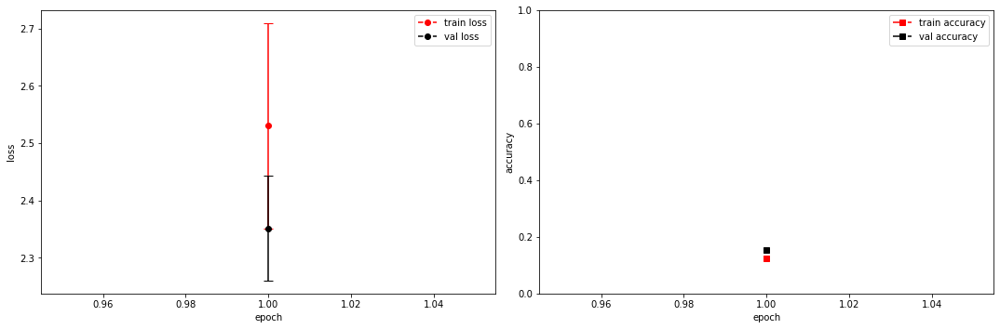

model saved


training epoch:  1
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [2/100], step [1/168],  Loss: 2.3135 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5221192836761475s
Epoch [2/100], step [17/168],  Loss: 2.3709 +/- 0.0765,  accuracy: 0.162109375, time elapsed = 6.243958950042725s
Epoch [2/100], step [33/168],  Loss: 2.3453 +/- 0.1065,  accuracy: 0.154296875, time elapsed = 6.276950359344482s
Epoch [2/100], step [49/168],  Loss: 2.3510 +/- 0.1212,  accuracy: 0.142578125, time elapsed = 6.2513792514801025s
Epoch [2/100], step [65/168],  Loss: 2.3797 +/- 0.0856,  accuracy: 0.134765625, time elapsed = 6.241343021392822s
Epoch [2/100], step [81/168],  Loss: 2.3380 +/- 0.1056,  accuracy: 0.158203125, time elapsed = 6.244031190872192s
Epoch [2/100], step [97/168],  Loss: 2.3166 +/- 0.0614,  accuracy: 0.171875, time elapsed = 6.241032600402832s
Epoch [2/100], step [113/168],  Loss: 2.3547 +/- 0.1106,  accuracy: 0.162109375, time elapsed = 6.241171598434448s
Epoch [2/100], step [129/168],  Loss: 2.3231 +/- 0.0892,  accuracy: 0.16015625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.158,  precision = 0.158 recall = 0.158 f1 = 0.158 ::: val: acc = 0.189,  precision = 0.189 recall = 0.189 time elapsed = 70.66157412528992s


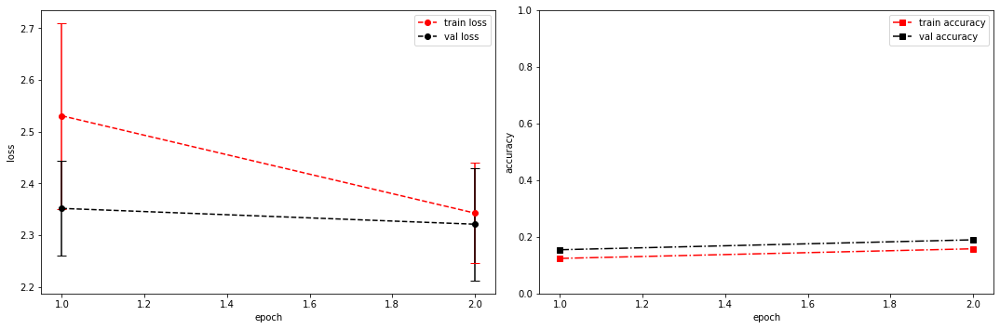

model saved


training epoch:  2
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [3/100], step [1/168],  Loss: 2.3613 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5275733470916748s
Epoch [3/100], step [17/168],  Loss: 2.2997 +/- 0.0723,  accuracy: 0.162109375, time elapsed = 6.248624801635742s
Epoch [3/100], step [33/168],  Loss: 2.3125 +/- 0.0590,  accuracy: 0.173828125, time elapsed = 6.574380159378052s
Epoch [3/100], step [49/168],  Loss: 2.3257 +/- 0.0872,  accuracy: 0.12890625, time elapsed = 6.523928880691528s
Epoch [3/100], step [65/168],  Loss: 2.2589 +/- 0.0782,  accuracy: 0.19921875, time elapsed = 6.538935899734497s
Epoch [3/100], step [81/168],  Loss: 2.3291 +/- 0.0831,  accuracy: 0.1640625, time elapsed = 6.251720666885376s
Epoch [3/100], step [97/168],  Loss: 2.3222 +/- 0.1370,  accuracy: 0.171875, time elapsed = 6.252464294433594s
Epoch [3/100], step [113/168],  Loss: 2.3025 +/- 0.0798,  accuracy: 0.166015625, time elapsed = 6.285248279571533s
Epoch [3/100], step [129/168],  Loss: 2.2737 +/- 0.0722,  accuracy: 0.203125, time elapsed = 6

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.176,  precision = 0.176 recall = 0.176 f1 = 0.176 ::: val: acc = 0.201,  precision = 0.201 recall = 0.201 time elapsed = 71.50031018257141s


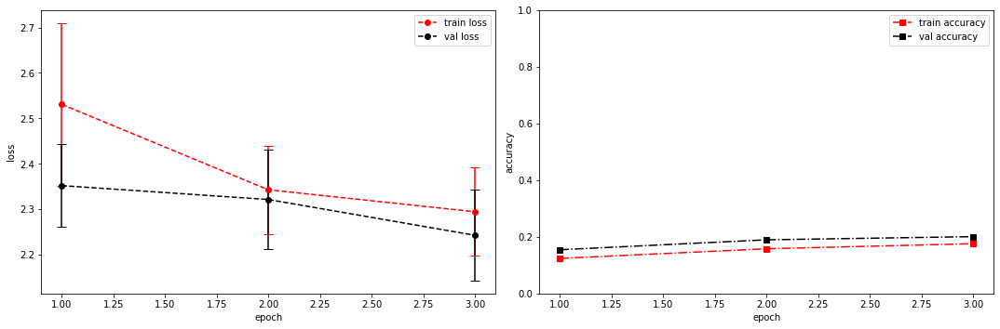

model saved


training epoch:  3
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [4/100], step [1/168],  Loss: 2.1768 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5274677276611328s
Epoch [4/100], step [17/168],  Loss: 2.2878 +/- 0.0918,  accuracy: 0.1875, time elapsed = 6.243785381317139s
Epoch [4/100], step [33/168],  Loss: 2.2690 +/- 0.1208,  accuracy: 0.19140625, time elapsed = 6.2449493408203125s
Epoch [4/100], step [49/168],  Loss: 2.2400 +/- 0.0877,  accuracy: 0.1875, time elapsed = 6.244747877120972s
Epoch [4/100], step [65/168],  Loss: 2.2055 +/- 0.0698,  accuracy: 0.189453125, time elapsed = 6.475960731506348s
Epoch [4/100], step [81/168],  Loss: 2.1985 +/- 0.0808,  accuracy: 0.197265625, time elapsed = 6.313512086868286s
Epoch [4/100], step [97/168],  Loss: 2.2153 +/- 0.1298,  accuracy: 0.18359375, time elapsed = 6.347607612609863s
Epoch [4/100], step [113/168],  Loss: 2.2402 +/- 0.0952,  accuracy: 0.201171875, time elapsed = 6.304431915283203s
Epoch [4/100], step [129/168],  Loss: 2.2650 +/- 0.0980,  accuracy: 0.181640625, time elapsed = 6.251

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.191,  precision = 0.191 recall = 0.191 f1 = 0.191 ::: val: acc = 0.221,  precision = 0.221 recall = 0.221 time elapsed = 71.19489002227783s


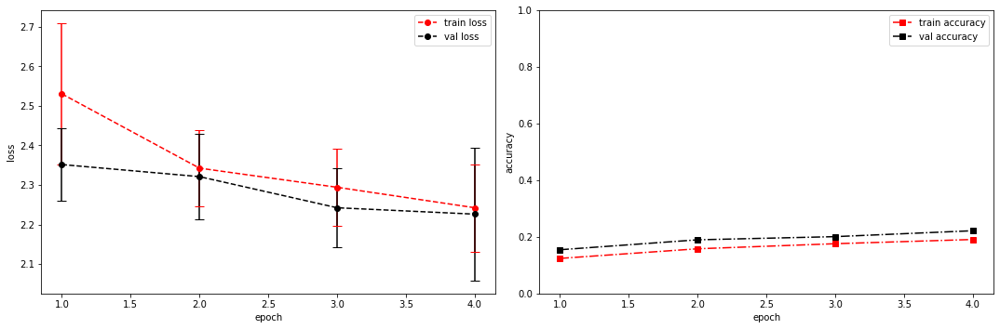

model saved


training epoch:  4
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [5/100], step [1/168],  Loss: 2.4808 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5223588943481445s
Epoch [5/100], step [17/168],  Loss: 2.2136 +/- 0.1356,  accuracy: 0.1875, time elapsed = 6.245371580123901s
Epoch [5/100], step [33/168],  Loss: 2.2429 +/- 0.1139,  accuracy: 0.189453125, time elapsed = 6.242595911026001s
Epoch [5/100], step [49/168],  Loss: 2.1864 +/- 0.1015,  accuracy: 0.193359375, time elapsed = 6.243218421936035s
Epoch [5/100], step [65/168],  Loss: 2.2434 +/- 0.0936,  accuracy: 0.181640625, time elapsed = 6.2428224086761475s
Epoch [5/100], step [81/168],  Loss: 2.1989 +/- 0.1035,  accuracy: 0.197265625, time elapsed = 6.2462639808654785s
Epoch [5/100], step [97/168],  Loss: 2.2217 +/- 0.0874,  accuracy: 0.208984375, time elapsed = 6.5036468505859375s
Epoch [5/100], step [113/168],  Loss: 2.2112 +/- 0.1030,  accuracy: 0.1953125, time elapsed = 6.657833576202393s
Epoch [5/100], step [129/168],  Loss: 2.2453 +/- 0.0959,  accuracy: 0.212890625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.198,  precision = 0.198 recall = 0.198 f1 = 0.198 ::: val: acc = 0.224,  precision = 0.224 recall = 0.224 time elapsed = 71.255038022995s


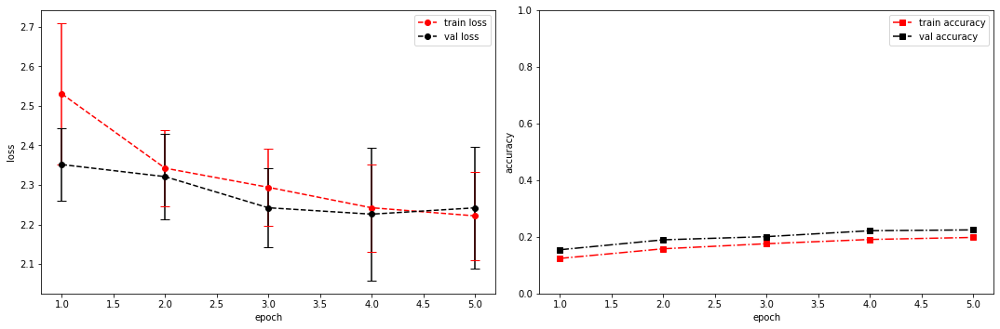

model saved


training epoch:  5
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [6/100], step [1/168],  Loss: 2.4496 +/- 0.0000,  accuracy: 0.0078125, time elapsed = 0.5291433334350586s
Epoch [6/100], step [17/168],  Loss: 2.1981 +/- 0.0872,  accuracy: 0.224609375, time elapsed = 6.245107412338257s
Epoch [6/100], step [33/168],  Loss: 2.1663 +/- 0.1245,  accuracy: 0.2578125, time elapsed = 6.243189811706543s
Epoch [6/100], step [49/168],  Loss: 2.2561 +/- 0.1041,  accuracy: 0.1875, time elapsed = 6.245519161224365s
Epoch [6/100], step [65/168],  Loss: 2.2229 +/- 0.1344,  accuracy: 0.236328125, time elapsed = 6.245838165283203s
Epoch [6/100], step [81/168],  Loss: 2.1644 +/- 0.1381,  accuracy: 0.208984375, time elapsed = 6.243439674377441s
Epoch [6/100], step [97/168],  Loss: 2.2420 +/- 0.1057,  accuracy: 0.1953125, time elapsed = 6.244114398956299s
Epoch [6/100], step [113/168],  Loss: 2.2287 +/- 0.0702,  accuracy: 0.1796875, time elapsed = 6.245537757873535s
Epoch [6/100], step [129/168],  Loss: 2.1862 +/- 0.1177,  accuracy: 0.23828125, time elapsed = 6.242

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.216,  precision = 0.216 recall = 0.216 f1 = 0.216 ::: val: acc = 0.242,  precision = 0.242 recall = 0.242 time elapsed = 70.49763870239258s


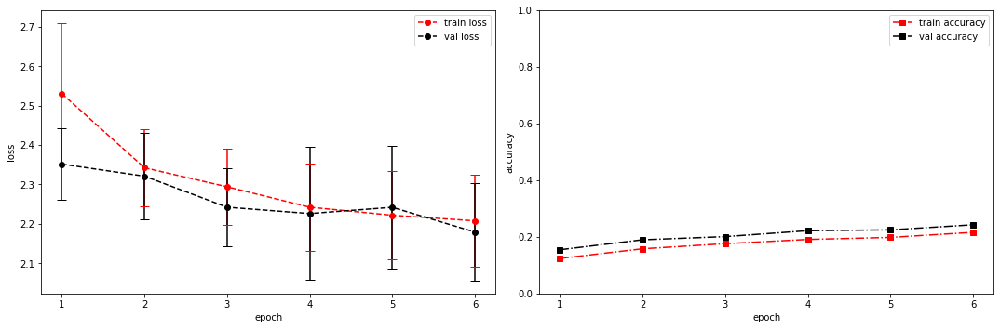

model saved


training epoch:  6
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [7/100], step [1/168],  Loss: 2.2458 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5267231464385986s
Epoch [7/100], step [17/168],  Loss: 2.1829 +/- 0.0863,  accuracy: 0.203125, time elapsed = 6.24357271194458s
Epoch [7/100], step [33/168],  Loss: 2.1686 +/- 0.0992,  accuracy: 0.23828125, time elapsed = 6.282992362976074s
Epoch [7/100], step [49/168],  Loss: 2.1944 +/- 0.0823,  accuracy: 0.224609375, time elapsed = 6.2427122592926025s
Epoch [7/100], step [65/168],  Loss: 2.1250 +/- 0.1276,  accuracy: 0.251953125, time elapsed = 6.242711544036865s
Epoch [7/100], step [81/168],  Loss: 2.1424 +/- 0.1058,  accuracy: 0.236328125, time elapsed = 6.2435712814331055s
Epoch [7/100], step [97/168],  Loss: 2.1663 +/- 0.1392,  accuracy: 0.2578125, time elapsed = 6.244441986083984s
Epoch [7/100], step [113/168],  Loss: 2.1804 +/- 0.0961,  accuracy: 0.21875, time elapsed = 6.241798162460327s
Epoch [7/100], step [129/168],  Loss: 2.1038 +/- 0.1359,  accuracy: 0.240234375, time elapsed = 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.228,  precision = 0.228 recall = 0.228 f1 = 0.228 ::: val: acc = 0.239,  precision = 0.239 recall = 0.239 time elapsed = 70.5741798877716s


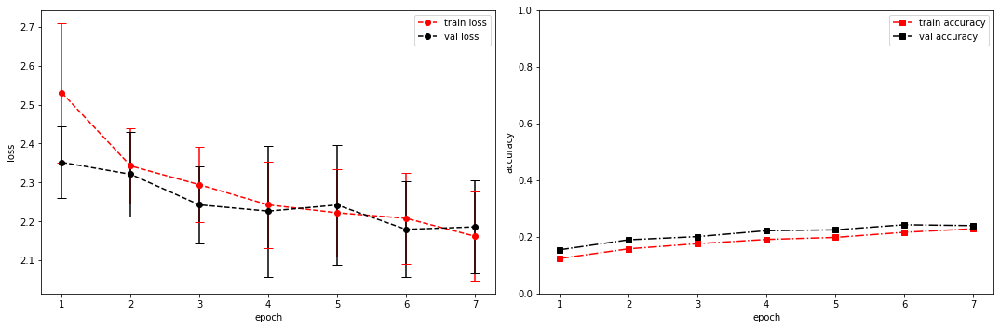

model saved


training epoch:  7
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [8/100], step [1/168],  Loss: 2.2839 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5306234359741211s
Epoch [8/100], step [17/168],  Loss: 2.1636 +/- 0.1399,  accuracy: 0.22265625, time elapsed = 6.2647385597229s
Epoch [8/100], step [33/168],  Loss: 2.1661 +/- 0.1286,  accuracy: 0.23828125, time elapsed = 6.264888525009155s
Epoch [8/100], step [49/168],  Loss: 2.1440 +/- 0.1329,  accuracy: 0.25, time elapsed = 6.26508641242981s
Epoch [8/100], step [65/168],  Loss: 2.1547 +/- 0.1059,  accuracy: 0.24609375, time elapsed = 6.267427444458008s
Epoch [8/100], step [81/168],  Loss: 2.0988 +/- 0.1489,  accuracy: 0.26953125, time elapsed = 6.2627246379852295s
Epoch [8/100], step [97/168],  Loss: 2.0997 +/- 0.1196,  accuracy: 0.248046875, time elapsed = 6.266180753707886s
Epoch [8/100], step [113/168],  Loss: 2.1011 +/- 0.1003,  accuracy: 0.259765625, time elapsed = 6.265692472457886s
Epoch [8/100], step [129/168],  Loss: 2.1708 +/- 0.1424,  accuracy: 0.236328125, time elapsed = 6.26

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.243,  precision = 0.243 recall = 0.243 f1 = 0.243 ::: val: acc = 0.265,  precision = 0.265 recall = 0.265 time elapsed = 70.80719757080078s


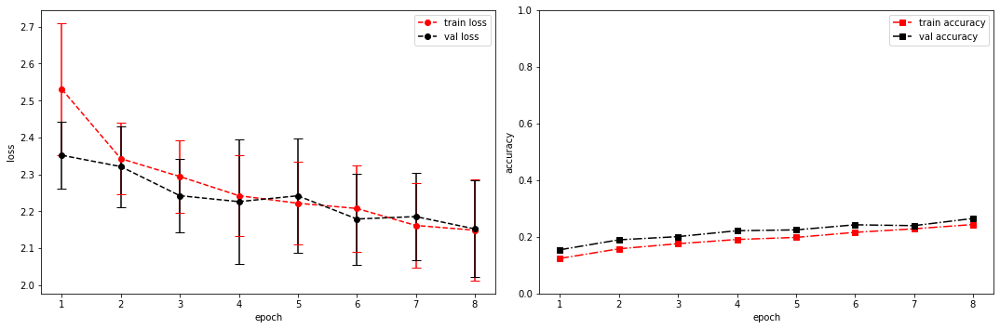

model saved


training epoch:  8
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [9/100], step [1/168],  Loss: 2.1561 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5320076942443848s
Epoch [9/100], step [17/168],  Loss: 2.1256 +/- 0.0905,  accuracy: 0.24609375, time elapsed = 6.242724418640137s
Epoch [9/100], step [33/168],  Loss: 2.1689 +/- 0.1342,  accuracy: 0.21484375, time elapsed = 6.2436981201171875s
Epoch [9/100], step [49/168],  Loss: 2.1575 +/- 0.1255,  accuracy: 0.236328125, time elapsed = 6.244705677032471s
Epoch [9/100], step [65/168],  Loss: 2.1008 +/- 0.1063,  accuracy: 0.275390625, time elapsed = 6.243593692779541s
Epoch [9/100], step [81/168],  Loss: 2.1127 +/- 0.1273,  accuracy: 0.24609375, time elapsed = 6.244657516479492s
Epoch [9/100], step [97/168],  Loss: 2.0871 +/- 0.1265,  accuracy: 0.271484375, time elapsed = 6.245422840118408s
Epoch [9/100], step [113/168],  Loss: 2.1460 +/- 0.1319,  accuracy: 0.24609375, time elapsed = 6.243985414505005s
Epoch [9/100], step [129/168],  Loss: 2.1190 +/- 0.1605,  accuracy: 0.275390625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.252,  precision = 0.252 recall = 0.252 f1 = 0.252 ::: val: acc = 0.242,  precision = 0.242 recall = 0.242 time elapsed = 71.31256008148193s


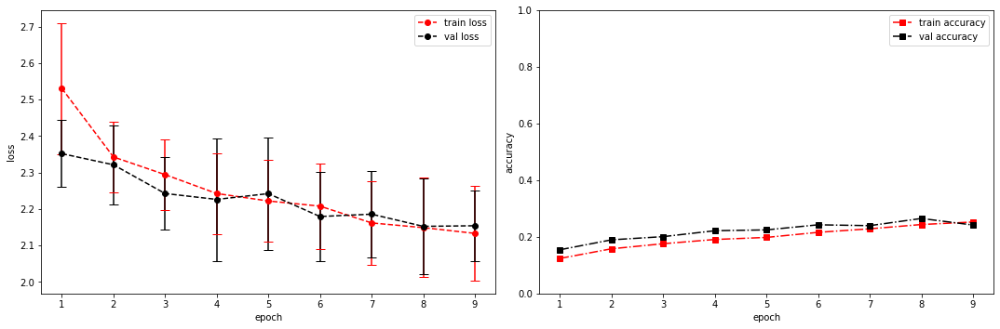

model saved


training epoch:  9
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [10/100], step [1/168],  Loss: 1.8473 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5226235389709473s
Epoch [10/100], step [17/168],  Loss: 2.1079 +/- 0.1049,  accuracy: 0.248046875, time elapsed = 6.324051141738892s
Epoch [10/100], step [33/168],  Loss: 2.1527 +/- 0.1164,  accuracy: 0.236328125, time elapsed = 6.239856958389282s
Epoch [10/100], step [49/168],  Loss: 2.1159 +/- 0.1069,  accuracy: 0.263671875, time elapsed = 6.240039110183716s
Epoch [10/100], step [65/168],  Loss: 2.1435 +/- 0.1291,  accuracy: 0.259765625, time elapsed = 6.240846872329712s
Epoch [10/100], step [81/168],  Loss: 2.1615 +/- 0.1386,  accuracy: 0.25, time elapsed = 6.23970103263855s
Epoch [10/100], step [97/168],  Loss: 2.0846 +/- 0.1569,  accuracy: 0.26171875, time elapsed = 6.252177476882935s
Epoch [10/100], step [113/168],  Loss: 2.1479 +/- 0.1109,  accuracy: 0.265625, time elapsed = 6.241933345794678s
Epoch [10/100], step [129/168],  Loss: 2.0865 +/- 0.0832,  accuracy: 0.27734375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.265,  precision = 0.265 recall = 0.265 f1 = 0.265 ::: val: acc = 0.280,  precision = 0.280 recall = 0.280 time elapsed = 70.5631012916565s


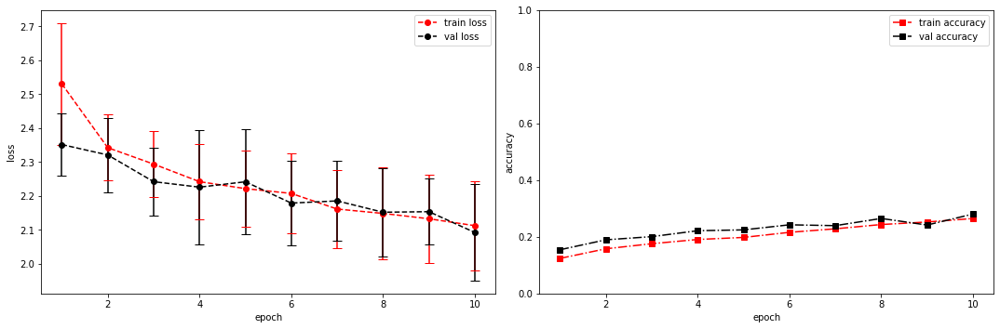

model saved


training epoch:  10
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [11/100], step [1/168],  Loss: 2.1030 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5205187797546387s
Epoch [11/100], step [17/168],  Loss: 2.0953 +/- 0.1316,  accuracy: 0.267578125, time elapsed = 6.2416205406188965s
Epoch [11/100], step [33/168],  Loss: 2.0847 +/- 0.1738,  accuracy: 0.265625, time elapsed = 6.239779710769653s
Epoch [11/100], step [49/168],  Loss: 2.0240 +/- 0.1152,  accuracy: 0.298828125, time elapsed = 6.240280389785767s
Epoch [11/100], step [65/168],  Loss: 2.1314 +/- 0.1498,  accuracy: 0.2578125, time elapsed = 6.247485399246216s
Epoch [11/100], step [81/168],  Loss: 2.0865 +/- 0.1436,  accuracy: 0.27734375, time elapsed = 6.240129709243774s
Epoch [11/100], step [97/168],  Loss: 2.1102 +/- 0.1235,  accuracy: 0.248046875, time elapsed = 6.241440773010254s
Epoch [11/100], step [113/168],  Loss: 2.1278 +/- 0.1329,  accuracy: 0.232421875, time elapsed = 6.241674184799194s
Epoch [11/100], step [129/168],  Loss: 2.0634 +/- 0.1475,  accuracy: 0.2890625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.276,  precision = 0.276 recall = 0.276 f1 = 0.276 ::: val: acc = 0.291,  precision = 0.291 recall = 0.291 time elapsed = 70.49067091941833s


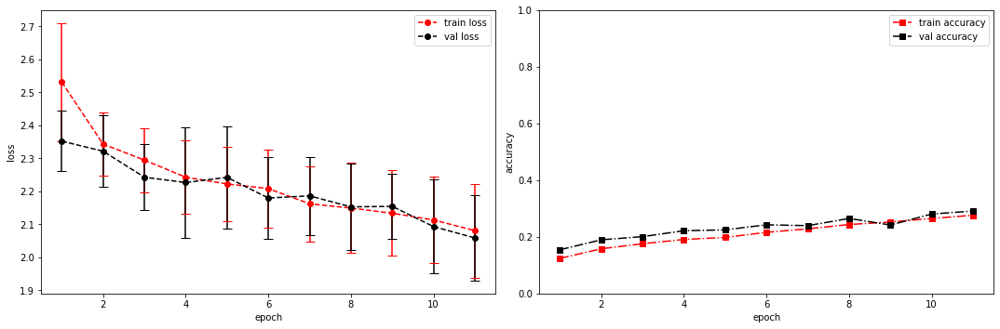

model saved


training epoch:  11
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [12/100], step [1/168],  Loss: 2.0907 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5217320919036865s
Epoch [12/100], step [17/168],  Loss: 2.0859 +/- 0.1842,  accuracy: 0.283203125, time elapsed = 6.241793394088745s
Epoch [12/100], step [33/168],  Loss: 2.0336 +/- 0.1163,  accuracy: 0.3125, time elapsed = 6.251563787460327s
Epoch [12/100], step [49/168],  Loss: 2.0268 +/- 0.1565,  accuracy: 0.32421875, time elapsed = 6.2421228885650635s
Epoch [12/100], step [65/168],  Loss: 2.0534 +/- 0.1570,  accuracy: 0.30859375, time elapsed = 6.241780519485474s
Epoch [12/100], step [81/168],  Loss: 2.0854 +/- 0.1525,  accuracy: 0.265625, time elapsed = 6.242185831069946s
Epoch [12/100], step [97/168],  Loss: 2.0939 +/- 0.0915,  accuracy: 0.26171875, time elapsed = 6.2418107986450195s
Epoch [12/100], step [113/168],  Loss: 1.9582 +/- 0.0775,  accuracy: 0.328125, time elapsed = 6.240895748138428s
Epoch [12/100], step [129/168],  Loss: 2.0747 +/- 0.1641,  accuracy: 0.294921875, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.293,  precision = 0.293 recall = 0.293 f1 = 0.293 ::: val: acc = 0.265,  precision = 0.265 recall = 0.265 time elapsed = 70.51545453071594s


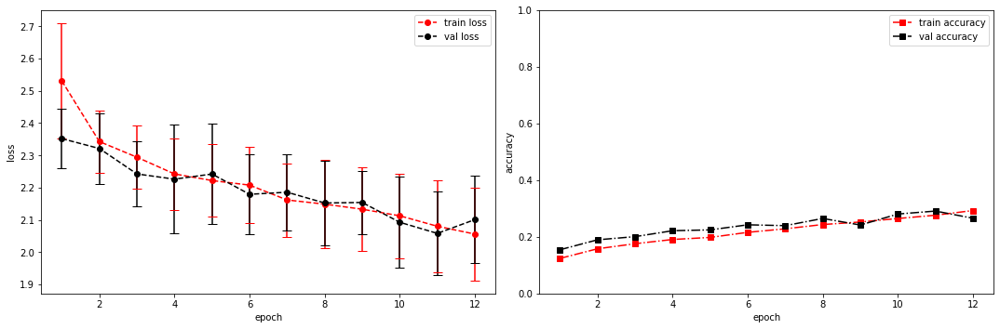

model saved


training epoch:  12
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [13/100], step [1/168],  Loss: 2.0498 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5252246856689453s
Epoch [13/100], step [17/168],  Loss: 1.9718 +/- 0.0964,  accuracy: 0.29296875, time elapsed = 6.262661695480347s
Epoch [13/100], step [33/168],  Loss: 2.0298 +/- 0.0848,  accuracy: 0.302734375, time elapsed = 6.261335372924805s
Epoch [13/100], step [49/168],  Loss: 2.0113 +/- 0.1453,  accuracy: 0.318359375, time elapsed = 6.26361083984375s
Epoch [13/100], step [65/168],  Loss: 2.0660 +/- 0.0855,  accuracy: 0.263671875, time elapsed = 6.26250958442688s
Epoch [13/100], step [81/168],  Loss: 2.0464 +/- 0.1457,  accuracy: 0.298828125, time elapsed = 6.261922836303711s
Epoch [13/100], step [97/168],  Loss: 2.0205 +/- 0.1095,  accuracy: 0.306640625, time elapsed = 6.261073589324951s
Epoch [13/100], step [113/168],  Loss: 2.0773 +/- 0.1076,  accuracy: 0.287109375, time elapsed = 6.263108015060425s
Epoch [13/100], step [129/168],  Loss: 2.0106 +/- 0.1221,  accuracy: 0.3125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.298,  precision = 0.298 recall = 0.298 f1 = 0.298 ::: val: acc = 0.313,  precision = 0.313 recall = 0.313 time elapsed = 70.73447847366333s


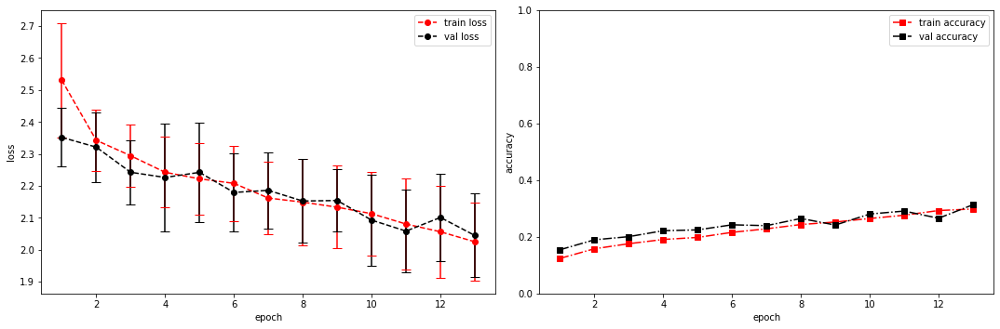

model saved


training epoch:  13
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [14/100], step [1/168],  Loss: 1.9675 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5327775478363037s
Epoch [14/100], step [17/168],  Loss: 2.0640 +/- 0.1678,  accuracy: 0.283203125, time elapsed = 6.262545347213745s
Epoch [14/100], step [33/168],  Loss: 1.9363 +/- 0.1251,  accuracy: 0.3125, time elapsed = 6.26017689704895s
Epoch [14/100], step [49/168],  Loss: 2.0626 +/- 0.1277,  accuracy: 0.28125, time elapsed = 6.261707782745361s
Epoch [14/100], step [65/168],  Loss: 2.0380 +/- 0.1484,  accuracy: 0.3046875, time elapsed = 6.260953187942505s
Epoch [14/100], step [81/168],  Loss: 2.0062 +/- 0.1404,  accuracy: 0.306640625, time elapsed = 6.261525869369507s
Epoch [14/100], step [97/168],  Loss: 2.0339 +/- 0.1613,  accuracy: 0.3125, time elapsed = 6.261280298233032s
Epoch [14/100], step [113/168],  Loss: 2.0174 +/- 0.1264,  accuracy: 0.33203125, time elapsed = 6.261741876602173s
Epoch [14/100], step [129/168],  Loss: 2.1120 +/- 0.1235,  accuracy: 0.27734375, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.305,  precision = 0.305 recall = 0.305 f1 = 0.305 ::: val: acc = 0.314,  precision = 0.314 recall = 0.314 time elapsed = 70.72517538070679s


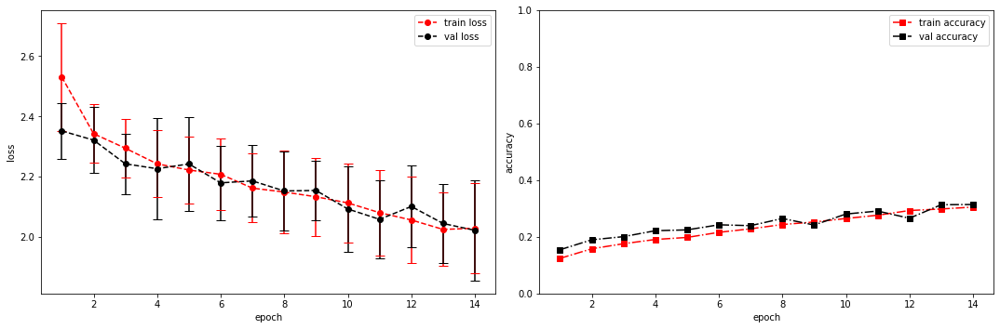

model saved


training epoch:  14
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [15/100], step [1/168],  Loss: 2.1566 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5288691520690918s
Epoch [15/100], step [17/168],  Loss: 1.9989 +/- 0.0882,  accuracy: 0.302734375, time elapsed = 6.240978240966797s
Epoch [15/100], step [33/168],  Loss: 1.9999 +/- 0.1161,  accuracy: 0.3359375, time elapsed = 6.240741491317749s
Epoch [15/100], step [49/168],  Loss: 2.0827 +/- 0.1684,  accuracy: 0.275390625, time elapsed = 6.239284038543701s
Epoch [15/100], step [65/168],  Loss: 1.9972 +/- 0.1534,  accuracy: 0.298828125, time elapsed = 6.239886522293091s
Epoch [15/100], step [81/168],  Loss: 1.9798 +/- 0.1312,  accuracy: 0.314453125, time elapsed = 6.238453149795532s
Epoch [15/100], step [97/168],  Loss: 1.9574 +/- 0.1131,  accuracy: 0.3359375, time elapsed = 6.240432262420654s
Epoch [15/100], step [113/168],  Loss: 2.0373 +/- 0.1477,  accuracy: 0.291015625, time elapsed = 6.245688199996948s
Epoch [15/100], step [129/168],  Loss: 2.0082 +/- 0.1477,  accuracy: 0.326171875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.306,  precision = 0.306 recall = 0.306 f1 = 0.306 ::: val: acc = 0.316,  precision = 0.316 recall = 0.316 time elapsed = 70.46460676193237s


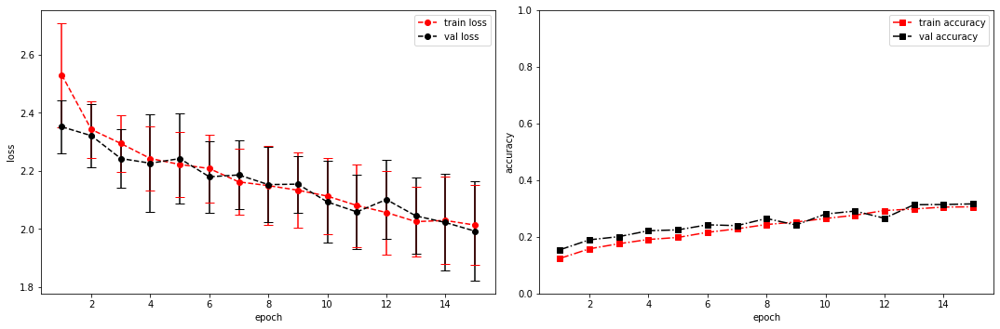

model saved


training epoch:  15
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [16/100], step [1/168],  Loss: 2.1698 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5235381126403809s
Epoch [16/100], step [17/168],  Loss: 1.9784 +/- 0.2022,  accuracy: 0.34375, time elapsed = 6.241934537887573s
Epoch [16/100], step [33/168],  Loss: 1.9957 +/- 0.1387,  accuracy: 0.306640625, time elapsed = 6.2430830001831055s
Epoch [16/100], step [49/168],  Loss: 1.9784 +/- 0.1609,  accuracy: 0.333984375, time elapsed = 6.240586280822754s
Epoch [16/100], step [65/168],  Loss: 1.9503 +/- 0.1056,  accuracy: 0.3046875, time elapsed = 6.24440860748291s
Epoch [16/100], step [81/168],  Loss: 2.0191 +/- 0.1637,  accuracy: 0.30078125, time elapsed = 6.245779991149902s
Epoch [16/100], step [97/168],  Loss: 1.9375 +/- 0.1118,  accuracy: 0.337890625, time elapsed = 6.242039680480957s
Epoch [16/100], step [113/168],  Loss: 2.0421 +/- 0.0871,  accuracy: 0.30078125, time elapsed = 6.239328145980835s
Epoch [16/100], step [129/168],  Loss: 1.9653 +/- 0.1603,  accuracy: 0.3359375, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.318,  precision = 0.318 recall = 0.318 f1 = 0.318 ::: val: acc = 0.321,  precision = 0.321 recall = 0.321 time elapsed = 70.47387480735779s


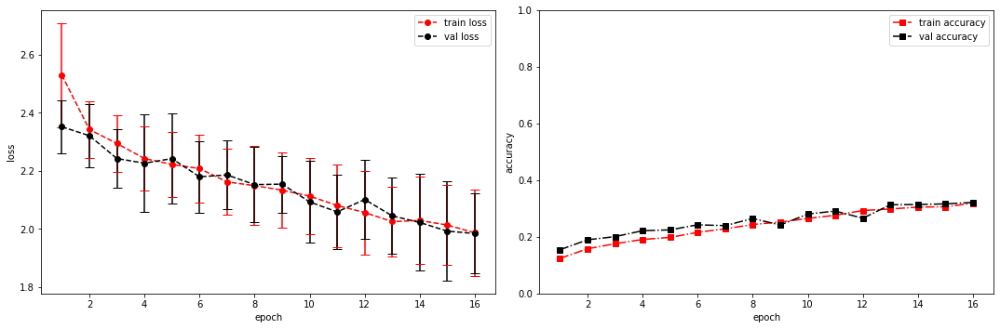

model saved


training epoch:  16
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [17/100], step [1/168],  Loss: 1.8346 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5279116630554199s
Epoch [17/100], step [17/168],  Loss: 1.9140 +/- 0.1820,  accuracy: 0.3671875, time elapsed = 6.23818039894104s
Epoch [17/100], step [33/168],  Loss: 2.0205 +/- 0.1709,  accuracy: 0.30859375, time elapsed = 6.238270998001099s
Epoch [17/100], step [49/168],  Loss: 1.9658 +/- 0.1325,  accuracy: 0.328125, time elapsed = 6.252291679382324s
Epoch [17/100], step [65/168],  Loss: 1.9298 +/- 0.1578,  accuracy: 0.337890625, time elapsed = 6.238951206207275s
Epoch [17/100], step [81/168],  Loss: 1.9183 +/- 0.1138,  accuracy: 0.33984375, time elapsed = 6.238236427307129s
Epoch [17/100], step [97/168],  Loss: 1.9002 +/- 0.1389,  accuracy: 0.375, time elapsed = 6.23997163772583s
Epoch [17/100], step [113/168],  Loss: 1.8828 +/- 0.1656,  accuracy: 0.37890625, time elapsed = 6.238685846328735s
Epoch [17/100], step [129/168],  Loss: 2.0241 +/- 0.1510,  accuracy: 0.326171875, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.338,  precision = 0.338 recall = 0.338 f1 = 0.338 ::: val: acc = 0.298,  precision = 0.298 recall = 0.298 time elapsed = 70.47029662132263s


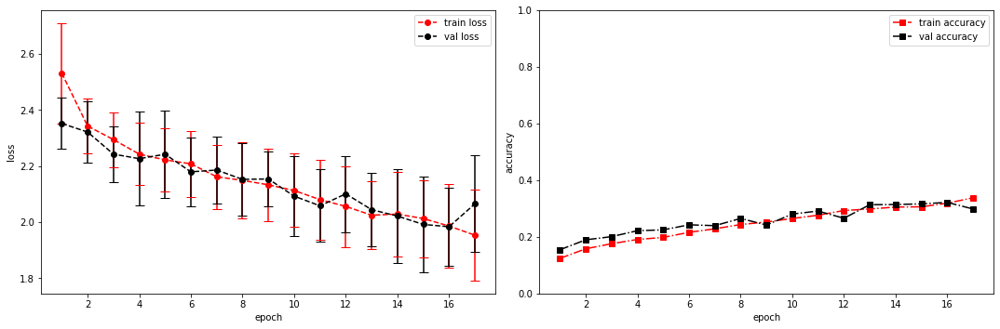

model saved


training epoch:  17
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [18/100], step [1/168],  Loss: 2.0151 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5235838890075684s
Epoch [18/100], step [17/168],  Loss: 1.9601 +/- 0.1386,  accuracy: 0.306640625, time elapsed = 6.242227077484131s
Epoch [18/100], step [33/168],  Loss: 1.9232 +/- 0.1534,  accuracy: 0.3671875, time elapsed = 6.239075422286987s
Epoch [18/100], step [49/168],  Loss: 1.9059 +/- 0.1473,  accuracy: 0.3359375, time elapsed = 6.239087104797363s
Epoch [18/100], step [65/168],  Loss: 1.9571 +/- 0.1501,  accuracy: 0.314453125, time elapsed = 6.241074085235596s
Epoch [18/100], step [81/168],  Loss: 1.9489 +/- 0.1728,  accuracy: 0.337890625, time elapsed = 6.239169359207153s
Epoch [18/100], step [97/168],  Loss: 1.9562 +/- 0.1502,  accuracy: 0.357421875, time elapsed = 6.2390971183776855s
Epoch [18/100], step [113/168],  Loss: 1.9523 +/- 0.1364,  accuracy: 0.3203125, time elapsed = 6.239307880401611s
Epoch [18/100], step [129/168],  Loss: 1.9048 +/- 0.1958,  accuracy: 0.359375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.339,  precision = 0.339 recall = 0.339 f1 = 0.339 ::: val: acc = 0.327,  precision = 0.327 recall = 0.327 time elapsed = 70.49283242225647s


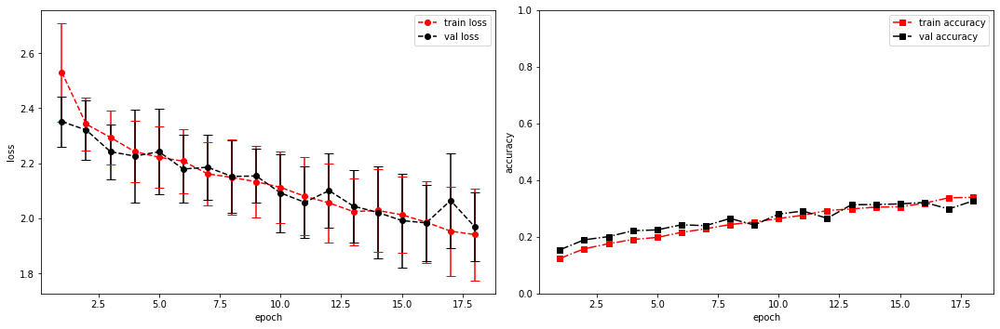

model saved


training epoch:  18
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [19/100], step [1/168],  Loss: 1.9102 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5251235961914062s
Epoch [19/100], step [17/168],  Loss: 1.8726 +/- 0.1827,  accuracy: 0.361328125, time elapsed = 6.240753412246704s
Epoch [19/100], step [33/168],  Loss: 1.9639 +/- 0.1541,  accuracy: 0.3125, time elapsed = 6.241691589355469s
Epoch [19/100], step [49/168],  Loss: 1.9992 +/- 0.2417,  accuracy: 0.353515625, time elapsed = 6.2412145137786865s
Epoch [19/100], step [65/168],  Loss: 1.9090 +/- 0.1162,  accuracy: 0.34375, time elapsed = 6.240631341934204s
Epoch [19/100], step [81/168],  Loss: 1.9515 +/- 0.1339,  accuracy: 0.330078125, time elapsed = 6.239842891693115s
Epoch [19/100], step [97/168],  Loss: 1.9404 +/- 0.1680,  accuracy: 0.341796875, time elapsed = 6.240405321121216s
Epoch [19/100], step [113/168],  Loss: 1.9364 +/- 0.1381,  accuracy: 0.349609375, time elapsed = 6.241109609603882s
Epoch [19/100], step [129/168],  Loss: 1.8430 +/- 0.1436,  accuracy: 0.359375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.346,  precision = 0.346 recall = 0.346 f1 = 0.346 ::: val: acc = 0.348,  precision = 0.348 recall = 0.348 time elapsed = 70.47354912757874s


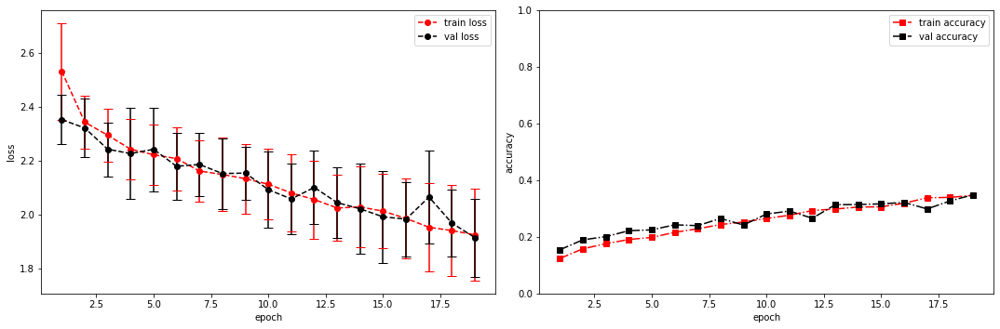

model saved


training epoch:  19
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [20/100], step [1/168],  Loss: 1.8100 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5298295021057129s
Epoch [20/100], step [17/168],  Loss: 1.8689 +/- 0.1838,  accuracy: 0.33984375, time elapsed = 6.2434046268463135s
Epoch [20/100], step [33/168],  Loss: 1.8715 +/- 0.1242,  accuracy: 0.37890625, time elapsed = 6.2429726123809814s
Epoch [20/100], step [49/168],  Loss: 1.9533 +/- 0.1236,  accuracy: 0.322265625, time elapsed = 6.24185585975647s
Epoch [20/100], step [65/168],  Loss: 1.9324 +/- 0.1561,  accuracy: 0.341796875, time elapsed = 6.241800546646118s
Epoch [20/100], step [81/168],  Loss: 1.8741 +/- 0.1219,  accuracy: 0.35546875, time elapsed = 6.243473291397095s
Epoch [20/100], step [97/168],  Loss: 1.8949 +/- 0.1323,  accuracy: 0.337890625, time elapsed = 6.24158239364624s
Epoch [20/100], step [113/168],  Loss: 1.9351 +/- 0.1397,  accuracy: 0.326171875, time elapsed = 6.255266189575195s
Epoch [20/100], step [129/168],  Loss: 1.8588 +/- 0.1050,  accuracy: 0.349609375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.348,  precision = 0.348 recall = 0.348 f1 = 0.348 ::: val: acc = 0.350,  precision = 0.350 recall = 0.350 time elapsed = 70.51478171348572s


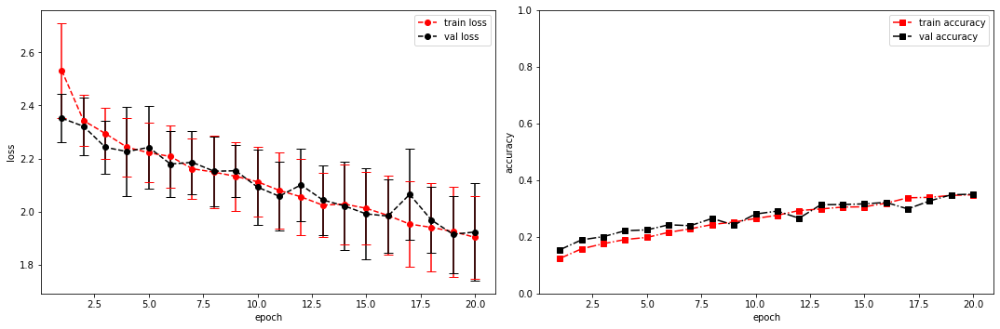

model saved


training epoch:  20
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [21/100], step [1/168],  Loss: 2.0449 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5321815013885498s
Epoch [21/100], step [17/168],  Loss: 1.8930 +/- 0.1818,  accuracy: 0.345703125, time elapsed = 6.2411415576934814s
Epoch [21/100], step [33/168],  Loss: 1.8925 +/- 0.1586,  accuracy: 0.34765625, time elapsed = 6.240444660186768s
Epoch [21/100], step [49/168],  Loss: 1.8614 +/- 0.1244,  accuracy: 0.3671875, time elapsed = 6.240403652191162s
Epoch [21/100], step [65/168],  Loss: 1.9514 +/- 0.1353,  accuracy: 0.326171875, time elapsed = 6.242050647735596s
Epoch [21/100], step [81/168],  Loss: 1.8905 +/- 0.0974,  accuracy: 0.361328125, time elapsed = 6.242700099945068s
Epoch [21/100], step [97/168],  Loss: 1.9086 +/- 0.1496,  accuracy: 0.353515625, time elapsed = 6.241437911987305s
Epoch [21/100], step [113/168],  Loss: 1.8796 +/- 0.1891,  accuracy: 0.361328125, time elapsed = 6.241370439529419s
Epoch [21/100], step [129/168],  Loss: 1.8610 +/- 0.1734,  accuracy: 0.3671875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.353,  precision = 0.353 recall = 0.353 f1 = 0.353 ::: val: acc = 0.345,  precision = 0.345 recall = 0.345 time elapsed = 70.4848530292511s


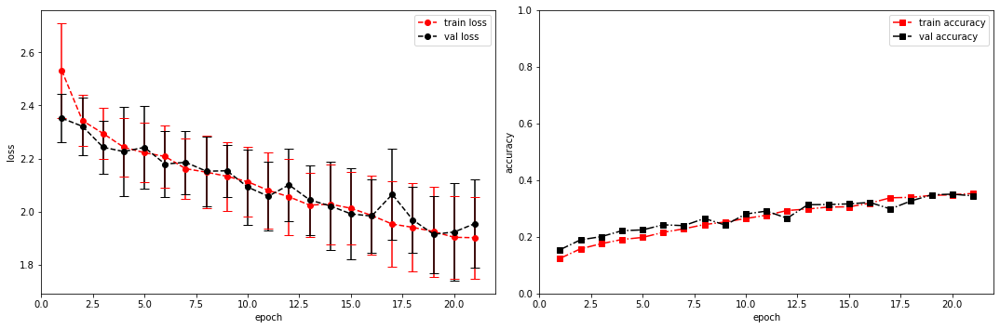

model saved


training epoch:  21
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [22/100], step [1/168],  Loss: 1.8622 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5259268283843994s
Epoch [22/100], step [17/168],  Loss: 1.8465 +/- 0.1700,  accuracy: 0.357421875, time elapsed = 6.2417497634887695s
Epoch [22/100], step [33/168],  Loss: 1.8502 +/- 0.1348,  accuracy: 0.384765625, time elapsed = 6.242502689361572s
Epoch [22/100], step [49/168],  Loss: 1.8822 +/- 0.1254,  accuracy: 0.384765625, time elapsed = 6.2423295974731445s
Epoch [22/100], step [65/168],  Loss: 1.8263 +/- 0.1528,  accuracy: 0.400390625, time elapsed = 6.256272554397583s
Epoch [22/100], step [81/168],  Loss: 1.8958 +/- 0.1850,  accuracy: 0.353515625, time elapsed = 6.244457960128784s
Epoch [22/100], step [97/168],  Loss: 1.9000 +/- 0.1674,  accuracy: 0.341796875, time elapsed = 6.243714809417725s
Epoch [22/100], step [113/168],  Loss: 1.8915 +/- 0.1854,  accuracy: 0.361328125, time elapsed = 6.243533134460449s
Epoch [22/100], step [129/168],  Loss: 1.8987 +/- 0.1540,  accuracy: 0.34179687

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.368,  precision = 0.368 recall = 0.368 f1 = 0.368 ::: val: acc = 0.345,  precision = 0.345 recall = 0.345 time elapsed = 70.50929570198059s


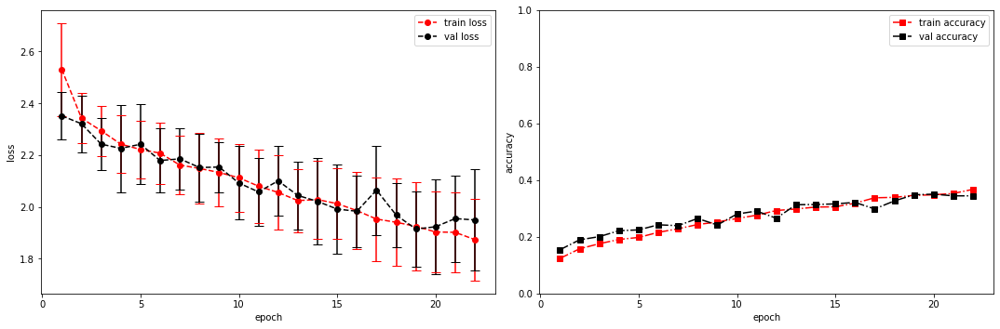

model saved


training epoch:  22
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [23/100], step [1/168],  Loss: 1.9254 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.52626633644104s
Epoch [23/100], step [17/168],  Loss: 1.9039 +/- 0.1754,  accuracy: 0.375, time elapsed = 6.241351366043091s
Epoch [23/100], step [33/168],  Loss: 1.7773 +/- 0.1719,  accuracy: 0.40625, time elapsed = 6.241802930831909s
Epoch [23/100], step [49/168],  Loss: 1.8275 +/- 0.1264,  accuracy: 0.37890625, time elapsed = 6.240872621536255s
Epoch [23/100], step [65/168],  Loss: 1.8968 +/- 0.1579,  accuracy: 0.34765625, time elapsed = 6.24121880531311s
Epoch [23/100], step [81/168],  Loss: 1.8052 +/- 0.1818,  accuracy: 0.380859375, time elapsed = 6.240365266799927s
Epoch [23/100], step [97/168],  Loss: 1.8632 +/- 0.1575,  accuracy: 0.3671875, time elapsed = 6.241184949874878s
Epoch [23/100], step [113/168],  Loss: 1.8444 +/- 0.1457,  accuracy: 0.388671875, time elapsed = 6.241217851638794s
Epoch [23/100], step [129/168],  Loss: 1.8219 +/- 0.1369,  accuracy: 0.412109375, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.375,  precision = 0.375 recall = 0.375 f1 = 0.375 ::: val: acc = 0.368,  precision = 0.368 recall = 0.368 time elapsed = 70.47490787506104s


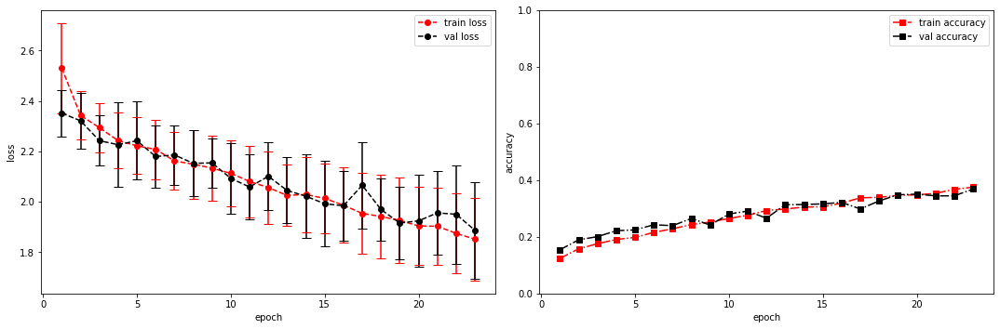

model saved


training epoch:  23
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [24/100], step [1/168],  Loss: 1.6728 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5359272956848145s
Epoch [24/100], step [17/168],  Loss: 1.8170 +/- 0.1536,  accuracy: 0.380859375, time elapsed = 6.2426745891571045s
Epoch [24/100], step [33/168],  Loss: 1.7834 +/- 0.1834,  accuracy: 0.384765625, time elapsed = 6.241915941238403s
Epoch [24/100], step [49/168],  Loss: 1.8348 +/- 0.1314,  accuracy: 0.37109375, time elapsed = 6.241011381149292s
Epoch [24/100], step [65/168],  Loss: 1.8891 +/- 0.1856,  accuracy: 0.35546875, time elapsed = 6.241110324859619s
Epoch [24/100], step [81/168],  Loss: 1.8596 +/- 0.1273,  accuracy: 0.376953125, time elapsed = 6.241047382354736s
Epoch [24/100], step [97/168],  Loss: 1.8497 +/- 0.1604,  accuracy: 0.3828125, time elapsed = 6.241394519805908s
Epoch [24/100], step [113/168],  Loss: 1.9576 +/- 0.2481,  accuracy: 0.345703125, time elapsed = 6.241758584976196s
Epoch [24/100], step [129/168],  Loss: 1.8432 +/- 0.1225,  accuracy: 0.376953125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.374,  precision = 0.374 recall = 0.374 f1 = 0.374 ::: val: acc = 0.356,  precision = 0.356 recall = 0.356 time elapsed = 70.49005913734436s


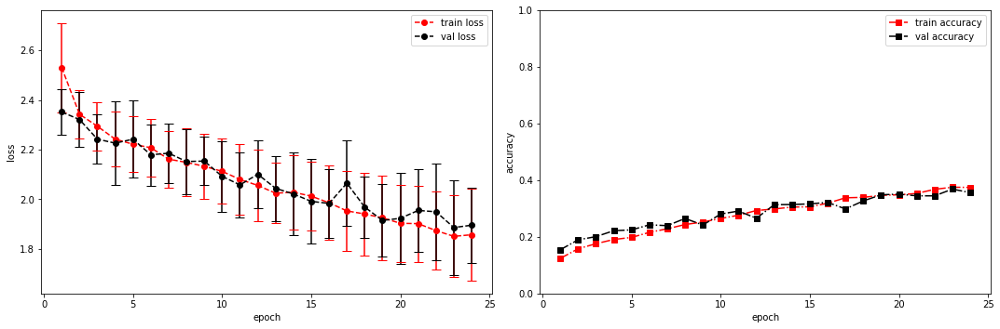

model saved


training epoch:  24
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [25/100], step [1/168],  Loss: 1.4248 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.56349778175354s
Epoch [25/100], step [17/168],  Loss: 1.7197 +/- 0.1799,  accuracy: 0.44140625, time elapsed = 6.24066424369812s
Epoch [25/100], step [33/168],  Loss: 1.7548 +/- 0.1679,  accuracy: 0.419921875, time elapsed = 6.2410619258880615s
Epoch [25/100], step [49/168],  Loss: 1.8420 +/- 0.1719,  accuracy: 0.38671875, time elapsed = 6.241029262542725s
Epoch [25/100], step [65/168],  Loss: 1.8111 +/- 0.1670,  accuracy: 0.40234375, time elapsed = 6.240973234176636s
Epoch [25/100], step [81/168],  Loss: 1.8369 +/- 0.1478,  accuracy: 0.3671875, time elapsed = 6.240697383880615s
Epoch [25/100], step [97/168],  Loss: 1.8401 +/- 0.1676,  accuracy: 0.400390625, time elapsed = 6.241710901260376s
Epoch [25/100], step [113/168],  Loss: 1.7986 +/- 0.1623,  accuracy: 0.396484375, time elapsed = 6.240153551101685s
Epoch [25/100], step [129/168],  Loss: 1.8760 +/- 0.1942,  accuracy: 0.388671875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.393,  precision = 0.393 recall = 0.393 f1 = 0.393 ::: val: acc = 0.356,  precision = 0.356 recall = 0.356 time elapsed = 70.53384256362915s


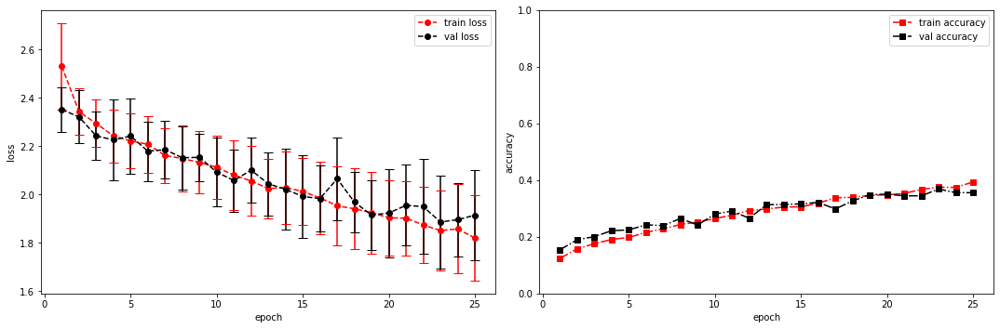

model saved


training epoch:  25
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [26/100], step [1/168],  Loss: 1.6875 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5318231582641602s
Epoch [26/100], step [17/168],  Loss: 1.8001 +/- 0.1315,  accuracy: 0.37890625, time elapsed = 6.2399821281433105s
Epoch [26/100], step [33/168],  Loss: 1.7868 +/- 0.1699,  accuracy: 0.416015625, time elapsed = 6.2409303188323975s
Epoch [26/100], step [49/168],  Loss: 1.8565 +/- 0.1180,  accuracy: 0.396484375, time elapsed = 6.2413012981414795s
Epoch [26/100], step [65/168],  Loss: 1.8266 +/- 0.1640,  accuracy: 0.37890625, time elapsed = 6.241666793823242s
Epoch [26/100], step [81/168],  Loss: 1.9444 +/- 0.1601,  accuracy: 0.34765625, time elapsed = 6.241167306900024s
Epoch [26/100], step [97/168],  Loss: 1.7798 +/- 0.2135,  accuracy: 0.4140625, time elapsed = 6.243257999420166s
Epoch [26/100], step [113/168],  Loss: 1.8051 +/- 0.1298,  accuracy: 0.404296875, time elapsed = 6.241885423660278s
Epoch [26/100], step [129/168],  Loss: 1.7929 +/- 0.1783,  accuracy: 0.40234375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.394,  precision = 0.394 recall = 0.394 f1 = 0.394 ::: val: acc = 0.364,  precision = 0.364 recall = 0.364 time elapsed = 70.48586535453796s


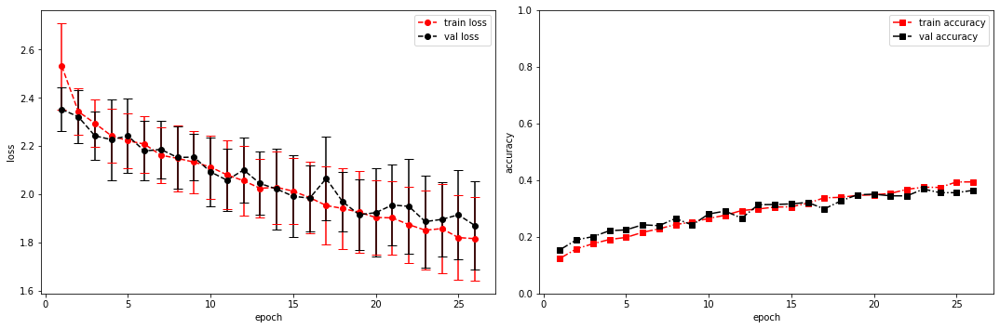

model saved


training epoch:  26
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [27/100], step [1/168],  Loss: 1.8555 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5241215229034424s
Epoch [27/100], step [17/168],  Loss: 1.7258 +/- 0.1430,  accuracy: 0.4296875, time elapsed = 6.242110013961792s
Epoch [27/100], step [33/168],  Loss: 1.7808 +/- 0.1820,  accuracy: 0.3984375, time elapsed = 6.240679979324341s
Epoch [27/100], step [49/168],  Loss: 1.7929 +/- 0.1095,  accuracy: 0.400390625, time elapsed = 6.2408998012542725s
Epoch [27/100], step [65/168],  Loss: 1.8472 +/- 0.1530,  accuracy: 0.380859375, time elapsed = 6.241785764694214s
Epoch [27/100], step [81/168],  Loss: 1.7081 +/- 0.1703,  accuracy: 0.458984375, time elapsed = 6.252121210098267s
Epoch [27/100], step [97/168],  Loss: 1.7533 +/- 0.1755,  accuracy: 0.4296875, time elapsed = 6.2408387660980225s
Epoch [27/100], step [113/168],  Loss: 1.8012 +/- 0.1924,  accuracy: 0.4140625, time elapsed = 6.241187810897827s
Epoch [27/100], step [129/168],  Loss: 1.8022 +/- 0.1369,  accuracy: 0.380859375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.406,  precision = 0.406 recall = 0.406 f1 = 0.406 ::: val: acc = 0.383,  precision = 0.383 recall = 0.383 time elapsed = 70.48569393157959s


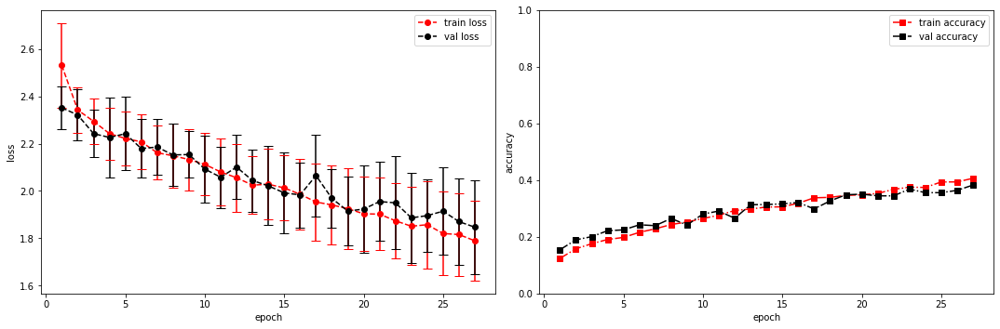

model saved


training epoch:  27
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [28/100], step [1/168],  Loss: 1.7736 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5262904167175293s
Epoch [28/100], step [17/168],  Loss: 1.7577 +/- 0.1800,  accuracy: 0.408203125, time elapsed = 6.24267578125s
Epoch [28/100], step [33/168],  Loss: 1.7621 +/- 0.1371,  accuracy: 0.40625, time elapsed = 6.243085861206055s
Epoch [28/100], step [49/168],  Loss: 1.7737 +/- 0.1203,  accuracy: 0.40625, time elapsed = 6.241609334945679s
Epoch [28/100], step [65/168],  Loss: 1.7819 +/- 0.1430,  accuracy: 0.400390625, time elapsed = 6.241474866867065s
Epoch [28/100], step [81/168],  Loss: 1.7789 +/- 0.1383,  accuracy: 0.400390625, time elapsed = 6.240267276763916s
Epoch [28/100], step [97/168],  Loss: 1.7638 +/- 0.1788,  accuracy: 0.419921875, time elapsed = 6.241796493530273s
Epoch [28/100], step [113/168],  Loss: 1.8044 +/- 0.1722,  accuracy: 0.400390625, time elapsed = 6.2421112060546875s
Epoch [28/100], step [129/168],  Loss: 1.7811 +/- 0.1965,  accuracy: 0.416015625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.408,  precision = 0.408 recall = 0.408 f1 = 0.408 ::: val: acc = 0.356,  precision = 0.356 recall = 0.356 time elapsed = 70.4936044216156s


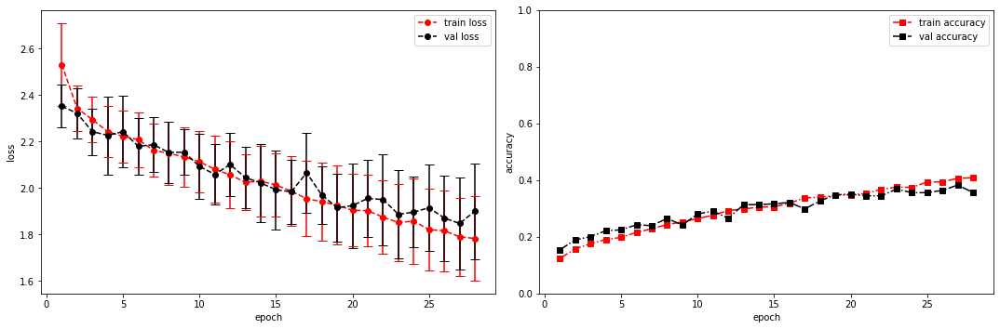

model saved


training epoch:  28
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [29/100], step [1/168],  Loss: 1.8537 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5263371467590332s
Epoch [29/100], step [17/168],  Loss: 1.6637 +/- 0.1608,  accuracy: 0.4453125, time elapsed = 6.251279354095459s
Epoch [29/100], step [33/168],  Loss: 1.7654 +/- 0.1738,  accuracy: 0.408203125, time elapsed = 6.241384983062744s
Epoch [29/100], step [49/168],  Loss: 1.7605 +/- 0.1131,  accuracy: 0.412109375, time elapsed = 6.242347955703735s
Epoch [29/100], step [65/168],  Loss: 1.8692 +/- 0.1841,  accuracy: 0.337890625, time elapsed = 6.240812063217163s
Epoch [29/100], step [81/168],  Loss: 1.7488 +/- 0.1638,  accuracy: 0.427734375, time elapsed = 6.2400712966918945s
Epoch [29/100], step [97/168],  Loss: 1.7646 +/- 0.1588,  accuracy: 0.427734375, time elapsed = 6.240691184997559s
Epoch [29/100], step [113/168],  Loss: 1.7764 +/- 0.1276,  accuracy: 0.400390625, time elapsed = 6.240320205688477s
Epoch [29/100], step [129/168],  Loss: 1.7956 +/- 0.1784,  accuracy: 0.3984375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.402,  precision = 0.402 recall = 0.402 f1 = 0.402 ::: val: acc = 0.396,  precision = 0.396 recall = 0.396 time elapsed = 70.4894061088562s


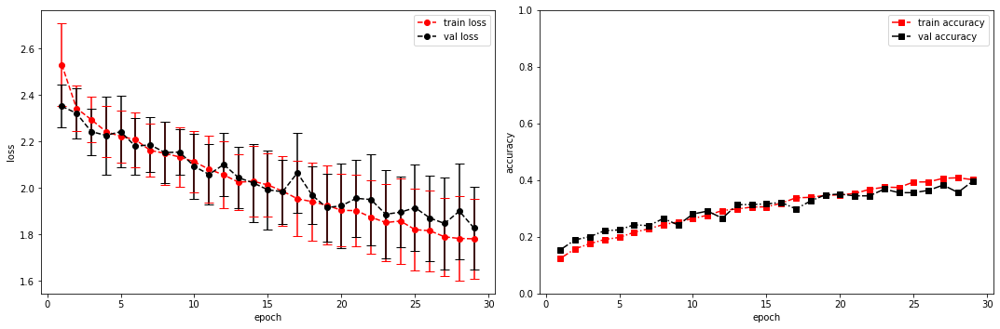

model saved


training epoch:  29
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [30/100], step [1/168],  Loss: 1.5955 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5285019874572754s
Epoch [30/100], step [17/168],  Loss: 1.6893 +/- 0.1604,  accuracy: 0.451171875, time elapsed = 6.241775989532471s
Epoch [30/100], step [33/168],  Loss: 1.6871 +/- 0.1750,  accuracy: 0.43359375, time elapsed = 6.243365526199341s
Epoch [30/100], step [49/168],  Loss: 1.8076 +/- 0.1709,  accuracy: 0.40234375, time elapsed = 6.2430500984191895s
Epoch [30/100], step [65/168],  Loss: 1.7473 +/- 0.1816,  accuracy: 0.431640625, time elapsed = 6.243066072463989s
Epoch [30/100], step [81/168],  Loss: 1.8542 +/- 0.1766,  accuracy: 0.380859375, time elapsed = 6.242938995361328s
Epoch [30/100], step [97/168],  Loss: 1.7663 +/- 0.1066,  accuracy: 0.396484375, time elapsed = 6.2416322231292725s
Epoch [30/100], step [113/168],  Loss: 1.7549 +/- 0.1562,  accuracy: 0.419921875, time elapsed = 6.241637945175171s
Epoch [30/100], step [129/168],  Loss: 1.7752 +/- 0.1615,  accuracy: 0.4140625, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.419,  precision = 0.419 recall = 0.419 f1 = 0.419 ::: val: acc = 0.353,  precision = 0.353 recall = 0.353 time elapsed = 70.51373386383057s


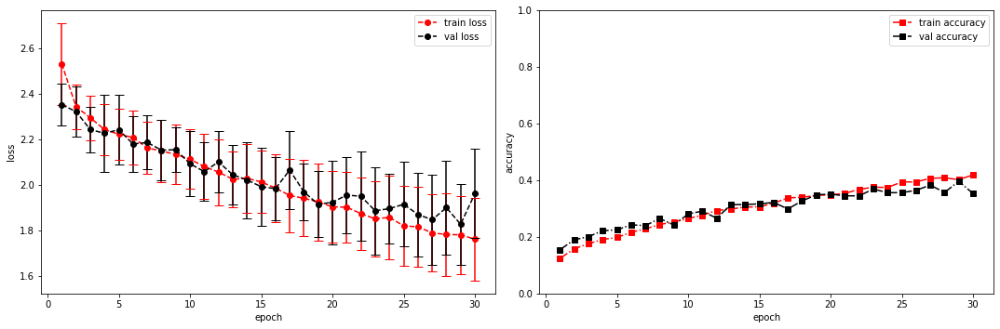

model saved


training epoch:  30
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [31/100], step [1/168],  Loss: 1.6898 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5322744846343994s
Epoch [31/100], step [17/168],  Loss: 1.8545 +/- 0.1433,  accuracy: 0.37890625, time elapsed = 6.240983247756958s
Epoch [31/100], step [33/168],  Loss: 1.8333 +/- 0.1445,  accuracy: 0.396484375, time elapsed = 6.244053840637207s
Epoch [31/100], step [49/168],  Loss: 1.8005 +/- 0.1052,  accuracy: 0.400390625, time elapsed = 6.240573167800903s
Epoch [31/100], step [65/168],  Loss: 1.6968 +/- 0.0943,  accuracy: 0.408203125, time elapsed = 6.241346836090088s
Epoch [31/100], step [81/168],  Loss: 1.7368 +/- 0.1575,  accuracy: 0.41796875, time elapsed = 6.240375757217407s
Epoch [31/100], step [97/168],  Loss: 1.7713 +/- 0.1889,  accuracy: 0.392578125, time elapsed = 6.240856170654297s
Epoch [31/100], step [113/168],  Loss: 1.7633 +/- 0.2085,  accuracy: 0.4140625, time elapsed = 6.243066310882568s
Epoch [31/100], step [129/168],  Loss: 1.7428 +/- 0.1306,  accuracy: 0.384765625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.402,  precision = 0.402 recall = 0.402 f1 = 0.402 ::: val: acc = 0.399,  precision = 0.399 recall = 0.399 time elapsed = 70.4848427772522s


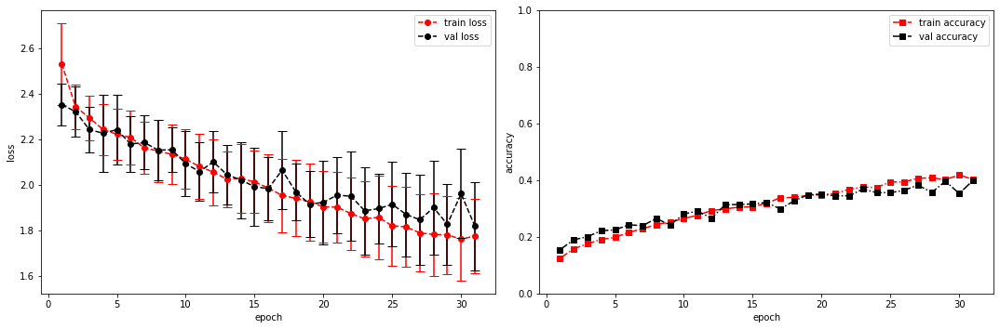

model saved


training epoch:  31
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [32/100], step [1/168],  Loss: 1.9289 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5223846435546875s
Epoch [32/100], step [17/168],  Loss: 1.7480 +/- 0.1208,  accuracy: 0.41015625, time elapsed = 6.242035388946533s
Epoch [32/100], step [33/168],  Loss: 1.7299 +/- 0.1860,  accuracy: 0.462890625, time elapsed = 6.242481470108032s
Epoch [32/100], step [49/168],  Loss: 1.7485 +/- 0.1474,  accuracy: 0.404296875, time elapsed = 6.243038654327393s
Epoch [32/100], step [65/168],  Loss: 1.6531 +/- 0.1511,  accuracy: 0.439453125, time elapsed = 6.240752458572388s
Epoch [32/100], step [81/168],  Loss: 1.7688 +/- 0.2041,  accuracy: 0.412109375, time elapsed = 6.243478298187256s
Epoch [32/100], step [97/168],  Loss: 1.7476 +/- 0.1057,  accuracy: 0.421875, time elapsed = 6.25206995010376s
Epoch [32/100], step [113/168],  Loss: 1.6280 +/- 0.1302,  accuracy: 0.462890625, time elapsed = 6.242805004119873s
Epoch [32/100], step [129/168],  Loss: 1.6407 +/- 0.1431,  accuracy: 0.470703125, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.430,  precision = 0.430 recall = 0.430 f1 = 0.430 ::: val: acc = 0.395,  precision = 0.395 recall = 0.395 time elapsed = 70.49214053153992s


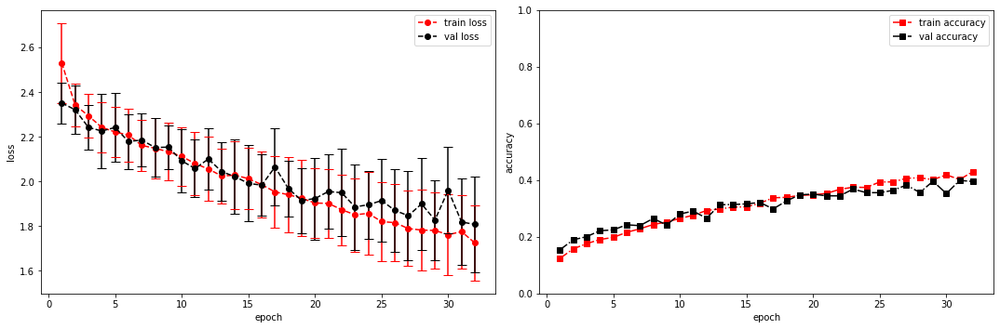

model saved


training epoch:  32
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [33/100], step [1/168],  Loss: 1.9785 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.522841215133667s
Epoch [33/100], step [17/168],  Loss: 1.6614 +/- 0.1795,  accuracy: 0.470703125, time elapsed = 6.242282390594482s
Epoch [33/100], step [33/168],  Loss: 1.5857 +/- 0.1350,  accuracy: 0.48828125, time elapsed = 6.242223739624023s
Epoch [33/100], step [49/168],  Loss: 1.7589 +/- 0.2213,  accuracy: 0.41796875, time elapsed = 6.243053674697876s
Epoch [33/100], step [65/168],  Loss: 1.6971 +/- 0.1596,  accuracy: 0.447265625, time elapsed = 6.241544008255005s
Epoch [33/100], step [81/168],  Loss: 1.6715 +/- 0.1108,  accuracy: 0.4375, time elapsed = 6.241295576095581s
Epoch [33/100], step [97/168],  Loss: 1.7071 +/- 0.2137,  accuracy: 0.42578125, time elapsed = 6.2417378425598145s
Epoch [33/100], step [113/168],  Loss: 1.6910 +/- 0.1411,  accuracy: 0.455078125, time elapsed = 6.243252515792847s
Epoch [33/100], step [129/168],  Loss: 1.6357 +/- 0.1429,  accuracy: 0.447265625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.442,  precision = 0.442 recall = 0.442 f1 = 0.442 ::: val: acc = 0.361,  precision = 0.361 recall = 0.361 time elapsed = 70.48195123672485s


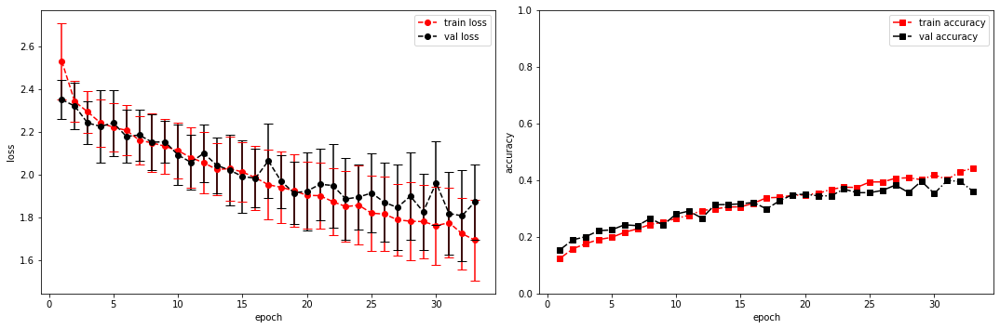

model saved


training epoch:  33
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [34/100], step [1/168],  Loss: 1.3132 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5307276248931885s
Epoch [34/100], step [17/168],  Loss: 1.6973 +/- 0.2012,  accuracy: 0.4453125, time elapsed = 6.243902206420898s
Epoch [34/100], step [33/168],  Loss: 1.6742 +/- 0.2001,  accuracy: 0.4609375, time elapsed = 6.247405052185059s
Epoch [34/100], step [49/168],  Loss: 1.7334 +/- 0.1802,  accuracy: 0.40234375, time elapsed = 6.24253511428833s
Epoch [34/100], step [65/168],  Loss: 1.6686 +/- 0.1833,  accuracy: 0.431640625, time elapsed = 6.242364883422852s
Epoch [34/100], step [81/168],  Loss: 1.7259 +/- 0.1535,  accuracy: 0.427734375, time elapsed = 6.24194860458374s
Epoch [34/100], step [97/168],  Loss: 1.6523 +/- 0.1859,  accuracy: 0.447265625, time elapsed = 6.2428905963897705s
Epoch [34/100], step [113/168],  Loss: 1.7456 +/- 0.1565,  accuracy: 0.427734375, time elapsed = 6.242188930511475s
Epoch [34/100], step [129/168],  Loss: 1.6872 +/- 0.1441,  accuracy: 0.458984375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.442,  precision = 0.442 recall = 0.442 f1 = 0.442 ::: val: acc = 0.427,  precision = 0.427 recall = 0.427 time elapsed = 70.50781321525574s


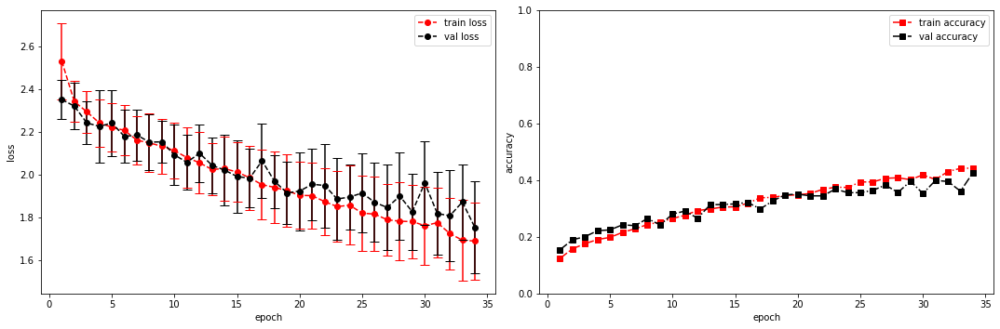

model saved


training epoch:  34
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [35/100], step [1/168],  Loss: 1.4843 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.538578987121582s
Epoch [35/100], step [17/168],  Loss: 1.6036 +/- 0.1518,  accuracy: 0.46875, time elapsed = 6.242095947265625s
Epoch [35/100], step [33/168],  Loss: 1.6339 +/- 0.2371,  accuracy: 0.47265625, time elapsed = 6.240746736526489s
Epoch [35/100], step [49/168],  Loss: 1.6880 +/- 0.1747,  accuracy: 0.43359375, time elapsed = 6.24113130569458s
Epoch [35/100], step [65/168],  Loss: 1.6518 +/- 0.2289,  accuracy: 0.44140625, time elapsed = 6.241433382034302s
Epoch [35/100], step [81/168],  Loss: 1.9617 +/- 0.2406,  accuracy: 0.33203125, time elapsed = 6.2408671379089355s
Epoch [35/100], step [97/168],  Loss: 1.8998 +/- 0.1314,  accuracy: 0.359375, time elapsed = 6.24166464805603s
Epoch [35/100], step [113/168],  Loss: 1.9319 +/- 0.1716,  accuracy: 0.35546875, time elapsed = 6.24119758605957s
Epoch [35/100], step [129/168],  Loss: 1.8068 +/- 0.1949,  accuracy: 0.390625, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.409,  precision = 0.409 recall = 0.409 f1 = 0.409 ::: val: acc = 0.404,  precision = 0.404 recall = 0.404 time elapsed = 70.49798583984375s


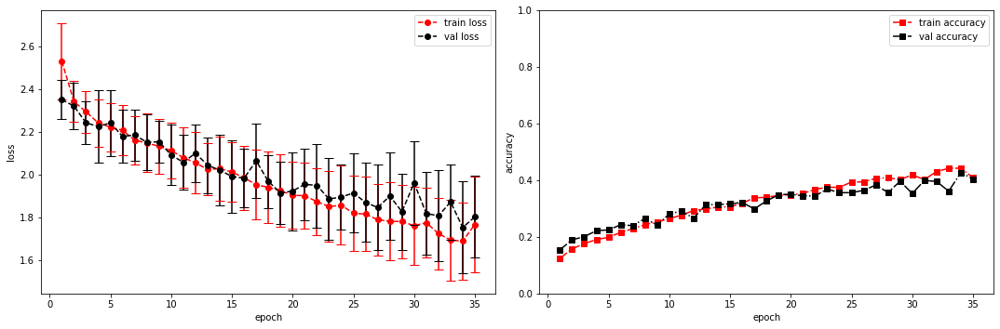

model saved


training epoch:  35
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [36/100], step [1/168],  Loss: 1.9190 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5285005569458008s
Epoch [36/100], step [17/168],  Loss: 1.7003 +/- 0.2054,  accuracy: 0.4453125, time elapsed = 6.242215633392334s
Epoch [36/100], step [33/168],  Loss: 1.6645 +/- 0.2003,  accuracy: 0.44140625, time elapsed = 6.243132829666138s
Epoch [36/100], step [49/168],  Loss: 1.6711 +/- 0.1461,  accuracy: 0.453125, time elapsed = 6.242213249206543s
Epoch [36/100], step [65/168],  Loss: 1.7242 +/- 0.2003,  accuracy: 0.439453125, time elapsed = 6.24168586730957s
Epoch [36/100], step [81/168],  Loss: 1.7122 +/- 0.1600,  accuracy: 0.427734375, time elapsed = 6.24199104309082s
Epoch [36/100], step [97/168],  Loss: 1.6301 +/- 0.1460,  accuracy: 0.458984375, time elapsed = 6.242782115936279s
Epoch [36/100], step [113/168],  Loss: 1.6036 +/- 0.1387,  accuracy: 0.46875, time elapsed = 6.243232250213623s
Epoch [36/100], step [129/168],  Loss: 1.7267 +/- 0.1957,  accuracy: 0.439453125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.437,  precision = 0.437 recall = 0.437 f1 = 0.437 ::: val: acc = 0.395,  precision = 0.395 recall = 0.395 time elapsed = 70.49605226516724s


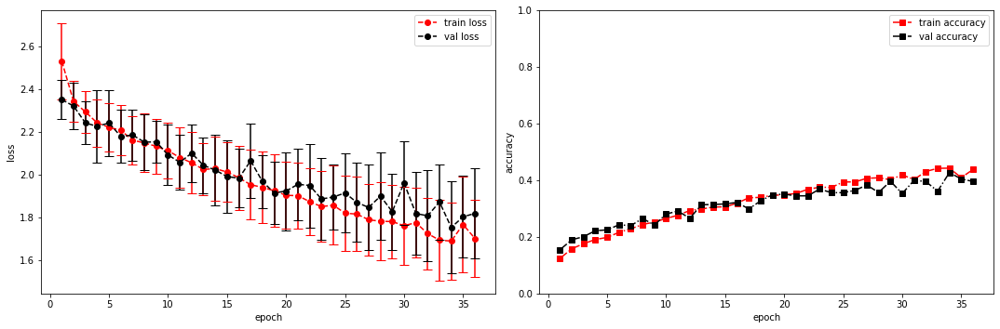

model saved


training epoch:  36
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [37/100], step [1/168],  Loss: 1.8010 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5250606536865234s
Epoch [37/100], step [17/168],  Loss: 1.6933 +/- 0.1438,  accuracy: 0.431640625, time elapsed = 6.241248846054077s
Epoch [37/100], step [33/168],  Loss: 1.6485 +/- 0.1672,  accuracy: 0.443359375, time elapsed = 6.240697860717773s
Epoch [37/100], step [49/168],  Loss: 1.6724 +/- 0.1760,  accuracy: 0.466796875, time elapsed = 6.241153001785278s
Epoch [37/100], step [65/168],  Loss: 1.5850 +/- 0.2091,  accuracy: 0.484375, time elapsed = 6.241208553314209s
Epoch [37/100], step [81/168],  Loss: 1.6788 +/- 0.2163,  accuracy: 0.447265625, time elapsed = 6.24125599861145s
Epoch [37/100], step [97/168],  Loss: 1.7816 +/- 0.1838,  accuracy: 0.412109375, time elapsed = 6.254992961883545s
Epoch [37/100], step [113/168],  Loss: 1.7455 +/- 0.1804,  accuracy: 0.443359375, time elapsed = 6.240703344345093s
Epoch [37/100], step [129/168],  Loss: 1.6511 +/- 0.1727,  accuracy: 0.474609375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.448,  precision = 0.448 recall = 0.448 f1 = 0.448 ::: val: acc = 0.404,  precision = 0.404 recall = 0.404 time elapsed = 70.4878237247467s


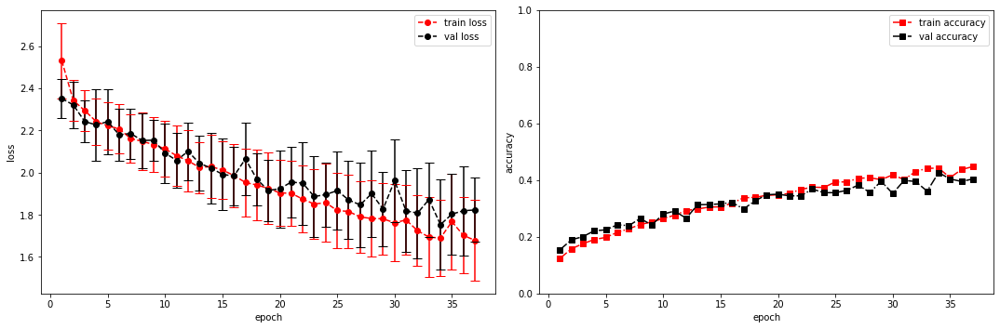

model saved


training epoch:  37
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [38/100], step [1/168],  Loss: 2.1198 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5275208950042725s
Epoch [38/100], step [17/168],  Loss: 1.6099 +/- 0.2023,  accuracy: 0.4765625, time elapsed = 6.241025924682617s
Epoch [38/100], step [33/168],  Loss: 1.5256 +/- 0.1431,  accuracy: 0.4921875, time elapsed = 6.242349863052368s
Epoch [38/100], step [49/168],  Loss: 1.5992 +/- 0.1599,  accuracy: 0.478515625, time elapsed = 6.2419257164001465s
Epoch [38/100], step [65/168],  Loss: 1.6774 +/- 0.2105,  accuracy: 0.435546875, time elapsed = 6.243548393249512s
Epoch [38/100], step [81/168],  Loss: 1.7674 +/- 0.2353,  accuracy: 0.40625, time elapsed = 6.242485761642456s
Epoch [38/100], step [97/168],  Loss: 1.6579 +/- 0.1388,  accuracy: 0.447265625, time elapsed = 6.241581439971924s
Epoch [38/100], step [113/168],  Loss: 2.0721 +/- 0.3552,  accuracy: 0.3125, time elapsed = 6.24220609664917s
Epoch [38/100], step [129/168],  Loss: 2.3547 +/- 0.1889,  accuracy: 0.212890625, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.372,  precision = 0.372 recall = 0.372 f1 = 0.372 ::: val: acc = 0.333,  precision = 0.333 recall = 0.333 time elapsed = 70.48942995071411s


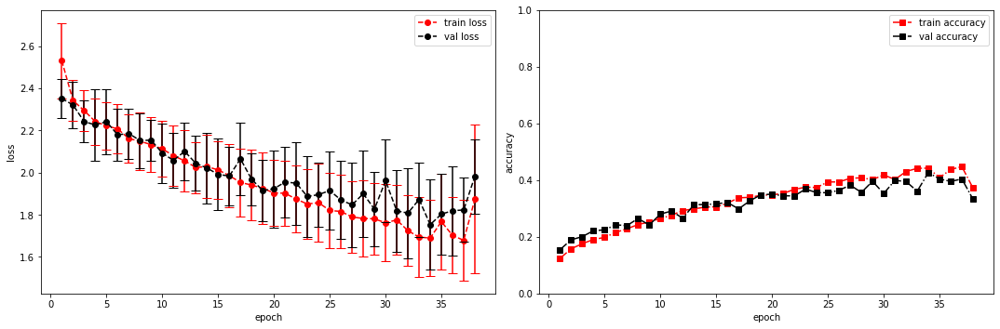

model saved


training epoch:  38
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [39/100], step [1/168],  Loss: 2.3590 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5311651229858398s
Epoch [39/100], step [17/168],  Loss: 1.9565 +/- 0.1331,  accuracy: 0.31640625, time elapsed = 6.241598129272461s
Epoch [39/100], step [33/168],  Loss: 1.9700 +/- 0.1981,  accuracy: 0.3359375, time elapsed = 6.241739749908447s
Epoch [39/100], step [49/168],  Loss: 2.0011 +/- 0.1229,  accuracy: 0.310546875, time elapsed = 6.250665187835693s
Epoch [39/100], step [65/168],  Loss: 1.9210 +/- 0.1518,  accuracy: 0.337890625, time elapsed = 6.241481781005859s
Epoch [39/100], step [81/168],  Loss: 1.8672 +/- 0.1353,  accuracy: 0.357421875, time elapsed = 6.241759300231934s
Epoch [39/100], step [97/168],  Loss: 1.9162 +/- 0.1620,  accuracy: 0.32421875, time elapsed = 6.24007773399353s
Epoch [39/100], step [113/168],  Loss: 1.9700 +/- 0.1286,  accuracy: 0.322265625, time elapsed = 6.242884635925293s
Epoch [39/100], step [129/168],  Loss: 1.8777 +/- 0.1449,  accuracy: 0.337890625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.336,  precision = 0.336 recall = 0.336 f1 = 0.336 ::: val: acc = 0.315,  precision = 0.315 recall = 0.315 time elapsed = 70.49973845481873s


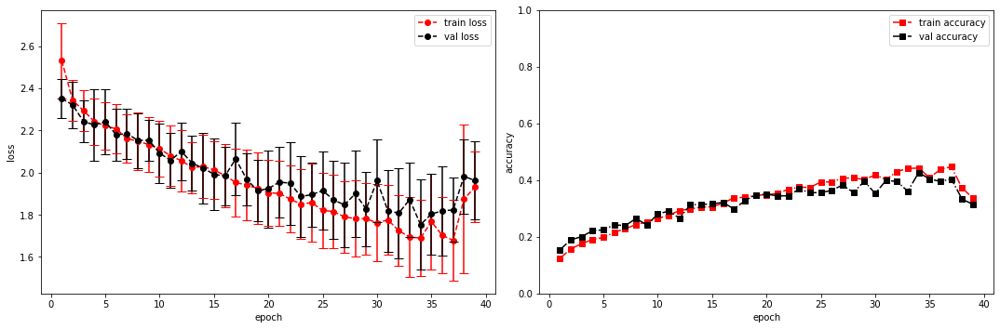

model saved


training epoch:  39
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [40/100], step [1/168],  Loss: 1.8336 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5237867832183838s
Epoch [40/100], step [17/168],  Loss: 1.8423 +/- 0.1376,  accuracy: 0.3671875, time elapsed = 6.240959882736206s
Epoch [40/100], step [33/168],  Loss: 1.7860 +/- 0.1550,  accuracy: 0.396484375, time elapsed = 6.242055416107178s
Epoch [40/100], step [49/168],  Loss: 1.8492 +/- 0.1608,  accuracy: 0.34375, time elapsed = 6.2408530712127686s
Epoch [40/100], step [65/168],  Loss: 1.8065 +/- 0.1367,  accuracy: 0.384765625, time elapsed = 6.241353988647461s
Epoch [40/100], step [81/168],  Loss: 1.8463 +/- 0.1509,  accuracy: 0.361328125, time elapsed = 6.242002964019775s
Epoch [40/100], step [97/168],  Loss: 1.8064 +/- 0.1718,  accuracy: 0.40625, time elapsed = 6.240046501159668s
Epoch [40/100], step [113/168],  Loss: 1.7381 +/- 0.1578,  accuracy: 0.435546875, time elapsed = 6.240267038345337s
Epoch [40/100], step [129/168],  Loss: 1.7665 +/- 0.1780,  accuracy: 0.388671875, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.379,  precision = 0.379 recall = 0.379 f1 = 0.379 ::: val: acc = 0.386,  precision = 0.386 recall = 0.386 time elapsed = 70.49994325637817s


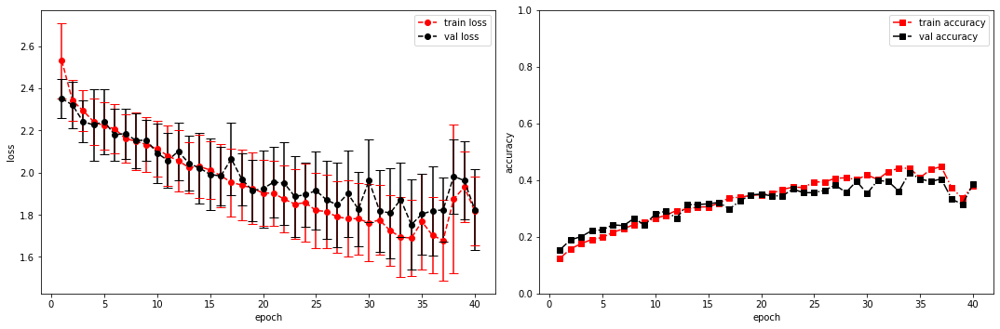

model saved


training epoch:  40
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [41/100], step [1/168],  Loss: 2.0722 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5228075981140137s
Epoch [41/100], step [17/168],  Loss: 1.7217 +/- 0.2069,  accuracy: 0.412109375, time elapsed = 6.242229223251343s
Epoch [41/100], step [33/168],  Loss: 1.7316 +/- 0.1492,  accuracy: 0.41015625, time elapsed = 6.240072011947632s
Epoch [41/100], step [49/168],  Loss: 1.7519 +/- 0.2146,  accuracy: 0.400390625, time elapsed = 6.2414796352386475s
Epoch [41/100], step [65/168],  Loss: 1.8655 +/- 0.1730,  accuracy: 0.375, time elapsed = 6.240573167800903s
Epoch [41/100], step [81/168],  Loss: 1.8415 +/- 0.1546,  accuracy: 0.3828125, time elapsed = 6.2409210205078125s
Epoch [41/100], step [97/168],  Loss: 1.8545 +/- 0.1321,  accuracy: 0.365234375, time elapsed = 6.241466283798218s
Epoch [41/100], step [113/168],  Loss: 1.7187 +/- 0.1874,  accuracy: 0.443359375, time elapsed = 6.240755796432495s
Epoch [41/100], step [129/168],  Loss: 1.7937 +/- 0.1724,  accuracy: 0.353515625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.391,  precision = 0.391 recall = 0.391 f1 = 0.391 ::: val: acc = 0.402,  precision = 0.402 recall = 0.402 time elapsed = 70.47628474235535s


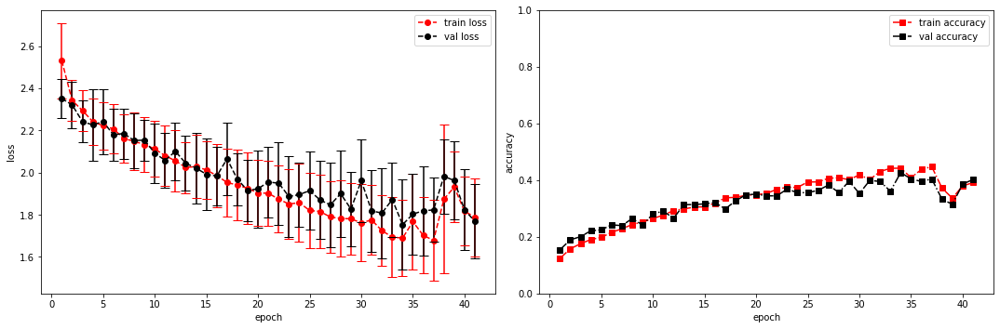

model saved


training epoch:  41
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [42/100], step [1/168],  Loss: 1.7856 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5317108631134033s
Epoch [42/100], step [17/168],  Loss: 1.6969 +/- 0.1684,  accuracy: 0.435546875, time elapsed = 6.24209189414978s
Epoch [42/100], step [33/168],  Loss: 1.6402 +/- 0.1306,  accuracy: 0.4453125, time elapsed = 6.241884469985962s
Epoch [42/100], step [49/168],  Loss: 1.6452 +/- 0.1927,  accuracy: 0.443359375, time elapsed = 6.241003036499023s
Epoch [42/100], step [65/168],  Loss: 1.7069 +/- 0.1538,  accuracy: 0.41796875, time elapsed = 6.241974115371704s
Epoch [42/100], step [81/168],  Loss: 1.7154 +/- 0.1471,  accuracy: 0.421875, time elapsed = 6.242567300796509s
Epoch [42/100], step [97/168],  Loss: 1.7325 +/- 0.2113,  accuracy: 0.40625, time elapsed = 6.241393089294434s
Epoch [42/100], step [113/168],  Loss: 1.7838 +/- 0.1609,  accuracy: 0.375, time elapsed = 6.260387659072876s
Epoch [42/100], step [129/168],  Loss: 1.7819 +/- 0.1456,  accuracy: 0.39453125, time elapsed = 6.2

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.423,  precision = 0.423 recall = 0.423 f1 = 0.423 ::: val: acc = 0.415,  precision = 0.415 recall = 0.415 time elapsed = 70.50198650360107s


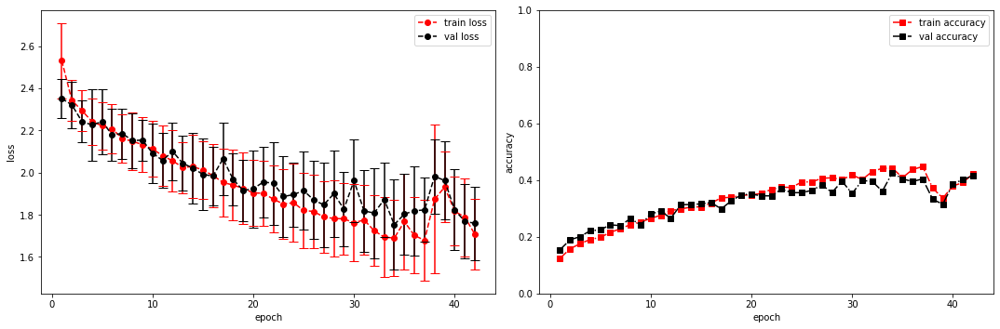

model saved


training epoch:  42
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [43/100], step [1/168],  Loss: 1.6177 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5280725955963135s
Epoch [43/100], step [17/168],  Loss: 1.6792 +/- 0.1722,  accuracy: 0.4609375, time elapsed = 6.240930795669556s
Epoch [43/100], step [33/168],  Loss: 1.5928 +/- 0.1790,  accuracy: 0.466796875, time elapsed = 6.240894794464111s
Epoch [43/100], step [49/168],  Loss: 1.7323 +/- 0.1564,  accuracy: 0.408203125, time elapsed = 6.240518569946289s
Epoch [43/100], step [65/168],  Loss: 1.5836 +/- 0.2025,  accuracy: 0.466796875, time elapsed = 6.240074157714844s
Epoch [43/100], step [81/168],  Loss: 1.7547 +/- 0.1342,  accuracy: 0.3984375, time elapsed = 6.242934703826904s
Epoch [43/100], step [97/168],  Loss: 1.6121 +/- 0.1343,  accuracy: 0.453125, time elapsed = 6.241080284118652s
Epoch [43/100], step [113/168],  Loss: 1.7013 +/- 0.1916,  accuracy: 0.431640625, time elapsed = 6.241762161254883s
Epoch [43/100], step [129/168],  Loss: 1.7548 +/- 0.1635,  accuracy: 0.41796875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.435,  precision = 0.435 recall = 0.435 f1 = 0.435 ::: val: acc = 0.402,  precision = 0.402 recall = 0.402 time elapsed = 70.49948072433472s


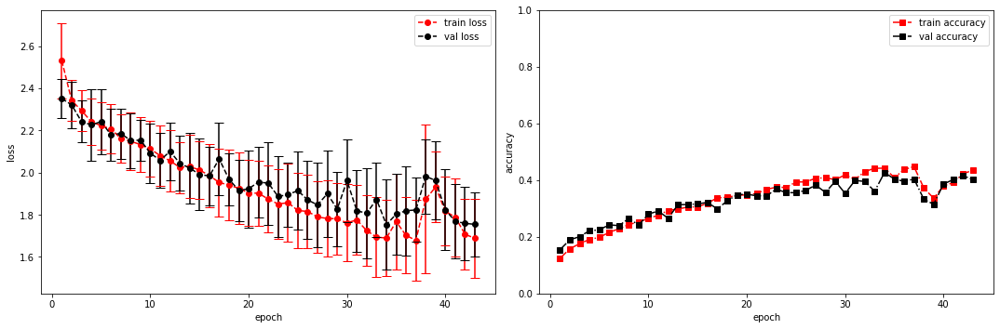

model saved


training epoch:  43
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [44/100], step [1/168],  Loss: 1.7054 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5249102115631104s
Epoch [44/100], step [17/168],  Loss: 1.5889 +/- 0.2392,  accuracy: 0.478515625, time elapsed = 6.2418999671936035s
Epoch [44/100], step [33/168],  Loss: 1.6570 +/- 0.1698,  accuracy: 0.42578125, time elapsed = 6.243322372436523s
Epoch [44/100], step [49/168],  Loss: 1.6331 +/- 0.1507,  accuracy: 0.47265625, time elapsed = 6.248061418533325s
Epoch [44/100], step [65/168],  Loss: 1.6354 +/- 0.2032,  accuracy: 0.466796875, time elapsed = 6.242757320404053s
Epoch [44/100], step [81/168],  Loss: 1.6798 +/- 0.1744,  accuracy: 0.41796875, time elapsed = 6.241173505783081s
Epoch [44/100], step [97/168],  Loss: 1.6100 +/- 0.2372,  accuracy: 0.4921875, time elapsed = 6.241479158401489s
Epoch [44/100], step [113/168],  Loss: 1.6607 +/- 0.1597,  accuracy: 0.4296875, time elapsed = 6.242557764053345s
Epoch [44/100], step [129/168],  Loss: 1.6691 +/- 0.1679,  accuracy: 0.4375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.446,  precision = 0.446 recall = 0.446 f1 = 0.446 ::: val: acc = 0.406,  precision = 0.406 recall = 0.406 time elapsed = 70.50069570541382s


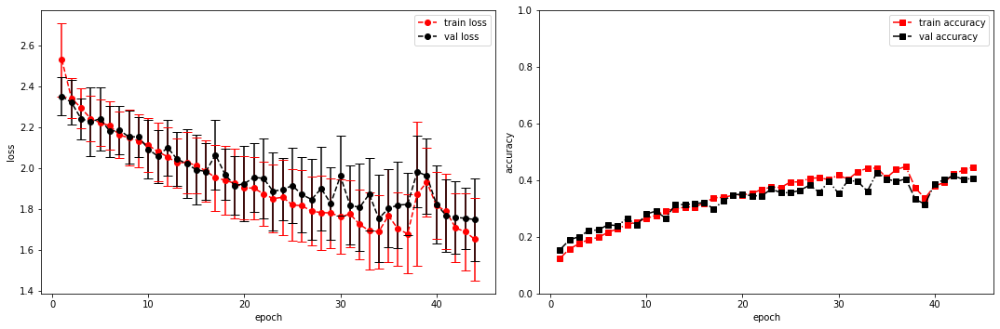

model saved


training epoch:  44
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [45/100], step [1/168],  Loss: 1.7044 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5315361022949219s
Epoch [45/100], step [17/168],  Loss: 1.5952 +/- 0.1419,  accuracy: 0.455078125, time elapsed = 6.242955923080444s
Epoch [45/100], step [33/168],  Loss: 1.5836 +/- 0.2126,  accuracy: 0.474609375, time elapsed = 6.240788221359253s
Epoch [45/100], step [49/168],  Loss: 1.6264 +/- 0.1572,  accuracy: 0.494140625, time elapsed = 6.24090576171875s
Epoch [45/100], step [65/168],  Loss: 1.6345 +/- 0.1434,  accuracy: 0.4609375, time elapsed = 6.240285158157349s
Epoch [45/100], step [81/168],  Loss: 1.6679 +/- 0.2299,  accuracy: 0.435546875, time elapsed = 6.239969968795776s
Epoch [45/100], step [97/168],  Loss: 1.6695 +/- 0.1645,  accuracy: 0.4453125, time elapsed = 6.240952253341675s
Epoch [45/100], step [113/168],  Loss: 1.5326 +/- 0.1508,  accuracy: 0.501953125, time elapsed = 6.240516662597656s
Epoch [45/100], step [129/168],  Loss: 1.6665 +/- 0.1716,  accuracy: 0.470703125, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.466,  precision = 0.466 recall = 0.466 f1 = 0.466 ::: val: acc = 0.381,  precision = 0.381 recall = 0.381 time elapsed = 70.51018142700195s


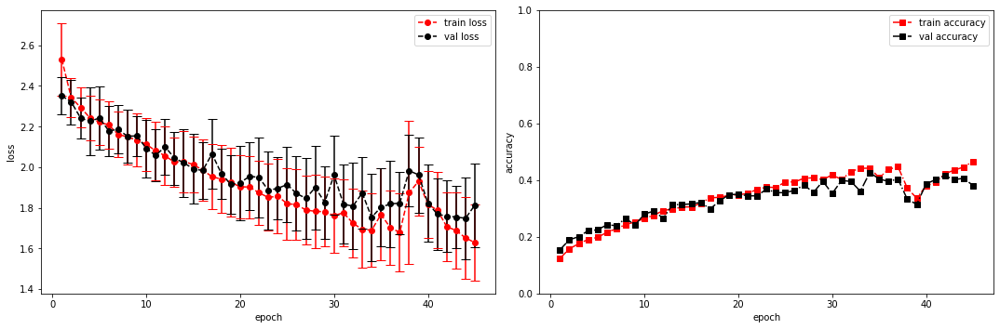

model saved


training epoch:  45
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [46/100], step [1/168],  Loss: 1.5243 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5345532894134521s
Epoch [46/100], step [17/168],  Loss: 1.5650 +/- 0.1944,  accuracy: 0.501953125, time elapsed = 6.241647720336914s
Epoch [46/100], step [33/168],  Loss: 1.5915 +/- 0.1373,  accuracy: 0.470703125, time elapsed = 6.2417449951171875s
Epoch [46/100], step [49/168],  Loss: 1.6942 +/- 0.1423,  accuracy: 0.42578125, time elapsed = 6.241374492645264s
Epoch [46/100], step [65/168],  Loss: 1.6457 +/- 0.1587,  accuracy: 0.45703125, time elapsed = 6.24174165725708s
Epoch [46/100], step [81/168],  Loss: 1.6813 +/- 0.1293,  accuracy: 0.453125, time elapsed = 6.2407684326171875s
Epoch [46/100], step [97/168],  Loss: 1.6781 +/- 0.1880,  accuracy: 0.435546875, time elapsed = 6.240960597991943s
Epoch [46/100], step [113/168],  Loss: 1.6281 +/- 0.1838,  accuracy: 0.4609375, time elapsed = 6.241346597671509s
Epoch [46/100], step [129/168],  Loss: 1.6308 +/- 0.1444,  accuracy: 0.458984375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.459,  precision = 0.459 recall = 0.459 f1 = 0.459 ::: val: acc = 0.380,  precision = 0.380 recall = 0.380 time elapsed = 70.50520277023315s


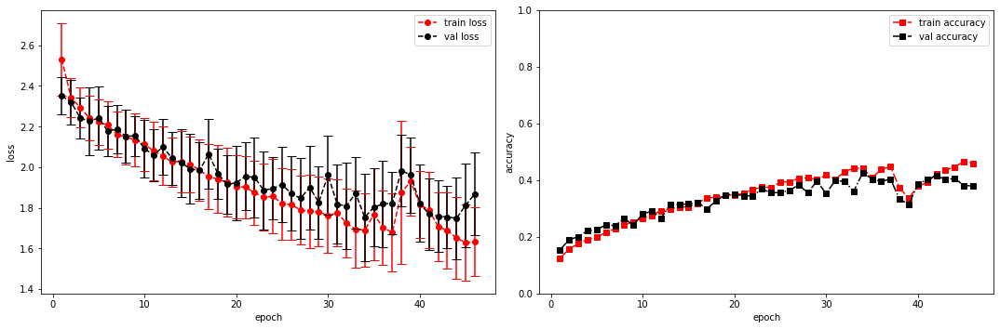

model saved


training epoch:  46
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [47/100], step [1/168],  Loss: 1.6640 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5555126667022705s
Epoch [47/100], step [17/168],  Loss: 1.5131 +/- 0.1404,  accuracy: 0.505859375, time elapsed = 6.241069316864014s
Epoch [47/100], step [33/168],  Loss: 1.5263 +/- 0.1079,  accuracy: 0.521484375, time elapsed = 6.240559101104736s
Epoch [47/100], step [49/168],  Loss: 1.5844 +/- 0.1645,  accuracy: 0.45703125, time elapsed = 6.2415900230407715s
Epoch [47/100], step [65/168],  Loss: 1.5920 +/- 0.1488,  accuracy: 0.484375, time elapsed = 6.242094993591309s
Epoch [47/100], step [81/168],  Loss: 1.5970 +/- 0.1563,  accuracy: 0.484375, time elapsed = 6.2414634227752686s
Epoch [47/100], step [97/168],  Loss: 1.6223 +/- 0.2509,  accuracy: 0.462890625, time elapsed = 6.240874290466309s
Epoch [47/100], step [113/168],  Loss: 1.5410 +/- 0.1583,  accuracy: 0.498046875, time elapsed = 6.242509603500366s
Epoch [47/100], step [129/168],  Loss: 1.5787 +/- 0.1362,  accuracy: 0.48046875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.481,  precision = 0.481 recall = 0.481 f1 = 0.481 ::: val: acc = 0.424,  precision = 0.424 recall = 0.424 time elapsed = 70.52701330184937s


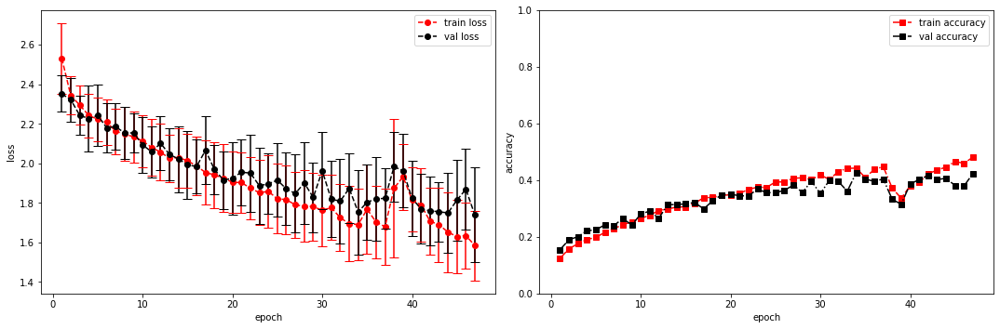

model saved


training epoch:  47
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [48/100], step [1/168],  Loss: 1.2202 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5404095649719238s
Epoch [48/100], step [17/168],  Loss: 1.5411 +/- 0.1828,  accuracy: 0.5, time elapsed = 6.243190288543701s
Epoch [48/100], step [33/168],  Loss: 1.6079 +/- 0.1461,  accuracy: 0.45703125, time elapsed = 6.241472005844116s
Epoch [48/100], step [49/168],  Loss: 1.7042 +/- 0.2628,  accuracy: 0.4296875, time elapsed = 6.241974115371704s
Epoch [48/100], step [65/168],  Loss: 1.9141 +/- 0.1569,  accuracy: 0.369140625, time elapsed = 6.241576433181763s
Epoch [48/100], step [81/168],  Loss: 1.8105 +/- 0.1620,  accuracy: 0.416015625, time elapsed = 6.24177622795105s
Epoch [48/100], step [97/168],  Loss: 1.7185 +/- 0.1366,  accuracy: 0.439453125, time elapsed = 6.2422144412994385s
Epoch [48/100], step [113/168],  Loss: 1.6714 +/- 0.2060,  accuracy: 0.451171875, time elapsed = 6.2411487102508545s
Epoch [48/100], step [129/168],  Loss: 1.6249 +/- 0.2100,  accuracy: 0.474609375, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.441,  precision = 0.441 recall = 0.441 f1 = 0.441 ::: val: acc = 0.417,  precision = 0.417 recall = 0.417 time elapsed = 70.49737000465393s


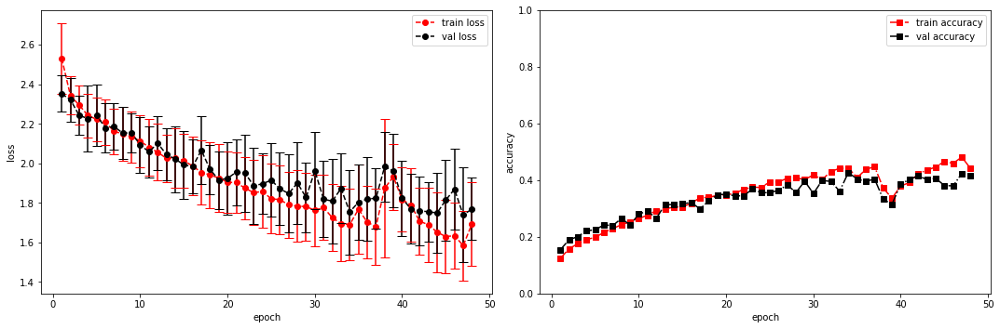

model saved


training epoch:  48
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [49/100], step [1/168],  Loss: 1.5784 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5264508724212646s
Epoch [49/100], step [17/168],  Loss: 1.5732 +/- 0.1349,  accuracy: 0.466796875, time elapsed = 6.239830255508423s
Epoch [49/100], step [33/168],  Loss: 1.6709 +/- 0.1228,  accuracy: 0.439453125, time elapsed = 6.240816354751587s
Epoch [49/100], step [49/168],  Loss: 1.5458 +/- 0.1821,  accuracy: 0.470703125, time elapsed = 6.24212384223938s
Epoch [49/100], step [65/168],  Loss: 1.5496 +/- 0.1705,  accuracy: 0.5, time elapsed = 6.250807285308838s
Epoch [49/100], step [81/168],  Loss: 1.5347 +/- 0.2000,  accuracy: 0.521484375, time elapsed = 6.251139402389526s
Epoch [49/100], step [97/168],  Loss: 1.6668 +/- 0.1760,  accuracy: 0.453125, time elapsed = 6.241389989852905s
Epoch [49/100], step [113/168],  Loss: 1.6018 +/- 0.1554,  accuracy: 0.455078125, time elapsed = 6.240922689437866s
Epoch [49/100], step [129/168],  Loss: 1.5835 +/- 0.1932,  accuracy: 0.466796875, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.472,  precision = 0.472 recall = 0.472 f1 = 0.472 ::: val: acc = 0.423,  precision = 0.423 recall = 0.423 time elapsed = 70.50530290603638s


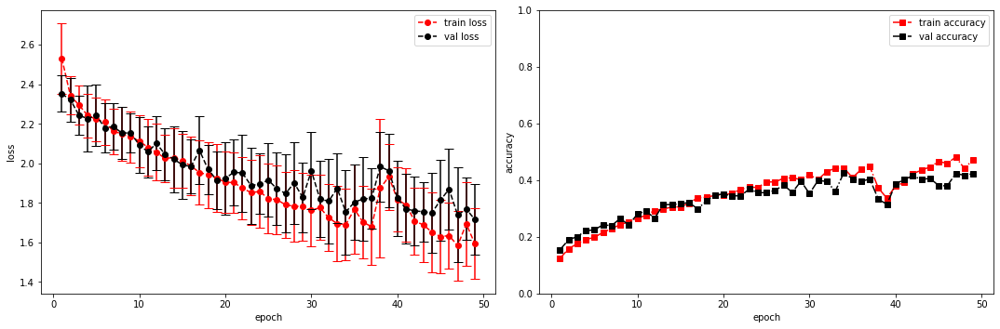

model saved


training epoch:  49
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [50/100], step [1/168],  Loss: 2.1477 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5280187129974365s
Epoch [50/100], step [17/168],  Loss: 1.5304 +/- 0.1853,  accuracy: 0.484375, time elapsed = 6.243711471557617s
Epoch [50/100], step [33/168],  Loss: 1.5569 +/- 0.1965,  accuracy: 0.494140625, time elapsed = 6.241941452026367s
Epoch [50/100], step [49/168],  Loss: 1.5874 +/- 0.2154,  accuracy: 0.470703125, time elapsed = 6.242474555969238s
Epoch [50/100], step [65/168],  Loss: 1.5717 +/- 0.1924,  accuracy: 0.48046875, time elapsed = 6.242180109024048s
Epoch [50/100], step [81/168],  Loss: 1.5478 +/- 0.1510,  accuracy: 0.486328125, time elapsed = 6.2423906326293945s
Epoch [50/100], step [97/168],  Loss: 1.5690 +/- 0.2397,  accuracy: 0.466796875, time elapsed = 6.240780830383301s
Epoch [50/100], step [113/168],  Loss: 1.5508 +/- 0.1466,  accuracy: 0.4765625, time elapsed = 6.2417144775390625s
Epoch [50/100], step [129/168],  Loss: 1.6324 +/- 0.1477,  accuracy: 0.474609375, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.479,  precision = 0.479 recall = 0.479 f1 = 0.479 ::: val: acc = 0.454,  precision = 0.454 recall = 0.454 time elapsed = 70.49384140968323s


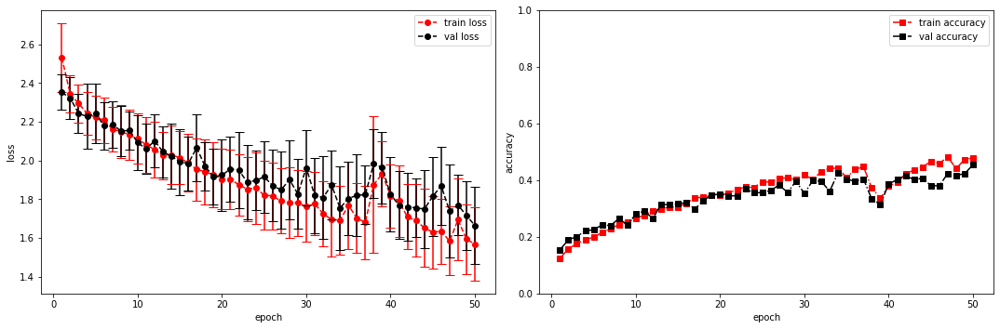

model saved


training epoch:  50
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [51/100], step [1/168],  Loss: 1.2879 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5305795669555664s
Epoch [51/100], step [17/168],  Loss: 1.4797 +/- 0.1543,  accuracy: 0.5, time elapsed = 6.245361804962158s
Epoch [51/100], step [33/168],  Loss: 1.4730 +/- 0.1485,  accuracy: 0.529296875, time elapsed = 6.242066860198975s
Epoch [51/100], step [49/168],  Loss: 1.5344 +/- 0.2133,  accuracy: 0.49609375, time elapsed = 6.240752220153809s
Epoch [51/100], step [65/168],  Loss: 1.5077 +/- 0.1716,  accuracy: 0.51953125, time elapsed = 6.241504907608032s
Epoch [51/100], step [81/168],  Loss: 1.5113 +/- 0.2089,  accuracy: 0.5234375, time elapsed = 6.242269515991211s
Epoch [51/100], step [97/168],  Loss: 1.5240 +/- 0.1502,  accuracy: 0.515625, time elapsed = 6.241671562194824s
Epoch [51/100], step [113/168],  Loss: 1.5157 +/- 0.1864,  accuracy: 0.517578125, time elapsed = 6.239688158035278s
Epoch [51/100], step [129/168],  Loss: 1.5742 +/- 0.2164,  accuracy: 0.484375, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.505,  precision = 0.505 recall = 0.505 f1 = 0.505 ::: val: acc = 0.400,  precision = 0.400 recall = 0.400 time elapsed = 70.49710583686829s


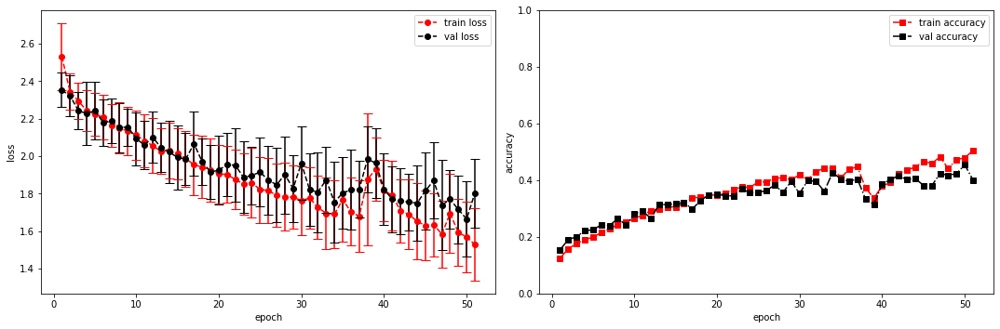

model saved


training epoch:  51
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [52/100], step [1/168],  Loss: 1.5922 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5262258052825928s
Epoch [52/100], step [17/168],  Loss: 1.5899 +/- 0.1435,  accuracy: 0.48828125, time elapsed = 6.243141174316406s
Epoch [52/100], step [33/168],  Loss: 1.4922 +/- 0.2512,  accuracy: 0.509765625, time elapsed = 6.241894245147705s
Epoch [52/100], step [49/168],  Loss: 1.4952 +/- 0.1413,  accuracy: 0.48046875, time elapsed = 6.24247145652771s
Epoch [52/100], step [65/168],  Loss: 1.5058 +/- 0.1838,  accuracy: 0.494140625, time elapsed = 6.241965293884277s
Epoch [52/100], step [81/168],  Loss: 1.4426 +/- 0.1587,  accuracy: 0.53515625, time elapsed = 6.241490125656128s
Epoch [52/100], step [97/168],  Loss: 1.5350 +/- 0.1735,  accuracy: 0.517578125, time elapsed = 6.240992784500122s
Epoch [52/100], step [113/168],  Loss: 1.5568 +/- 0.1963,  accuracy: 0.48828125, time elapsed = 6.241549730300903s
Epoch [52/100], step [129/168],  Loss: 1.5686 +/- 0.1823,  accuracy: 0.505859375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.492,  precision = 0.492 recall = 0.492 f1 = 0.492 ::: val: acc = 0.418,  precision = 0.418 recall = 0.418 time elapsed = 70.50192189216614s


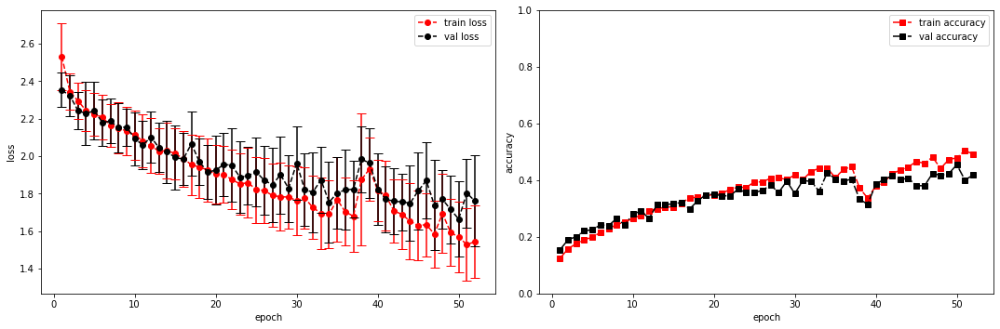

model saved


training epoch:  52
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [53/100], step [1/168],  Loss: 1.6088 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5280241966247559s
Epoch [53/100], step [17/168],  Loss: 1.4836 +/- 0.2325,  accuracy: 0.494140625, time elapsed = 6.240175724029541s
Epoch [53/100], step [33/168],  Loss: 1.3883 +/- 0.1670,  accuracy: 0.5390625, time elapsed = 6.240917205810547s
Epoch [53/100], step [49/168],  Loss: 1.4948 +/- 0.1546,  accuracy: 0.501953125, time elapsed = 6.240368127822876s
Epoch [53/100], step [65/168],  Loss: 1.5324 +/- 0.2297,  accuracy: 0.5, time elapsed = 6.240244150161743s
Epoch [53/100], step [81/168],  Loss: 1.4598 +/- 0.1623,  accuracy: 0.515625, time elapsed = 6.24048638343811s
Epoch [53/100], step [97/168],  Loss: 1.4798 +/- 0.1856,  accuracy: 0.505859375, time elapsed = 6.242243528366089s
Epoch [53/100], step [113/168],  Loss: 1.4766 +/- 0.1492,  accuracy: 0.49609375, time elapsed = 6.240330934524536s
Epoch [53/100], step [129/168],  Loss: 1.5479 +/- 0.2159,  accuracy: 0.509765625, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.507,  precision = 0.507 recall = 0.507 f1 = 0.507 ::: val: acc = 0.432,  precision = 0.432 recall = 0.432 time elapsed = 70.47663307189941s


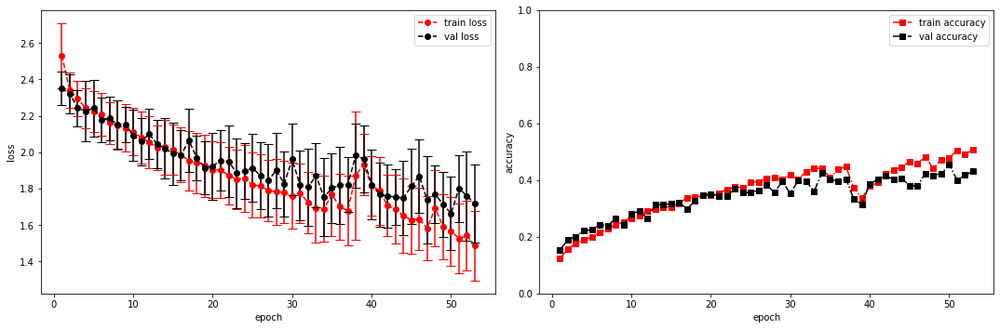

model saved


training epoch:  53
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [54/100], step [1/168],  Loss: 1.2240 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5298492908477783s
Epoch [54/100], step [17/168],  Loss: 1.4216 +/- 0.2180,  accuracy: 0.54296875, time elapsed = 6.240798234939575s
Epoch [54/100], step [33/168],  Loss: 1.4428 +/- 0.1739,  accuracy: 0.5234375, time elapsed = 6.241793394088745s
Epoch [54/100], step [49/168],  Loss: 1.3349 +/- 0.1912,  accuracy: 0.587890625, time elapsed = 6.24263334274292s
Epoch [54/100], step [65/168],  Loss: 1.5310 +/- 0.1676,  accuracy: 0.498046875, time elapsed = 6.243551015853882s
Epoch [54/100], step [81/168],  Loss: 1.5021 +/- 0.1036,  accuracy: 0.51953125, time elapsed = 6.258643388748169s
Epoch [54/100], step [97/168],  Loss: 1.4587 +/- 0.1401,  accuracy: 0.501953125, time elapsed = 6.241587162017822s
Epoch [54/100], step [113/168],  Loss: 1.5497 +/- 0.2229,  accuracy: 0.49609375, time elapsed = 6.2414655685424805s
Epoch [54/100], step [129/168],  Loss: 1.5471 +/- 0.2373,  accuracy: 0.478515625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.508,  precision = 0.508 recall = 0.508 f1 = 0.508 ::: val: acc = 0.449,  precision = 0.449 recall = 0.449 time elapsed = 70.50705361366272s


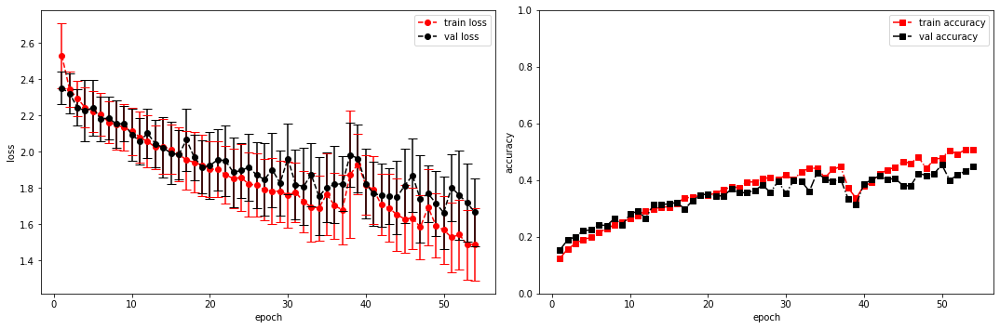

model saved


training epoch:  54
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [55/100], step [1/168],  Loss: 1.5073 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5324311256408691s
Epoch [55/100], step [17/168],  Loss: 1.3468 +/- 0.1577,  accuracy: 0.560546875, time elapsed = 6.241407632827759s
Epoch [55/100], step [33/168],  Loss: 1.4866 +/- 0.0993,  accuracy: 0.525390625, time elapsed = 6.240916013717651s
Epoch [55/100], step [49/168],  Loss: 1.4678 +/- 0.2335,  accuracy: 0.54296875, time elapsed = 6.242929220199585s
Epoch [55/100], step [65/168],  Loss: 1.4605 +/- 0.2187,  accuracy: 0.529296875, time elapsed = 6.241434812545776s
Epoch [55/100], step [81/168],  Loss: 1.4373 +/- 0.1764,  accuracy: 0.53125, time elapsed = 6.240435838699341s
Epoch [55/100], step [97/168],  Loss: 1.5517 +/- 0.1891,  accuracy: 0.49609375, time elapsed = 6.240134954452515s
Epoch [55/100], step [113/168],  Loss: 1.4639 +/- 0.1892,  accuracy: 0.517578125, time elapsed = 6.241861820220947s
Epoch [55/100], step [129/168],  Loss: 1.4586 +/- 0.2141,  accuracy: 0.548828125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.523,  precision = 0.523 recall = 0.523 f1 = 0.523 ::: val: acc = 0.422,  precision = 0.422 recall = 0.422 time elapsed = 70.48787450790405s


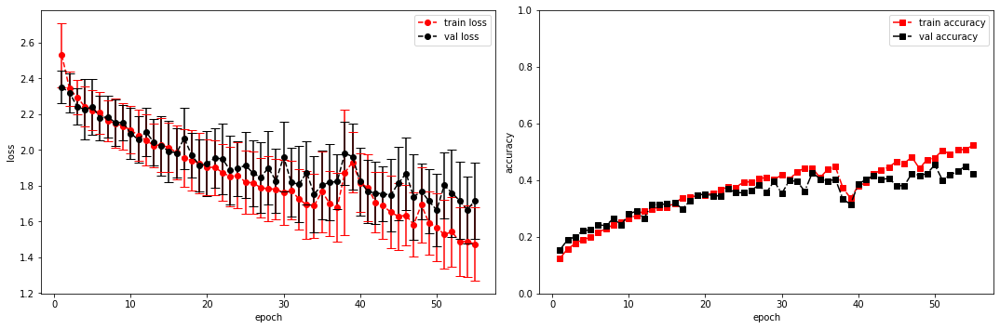

model saved


training epoch:  55
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [56/100], step [1/168],  Loss: 1.4897 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5275511741638184s
Epoch [56/100], step [17/168],  Loss: 1.4036 +/- 0.1739,  accuracy: 0.546875, time elapsed = 6.244821071624756s
Epoch [56/100], step [33/168],  Loss: 1.4398 +/- 0.1731,  accuracy: 0.515625, time elapsed = 6.254098176956177s
Epoch [56/100], step [49/168],  Loss: 1.4502 +/- 0.1852,  accuracy: 0.517578125, time elapsed = 6.2430689334869385s
Epoch [56/100], step [65/168],  Loss: 1.5382 +/- 0.2341,  accuracy: 0.509765625, time elapsed = 6.241650104522705s
Epoch [56/100], step [81/168],  Loss: 1.5433 +/- 0.2137,  accuracy: 0.482421875, time elapsed = 6.242104768753052s
Epoch [56/100], step [97/168],  Loss: 1.6100 +/- 0.2194,  accuracy: 0.470703125, time elapsed = 6.241236448287964s
Epoch [56/100], step [113/168],  Loss: 1.6772 +/- 0.1946,  accuracy: 0.42578125, time elapsed = 6.242018938064575s
Epoch [56/100], step [129/168],  Loss: 1.5287 +/- 0.1835,  accuracy: 0.51953125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.502,  precision = 0.502 recall = 0.502 f1 = 0.502 ::: val: acc = 0.464,  precision = 0.464 recall = 0.464 time elapsed = 70.50961780548096s


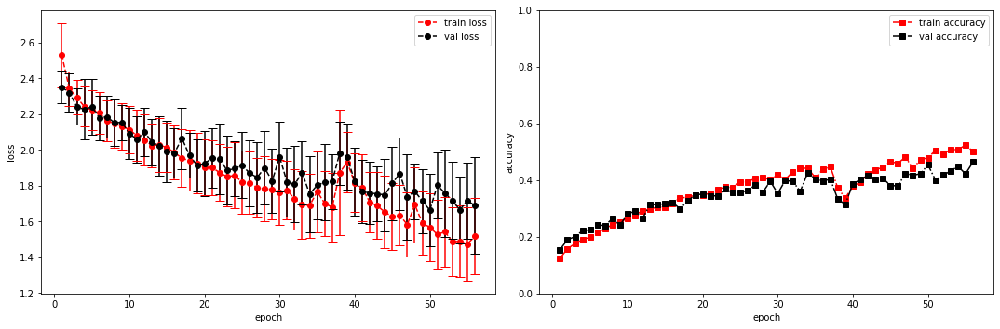

model saved


training epoch:  56
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [57/100], step [1/168],  Loss: 1.2140 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5319669246673584s
Epoch [57/100], step [17/168],  Loss: 1.4118 +/- 0.1676,  accuracy: 0.544921875, time elapsed = 6.321902513504028s
Epoch [57/100], step [33/168],  Loss: 1.3740 +/- 0.1108,  accuracy: 0.54296875, time elapsed = 6.287612676620483s
Epoch [57/100], step [49/168],  Loss: 1.4006 +/- 0.2420,  accuracy: 0.544921875, time elapsed = 6.2436041831970215s
Epoch [57/100], step [65/168],  Loss: 1.4430 +/- 0.1823,  accuracy: 0.51953125, time elapsed = 6.243657112121582s
Epoch [57/100], step [81/168],  Loss: 1.3533 +/- 0.1767,  accuracy: 0.564453125, time elapsed = 6.240682363510132s
Epoch [57/100], step [97/168],  Loss: 1.4467 +/- 0.2165,  accuracy: 0.513671875, time elapsed = 6.2434704303741455s
Epoch [57/100], step [113/168],  Loss: 1.4018 +/- 0.1583,  accuracy: 0.546875, time elapsed = 6.3059868812561035s
Epoch [57/100], step [129/168],  Loss: 1.4861 +/- 0.1609,  accuracy: 0.525390625, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.532,  precision = 0.532 recall = 0.532 f1 = 0.532 ::: val: acc = 0.438,  precision = 0.438 recall = 0.438 time elapsed = 70.69756078720093s


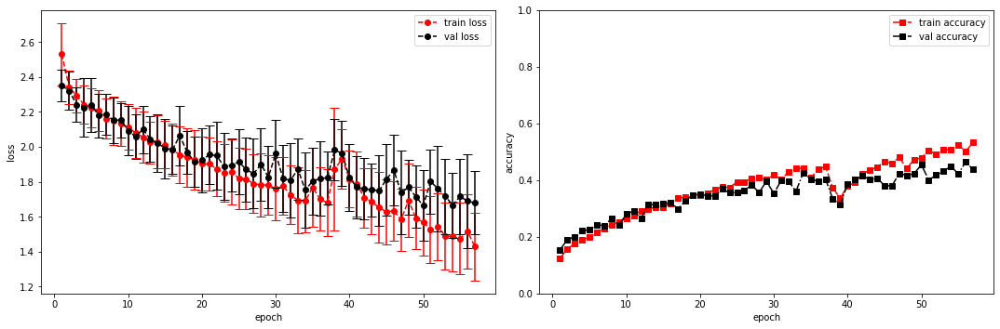

model saved


training epoch:  57
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [58/100], step [1/168],  Loss: 1.7737 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5321907997131348s
Epoch [58/100], step [17/168],  Loss: 1.3990 +/- 0.2199,  accuracy: 0.55078125, time elapsed = 6.241047382354736s
Epoch [58/100], step [33/168],  Loss: 1.4598 +/- 0.2080,  accuracy: 0.533203125, time elapsed = 6.2403810024261475s
Epoch [58/100], step [49/168],  Loss: 1.5459 +/- 0.1942,  accuracy: 0.486328125, time elapsed = 6.2413671016693115s
Epoch [58/100], step [65/168],  Loss: 1.5289 +/- 0.2237,  accuracy: 0.5, time elapsed = 6.2403833866119385s
Epoch [58/100], step [81/168],  Loss: 1.5537 +/- 0.1744,  accuracy: 0.5078125, time elapsed = 6.24061393737793s
Epoch [58/100], step [97/168],  Loss: 1.5512 +/- 0.1925,  accuracy: 0.48046875, time elapsed = 6.240156888961792s
Epoch [58/100], step [113/168],  Loss: 1.5043 +/- 0.2278,  accuracy: 0.4765625, time elapsed = 6.242799758911133s
Epoch [58/100], step [129/168],  Loss: 1.5659 +/- 0.2487,  accuracy: 0.4921875, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.506,  precision = 0.506 recall = 0.506 f1 = 0.506 ::: val: acc = 0.446,  precision = 0.446 recall = 0.446 time elapsed = 70.48611640930176s


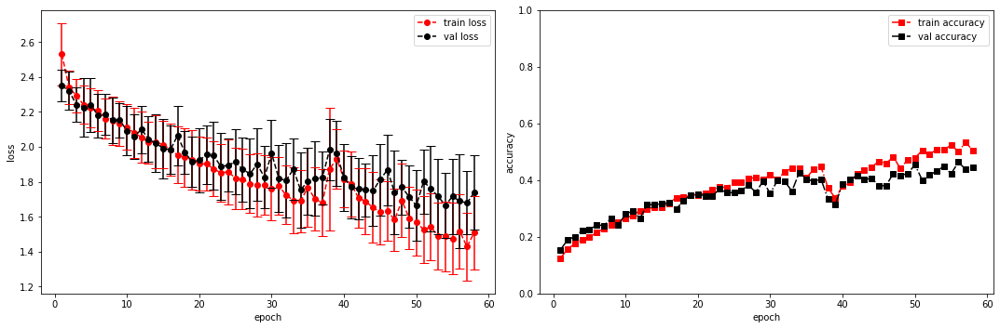

model saved


training epoch:  58
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [59/100], step [1/168],  Loss: 1.4007 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5293962955474854s
Epoch [59/100], step [17/168],  Loss: 1.3804 +/- 0.1959,  accuracy: 0.5546875, time elapsed = 6.239518165588379s
Epoch [59/100], step [33/168],  Loss: 1.4450 +/- 0.1561,  accuracy: 0.51171875, time elapsed = 6.239874839782715s
Epoch [59/100], step [49/168],  Loss: 1.4699 +/- 0.1765,  accuracy: 0.501953125, time elapsed = 6.239588260650635s
Epoch [59/100], step [65/168],  Loss: 1.5067 +/- 0.1671,  accuracy: 0.48828125, time elapsed = 6.2393481731414795s
Epoch [59/100], step [81/168],  Loss: 1.4362 +/- 0.2723,  accuracy: 0.54296875, time elapsed = 6.241315603256226s
Epoch [59/100], step [97/168],  Loss: 1.4723 +/- 0.2390,  accuracy: 0.517578125, time elapsed = 6.250864744186401s
Epoch [59/100], step [113/168],  Loss: 1.4401 +/- 0.1614,  accuracy: 0.525390625, time elapsed = 6.241705417633057s
Epoch [59/100], step [129/168],  Loss: 1.4276 +/- 0.1782,  accuracy: 0.5390625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.517,  precision = 0.517 recall = 0.517 f1 = 0.517 ::: val: acc = 0.480,  precision = 0.480 recall = 0.480 time elapsed = 70.48038053512573s


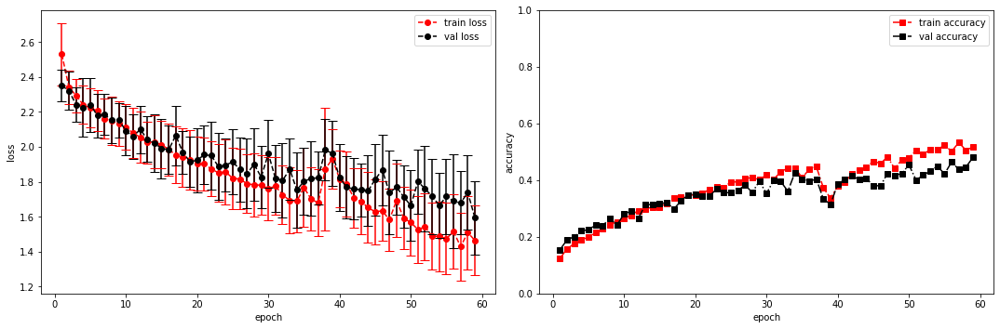

model saved


training epoch:  59
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [60/100], step [1/168],  Loss: 1.5324 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5244128704071045s
Epoch [60/100], step [17/168],  Loss: 1.4117 +/- 0.2289,  accuracy: 0.5390625, time elapsed = 6.24083399772644s
Epoch [60/100], step [33/168],  Loss: 1.4514 +/- 0.1406,  accuracy: 0.52734375, time elapsed = 6.240495920181274s
Epoch [60/100], step [49/168],  Loss: 1.3315 +/- 0.1717,  accuracy: 0.58203125, time elapsed = 6.2405760288238525s
Epoch [60/100], step [65/168],  Loss: 1.4616 +/- 0.1222,  accuracy: 0.486328125, time elapsed = 6.242686033248901s
Epoch [60/100], step [81/168],  Loss: 1.4365 +/- 0.1876,  accuracy: 0.51953125, time elapsed = 6.240962505340576s
Epoch [60/100], step [97/168],  Loss: 1.4916 +/- 0.1809,  accuracy: 0.50390625, time elapsed = 6.241267919540405s
Epoch [60/100], step [113/168],  Loss: 1.4029 +/- 0.2186,  accuracy: 0.529296875, time elapsed = 6.240383863449097s
Epoch [60/100], step [129/168],  Loss: 1.5773 +/- 0.1382,  accuracy: 0.49609375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.521,  precision = 0.521 recall = 0.521 f1 = 0.521 ::: val: acc = 0.443,  precision = 0.443 recall = 0.443 time elapsed = 70.48009610176086s


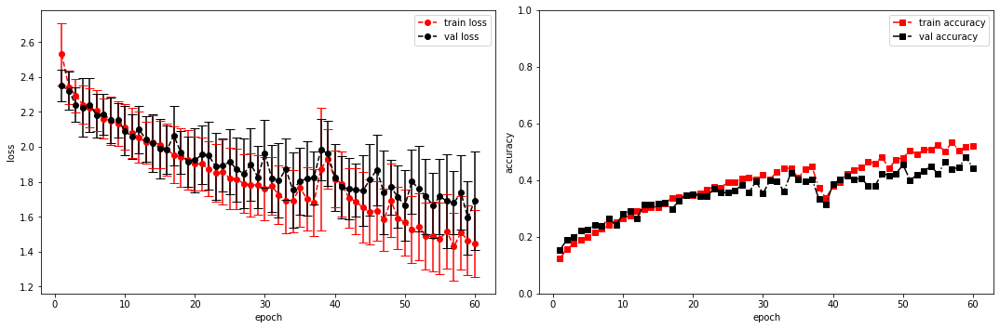

model saved


training epoch:  60
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [61/100], step [1/168],  Loss: 1.4409 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.530975341796875s
Epoch [61/100], step [17/168],  Loss: 1.4680 +/- 0.2304,  accuracy: 0.50390625, time elapsed = 6.239359378814697s
Epoch [61/100], step [33/168],  Loss: 1.3791 +/- 0.2275,  accuracy: 0.54296875, time elapsed = 6.247920274734497s
Epoch [61/100], step [49/168],  Loss: 1.4564 +/- 0.2099,  accuracy: 0.51171875, time elapsed = 6.241075038909912s
Epoch [61/100], step [65/168],  Loss: 1.4278 +/- 0.2417,  accuracy: 0.525390625, time elapsed = 6.358757734298706s
Epoch [61/100], step [81/168],  Loss: 1.4174 +/- 0.2148,  accuracy: 0.533203125, time elapsed = 6.521843910217285s
Epoch [61/100], step [97/168],  Loss: 1.4632 +/- 0.2019,  accuracy: 0.533203125, time elapsed = 6.258013486862183s
Epoch [61/100], step [113/168],  Loss: 1.3855 +/- 0.2500,  accuracy: 0.544921875, time elapsed = 6.240587472915649s
Epoch [61/100], step [129/168],  Loss: 1.3600 +/- 0.2084,  accuracy: 0.5703125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.527,  precision = 0.527 recall = 0.527 f1 = 0.527 ::: val: acc = 0.467,  precision = 0.467 recall = 0.467 time elapsed = 70.89721179008484s


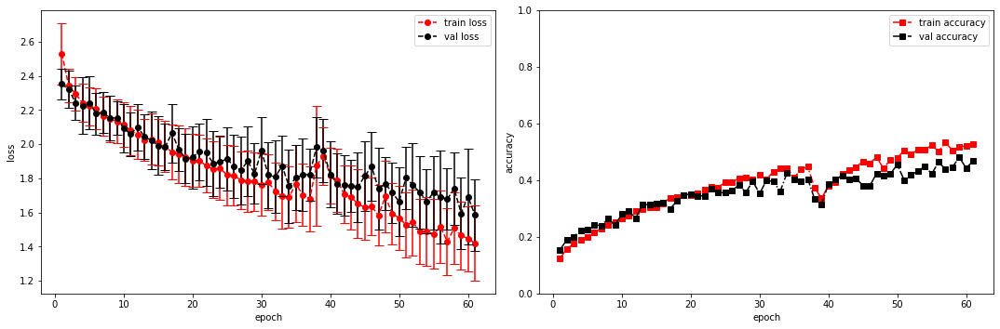

model saved


training epoch:  61
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [62/100], step [1/168],  Loss: 1.4126 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5262384414672852s
Epoch [62/100], step [17/168],  Loss: 1.3921 +/- 0.1798,  accuracy: 0.533203125, time elapsed = 6.2406675815582275s
Epoch [62/100], step [33/168],  Loss: 1.5124 +/- 0.2138,  accuracy: 0.521484375, time elapsed = 6.241462469100952s
Epoch [62/100], step [49/168],  Loss: 1.4177 +/- 0.1480,  accuracy: 0.54296875, time elapsed = 6.242242813110352s
Epoch [62/100], step [65/168],  Loss: 1.3483 +/- 0.1933,  accuracy: 0.556640625, time elapsed = 6.241867542266846s
Epoch [62/100], step [81/168],  Loss: 1.4499 +/- 0.1723,  accuracy: 0.533203125, time elapsed = 6.240261793136597s
Epoch [62/100], step [97/168],  Loss: 1.4670 +/- 0.1989,  accuracy: 0.54296875, time elapsed = 6.241115093231201s
Epoch [62/100], step [113/168],  Loss: 1.4688 +/- 0.1966,  accuracy: 0.498046875, time elapsed = 6.24206280708313s
Epoch [62/100], step [129/168],  Loss: 1.4250 +/- 0.1971,  accuracy: 0.544921875,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.531,  precision = 0.531 recall = 0.531 f1 = 0.531 ::: val: acc = 0.470,  precision = 0.470 recall = 0.470 time elapsed = 70.49963521957397s


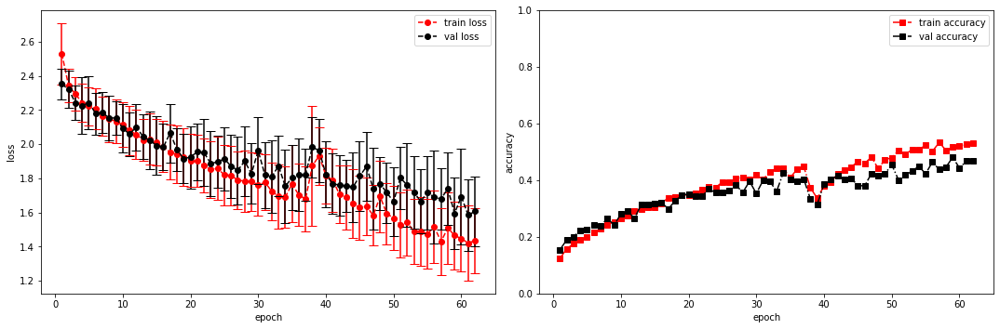

model saved


training epoch:  62
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [63/100], step [1/168],  Loss: 1.7153 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5261340141296387s
Epoch [63/100], step [17/168],  Loss: 1.3996 +/- 0.1483,  accuracy: 0.53515625, time elapsed = 6.239835739135742s
Epoch [63/100], step [33/168],  Loss: 1.4011 +/- 0.1964,  accuracy: 0.54296875, time elapsed = 6.239981412887573s
Epoch [63/100], step [49/168],  Loss: 1.4550 +/- 0.2042,  accuracy: 0.5234375, time elapsed = 6.239597797393799s
Epoch [63/100], step [65/168],  Loss: 1.3917 +/- 0.2248,  accuracy: 0.5390625, time elapsed = 6.240234375s
Epoch [63/100], step [81/168],  Loss: 1.4140 +/- 0.2269,  accuracy: 0.525390625, time elapsed = 6.240081071853638s
Epoch [63/100], step [97/168],  Loss: 1.4455 +/- 0.1630,  accuracy: 0.51171875, time elapsed = 6.239789009094238s
Epoch [63/100], step [113/168],  Loss: 1.4338 +/- 0.2788,  accuracy: 0.513671875, time elapsed = 6.240715026855469s
Epoch [63/100], step [129/168],  Loss: 1.4036 +/- 0.1913,  accuracy: 0.544921875, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.533,  precision = 0.533 recall = 0.533 f1 = 0.533 ::: val: acc = 0.447,  precision = 0.447 recall = 0.447 time elapsed = 70.47339105606079s


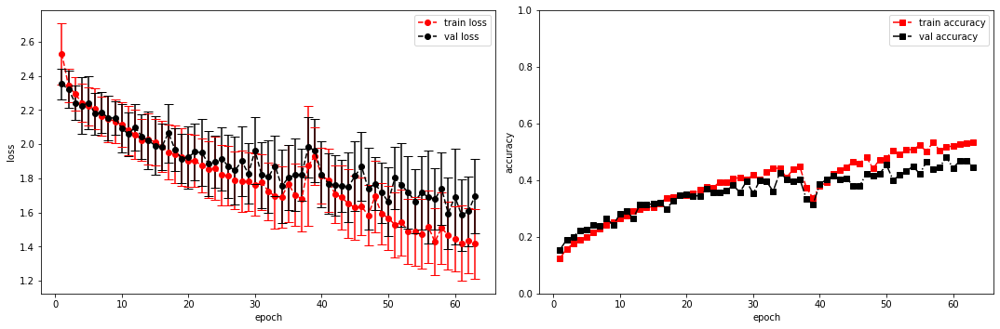

model saved


training epoch:  63
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [64/100], step [1/168],  Loss: 1.4657 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5306923389434814s
Epoch [64/100], step [17/168],  Loss: 1.4836 +/- 0.2167,  accuracy: 0.53515625, time elapsed = 6.240779161453247s
Epoch [64/100], step [33/168],  Loss: 1.3301 +/- 0.1477,  accuracy: 0.568359375, time elapsed = 6.239132642745972s
Epoch [64/100], step [49/168],  Loss: 1.3725 +/- 0.2103,  accuracy: 0.546875, time elapsed = 6.238736152648926s
Epoch [64/100], step [65/168],  Loss: 1.3656 +/- 0.1352,  accuracy: 0.533203125, time elapsed = 6.238784074783325s
Epoch [64/100], step [81/168],  Loss: 1.3573 +/- 0.1748,  accuracy: 0.552734375, time elapsed = 6.238646745681763s
Epoch [64/100], step [97/168],  Loss: 1.4102 +/- 0.1384,  accuracy: 0.544921875, time elapsed = 6.241113662719727s
Epoch [64/100], step [113/168],  Loss: 1.4604 +/- 0.1642,  accuracy: 0.482421875, time elapsed = 6.2473931312561035s
Epoch [64/100], step [129/168],  Loss: 1.4687 +/- 0.2257,  accuracy: 0.525390625, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.537,  precision = 0.537 recall = 0.537 f1 = 0.537 ::: val: acc = 0.507,  precision = 0.507 recall = 0.507 time elapsed = 70.47630858421326s


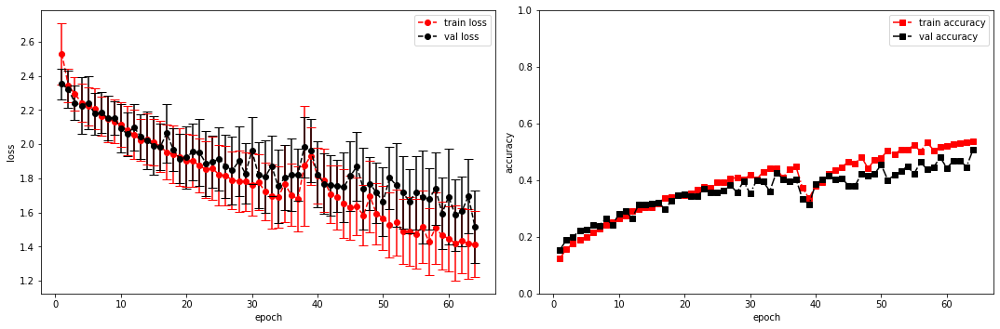

model saved


training epoch:  64
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [65/100], step [1/168],  Loss: 1.1873 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5324985980987549s
Epoch [65/100], step [17/168],  Loss: 1.3334 +/- 0.1906,  accuracy: 0.578125, time elapsed = 6.239515066146851s
Epoch [65/100], step [33/168],  Loss: 1.3726 +/- 0.1727,  accuracy: 0.533203125, time elapsed = 6.238720655441284s
Epoch [65/100], step [49/168],  Loss: 1.4075 +/- 0.2258,  accuracy: 0.513671875, time elapsed = 6.237786769866943s
Epoch [65/100], step [65/168],  Loss: 1.4136 +/- 0.1817,  accuracy: 0.529296875, time elapsed = 6.241101980209351s
Epoch [65/100], step [81/168],  Loss: 1.4297 +/- 0.1496,  accuracy: 0.533203125, time elapsed = 6.237334966659546s
Epoch [65/100], step [97/168],  Loss: 1.4371 +/- 0.2341,  accuracy: 0.51953125, time elapsed = 6.240714073181152s
Epoch [65/100], step [113/168],  Loss: 1.4470 +/- 0.1833,  accuracy: 0.537109375, time elapsed = 6.239797353744507s
Epoch [65/100], step [129/168],  Loss: 1.4954 +/- 0.1991,  accuracy: 0.482421875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.525,  precision = 0.525 recall = 0.525 f1 = 0.525 ::: val: acc = 0.491,  precision = 0.491 recall = 0.491 time elapsed = 70.50839447975159s


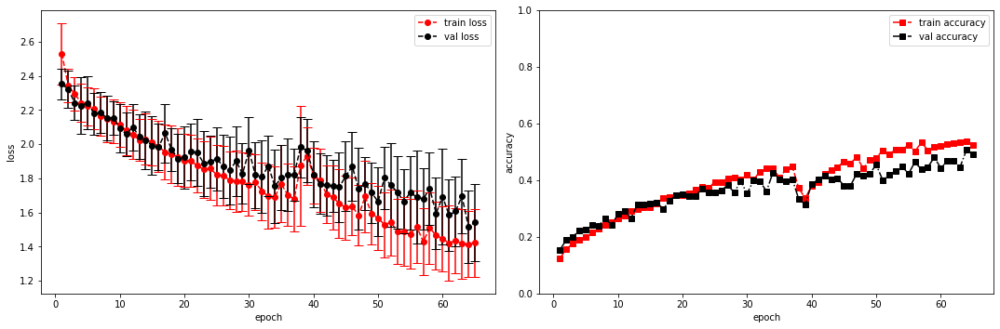

model saved


training epoch:  65
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [66/100], step [1/168],  Loss: 1.0987 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5557067394256592s
Epoch [66/100], step [17/168],  Loss: 1.3810 +/- 0.1590,  accuracy: 0.560546875, time elapsed = 6.2407450675964355s
Epoch [66/100], step [33/168],  Loss: 1.3714 +/- 0.2210,  accuracy: 0.578125, time elapsed = 6.241347312927246s
Epoch [66/100], step [49/168],  Loss: 1.3030 +/- 0.1915,  accuracy: 0.591796875, time elapsed = 6.25330376625061s
Epoch [66/100], step [65/168],  Loss: 1.7457 +/- 0.4324,  accuracy: 0.427734375, time elapsed = 6.24218487739563s
Epoch [66/100], step [81/168],  Loss: 2.3329 +/- 0.1443,  accuracy: 0.25390625, time elapsed = 6.242065191268921s
Epoch [66/100], step [97/168],  Loss: 2.2982 +/- 0.1853,  accuracy: 0.251953125, time elapsed = 6.241474151611328s
Epoch [66/100], step [113/168],  Loss: 2.2306 +/- 0.2021,  accuracy: 0.248046875, time elapsed = 6.24074912071228s
Epoch [66/100], step [129/168],  Loss: 2.0258 +/- 0.1404,  accuracy: 0.294921875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.386,  precision = 0.386 recall = 0.386 f1 = 0.386 ::: val: acc = 0.333,  precision = 0.333 recall = 0.333 time elapsed = 70.52435851097107s


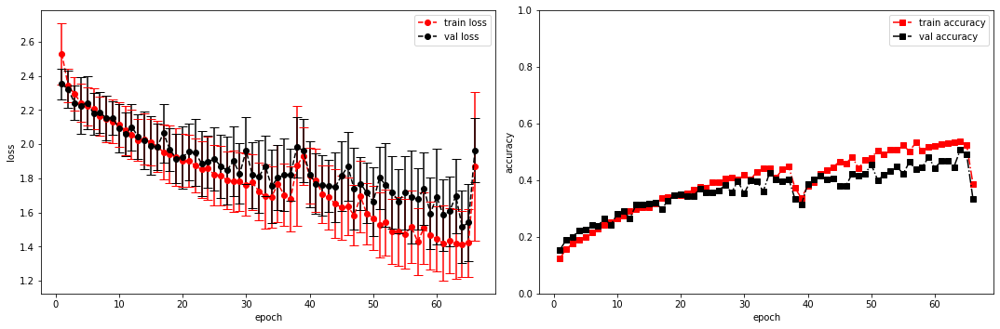

model saved


training epoch:  66
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [67/100], step [1/168],  Loss: 2.1783 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5306034088134766s
Epoch [67/100], step [17/168],  Loss: 1.9519 +/- 0.1931,  accuracy: 0.318359375, time elapsed = 6.241541147232056s
Epoch [67/100], step [33/168],  Loss: 1.8787 +/- 0.1669,  accuracy: 0.359375, time elapsed = 6.239874839782715s
Epoch [67/100], step [49/168],  Loss: 1.8995 +/- 0.2079,  accuracy: 0.365234375, time elapsed = 6.240463733673096s
Epoch [67/100], step [65/168],  Loss: 1.8935 +/- 0.2529,  accuracy: 0.36328125, time elapsed = 6.240270614624023s
Epoch [67/100], step [81/168],  Loss: 1.8506 +/- 0.1769,  accuracy: 0.373046875, time elapsed = 6.2401862144470215s
Epoch [67/100], step [97/168],  Loss: 1.8073 +/- 0.2444,  accuracy: 0.412109375, time elapsed = 6.2405781745910645s
Epoch [67/100], step [113/168],  Loss: 1.8692 +/- 0.2041,  accuracy: 0.380859375, time elapsed = 6.2390828132629395s
Epoch [67/100], step [129/168],  Loss: 1.7402 +/- 0.1840,  accuracy: 0.427734375,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.373,  precision = 0.373 recall = 0.373 f1 = 0.373 ::: val: acc = 0.345,  precision = 0.345 recall = 0.345 time elapsed = 70.50495719909668s


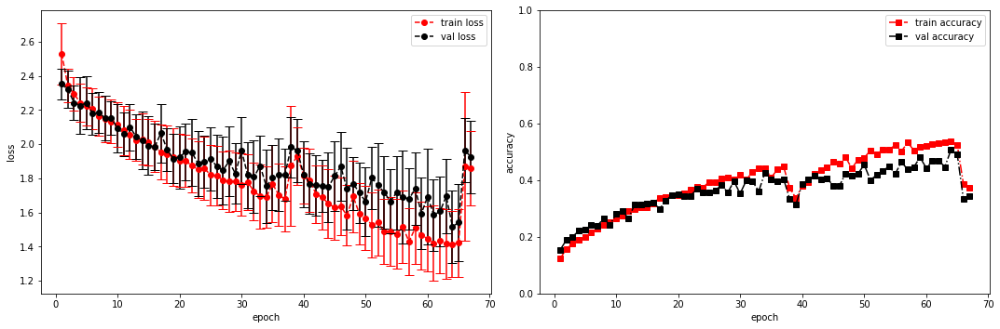

model saved


training epoch:  67
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [68/100], step [1/168],  Loss: 1.3681 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5238339900970459s
Epoch [68/100], step [17/168],  Loss: 1.7672 +/- 0.1918,  accuracy: 0.400390625, time elapsed = 6.242118835449219s
Epoch [68/100], step [33/168],  Loss: 1.8023 +/- 0.2276,  accuracy: 0.38671875, time elapsed = 6.241377592086792s
Epoch [68/100], step [49/168],  Loss: 1.7124 +/- 0.2068,  accuracy: 0.431640625, time elapsed = 6.241614580154419s
Epoch [68/100], step [65/168],  Loss: 1.7523 +/- 0.1837,  accuracy: 0.39453125, time elapsed = 6.241150379180908s
Epoch [68/100], step [81/168],  Loss: 1.9207 +/- 0.1722,  accuracy: 0.365234375, time elapsed = 6.2410454750061035s
Epoch [68/100], step [97/168],  Loss: 1.7459 +/- 0.1728,  accuracy: 0.404296875, time elapsed = 6.24112868309021s
Epoch [68/100], step [113/168],  Loss: 1.8494 +/- 0.2006,  accuracy: 0.38671875, time elapsed = 6.2407519817352295s
Epoch [68/100], step [129/168],  Loss: 1.7718 +/- 0.2230,  accuracy: 0.3984375, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.403,  precision = 0.403 recall = 0.403 f1 = 0.403 ::: val: acc = 0.425,  precision = 0.425 recall = 0.425 time elapsed = 70.48652267456055s


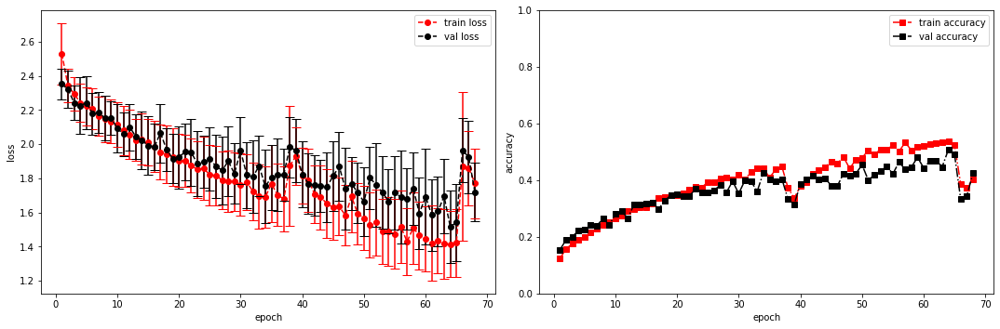

model saved


training epoch:  68
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [69/100], step [1/168],  Loss: 1.5960 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5251429080963135s
Epoch [69/100], step [17/168],  Loss: 1.6365 +/- 0.1442,  accuracy: 0.455078125, time elapsed = 6.240857362747192s
Epoch [69/100], step [33/168],  Loss: 1.7264 +/- 0.2066,  accuracy: 0.421875, time elapsed = 6.24050235748291s
Epoch [69/100], step [49/168],  Loss: 1.6808 +/- 0.2160,  accuracy: 0.451171875, time elapsed = 6.2400665283203125s
Epoch [69/100], step [65/168],  Loss: 1.6838 +/- 0.1592,  accuracy: 0.4453125, time elapsed = 6.241403579711914s
Epoch [69/100], step [81/168],  Loss: 1.6562 +/- 0.1860,  accuracy: 0.447265625, time elapsed = 6.239766597747803s
Epoch [69/100], step [97/168],  Loss: 1.7193 +/- 0.1061,  accuracy: 0.404296875, time elapsed = 6.240344047546387s
Epoch [69/100], step [113/168],  Loss: 1.5407 +/- 0.1636,  accuracy: 0.482421875, time elapsed = 6.250861406326294s
Epoch [69/100], step [129/168],  Loss: 1.6457 +/- 0.1551,  accuracy: 0.458984375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.448,  precision = 0.448 recall = 0.448 f1 = 0.448 ::: val: acc = 0.440,  precision = 0.440 recall = 0.440 time elapsed = 70.49235892295837s


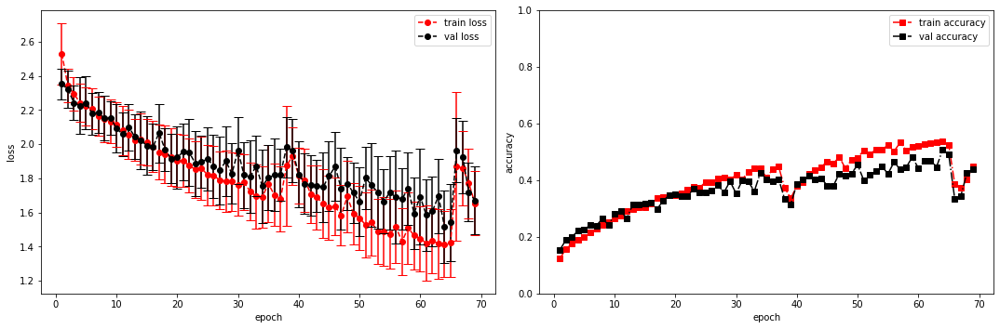

model saved


training epoch:  69
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [70/100], step [1/168],  Loss: 1.3238 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5276072025299072s
Epoch [70/100], step [17/168],  Loss: 1.6652 +/- 0.2533,  accuracy: 0.466796875, time elapsed = 6.24161171913147s
Epoch [70/100], step [33/168],  Loss: 1.6506 +/- 0.2196,  accuracy: 0.439453125, time elapsed = 6.241076707839966s
Epoch [70/100], step [49/168],  Loss: 1.6644 +/- 0.1484,  accuracy: 0.447265625, time elapsed = 6.24160099029541s
Epoch [70/100], step [65/168],  Loss: 1.5318 +/- 0.0926,  accuracy: 0.46484375, time elapsed = 6.241994857788086s
Epoch [70/100], step [81/168],  Loss: 1.6267 +/- 0.1823,  accuracy: 0.455078125, time elapsed = 6.24349570274353s
Epoch [70/100], step [97/168],  Loss: 1.5455 +/- 0.1648,  accuracy: 0.49609375, time elapsed = 6.241863012313843s
Epoch [70/100], step [113/168],  Loss: 1.5450 +/- 0.1418,  accuracy: 0.466796875, time elapsed = 6.241076469421387s
Epoch [70/100], step [129/168],  Loss: 1.6359 +/- 0.1716,  accuracy: 0.447265625, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.450,  precision = 0.450 recall = 0.450 f1 = 0.450 ::: val: acc = 0.422,  precision = 0.422 recall = 0.422 time elapsed = 70.48507499694824s


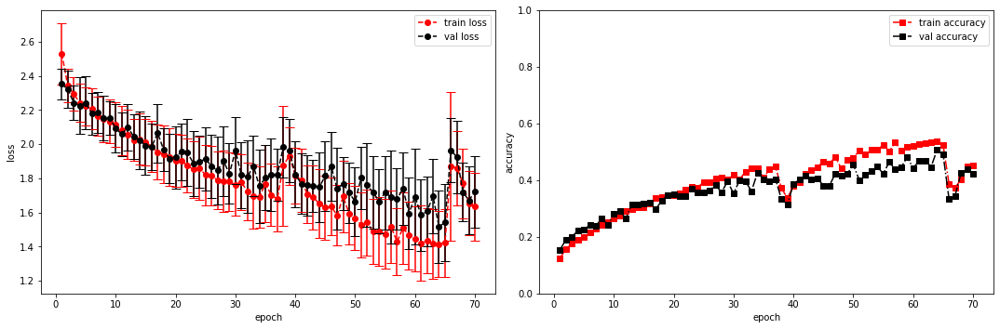

model saved


training epoch:  70
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [71/100], step [1/168],  Loss: 1.7457 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5301837921142578s
Epoch [71/100], step [17/168],  Loss: 1.7041 +/- 0.1784,  accuracy: 0.423828125, time elapsed = 6.2413153648376465s
Epoch [71/100], step [33/168],  Loss: 1.5372 +/- 0.1630,  accuracy: 0.484375, time elapsed = 6.240633010864258s
Epoch [71/100], step [49/168],  Loss: 1.6869 +/- 0.1928,  accuracy: 0.4375, time elapsed = 6.2418413162231445s
Epoch [71/100], step [65/168],  Loss: 1.8323 +/- 0.2811,  accuracy: 0.3828125, time elapsed = 6.249951124191284s
Epoch [71/100], step [81/168],  Loss: 1.9434 +/- 0.1870,  accuracy: 0.3203125, time elapsed = 6.239875078201294s
Epoch [71/100], step [97/168],  Loss: 1.9095 +/- 0.2154,  accuracy: 0.345703125, time elapsed = 6.241944789886475s
Epoch [71/100], step [113/168],  Loss: 1.8505 +/- 0.2382,  accuracy: 0.3671875, time elapsed = 6.2402098178863525s
Epoch [71/100], step [129/168],  Loss: 1.8154 +/- 0.2175,  accuracy: 0.39453125, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.380,  precision = 0.380 recall = 0.380 f1 = 0.380 ::: val: acc = 0.288,  precision = 0.288 recall = 0.288 time elapsed = 70.4935302734375s


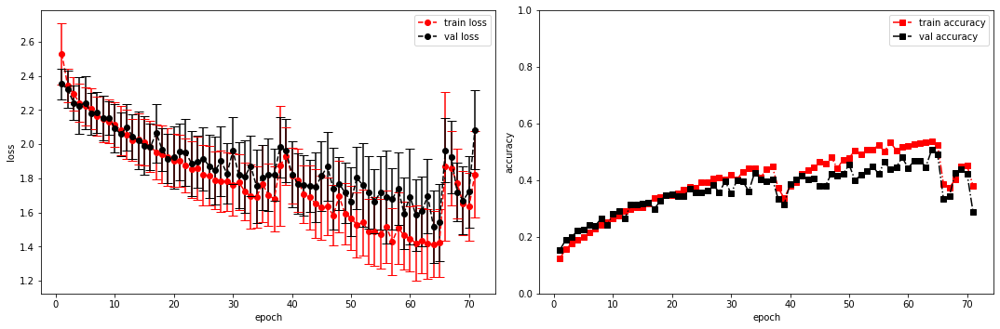

model saved


training epoch:  71
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [72/100], step [1/168],  Loss: 1.8079 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5244424343109131s
Epoch [72/100], step [17/168],  Loss: 1.8225 +/- 0.1617,  accuracy: 0.373046875, time elapsed = 6.240617275238037s
Epoch [72/100], step [33/168],  Loss: 1.7316 +/- 0.1338,  accuracy: 0.3984375, time elapsed = 6.243408918380737s
Epoch [72/100], step [49/168],  Loss: 1.7292 +/- 0.1589,  accuracy: 0.419921875, time elapsed = 6.241248607635498s
Epoch [72/100], step [65/168],  Loss: 1.7449 +/- 0.1916,  accuracy: 0.443359375, time elapsed = 6.2416887283325195s
Epoch [72/100], step [81/168],  Loss: 1.7898 +/- 0.2031,  accuracy: 0.4140625, time elapsed = 6.2420337200164795s
Epoch [72/100], step [97/168],  Loss: 1.7623 +/- 0.2170,  accuracy: 0.392578125, time elapsed = 6.240620851516724s
Epoch [72/100], step [113/168],  Loss: 1.6694 +/- 0.2201,  accuracy: 0.451171875, time elapsed = 6.240346431732178s
Epoch [72/100], step [129/168],  Loss: 1.7248 +/- 0.2013,  accuracy: 0.44140625, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.359,  precision = 0.359 recall = 0.359 f1 = 0.359 ::: val: acc = 0.229,  precision = 0.229 recall = 0.229 time elapsed = 70.48424649238586s


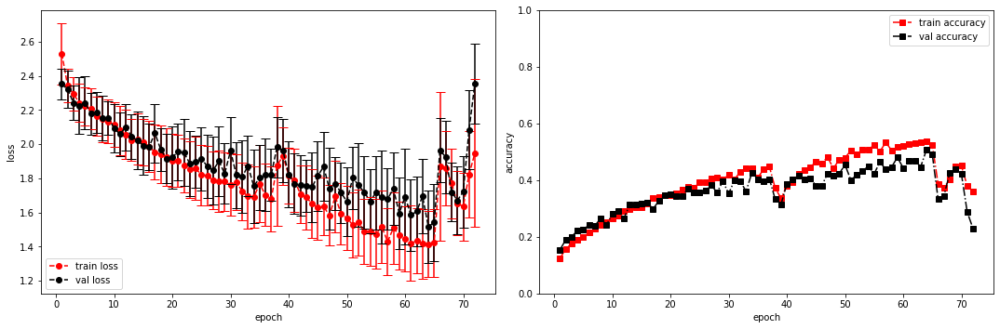

model saved


training epoch:  72
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [73/100], step [1/168],  Loss: 2.3290 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5208323001861572s
Epoch [73/100], step [17/168],  Loss: 2.5902 +/- 0.4057,  accuracy: 0.16015625, time elapsed = 6.242159366607666s
Epoch [73/100], step [33/168],  Loss: 2.6851 +/- 0.3114,  accuracy: 0.1328125, time elapsed = 6.240477800369263s
Epoch [73/100], step [49/168],  Loss: 2.4092 +/- 0.1910,  accuracy: 0.162109375, time elapsed = 6.239996910095215s
Epoch [73/100], step [65/168],  Loss: 2.2639 +/- 0.1407,  accuracy: 0.2109375, time elapsed = 6.24076771736145s
Epoch [73/100], step [81/168],  Loss: 2.3967 +/- 0.1455,  accuracy: 0.158203125, time elapsed = 6.2406907081604s
Epoch [73/100], step [97/168],  Loss: 2.2701 +/- 0.1179,  accuracy: 0.2265625, time elapsed = 6.240199089050293s
Epoch [73/100], step [113/168],  Loss: 2.2395 +/- 0.1522,  accuracy: 0.20703125, time elapsed = 6.241879224777222s
Epoch [73/100], step [129/168],  Loss: 2.1900 +/- 0.1159,  accuracy: 0.240234375, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.200,  precision = 0.200 recall = 0.200 f1 = 0.200 ::: val: acc = 0.276,  precision = 0.276 recall = 0.276 time elapsed = 70.47850632667542s


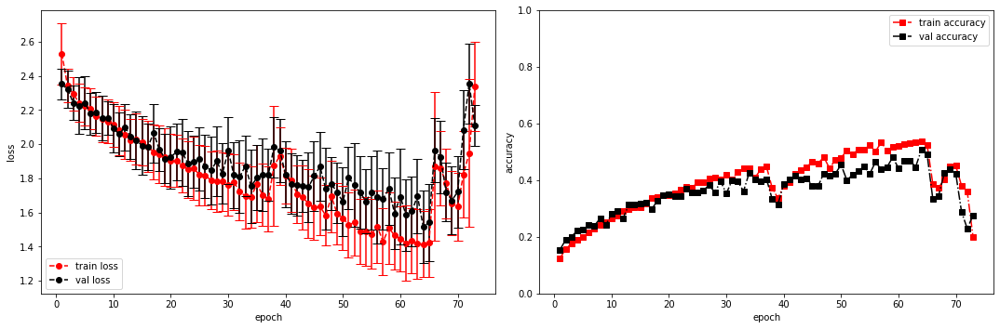

model saved


training epoch:  73
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [74/100], step [1/168],  Loss: 2.3428 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5234119892120361s
Epoch [74/100], step [17/168],  Loss: 2.1606 +/- 0.1152,  accuracy: 0.236328125, time elapsed = 6.2400431632995605s
Epoch [74/100], step [33/168],  Loss: 2.1887 +/- 0.1021,  accuracy: 0.197265625, time elapsed = 6.240595817565918s
Epoch [74/100], step [49/168],  Loss: 2.1690 +/- 0.1231,  accuracy: 0.25, time elapsed = 6.240242958068848s
Epoch [74/100], step [65/168],  Loss: 2.1183 +/- 0.1561,  accuracy: 0.2734375, time elapsed = 6.24098539352417s
Epoch [74/100], step [81/168],  Loss: 2.1298 +/- 0.1962,  accuracy: 0.251953125, time elapsed = 6.238926649093628s
Epoch [74/100], step [97/168],  Loss: 2.1340 +/- 0.1395,  accuracy: 0.224609375, time elapsed = 6.239965915679932s
Epoch [74/100], step [113/168],  Loss: 2.1102 +/- 0.1184,  accuracy: 0.25390625, time elapsed = 6.240102767944336s
Epoch [74/100], step [129/168],  Loss: 2.1627 +/- 0.1364,  accuracy: 0.25390625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.241,  precision = 0.241 recall = 0.241 f1 = 0.241 ::: val: acc = 0.266,  precision = 0.266 recall = 0.266 time elapsed = 70.49090099334717s


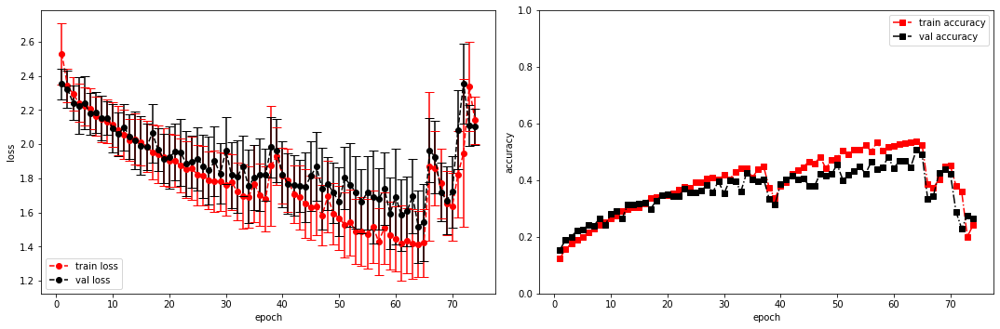

model saved


training epoch:  74
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [75/100], step [1/168],  Loss: 1.9587 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5299644470214844s
Epoch [75/100], step [17/168],  Loss: 2.1175 +/- 0.1121,  accuracy: 0.25, time elapsed = 6.241438150405884s
Epoch [75/100], step [33/168],  Loss: 2.1124 +/- 0.1572,  accuracy: 0.25390625, time elapsed = 6.239643096923828s
Epoch [75/100], step [49/168],  Loss: 2.2566 +/- 0.2326,  accuracy: 0.220703125, time elapsed = 6.240609169006348s
Epoch [75/100], step [65/168],  Loss: 2.2982 +/- 0.1702,  accuracy: 0.169921875, time elapsed = 6.240404367446899s
Epoch [75/100], step [81/168],  Loss: 2.1937 +/- 0.1338,  accuracy: 0.189453125, time elapsed = 6.240541458129883s
Epoch [75/100], step [97/168],  Loss: 2.1880 +/- 0.1188,  accuracy: 0.234375, time elapsed = 6.242173433303833s
Epoch [75/100], step [113/168],  Loss: 2.1163 +/- 0.1085,  accuracy: 0.2265625, time elapsed = 6.239863634109497s
Epoch [75/100], step [129/168],  Loss: 2.1606 +/- 0.0662,  accuracy: 0.236328125, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.230,  precision = 0.230 recall = 0.230 f1 = 0.230 ::: val: acc = 0.297,  precision = 0.297 recall = 0.297 time elapsed = 70.49063229560852s


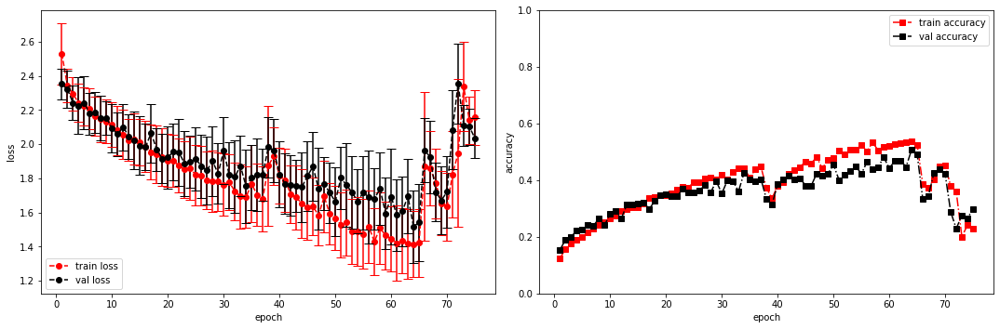

model saved


training epoch:  75
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [76/100], step [1/168],  Loss: 1.9056 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5242276191711426s
Epoch [76/100], step [17/168],  Loss: 2.4064 +/- 0.1711,  accuracy: 0.146484375, time elapsed = 6.2411789894104s
Epoch [76/100], step [33/168],  Loss: 2.2870 +/- 0.1453,  accuracy: 0.1875, time elapsed = 6.242273330688477s
Epoch [76/100], step [49/168],  Loss: 2.3494 +/- 0.2025,  accuracy: 0.158203125, time elapsed = 6.241688966751099s
Epoch [76/100], step [65/168],  Loss: 2.3392 +/- 0.1612,  accuracy: 0.1640625, time elapsed = 6.252504587173462s
Epoch [76/100], step [81/168],  Loss: 2.3636 +/- 0.1330,  accuracy: 0.16015625, time elapsed = 6.241381406784058s
Epoch [76/100], step [97/168],  Loss: 2.2023 +/- 0.1115,  accuracy: 0.21484375, time elapsed = 6.242579221725464s
Epoch [76/100], step [113/168],  Loss: 2.2651 +/- 0.1367,  accuracy: 0.177734375, time elapsed = 6.240626811981201s
Epoch [76/100], step [129/168],  Loss: 2.2301 +/- 0.1091,  accuracy: 0.1953125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.184,  precision = 0.184 recall = 0.184 f1 = 0.184 ::: val: acc = 0.119,  precision = 0.119 recall = 0.119 time elapsed = 70.49519371986389s


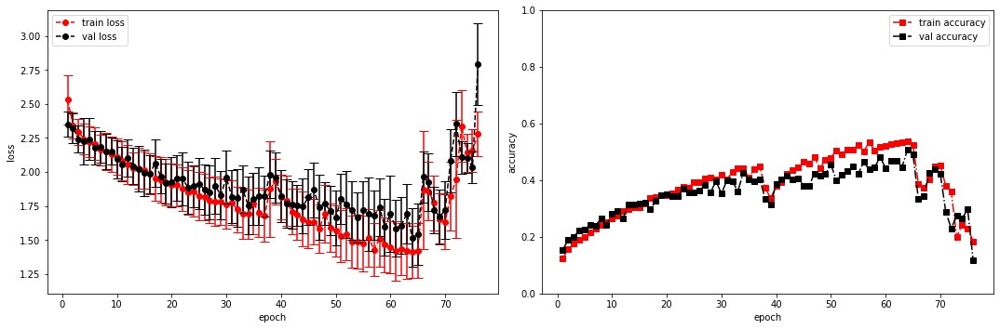

model saved
model saved


training epoch:  76
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [77/100], step [1/168],  Loss: 2.2294 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5225298404693604s
Epoch [77/100], step [17/168],  Loss: 2.1703 +/- 0.1354,  accuracy: 0.224609375, time elapsed = 6.240820646286011s
Epoch [77/100], step [33/168],  Loss: 2.1847 +/- 0.1301,  accuracy: 0.236328125, time elapsed = 6.242706298828125s
Epoch [77/100], step [49/168],  Loss: 2.1717 +/- 0.1386,  accuracy: 0.22265625, time elapsed = 6.240095615386963s
Epoch [77/100], step [65/168],  Loss: 2.1230 +/- 0.0929,  accuracy: 0.220703125, time elapsed = 6.239730358123779s
Epoch [77/100], step [81/168],  Loss: 2.0777 +/- 0.1236,  accuracy: 0.265625, time elapsed = 6.240054130554199s
Epoch [77/100], step [97/168],  Loss: 2.1153 +/- 0.1096,  accuracy: 0.21875, time elapsed = 6.238858222961426s
Epoch [77/100], step [113/168],  Loss: 2.0848 +/- 0.0778,  accuracy: 0.25, time elapsed = 6.238290548324585s
Epoch [77/100], step [129/168],  Loss: 2.1266 +/- 0.0955,  accuracy: 0.248046875, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.233,  precision = 0.233 recall = 0.233 f1 = 0.233 ::: val: acc = 0.249,  precision = 0.249 recall = 0.249 time elapsed = 70.46307754516602s


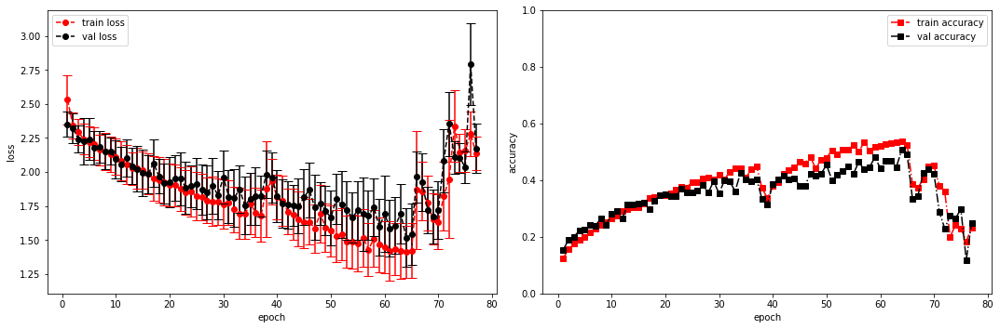

model saved


training epoch:  77
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [78/100], step [1/168],  Loss: 2.0860 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5284764766693115s
Epoch [78/100], step [17/168],  Loss: 2.1134 +/- 0.1488,  accuracy: 0.26171875, time elapsed = 6.249629974365234s
Epoch [78/100], step [33/168],  Loss: 2.1512 +/- 0.1284,  accuracy: 0.23046875, time elapsed = 6.238865852355957s
Epoch [78/100], step [49/168],  Loss: 2.2429 +/- 0.1413,  accuracy: 0.1953125, time elapsed = 6.240649223327637s
Epoch [78/100], step [65/168],  Loss: 2.3230 +/- 0.1380,  accuracy: 0.1796875, time elapsed = 6.241656541824341s
Epoch [78/100], step [81/168],  Loss: 2.2402 +/- 0.0895,  accuracy: 0.201171875, time elapsed = 6.241143703460693s
Epoch [78/100], step [97/168],  Loss: 2.1941 +/- 0.1065,  accuracy: 0.220703125, time elapsed = 6.241054058074951s
Epoch [78/100], step [113/168],  Loss: 2.2148 +/- 0.1351,  accuracy: 0.216796875, time elapsed = 6.240821361541748s
Epoch [78/100], step [129/168],  Loss: 2.1794 +/- 0.1038,  accuracy: 0.193359375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.218,  precision = 0.218 recall = 0.218 f1 = 0.218 ::: val: acc = 0.234,  precision = 0.234 recall = 0.234 time elapsed = 70.48824048042297s


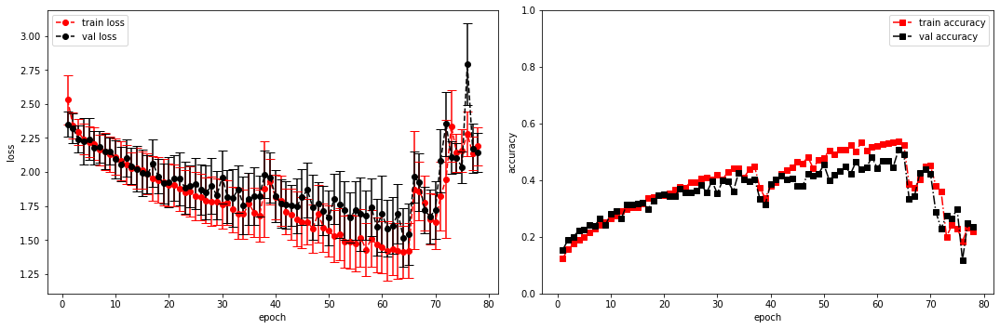

model saved


training epoch:  78
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [79/100], step [1/168],  Loss: 2.1086 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5246109962463379s
Epoch [79/100], step [17/168],  Loss: 2.1691 +/- 0.1023,  accuracy: 0.2421875, time elapsed = 6.240895509719849s
Epoch [79/100], step [33/168],  Loss: 2.1134 +/- 0.0916,  accuracy: 0.271484375, time elapsed = 6.240331172943115s
Epoch [79/100], step [49/168],  Loss: 2.1064 +/- 0.1020,  accuracy: 0.23828125, time elapsed = 6.240216493606567s
Epoch [79/100], step [65/168],  Loss: 2.0946 +/- 0.1023,  accuracy: 0.24609375, time elapsed = 6.240911483764648s
Epoch [79/100], step [81/168],  Loss: 2.1085 +/- 0.0891,  accuracy: 0.236328125, time elapsed = 6.240906000137329s
Epoch [79/100], step [97/168],  Loss: 2.1372 +/- 0.1737,  accuracy: 0.251953125, time elapsed = 6.240866422653198s
Epoch [79/100], step [113/168],  Loss: 2.1069 +/- 0.1259,  accuracy: 0.255859375, time elapsed = 6.240237236022949s
Epoch [79/100], step [129/168],  Loss: 2.0938 +/- 0.0891,  accuracy: 0.279296875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.254,  precision = 0.254 recall = 0.254 f1 = 0.254 ::: val: acc = 0.268,  precision = 0.268 recall = 0.268 time elapsed = 70.48895716667175s


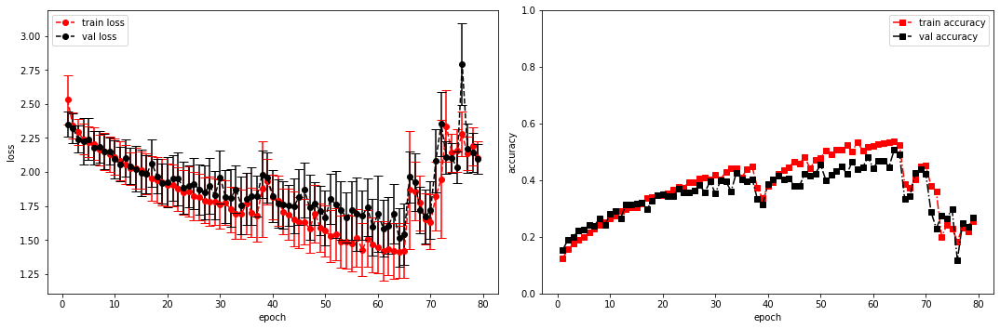

model saved


training epoch:  79
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [80/100], step [1/168],  Loss: 2.3927 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5270283222198486s
Epoch [80/100], step [17/168],  Loss: 2.0835 +/- 0.1504,  accuracy: 0.294921875, time elapsed = 6.241361141204834s
Epoch [80/100], step [33/168],  Loss: 2.1173 +/- 0.0848,  accuracy: 0.2421875, time elapsed = 6.240769386291504s
Epoch [80/100], step [49/168],  Loss: 2.0243 +/- 0.0826,  accuracy: 0.306640625, time elapsed = 6.239851951599121s
Epoch [80/100], step [65/168],  Loss: 2.0549 +/- 0.1127,  accuracy: 0.283203125, time elapsed = 6.241067886352539s
Epoch [80/100], step [81/168],  Loss: 2.0218 +/- 0.0992,  accuracy: 0.302734375, time elapsed = 6.239999294281006s
Epoch [80/100], step [97/168],  Loss: 2.0461 +/- 0.1240,  accuracy: 0.27734375, time elapsed = 6.242205619812012s
Epoch [80/100], step [113/168],  Loss: 2.0235 +/- 0.1060,  accuracy: 0.30078125, time elapsed = 6.240722417831421s
Epoch [80/100], step [129/168],  Loss: 2.0665 +/- 0.1131,  accuracy: 0.279296875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.283,  precision = 0.283 recall = 0.283 f1 = 0.283 ::: val: acc = 0.283,  precision = 0.283 recall = 0.283 time elapsed = 70.48169946670532s


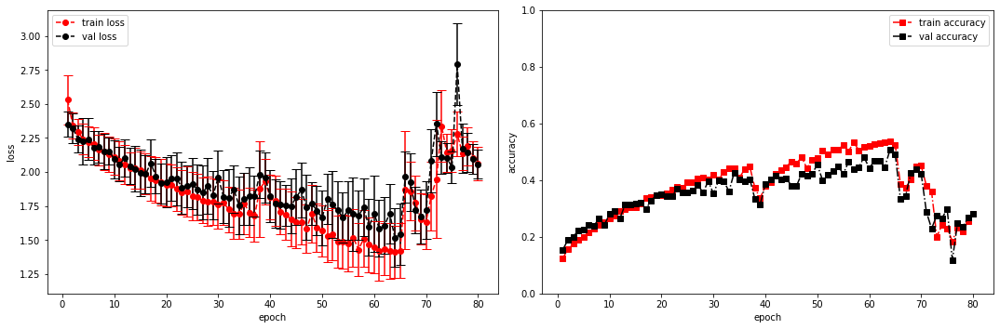

model saved


training epoch:  80
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [81/100], step [1/168],  Loss: 2.1546 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5247406959533691s
Epoch [81/100], step [17/168],  Loss: 2.0548 +/- 0.1484,  accuracy: 0.296875, time elapsed = 6.239508152008057s
Epoch [81/100], step [33/168],  Loss: 2.0047 +/- 0.0869,  accuracy: 0.271484375, time elapsed = 6.239875793457031s
Epoch [81/100], step [49/168],  Loss: 2.0399 +/- 0.1407,  accuracy: 0.3046875, time elapsed = 6.240109205245972s
Epoch [81/100], step [65/168],  Loss: 2.0428 +/- 0.1240,  accuracy: 0.3046875, time elapsed = 6.2397401332855225s
Epoch [81/100], step [81/168],  Loss: 2.1114 +/- 0.1406,  accuracy: 0.259765625, time elapsed = 6.259996175765991s
Epoch [81/100], step [97/168],  Loss: 2.1829 +/- 0.1937,  accuracy: 0.23046875, time elapsed = 6.2401649951934814s
Epoch [81/100], step [113/168],  Loss: 2.0891 +/- 0.1400,  accuracy: 0.287109375, time elapsed = 6.241090774536133s
Epoch [81/100], step [129/168],  Loss: 2.0806 +/- 0.1487,  accuracy: 0.28515625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.273,  precision = 0.273 recall = 0.273 f1 = 0.273 ::: val: acc = 0.291,  precision = 0.291 recall = 0.291 time elapsed = 70.4926688671112s


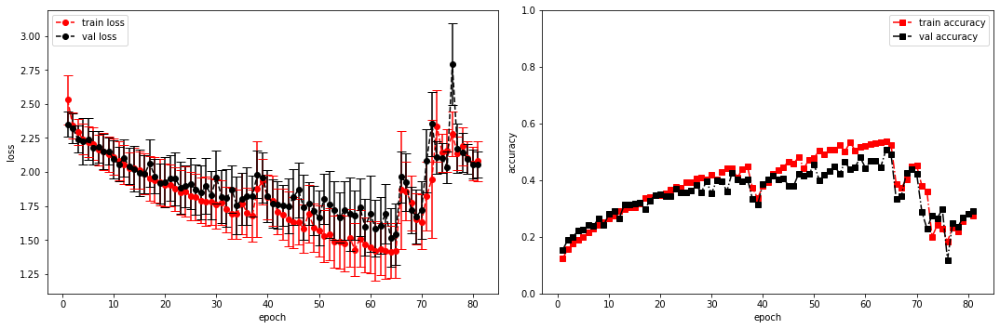

model saved


training epoch:  81
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [82/100], step [1/168],  Loss: 1.9970 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5267372131347656s
Epoch [82/100], step [17/168],  Loss: 2.0983 +/- 0.1458,  accuracy: 0.24609375, time elapsed = 6.2413177490234375s
Epoch [82/100], step [33/168],  Loss: 2.0272 +/- 0.1003,  accuracy: 0.28515625, time elapsed = 6.241479396820068s
Epoch [82/100], step [49/168],  Loss: 2.0730 +/- 0.1105,  accuracy: 0.283203125, time elapsed = 6.2432286739349365s
Epoch [82/100], step [65/168],  Loss: 2.0518 +/- 0.1283,  accuracy: 0.279296875, time elapsed = 6.241633415222168s
Epoch [82/100], step [81/168],  Loss: 2.0525 +/- 0.1097,  accuracy: 0.287109375, time elapsed = 6.241213798522949s
Epoch [82/100], step [97/168],  Loss: 2.1200 +/- 0.1252,  accuracy: 0.251953125, time elapsed = 6.242635250091553s
Epoch [82/100], step [113/168],  Loss: 2.0464 +/- 0.1442,  accuracy: 0.2890625, time elapsed = 6.241232633590698s
Epoch [82/100], step [129/168],  Loss: 2.0582 +/- 0.1152,  accuracy: 0.287109375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.284,  precision = 0.284 recall = 0.284 f1 = 0.284 ::: val: acc = 0.315,  precision = 0.315 recall = 0.315 time elapsed = 70.48774433135986s


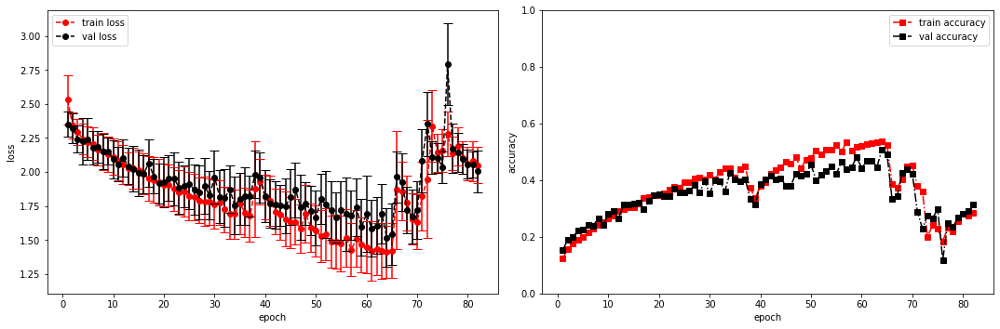

model saved


training epoch:  82
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [83/100], step [1/168],  Loss: 2.0546 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5286092758178711s
Epoch [83/100], step [17/168],  Loss: 2.0543 +/- 0.0988,  accuracy: 0.294921875, time elapsed = 6.240713596343994s
Epoch [83/100], step [33/168],  Loss: 1.9953 +/- 0.1335,  accuracy: 0.310546875, time elapsed = 6.248788118362427s
Epoch [83/100], step [49/168],  Loss: 2.0748 +/- 0.0932,  accuracy: 0.29296875, time elapsed = 6.2397966384887695s
Epoch [83/100], step [65/168],  Loss: 1.9621 +/- 0.1294,  accuracy: 0.31640625, time elapsed = 6.239584684371948s
Epoch [83/100], step [81/168],  Loss: 1.9077 +/- 0.1501,  accuracy: 0.34375, time elapsed = 6.240166664123535s
Epoch [83/100], step [97/168],  Loss: 1.9386 +/- 0.1678,  accuracy: 0.328125, time elapsed = 6.240004777908325s
Epoch [83/100], step [113/168],  Loss: 2.0236 +/- 0.0961,  accuracy: 0.267578125, time elapsed = 6.24000883102417s
Epoch [83/100], step [129/168],  Loss: 1.9237 +/- 0.1111,  accuracy: 0.32421875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.305,  precision = 0.305 recall = 0.305 f1 = 0.305 ::: val: acc = 0.309,  precision = 0.309 recall = 0.309 time elapsed = 70.4841582775116s


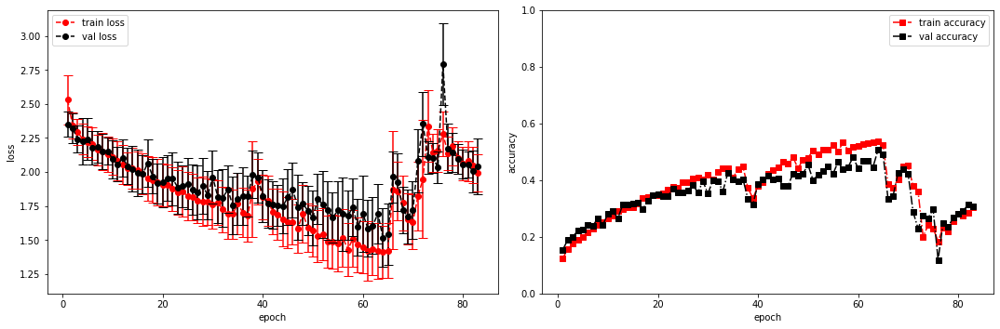

model saved


training epoch:  83
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [84/100], step [1/168],  Loss: 2.2395 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5261881351470947s
Epoch [84/100], step [17/168],  Loss: 2.0513 +/- 0.1530,  accuracy: 0.29296875, time elapsed = 6.242149591445923s
Epoch [84/100], step [33/168],  Loss: 2.0466 +/- 0.1352,  accuracy: 0.298828125, time elapsed = 6.242037057876587s
Epoch [84/100], step [49/168],  Loss: 1.9161 +/- 0.1192,  accuracy: 0.349609375, time elapsed = 6.240875005722046s
Epoch [84/100], step [65/168],  Loss: 1.9510 +/- 0.1141,  accuracy: 0.322265625, time elapsed = 6.2411229610443115s
Epoch [84/100], step [81/168],  Loss: 1.9680 +/- 0.1642,  accuracy: 0.333984375, time elapsed = 6.24216103553772s
Epoch [84/100], step [97/168],  Loss: 1.9549 +/- 0.0827,  accuracy: 0.294921875, time elapsed = 6.241621971130371s
Epoch [84/100], step [113/168],  Loss: 2.0210 +/- 0.1116,  accuracy: 0.298828125, time elapsed = 6.2410728931427s
Epoch [84/100], step [129/168],  Loss: 1.9933 +/- 0.1349,  accuracy: 0.298828125, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.312,  precision = 0.312 recall = 0.312 f1 = 0.312 ::: val: acc = 0.347,  precision = 0.347 recall = 0.347 time elapsed = 70.50723719596863s


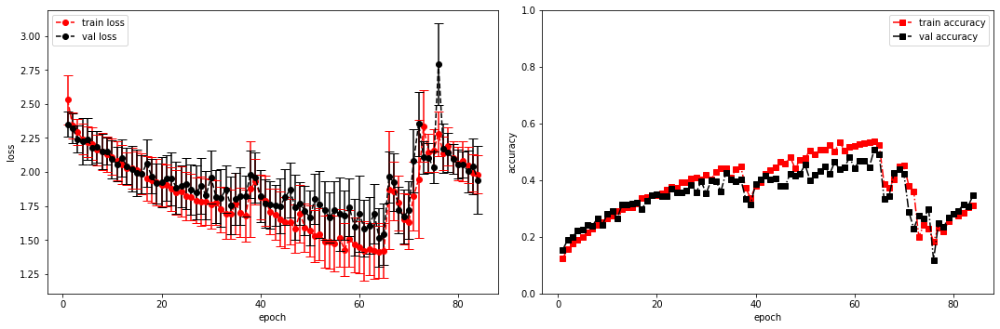

model saved


training epoch:  84
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [85/100], step [1/168],  Loss: 2.0760 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5287926197052002s
Epoch [85/100], step [17/168],  Loss: 1.9391 +/- 0.1025,  accuracy: 0.3359375, time elapsed = 6.24184513092041s
Epoch [85/100], step [33/168],  Loss: 1.9686 +/- 0.1666,  accuracy: 0.306640625, time elapsed = 6.240448713302612s
Epoch [85/100], step [49/168],  Loss: 1.8849 +/- 0.1603,  accuracy: 0.341796875, time elapsed = 6.238989591598511s
Epoch [85/100], step [65/168],  Loss: 1.9536 +/- 0.0990,  accuracy: 0.34375, time elapsed = 6.23974609375s
Epoch [85/100], step [81/168],  Loss: 1.9292 +/- 0.1304,  accuracy: 0.345703125, time elapsed = 6.240426301956177s
Epoch [85/100], step [97/168],  Loss: 1.9124 +/- 0.1264,  accuracy: 0.30859375, time elapsed = 6.238746404647827s
Epoch [85/100], step [113/168],  Loss: 1.8869 +/- 0.1321,  accuracy: 0.373046875, time elapsed = 6.242781639099121s
Epoch [85/100], step [129/168],  Loss: 1.8679 +/- 0.1213,  accuracy: 0.33984375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.341,  precision = 0.341 recall = 0.341 f1 = 0.341 ::: val: acc = 0.376,  precision = 0.376 recall = 0.376 time elapsed = 70.47548794746399s


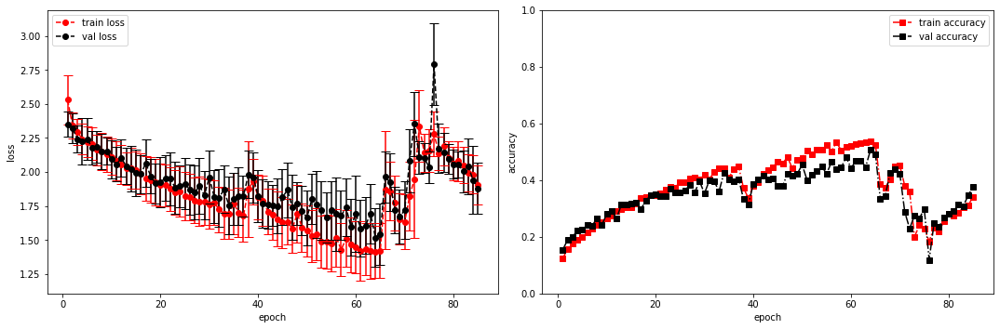

model saved


training epoch:  85
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [86/100], step [1/168],  Loss: 1.9588 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5251278877258301s
Epoch [86/100], step [17/168],  Loss: 2.0961 +/- 0.1461,  accuracy: 0.263671875, time elapsed = 6.24129843711853s
Epoch [86/100], step [33/168],  Loss: 2.1029 +/- 0.0966,  accuracy: 0.25, time elapsed = 6.240651607513428s
Epoch [86/100], step [49/168],  Loss: 2.1081 +/- 0.1326,  accuracy: 0.259765625, time elapsed = 6.241913318634033s
Epoch [86/100], step [65/168],  Loss: 1.9930 +/- 0.1169,  accuracy: 0.31640625, time elapsed = 6.241784572601318s
Epoch [86/100], step [81/168],  Loss: 1.9320 +/- 0.1276,  accuracy: 0.3046875, time elapsed = 6.2427287101745605s
Epoch [86/100], step [97/168],  Loss: 1.9737 +/- 0.1386,  accuracy: 0.318359375, time elapsed = 6.258855819702148s
Epoch [86/100], step [113/168],  Loss: 2.1169 +/- 0.2041,  accuracy: 0.259765625, time elapsed = 6.242062091827393s
Epoch [86/100], step [129/168],  Loss: 1.9904 +/- 0.1322,  accuracy: 0.322265625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.289,  precision = 0.289 recall = 0.289 f1 = 0.289 ::: val: acc = 0.329,  precision = 0.329 recall = 0.329 time elapsed = 70.51519203186035s


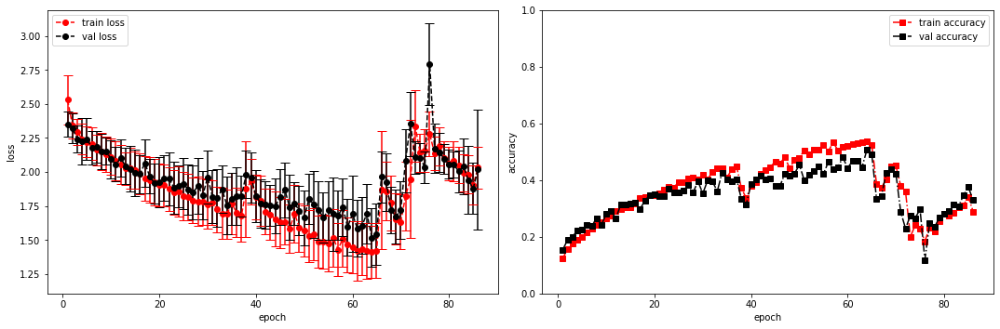

model saved


training epoch:  86
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [87/100], step [1/168],  Loss: 1.7499 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5297486782073975s
Epoch [87/100], step [17/168],  Loss: 1.9655 +/- 0.1148,  accuracy: 0.294921875, time elapsed = 6.242999315261841s
Epoch [87/100], step [33/168],  Loss: 1.9158 +/- 0.0979,  accuracy: 0.3515625, time elapsed = 6.2431252002716064s
Epoch [87/100], step [49/168],  Loss: 1.9438 +/- 0.1358,  accuracy: 0.3359375, time elapsed = 6.243812322616577s
Epoch [87/100], step [65/168],  Loss: 1.9553 +/- 0.2402,  accuracy: 0.3203125, time elapsed = 6.244728326797485s
Epoch [87/100], step [81/168],  Loss: 1.9055 +/- 0.1462,  accuracy: 0.357421875, time elapsed = 6.242688179016113s
Epoch [87/100], step [97/168],  Loss: 1.9101 +/- 0.1322,  accuracy: 0.34765625, time elapsed = 6.242732048034668s
Epoch [87/100], step [113/168],  Loss: 1.9119 +/- 0.1316,  accuracy: 0.337890625, time elapsed = 6.241020202636719s
Epoch [87/100], step [129/168],  Loss: 1.9396 +/- 0.1132,  accuracy: 0.302734375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.339,  precision = 0.339 recall = 0.339 f1 = 0.339 ::: val: acc = 0.383,  precision = 0.383 recall = 0.383 time elapsed = 70.50016832351685s


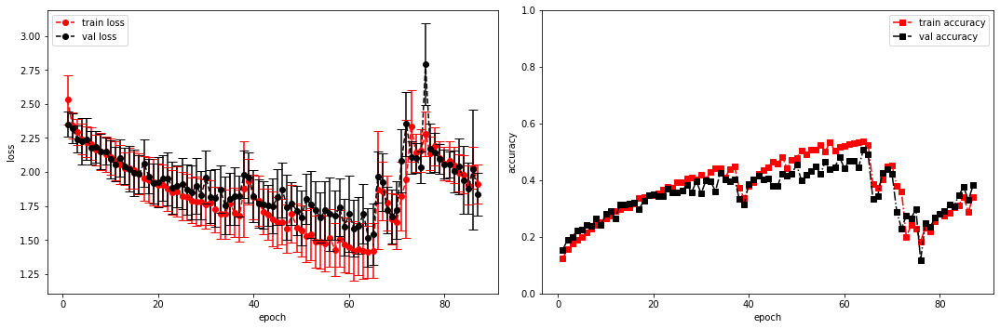

model saved


training epoch:  87
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [88/100], step [1/168],  Loss: 1.6342 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5241966247558594s
Epoch [88/100], step [17/168],  Loss: 1.8055 +/- 0.1767,  accuracy: 0.408203125, time elapsed = 6.241482496261597s
Epoch [88/100], step [33/168],  Loss: 1.8337 +/- 0.1219,  accuracy: 0.34765625, time elapsed = 6.253024578094482s
Epoch [88/100], step [49/168],  Loss: 1.8202 +/- 0.1414,  accuracy: 0.400390625, time elapsed = 6.244185447692871s
Epoch [88/100], step [65/168],  Loss: 1.8380 +/- 0.1153,  accuracy: 0.3828125, time elapsed = 6.24400782585144s
Epoch [88/100], step [81/168],  Loss: 1.8362 +/- 0.1195,  accuracy: 0.361328125, time elapsed = 6.243271350860596s
Epoch [88/100], step [97/168],  Loss: 1.7873 +/- 0.1189,  accuracy: 0.37890625, time elapsed = 6.2432520389556885s
Epoch [88/100], step [113/168],  Loss: 1.8624 +/- 0.1247,  accuracy: 0.345703125, time elapsed = 6.243667840957642s
Epoch [88/100], step [129/168],  Loss: 1.9104 +/- 0.1917,  accuracy: 0.33203125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.366,  precision = 0.366 recall = 0.366 f1 = 0.366 ::: val: acc = 0.325,  precision = 0.325 recall = 0.325 time elapsed = 70.51601576805115s


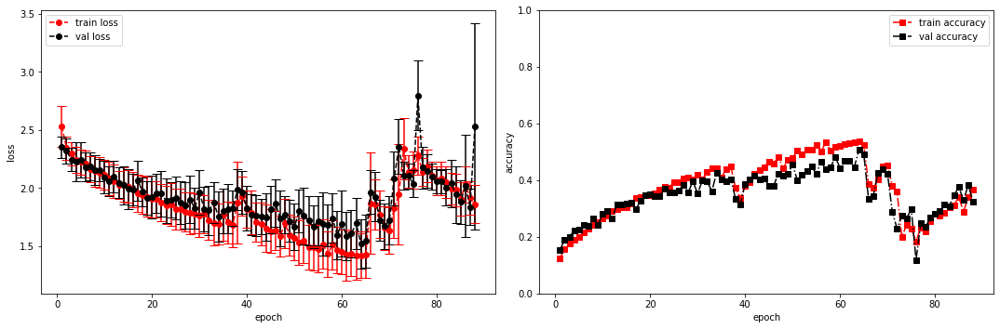

model saved


training epoch:  88
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [89/100], step [1/168],  Loss: 1.8032 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5289270877838135s
Epoch [89/100], step [17/168],  Loss: 1.8361 +/- 0.0819,  accuracy: 0.33203125, time elapsed = 6.241914749145508s
Epoch [89/100], step [33/168],  Loss: 1.8662 +/- 0.1552,  accuracy: 0.32421875, time elapsed = 6.242900371551514s
Epoch [89/100], step [49/168],  Loss: 1.8748 +/- 0.2150,  accuracy: 0.359375, time elapsed = 6.240766763687134s
Epoch [89/100], step [65/168],  Loss: 1.8834 +/- 0.1341,  accuracy: 0.3359375, time elapsed = 6.243144989013672s
Epoch [89/100], step [81/168],  Loss: 1.8192 +/- 0.1373,  accuracy: 0.390625, time elapsed = 6.243106365203857s
Epoch [89/100], step [97/168],  Loss: 1.8404 +/- 0.1157,  accuracy: 0.357421875, time elapsed = 6.242596864700317s
Epoch [89/100], step [113/168],  Loss: 1.8446 +/- 0.1664,  accuracy: 0.3828125, time elapsed = 6.241042375564575s
Epoch [89/100], step [129/168],  Loss: 1.7906 +/- 0.1408,  accuracy: 0.380859375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.357,  precision = 0.357 recall = 0.357 f1 = 0.357 ::: val: acc = 0.370,  precision = 0.370 recall = 0.370 time elapsed = 70.51642298698425s


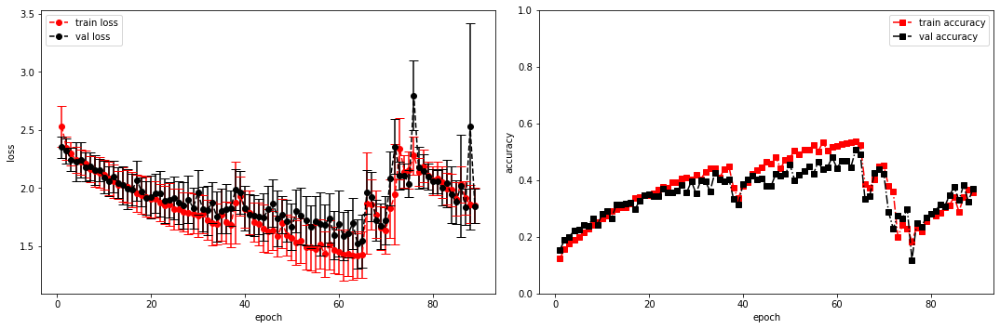

model saved


training epoch:  89
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [90/100], step [1/168],  Loss: 1.8895 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5288712978363037s
Epoch [90/100], step [17/168],  Loss: 1.8050 +/- 0.0933,  accuracy: 0.359375, time elapsed = 6.242380142211914s
Epoch [90/100], step [33/168],  Loss: 1.8203 +/- 0.1739,  accuracy: 0.39453125, time elapsed = 6.242647409439087s
Epoch [90/100], step [49/168],  Loss: 1.7769 +/- 0.1581,  accuracy: 0.404296875, time elapsed = 6.240631818771362s
Epoch [90/100], step [65/168],  Loss: 1.7539 +/- 0.1112,  accuracy: 0.38671875, time elapsed = 6.24143648147583s
Epoch [90/100], step [81/168],  Loss: 1.8419 +/- 0.1624,  accuracy: 0.3515625, time elapsed = 6.240947961807251s
Epoch [90/100], step [97/168],  Loss: 1.8335 +/- 0.1791,  accuracy: 0.396484375, time elapsed = 6.242544889450073s
Epoch [90/100], step [113/168],  Loss: 1.8166 +/- 0.1622,  accuracy: 0.373046875, time elapsed = 6.243007183074951s
Epoch [90/100], step [129/168],  Loss: 1.7294 +/- 0.1414,  accuracy: 0.38671875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.386,  precision = 0.386 recall = 0.386 f1 = 0.386 ::: val: acc = 0.369,  precision = 0.369 recall = 0.369 time elapsed = 70.50102114677429s


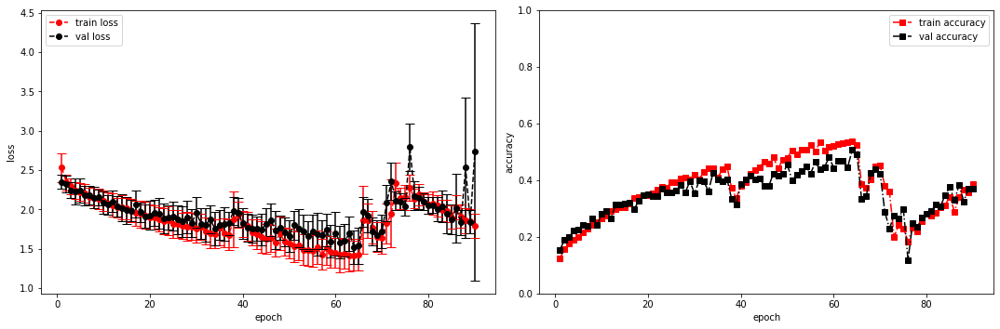

model saved


training epoch:  90
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [91/100], step [1/168],  Loss: 1.6581 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5275511741638184s
Epoch [91/100], step [17/168],  Loss: 1.8528 +/- 0.1312,  accuracy: 0.375, time elapsed = 6.241152286529541s
Epoch [91/100], step [33/168],  Loss: 1.8009 +/- 0.1075,  accuracy: 0.357421875, time elapsed = 6.24241828918457s
Epoch [91/100], step [49/168],  Loss: 1.7881 +/- 0.1343,  accuracy: 0.376953125, time elapsed = 6.241397142410278s
Epoch [91/100], step [65/168],  Loss: 1.7614 +/- 0.1747,  accuracy: 0.419921875, time elapsed = 6.241589784622192s
Epoch [91/100], step [81/168],  Loss: 1.7652 +/- 0.1677,  accuracy: 0.400390625, time elapsed = 6.241576910018921s
Epoch [91/100], step [97/168],  Loss: 1.7512 +/- 0.0992,  accuracy: 0.40625, time elapsed = 6.244115352630615s
Epoch [91/100], step [113/168],  Loss: 1.7922 +/- 0.1505,  accuracy: 0.359375, time elapsed = 6.251369953155518s
Epoch [91/100], step [129/168],  Loss: 1.7341 +/- 0.1430,  accuracy: 0.408203125, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.385,  precision = 0.385 recall = 0.385 f1 = 0.385 ::: val: acc = 0.408,  precision = 0.408 recall = 0.408 time elapsed = 70.4978621006012s


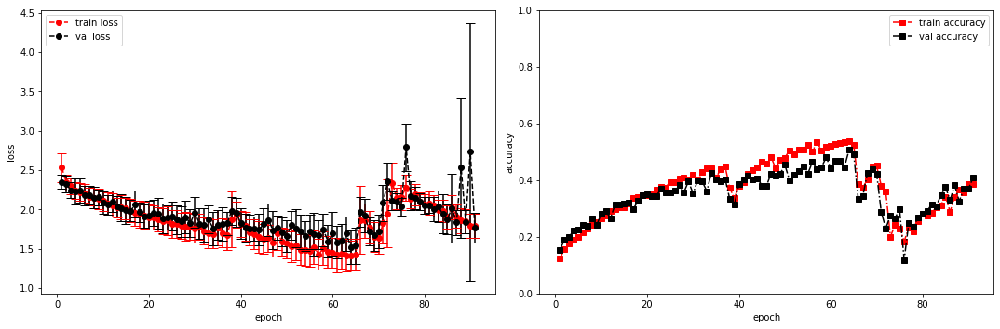

model saved


training epoch:  91
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [92/100], step [1/168],  Loss: 1.7593 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5336000919342041s
Epoch [92/100], step [17/168],  Loss: 1.8217 +/- 0.1220,  accuracy: 0.373046875, time elapsed = 6.2398741245269775s
Epoch [92/100], step [33/168],  Loss: 1.7374 +/- 0.1768,  accuracy: 0.404296875, time elapsed = 6.239975690841675s
Epoch [92/100], step [49/168],  Loss: 1.7943 +/- 0.1647,  accuracy: 0.37890625, time elapsed = 6.240706920623779s
Epoch [92/100], step [65/168],  Loss: 1.7128 +/- 0.1114,  accuracy: 0.4140625, time elapsed = 6.243152141571045s
Epoch [92/100], step [81/168],  Loss: 1.8239 +/- 0.1564,  accuracy: 0.384765625, time elapsed = 6.239661931991577s
Epoch [92/100], step [97/168],  Loss: 1.8419 +/- 0.1505,  accuracy: 0.35546875, time elapsed = 6.239609718322754s
Epoch [92/100], step [113/168],  Loss: 1.7387 +/- 0.1844,  accuracy: 0.3828125, time elapsed = 6.2405030727386475s
Epoch [92/100], step [129/168],  Loss: 1.6560 +/- 0.1285,  accuracy: 0.4453125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.394,  precision = 0.394 recall = 0.394 f1 = 0.394 ::: val: acc = 0.400,  precision = 0.400 recall = 0.400 time elapsed = 70.4895076751709s


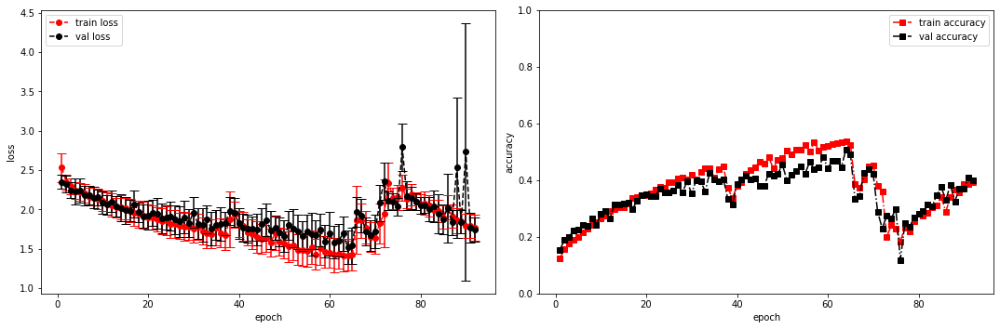

model saved


training epoch:  92
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [93/100], step [1/168],  Loss: 1.8748 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5296156406402588s
Epoch [93/100], step [17/168],  Loss: 1.7434 +/- 0.1163,  accuracy: 0.392578125, time elapsed = 6.24040961265564s
Epoch [93/100], step [33/168],  Loss: 1.6890 +/- 0.1690,  accuracy: 0.423828125, time elapsed = 6.238734722137451s
Epoch [93/100], step [49/168],  Loss: 1.8041 +/- 0.1781,  accuracy: 0.375, time elapsed = 6.250741720199585s
Epoch [93/100], step [65/168],  Loss: 1.7517 +/- 0.1587,  accuracy: 0.412109375, time elapsed = 6.242840051651001s
Epoch [93/100], step [81/168],  Loss: 1.7196 +/- 0.1725,  accuracy: 0.39453125, time elapsed = 6.239911079406738s
Epoch [93/100], step [97/168],  Loss: 1.7778 +/- 0.1720,  accuracy: 0.361328125, time elapsed = 6.241260528564453s
Epoch [93/100], step [113/168],  Loss: 1.7142 +/- 0.1050,  accuracy: 0.44140625, time elapsed = 6.241386413574219s
Epoch [93/100], step [129/168],  Loss: 1.7278 +/- 0.1706,  accuracy: 0.4140625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.404,  precision = 0.404 recall = 0.404 f1 = 0.404 ::: val: acc = 0.400,  precision = 0.400 recall = 0.400 time elapsed = 70.49386715888977s


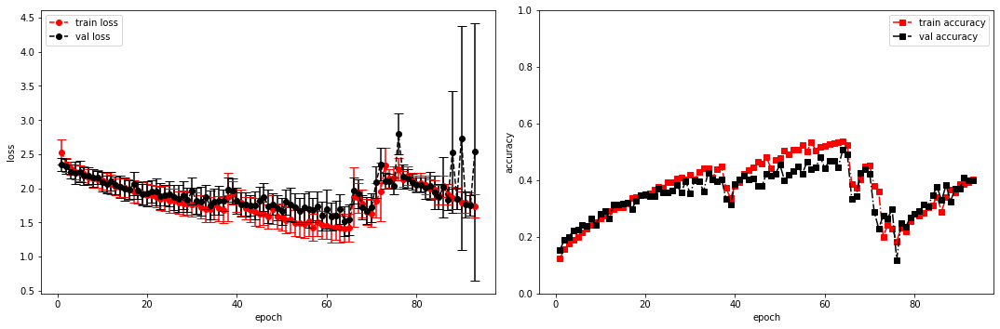

model saved


training epoch:  93
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [94/100], step [1/168],  Loss: 1.8689 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5214028358459473s
Epoch [94/100], step [17/168],  Loss: 1.6700 +/- 0.1984,  accuracy: 0.435546875, time elapsed = 6.243781328201294s
Epoch [94/100], step [33/168],  Loss: 1.7958 +/- 0.2245,  accuracy: 0.373046875, time elapsed = 6.241988897323608s
Epoch [94/100], step [49/168],  Loss: 1.7253 +/- 0.1820,  accuracy: 0.39453125, time elapsed = 6.242451429367065s
Epoch [94/100], step [65/168],  Loss: 1.8240 +/- 0.1522,  accuracy: 0.369140625, time elapsed = 6.241866111755371s
Epoch [94/100], step [81/168],  Loss: 1.8258 +/- 0.1876,  accuracy: 0.375, time elapsed = 6.242935657501221s
Epoch [94/100], step [97/168],  Loss: 1.8035 +/- 0.1124,  accuracy: 0.3671875, time elapsed = 6.242669105529785s
Epoch [94/100], step [113/168],  Loss: 1.8056 +/- 0.1852,  accuracy: 0.396484375, time elapsed = 6.242737054824829s
Epoch [94/100], step [129/168],  Loss: 1.7341 +/- 0.1108,  accuracy: 0.392578125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.389,  precision = 0.389 recall = 0.389 f1 = 0.389 ::: val: acc = 0.384,  precision = 0.384 recall = 0.384 time elapsed = 70.51566171646118s


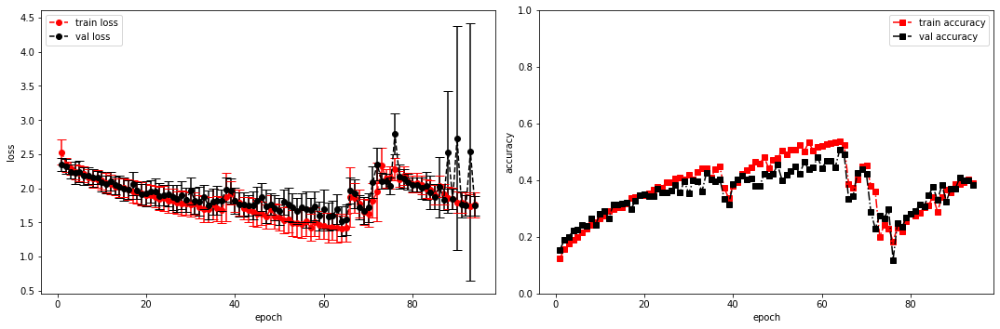

model saved


training epoch:  94
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [95/100], step [1/168],  Loss: 1.4953 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5262176990509033s
Epoch [95/100], step [17/168],  Loss: 1.6959 +/- 0.1452,  accuracy: 0.42578125, time elapsed = 6.241765022277832s
Epoch [95/100], step [33/168],  Loss: 1.7059 +/- 0.1581,  accuracy: 0.396484375, time elapsed = 6.242403030395508s
Epoch [95/100], step [49/168],  Loss: 1.6935 +/- 0.1797,  accuracy: 0.4296875, time elapsed = 6.241230726242065s
Epoch [95/100], step [65/168],  Loss: 1.6652 +/- 0.1627,  accuracy: 0.455078125, time elapsed = 6.242244720458984s
Epoch [95/100], step [81/168],  Loss: 1.6696 +/- 0.1809,  accuracy: 0.427734375, time elapsed = 6.24147367477417s
Epoch [95/100], step [97/168],  Loss: 1.7385 +/- 0.1496,  accuracy: 0.4296875, time elapsed = 6.241347789764404s
Epoch [95/100], step [113/168],  Loss: 1.8209 +/- 0.1615,  accuracy: 0.380859375, time elapsed = 6.242009401321411s
Epoch [95/100], step [129/168],  Loss: 1.7669 +/- 0.1802,  accuracy: 0.37109375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.415,  precision = 0.415 recall = 0.415 f1 = 0.415 ::: val: acc = 0.421,  precision = 0.421 recall = 0.421 time elapsed = 70.48980259895325s


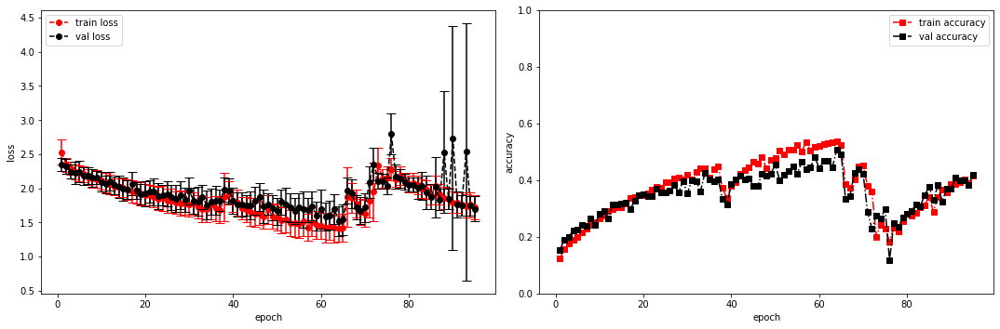

model saved


training epoch:  95
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [96/100], step [1/168],  Loss: 1.7030 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5296375751495361s
Epoch [96/100], step [17/168],  Loss: 1.7233 +/- 0.1499,  accuracy: 0.412109375, time elapsed = 6.241873741149902s
Epoch [96/100], step [33/168],  Loss: 1.7649 +/- 0.1788,  accuracy: 0.3828125, time elapsed = 6.242232322692871s
Epoch [96/100], step [49/168],  Loss: 1.5847 +/- 0.1500,  accuracy: 0.46875, time elapsed = 6.2415220737457275s
Epoch [96/100], step [65/168],  Loss: 1.6862 +/- 0.1731,  accuracy: 0.44140625, time elapsed = 6.241652488708496s
Epoch [96/100], step [81/168],  Loss: 1.8433 +/- 0.2177,  accuracy: 0.39453125, time elapsed = 6.241235017776489s
Epoch [96/100], step [97/168],  Loss: 1.7596 +/- 0.2158,  accuracy: 0.37890625, time elapsed = 6.2421488761901855s
Epoch [96/100], step [113/168],  Loss: 1.7998 +/- 0.1443,  accuracy: 0.3828125, time elapsed = 6.258648633956909s
Epoch [96/100], step [129/168],  Loss: 1.8038 +/- 0.1559,  accuracy: 0.376953125, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.406,  precision = 0.406 recall = 0.406 f1 = 0.406 ::: val: acc = 0.406,  precision = 0.406 recall = 0.406 time elapsed = 70.51946353912354s


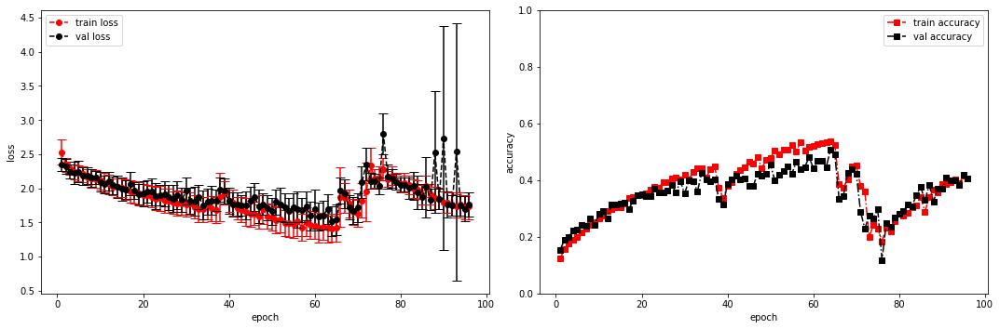

model saved


training epoch:  96
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [97/100], step [1/168],  Loss: 1.7453 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5267696380615234s
Epoch [97/100], step [17/168],  Loss: 1.6909 +/- 0.1461,  accuracy: 0.41015625, time elapsed = 6.24239444732666s
Epoch [97/100], step [33/168],  Loss: 2.0249 +/- 0.2323,  accuracy: 0.337890625, time elapsed = 6.241111755371094s
Epoch [97/100], step [49/168],  Loss: 2.1678 +/- 0.2369,  accuracy: 0.26953125, time elapsed = 6.241377353668213s
Epoch [97/100], step [65/168],  Loss: 2.0458 +/- 0.2195,  accuracy: 0.298828125, time elapsed = 6.241335391998291s
Epoch [97/100], step [81/168],  Loss: 1.9419 +/- 0.2096,  accuracy: 0.3515625, time elapsed = 6.243368148803711s
Epoch [97/100], step [97/168],  Loss: 1.7946 +/- 0.1874,  accuracy: 0.392578125, time elapsed = 6.241024971008301s
Epoch [97/100], step [113/168],  Loss: 1.9724 +/- 0.1721,  accuracy: 0.3125, time elapsed = 6.241352796554565s
Epoch [97/100], step [129/168],  Loss: 1.8090 +/- 0.1297,  accuracy: 0.3984375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.359,  precision = 0.359 recall = 0.359 f1 = 0.359 ::: val: acc = 0.383,  precision = 0.383 recall = 0.383 time elapsed = 70.48129057884216s


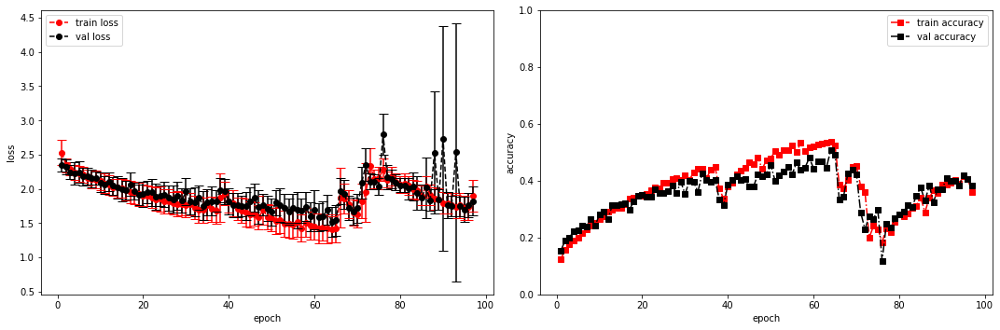

model saved


training epoch:  97
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [98/100], step [1/168],  Loss: 2.0326 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5238690376281738s
Epoch [98/100], step [17/168],  Loss: 1.8113 +/- 0.1645,  accuracy: 0.375, time elapsed = 6.241984128952026s
Epoch [98/100], step [33/168],  Loss: 1.7741 +/- 0.1503,  accuracy: 0.365234375, time elapsed = 6.241714000701904s
Epoch [98/100], step [49/168],  Loss: 1.8455 +/- 0.1526,  accuracy: 0.380859375, time elapsed = 6.243516683578491s
Epoch [98/100], step [65/168],  Loss: 1.6827 +/- 0.1696,  accuracy: 0.431640625, time elapsed = 6.24650502204895s
Epoch [98/100], step [81/168],  Loss: 1.8023 +/- 0.1344,  accuracy: 0.361328125, time elapsed = 6.24103856086731s
Epoch [98/100], step [97/168],  Loss: 1.6773 +/- 0.1286,  accuracy: 0.4375, time elapsed = 6.241829872131348s
Epoch [98/100], step [113/168],  Loss: 1.7110 +/- 0.1949,  accuracy: 0.41015625, time elapsed = 6.241450786590576s
Epoch [98/100], step [129/168],  Loss: 1.7027 +/- 0.1329,  accuracy: 0.423828125, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.402,  precision = 0.402 recall = 0.402 f1 = 0.402 ::: val: acc = 0.435,  precision = 0.435 recall = 0.435 time elapsed = 70.4879686832428s


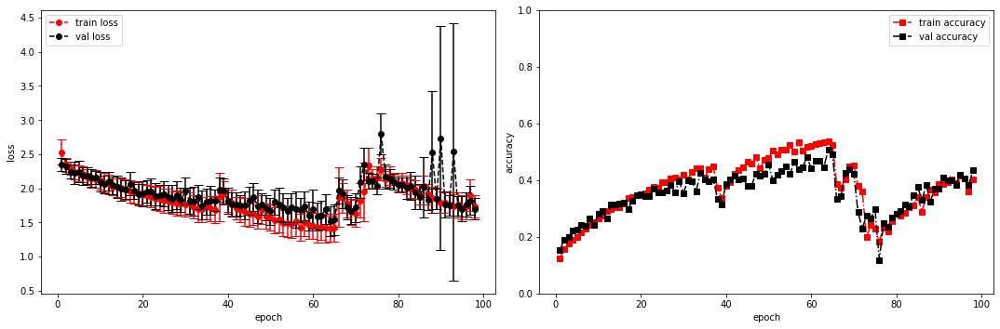

model saved


training epoch:  98
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [99/100], step [1/168],  Loss: 1.5457 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5238490104675293s
Epoch [99/100], step [17/168],  Loss: 1.6562 +/- 0.1753,  accuracy: 0.44140625, time elapsed = 6.242758750915527s
Epoch [99/100], step [33/168],  Loss: 1.6964 +/- 0.1189,  accuracy: 0.439453125, time elapsed = 6.240936994552612s
Epoch [99/100], step [49/168],  Loss: 1.6813 +/- 0.1843,  accuracy: 0.447265625, time elapsed = 6.241523027420044s
Epoch [99/100], step [65/168],  Loss: 1.7276 +/- 0.2070,  accuracy: 0.41796875, time elapsed = 6.240573406219482s
Epoch [99/100], step [81/168],  Loss: 1.6704 +/- 0.2190,  accuracy: 0.404296875, time elapsed = 6.241015911102295s
Epoch [99/100], step [97/168],  Loss: 1.9676 +/- 0.3281,  accuracy: 0.35546875, time elapsed = 6.240097761154175s
Epoch [99/100], step [113/168],  Loss: 2.0511 +/- 0.2183,  accuracy: 0.29296875, time elapsed = 6.24083137512207s
Epoch [99/100], step [129/168],  Loss: 2.0404 +/- 0.1210,  accuracy: 0.306640625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.375,  precision = 0.375 recall = 0.375 f1 = 0.375 ::: val: acc = 0.383,  precision = 0.383 recall = 0.383 time elapsed = 70.48892092704773s


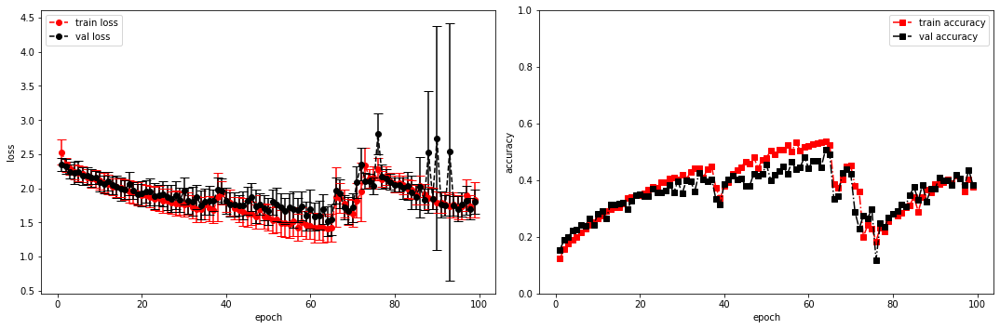

model saved


training epoch:  99
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [100/100], step [1/168],  Loss: 1.7170 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5287051200866699s
Epoch [100/100], step [17/168],  Loss: 1.8145 +/- 0.2009,  accuracy: 0.396484375, time elapsed = 6.24159049987793s
Epoch [100/100], step [33/168],  Loss: 1.8092 +/- 0.1924,  accuracy: 0.400390625, time elapsed = 6.242547035217285s
Epoch [100/100], step [49/168],  Loss: 1.7282 +/- 0.0867,  accuracy: 0.404296875, time elapsed = 6.241423606872559s
Epoch [100/100], step [65/168],  Loss: 1.8288 +/- 0.1517,  accuracy: 0.404296875, time elapsed = 6.241501092910767s
Epoch [100/100], step [81/168],  Loss: 1.7188 +/- 0.1452,  accuracy: 0.40625, time elapsed = 6.2412941455841064s
Epoch [100/100], step [97/168],  Loss: 1.7599 +/- 0.2224,  accuracy: 0.412109375, time elapsed = 6.241259336471558s
Epoch [100/100], step [113/168],  Loss: 1.7035 +/- 0.1877,  accuracy: 0.41796875, time elapsed = 6.240981340408325s
Epoch [100/100], step [129/168],  Loss: 1.6929 +/- 0.1376,  accuracy: 0.40039

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.406,  precision = 0.406 recall = 0.406 f1 = 0.406 ::: val: acc = 0.364,  precision = 0.364 recall = 0.364 time elapsed = 70.48987126350403s


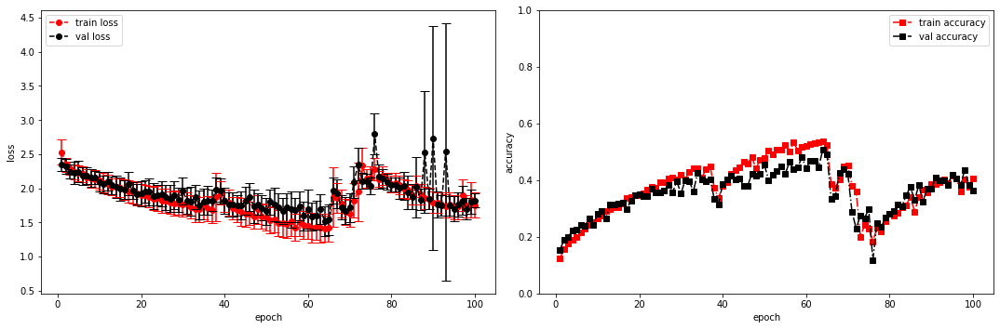

model saved
device:  cuda
dataset metadata:  {'n_fft': 2048, 'hop_length': 512, 'n_mfcc': 40, 'notes': 'optional notes not passed'}
train model: data loaders initialized
sample shape =  (1, 40, 259)
model loaded
Layer (type:depth-idx)                   Output Shape              Param #
├─TripleConv: 1-1                        [-1, 8, 40, 259]          --
|    └─ConvBlock: 2-1                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-1              [-1, 8, 40, 259]          96
|    └─ConvBlock: 2-2                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-2              [-1, 8, 40, 259]          600
|    └─ConvBlock: 2-3                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-3              [-1, 8, 40, 259]          600
├─ConvBlock: 1-2                         [-1, 8, 20, 129]          --
|    └─Sequential: 2-4                   [-1, 8, 20, 129]          --
|    |    └─Conv2d: 3-4                  [-1, 8, 40, 259]          584
|    |    

<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [1/100], step [1/168],  Loss: 3.2507 +/- 0.0000,  accuracy: 0.0, time elapsed = 0.5145111083984375s
Epoch [1/100], step [17/168],  Loss: 2.9252 +/- 0.1685,  accuracy: 0.091796875, time elapsed = 6.229976415634155s
Epoch [1/100], step [33/168],  Loss: 2.9484 +/- 0.1495,  accuracy: 0.080078125, time elapsed = 6.241121292114258s
Epoch [1/100], step [49/168],  Loss: 2.6545 +/- 0.2037,  accuracy: 0.095703125, time elapsed = 6.233907699584961s
Epoch [1/100], step [65/168],  Loss: 2.6128 +/- 0.1354,  accuracy: 0.087890625, time elapsed = 6.236655235290527s
Epoch [1/100], step [81/168],  Loss: 2.5146 +/- 0.0998,  accuracy: 0.125, time elapsed = 6.23604416847229s
Epoch [1/100], step [97/168],  Loss: 2.4504 +/- 0.0616,  accuracy: 0.11328125, time elapsed = 6.236832857131958s
Epoch [1/100], step [113/168],  Loss: 2.4914 +/- 0.0883,  accuracy: 0.103515625, time elapsed = 6.235759735107422s
Epoch [1/100], step [129/168],  Loss: 2.4025 +/- 0.0732,  accuracy: 0.1328125, time elapsed = 6.2363142

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.106,  precision = 0.106 recall = 0.106 f1 = 0.106 ::: val: acc = 0.119,  precision = 0.119 recall = 0.119 time elapsed = 70.39774703979492s


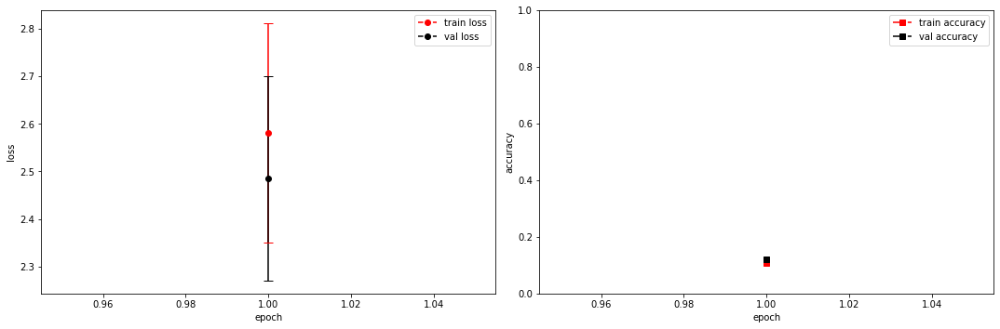

model saved


training epoch:  1
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [2/100], step [1/168],  Loss: 2.3529 +/- 0.0000,  accuracy: 0.0078125, time elapsed = 0.530555009841919s
Epoch [2/100], step [17/168],  Loss: 2.4168 +/- 0.0393,  accuracy: 0.12109375, time elapsed = 6.237870216369629s
Epoch [2/100], step [33/168],  Loss: 2.3763 +/- 0.0521,  accuracy: 0.1328125, time elapsed = 6.239940166473389s
Epoch [2/100], step [49/168],  Loss: 2.4227 +/- 0.0441,  accuracy: 0.1015625, time elapsed = 6.238911390304565s
Epoch [2/100], step [65/168],  Loss: 2.3901 +/- 0.0459,  accuracy: 0.125, time elapsed = 6.239987850189209s
Epoch [2/100], step [81/168],  Loss: 2.4005 +/- 0.0662,  accuracy: 0.115234375, time elapsed = 6.238693475723267s
Epoch [2/100], step [97/168],  Loss: 2.4225 +/- 0.0425,  accuracy: 0.12109375, time elapsed = 6.239361763000488s
Epoch [2/100], step [113/168],  Loss: 2.3944 +/- 0.0524,  accuracy: 0.126953125, time elapsed = 6.238519906997681s
Epoch [2/100], step [129/168],  Loss: 2.4049 +/- 0.0348,  accuracy: 0.125, time elapsed = 6.2396736145

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.123,  precision = 0.123 recall = 0.123 f1 = 0.123 ::: val: acc = 0.127,  precision = 0.127 recall = 0.127 time elapsed = 70.48616075515747s


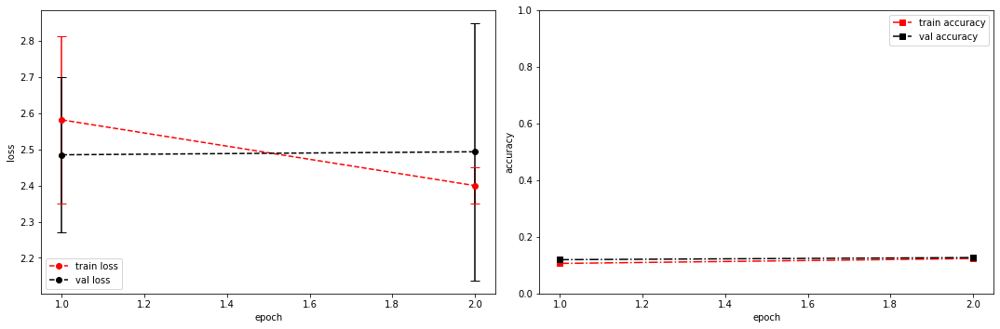

model saved


training epoch:  2
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [3/100], step [1/168],  Loss: 2.4232 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5295877456665039s
Epoch [3/100], step [17/168],  Loss: 2.3859 +/- 0.0323,  accuracy: 0.115234375, time elapsed = 6.23923134803772s
Epoch [3/100], step [33/168],  Loss: 2.3751 +/- 0.0364,  accuracy: 0.119140625, time elapsed = 6.239766359329224s
Epoch [3/100], step [49/168],  Loss: 2.3626 +/- 0.0556,  accuracy: 0.125, time elapsed = 6.2394914627075195s
Epoch [3/100], step [65/168],  Loss: 2.3851 +/- 0.0404,  accuracy: 0.125, time elapsed = 6.239806890487671s
Epoch [3/100], step [81/168],  Loss: 2.3637 +/- 0.0459,  accuracy: 0.103515625, time elapsed = 6.239313125610352s
Epoch [3/100], step [97/168],  Loss: 2.3924 +/- 0.0622,  accuracy: 0.103515625, time elapsed = 6.23843240737915s
Epoch [3/100], step [113/168],  Loss: 2.3701 +/- 0.0430,  accuracy: 0.12890625, time elapsed = 6.237942695617676s
Epoch [3/100], step [129/168],  Loss: 2.3647 +/- 0.0437,  accuracy: 0.146484375, time elapsed = 6.240

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.119,  precision = 0.119 recall = 0.119 f1 = 0.119 ::: val: acc = 0.142,  precision = 0.142 recall = 0.142 time elapsed = 70.47474074363708s


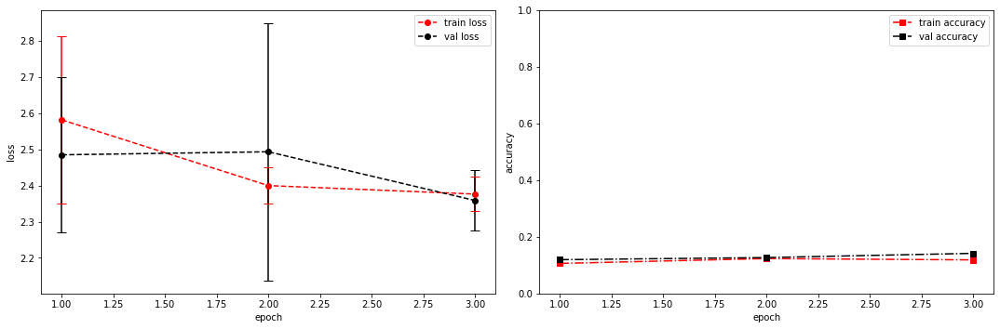

model saved


training epoch:  3
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [4/100], step [1/168],  Loss: 2.3251 +/- 0.0000,  accuracy: 0.00390625, time elapsed = 0.5330414772033691s
Epoch [4/100], step [17/168],  Loss: 2.3799 +/- 0.0460,  accuracy: 0.123046875, time elapsed = 6.239972352981567s
Epoch [4/100], step [33/168],  Loss: 2.3864 +/- 0.0433,  accuracy: 0.099609375, time elapsed = 6.240139484405518s
Epoch [4/100], step [49/168],  Loss: 2.3432 +/- 0.0430,  accuracy: 0.16015625, time elapsed = 6.2391884326934814s
Epoch [4/100], step [65/168],  Loss: 2.3756 +/- 0.0380,  accuracy: 0.107421875, time elapsed = 6.238751649856567s
Epoch [4/100], step [81/168],  Loss: 2.3742 +/- 0.0473,  accuracy: 0.1328125, time elapsed = 6.240512847900391s
Epoch [4/100], step [97/168],  Loss: 2.3835 +/- 0.0483,  accuracy: 0.103515625, time elapsed = 6.244581937789917s
Epoch [4/100], step [113/168],  Loss: 2.3872 +/- 0.0502,  accuracy: 0.095703125, time elapsed = 6.245047330856323s
Epoch [4/100], step [129/168],  Loss: 2.3601 +/- 0.0454,  accuracy: 0.150390625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.125,  precision = 0.125 recall = 0.125 f1 = 0.125 ::: val: acc = 0.143,  precision = 0.143 recall = 0.143 time elapsed = 70.50504326820374s


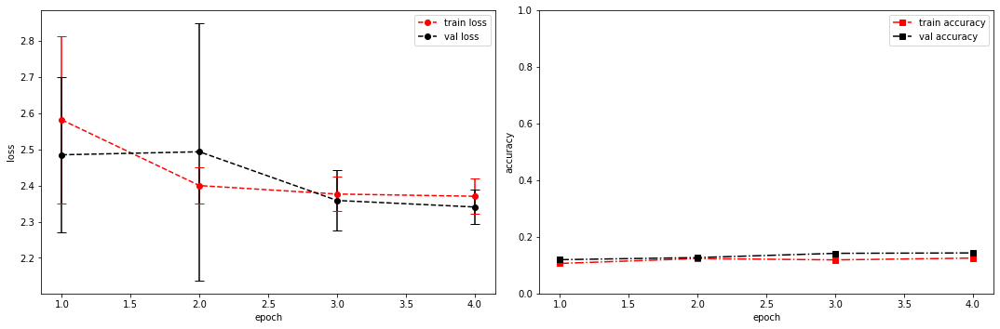

model saved


training epoch:  4
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [5/100], step [1/168],  Loss: 2.3165 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5276284217834473s
Epoch [5/100], step [17/168],  Loss: 2.3468 +/- 0.0478,  accuracy: 0.125, time elapsed = 6.238770008087158s
Epoch [5/100], step [33/168],  Loss: 2.3449 +/- 0.0464,  accuracy: 0.123046875, time elapsed = 6.239067792892456s
Epoch [5/100], step [49/168],  Loss: 2.3558 +/- 0.0455,  accuracy: 0.12109375, time elapsed = 6.238508462905884s
Epoch [5/100], step [65/168],  Loss: 2.3677 +/- 0.0407,  accuracy: 0.138671875, time elapsed = 6.240185499191284s
Epoch [5/100], step [81/168],  Loss: 2.3660 +/- 0.0475,  accuracy: 0.1015625, time elapsed = 6.238456964492798s
Epoch [5/100], step [97/168],  Loss: 2.3693 +/- 0.0457,  accuracy: 0.1015625, time elapsed = 6.237940073013306s
Epoch [5/100], step [113/168],  Loss: 2.3692 +/- 0.0470,  accuracy: 0.125, time elapsed = 6.238520860671997s
Epoch [5/100], step [129/168],  Loss: 2.3475 +/- 0.0552,  accuracy: 0.1328125, time elapsed = 6.237831592

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.125,  precision = 0.125 recall = 0.125 f1 = 0.125 ::: val: acc = 0.135,  precision = 0.135 recall = 0.135 time elapsed = 70.47019791603088s


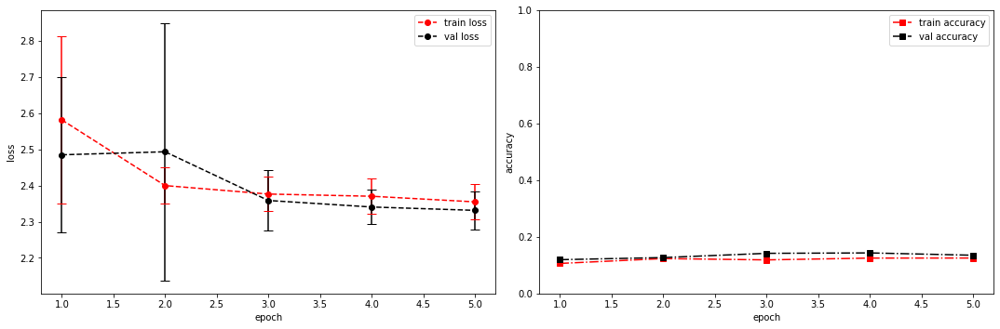

model saved


training epoch:  5
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [6/100], step [1/168],  Loss: 2.3078 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5305581092834473s
Epoch [6/100], step [17/168],  Loss: 2.3473 +/- 0.0741,  accuracy: 0.130859375, time elapsed = 6.239331007003784s
Epoch [6/100], step [33/168],  Loss: 2.3423 +/- 0.0360,  accuracy: 0.138671875, time elapsed = 6.239055871963501s
Epoch [6/100], step [49/168],  Loss: 2.3441 +/- 0.0808,  accuracy: 0.15625, time elapsed = 6.253444671630859s
Epoch [6/100], step [65/168],  Loss: 2.3283 +/- 0.0439,  accuracy: 0.16015625, time elapsed = 6.239645004272461s
Epoch [6/100], step [81/168],  Loss: 2.3320 +/- 0.0851,  accuracy: 0.15625, time elapsed = 6.2386088371276855s
Epoch [6/100], step [97/168],  Loss: 2.3696 +/- 0.0710,  accuracy: 0.1171875, time elapsed = 6.238808631896973s
Epoch [6/100], step [113/168],  Loss: 2.3416 +/- 0.0650,  accuracy: 0.142578125, time elapsed = 6.238539934158325s
Epoch [6/100], step [129/168],  Loss: 2.3433 +/- 0.0645,  accuracy: 0.134765625, time elapsed = 6

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.145,  precision = 0.145 recall = 0.145 f1 = 0.145 ::: val: acc = 0.163,  precision = 0.163 recall = 0.163 time elapsed = 70.48755264282227s


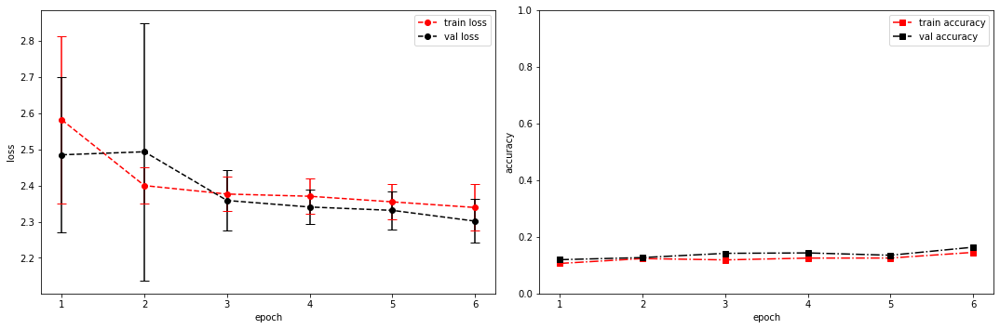

model saved


training epoch:  6
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [7/100], step [1/168],  Loss: 2.4089 +/- 0.0000,  accuracy: 0.00390625, time elapsed = 0.5314643383026123s
Epoch [7/100], step [17/168],  Loss: 2.3092 +/- 0.0692,  accuracy: 0.177734375, time elapsed = 6.241293907165527s
Epoch [7/100], step [33/168],  Loss: 2.3255 +/- 0.0856,  accuracy: 0.1484375, time elapsed = 6.238296747207642s
Epoch [7/100], step [49/168],  Loss: 2.3327 +/- 0.0694,  accuracy: 0.150390625, time elapsed = 6.239099502563477s
Epoch [7/100], step [65/168],  Loss: 2.3374 +/- 0.0624,  accuracy: 0.1484375, time elapsed = 6.238466501235962s
Epoch [7/100], step [81/168],  Loss: 2.2956 +/- 0.0597,  accuracy: 0.166015625, time elapsed = 6.2384114265441895s
Epoch [7/100], step [97/168],  Loss: 2.3181 +/- 0.0752,  accuracy: 0.1484375, time elapsed = 6.239387035369873s
Epoch [7/100], step [113/168],  Loss: 2.3178 +/- 0.0603,  accuracy: 0.130859375, time elapsed = 6.238679647445679s
Epoch [7/100], step [129/168],  Loss: 2.3141 +/- 0.0802,  accuracy: 0.1640625, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.153,  precision = 0.153 recall = 0.153 f1 = 0.153 ::: val: acc = 0.139,  precision = 0.139 recall = 0.139 time elapsed = 70.4965763092041s


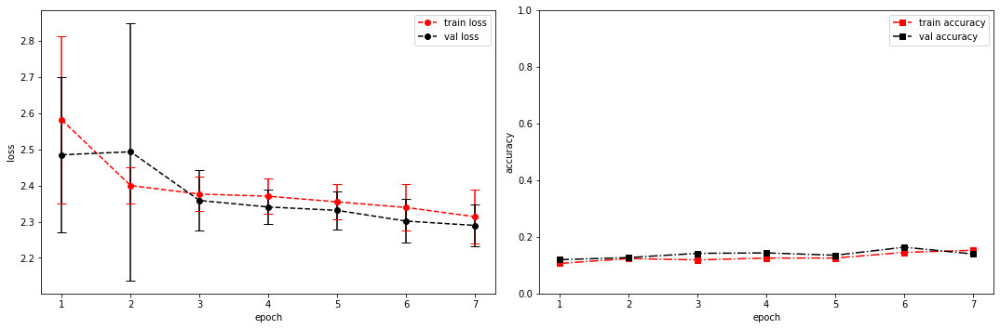

model saved


training epoch:  7
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [8/100], step [1/168],  Loss: 2.3101 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5262236595153809s
Epoch [8/100], step [17/168],  Loss: 2.3120 +/- 0.0825,  accuracy: 0.17578125, time elapsed = 6.23604154586792s
Epoch [8/100], step [33/168],  Loss: 2.2821 +/- 0.0725,  accuracy: 0.203125, time elapsed = 6.238146066665649s
Epoch [8/100], step [49/168],  Loss: 2.2845 +/- 0.0720,  accuracy: 0.130859375, time elapsed = 6.238004446029663s
Epoch [8/100], step [65/168],  Loss: 2.2959 +/- 0.0682,  accuracy: 0.169921875, time elapsed = 6.239853143692017s
Epoch [8/100], step [81/168],  Loss: 2.2418 +/- 0.0594,  accuracy: 0.1953125, time elapsed = 6.238304615020752s
Epoch [8/100], step [97/168],  Loss: 2.2892 +/- 0.0723,  accuracy: 0.16015625, time elapsed = 6.238699197769165s
Epoch [8/100], step [113/168],  Loss: 2.2848 +/- 0.1021,  accuracy: 0.15625, time elapsed = 6.239481210708618s
Epoch [8/100], step [129/168],  Loss: 2.2656 +/- 0.1014,  accuracy: 0.193359375, time elapsed = 6.2

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.172,  precision = 0.172 recall = 0.172 f1 = 0.172 ::: val: acc = 0.179,  precision = 0.179 recall = 0.179 time elapsed = 70.46856093406677s


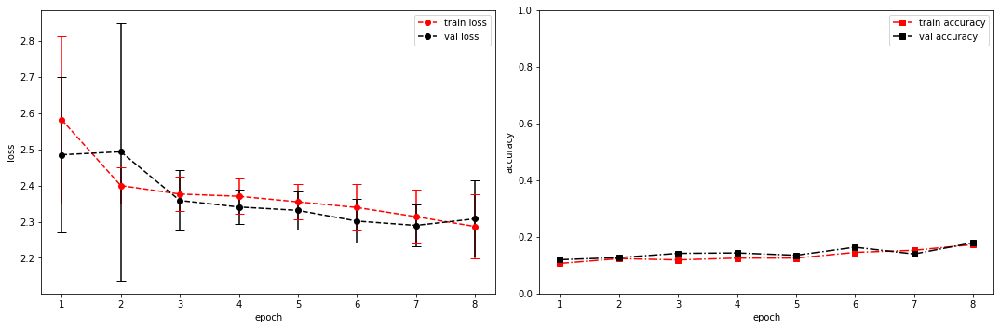

model saved


training epoch:  8
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [9/100], step [1/168],  Loss: 2.1574 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5342819690704346s
Epoch [9/100], step [17/168],  Loss: 2.2546 +/- 0.0701,  accuracy: 0.201171875, time elapsed = 6.237426996231079s
Epoch [9/100], step [33/168],  Loss: 2.3299 +/- 0.1149,  accuracy: 0.185546875, time elapsed = 6.239707708358765s
Epoch [9/100], step [49/168],  Loss: 2.2433 +/- 0.1011,  accuracy: 0.203125, time elapsed = 6.2384889125823975s
Epoch [9/100], step [65/168],  Loss: 2.2640 +/- 0.1309,  accuracy: 0.2109375, time elapsed = 6.23873233795166s
Epoch [9/100], step [81/168],  Loss: 2.2906 +/- 0.0886,  accuracy: 0.150390625, time elapsed = 6.238961219787598s
Epoch [9/100], step [97/168],  Loss: 2.2445 +/- 0.0733,  accuracy: 0.18359375, time elapsed = 6.238461256027222s
Epoch [9/100], step [113/168],  Loss: 2.2437 +/- 0.0988,  accuracy: 0.171875, time elapsed = 6.250412464141846s
Epoch [9/100], step [129/168],  Loss: 2.2191 +/- 0.1247,  accuracy: 0.1953125, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.189,  precision = 0.189 recall = 0.189 f1 = 0.189 ::: val: acc = 0.211,  precision = 0.211 recall = 0.211 time elapsed = 70.49491262435913s


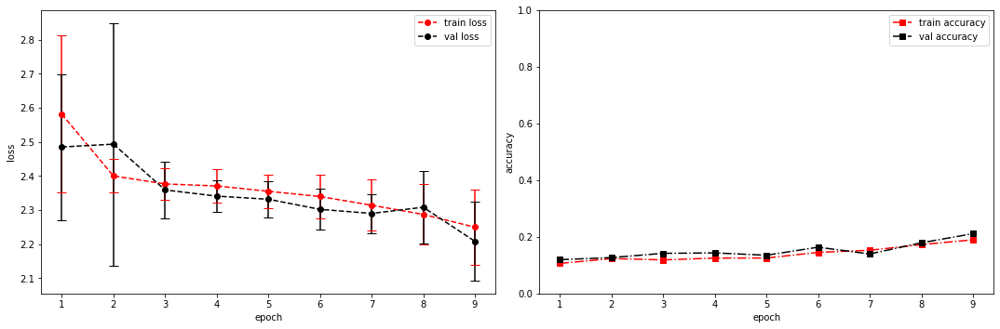

model saved


training epoch:  9
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [10/100], step [1/168],  Loss: 2.4499 +/- 0.0000,  accuracy: 0.0, time elapsed = 0.5321710109710693s
Epoch [10/100], step [17/168],  Loss: 2.2231 +/- 0.1282,  accuracy: 0.185546875, time elapsed = 6.240220069885254s
Epoch [10/100], step [33/168],  Loss: 2.2450 +/- 0.1001,  accuracy: 0.19921875, time elapsed = 6.24067234992981s
Epoch [10/100], step [49/168],  Loss: 2.2237 +/- 0.1087,  accuracy: 0.20703125, time elapsed = 6.239172458648682s
Epoch [10/100], step [65/168],  Loss: 2.2361 +/- 0.0842,  accuracy: 0.1875, time elapsed = 6.239404916763306s
Epoch [10/100], step [81/168],  Loss: 2.1873 +/- 0.1045,  accuracy: 0.2265625, time elapsed = 6.242631912231445s
Epoch [10/100], step [97/168],  Loss: 2.1926 +/- 0.1031,  accuracy: 0.1796875, time elapsed = 6.239158868789673s
Epoch [10/100], step [113/168],  Loss: 2.2421 +/- 0.1147,  accuracy: 0.208984375, time elapsed = 6.239063739776611s
Epoch [10/100], step [129/168],  Loss: 2.1751 +/- 0.1116,  accuracy: 0.24609375, time elapsed = 6.2

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.204,  precision = 0.204 recall = 0.204 f1 = 0.204 ::: val: acc = 0.219,  precision = 0.219 recall = 0.219 time elapsed = 70.49036002159119s


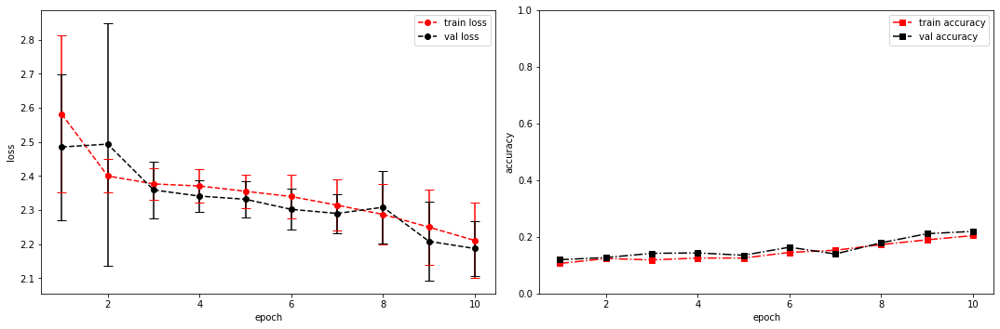

model saved


training epoch:  10
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [11/100], step [1/168],  Loss: 1.8948 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5363678932189941s
Epoch [11/100], step [17/168],  Loss: 2.2407 +/- 0.1282,  accuracy: 0.201171875, time elapsed = 6.23800253868103s
Epoch [11/100], step [33/168],  Loss: 2.2239 +/- 0.0808,  accuracy: 0.1875, time elapsed = 6.239177465438843s
Epoch [11/100], step [49/168],  Loss: 2.1958 +/- 0.1174,  accuracy: 0.23828125, time elapsed = 6.242395401000977s
Epoch [11/100], step [65/168],  Loss: 2.2302 +/- 0.1055,  accuracy: 0.19140625, time elapsed = 6.252500295639038s
Epoch [11/100], step [81/168],  Loss: 2.1717 +/- 0.1071,  accuracy: 0.21484375, time elapsed = 6.239009380340576s
Epoch [11/100], step [97/168],  Loss: 2.1621 +/- 0.1116,  accuracy: 0.228515625, time elapsed = 6.238227844238281s
Epoch [11/100], step [113/168],  Loss: 2.1646 +/- 0.1097,  accuracy: 0.23828125, time elapsed = 6.241466760635376s
Epoch [11/100], step [129/168],  Loss: 2.2081 +/- 0.0836,  accuracy: 0.1953125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.221,  precision = 0.221 recall = 0.221 f1 = 0.221 ::: val: acc = 0.237,  precision = 0.237 recall = 0.237 time elapsed = 70.50371289253235s


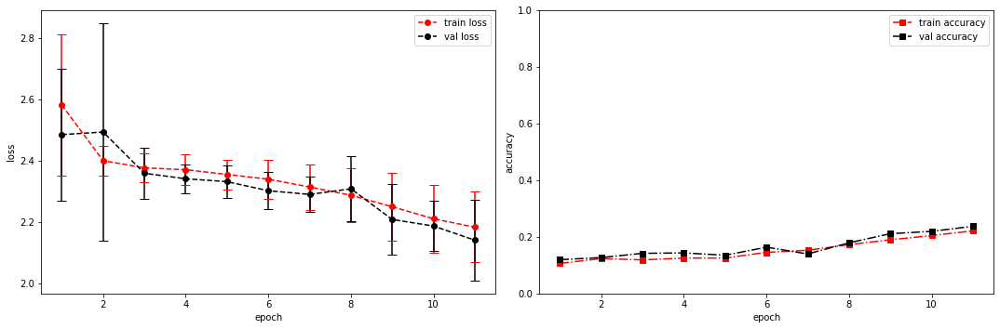

model saved


training epoch:  11
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [12/100], step [1/168],  Loss: 1.9079 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5263328552246094s
Epoch [12/100], step [17/168],  Loss: 2.1268 +/- 0.1096,  accuracy: 0.255859375, time elapsed = 6.239094972610474s
Epoch [12/100], step [33/168],  Loss: 2.1243 +/- 0.1136,  accuracy: 0.259765625, time elapsed = 6.240571737289429s
Epoch [12/100], step [49/168],  Loss: 2.1374 +/- 0.1098,  accuracy: 0.248046875, time elapsed = 6.238789796829224s
Epoch [12/100], step [65/168],  Loss: 2.0957 +/- 0.1343,  accuracy: 0.240234375, time elapsed = 6.238710641860962s
Epoch [12/100], step [81/168],  Loss: 2.1431 +/- 0.1140,  accuracy: 0.228515625, time elapsed = 6.23976731300354s
Epoch [12/100], step [97/168],  Loss: 2.1331 +/- 0.1437,  accuracy: 0.234375, time elapsed = 6.238878488540649s
Epoch [12/100], step [113/168],  Loss: 2.1355 +/- 0.1108,  accuracy: 0.216796875, time elapsed = 6.2385945320129395s
Epoch [12/100], step [129/168],  Loss: 2.1525 +/- 0.1175,  accuracy: 0.2578125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.242,  precision = 0.242 recall = 0.242 f1 = 0.242 ::: val: acc = 0.249,  precision = 0.249 recall = 0.249 time elapsed = 70.49754047393799s


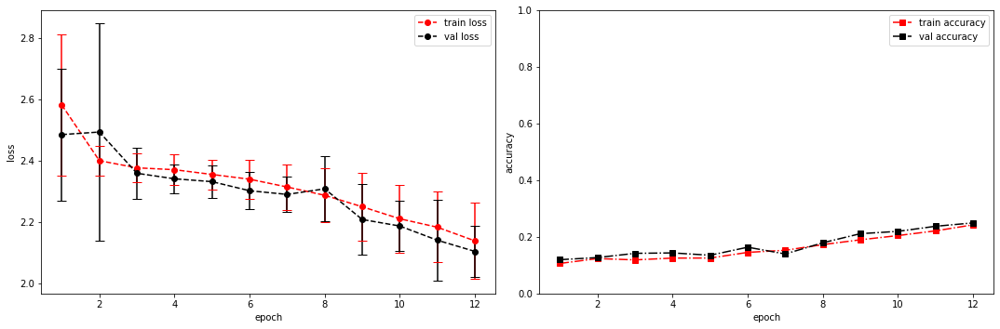

model saved


training epoch:  12
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [13/100], step [1/168],  Loss: 2.1268 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5529353618621826s
Epoch [13/100], step [17/168],  Loss: 2.0962 +/- 0.1180,  accuracy: 0.27734375, time elapsed = 6.240671873092651s
Epoch [13/100], step [33/168],  Loss: 2.1187 +/- 0.1316,  accuracy: 0.232421875, time elapsed = 6.238064289093018s
Epoch [13/100], step [49/168],  Loss: 2.1652 +/- 0.1184,  accuracy: 0.224609375, time elapsed = 6.238513231277466s
Epoch [13/100], step [65/168],  Loss: 2.0783 +/- 0.1270,  accuracy: 0.279296875, time elapsed = 6.23894739151001s
Epoch [13/100], step [81/168],  Loss: 2.0876 +/- 0.1377,  accuracy: 0.26171875, time elapsed = 6.2394819259643555s
Epoch [13/100], step [97/168],  Loss: 2.1058 +/- 0.1182,  accuracy: 0.25, time elapsed = 6.238725185394287s
Epoch [13/100], step [113/168],  Loss: 2.0752 +/- 0.1149,  accuracy: 0.265625, time elapsed = 6.239092111587524s
Epoch [13/100], step [129/168],  Loss: 2.1235 +/- 0.1613,  accuracy: 0.2578125, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.255,  precision = 0.255 recall = 0.255 f1 = 0.255 ::: val: acc = 0.273,  precision = 0.273 recall = 0.273 time elapsed = 70.50493693351746s


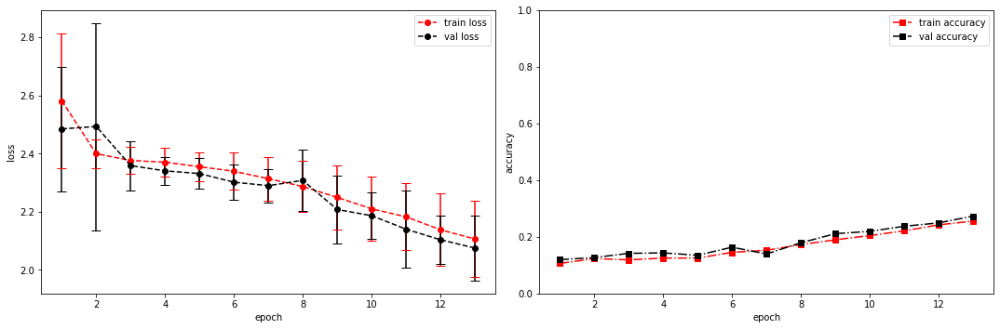

model saved


training epoch:  13
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [14/100], step [1/168],  Loss: 2.2286 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5305793285369873s
Epoch [14/100], step [17/168],  Loss: 2.1073 +/- 0.0658,  accuracy: 0.265625, time elapsed = 6.238633155822754s
Epoch [14/100], step [33/168],  Loss: 2.0587 +/- 0.0928,  accuracy: 0.28125, time elapsed = 6.237489938735962s
Epoch [14/100], step [49/168],  Loss: 2.0993 +/- 0.1209,  accuracy: 0.23046875, time elapsed = 6.2391417026519775s
Epoch [14/100], step [65/168],  Loss: 2.0256 +/- 0.1149,  accuracy: 0.26953125, time elapsed = 6.2384419441223145s
Epoch [14/100], step [81/168],  Loss: 2.1151 +/- 0.0708,  accuracy: 0.248046875, time elapsed = 6.238733291625977s
Epoch [14/100], step [97/168],  Loss: 2.0074 +/- 0.1180,  accuracy: 0.298828125, time elapsed = 6.2390031814575195s
Epoch [14/100], step [113/168],  Loss: 2.1011 +/- 0.1403,  accuracy: 0.271484375, time elapsed = 6.2385413646698s
Epoch [14/100], step [129/168],  Loss: 2.0924 +/- 0.1569,  accuracy: 0.2421875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.261,  precision = 0.261 recall = 0.261 f1 = 0.261 ::: val: acc = 0.274,  precision = 0.274 recall = 0.274 time elapsed = 70.49706292152405s


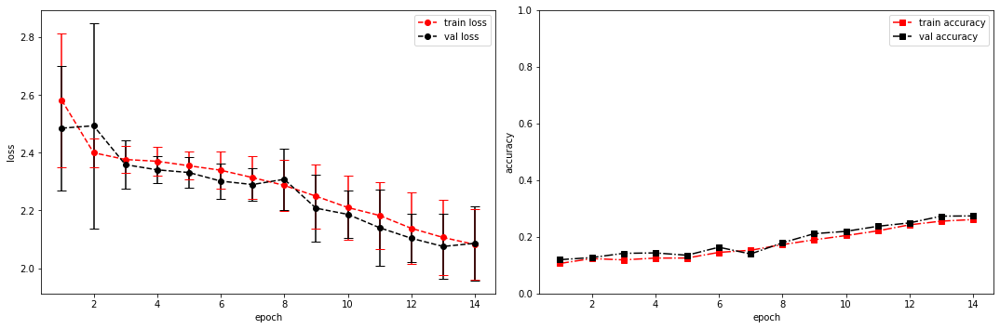

model saved


training epoch:  14
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [15/100], step [1/168],  Loss: 2.2643 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5360369682312012s
Epoch [15/100], step [17/168],  Loss: 2.0804 +/- 0.1045,  accuracy: 0.2734375, time elapsed = 6.2380828857421875s
Epoch [15/100], step [33/168],  Loss: 2.0365 +/- 0.1169,  accuracy: 0.2734375, time elapsed = 6.238235712051392s
Epoch [15/100], step [49/168],  Loss: 2.0258 +/- 0.1152,  accuracy: 0.30859375, time elapsed = 6.237346410751343s
Epoch [15/100], step [65/168],  Loss: 2.0239 +/- 0.1614,  accuracy: 0.296875, time elapsed = 6.237914323806763s
Epoch [15/100], step [81/168],  Loss: 2.0945 +/- 0.0798,  accuracy: 0.240234375, time elapsed = 6.237657785415649s
Epoch [15/100], step [97/168],  Loss: 2.1174 +/- 0.1470,  accuracy: 0.259765625, time elapsed = 6.239171981811523s
Epoch [15/100], step [113/168],  Loss: 2.1360 +/- 0.1172,  accuracy: 0.2578125, time elapsed = 6.237910747528076s
Epoch [15/100], step [129/168],  Loss: 2.0323 +/- 0.1180,  accuracy: 0.267578125, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.280,  precision = 0.280 recall = 0.280 f1 = 0.280 ::: val: acc = 0.283,  precision = 0.283 recall = 0.283 time elapsed = 70.4691572189331s


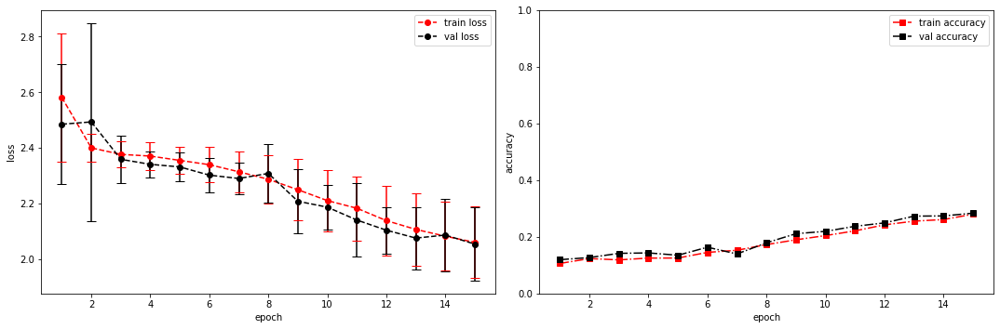

model saved


training epoch:  15
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [16/100], step [1/168],  Loss: 1.9516 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5292561054229736s
Epoch [16/100], step [17/168],  Loss: 2.0076 +/- 0.1238,  accuracy: 0.3125, time elapsed = 6.238281488418579s
Epoch [16/100], step [33/168],  Loss: 2.0285 +/- 0.1931,  accuracy: 0.31640625, time elapsed = 6.237389087677002s
Epoch [16/100], step [49/168],  Loss: 2.0953 +/- 0.1483,  accuracy: 0.26171875, time elapsed = 6.23741602897644s
Epoch [16/100], step [65/168],  Loss: 2.0258 +/- 0.1243,  accuracy: 0.26953125, time elapsed = 6.239112138748169s
Epoch [16/100], step [81/168],  Loss: 2.0181 +/- 0.1082,  accuracy: 0.265625, time elapsed = 6.250265598297119s
Epoch [16/100], step [97/168],  Loss: 2.0739 +/- 0.1466,  accuracy: 0.271484375, time elapsed = 6.238025188446045s
Epoch [16/100], step [113/168],  Loss: 2.0629 +/- 0.1010,  accuracy: 0.296875, time elapsed = 6.238682985305786s
Epoch [16/100], step [129/168],  Loss: 2.1028 +/- 0.1268,  accuracy: 0.255859375, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.282,  precision = 0.282 recall = 0.282 f1 = 0.282 ::: val: acc = 0.268,  precision = 0.268 recall = 0.268 time elapsed = 70.47652792930603s


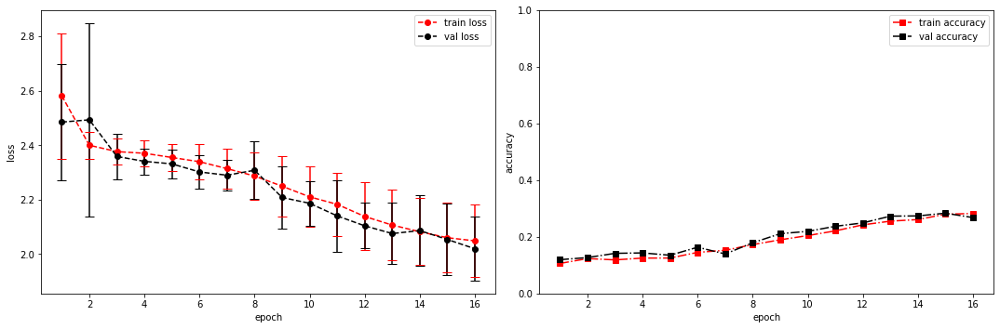

model saved


training epoch:  16
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [17/100], step [1/168],  Loss: 1.7930 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5303051471710205s
Epoch [17/100], step [17/168],  Loss: 2.0414 +/- 0.1080,  accuracy: 0.28515625, time elapsed = 6.23477578163147s
Epoch [17/100], step [33/168],  Loss: 1.9953 +/- 0.1591,  accuracy: 0.3125, time elapsed = 6.237864017486572s
Epoch [17/100], step [49/168],  Loss: 2.0032 +/- 0.1455,  accuracy: 0.3125, time elapsed = 6.235958099365234s
Epoch [17/100], step [65/168],  Loss: 2.0200 +/- 0.1355,  accuracy: 0.306640625, time elapsed = 6.235449552536011s
Epoch [17/100], step [81/168],  Loss: 2.0102 +/- 0.1025,  accuracy: 0.310546875, time elapsed = 6.235213041305542s
Epoch [17/100], step [97/168],  Loss: 1.9760 +/- 0.1707,  accuracy: 0.328125, time elapsed = 6.236104726791382s
Epoch [17/100], step [113/168],  Loss: 2.0351 +/- 0.0915,  accuracy: 0.296875, time elapsed = 6.235799312591553s
Epoch [17/100], step [129/168],  Loss: 1.9940 +/- 0.1376,  accuracy: 0.322265625, time elapsed = 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.303,  precision = 0.303 recall = 0.303 f1 = 0.303 ::: val: acc = 0.295,  precision = 0.295 recall = 0.295 time elapsed = 70.44696235656738s


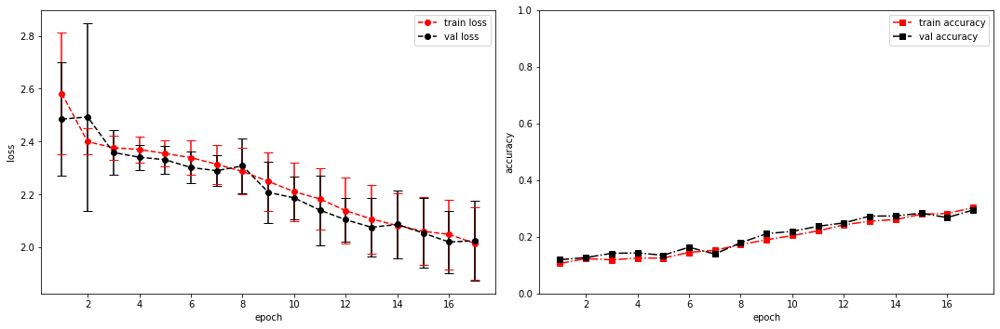

model saved


training epoch:  17
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [18/100], step [1/168],  Loss: 2.0059 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5354015827178955s
Epoch [18/100], step [17/168],  Loss: 2.0411 +/- 0.1591,  accuracy: 0.291015625, time elapsed = 6.247410535812378s
Epoch [18/100], step [33/168],  Loss: 1.9869 +/- 0.1531,  accuracy: 0.30078125, time elapsed = 6.23964786529541s
Epoch [18/100], step [49/168],  Loss: 2.0148 +/- 0.1534,  accuracy: 0.322265625, time elapsed = 6.239348649978638s
Epoch [18/100], step [65/168],  Loss: 2.0065 +/- 0.1223,  accuracy: 0.306640625, time elapsed = 6.239502668380737s
Epoch [18/100], step [81/168],  Loss: 2.0088 +/- 0.1527,  accuracy: 0.314453125, time elapsed = 6.239345550537109s
Epoch [18/100], step [97/168],  Loss: 2.0697 +/- 0.1439,  accuracy: 0.2734375, time elapsed = 6.238295078277588s
Epoch [18/100], step [113/168],  Loss: 2.0272 +/- 0.1249,  accuracy: 0.283203125, time elapsed = 6.238527774810791s
Epoch [18/100], step [129/168],  Loss: 2.0082 +/- 0.1483,  accuracy: 0.32421875, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.299,  precision = 0.299 recall = 0.299 f1 = 0.299 ::: val: acc = 0.307,  precision = 0.307 recall = 0.307 time elapsed = 70.48873972892761s


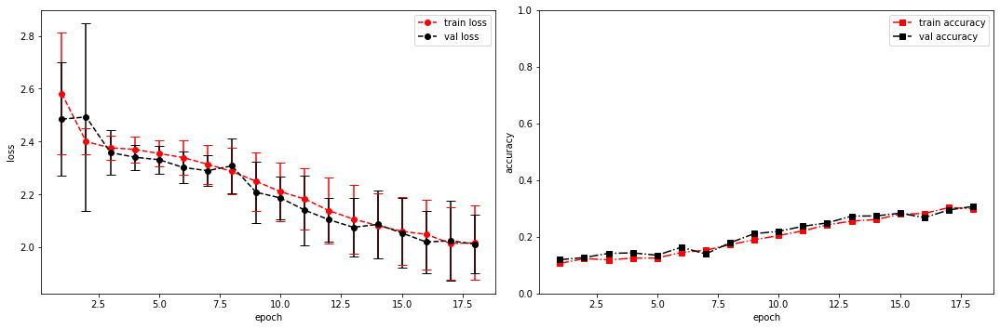

model saved


training epoch:  18
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [19/100], step [1/168],  Loss: 1.8048 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.535799503326416s
Epoch [19/100], step [17/168],  Loss: 2.0143 +/- 0.1189,  accuracy: 0.3359375, time elapsed = 6.238956451416016s
Epoch [19/100], step [33/168],  Loss: 2.0258 +/- 0.0953,  accuracy: 0.28515625, time elapsed = 6.238860130310059s
Epoch [19/100], step [49/168],  Loss: 2.0561 +/- 0.1600,  accuracy: 0.2578125, time elapsed = 6.239017724990845s
Epoch [19/100], step [65/168],  Loss: 1.9336 +/- 0.1198,  accuracy: 0.3515625, time elapsed = 6.238464832305908s
Epoch [19/100], step [81/168],  Loss: 2.0397 +/- 0.1231,  accuracy: 0.302734375, time elapsed = 6.239175081253052s
Epoch [19/100], step [97/168],  Loss: 2.0271 +/- 0.0943,  accuracy: 0.287109375, time elapsed = 6.239136457443237s
Epoch [19/100], step [113/168],  Loss: 1.9738 +/- 0.1419,  accuracy: 0.33984375, time elapsed = 6.237192153930664s
Epoch [19/100], step [129/168],  Loss: 1.9310 +/- 0.1509,  accuracy: 0.328125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.310,  precision = 0.310 recall = 0.310 f1 = 0.310 ::: val: acc = 0.303,  precision = 0.303 recall = 0.303 time elapsed = 70.49732851982117s


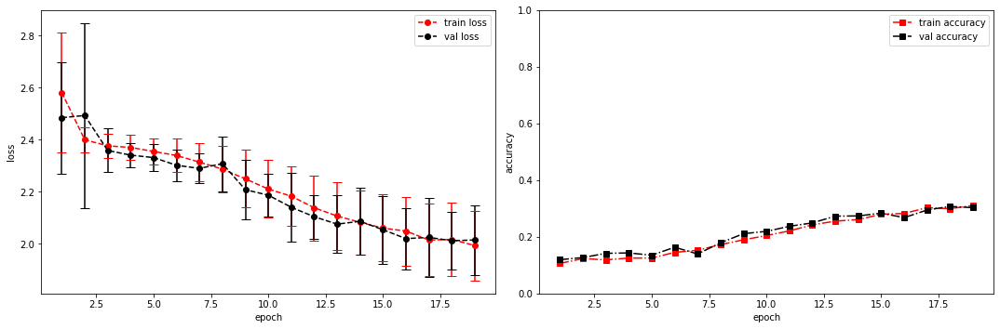

model saved


training epoch:  19
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [20/100], step [1/168],  Loss: 1.8731 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5336449146270752s
Epoch [20/100], step [17/168],  Loss: 1.9438 +/- 0.1373,  accuracy: 0.3203125, time elapsed = 6.238705158233643s
Epoch [20/100], step [33/168],  Loss: 1.9983 +/- 0.1437,  accuracy: 0.28125, time elapsed = 6.237795829772949s
Epoch [20/100], step [49/168],  Loss: 2.0425 +/- 0.2034,  accuracy: 0.3046875, time elapsed = 6.238048791885376s
Epoch [20/100], step [65/168],  Loss: 2.0258 +/- 0.1375,  accuracy: 0.3203125, time elapsed = 6.237314224243164s
Epoch [20/100], step [81/168],  Loss: 2.0064 +/- 0.1746,  accuracy: 0.30859375, time elapsed = 6.238219738006592s
Epoch [20/100], step [97/168],  Loss: 1.9461 +/- 0.1647,  accuracy: 0.328125, time elapsed = 6.237932920455933s
Epoch [20/100], step [113/168],  Loss: 1.9499 +/- 0.1552,  accuracy: 0.30859375, time elapsed = 6.239227294921875s
Epoch [20/100], step [129/168],  Loss: 1.8953 +/- 0.1071,  accuracy: 0.330078125, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.307,  precision = 0.307 recall = 0.307 f1 = 0.307 ::: val: acc = 0.290,  precision = 0.290 recall = 0.290 time elapsed = 70.47309684753418s


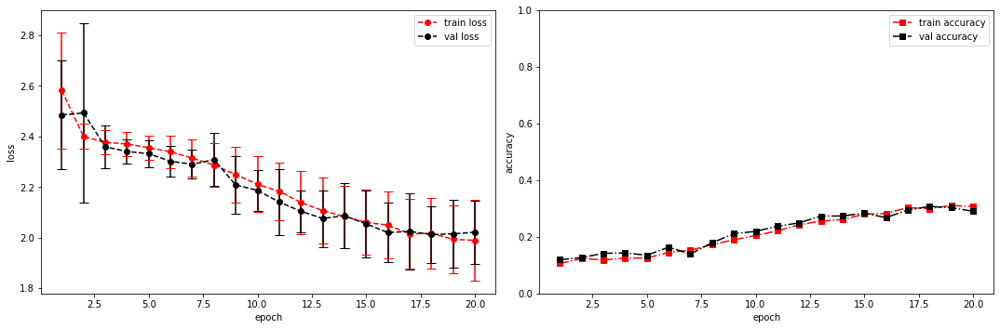

model saved


training epoch:  20
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [21/100], step [1/168],  Loss: 1.8067 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5380563735961914s
Epoch [21/100], step [17/168],  Loss: 1.9740 +/- 0.0816,  accuracy: 0.31640625, time elapsed = 6.2376439571380615s
Epoch [21/100], step [33/168],  Loss: 2.0394 +/- 0.1682,  accuracy: 0.29296875, time elapsed = 6.2359535694122314s
Epoch [21/100], step [49/168],  Loss: 1.9641 +/- 0.1261,  accuracy: 0.314453125, time elapsed = 6.236473321914673s
Epoch [21/100], step [65/168],  Loss: 1.9462 +/- 0.1203,  accuracy: 0.326171875, time elapsed = 6.238397598266602s
Epoch [21/100], step [81/168],  Loss: 1.9530 +/- 0.0944,  accuracy: 0.337890625, time elapsed = 6.241104364395142s
Epoch [21/100], step [97/168],  Loss: 1.9046 +/- 0.1561,  accuracy: 0.361328125, time elapsed = 6.245849609375s
Epoch [21/100], step [113/168],  Loss: 1.9383 +/- 0.1211,  accuracy: 0.32421875, time elapsed = 6.238709211349487s
Epoch [21/100], step [129/168],  Loss: 1.9754 +/- 0.1275,  accuracy: 0.3203125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.327,  precision = 0.327 recall = 0.327 f1 = 0.327 ::: val: acc = 0.322,  precision = 0.322 recall = 0.322 time elapsed = 70.48355388641357s


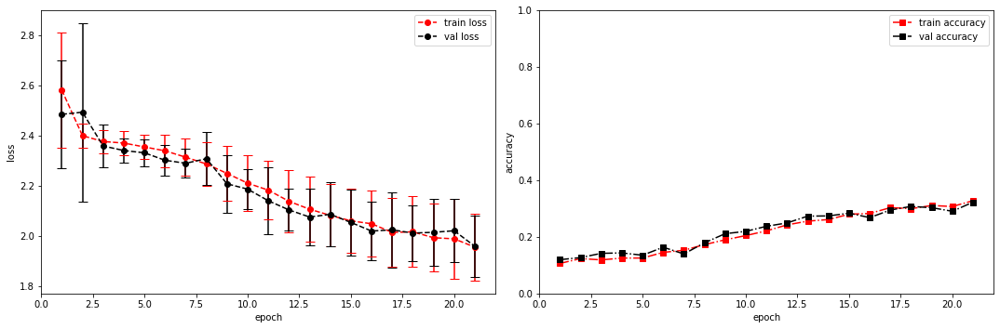

model saved


training epoch:  21
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [22/100], step [1/168],  Loss: 1.8262 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5303831100463867s
Epoch [22/100], step [17/168],  Loss: 1.9510 +/- 0.1144,  accuracy: 0.31640625, time elapsed = 6.23822021484375s
Epoch [22/100], step [33/168],  Loss: 1.9218 +/- 0.0901,  accuracy: 0.337890625, time elapsed = 6.23855185508728s
Epoch [22/100], step [49/168],  Loss: 1.9552 +/- 0.1794,  accuracy: 0.353515625, time elapsed = 6.241781234741211s
Epoch [22/100], step [65/168],  Loss: 1.9376 +/- 0.1004,  accuracy: 0.337890625, time elapsed = 6.2396204471588135s
Epoch [22/100], step [81/168],  Loss: 1.9262 +/- 0.1656,  accuracy: 0.3515625, time elapsed = 6.239300489425659s
Epoch [22/100], step [97/168],  Loss: 1.9785 +/- 0.1813,  accuracy: 0.330078125, time elapsed = 6.239147186279297s
Epoch [22/100], step [113/168],  Loss: 1.9933 +/- 0.1305,  accuracy: 0.30078125, time elapsed = 6.238368511199951s
Epoch [22/100], step [129/168],  Loss: 1.8862 +/- 0.1107,  accuracy: 0.375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.338,  precision = 0.338 recall = 0.338 f1 = 0.338 ::: val: acc = 0.348,  precision = 0.348 recall = 0.348 time elapsed = 70.48296999931335s


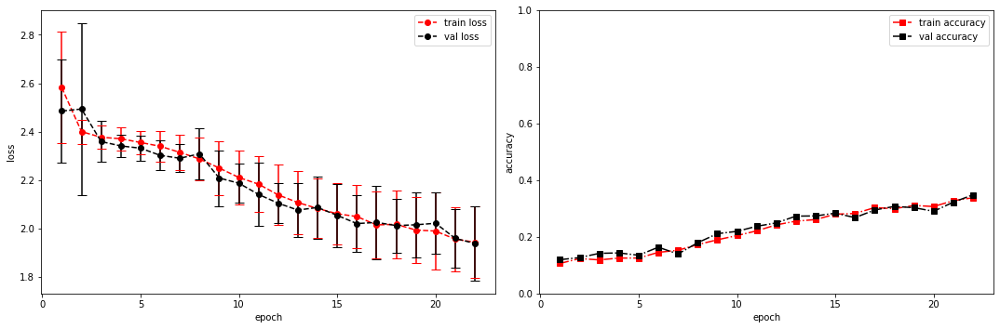

model saved


training epoch:  22
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [23/100], step [1/168],  Loss: 1.6944 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.530968427658081s
Epoch [23/100], step [17/168],  Loss: 1.9431 +/- 0.0811,  accuracy: 0.33984375, time elapsed = 6.236890554428101s
Epoch [23/100], step [33/168],  Loss: 1.9439 +/- 0.1529,  accuracy: 0.3125, time elapsed = 6.2516210079193115s
Epoch [23/100], step [49/168],  Loss: 1.9148 +/- 0.1290,  accuracy: 0.34765625, time elapsed = 6.237976551055908s
Epoch [23/100], step [65/168],  Loss: 1.8552 +/- 0.1485,  accuracy: 0.384765625, time elapsed = 6.23820161819458s
Epoch [23/100], step [81/168],  Loss: 1.8853 +/- 0.1075,  accuracy: 0.361328125, time elapsed = 6.238420486450195s
Epoch [23/100], step [97/168],  Loss: 1.9786 +/- 0.1084,  accuracy: 0.2890625, time elapsed = 6.237729787826538s
Epoch [23/100], step [113/168],  Loss: 1.8637 +/- 0.1514,  accuracy: 0.3671875, time elapsed = 6.237746715545654s
Epoch [23/100], step [129/168],  Loss: 2.0310 +/- 0.1729,  accuracy: 0.298828125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.336,  precision = 0.336 recall = 0.336 f1 = 0.336 ::: val: acc = 0.346,  precision = 0.346 recall = 0.346 time elapsed = 70.48225331306458s


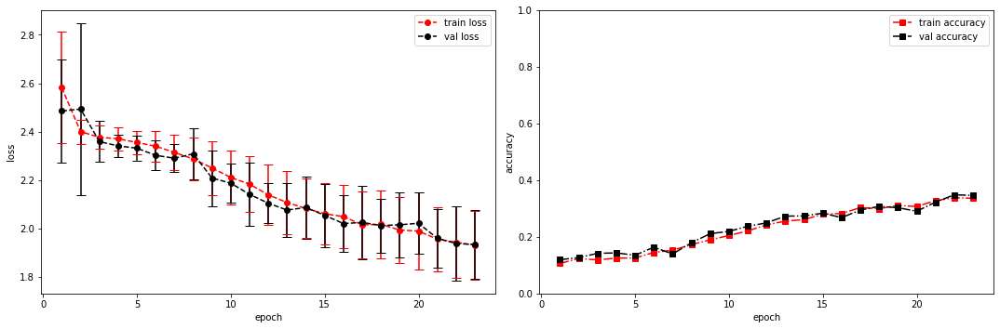

model saved


training epoch:  23
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [24/100], step [1/168],  Loss: 1.6583 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5315959453582764s
Epoch [24/100], step [17/168],  Loss: 1.8907 +/- 0.1316,  accuracy: 0.35546875, time elapsed = 6.238981485366821s
Epoch [24/100], step [33/168],  Loss: 1.8691 +/- 0.1925,  accuracy: 0.365234375, time elapsed = 6.23754620552063s
Epoch [24/100], step [49/168],  Loss: 1.8708 +/- 0.1409,  accuracy: 0.357421875, time elapsed = 6.237299203872681s
Epoch [24/100], step [65/168],  Loss: 2.0140 +/- 0.1835,  accuracy: 0.302734375, time elapsed = 6.23626184463501s
Epoch [24/100], step [81/168],  Loss: 1.9535 +/- 0.1652,  accuracy: 0.3203125, time elapsed = 6.23729681968689s
Epoch [24/100], step [97/168],  Loss: 1.8750 +/- 0.1007,  accuracy: 0.33984375, time elapsed = 6.236686944961548s
Epoch [24/100], step [113/168],  Loss: 1.8719 +/- 0.1345,  accuracy: 0.365234375, time elapsed = 6.239874362945557s
Epoch [24/100], step [129/168],  Loss: 1.9255 +/- 0.1690,  accuracy: 0.3671875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.348,  precision = 0.348 recall = 0.348 f1 = 0.348 ::: val: acc = 0.336,  precision = 0.336 recall = 0.336 time elapsed = 70.48159694671631s


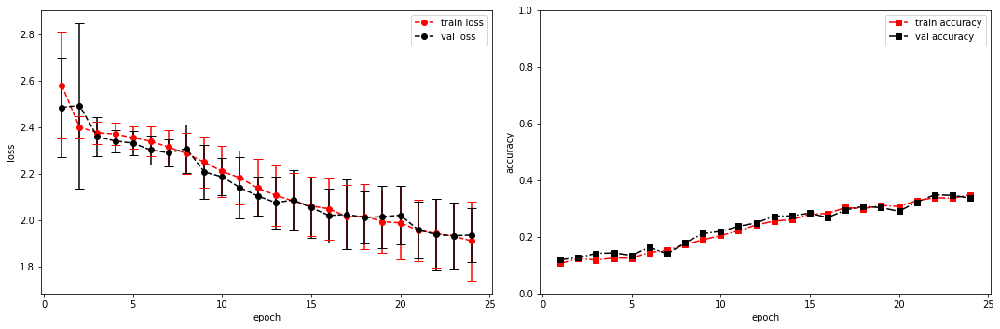

model saved


training epoch:  24
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [25/100], step [1/168],  Loss: 1.9033 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5272917747497559s
Epoch [25/100], step [17/168],  Loss: 1.8208 +/- 0.1630,  accuracy: 0.365234375, time elapsed = 6.237020492553711s
Epoch [25/100], step [33/168],  Loss: 1.8412 +/- 0.1748,  accuracy: 0.3828125, time elapsed = 6.238627195358276s
Epoch [25/100], step [49/168],  Loss: 1.8787 +/- 0.1647,  accuracy: 0.353515625, time elapsed = 6.238290309906006s
Epoch [25/100], step [65/168],  Loss: 1.9254 +/- 0.1757,  accuracy: 0.37109375, time elapsed = 6.237307548522949s
Epoch [25/100], step [81/168],  Loss: 1.9168 +/- 0.1532,  accuracy: 0.353515625, time elapsed = 6.238007307052612s
Epoch [25/100], step [97/168],  Loss: 1.9110 +/- 0.1587,  accuracy: 0.35546875, time elapsed = 6.237703561782837s
Epoch [25/100], step [113/168],  Loss: 1.8722 +/- 0.1165,  accuracy: 0.357421875, time elapsed = 6.237823724746704s
Epoch [25/100], step [129/168],  Loss: 1.8385 +/- 0.1179,  accuracy: 0.365234375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.358,  precision = 0.358 recall = 0.358 f1 = 0.358 ::: val: acc = 0.359,  precision = 0.359 recall = 0.359 time elapsed = 70.46792674064636s


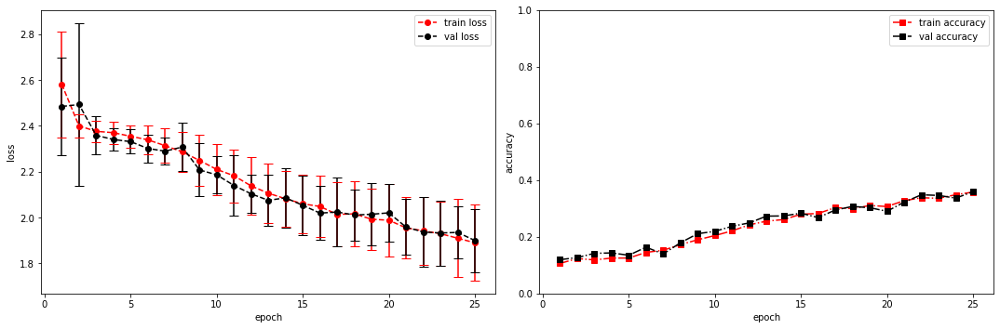

model saved


training epoch:  25
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [26/100], step [1/168],  Loss: 1.6952 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5349130630493164s
Epoch [26/100], step [17/168],  Loss: 1.7831 +/- 0.0785,  accuracy: 0.412109375, time elapsed = 6.237996578216553s
Epoch [26/100], step [33/168],  Loss: 1.8538 +/- 0.0926,  accuracy: 0.34765625, time elapsed = 6.237878322601318s
Epoch [26/100], step [49/168],  Loss: 1.9308 +/- 0.1659,  accuracy: 0.35546875, time elapsed = 6.239106893539429s
Epoch [26/100], step [65/168],  Loss: 1.9108 +/- 0.1747,  accuracy: 0.341796875, time elapsed = 6.239516496658325s
Epoch [26/100], step [81/168],  Loss: 1.8824 +/- 0.2039,  accuracy: 0.375, time elapsed = 6.239333391189575s
Epoch [26/100], step [97/168],  Loss: 1.9214 +/- 0.1663,  accuracy: 0.337890625, time elapsed = 6.245896339416504s
Epoch [26/100], step [113/168],  Loss: 1.9253 +/- 0.1574,  accuracy: 0.3515625, time elapsed = 6.239771366119385s
Epoch [26/100], step [129/168],  Loss: 1.8042 +/- 0.1418,  accuracy: 0.4140625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.368,  precision = 0.368 recall = 0.368 f1 = 0.368 ::: val: acc = 0.368,  precision = 0.368 recall = 0.368 time elapsed = 70.50355434417725s


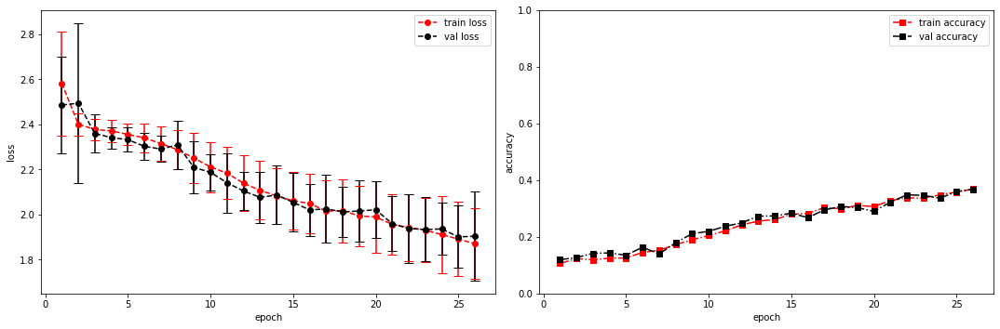

model saved


training epoch:  26
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [27/100], step [1/168],  Loss: 1.9998 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5404810905456543s
Epoch [27/100], step [17/168],  Loss: 1.8067 +/- 0.1531,  accuracy: 0.41796875, time elapsed = 6.237197637557983s
Epoch [27/100], step [33/168],  Loss: 1.8780 +/- 0.1802,  accuracy: 0.3671875, time elapsed = 6.238488435745239s
Epoch [27/100], step [49/168],  Loss: 1.9423 +/- 0.1392,  accuracy: 0.3359375, time elapsed = 6.237444639205933s
Epoch [27/100], step [65/168],  Loss: 1.8669 +/- 0.1756,  accuracy: 0.376953125, time elapsed = 6.239611864089966s
Epoch [27/100], step [81/168],  Loss: 1.8383 +/- 0.1438,  accuracy: 0.388671875, time elapsed = 6.237300872802734s
Epoch [27/100], step [97/168],  Loss: 1.8104 +/- 0.1885,  accuracy: 0.408203125, time elapsed = 6.238175392150879s
Epoch [27/100], step [113/168],  Loss: 1.8599 +/- 0.1647,  accuracy: 0.380859375, time elapsed = 6.239535093307495s
Epoch [27/100], step [129/168],  Loss: 1.8007 +/- 0.1446,  accuracy: 0.419921875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.379,  precision = 0.379 recall = 0.379 f1 = 0.379 ::: val: acc = 0.346,  precision = 0.346 recall = 0.346 time elapsed = 70.48859477043152s


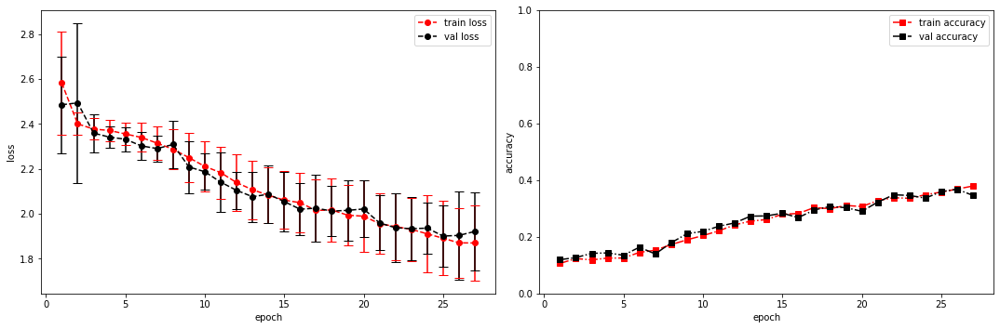

model saved


training epoch:  27
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [28/100], step [1/168],  Loss: 2.0188 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5303475856781006s
Epoch [28/100], step [17/168],  Loss: 1.8437 +/- 0.1317,  accuracy: 0.375, time elapsed = 6.239062309265137s
Epoch [28/100], step [33/168],  Loss: 1.8189 +/- 0.1364,  accuracy: 0.396484375, time elapsed = 6.24048376083374s
Epoch [28/100], step [49/168],  Loss: 1.8062 +/- 0.1428,  accuracy: 0.376953125, time elapsed = 6.248981237411499s
Epoch [28/100], step [65/168],  Loss: 1.9146 +/- 0.1596,  accuracy: 0.361328125, time elapsed = 6.240417957305908s
Epoch [28/100], step [81/168],  Loss: 1.8640 +/- 0.1472,  accuracy: 0.359375, time elapsed = 6.238065242767334s
Epoch [28/100], step [97/168],  Loss: 1.8149 +/- 0.1156,  accuracy: 0.416015625, time elapsed = 6.237971067428589s
Epoch [28/100], step [113/168],  Loss: 1.8521 +/- 0.1744,  accuracy: 0.3828125, time elapsed = 6.239109039306641s
Epoch [28/100], step [129/168],  Loss: 1.8259 +/- 0.1932,  accuracy: 0.392578125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.377,  precision = 0.377 recall = 0.377 f1 = 0.377 ::: val: acc = 0.375,  precision = 0.375 recall = 0.375 time elapsed = 70.49258947372437s


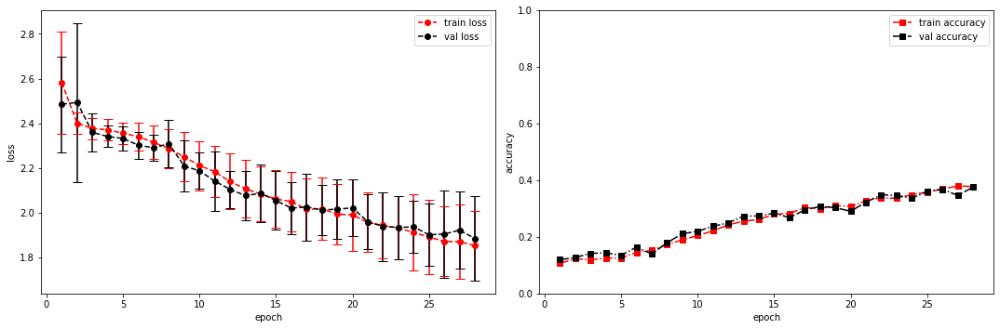

model saved


training epoch:  28
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [29/100], step [1/168],  Loss: 2.0817 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5479471683502197s
Epoch [29/100], step [17/168],  Loss: 1.8215 +/- 0.1622,  accuracy: 0.38671875, time elapsed = 6.237964868545532s
Epoch [29/100], step [33/168],  Loss: 1.8823 +/- 0.1631,  accuracy: 0.380859375, time elapsed = 6.238327741622925s
Epoch [29/100], step [49/168],  Loss: 1.7479 +/- 0.1311,  accuracy: 0.412109375, time elapsed = 6.23915433883667s
Epoch [29/100], step [65/168],  Loss: 1.8306 +/- 0.1488,  accuracy: 0.3984375, time elapsed = 6.238629102706909s
Epoch [29/100], step [81/168],  Loss: 1.8556 +/- 0.1418,  accuracy: 0.36328125, time elapsed = 6.238303899765015s
Epoch [29/100], step [97/168],  Loss: 1.8421 +/- 0.1413,  accuracy: 0.38671875, time elapsed = 6.2381980419158936s
Epoch [29/100], step [113/168],  Loss: 1.7968 +/- 0.1616,  accuracy: 0.39453125, time elapsed = 6.238686561584473s
Epoch [29/100], step [129/168],  Loss: 1.8609 +/- 0.1409,  accuracy: 0.345703125, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.384,  precision = 0.384 recall = 0.384 f1 = 0.384 ::: val: acc = 0.362,  precision = 0.362 recall = 0.362 time elapsed = 70.5323257446289s


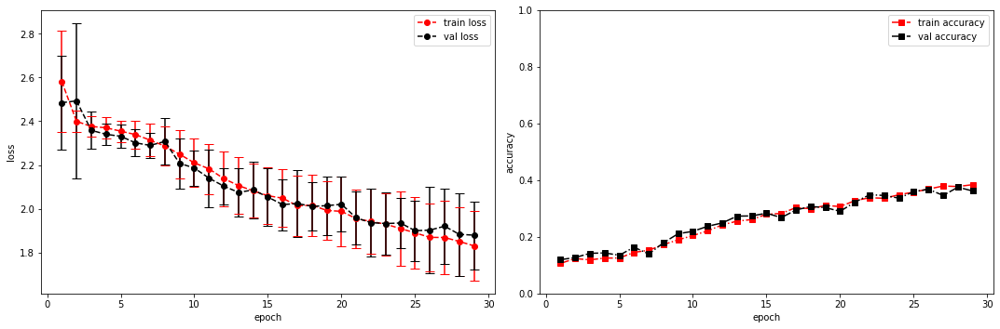

model saved


training epoch:  29
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [30/100], step [1/168],  Loss: 2.0655 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.535212516784668s
Epoch [30/100], step [17/168],  Loss: 1.8663 +/- 0.1765,  accuracy: 0.380859375, time elapsed = 6.237666130065918s
Epoch [30/100], step [33/168],  Loss: 1.6547 +/- 0.1573,  accuracy: 0.44140625, time elapsed = 6.237882375717163s
Epoch [30/100], step [49/168],  Loss: 1.7760 +/- 0.1533,  accuracy: 0.388671875, time elapsed = 6.238371849060059s
Epoch [30/100], step [65/168],  Loss: 1.7906 +/- 0.1854,  accuracy: 0.404296875, time elapsed = 6.238215208053589s
Epoch [30/100], step [81/168],  Loss: 1.8694 +/- 0.1356,  accuracy: 0.345703125, time elapsed = 6.240527629852295s
Epoch [30/100], step [97/168],  Loss: 1.7816 +/- 0.2447,  accuracy: 0.404296875, time elapsed = 6.238612174987793s
Epoch [30/100], step [113/168],  Loss: 1.7873 +/- 0.1236,  accuracy: 0.404296875, time elapsed = 6.239164590835571s
Epoch [30/100], step [129/168],  Loss: 1.7859 +/- 0.1808,  accuracy: 0.427734375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.395,  precision = 0.395 recall = 0.395 f1 = 0.395 ::: val: acc = 0.367,  precision = 0.367 recall = 0.367 time elapsed = 70.4939649105072s


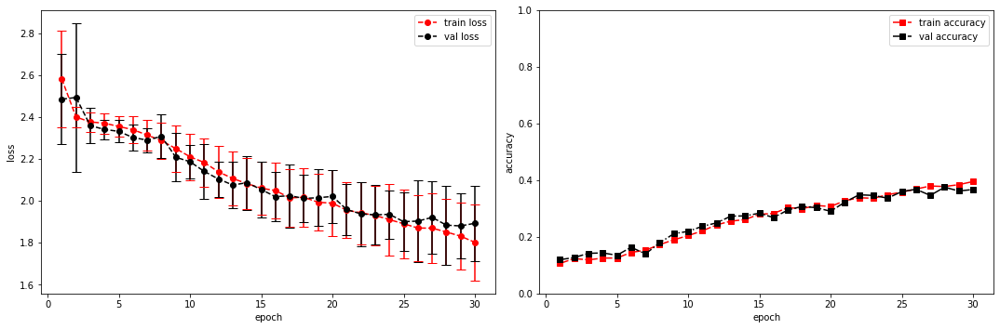

model saved


training epoch:  30
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [31/100], step [1/168],  Loss: 1.7130 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.531879186630249s
Epoch [31/100], step [17/168],  Loss: 1.8163 +/- 0.1631,  accuracy: 0.37890625, time elapsed = 6.238749265670776s
Epoch [31/100], step [33/168],  Loss: 1.8137 +/- 0.1620,  accuracy: 0.3984375, time elapsed = 6.238622665405273s
Epoch [31/100], step [49/168],  Loss: 1.8065 +/- 0.2277,  accuracy: 0.396484375, time elapsed = 6.238454818725586s
Epoch [31/100], step [65/168],  Loss: 1.8575 +/- 0.1556,  accuracy: 0.3671875, time elapsed = 6.238595008850098s
Epoch [31/100], step [81/168],  Loss: 1.7578 +/- 0.1710,  accuracy: 0.408203125, time elapsed = 6.238333702087402s
Epoch [31/100], step [97/168],  Loss: 1.7956 +/- 0.2161,  accuracy: 0.400390625, time elapsed = 6.239341735839844s
Epoch [31/100], step [113/168],  Loss: 1.7724 +/- 0.1800,  accuracy: 0.412109375, time elapsed = 6.251554250717163s
Epoch [31/100], step [129/168],  Loss: 1.8211 +/- 0.1648,  accuracy: 0.400390625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.397,  precision = 0.397 recall = 0.397 f1 = 0.397 ::: val: acc = 0.349,  precision = 0.349 recall = 0.349 time elapsed = 70.4967942237854s


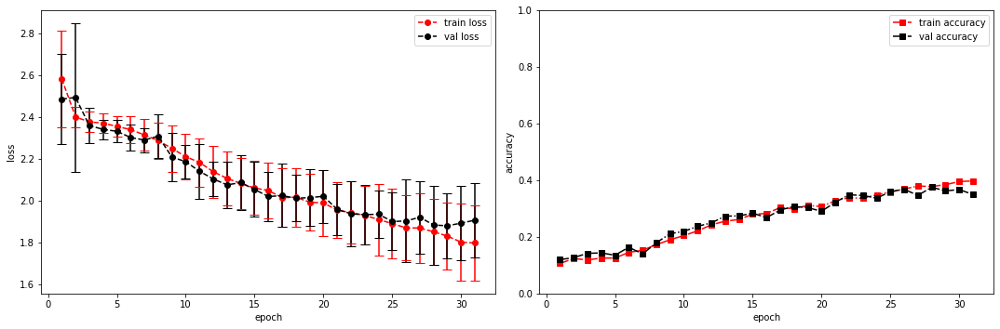

model saved


training epoch:  31
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [32/100], step [1/168],  Loss: 2.0313 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5376091003417969s
Epoch [32/100], step [17/168],  Loss: 1.7631 +/- 0.1222,  accuracy: 0.416015625, time elapsed = 6.2394304275512695s
Epoch [32/100], step [33/168],  Loss: 1.7848 +/- 0.1312,  accuracy: 0.384765625, time elapsed = 6.240206241607666s
Epoch [32/100], step [49/168],  Loss: 1.7312 +/- 0.1632,  accuracy: 0.431640625, time elapsed = 6.241105318069458s
Epoch [32/100], step [65/168],  Loss: 1.7700 +/- 0.1961,  accuracy: 0.412109375, time elapsed = 6.239415168762207s
Epoch [32/100], step [81/168],  Loss: 1.7930 +/- 0.1622,  accuracy: 0.419921875, time elapsed = 6.240345239639282s
Epoch [32/100], step [97/168],  Loss: 1.8629 +/- 0.1785,  accuracy: 0.359375, time elapsed = 6.2388083934783936s
Epoch [32/100], step [113/168],  Loss: 1.8599 +/- 0.1659,  accuracy: 0.359375, time elapsed = 6.237702369689941s
Epoch [32/100], step [129/168],  Loss: 1.8000 +/- 0.1633,  accuracy: 0.390625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.401,  precision = 0.401 recall = 0.401 f1 = 0.401 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.49379515647888s


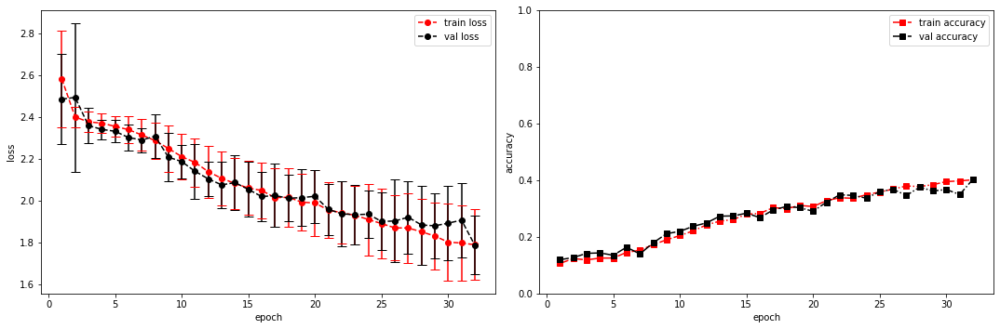

model saved


training epoch:  32
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [33/100], step [1/168],  Loss: 1.5257 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5324440002441406s
Epoch [33/100], step [17/168],  Loss: 1.7101 +/- 0.1482,  accuracy: 0.41796875, time elapsed = 6.238918304443359s
Epoch [33/100], step [33/168],  Loss: 1.8077 +/- 0.1506,  accuracy: 0.404296875, time elapsed = 6.237881898880005s
Epoch [33/100], step [49/168],  Loss: 1.7675 +/- 0.1939,  accuracy: 0.41796875, time elapsed = 6.251902341842651s
Epoch [33/100], step [65/168],  Loss: 1.7317 +/- 0.1692,  accuracy: 0.40234375, time elapsed = 6.238359451293945s
Epoch [33/100], step [81/168],  Loss: 1.7408 +/- 0.1526,  accuracy: 0.423828125, time elapsed = 6.238588809967041s
Epoch [33/100], step [97/168],  Loss: 1.7603 +/- 0.1668,  accuracy: 0.416015625, time elapsed = 6.238630533218384s
Epoch [33/100], step [113/168],  Loss: 1.7226 +/- 0.1041,  accuracy: 0.421875, time elapsed = 6.238441228866577s
Epoch [33/100], step [129/168],  Loss: 1.8064 +/- 0.1892,  accuracy: 0.40625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.415,  precision = 0.415 recall = 0.415 f1 = 0.415 ::: val: acc = 0.395,  precision = 0.395 recall = 0.395 time elapsed = 70.51086950302124s


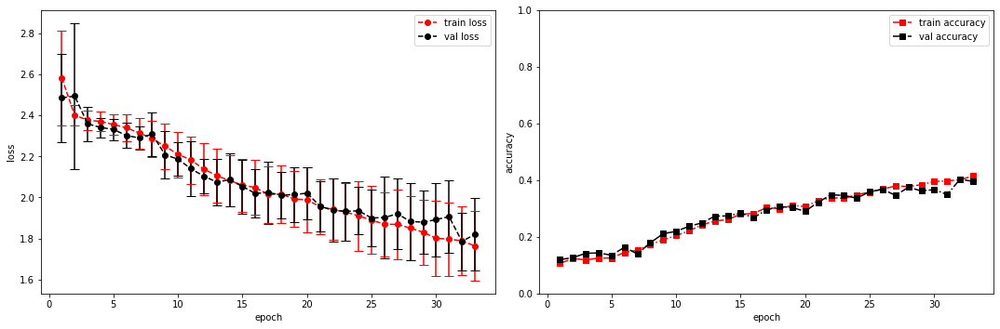

model saved


training epoch:  33
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [34/100], step [1/168],  Loss: 2.1126 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5302433967590332s
Epoch [34/100], step [17/168],  Loss: 1.7149 +/- 0.1296,  accuracy: 0.412109375, time elapsed = 6.240763425827026s
Epoch [34/100], step [33/168],  Loss: 1.7037 +/- 0.1624,  accuracy: 0.439453125, time elapsed = 6.238013982772827s
Epoch [34/100], step [49/168],  Loss: 1.6525 +/- 0.1871,  accuracy: 0.451171875, time elapsed = 6.23889946937561s
Epoch [34/100], step [65/168],  Loss: 1.6831 +/- 0.2154,  accuracy: 0.462890625, time elapsed = 6.237406969070435s
Epoch [34/100], step [81/168],  Loss: 1.7137 +/- 0.1167,  accuracy: 0.431640625, time elapsed = 6.236321210861206s
Epoch [34/100], step [97/168],  Loss: 1.7475 +/- 0.1972,  accuracy: 0.41015625, time elapsed = 6.237410068511963s
Epoch [34/100], step [113/168],  Loss: 1.7844 +/- 0.1519,  accuracy: 0.416015625, time elapsed = 6.236949682235718s
Epoch [34/100], step [129/168],  Loss: 1.8558 +/- 0.1652,  accuracy: 0.390625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.424,  precision = 0.424 recall = 0.424 f1 = 0.424 ::: val: acc = 0.380,  precision = 0.380 recall = 0.380 time elapsed = 70.4887752532959s


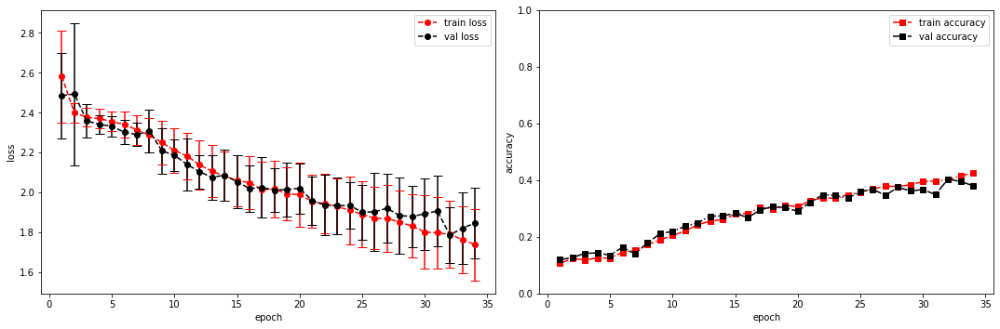

model saved


training epoch:  34
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [35/100], step [1/168],  Loss: 1.4823 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5388009548187256s
Epoch [35/100], step [17/168],  Loss: 1.6564 +/- 0.1358,  accuracy: 0.453125, time elapsed = 6.235581159591675s
Epoch [35/100], step [33/168],  Loss: 1.6865 +/- 0.1936,  accuracy: 0.4453125, time elapsed = 6.237755060195923s
Epoch [35/100], step [49/168],  Loss: 1.7421 +/- 0.1704,  accuracy: 0.423828125, time elapsed = 6.236290216445923s
Epoch [35/100], step [65/168],  Loss: 1.7319 +/- 0.1583,  accuracy: 0.421875, time elapsed = 6.236881256103516s
Epoch [35/100], step [81/168],  Loss: 1.7837 +/- 0.1302,  accuracy: 0.388671875, time elapsed = 6.235905408859253s
Epoch [35/100], step [97/168],  Loss: 1.7136 +/- 0.1088,  accuracy: 0.443359375, time elapsed = 6.236754655838013s
Epoch [35/100], step [113/168],  Loss: 1.8082 +/- 0.2331,  accuracy: 0.408203125, time elapsed = 6.237149000167847s
Epoch [35/100], step [129/168],  Loss: 1.7217 +/- 0.2099,  accuracy: 0.40625, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.426,  precision = 0.426 recall = 0.426 f1 = 0.426 ::: val: acc = 0.409,  precision = 0.409 recall = 0.409 time elapsed = 70.46579933166504s


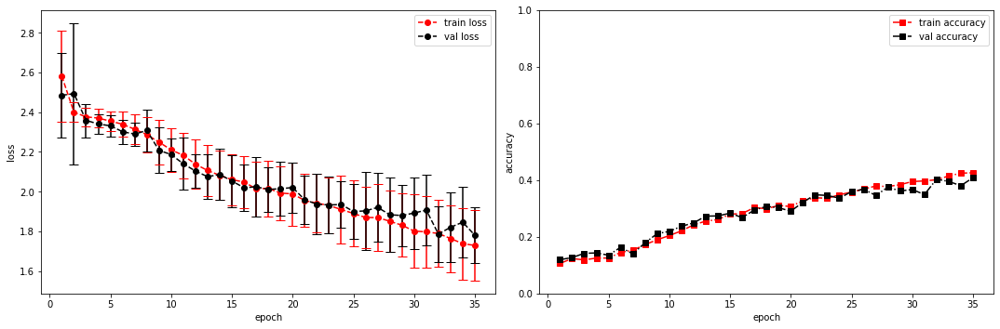

model saved


training epoch:  35
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [36/100], step [1/168],  Loss: 1.6201 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5305056571960449s
Epoch [36/100], step [17/168],  Loss: 1.6148 +/- 0.1545,  accuracy: 0.48046875, time elapsed = 6.236648321151733s
Epoch [36/100], step [33/168],  Loss: 1.6156 +/- 0.1803,  accuracy: 0.474609375, time elapsed = 6.237435817718506s
Epoch [36/100], step [49/168],  Loss: 1.7102 +/- 0.2284,  accuracy: 0.41015625, time elapsed = 6.236851215362549s
Epoch [36/100], step [65/168],  Loss: 1.7664 +/- 0.2212,  accuracy: 0.41796875, time elapsed = 6.238450765609741s
Epoch [36/100], step [81/168],  Loss: 1.6938 +/- 0.2007,  accuracy: 0.443359375, time elapsed = 6.238624334335327s
Epoch [36/100], step [97/168],  Loss: 1.7523 +/- 0.2097,  accuracy: 0.404296875, time elapsed = 6.239190340042114s
Epoch [36/100], step [113/168],  Loss: 1.7906 +/- 0.1434,  accuracy: 0.40625, time elapsed = 6.2406651973724365s
Epoch [36/100], step [129/168],  Loss: 1.7616 +/- 0.1859,  accuracy: 0.40234375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.431,  precision = 0.431 recall = 0.431 f1 = 0.431 ::: val: acc = 0.409,  precision = 0.409 recall = 0.409 time elapsed = 70.48572444915771s


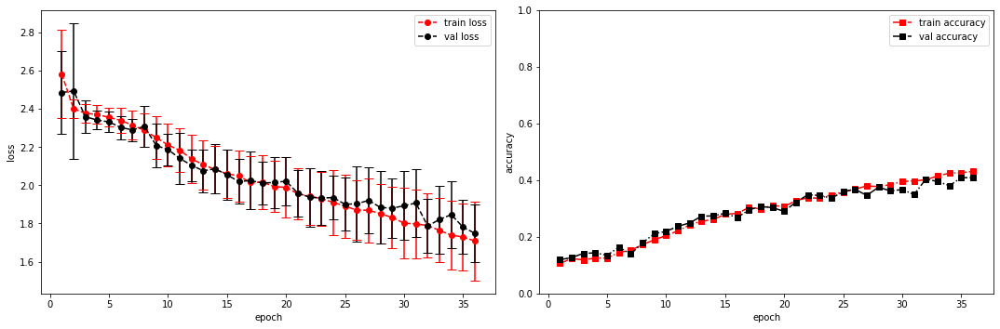

model saved


training epoch:  36
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [37/100], step [1/168],  Loss: 1.5572 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5393121242523193s
Epoch [37/100], step [17/168],  Loss: 1.7282 +/- 0.1725,  accuracy: 0.423828125, time elapsed = 6.240725040435791s
Epoch [37/100], step [33/168],  Loss: 1.6691 +/- 0.1752,  accuracy: 0.470703125, time elapsed = 6.240830659866333s
Epoch [37/100], step [49/168],  Loss: 1.7120 +/- 0.1767,  accuracy: 0.4140625, time elapsed = 6.238733768463135s
Epoch [37/100], step [65/168],  Loss: 1.6854 +/- 0.1694,  accuracy: 0.44140625, time elapsed = 6.2386744022369385s
Epoch [37/100], step [81/168],  Loss: 1.6250 +/- 0.1485,  accuracy: 0.4765625, time elapsed = 6.240706205368042s
Epoch [37/100], step [97/168],  Loss: 1.6744 +/- 0.1702,  accuracy: 0.435546875, time elapsed = 6.241151332855225s
Epoch [37/100], step [113/168],  Loss: 1.7367 +/- 0.1831,  accuracy: 0.43359375, time elapsed = 6.2390055656433105s
Epoch [37/100], step [129/168],  Loss: 1.7452 +/- 0.1517,  accuracy: 0.44140625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.444,  precision = 0.444 recall = 0.444 f1 = 0.444 ::: val: acc = 0.378,  precision = 0.378 recall = 0.378 time elapsed = 70.49571251869202s


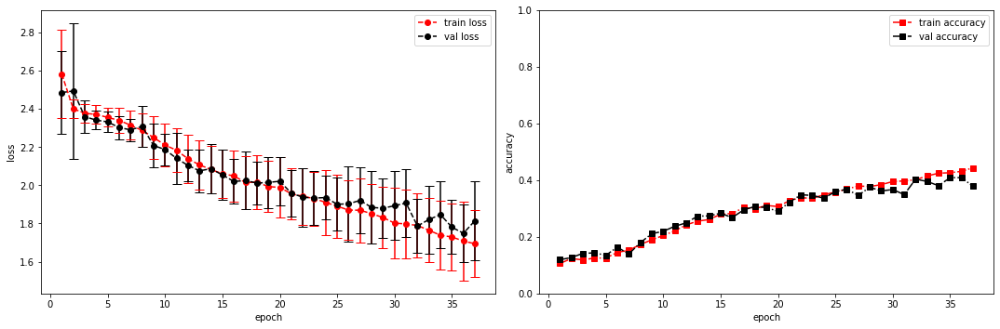

model saved


training epoch:  37
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [38/100], step [1/168],  Loss: 1.7095 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5357880592346191s
Epoch [38/100], step [17/168],  Loss: 1.6620 +/- 0.1282,  accuracy: 0.453125, time elapsed = 6.240475416183472s
Epoch [38/100], step [33/168],  Loss: 1.6988 +/- 0.1192,  accuracy: 0.4296875, time elapsed = 6.240438461303711s
Epoch [38/100], step [49/168],  Loss: 1.6657 +/- 0.1525,  accuracy: 0.4765625, time elapsed = 6.239046096801758s
Epoch [38/100], step [65/168],  Loss: 1.6307 +/- 0.1638,  accuracy: 0.4765625, time elapsed = 6.253079652786255s
Epoch [38/100], step [81/168],  Loss: 1.6539 +/- 0.1391,  accuracy: 0.44921875, time elapsed = 6.241987943649292s
Epoch [38/100], step [97/168],  Loss: 1.5919 +/- 0.1269,  accuracy: 0.478515625, time elapsed = 6.239539384841919s
Epoch [38/100], step [113/168],  Loss: 1.7330 +/- 0.1628,  accuracy: 0.439453125, time elapsed = 6.23924708366394s
Epoch [38/100], step [129/168],  Loss: 1.6556 +/- 0.1879,  accuracy: 0.453125, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.441,  precision = 0.441 recall = 0.441 f1 = 0.441 ::: val: acc = 0.372,  precision = 0.372 recall = 0.372 time elapsed = 70.51453065872192s


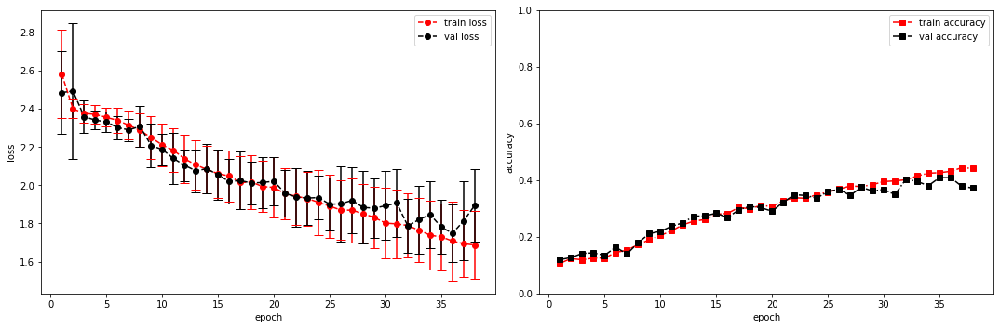

model saved


training epoch:  38
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [39/100], step [1/168],  Loss: 1.8874 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.529179573059082s
Epoch [39/100], step [17/168],  Loss: 1.7195 +/- 0.1797,  accuracy: 0.4375, time elapsed = 6.239762306213379s
Epoch [39/100], step [33/168],  Loss: 1.6409 +/- 0.1718,  accuracy: 0.455078125, time elapsed = 6.240308523178101s
Epoch [39/100], step [49/168],  Loss: 1.7118 +/- 0.1406,  accuracy: 0.42578125, time elapsed = 6.2378857135772705s
Epoch [39/100], step [65/168],  Loss: 1.6431 +/- 0.1405,  accuracy: 0.482421875, time elapsed = 6.2387003898620605s
Epoch [39/100], step [81/168],  Loss: 1.7520 +/- 0.2033,  accuracy: 0.42578125, time elapsed = 6.238445997238159s
Epoch [39/100], step [97/168],  Loss: 1.7127 +/- 0.1833,  accuracy: 0.4296875, time elapsed = 6.240478992462158s
Epoch [39/100], step [113/168],  Loss: 1.6248 +/- 0.2269,  accuracy: 0.47265625, time elapsed = 6.238509893417358s
Epoch [39/100], step [129/168],  Loss: 1.6954 +/- 0.1558,  accuracy: 0.42578125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.445,  precision = 0.445 recall = 0.445 f1 = 0.445 ::: val: acc = 0.386,  precision = 0.386 recall = 0.386 time elapsed = 70.49288082122803s


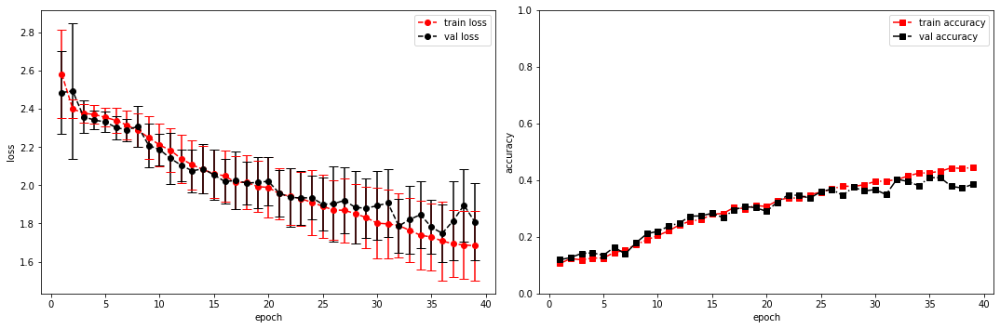

model saved


training epoch:  39
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [40/100], step [1/168],  Loss: 1.4775 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5385327339172363s
Epoch [40/100], step [17/168],  Loss: 1.6924 +/- 0.1340,  accuracy: 0.44140625, time elapsed = 6.251296520233154s
Epoch [40/100], step [33/168],  Loss: 1.5858 +/- 0.1855,  accuracy: 0.466796875, time elapsed = 6.239576578140259s
Epoch [40/100], step [49/168],  Loss: 1.7874 +/- 0.2147,  accuracy: 0.38671875, time elapsed = 6.241088390350342s
Epoch [40/100], step [65/168],  Loss: 1.6452 +/- 0.2331,  accuracy: 0.453125, time elapsed = 6.240823984146118s
Epoch [40/100], step [81/168],  Loss: 1.6227 +/- 0.1514,  accuracy: 0.478515625, time elapsed = 6.2400877475738525s
Epoch [40/100], step [97/168],  Loss: 1.6507 +/- 0.1630,  accuracy: 0.451171875, time elapsed = 6.238645315170288s
Epoch [40/100], step [113/168],  Loss: 1.6783 +/- 0.1995,  accuracy: 0.408203125, time elapsed = 6.239610433578491s
Epoch [40/100], step [129/168],  Loss: 1.6539 +/- 0.2134,  accuracy: 0.453125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.442,  precision = 0.442 recall = 0.442 f1 = 0.442 ::: val: acc = 0.423,  precision = 0.423 recall = 0.423 time elapsed = 70.51593160629272s


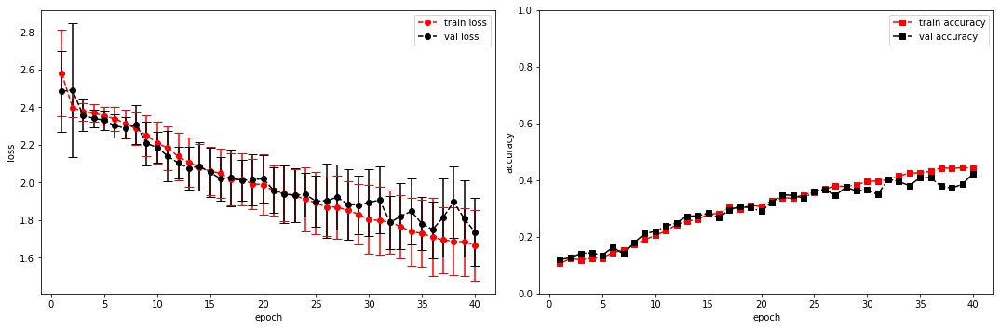

model saved


training epoch:  40
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [41/100], step [1/168],  Loss: 1.8134 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5390496253967285s
Epoch [41/100], step [17/168],  Loss: 1.6471 +/- 0.1771,  accuracy: 0.443359375, time elapsed = 6.239649057388306s
Epoch [41/100], step [33/168],  Loss: 1.5782 +/- 0.1949,  accuracy: 0.48046875, time elapsed = 6.23940372467041s
Epoch [41/100], step [49/168],  Loss: 1.5990 +/- 0.1852,  accuracy: 0.49609375, time elapsed = 6.238990306854248s
Epoch [41/100], step [65/168],  Loss: 1.6379 +/- 0.1185,  accuracy: 0.4609375, time elapsed = 6.238892078399658s
Epoch [41/100], step [81/168],  Loss: 1.6220 +/- 0.1505,  accuracy: 0.46875, time elapsed = 6.23825740814209s
Epoch [41/100], step [97/168],  Loss: 1.6302 +/- 0.2326,  accuracy: 0.44921875, time elapsed = 6.238427400588989s
Epoch [41/100], step [113/168],  Loss: 1.6468 +/- 0.2257,  accuracy: 0.451171875, time elapsed = 6.238826513290405s
Epoch [41/100], step [129/168],  Loss: 1.7448 +/- 0.1707,  accuracy: 0.416015625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.452,  precision = 0.452 recall = 0.452 f1 = 0.452 ::: val: acc = 0.407,  precision = 0.407 recall = 0.407 time elapsed = 70.50528240203857s


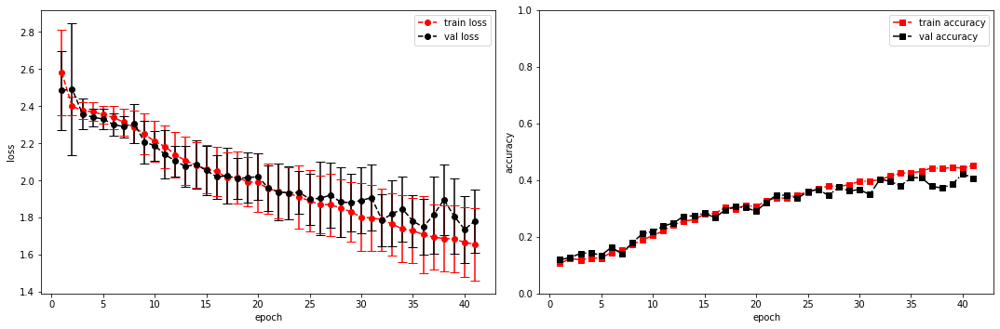

model saved


training epoch:  41
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [42/100], step [1/168],  Loss: 1.6630 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5380008220672607s
Epoch [42/100], step [17/168],  Loss: 1.6201 +/- 0.1502,  accuracy: 0.462890625, time elapsed = 6.238393545150757s
Epoch [42/100], step [33/168],  Loss: 1.7020 +/- 0.1570,  accuracy: 0.427734375, time elapsed = 6.238662481307983s
Epoch [42/100], step [49/168],  Loss: 1.6903 +/- 0.2363,  accuracy: 0.451171875, time elapsed = 6.239834308624268s
Epoch [42/100], step [65/168],  Loss: 1.6717 +/- 0.1932,  accuracy: 0.4296875, time elapsed = 6.239678859710693s
Epoch [42/100], step [81/168],  Loss: 1.7004 +/- 0.1472,  accuracy: 0.435546875, time elapsed = 6.239770174026489s
Epoch [42/100], step [97/168],  Loss: 1.6891 +/- 0.1874,  accuracy: 0.455078125, time elapsed = 6.241537570953369s
Epoch [42/100], step [113/168],  Loss: 1.7077 +/- 0.2036,  accuracy: 0.4296875, time elapsed = 6.2388646602630615s
Epoch [42/100], step [129/168],  Loss: 1.5967 +/- 0.1571,  accuracy: 0.482421875, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.443,  precision = 0.443 recall = 0.443 f1 = 0.443 ::: val: acc = 0.424,  precision = 0.424 recall = 0.424 time elapsed = 70.49740839004517s


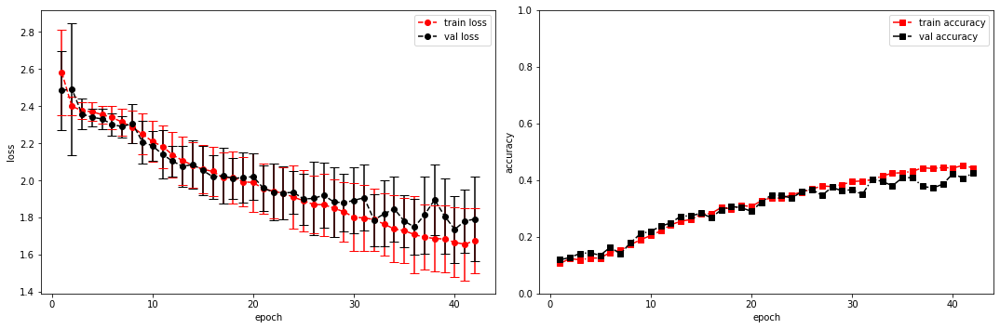

model saved


training epoch:  42
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [43/100], step [1/168],  Loss: 1.3139 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5418529510498047s
Epoch [43/100], step [17/168],  Loss: 1.5693 +/- 0.2044,  accuracy: 0.486328125, time elapsed = 6.23498272895813s
Epoch [43/100], step [33/168],  Loss: 1.6307 +/- 0.2360,  accuracy: 0.447265625, time elapsed = 6.236432075500488s
Epoch [43/100], step [49/168],  Loss: 1.7125 +/- 0.1791,  accuracy: 0.412109375, time elapsed = 6.237708568572998s
Epoch [43/100], step [65/168],  Loss: 1.7141 +/- 0.1539,  accuracy: 0.431640625, time elapsed = 6.236635208129883s
Epoch [43/100], step [81/168],  Loss: 1.6191 +/- 0.1215,  accuracy: 0.4609375, time elapsed = 6.25029993057251s
Epoch [43/100], step [97/168],  Loss: 1.6684 +/- 0.1815,  accuracy: 0.44140625, time elapsed = 6.236767053604126s
Epoch [43/100], step [113/168],  Loss: 1.6473 +/- 0.2029,  accuracy: 0.447265625, time elapsed = 6.235722541809082s
Epoch [43/100], step [129/168],  Loss: 1.7696 +/- 0.1709,  accuracy: 0.39453125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.439,  precision = 0.439 recall = 0.439 f1 = 0.439 ::: val: acc = 0.426,  precision = 0.426 recall = 0.426 time elapsed = 70.4866201877594s


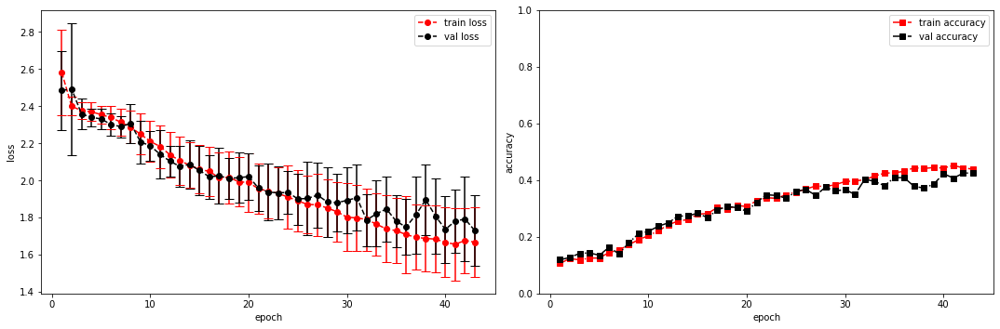

model saved


training epoch:  43
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [44/100], step [1/168],  Loss: 1.7556 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.538278341293335s
Epoch [44/100], step [17/168],  Loss: 1.5840 +/- 0.2042,  accuracy: 0.474609375, time elapsed = 6.238835573196411s
Epoch [44/100], step [33/168],  Loss: 1.5182 +/- 0.1425,  accuracy: 0.494140625, time elapsed = 6.238900661468506s
Epoch [44/100], step [49/168],  Loss: 1.5817 +/- 0.1642,  accuracy: 0.470703125, time elapsed = 6.239993572235107s
Epoch [44/100], step [65/168],  Loss: 1.5772 +/- 0.1685,  accuracy: 0.48828125, time elapsed = 6.238053798675537s
Epoch [44/100], step [81/168],  Loss: 1.6675 +/- 0.1046,  accuracy: 0.435546875, time elapsed = 6.23904275894165s
Epoch [44/100], step [97/168],  Loss: 1.6560 +/- 0.1872,  accuracy: 0.421875, time elapsed = 6.240347146987915s
Epoch [44/100], step [113/168],  Loss: 1.6547 +/- 0.1514,  accuracy: 0.443359375, time elapsed = 6.238783597946167s
Epoch [44/100], step [129/168],  Loss: 1.6603 +/- 0.1670,  accuracy: 0.44921875, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.464,  precision = 0.464 recall = 0.464 f1 = 0.464 ::: val: acc = 0.432,  precision = 0.432 recall = 0.432 time elapsed = 70.51123785972595s


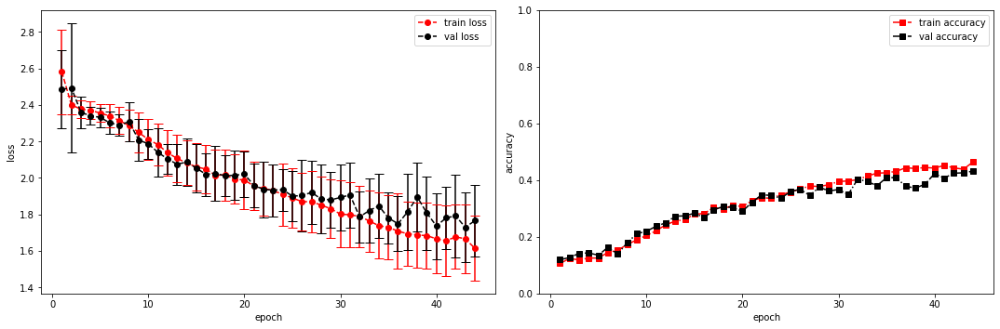

model saved


training epoch:  44
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [45/100], step [1/168],  Loss: 1.8468 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5505757331848145s
Epoch [45/100], step [17/168],  Loss: 1.5274 +/- 0.1880,  accuracy: 0.51171875, time elapsed = 6.241958856582642s
Epoch [45/100], step [33/168],  Loss: 1.5780 +/- 0.1821,  accuracy: 0.46484375, time elapsed = 6.248215675354004s
Epoch [45/100], step [49/168],  Loss: 1.5625 +/- 0.2018,  accuracy: 0.501953125, time elapsed = 6.239033937454224s
Epoch [45/100], step [65/168],  Loss: 1.6217 +/- 0.1722,  accuracy: 0.470703125, time elapsed = 6.239286661148071s
Epoch [45/100], step [81/168],  Loss: 1.5786 +/- 0.2005,  accuracy: 0.498046875, time elapsed = 6.240020275115967s
Epoch [45/100], step [97/168],  Loss: 1.6724 +/- 0.1383,  accuracy: 0.4375, time elapsed = 6.2392637729644775s
Epoch [45/100], step [113/168],  Loss: 1.6355 +/- 0.2086,  accuracy: 0.453125, time elapsed = 6.239645004272461s
Epoch [45/100], step [129/168],  Loss: 1.5828 +/- 0.2007,  accuracy: 0.4921875, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.473,  precision = 0.473 recall = 0.473 f1 = 0.473 ::: val: acc = 0.339,  precision = 0.339 recall = 0.339 time elapsed = 70.52538752555847s


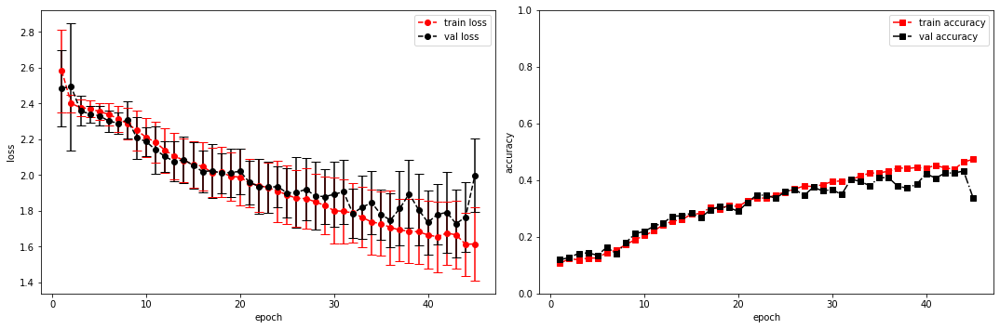

model saved
model saved


training epoch:  45
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [46/100], step [1/168],  Loss: 1.7942 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5385079383850098s
Epoch [46/100], step [17/168],  Loss: 1.6041 +/- 0.1625,  accuracy: 0.474609375, time elapsed = 6.239973545074463s
Epoch [46/100], step [33/168],  Loss: 1.5766 +/- 0.1710,  accuracy: 0.4765625, time elapsed = 6.2391135692596436s
Epoch [46/100], step [49/168],  Loss: 1.6096 +/- 0.1813,  accuracy: 0.45703125, time elapsed = 6.238530397415161s
Epoch [46/100], step [65/168],  Loss: 1.5140 +/- 0.1528,  accuracy: 0.486328125, time elapsed = 6.239779472351074s
Epoch [46/100], step [81/168],  Loss: 1.6018 +/- 0.1464,  accuracy: 0.4609375, time elapsed = 6.240442991256714s
Epoch [46/100], step [97/168],  Loss: 1.5328 +/- 0.2172,  accuracy: 0.5, time elapsed = 6.237824201583862s
Epoch [46/100], step [113/168],  Loss: 1.6364 +/- 0.1826,  accuracy: 0.46484375, time elapsed = 6.2398576736450195s
Epoch [46/100], step [129/168],  Loss: 1.6563 +/- 0.1899,  accuracy: 0.4296875, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.463,  precision = 0.463 recall = 0.463 f1 = 0.463 ::: val: acc = 0.431,  precision = 0.431 recall = 0.431 time elapsed = 70.51149129867554s


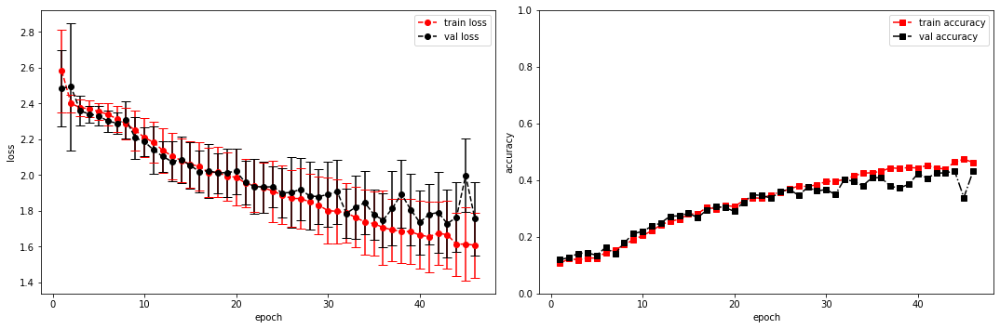

model saved


training epoch:  46
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [47/100], step [1/168],  Loss: 1.2947 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5367856025695801s
Epoch [47/100], step [17/168],  Loss: 1.5829 +/- 0.2136,  accuracy: 0.45703125, time elapsed = 6.239709377288818s
Epoch [47/100], step [33/168],  Loss: 1.5158 +/- 0.1169,  accuracy: 0.51171875, time elapsed = 6.237593412399292s
Epoch [47/100], step [49/168],  Loss: 1.5166 +/- 0.1686,  accuracy: 0.513671875, time elapsed = 6.238343238830566s
Epoch [47/100], step [65/168],  Loss: 1.5402 +/- 0.1777,  accuracy: 0.466796875, time elapsed = 6.238255262374878s
Epoch [47/100], step [81/168],  Loss: 1.6027 +/- 0.2233,  accuracy: 0.482421875, time elapsed = 6.238917589187622s
Epoch [47/100], step [97/168],  Loss: 1.5881 +/- 0.1579,  accuracy: 0.462890625, time elapsed = 6.237757682800293s
Epoch [47/100], step [113/168],  Loss: 1.5536 +/- 0.1917,  accuracy: 0.505859375, time elapsed = 6.23980712890625s
Epoch [47/100], step [129/168],  Loss: 1.5415 +/- 0.2038,  accuracy: 0.4921875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.481,  precision = 0.481 recall = 0.481 f1 = 0.481 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.48803329467773s


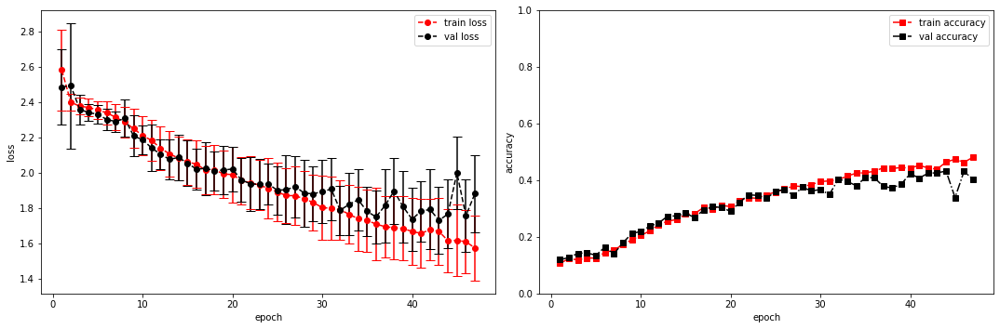

model saved


training epoch:  47
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [48/100], step [1/168],  Loss: 1.3592 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5337276458740234s
Epoch [48/100], step [17/168],  Loss: 1.5987 +/- 0.2433,  accuracy: 0.47265625, time elapsed = 6.239048957824707s
Epoch [48/100], step [33/168],  Loss: 1.6473 +/- 0.1629,  accuracy: 0.453125, time elapsed = 6.239474058151245s
Epoch [48/100], step [49/168],  Loss: 1.6230 +/- 0.1892,  accuracy: 0.45703125, time elapsed = 6.239435434341431s
Epoch [48/100], step [65/168],  Loss: 1.5959 +/- 0.1632,  accuracy: 0.47265625, time elapsed = 6.2390289306640625s
Epoch [48/100], step [81/168],  Loss: 1.6160 +/- 0.1598,  accuracy: 0.443359375, time elapsed = 6.240304470062256s
Epoch [48/100], step [97/168],  Loss: 1.5704 +/- 0.1995,  accuracy: 0.48828125, time elapsed = 6.25378155708313s
Epoch [48/100], step [113/168],  Loss: 1.5110 +/- 0.1459,  accuracy: 0.470703125, time elapsed = 6.237036228179932s
Epoch [48/100], step [129/168],  Loss: 1.5683 +/- 0.1716,  accuracy: 0.498046875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.469,  precision = 0.469 recall = 0.469 f1 = 0.469 ::: val: acc = 0.430,  precision = 0.430 recall = 0.430 time elapsed = 70.4950315952301s


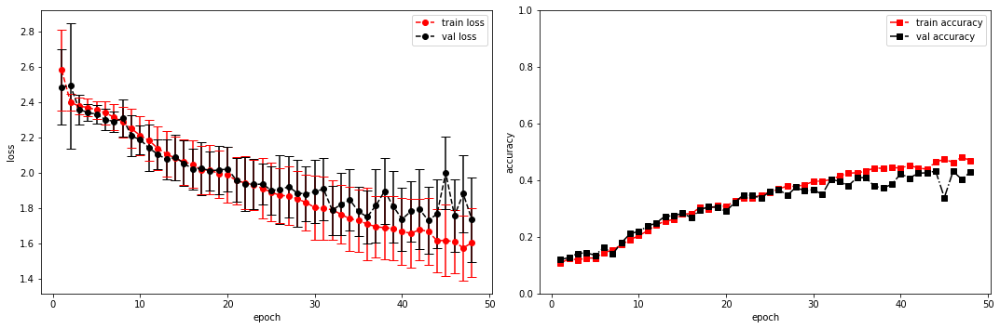

model saved


training epoch:  48
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [49/100], step [1/168],  Loss: 1.6039 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.530423641204834s
Epoch [49/100], step [17/168],  Loss: 1.5530 +/- 0.1765,  accuracy: 0.486328125, time elapsed = 6.242650270462036s
Epoch [49/100], step [33/168],  Loss: 1.6253 +/- 0.1711,  accuracy: 0.455078125, time elapsed = 6.243236780166626s
Epoch [49/100], step [49/168],  Loss: 1.4775 +/- 0.1890,  accuracy: 0.5234375, time elapsed = 6.244872808456421s
Epoch [49/100], step [65/168],  Loss: 1.5326 +/- 0.1965,  accuracy: 0.505859375, time elapsed = 6.237146615982056s
Epoch [49/100], step [81/168],  Loss: 1.4801 +/- 0.1612,  accuracy: 0.529296875, time elapsed = 6.237862586975098s
Epoch [49/100], step [97/168],  Loss: 1.5242 +/- 0.1834,  accuracy: 0.49609375, time elapsed = 6.237429618835449s
Epoch [49/100], step [113/168],  Loss: 1.5825 +/- 0.2462,  accuracy: 0.494140625, time elapsed = 6.237298488616943s
Epoch [49/100], step [129/168],  Loss: 1.5959 +/- 0.1485,  accuracy: 0.439453125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.483,  precision = 0.483 recall = 0.483 f1 = 0.483 ::: val: acc = 0.430,  precision = 0.430 recall = 0.430 time elapsed = 70.48916959762573s


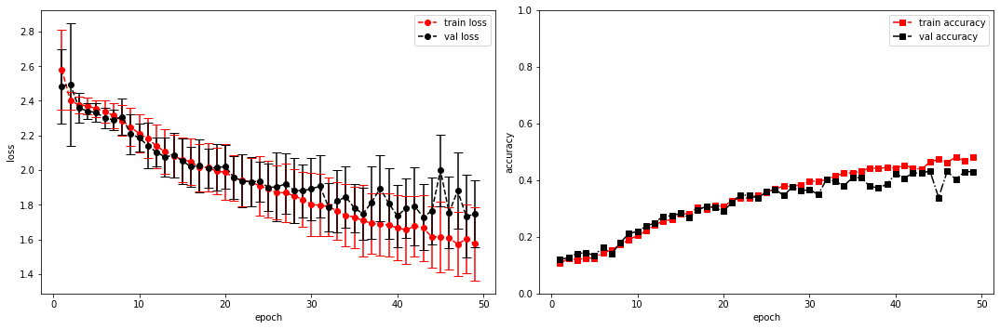

model saved


training epoch:  49
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [50/100], step [1/168],  Loss: 1.6397 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5550825595855713s
Epoch [50/100], step [17/168],  Loss: 1.6969 +/- 0.2354,  accuracy: 0.4140625, time elapsed = 6.242210149765015s
Epoch [50/100], step [33/168],  Loss: 1.5551 +/- 0.2469,  accuracy: 0.486328125, time elapsed = 6.250858783721924s
Epoch [50/100], step [49/168],  Loss: 1.5531 +/- 0.1560,  accuracy: 0.474609375, time elapsed = 6.23863410949707s
Epoch [50/100], step [65/168],  Loss: 1.5478 +/- 0.1768,  accuracy: 0.48046875, time elapsed = 6.238635540008545s
Epoch [50/100], step [81/168],  Loss: 1.5978 +/- 0.1956,  accuracy: 0.478515625, time elapsed = 6.238887310028076s
Epoch [50/100], step [97/168],  Loss: 1.5203 +/- 0.1560,  accuracy: 0.48046875, time elapsed = 6.239100933074951s
Epoch [50/100], step [113/168],  Loss: 1.6003 +/- 0.2384,  accuracy: 0.482421875, time elapsed = 6.239390134811401s
Epoch [50/100], step [129/168],  Loss: 1.5149 +/- 0.1886,  accuracy: 0.49609375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.469,  precision = 0.469 recall = 0.469 f1 = 0.469 ::: val: acc = 0.384,  precision = 0.384 recall = 0.384 time elapsed = 70.52143454551697s


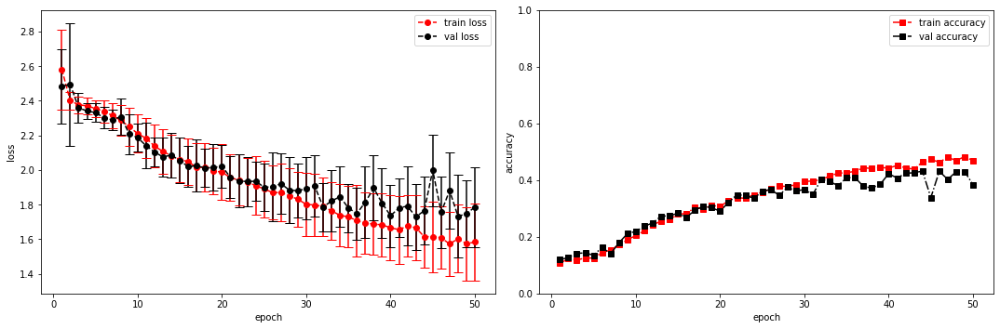

model saved


training epoch:  50
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [51/100], step [1/168],  Loss: 2.1568 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5294387340545654s
Epoch [51/100], step [17/168],  Loss: 1.5276 +/- 0.1804,  accuracy: 0.482421875, time elapsed = 6.238518953323364s
Epoch [51/100], step [33/168],  Loss: 1.5983 +/- 0.2108,  accuracy: 0.46484375, time elapsed = 6.2388341426849365s
Epoch [51/100], step [49/168],  Loss: 1.6466 +/- 0.2515,  accuracy: 0.44921875, time elapsed = 6.238580226898193s
Epoch [51/100], step [65/168],  Loss: 1.5013 +/- 0.1181,  accuracy: 0.51171875, time elapsed = 6.238697052001953s
Epoch [51/100], step [81/168],  Loss: 1.5657 +/- 0.2258,  accuracy: 0.5, time elapsed = 6.237943172454834s
Epoch [51/100], step [97/168],  Loss: 1.5432 +/- 0.2048,  accuracy: 0.5, time elapsed = 6.237515449523926s
Epoch [51/100], step [113/168],  Loss: 1.5476 +/- 0.1609,  accuracy: 0.44921875, time elapsed = 6.2375688552856445s
Epoch [51/100], step [129/168],  Loss: 1.5778 +/- 0.2353,  accuracy: 0.4765625, time elapsed = 6.23

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.472,  precision = 0.472 recall = 0.472 f1 = 0.472 ::: val: acc = 0.444,  precision = 0.444 recall = 0.444 time elapsed = 70.49284267425537s


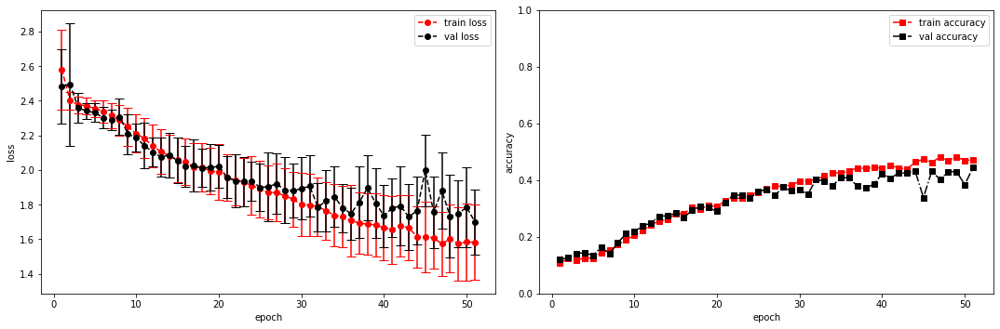

model saved


training epoch:  51
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [52/100], step [1/168],  Loss: 1.5597 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5337238311767578s
Epoch [52/100], step [17/168],  Loss: 1.5076 +/- 0.1605,  accuracy: 0.490234375, time elapsed = 6.238612174987793s
Epoch [52/100], step [33/168],  Loss: 1.5991 +/- 0.1780,  accuracy: 0.482421875, time elapsed = 6.237114429473877s
Epoch [52/100], step [49/168],  Loss: 1.5912 +/- 0.1935,  accuracy: 0.486328125, time elapsed = 6.2390828132629395s
Epoch [52/100], step [65/168],  Loss: 1.4782 +/- 0.2021,  accuracy: 0.51171875, time elapsed = 6.237852096557617s
Epoch [52/100], step [81/168],  Loss: 1.4988 +/- 0.2020,  accuracy: 0.5234375, time elapsed = 6.239143371582031s
Epoch [52/100], step [97/168],  Loss: 1.6323 +/- 0.1764,  accuracy: 0.443359375, time elapsed = 6.23760724067688s
Epoch [52/100], step [113/168],  Loss: 1.6638 +/- 0.2098,  accuracy: 0.439453125, time elapsed = 6.238746881484985s
Epoch [52/100], step [129/168],  Loss: 1.5199 +/- 0.1900,  accuracy: 0.5078125, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.490,  precision = 0.490 recall = 0.490 f1 = 0.490 ::: val: acc = 0.434,  precision = 0.434 recall = 0.434 time elapsed = 70.48568367958069s


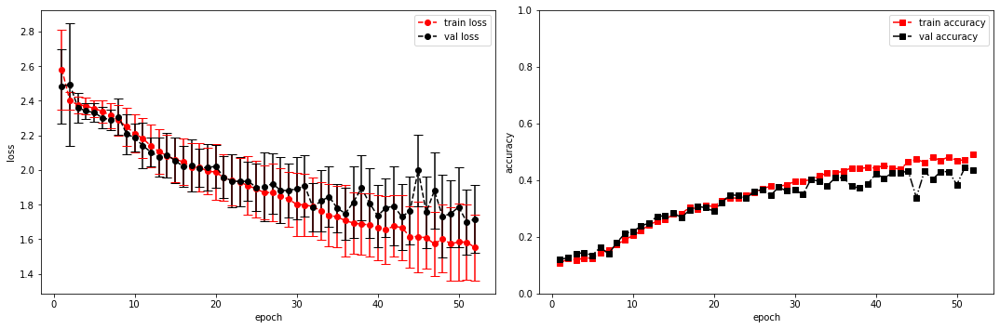

model saved


training epoch:  52
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [53/100], step [1/168],  Loss: 1.1857 +/- 0.0000,  accuracy: 0.04296875, time elapsed = 0.5294196605682373s
Epoch [53/100], step [17/168],  Loss: 1.4593 +/- 0.1706,  accuracy: 0.513671875, time elapsed = 6.239307165145874s
Epoch [53/100], step [33/168],  Loss: 1.5428 +/- 0.1709,  accuracy: 0.498046875, time elapsed = 6.237934827804565s
Epoch [53/100], step [49/168],  Loss: 1.4988 +/- 0.1950,  accuracy: 0.4921875, time elapsed = 6.237137317657471s
Epoch [53/100], step [65/168],  Loss: 1.4903 +/- 0.1242,  accuracy: 0.505859375, time elapsed = 6.238994359970093s
Epoch [53/100], step [81/168],  Loss: 1.4812 +/- 0.2337,  accuracy: 0.51171875, time elapsed = 6.237895727157593s
Epoch [53/100], step [97/168],  Loss: 1.5904 +/- 0.1943,  accuracy: 0.48046875, time elapsed = 6.2456419467926025s
Epoch [53/100], step [113/168],  Loss: 1.4895 +/- 0.2309,  accuracy: 0.517578125, time elapsed = 6.239630937576294s
Epoch [53/100], step [129/168],  Loss: 1.5177 +/- 0.1625,  accuracy: 0.521484375, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.500,  precision = 0.500 recall = 0.500 f1 = 0.500 ::: val: acc = 0.391,  precision = 0.391 recall = 0.391 time elapsed = 70.48565435409546s


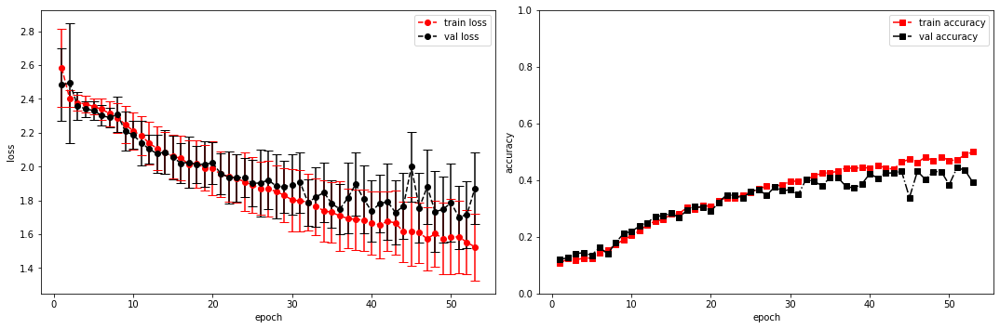

model saved


training epoch:  53
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [54/100], step [1/168],  Loss: 1.6037 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5289230346679688s
Epoch [54/100], step [17/168],  Loss: 1.5040 +/- 0.1681,  accuracy: 0.51171875, time elapsed = 6.23848295211792s
Epoch [54/100], step [33/168],  Loss: 1.4856 +/- 0.1999,  accuracy: 0.529296875, time elapsed = 6.237763166427612s
Epoch [54/100], step [49/168],  Loss: 1.5113 +/- 0.1926,  accuracy: 0.5, time elapsed = 6.239117622375488s
Epoch [54/100], step [65/168],  Loss: 1.5565 +/- 0.1715,  accuracy: 0.470703125, time elapsed = 6.240977048873901s
Epoch [54/100], step [81/168],  Loss: 1.4706 +/- 0.1563,  accuracy: 0.498046875, time elapsed = 6.239803791046143s
Epoch [54/100], step [97/168],  Loss: 1.5244 +/- 0.2540,  accuracy: 0.501953125, time elapsed = 6.239238739013672s
Epoch [54/100], step [113/168],  Loss: 1.6271 +/- 0.2057,  accuracy: 0.44921875, time elapsed = 6.23883318901062s
Epoch [54/100], step [129/168],  Loss: 1.6350 +/- 0.2148,  accuracy: 0.453125, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.481,  precision = 0.481 recall = 0.481 f1 = 0.481 ::: val: acc = 0.421,  precision = 0.421 recall = 0.421 time elapsed = 70.48087215423584s


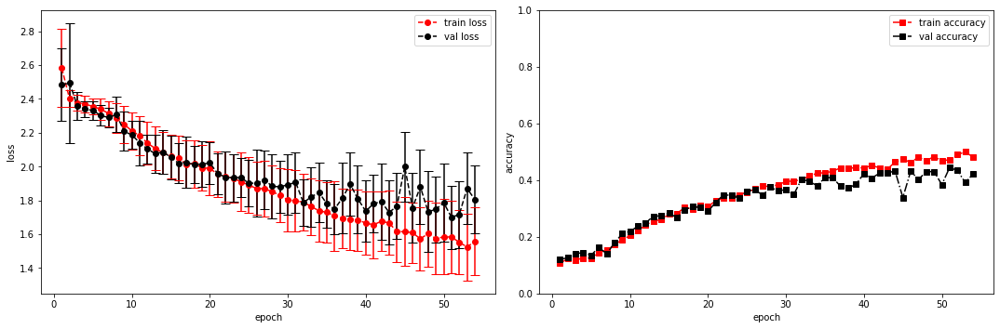

model saved


training epoch:  54
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [55/100], step [1/168],  Loss: 1.6257 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5325226783752441s
Epoch [55/100], step [17/168],  Loss: 1.4365 +/- 0.1713,  accuracy: 0.515625, time elapsed = 6.238158226013184s
Epoch [55/100], step [33/168],  Loss: 1.4896 +/- 0.1680,  accuracy: 0.51953125, time elapsed = 6.239281177520752s
Epoch [55/100], step [49/168],  Loss: 1.5017 +/- 0.1423,  accuracy: 0.515625, time elapsed = 6.249680042266846s
Epoch [55/100], step [65/168],  Loss: 1.5154 +/- 0.2156,  accuracy: 0.517578125, time elapsed = 6.23894739151001s
Epoch [55/100], step [81/168],  Loss: 1.5828 +/- 0.1414,  accuracy: 0.490234375, time elapsed = 6.2386064529418945s
Epoch [55/100], step [97/168],  Loss: 1.6319 +/- 0.1743,  accuracy: 0.447265625, time elapsed = 6.238585710525513s
Epoch [55/100], step [113/168],  Loss: 1.4658 +/- 0.1672,  accuracy: 0.5234375, time elapsed = 6.23861289024353s
Epoch [55/100], step [129/168],  Loss: 1.5891 +/- 0.1584,  accuracy: 0.458984375, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.497,  precision = 0.497 recall = 0.497 f1 = 0.497 ::: val: acc = 0.443,  precision = 0.443 recall = 0.443 time elapsed = 70.49394345283508s


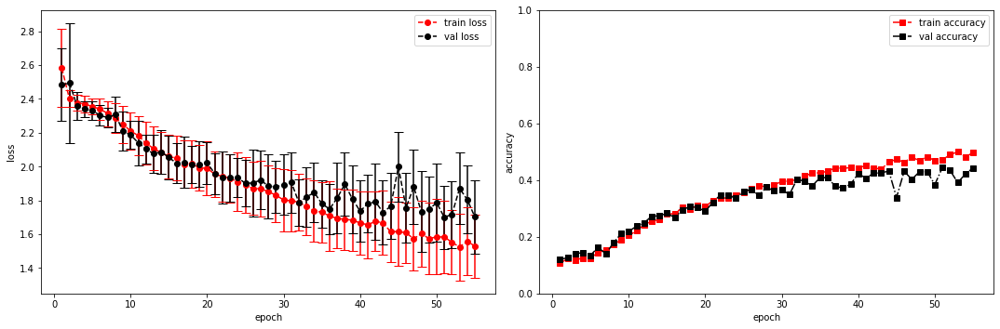

model saved


training epoch:  55
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [56/100], step [1/168],  Loss: 1.5629 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5357646942138672s
Epoch [56/100], step [17/168],  Loss: 1.4902 +/- 0.1214,  accuracy: 0.51171875, time elapsed = 6.241978168487549s
Epoch [56/100], step [33/168],  Loss: 1.6306 +/- 0.1589,  accuracy: 0.4765625, time elapsed = 6.238508701324463s
Epoch [56/100], step [49/168],  Loss: 1.4842 +/- 0.1191,  accuracy: 0.505859375, time elapsed = 6.2387003898620605s
Epoch [56/100], step [65/168],  Loss: 1.5923 +/- 0.2090,  accuracy: 0.474609375, time elapsed = 6.237954139709473s
Epoch [56/100], step [81/168],  Loss: 1.4682 +/- 0.1775,  accuracy: 0.51171875, time elapsed = 6.239547252655029s
Epoch [56/100], step [97/168],  Loss: 1.5048 +/- 0.2453,  accuracy: 0.53125, time elapsed = 6.238849401473999s
Epoch [56/100], step [113/168],  Loss: 1.5872 +/- 0.1954,  accuracy: 0.478515625, time elapsed = 6.2376933097839355s
Epoch [56/100], step [129/168],  Loss: 1.4402 +/- 0.1407,  accuracy: 0.513671875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.491,  precision = 0.491 recall = 0.491 f1 = 0.491 ::: val: acc = 0.405,  precision = 0.405 recall = 0.405 time elapsed = 70.52183842658997s


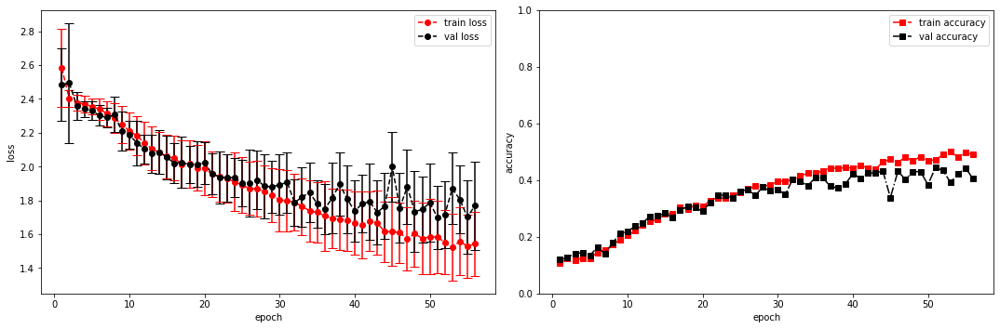

model saved


training epoch:  56
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [57/100], step [1/168],  Loss: 1.3828 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5343484878540039s
Epoch [57/100], step [17/168],  Loss: 1.4721 +/- 0.1693,  accuracy: 0.51171875, time elapsed = 6.239042282104492s
Epoch [57/100], step [33/168],  Loss: 1.5200 +/- 0.1457,  accuracy: 0.513671875, time elapsed = 6.237655878067017s
Epoch [57/100], step [49/168],  Loss: 1.4517 +/- 0.1625,  accuracy: 0.513671875, time elapsed = 6.238023042678833s
Epoch [57/100], step [65/168],  Loss: 1.5189 +/- 0.1684,  accuracy: 0.5, time elapsed = 6.239763259887695s
Epoch [57/100], step [81/168],  Loss: 1.5654 +/- 0.1685,  accuracy: 0.484375, time elapsed = 6.238105297088623s
Epoch [57/100], step [97/168],  Loss: 1.4739 +/- 0.1402,  accuracy: 0.51171875, time elapsed = 6.238250732421875s
Epoch [57/100], step [113/168],  Loss: 1.5765 +/- 0.1471,  accuracy: 0.46484375, time elapsed = 6.237879276275635s
Epoch [57/100], step [129/168],  Loss: 1.4826 +/- 0.2017,  accuracy: 0.494140625, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.498,  precision = 0.498 recall = 0.498 f1 = 0.498 ::: val: acc = 0.441,  precision = 0.441 recall = 0.441 time elapsed = 70.48033738136292s


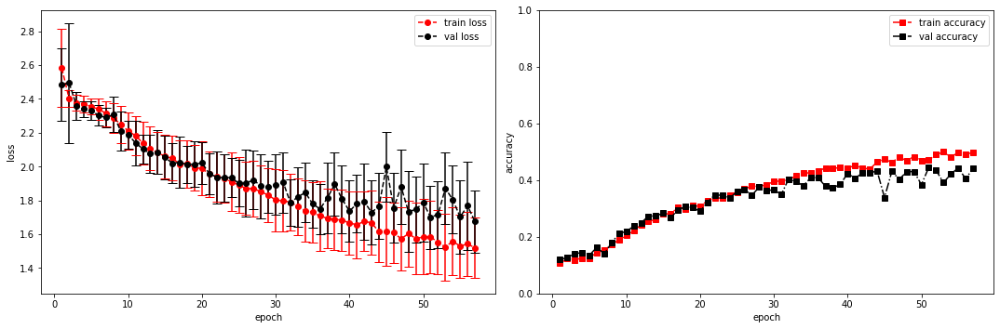

model saved


training epoch:  57
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [58/100], step [1/168],  Loss: 1.7165 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5361537933349609s
Epoch [58/100], step [17/168],  Loss: 1.4064 +/- 0.1752,  accuracy: 0.5546875, time elapsed = 6.238784313201904s
Epoch [58/100], step [33/168],  Loss: 1.4259 +/- 0.1988,  accuracy: 0.505859375, time elapsed = 6.238512992858887s
Epoch [58/100], step [49/168],  Loss: 1.4928 +/- 0.1659,  accuracy: 0.4765625, time elapsed = 6.24025559425354s
Epoch [58/100], step [65/168],  Loss: 1.4990 +/- 0.1952,  accuracy: 0.501953125, time elapsed = 6.2383832931518555s
Epoch [58/100], step [81/168],  Loss: 1.4254 +/- 0.1864,  accuracy: 0.53515625, time elapsed = 6.238576650619507s
Epoch [58/100], step [97/168],  Loss: 1.3961 +/- 0.1871,  accuracy: 0.5390625, time elapsed = 6.23832893371582s
Epoch [58/100], step [113/168],  Loss: 1.4788 +/- 0.1654,  accuracy: 0.515625, time elapsed = 6.250238656997681s
Epoch [58/100], step [129/168],  Loss: 1.5101 +/- 0.1549,  accuracy: 0.478515625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.507,  precision = 0.507 recall = 0.507 f1 = 0.507 ::: val: acc = 0.417,  precision = 0.417 recall = 0.417 time elapsed = 70.50249886512756s


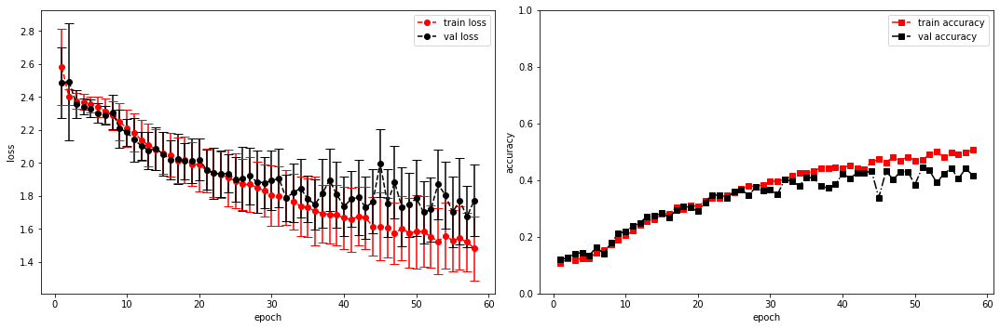

model saved


training epoch:  58
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [59/100], step [1/168],  Loss: 1.6334 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5303211212158203s
Epoch [59/100], step [17/168],  Loss: 1.4870 +/- 0.1758,  accuracy: 0.50390625, time elapsed = 6.23881459236145s
Epoch [59/100], step [33/168],  Loss: 1.5013 +/- 0.1403,  accuracy: 0.482421875, time elapsed = 6.237897872924805s
Epoch [59/100], step [49/168],  Loss: 1.4149 +/- 0.1723,  accuracy: 0.490234375, time elapsed = 6.237886905670166s
Epoch [59/100], step [65/168],  Loss: 1.4638 +/- 0.1879,  accuracy: 0.5, time elapsed = 6.239835500717163s
Epoch [59/100], step [81/168],  Loss: 1.5203 +/- 0.1947,  accuracy: 0.4921875, time elapsed = 6.239922761917114s
Epoch [59/100], step [97/168],  Loss: 1.4772 +/- 0.2948,  accuracy: 0.505859375, time elapsed = 6.239339113235474s
Epoch [59/100], step [113/168],  Loss: 1.5175 +/- 0.2030,  accuracy: 0.51171875, time elapsed = 6.2390618324279785s
Epoch [59/100], step [129/168],  Loss: 1.5369 +/- 0.2072,  accuracy: 0.494140625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.495,  precision = 0.495 recall = 0.495 f1 = 0.495 ::: val: acc = 0.389,  precision = 0.389 recall = 0.389 time elapsed = 70.48392677307129s


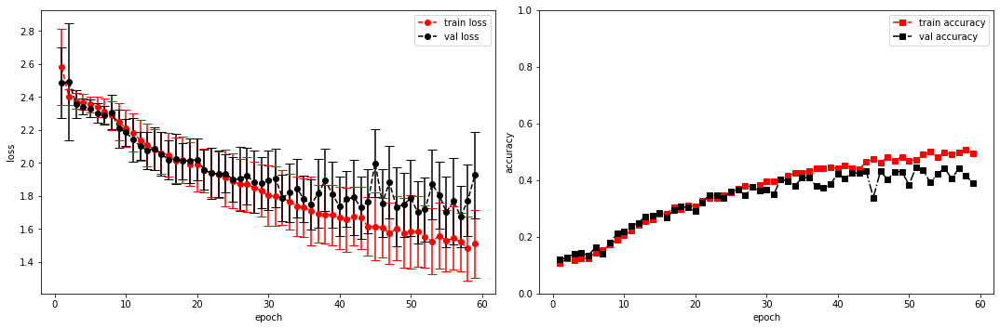

model saved
model saved


training epoch:  59
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [60/100], step [1/168],  Loss: 1.4242 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5398545265197754s
Epoch [60/100], step [17/168],  Loss: 1.4759 +/- 0.2450,  accuracy: 0.5234375, time elapsed = 6.237443923950195s
Epoch [60/100], step [33/168],  Loss: 1.4865 +/- 0.1415,  accuracy: 0.505859375, time elapsed = 6.240116834640503s
Epoch [60/100], step [49/168],  Loss: 1.4806 +/- 0.2152,  accuracy: 0.537109375, time elapsed = 6.2410430908203125s
Epoch [60/100], step [65/168],  Loss: 1.4678 +/- 0.2318,  accuracy: 0.525390625, time elapsed = 6.245945930480957s
Epoch [60/100], step [81/168],  Loss: 1.3660 +/- 0.2003,  accuracy: 0.53125, time elapsed = 6.2369544506073s
Epoch [60/100], step [97/168],  Loss: 1.4627 +/- 0.2210,  accuracy: 0.521484375, time elapsed = 6.237339973449707s
Epoch [60/100], step [113/168],  Loss: 1.4565 +/- 0.1611,  accuracy: 0.513671875, time elapsed = 6.237607002258301s
Epoch [60/100], step [129/168],  Loss: 1.4850 +/- 0.2207,  accuracy: 0.55078125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.517,  precision = 0.517 recall = 0.517 f1 = 0.517 ::: val: acc = 0.416,  precision = 0.416 recall = 0.416 time elapsed = 70.4952347278595s


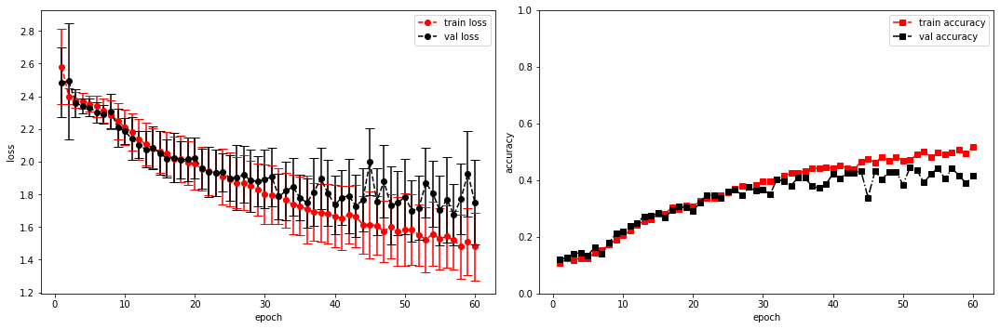

model saved


training epoch:  60
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [61/100], step [1/168],  Loss: 1.5186 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5850646495819092s
Epoch [61/100], step [17/168],  Loss: 1.4356 +/- 0.1641,  accuracy: 0.51953125, time elapsed = 6.2340757846832275s
Epoch [61/100], step [33/168],  Loss: 1.4600 +/- 0.2089,  accuracy: 0.533203125, time elapsed = 6.238234281539917s
Epoch [61/100], step [49/168],  Loss: 1.5237 +/- 0.2523,  accuracy: 0.490234375, time elapsed = 6.239083766937256s
Epoch [61/100], step [65/168],  Loss: 1.3490 +/- 0.1630,  accuracy: 0.5703125, time elapsed = 6.238773584365845s
Epoch [61/100], step [81/168],  Loss: 1.5212 +/- 0.1513,  accuracy: 0.517578125, time elapsed = 6.2392566204071045s
Epoch [61/100], step [97/168],  Loss: 1.4999 +/- 0.2272,  accuracy: 0.478515625, time elapsed = 6.236642360687256s
Epoch [61/100], step [113/168],  Loss: 1.5430 +/- 0.2053,  accuracy: 0.50390625, time elapsed = 6.238430023193359s
Epoch [61/100], step [129/168],  Loss: 1.5286 +/- 0.1876,  accuracy: 0.4921875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.515,  precision = 0.515 recall = 0.515 f1 = 0.515 ::: val: acc = 0.456,  precision = 0.456 recall = 0.456 time elapsed = 70.54923343658447s


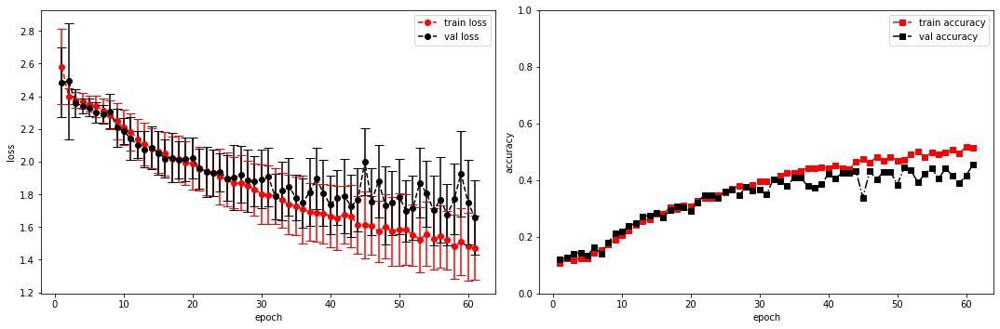

model saved


training epoch:  61
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [62/100], step [1/168],  Loss: 1.3422 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5431270599365234s
Epoch [62/100], step [17/168],  Loss: 1.3998 +/- 0.1277,  accuracy: 0.544921875, time elapsed = 6.238942861557007s
Epoch [62/100], step [33/168],  Loss: 1.4818 +/- 0.1865,  accuracy: 0.50390625, time elapsed = 6.238495349884033s
Epoch [62/100], step [49/168],  Loss: 1.4512 +/- 0.1867,  accuracy: 0.521484375, time elapsed = 6.237908601760864s
Epoch [62/100], step [65/168],  Loss: 1.4450 +/- 0.2211,  accuracy: 0.533203125, time elapsed = 6.239811658859253s
Epoch [62/100], step [81/168],  Loss: 1.3735 +/- 0.2231,  accuracy: 0.55078125, time elapsed = 6.23871636390686s
Epoch [62/100], step [97/168],  Loss: 1.5196 +/- 0.1226,  accuracy: 0.482421875, time elapsed = 6.239409685134888s
Epoch [62/100], step [113/168],  Loss: 1.5405 +/- 0.2408,  accuracy: 0.478515625, time elapsed = 6.238194704055786s
Epoch [62/100], step [129/168],  Loss: 1.6826 +/- 0.1555,  accuracy: 0.43359375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.491,  precision = 0.491 recall = 0.491 f1 = 0.491 ::: val: acc = 0.439,  precision = 0.439 recall = 0.439 time elapsed = 70.4952449798584s


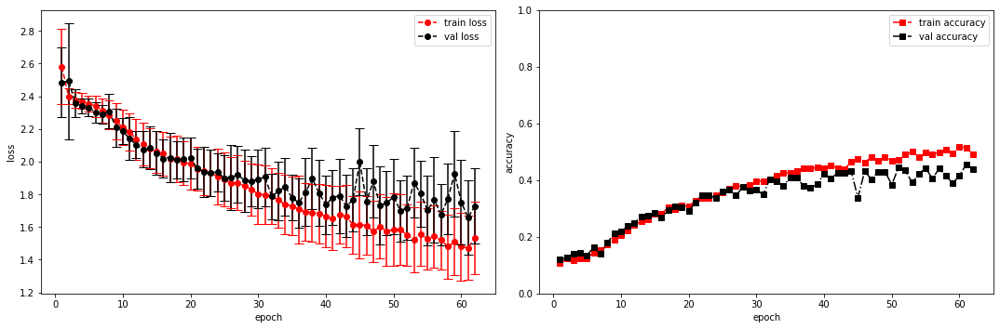

model saved


training epoch:  62
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [63/100], step [1/168],  Loss: 1.5253 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5359969139099121s
Epoch [63/100], step [17/168],  Loss: 1.5538 +/- 0.1773,  accuracy: 0.478515625, time elapsed = 6.238740682601929s
Epoch [63/100], step [33/168],  Loss: 1.5073 +/- 0.1966,  accuracy: 0.5, time elapsed = 6.238508224487305s
Epoch [63/100], step [49/168],  Loss: 1.4958 +/- 0.1809,  accuracy: 0.5, time elapsed = 6.238351106643677s
Epoch [63/100], step [65/168],  Loss: 1.4486 +/- 0.2209,  accuracy: 0.51953125, time elapsed = 6.23896598815918s
Epoch [63/100], step [81/168],  Loss: 1.4468 +/- 0.1472,  accuracy: 0.521484375, time elapsed = 6.238649845123291s
Epoch [63/100], step [97/168],  Loss: 1.4686 +/- 0.1709,  accuracy: 0.509765625, time elapsed = 6.239105939865112s
Epoch [63/100], step [113/168],  Loss: 1.4444 +/- 0.0954,  accuracy: 0.486328125, time elapsed = 6.23912787437439s
Epoch [63/100], step [129/168],  Loss: 1.4255 +/- 0.1728,  accuracy: 0.525390625, time elapsed = 6

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.510,  precision = 0.510 recall = 0.510 f1 = 0.510 ::: val: acc = 0.453,  precision = 0.453 recall = 0.453 time elapsed = 70.50904870033264s


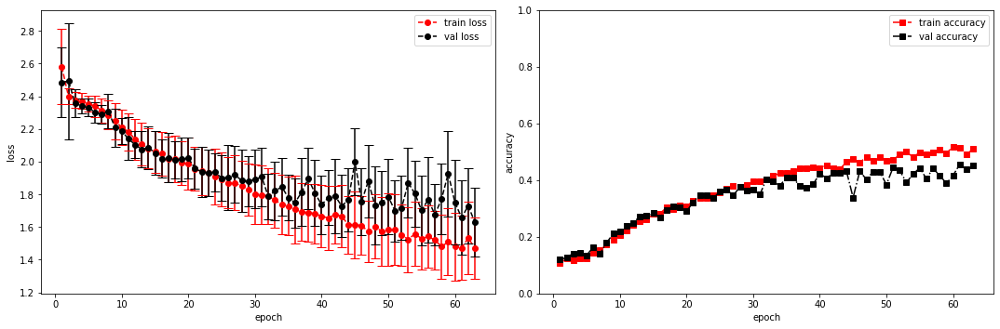

model saved


training epoch:  63
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [64/100], step [1/168],  Loss: 1.5004 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5293636322021484s
Epoch [64/100], step [17/168],  Loss: 1.4033 +/- 0.1998,  accuracy: 0.544921875, time elapsed = 6.238588571548462s
Epoch [64/100], step [33/168],  Loss: 1.4728 +/- 0.2284,  accuracy: 0.486328125, time elapsed = 6.238402843475342s
Epoch [64/100], step [49/168],  Loss: 1.4185 +/- 0.2010,  accuracy: 0.521484375, time elapsed = 6.239501714706421s
Epoch [64/100], step [65/168],  Loss: 1.4433 +/- 0.1926,  accuracy: 0.53125, time elapsed = 6.239309310913086s
Epoch [64/100], step [81/168],  Loss: 1.4504 +/- 0.1963,  accuracy: 0.521484375, time elapsed = 6.2399163246154785s
Epoch [64/100], step [97/168],  Loss: 1.2982 +/- 0.1171,  accuracy: 0.57421875, time elapsed = 6.240463972091675s
Epoch [64/100], step [113/168],  Loss: 1.3569 +/- 0.1486,  accuracy: 0.55859375, time elapsed = 6.238261699676514s
Epoch [64/100], step [129/168],  Loss: 1.4587 +/- 0.1884,  accuracy: 0.51953125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.529,  precision = 0.529 recall = 0.529 f1 = 0.529 ::: val: acc = 0.469,  precision = 0.469 recall = 0.469 time elapsed = 70.4816324710846s


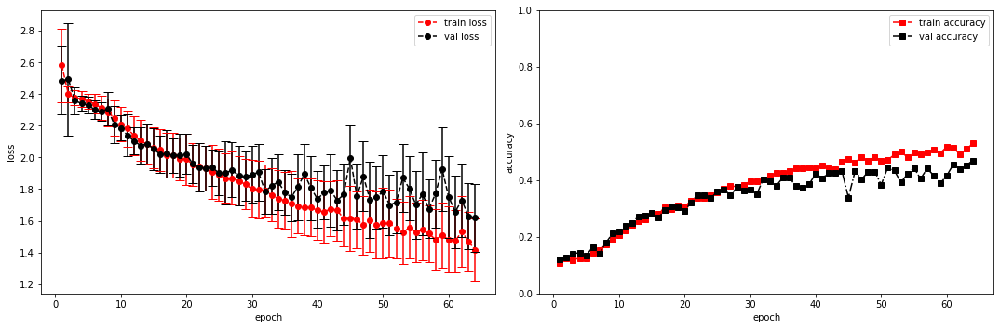

model saved


training epoch:  64
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [65/100], step [1/168],  Loss: 1.4048 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5307748317718506s
Epoch [65/100], step [17/168],  Loss: 1.5014 +/- 0.2458,  accuracy: 0.51953125, time elapsed = 6.237510919570923s
Epoch [65/100], step [33/168],  Loss: 1.4253 +/- 0.1867,  accuracy: 0.529296875, time elapsed = 6.2381532192230225s
Epoch [65/100], step [49/168],  Loss: 1.2556 +/- 0.1038,  accuracy: 0.5859375, time elapsed = 6.237780332565308s
Epoch [65/100], step [65/168],  Loss: 1.4091 +/- 0.1814,  accuracy: 0.521484375, time elapsed = 6.249632358551025s
Epoch [65/100], step [81/168],  Loss: 1.4223 +/- 0.2307,  accuracy: 0.548828125, time elapsed = 6.238408803939819s
Epoch [65/100], step [97/168],  Loss: 1.4145 +/- 0.1708,  accuracy: 0.537109375, time elapsed = 6.236829519271851s
Epoch [65/100], step [113/168],  Loss: 1.4466 +/- 0.2023,  accuracy: 0.5078125, time elapsed = 6.23766827583313s
Epoch [65/100], step [129/168],  Loss: 1.5211 +/- 0.2242,  accuracy: 0.49609375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.526,  precision = 0.526 recall = 0.526 f1 = 0.526 ::: val: acc = 0.389,  precision = 0.389 recall = 0.389 time elapsed = 70.47686076164246s


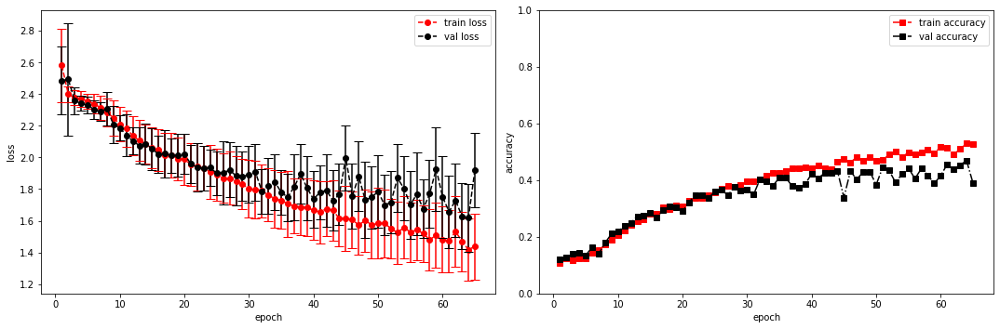

model saved
model saved


training epoch:  65
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [66/100], step [1/168],  Loss: 1.6547 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5339405536651611s
Epoch [66/100], step [17/168],  Loss: 1.5623 +/- 0.1823,  accuracy: 0.494140625, time elapsed = 6.238023042678833s
Epoch [66/100], step [33/168],  Loss: 1.4004 +/- 0.2249,  accuracy: 0.509765625, time elapsed = 6.240329265594482s
Epoch [66/100], step [49/168],  Loss: 1.4771 +/- 0.1946,  accuracy: 0.525390625, time elapsed = 6.239243984222412s
Epoch [66/100], step [65/168],  Loss: 1.3905 +/- 0.2037,  accuracy: 0.51953125, time elapsed = 6.239185571670532s
Epoch [66/100], step [81/168],  Loss: 1.4168 +/- 0.1020,  accuracy: 0.5, time elapsed = 6.237758636474609s
Epoch [66/100], step [97/168],  Loss: 1.3079 +/- 0.1649,  accuracy: 0.560546875, time elapsed = 6.238947629928589s
Epoch [66/100], step [113/168],  Loss: 1.4855 +/- 0.1907,  accuracy: 0.498046875, time elapsed = 6.23982310295105s
Epoch [66/100], step [129/168],  Loss: 1.5360 +/- 0.1732,  accuracy: 0.48046875, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.508,  precision = 0.508 recall = 0.508 f1 = 0.508 ::: val: acc = 0.444,  precision = 0.444 recall = 0.444 time elapsed = 70.49019050598145s


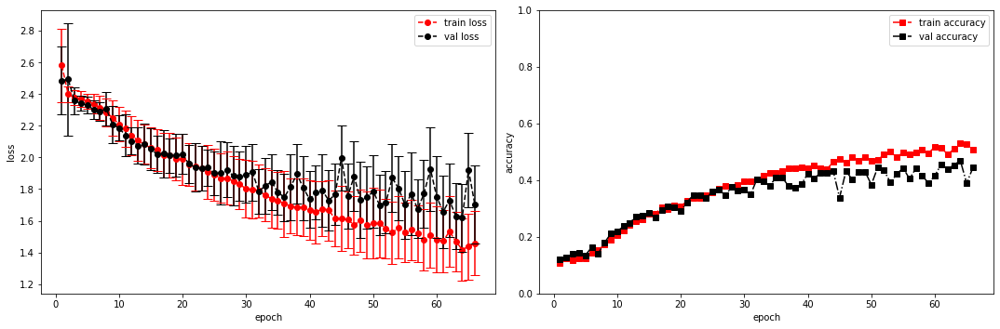

model saved


training epoch:  66
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [67/100], step [1/168],  Loss: 1.7012 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.537639856338501s
Epoch [67/100], step [17/168],  Loss: 1.3825 +/- 0.1960,  accuracy: 0.546875, time elapsed = 6.248654365539551s
Epoch [67/100], step [33/168],  Loss: 1.4108 +/- 0.2139,  accuracy: 0.51171875, time elapsed = 6.2398552894592285s
Epoch [67/100], step [49/168],  Loss: 1.2775 +/- 0.1855,  accuracy: 0.572265625, time elapsed = 6.2405846118927s
Epoch [67/100], step [65/168],  Loss: 1.3785 +/- 0.1746,  accuracy: 0.556640625, time elapsed = 6.23876166343689s
Epoch [67/100], step [81/168],  Loss: 1.3840 +/- 0.2183,  accuracy: 0.548828125, time elapsed = 6.238341569900513s
Epoch [67/100], step [97/168],  Loss: 1.3901 +/- 0.1976,  accuracy: 0.544921875, time elapsed = 6.2383809089660645s
Epoch [67/100], step [113/168],  Loss: 1.3835 +/- 0.2242,  accuracy: 0.552734375, time elapsed = 6.238343715667725s
Epoch [67/100], step [129/168],  Loss: 1.5003 +/- 0.2303,  accuracy: 0.48828125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.537,  precision = 0.537 recall = 0.537 f1 = 0.537 ::: val: acc = 0.456,  precision = 0.456 recall = 0.456 time elapsed = 70.49464321136475s


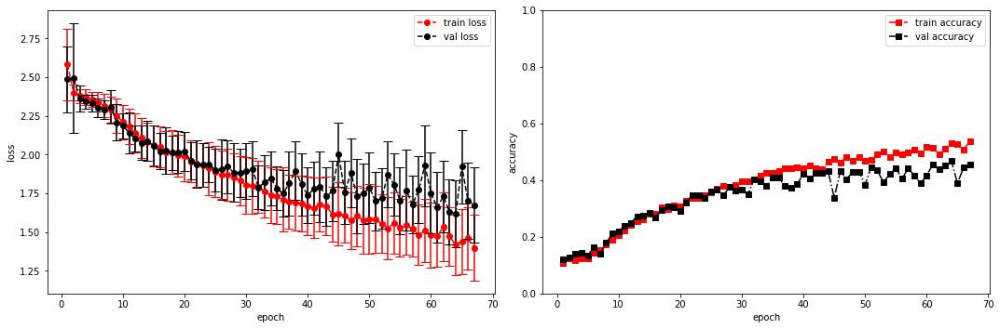

model saved


training epoch:  67
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [68/100], step [1/168],  Loss: 1.2475 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5359888076782227s
Epoch [68/100], step [17/168],  Loss: 1.2750 +/- 0.1275,  accuracy: 0.595703125, time elapsed = 6.238646507263184s
Epoch [68/100], step [33/168],  Loss: 1.3018 +/- 0.2363,  accuracy: 0.587890625, time elapsed = 6.239492416381836s
Epoch [68/100], step [49/168],  Loss: 1.2899 +/- 0.1903,  accuracy: 0.560546875, time elapsed = 6.238635778427124s
Epoch [68/100], step [65/168],  Loss: 1.4745 +/- 0.2504,  accuracy: 0.501953125, time elapsed = 6.235646963119507s
Epoch [68/100], step [81/168],  Loss: 1.4081 +/- 0.1917,  accuracy: 0.513671875, time elapsed = 6.237969636917114s
Epoch [68/100], step [97/168],  Loss: 1.3359 +/- 0.1495,  accuracy: 0.556640625, time elapsed = 6.236537933349609s
Epoch [68/100], step [113/168],  Loss: 1.3986 +/- 0.2198,  accuracy: 0.53125, time elapsed = 6.237146615982056s
Epoch [68/100], step [129/168],  Loss: 1.4097 +/- 0.1697,  accuracy: 0.517578125, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.539,  precision = 0.539 recall = 0.539 f1 = 0.539 ::: val: acc = 0.436,  precision = 0.436 recall = 0.436 time elapsed = 70.4866292476654s


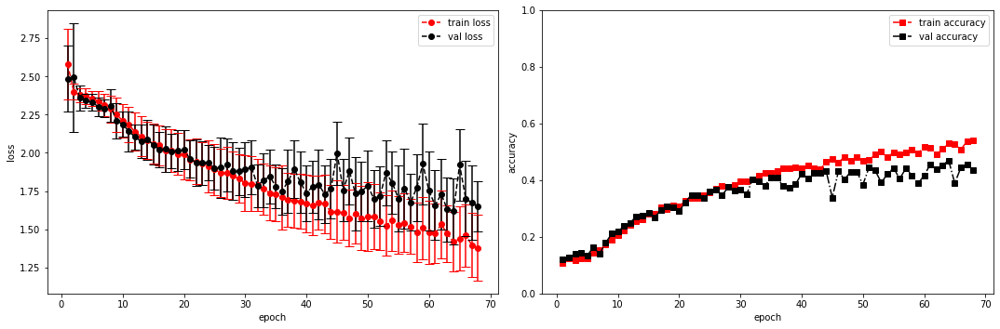

model saved


training epoch:  68
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [69/100], step [1/168],  Loss: 1.5256 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5332608222961426s
Epoch [69/100], step [17/168],  Loss: 1.3043 +/- 0.1728,  accuracy: 0.580078125, time elapsed = 6.2394304275512695s
Epoch [69/100], step [33/168],  Loss: 1.3967 +/- 0.2209,  accuracy: 0.529296875, time elapsed = 6.237218618392944s
Epoch [69/100], step [49/168],  Loss: 1.2848 +/- 0.1406,  accuracy: 0.595703125, time elapsed = 6.2373528480529785s
Epoch [69/100], step [65/168],  Loss: 1.4003 +/- 0.2192,  accuracy: 0.52734375, time elapsed = 6.238671779632568s
Epoch [69/100], step [81/168],  Loss: 1.3318 +/- 0.1892,  accuracy: 0.548828125, time elapsed = 6.238237380981445s
Epoch [69/100], step [97/168],  Loss: 1.3467 +/- 0.1876,  accuracy: 0.5390625, time elapsed = 6.238094091415405s
Epoch [69/100], step [113/168],  Loss: 1.4071 +/- 0.1493,  accuracy: 0.51953125, time elapsed = 6.23819637298584s
Epoch [69/100], step [129/168],  Loss: 1.3759 +/- 0.1220,  accuracy: 0.529296875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.542,  precision = 0.542 recall = 0.542 f1 = 0.542 ::: val: acc = 0.474,  precision = 0.474 recall = 0.474 time elapsed = 70.48138093948364s


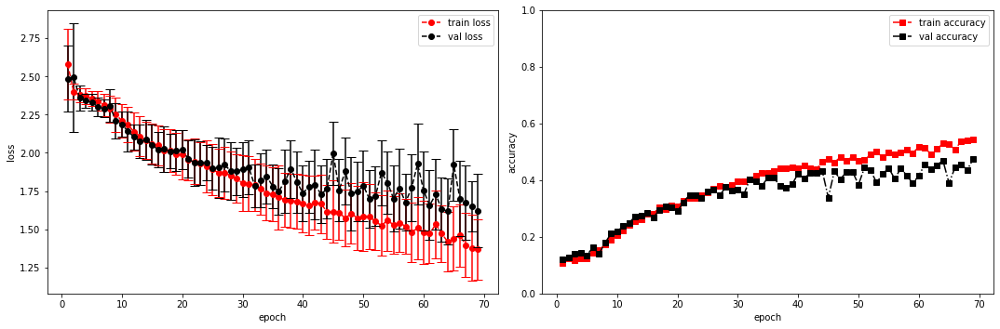

model saved


training epoch:  69
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [70/100], step [1/168],  Loss: 1.4058 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5305061340332031s
Epoch [70/100], step [17/168],  Loss: 1.2684 +/- 0.1790,  accuracy: 0.556640625, time elapsed = 6.2382283210754395s
Epoch [70/100], step [33/168],  Loss: 1.2782 +/- 0.1609,  accuracy: 0.591796875, time elapsed = 6.239486217498779s
Epoch [70/100], step [49/168],  Loss: 1.3460 +/- 0.2130,  accuracy: 0.568359375, time elapsed = 6.238556385040283s
Epoch [70/100], step [65/168],  Loss: 1.3430 +/- 0.2317,  accuracy: 0.564453125, time elapsed = 6.239413022994995s
Epoch [70/100], step [81/168],  Loss: 1.4100 +/- 0.1615,  accuracy: 0.54296875, time elapsed = 6.251364231109619s
Epoch [70/100], step [97/168],  Loss: 1.2597 +/- 0.1658,  accuracy: 0.587890625, time elapsed = 6.238957643508911s
Epoch [70/100], step [113/168],  Loss: 1.3637 +/- 0.1796,  accuracy: 0.560546875, time elapsed = 6.2386322021484375s
Epoch [70/100], step [129/168],  Loss: 1.3565 +/- 0.1745,  accuracy: 0.5625, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.560,  precision = 0.560 recall = 0.560 f1 = 0.560 ::: val: acc = 0.458,  precision = 0.458 recall = 0.458 time elapsed = 70.50076842308044s


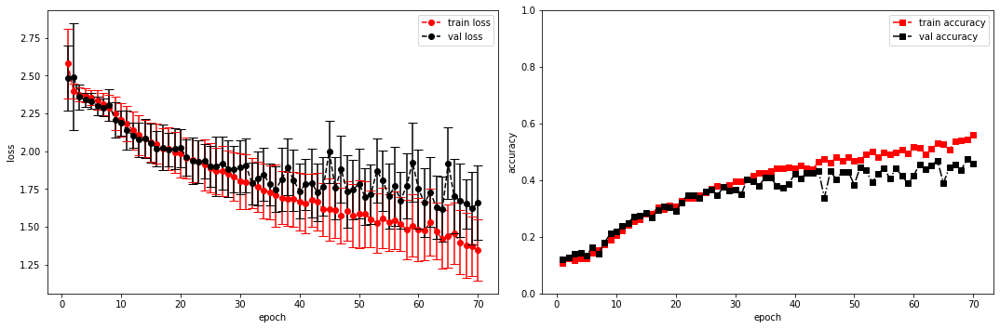

model saved


training epoch:  70
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [71/100], step [1/168],  Loss: 1.7150 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5393378734588623s
Epoch [71/100], step [17/168],  Loss: 1.3434 +/- 0.1688,  accuracy: 0.56640625, time elapsed = 6.237201929092407s
Epoch [71/100], step [33/168],  Loss: 1.3011 +/- 0.2108,  accuracy: 0.56640625, time elapsed = 6.237997055053711s
Epoch [71/100], step [49/168],  Loss: 1.3098 +/- 0.1645,  accuracy: 0.5546875, time elapsed = 6.239881277084351s
Epoch [71/100], step [65/168],  Loss: 1.2529 +/- 0.1391,  accuracy: 0.572265625, time elapsed = 6.238571405410767s
Epoch [71/100], step [81/168],  Loss: 1.4089 +/- 0.1592,  accuracy: 0.564453125, time elapsed = 6.2378034591674805s
Epoch [71/100], step [97/168],  Loss: 1.3587 +/- 0.2060,  accuracy: 0.54296875, time elapsed = 6.238185882568359s
Epoch [71/100], step [113/168],  Loss: 2.0387 +/- 0.4769,  accuracy: 0.32421875, time elapsed = 6.2381227016448975s
Epoch [71/100], step [129/168],  Loss: 2.5168 +/- 0.2024,  accuracy: 0.20703125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.415,  precision = 0.415 recall = 0.415 f1 = 0.415 ::: val: acc = 0.165,  precision = 0.165 recall = 0.165 time elapsed = 70.48998808860779s


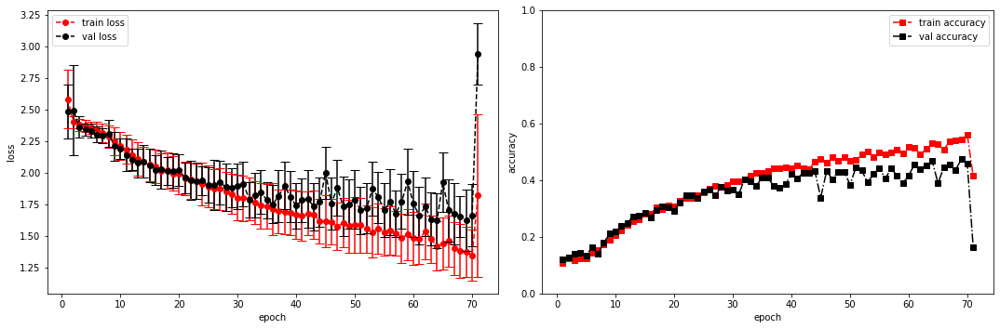

model saved
model saved


training epoch:  71
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [72/100], step [1/168],  Loss: 2.7944 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5421817302703857s
Epoch [72/100], step [17/168],  Loss: 2.3598 +/- 0.2120,  accuracy: 0.23046875, time elapsed = 6.24153995513916s
Epoch [72/100], step [33/168],  Loss: 2.2697 +/- 0.2192,  accuracy: 0.208984375, time elapsed = 6.240586996078491s
Epoch [72/100], step [49/168],  Loss: 2.2299 +/- 0.2239,  accuracy: 0.228515625, time elapsed = 6.238565444946289s
Epoch [72/100], step [65/168],  Loss: 2.1232 +/- 0.1498,  accuracy: 0.263671875, time elapsed = 6.23992133140564s
Epoch [72/100], step [81/168],  Loss: 2.0661 +/- 0.1810,  accuracy: 0.26953125, time elapsed = 6.2392473220825195s
Epoch [72/100], step [97/168],  Loss: 2.0263 +/- 0.1572,  accuracy: 0.28125, time elapsed = 6.238711595535278s
Epoch [72/100], step [113/168],  Loss: 2.0452 +/- 0.1711,  accuracy: 0.265625, time elapsed = 6.23899245262146s
Epoch [72/100], step [129/168],  Loss: 2.0873 +/- 0.2573,  accuracy: 0.287109375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.269,  precision = 0.269 recall = 0.269 f1 = 0.269 ::: val: acc = 0.298,  precision = 0.298 recall = 0.298 time elapsed = 70.50693249702454s


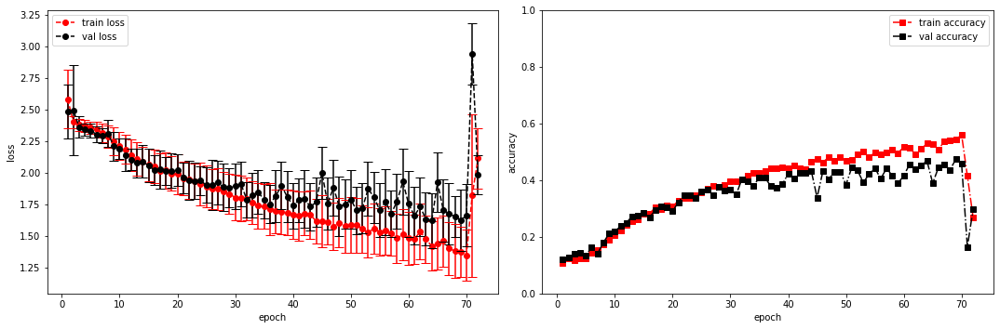

model saved


training epoch:  72
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [73/100], step [1/168],  Loss: 1.7626 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5360474586486816s
Epoch [73/100], step [17/168],  Loss: 1.9505 +/- 0.1847,  accuracy: 0.33203125, time elapsed = 6.237953424453735s
Epoch [73/100], step [33/168],  Loss: 1.9377 +/- 0.1757,  accuracy: 0.33984375, time elapsed = 6.236561298370361s
Epoch [73/100], step [49/168],  Loss: 1.9295 +/- 0.2019,  accuracy: 0.353515625, time elapsed = 6.236864328384399s
Epoch [73/100], step [65/168],  Loss: 1.9055 +/- 0.1839,  accuracy: 0.34765625, time elapsed = 6.237744092941284s
Epoch [73/100], step [81/168],  Loss: 1.9215 +/- 0.1573,  accuracy: 0.31640625, time elapsed = 6.238081455230713s
Epoch [73/100], step [97/168],  Loss: 2.0651 +/- 0.1784,  accuracy: 0.296875, time elapsed = 6.236691474914551s
Epoch [73/100], step [113/168],  Loss: 2.0263 +/- 0.2281,  accuracy: 0.291015625, time elapsed = 6.2365193367004395s
Epoch [73/100], step [129/168],  Loss: 2.3738 +/- 0.2101,  accuracy: 0.20703125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.281,  precision = 0.281 recall = 0.281 f1 = 0.281 ::: val: acc = 0.114,  precision = 0.114 recall = 0.114 time elapsed = 70.48227000236511s


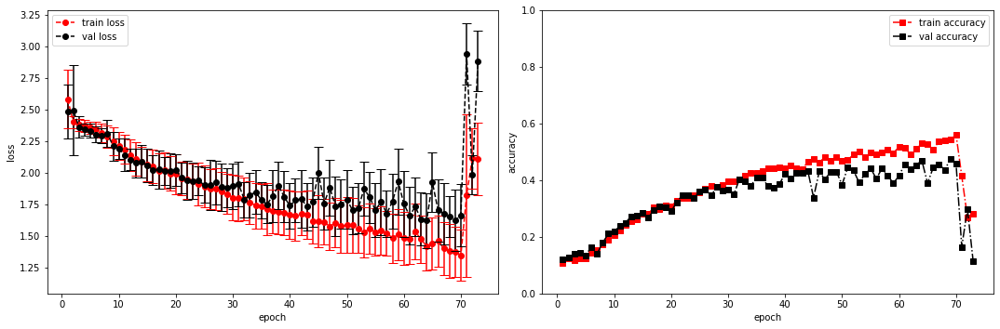

model saved
model saved


training epoch:  73
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [74/100], step [1/168],  Loss: 2.3066 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.533855676651001s
Epoch [74/100], step [17/168],  Loss: 2.3341 +/- 0.2135,  accuracy: 0.208984375, time elapsed = 6.238072156906128s
Epoch [74/100], step [33/168],  Loss: 2.1525 +/- 0.0983,  accuracy: 0.25, time elapsed = 6.239245414733887s
Epoch [74/100], step [49/168],  Loss: 2.1684 +/- 0.1321,  accuracy: 0.23046875, time elapsed = 6.238966464996338s
Epoch [74/100], step [65/168],  Loss: 2.1917 +/- 0.1338,  accuracy: 0.201171875, time elapsed = 6.2391908168792725s
Epoch [74/100], step [81/168],  Loss: 2.2728 +/- 0.1189,  accuracy: 0.189453125, time elapsed = 6.238683700561523s
Epoch [74/100], step [97/168],  Loss: 2.1892 +/- 0.1515,  accuracy: 0.25390625, time elapsed = 6.238113641738892s
Epoch [74/100], step [113/168],  Loss: 2.1515 +/- 0.1645,  accuracy: 0.255859375, time elapsed = 6.24011754989624s
Epoch [74/100], step [129/168],  Loss: 2.1617 +/- 0.1520,  accuracy: 0.265625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.236,  precision = 0.236 recall = 0.236 f1 = 0.236 ::: val: acc = 0.241,  precision = 0.241 recall = 0.241 time elapsed = 70.4822518825531s


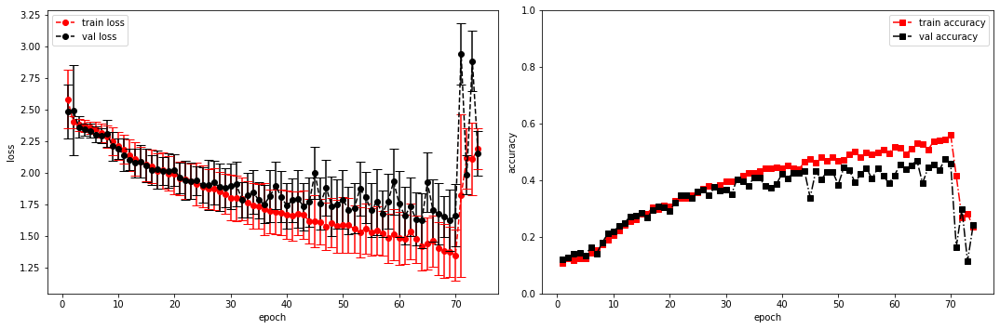

model saved


training epoch:  74
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [75/100], step [1/168],  Loss: 2.1996 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5346512794494629s
Epoch [75/100], step [17/168],  Loss: 2.1554 +/- 0.1913,  accuracy: 0.26953125, time elapsed = 6.2388763427734375s
Epoch [75/100], step [33/168],  Loss: 2.1412 +/- 0.1641,  accuracy: 0.25390625, time elapsed = 6.237144231796265s
Epoch [75/100], step [49/168],  Loss: 2.0250 +/- 0.1730,  accuracy: 0.33203125, time elapsed = 6.236591577529907s
Epoch [75/100], step [65/168],  Loss: 1.9952 +/- 0.1274,  accuracy: 0.296875, time elapsed = 6.2381439208984375s
Epoch [75/100], step [81/168],  Loss: 2.0635 +/- 0.1388,  accuracy: 0.26953125, time elapsed = 6.244816064834595s
Epoch [75/100], step [97/168],  Loss: 2.1042 +/- 0.1988,  accuracy: 0.2578125, time elapsed = 6.244617938995361s
Epoch [75/100], step [113/168],  Loss: 2.0529 +/- 0.1540,  accuracy: 0.267578125, time elapsed = 6.23901629447937s
Epoch [75/100], step [129/168],  Loss: 2.0303 +/- 0.1595,  accuracy: 0.28125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.283,  precision = 0.283 recall = 0.283 f1 = 0.283 ::: val: acc = 0.302,  precision = 0.302 recall = 0.302 time elapsed = 70.49664831161499s


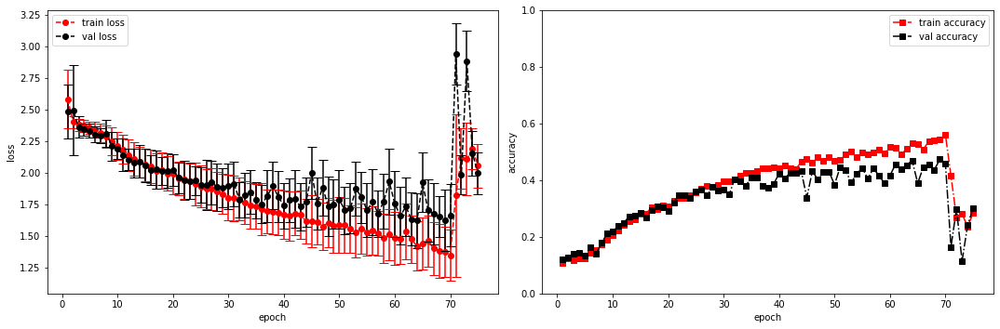

model saved


training epoch:  75
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [76/100], step [1/168],  Loss: 2.1222 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5379102230072021s
Epoch [76/100], step [17/168],  Loss: 1.9593 +/- 0.1737,  accuracy: 0.318359375, time elapsed = 6.2385289669036865s
Epoch [76/100], step [33/168],  Loss: 1.9859 +/- 0.1609,  accuracy: 0.3046875, time elapsed = 6.237408638000488s
Epoch [76/100], step [49/168],  Loss: 1.9401 +/- 0.1431,  accuracy: 0.32421875, time elapsed = 6.242128133773804s
Epoch [76/100], step [65/168],  Loss: 1.9611 +/- 0.1759,  accuracy: 0.328125, time elapsed = 6.239201068878174s
Epoch [76/100], step [81/168],  Loss: 1.9329 +/- 0.1602,  accuracy: 0.32421875, time elapsed = 6.23918604850769s
Epoch [76/100], step [97/168],  Loss: 1.8947 +/- 0.0992,  accuracy: 0.3359375, time elapsed = 6.2384843826293945s
Epoch [76/100], step [113/168],  Loss: 2.0504 +/- 0.1871,  accuracy: 0.298828125, time elapsed = 6.238247871398926s
Epoch [76/100], step [129/168],  Loss: 1.9658 +/- 0.1547,  accuracy: 0.322265625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.314,  precision = 0.314 recall = 0.314 f1 = 0.314 ::: val: acc = 0.289,  precision = 0.289 recall = 0.289 time elapsed = 70.49486589431763s


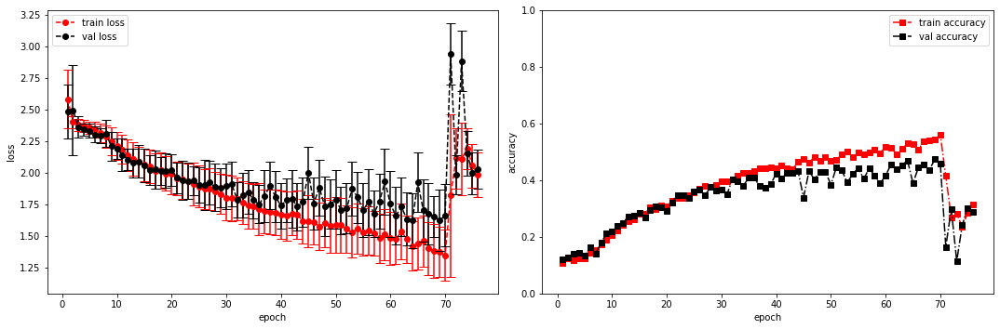

model saved


training epoch:  76
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [77/100], step [1/168],  Loss: 1.9334 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5360572338104248s
Epoch [77/100], step [17/168],  Loss: 1.9778 +/- 0.1378,  accuracy: 0.32421875, time elapsed = 6.240095615386963s
Epoch [77/100], step [33/168],  Loss: 1.9670 +/- 0.1204,  accuracy: 0.3125, time elapsed = 6.253042221069336s
Epoch [77/100], step [49/168],  Loss: 1.8405 +/- 0.1350,  accuracy: 0.36328125, time elapsed = 6.238437175750732s
Epoch [77/100], step [65/168],  Loss: 1.9109 +/- 0.1006,  accuracy: 0.302734375, time elapsed = 6.239123344421387s
Epoch [77/100], step [81/168],  Loss: 1.8898 +/- 0.1730,  accuracy: 0.3515625, time elapsed = 6.23872971534729s
Epoch [77/100], step [97/168],  Loss: 1.8280 +/- 0.1384,  accuracy: 0.37109375, time elapsed = 6.238187551498413s
Epoch [77/100], step [113/168],  Loss: 1.8841 +/- 0.1821,  accuracy: 0.34375, time elapsed = 6.2393200397491455s
Epoch [77/100], step [129/168],  Loss: 1.8797 +/- 0.1737,  accuracy: 0.384765625, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.340,  precision = 0.340 recall = 0.340 f1 = 0.340 ::: val: acc = 0.356,  precision = 0.356 recall = 0.356 time elapsed = 70.50625681877136s


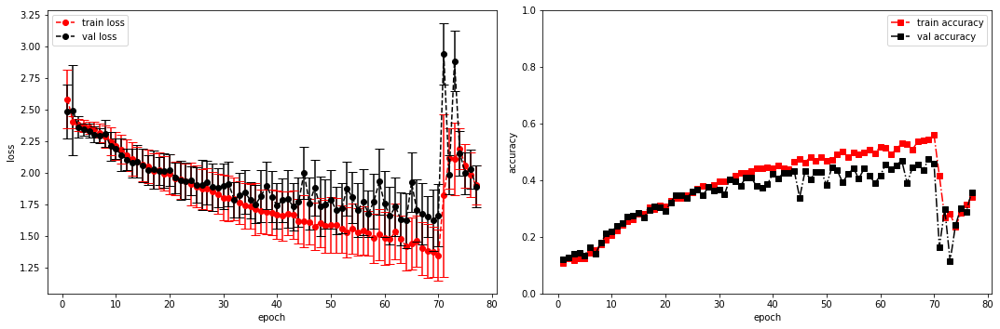

model saved


training epoch:  77
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [78/100], step [1/168],  Loss: 1.8234 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.539848804473877s
Epoch [78/100], step [17/168],  Loss: 1.8761 +/- 0.1505,  accuracy: 0.34765625, time elapsed = 6.2391016483306885s
Epoch [78/100], step [33/168],  Loss: 1.8017 +/- 0.1101,  accuracy: 0.36328125, time elapsed = 6.238111734390259s
Epoch [78/100], step [49/168],  Loss: 1.8406 +/- 0.1679,  accuracy: 0.373046875, time elapsed = 6.239497661590576s
Epoch [78/100], step [65/168],  Loss: 1.8232 +/- 0.1381,  accuracy: 0.361328125, time elapsed = 6.238290548324585s
Epoch [78/100], step [81/168],  Loss: 1.8115 +/- 0.1775,  accuracy: 0.39453125, time elapsed = 6.239166736602783s
Epoch [78/100], step [97/168],  Loss: 1.8563 +/- 0.1258,  accuracy: 0.349609375, time elapsed = 6.23796272277832s
Epoch [78/100], step [113/168],  Loss: 1.9278 +/- 0.2535,  accuracy: 0.341796875, time elapsed = 6.239978790283203s
Epoch [78/100], step [129/168],  Loss: 2.0489 +/- 0.1671,  accuracy: 0.298828125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.350,  precision = 0.350 recall = 0.350 f1 = 0.350 ::: val: acc = 0.330,  precision = 0.330 recall = 0.330 time elapsed = 70.50444793701172s


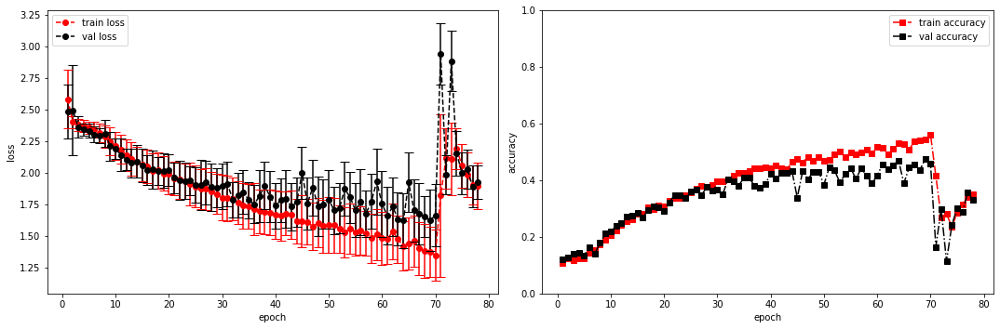

model saved


training epoch:  78
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [79/100], step [1/168],  Loss: 1.8952 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5363969802856445s
Epoch [79/100], step [17/168],  Loss: 1.8437 +/- 0.1538,  accuracy: 0.365234375, time elapsed = 6.2375946044921875s
Epoch [79/100], step [33/168],  Loss: 1.9552 +/- 0.1337,  accuracy: 0.314453125, time elapsed = 6.237142086029053s
Epoch [79/100], step [49/168],  Loss: 1.8754 +/- 0.1801,  accuracy: 0.337890625, time elapsed = 6.239489555358887s
Epoch [79/100], step [65/168],  Loss: 1.9015 +/- 0.1849,  accuracy: 0.349609375, time elapsed = 6.2387003898620605s
Epoch [79/100], step [81/168],  Loss: 1.8424 +/- 0.1826,  accuracy: 0.384765625, time elapsed = 6.238474607467651s
Epoch [79/100], step [97/168],  Loss: 1.8534 +/- 0.1859,  accuracy: 0.357421875, time elapsed = 6.238240718841553s
Epoch [79/100], step [113/168],  Loss: 2.3612 +/- 0.3708,  accuracy: 0.205078125, time elapsed = 6.238374948501587s
Epoch [79/100], step [129/168],  Loss: 2.5752 +/- 0.1772,  accuracy: 0.144531

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.278,  precision = 0.278 recall = 0.278 f1 = 0.278 ::: val: acc = 0.174,  precision = 0.174 recall = 0.174 time elapsed = 70.48789930343628s


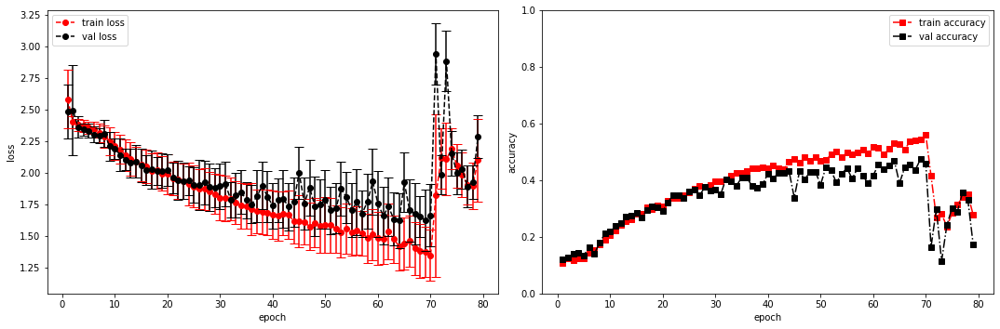

model saved


training epoch:  79
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [80/100], step [1/168],  Loss: 2.3641 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5364851951599121s
Epoch [80/100], step [17/168],  Loss: 2.2288 +/- 0.1617,  accuracy: 0.208984375, time elapsed = 6.239030361175537s
Epoch [80/100], step [33/168],  Loss: 2.1598 +/- 0.0975,  accuracy: 0.205078125, time elapsed = 6.237887382507324s
Epoch [80/100], step [49/168],  Loss: 2.2740 +/- 0.2558,  accuracy: 0.189453125, time elapsed = 6.238537788391113s
Epoch [80/100], step [65/168],  Loss: 2.3558 +/- 0.1675,  accuracy: 0.162109375, time elapsed = 6.240201711654663s
Epoch [80/100], step [81/168],  Loss: 2.3686 +/- 0.2028,  accuracy: 0.1875, time elapsed = 6.239323139190674s
Epoch [80/100], step [97/168],  Loss: 2.8376 +/- 0.2920,  accuracy: 0.0859375, time elapsed = 6.251414775848389s
Epoch [80/100], step [113/168],  Loss: 2.4659 +/- 0.2212,  accuracy: 0.16796875, time elapsed = 6.245882987976074s
Epoch [80/100], step [129/168],  Loss: 2.2806 +/- 0.0640,  accuracy: 0.185546875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.179,  precision = 0.179 recall = 0.179 f1 = 0.179 ::: val: acc = 0.236,  precision = 0.236 recall = 0.236 time elapsed = 70.5092568397522s


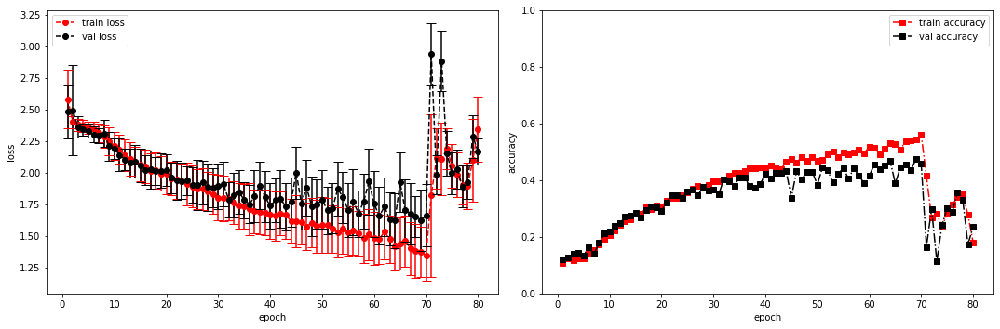

model saved


training epoch:  80
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [81/100], step [1/168],  Loss: 2.0497 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5369236469268799s
Epoch [81/100], step [17/168],  Loss: 2.1795 +/- 0.1590,  accuracy: 0.224609375, time elapsed = 6.237799406051636s
Epoch [81/100], step [33/168],  Loss: 2.1785 +/- 0.1043,  accuracy: 0.224609375, time elapsed = 6.237342357635498s
Epoch [81/100], step [49/168],  Loss: 2.1794 +/- 0.0635,  accuracy: 0.171875, time elapsed = 6.237544536590576s
Epoch [81/100], step [65/168],  Loss: 2.1119 +/- 0.1071,  accuracy: 0.228515625, time elapsed = 6.240379333496094s
Epoch [81/100], step [81/168],  Loss: 2.1015 +/- 0.1333,  accuracy: 0.240234375, time elapsed = 6.23840594291687s
Epoch [81/100], step [97/168],  Loss: 2.5305 +/- 0.2315,  accuracy: 0.123046875, time elapsed = 6.238245248794556s
Epoch [81/100], step [113/168],  Loss: 2.2308 +/- 0.1148,  accuracy: 0.18359375, time elapsed = 6.238565683364868s
Epoch [81/100], step [129/168],  Loss: 2.2318 +/- 0.1364,  accuracy: 0.171875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.203,  precision = 0.203 recall = 0.203 f1 = 0.203 ::: val: acc = 0.148,  precision = 0.148 recall = 0.148 time elapsed = 70.47924423217773s


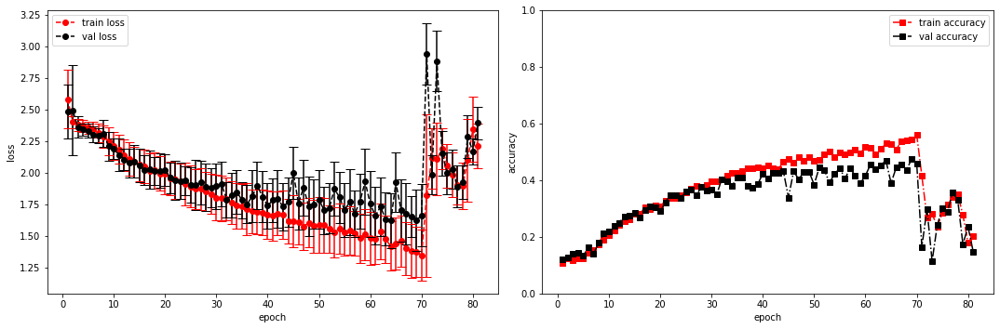

model saved


training epoch:  81
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [82/100], step [1/168],  Loss: 1.9000 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5379533767700195s
Epoch [82/100], step [17/168],  Loss: 2.2105 +/- 0.1125,  accuracy: 0.193359375, time elapsed = 6.239502668380737s
Epoch [82/100], step [33/168],  Loss: 2.1654 +/- 0.1066,  accuracy: 0.212890625, time elapsed = 6.2395665645599365s
Epoch [82/100], step [49/168],  Loss: 2.1785 +/- 0.1289,  accuracy: 0.216796875, time elapsed = 6.25162935256958s
Epoch [82/100], step [65/168],  Loss: 2.1802 +/- 0.1288,  accuracy: 0.19140625, time elapsed = 6.238702058792114s
Epoch [82/100], step [81/168],  Loss: 2.1696 +/- 0.1120,  accuracy: 0.21875, time elapsed = 6.238916635513306s
Epoch [82/100], step [97/168],  Loss: 2.1644 +/- 0.0822,  accuracy: 0.21875, time elapsed = 6.2398762702941895s
Epoch [82/100], step [113/168],  Loss: 2.1184 +/- 0.1135,  accuracy: 0.240234375, time elapsed = 6.238004922866821s
Epoch [82/100], step [129/168],  Loss: 2.1004 +/- 0.1341,  accuracy: 0.251953125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.226,  precision = 0.226 recall = 0.226 f1 = 0.226 ::: val: acc = 0.269,  precision = 0.269 recall = 0.269 time elapsed = 70.50949716567993s


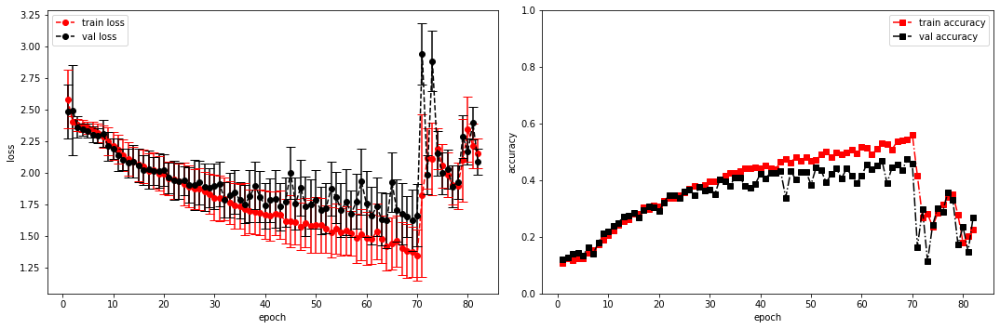

model saved


training epoch:  82
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [83/100], step [1/168],  Loss: 2.0826 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5435402393341064s
Epoch [83/100], step [17/168],  Loss: 2.1073 +/- 0.1175,  accuracy: 0.263671875, time elapsed = 6.239676475524902s
Epoch [83/100], step [33/168],  Loss: 2.0568 +/- 0.1284,  accuracy: 0.287109375, time elapsed = 6.23846173286438s
Epoch [83/100], step [49/168],  Loss: 2.1078 +/- 0.1313,  accuracy: 0.25, time elapsed = 6.238048076629639s
Epoch [83/100], step [65/168],  Loss: 2.0901 +/- 0.1219,  accuracy: 0.2578125, time elapsed = 6.238987445831299s
Epoch [83/100], step [81/168],  Loss: 2.1072 +/- 0.0989,  accuracy: 0.240234375, time elapsed = 6.237652063369751s
Epoch [83/100], step [97/168],  Loss: 2.1365 +/- 0.1264,  accuracy: 0.234375, time elapsed = 6.238501787185669s
Epoch [83/100], step [113/168],  Loss: 2.0795 +/- 0.1159,  accuracy: 0.251953125, time elapsed = 6.238183259963989s
Epoch [83/100], step [129/168],  Loss: 2.1107 +/- 0.0974,  accuracy: 0.267578125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.258,  precision = 0.258 recall = 0.258 f1 = 0.258 ::: val: acc = 0.255,  precision = 0.255 recall = 0.255 time elapsed = 70.5326714515686s


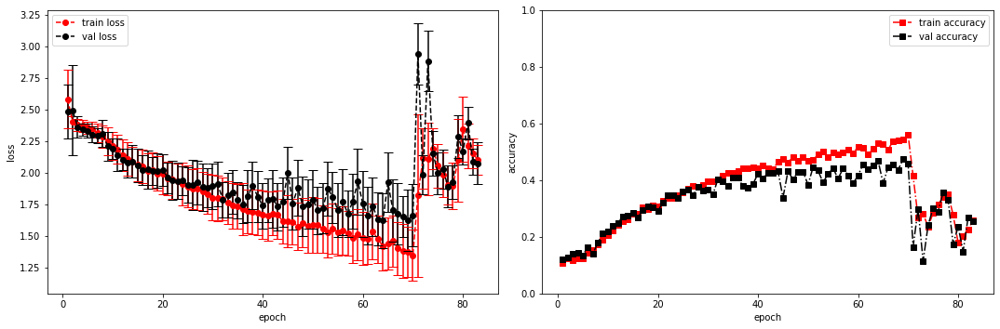

model saved


training epoch:  83
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [84/100], step [1/168],  Loss: 2.0186 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5386946201324463s
Epoch [84/100], step [17/168],  Loss: 2.0692 +/- 0.1590,  accuracy: 0.2578125, time elapsed = 6.239545822143555s
Epoch [84/100], step [33/168],  Loss: 2.0446 +/- 0.1343,  accuracy: 0.255859375, time elapsed = 6.2382941246032715s
Epoch [84/100], step [49/168],  Loss: 2.1156 +/- 0.0988,  accuracy: 0.205078125, time elapsed = 6.239106893539429s
Epoch [84/100], step [65/168],  Loss: 2.0327 +/- 0.1266,  accuracy: 0.294921875, time elapsed = 6.237964630126953s
Epoch [84/100], step [81/168],  Loss: 2.0880 +/- 0.1102,  accuracy: 0.216796875, time elapsed = 6.238007068634033s
Epoch [84/100], step [97/168],  Loss: 2.0595 +/- 0.0897,  accuracy: 0.2578125, time elapsed = 6.238025665283203s
Epoch [84/100], step [113/168],  Loss: 2.0664 +/- 0.1221,  accuracy: 0.26953125, time elapsed = 6.23751974105835s
Epoch [84/100], step [129/168],  Loss: 2.0824 +/- 0.1307,  accuracy: 0.2578125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.258,  precision = 0.258 recall = 0.258 f1 = 0.258 ::: val: acc = 0.291,  precision = 0.291 recall = 0.291 time elapsed = 70.48323249816895s


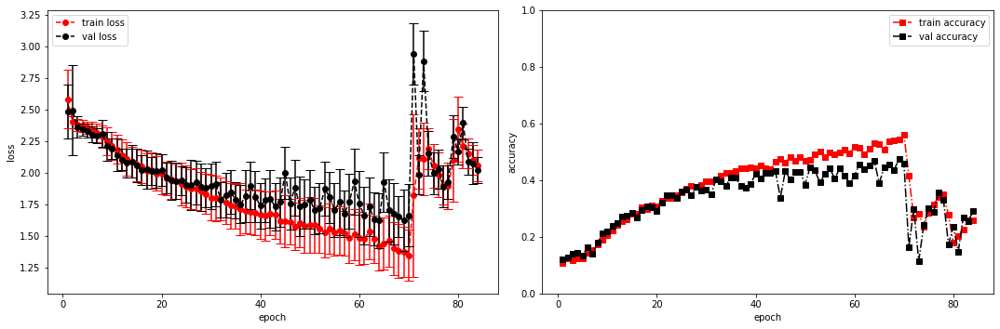

model saved


training epoch:  84
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [85/100], step [1/168],  Loss: 1.8250 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5384669303894043s
Epoch [85/100], step [17/168],  Loss: 2.0422 +/- 0.1669,  accuracy: 0.255859375, time elapsed = 6.237547397613525s
Epoch [85/100], step [33/168],  Loss: 2.1669 +/- 0.2319,  accuracy: 0.240234375, time elapsed = 6.238149404525757s
Epoch [85/100], step [49/168],  Loss: 2.0347 +/- 0.1915,  accuracy: 0.28125, time elapsed = 6.2384984493255615s
Epoch [85/100], step [65/168],  Loss: 2.0104 +/- 0.1263,  accuracy: 0.291015625, time elapsed = 6.237561464309692s
Epoch [85/100], step [81/168],  Loss: 2.0754 +/- 0.1288,  accuracy: 0.2578125, time elapsed = 6.23742413520813s
Epoch [85/100], step [97/168],  Loss: 2.1779 +/- 0.1584,  accuracy: 0.23828125, time elapsed = 6.238652944564819s
Epoch [85/100], step [113/168],  Loss: 2.1089 +/- 0.1358,  accuracy: 0.263671875, time elapsed = 6.260299921035767s
Epoch [85/100], step [129/168],  Loss: 2.0957 +/- 0.1095,  accuracy: 0.255859375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.268,  precision = 0.268 recall = 0.268 f1 = 0.268 ::: val: acc = 0.295,  precision = 0.295 recall = 0.295 time elapsed = 70.50290417671204s


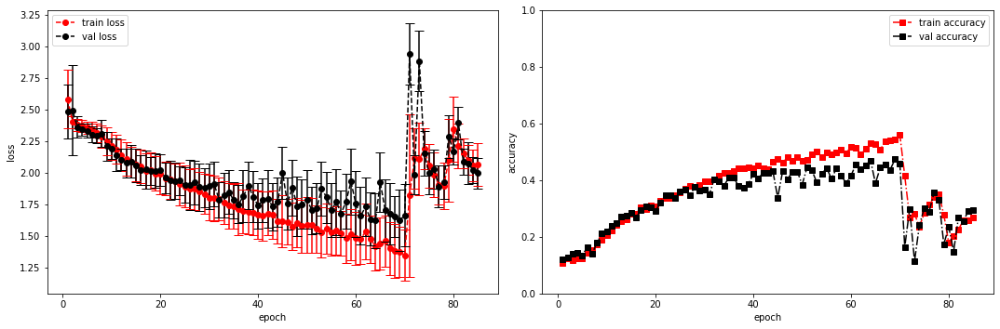

model saved


training epoch:  85
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [86/100], step [1/168],  Loss: 2.1141 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.541060209274292s
Epoch [86/100], step [17/168],  Loss: 2.0077 +/- 0.1722,  accuracy: 0.275390625, time elapsed = 6.235662937164307s
Epoch [86/100], step [33/168],  Loss: 1.9998 +/- 0.0996,  accuracy: 0.322265625, time elapsed = 6.236692190170288s
Epoch [86/100], step [49/168],  Loss: 1.9851 +/- 0.1352,  accuracy: 0.287109375, time elapsed = 6.235703229904175s
Epoch [86/100], step [65/168],  Loss: 1.8827 +/- 0.0735,  accuracy: 0.337890625, time elapsed = 6.234238624572754s
Epoch [86/100], step [81/168],  Loss: 1.9433 +/- 0.1765,  accuracy: 0.330078125, time elapsed = 6.237271308898926s
Epoch [86/100], step [97/168],  Loss: 2.0015 +/- 0.1543,  accuracy: 0.271484375, time elapsed = 6.237337112426758s
Epoch [86/100], step [113/168],  Loss: 2.0033 +/- 0.2174,  accuracy: 0.306640625, time elapsed = 6.2375102043151855s
Epoch [86/100], step [129/168],  Loss: 1.9944 +/- 0.1073,  accuracy: 0.287109375

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.293,  precision = 0.293 recall = 0.293 f1 = 0.293 ::: val: acc = 0.265,  precision = 0.265 recall = 0.265 time elapsed = 70.47820973396301s


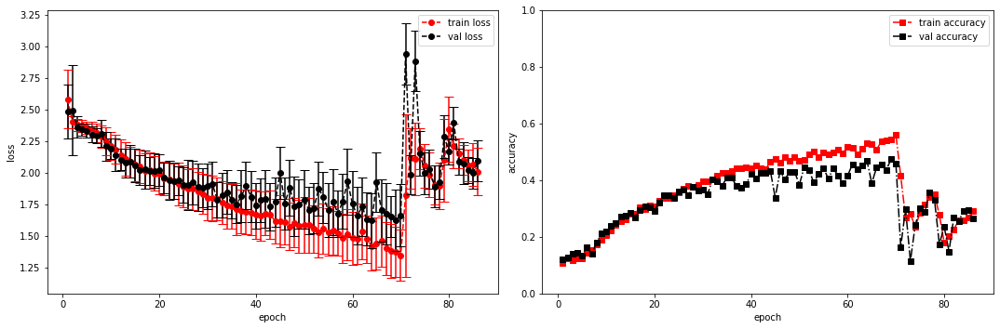

model saved


training epoch:  86
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [87/100], step [1/168],  Loss: 2.2011 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5391814708709717s
Epoch [87/100], step [17/168],  Loss: 1.9841 +/- 0.1394,  accuracy: 0.29296875, time elapsed = 6.2362611293792725s
Epoch [87/100], step [33/168],  Loss: 1.9866 +/- 0.1060,  accuracy: 0.275390625, time elapsed = 6.237227916717529s
Epoch [87/100], step [49/168],  Loss: 1.9724 +/- 0.1352,  accuracy: 0.294921875, time elapsed = 6.2401838302612305s
Epoch [87/100], step [65/168],  Loss: 2.0867 +/- 0.1613,  accuracy: 0.28515625, time elapsed = 6.246476888656616s
Epoch [87/100], step [81/168],  Loss: 2.0290 +/- 0.1298,  accuracy: 0.267578125, time elapsed = 6.237668991088867s
Epoch [87/100], step [97/168],  Loss: 1.9815 +/- 0.1385,  accuracy: 0.314453125, time elapsed = 6.23784613609314s
Epoch [87/100], step [113/168],  Loss: 1.9994 +/- 0.1354,  accuracy: 0.31640625, time elapsed = 6.2375311851501465s
Epoch [87/100], step [129/168],  Loss: 2.0014 +/- 0.0977,  accuracy: 0.29296875, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.294,  precision = 0.294 recall = 0.294 f1 = 0.294 ::: val: acc = 0.327,  precision = 0.327 recall = 0.327 time elapsed = 70.48312091827393s


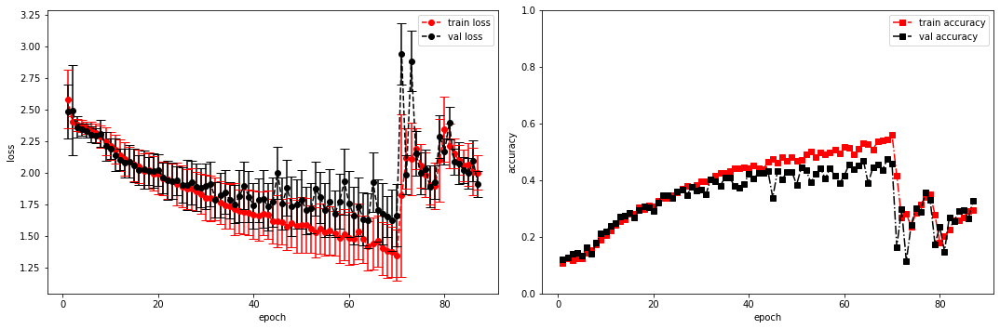

model saved


training epoch:  87
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [88/100], step [1/168],  Loss: 1.9650 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5416288375854492s
Epoch [88/100], step [17/168],  Loss: 1.8914 +/- 0.1157,  accuracy: 0.3203125, time elapsed = 6.2393763065338135s
Epoch [88/100], step [33/168],  Loss: 1.9344 +/- 0.0928,  accuracy: 0.30078125, time elapsed = 6.2376251220703125s
Epoch [88/100], step [49/168],  Loss: 1.9203 +/- 0.0885,  accuracy: 0.30859375, time elapsed = 6.238471031188965s
Epoch [88/100], step [65/168],  Loss: 1.8961 +/- 0.1910,  accuracy: 0.353515625, time elapsed = 6.2386181354522705s
Epoch [88/100], step [81/168],  Loss: 1.9186 +/- 0.1322,  accuracy: 0.34375, time elapsed = 6.238416433334351s
Epoch [88/100], step [97/168],  Loss: 1.9535 +/- 0.1333,  accuracy: 0.322265625, time elapsed = 6.238575458526611s
Epoch [88/100], step [113/168],  Loss: 1.9732 +/- 0.1865,  accuracy: 0.322265625, time elapsed = 6.238206624984741s
Epoch [88/100], step [129/168],  Loss: 1.9771 +/- 0.1389,  accuracy: 0.32421875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.326,  precision = 0.326 recall = 0.326 f1 = 0.326 ::: val: acc = 0.349,  precision = 0.349 recall = 0.349 time elapsed = 70.50409603118896s


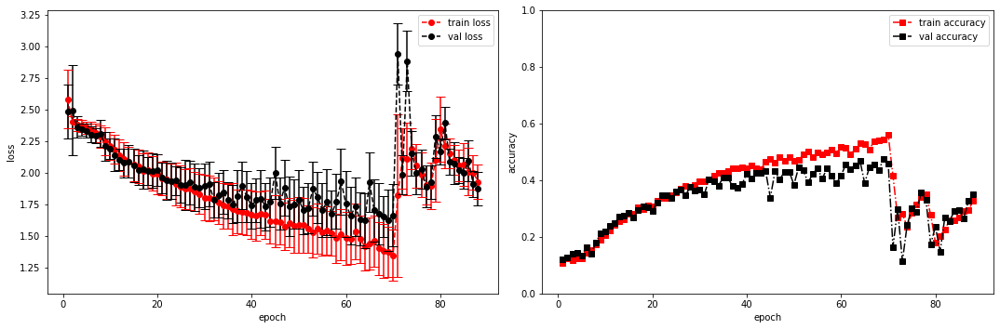

model saved


training epoch:  88
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [89/100], step [1/168],  Loss: 1.7999 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5315554141998291s
Epoch [89/100], step [17/168],  Loss: 1.8738 +/- 0.1309,  accuracy: 0.36328125, time elapsed = 6.238027572631836s
Epoch [89/100], step [33/168],  Loss: 1.8186 +/- 0.1087,  accuracy: 0.38671875, time elapsed = 6.236729383468628s
Epoch [89/100], step [49/168],  Loss: 1.9382 +/- 0.1192,  accuracy: 0.33984375, time elapsed = 6.238762855529785s
Epoch [89/100], step [65/168],  Loss: 1.8893 +/- 0.1646,  accuracy: 0.33984375, time elapsed = 6.238276481628418s
Epoch [89/100], step [81/168],  Loss: 1.9190 +/- 0.1752,  accuracy: 0.326171875, time elapsed = 6.23892617225647s
Epoch [89/100], step [97/168],  Loss: 1.9175 +/- 0.1416,  accuracy: 0.33984375, time elapsed = 6.237471342086792s
Epoch [89/100], step [113/168],  Loss: 1.9580 +/- 0.1913,  accuracy: 0.314453125, time elapsed = 6.2373247146606445s
Epoch [89/100], step [129/168],  Loss: 1.9100 +/- 0.1499,  accuracy: 0.310546875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.342,  precision = 0.342 recall = 0.342 f1 = 0.342 ::: val: acc = 0.302,  precision = 0.302 recall = 0.302 time elapsed = 70.47118306159973s


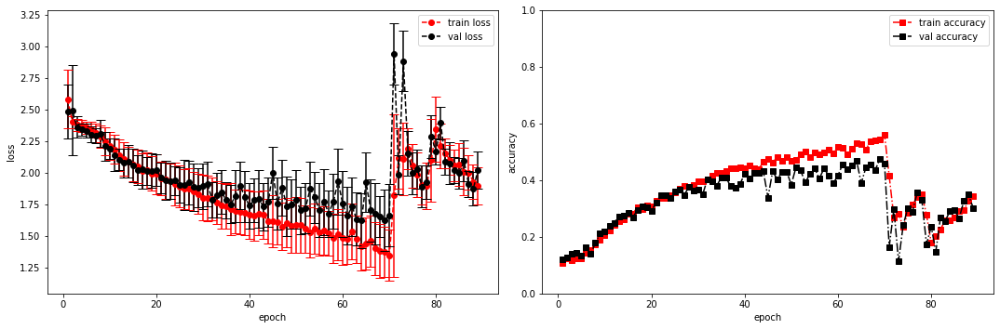

model saved


training epoch:  89
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [90/100], step [1/168],  Loss: 1.7991 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.533606767654419s
Epoch [90/100], step [17/168],  Loss: 1.8066 +/- 0.1066,  accuracy: 0.390625, time elapsed = 6.236572742462158s
Epoch [90/100], step [33/168],  Loss: 1.8514 +/- 0.1355,  accuracy: 0.392578125, time elapsed = 6.238005876541138s
Epoch [90/100], step [49/168],  Loss: 1.8474 +/- 0.1226,  accuracy: 0.357421875, time elapsed = 6.238162994384766s
Epoch [90/100], step [65/168],  Loss: 1.8017 +/- 0.1551,  accuracy: 0.376953125, time elapsed = 6.23627781867981s
Epoch [90/100], step [81/168],  Loss: 1.9077 +/- 0.1634,  accuracy: 0.337890625, time elapsed = 6.237076759338379s
Epoch [90/100], step [97/168],  Loss: 1.8323 +/- 0.0849,  accuracy: 0.375, time elapsed = 6.2374866008758545s
Epoch [90/100], step [113/168],  Loss: 1.8254 +/- 0.1568,  accuracy: 0.349609375, time elapsed = 6.2383716106414795s
Epoch [90/100], step [129/168],  Loss: 1.8940 +/- 0.2065,  accuracy: 0.3515625, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.369,  precision = 0.369 recall = 0.369 f1 = 0.369 ::: val: acc = 0.324,  precision = 0.324 recall = 0.324 time elapsed = 70.491370677948s


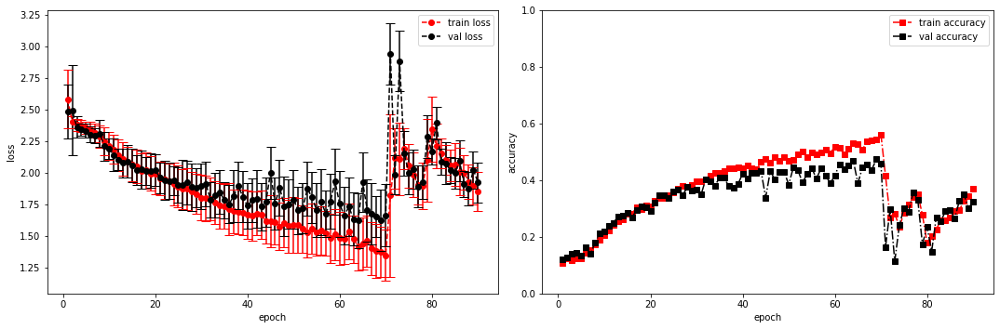

model saved


training epoch:  90
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [91/100], step [1/168],  Loss: 1.9700 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5362019538879395s
Epoch [91/100], step [17/168],  Loss: 1.8702 +/- 0.1488,  accuracy: 0.341796875, time elapsed = 6.239271402359009s
Epoch [91/100], step [33/168],  Loss: 1.7926 +/- 0.1148,  accuracy: 0.396484375, time elapsed = 6.239336252212524s
Epoch [91/100], step [49/168],  Loss: 1.7751 +/- 0.1864,  accuracy: 0.43359375, time elapsed = 6.238765001296997s
Epoch [91/100], step [65/168],  Loss: 1.8219 +/- 0.2149,  accuracy: 0.37109375, time elapsed = 6.237903833389282s
Epoch [91/100], step [81/168],  Loss: 1.8393 +/- 0.1872,  accuracy: 0.37109375, time elapsed = 6.23729395866394s
Epoch [91/100], step [97/168],  Loss: 1.8717 +/- 0.1364,  accuracy: 0.345703125, time elapsed = 6.239794969558716s
Epoch [91/100], step [113/168],  Loss: 1.7776 +/- 0.1571,  accuracy: 0.3828125, time elapsed = 6.2378151416778564s
Epoch [91/100], step [129/168],  Loss: 1.8323 +/- 0.1737,  accuracy: 0.373046875, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.383,  precision = 0.383 recall = 0.383 f1 = 0.383 ::: val: acc = 0.345,  precision = 0.345 recall = 0.345 time elapsed = 70.48758292198181s


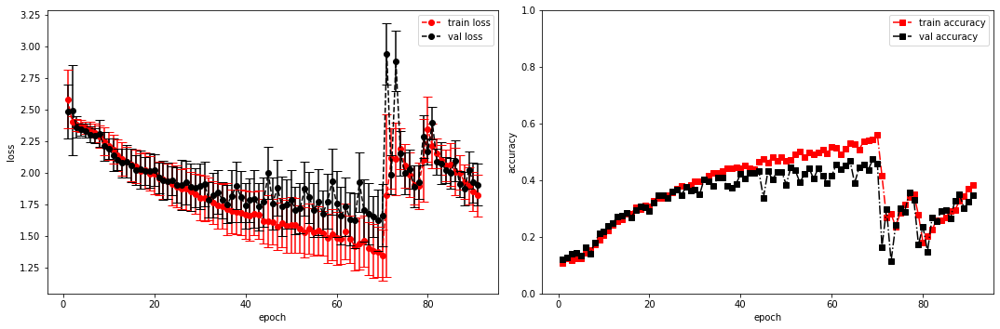

model saved


training epoch:  91
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [92/100], step [1/168],  Loss: 1.7058 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5436816215515137s
Epoch [92/100], step [17/168],  Loss: 1.6949 +/- 0.1295,  accuracy: 0.431640625, time elapsed = 6.238225221633911s
Epoch [92/100], step [33/168],  Loss: 1.7510 +/- 0.1899,  accuracy: 0.40234375, time elapsed = 6.239672899246216s
Epoch [92/100], step [49/168],  Loss: 1.8278 +/- 0.1963,  accuracy: 0.369140625, time elapsed = 6.2379515171051025s
Epoch [92/100], step [65/168],  Loss: 1.7872 +/- 0.1655,  accuracy: 0.404296875, time elapsed = 6.240957975387573s
Epoch [92/100], step [81/168],  Loss: 1.8135 +/- 0.1712,  accuracy: 0.37890625, time elapsed = 6.2490339279174805s
Epoch [92/100], step [97/168],  Loss: 1.7677 +/- 0.0995,  accuracy: 0.38671875, time elapsed = 6.239331245422363s
Epoch [92/100], step [113/168],  Loss: 1.8815 +/- 0.1909,  accuracy: 0.39453125, time elapsed = 6.238940477371216s
Epoch [92/100], step [129/168],  Loss: 1.8641 +/- 0.1301,  accuracy: 0.333984375,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.381,  precision = 0.381 recall = 0.381 f1 = 0.381 ::: val: acc = 0.376,  precision = 0.376 recall = 0.376 time elapsed = 70.5024642944336s


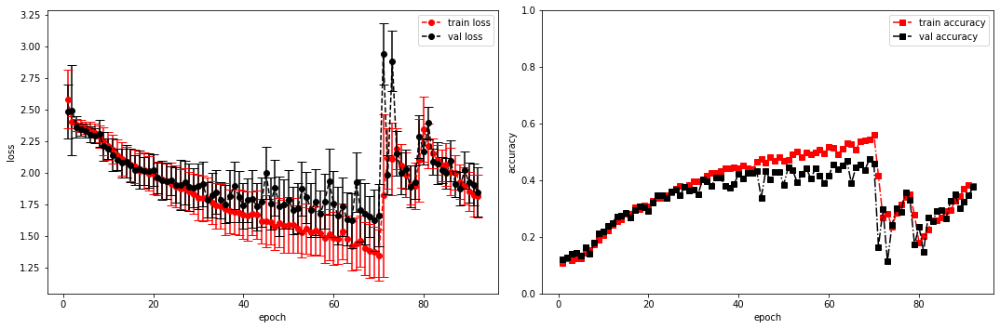

model saved


training epoch:  92
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [93/100], step [1/168],  Loss: 1.6300 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5300612449645996s
Epoch [93/100], step [17/168],  Loss: 1.8515 +/- 0.1274,  accuracy: 0.37109375, time elapsed = 6.238435983657837s
Epoch [93/100], step [33/168],  Loss: 1.8080 +/- 0.1602,  accuracy: 0.3515625, time elapsed = 6.240335941314697s
Epoch [93/100], step [49/168],  Loss: 1.7774 +/- 0.1872,  accuracy: 0.408203125, time elapsed = 6.2383482456207275s
Epoch [93/100], step [65/168],  Loss: 1.7774 +/- 0.1544,  accuracy: 0.3984375, time elapsed = 6.238190174102783s
Epoch [93/100], step [81/168],  Loss: 1.7507 +/- 0.1266,  accuracy: 0.40625, time elapsed = 6.239045143127441s
Epoch [93/100], step [97/168],  Loss: 1.7709 +/- 0.1644,  accuracy: 0.390625, time elapsed = 6.238633394241333s
Epoch [93/100], step [113/168],  Loss: 1.8665 +/- 0.2086,  accuracy: 0.384765625, time elapsed = 6.238263368606567s
Epoch [93/100], step [129/168],  Loss: 1.9349 +/- 0.2088,  accuracy: 0.33203125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.372,  precision = 0.372 recall = 0.372 f1 = 0.372 ::: val: acc = 0.353,  precision = 0.353 recall = 0.353 time elapsed = 70.48319864273071s


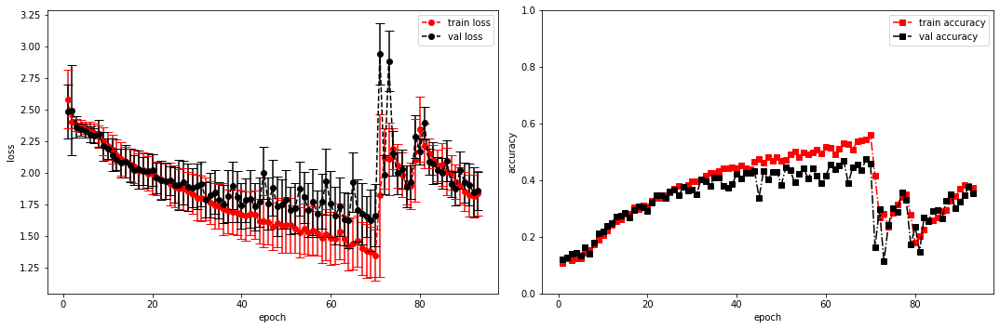

model saved


training epoch:  93
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [94/100], step [1/168],  Loss: 1.6470 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5343954563140869s
Epoch [94/100], step [17/168],  Loss: 1.8340 +/- 0.1976,  accuracy: 0.376953125, time elapsed = 6.24862813949585s
Epoch [94/100], step [33/168],  Loss: 1.8681 +/- 0.1177,  accuracy: 0.341796875, time elapsed = 6.236138820648193s
Epoch [94/100], step [49/168],  Loss: 1.7963 +/- 0.1291,  accuracy: 0.375, time elapsed = 6.237389087677002s
Epoch [94/100], step [65/168],  Loss: 1.8485 +/- 0.2062,  accuracy: 0.3515625, time elapsed = 6.236016511917114s
Epoch [94/100], step [81/168],  Loss: 1.8110 +/- 0.1752,  accuracy: 0.384765625, time elapsed = 6.236590385437012s
Epoch [94/100], step [97/168],  Loss: 1.8561 +/- 0.1347,  accuracy: 0.37890625, time elapsed = 6.236466646194458s
Epoch [94/100], step [113/168],  Loss: 1.8796 +/- 0.1729,  accuracy: 0.35546875, time elapsed = 6.237105369567871s
Epoch [94/100], step [129/168],  Loss: 1.8382 +/- 0.1563,  accuracy: 0.369140625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.367,  precision = 0.367 recall = 0.367 f1 = 0.367 ::: val: acc = 0.380,  precision = 0.380 recall = 0.380 time elapsed = 70.47172212600708s


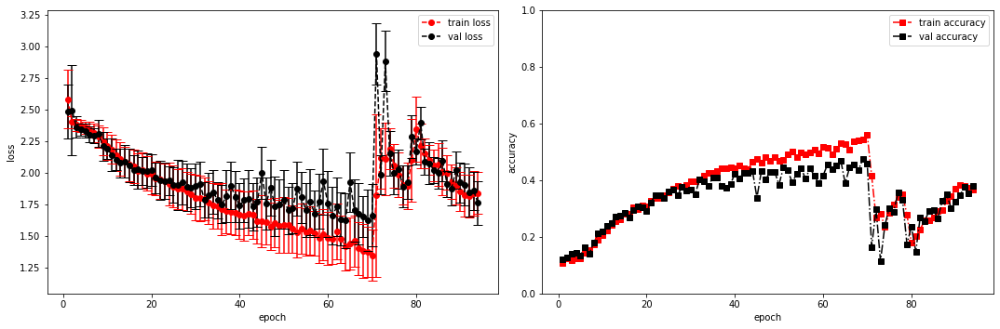

model saved


training epoch:  94
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [95/100], step [1/168],  Loss: 1.5753 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5531637668609619s
Epoch [95/100], step [17/168],  Loss: 1.7388 +/- 0.1770,  accuracy: 0.416015625, time elapsed = 6.236968755722046s
Epoch [95/100], step [33/168],  Loss: 1.8056 +/- 0.1354,  accuracy: 0.380859375, time elapsed = 6.23777961730957s
Epoch [95/100], step [49/168],  Loss: 1.7404 +/- 0.1852,  accuracy: 0.41015625, time elapsed = 6.238475322723389s
Epoch [95/100], step [65/168],  Loss: 1.7729 +/- 0.1405,  accuracy: 0.390625, time elapsed = 6.237381458282471s
Epoch [95/100], step [81/168],  Loss: 1.7297 +/- 0.1034,  accuracy: 0.384765625, time elapsed = 6.237637996673584s
Epoch [95/100], step [97/168],  Loss: 1.7613 +/- 0.1358,  accuracy: 0.400390625, time elapsed = 6.237866163253784s
Epoch [95/100], step [113/168],  Loss: 1.8212 +/- 0.1576,  accuracy: 0.37890625, time elapsed = 6.237488508224487s
Epoch [95/100], step [129/168],  Loss: 1.6942 +/- 0.1112,  accuracy: 0.412109375, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.397,  precision = 0.397 recall = 0.397 f1 = 0.397 ::: val: acc = 0.336,  precision = 0.336 recall = 0.336 time elapsed = 70.51048541069031s


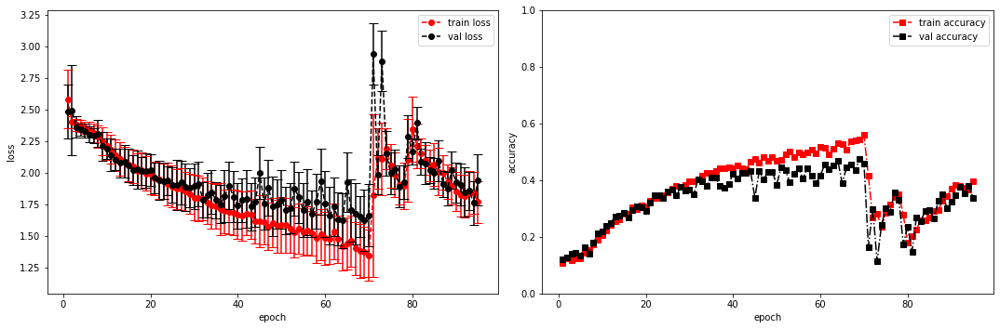

model saved


training epoch:  95
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [96/100], step [1/168],  Loss: 1.9600 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5394008159637451s
Epoch [96/100], step [17/168],  Loss: 1.8101 +/- 0.1344,  accuracy: 0.3515625, time elapsed = 6.2394630908966064s
Epoch [96/100], step [33/168],  Loss: 1.8414 +/- 0.1912,  accuracy: 0.337890625, time elapsed = 6.238771200180054s
Epoch [96/100], step [49/168],  Loss: 1.8079 +/- 0.1707,  accuracy: 0.3671875, time elapsed = 6.239145278930664s
Epoch [96/100], step [65/168],  Loss: 1.8510 +/- 0.1580,  accuracy: 0.359375, time elapsed = 6.239262819290161s
Epoch [96/100], step [81/168],  Loss: 1.8381 +/- 0.1964,  accuracy: 0.38671875, time elapsed = 6.239642858505249s
Epoch [96/100], step [97/168],  Loss: 1.8142 +/- 0.1872,  accuracy: 0.390625, time elapsed = 6.2416136264801025s
Epoch [96/100], step [113/168],  Loss: 2.1997 +/- 0.2844,  accuracy: 0.263671875, time elapsed = 6.239380359649658s
Epoch [96/100], step [129/168],  Loss: 2.0404 +/- 0.1574,  accuracy: 0.287109375, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.321,  precision = 0.321 recall = 0.321 f1 = 0.321 ::: val: acc = 0.272,  precision = 0.272 recall = 0.272 time elapsed = 70.50035452842712s


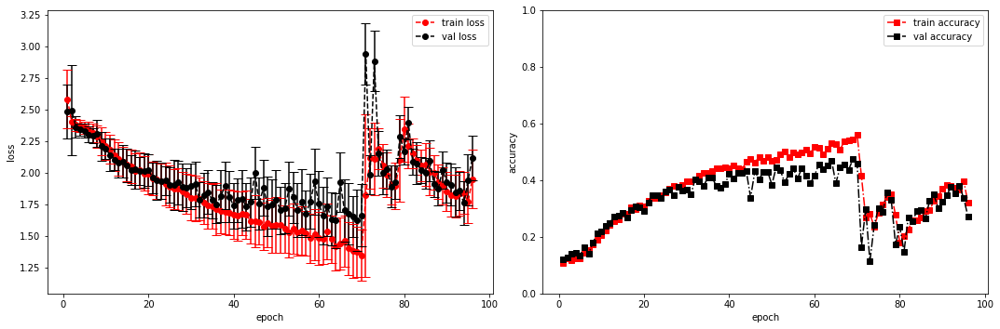

model saved


training epoch:  96
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [97/100], step [1/168],  Loss: 2.3300 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5390818119049072s
Epoch [97/100], step [17/168],  Loss: 2.3178 +/- 0.3630,  accuracy: 0.23828125, time elapsed = 6.237484931945801s
Epoch [97/100], step [33/168],  Loss: 2.4287 +/- 0.1450,  accuracy: 0.142578125, time elapsed = 6.238067865371704s
Epoch [97/100], step [49/168],  Loss: 2.3097 +/- 0.1493,  accuracy: 0.197265625, time elapsed = 6.238246202468872s
Epoch [97/100], step [65/168],  Loss: 2.5754 +/- 0.2686,  accuracy: 0.16015625, time elapsed = 6.2385358810424805s
Epoch [97/100], step [81/168],  Loss: 2.7419 +/- 0.1848,  accuracy: 0.099609375, time elapsed = 6.249644041061401s
Epoch [97/100], step [97/168],  Loss: 2.6504 +/- 0.1008,  accuracy: 0.1171875, time elapsed = 6.247811317443848s
Epoch [97/100], step [113/168],  Loss: 2.4518 +/- 0.1151,  accuracy: 0.142578125, time elapsed = 6.239059925079346s
Epoch [97/100], step [129/168],  Loss: 2.3784 +/- 0.1214,  accuracy: 0.14453125, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.156,  precision = 0.156 recall = 0.156 f1 = 0.156 ::: val: acc = 0.174,  precision = 0.174 recall = 0.174 time elapsed = 70.50380396842957s


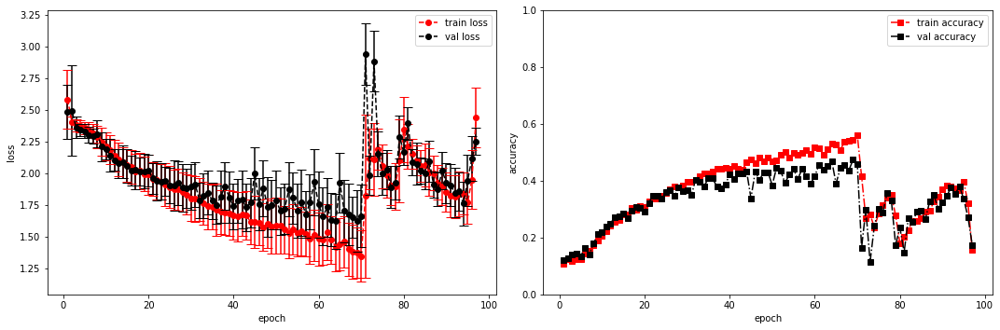

model saved


training epoch:  97
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [98/100], step [1/168],  Loss: 2.3449 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5318088531494141s
Epoch [98/100], step [17/168],  Loss: 2.2458 +/- 0.1413,  accuracy: 0.169921875, time elapsed = 6.23878288269043s
Epoch [98/100], step [33/168],  Loss: 2.3048 +/- 0.0951,  accuracy: 0.13671875, time elapsed = 6.238170146942139s
Epoch [98/100], step [49/168],  Loss: 2.3076 +/- 0.0993,  accuracy: 0.15234375, time elapsed = 6.241192102432251s
Epoch [98/100], step [65/168],  Loss: 2.2311 +/- 0.0980,  accuracy: 0.189453125, time elapsed = 6.239329099655151s
Epoch [98/100], step [81/168],  Loss: 2.2262 +/- 0.0894,  accuracy: 0.15234375, time elapsed = 6.239763498306274s
Epoch [98/100], step [97/168],  Loss: 2.3120 +/- 0.1003,  accuracy: 0.154296875, time elapsed = 6.239679574966431s
Epoch [98/100], step [113/168],  Loss: 2.3313 +/- 0.1041,  accuracy: 0.14453125, time elapsed = 6.239355564117432s
Epoch [98/100], step [129/168],  Loss: 2.2706 +/- 0.1065,  accuracy: 0.181640625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.160,  precision = 0.160 recall = 0.160 f1 = 0.160 ::: val: acc = 0.166,  precision = 0.166 recall = 0.166 time elapsed = 70.49226975440979s


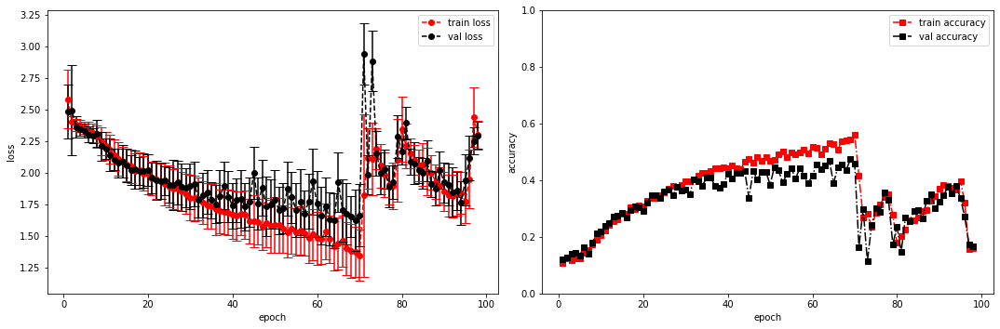

model saved


training epoch:  98
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [99/100], step [1/168],  Loss: 2.2974 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5345809459686279s
Epoch [99/100], step [17/168],  Loss: 2.2664 +/- 0.1048,  accuracy: 0.177734375, time elapsed = 6.239274501800537s
Epoch [99/100], step [33/168],  Loss: 2.2272 +/- 0.0607,  accuracy: 0.201171875, time elapsed = 6.250976800918579s
Epoch [99/100], step [49/168],  Loss: 2.2161 +/- 0.0757,  accuracy: 0.16796875, time elapsed = 6.238187074661255s
Epoch [99/100], step [65/168],  Loss: 2.1621 +/- 0.1402,  accuracy: 0.228515625, time elapsed = 6.238831281661987s
Epoch [99/100], step [81/168],  Loss: 2.1805 +/- 0.1157,  accuracy: 0.1953125, time elapsed = 6.2394044399261475s
Epoch [99/100], step [97/168],  Loss: 2.1648 +/- 0.0869,  accuracy: 0.201171875, time elapsed = 6.238351583480835s
Epoch [99/100], step [113/168],  Loss: 2.1734 +/- 0.0854,  accuracy: 0.197265625, time elapsed = 6.238221883773804s
Epoch [99/100], step [129/168],  Loss: 2.2142 +/- 0.0913,  accuracy: 0.177734375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.200,  precision = 0.200 recall = 0.200 f1 = 0.200 ::: val: acc = 0.213,  precision = 0.213 recall = 0.213 time elapsed = 70.49203515052795s


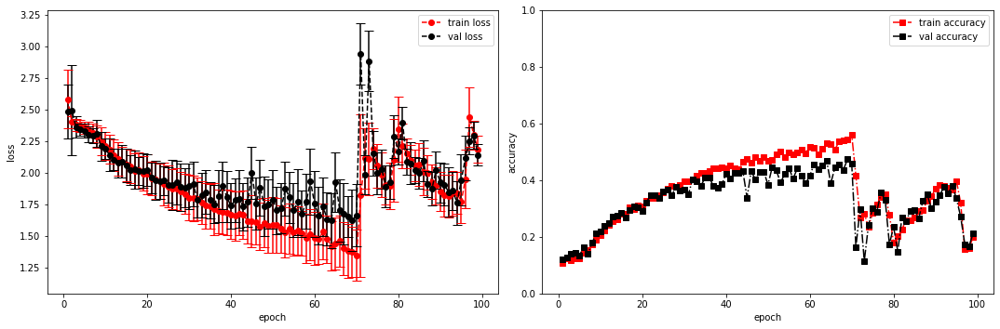

model saved


training epoch:  99
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [100/100], step [1/168],  Loss: 2.0302 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5372529029846191s
Epoch [100/100], step [17/168],  Loss: 2.1136 +/- 0.1119,  accuracy: 0.2421875, time elapsed = 6.2381203174591064s
Epoch [100/100], step [33/168],  Loss: 2.1329 +/- 0.0819,  accuracy: 0.21875, time elapsed = 6.238751173019409s
Epoch [100/100], step [49/168],  Loss: 2.1493 +/- 0.1565,  accuracy: 0.224609375, time elapsed = 6.238032102584839s
Epoch [100/100], step [65/168],  Loss: 2.1322 +/- 0.1548,  accuracy: 0.23046875, time elapsed = 6.239048480987549s
Epoch [100/100], step [81/168],  Loss: 2.0516 +/- 0.0784,  accuracy: 0.26953125, time elapsed = 6.238882780075073s
Epoch [100/100], step [97/168],  Loss: 2.1220 +/- 0.0879,  accuracy: 0.185546875, time elapsed = 6.238510847091675s
Epoch [100/100], step [113/168],  Loss: 2.1565 +/- 0.1232,  accuracy: 0.205078125, time elapsed = 6.2380211353302s
Epoch [100/100], step [129/168],  Loss: 2.1323 +/- 0.0984,  accuracy: 0.234375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.224,  precision = 0.224 recall = 0.224 f1 = 0.224 ::: val: acc = 0.245,  precision = 0.245 recall = 0.245 time elapsed = 70.50019550323486s


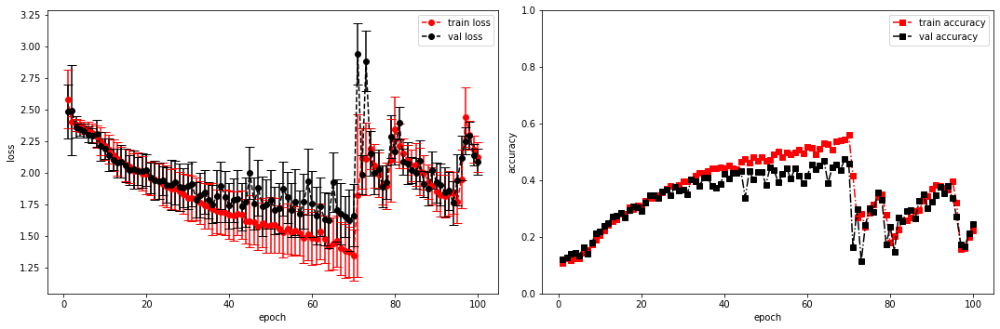

model saved
device:  cuda
dataset metadata:  {'n_fft': 2048, 'hop_length': 512, 'n_mfcc': 40, 'notes': 'optional notes not passed'}
train model: data loaders initialized
sample shape =  (1, 40, 259)
model loaded
Layer (type:depth-idx)                   Output Shape              Param #
├─TripleConv: 1-1                        [-1, 8, 40, 259]          --
|    └─ConvBlock: 2-1                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-1              [-1, 8, 40, 259]          96
|    └─ConvBlock: 2-2                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-2              [-1, 8, 40, 259]          600
|    └─ConvBlock: 2-3                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-3              [-1, 8, 40, 259]          600
├─ConvBlock: 1-2                         [-1, 8, 20, 129]          --
|    └─Sequential: 2-4                   [-1, 8, 20, 129]          --
|    |    └─Conv2d: 3-4                  [-1, 8, 40, 259]          584
|    |    

<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [1/100], step [1/168],  Loss: 2.8419 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5123639106750488s
Epoch [1/100], step [17/168],  Loss: 2.8278 +/- 0.1603,  accuracy: 0.111328125, time elapsed = 6.22094988822937s
Epoch [1/100], step [33/168],  Loss: 2.6779 +/- 0.1939,  accuracy: 0.1640625, time elapsed = 6.2235705852508545s
Epoch [1/100], step [49/168],  Loss: 2.7030 +/- 0.1388,  accuracy: 0.107421875, time elapsed = 6.226638078689575s
Epoch [1/100], step [65/168],  Loss: 2.4977 +/- 0.1450,  accuracy: 0.126953125, time elapsed = 6.240746021270752s
Epoch [1/100], step [81/168],  Loss: 2.5714 +/- 0.1940,  accuracy: 0.1171875, time elapsed = 6.240727424621582s
Epoch [1/100], step [97/168],  Loss: 2.5210 +/- 0.1004,  accuracy: 0.12109375, time elapsed = 6.2399938106536865s
Epoch [1/100], step [113/168],  Loss: 2.4770 +/- 0.1599,  accuracy: 0.12890625, time elapsed = 6.240262269973755s
Epoch [1/100], step [129/168],  Loss: 2.4433 +/- 0.1502,  accuracy: 0.125, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.122,  precision = 0.122 recall = 0.122 f1 = 0.122 ::: val: acc = 0.139,  precision = 0.139 recall = 0.139 time elapsed = 70.41996502876282s


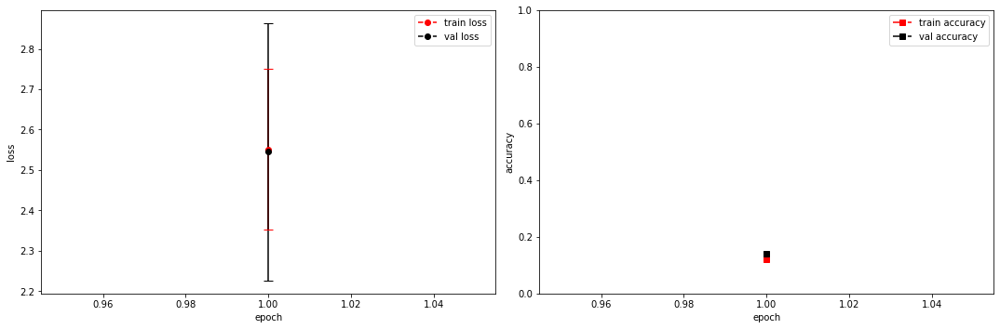

model saved


training epoch:  1
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [2/100], step [1/168],  Loss: 2.3429 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5606362819671631s
Epoch [2/100], step [17/168],  Loss: 2.3900 +/- 0.0942,  accuracy: 0.12890625, time elapsed = 6.244816064834595s
Epoch [2/100], step [33/168],  Loss: 2.3390 +/- 0.0923,  accuracy: 0.150390625, time elapsed = 6.240763902664185s
Epoch [2/100], step [49/168],  Loss: 2.3681 +/- 0.0753,  accuracy: 0.134765625, time elapsed = 6.240561246871948s
Epoch [2/100], step [65/168],  Loss: 2.3308 +/- 0.1100,  accuracy: 0.1484375, time elapsed = 6.241429328918457s
Epoch [2/100], step [81/168],  Loss: 2.3550 +/- 0.0735,  accuracy: 0.142578125, time elapsed = 6.241479873657227s
Epoch [2/100], step [97/168],  Loss: 2.3462 +/- 0.0958,  accuracy: 0.15234375, time elapsed = 6.241010665893555s
Epoch [2/100], step [113/168],  Loss: 2.3506 +/- 0.0900,  accuracy: 0.119140625, time elapsed = 6.24201226234436s
Epoch [2/100], step [129/168],  Loss: 2.3138 +/- 0.0971,  accuracy: 0.150390625, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.142,  precision = 0.142 recall = 0.142 f1 = 0.142 ::: val: acc = 0.151,  precision = 0.151 recall = 0.151 time elapsed = 70.53689908981323s


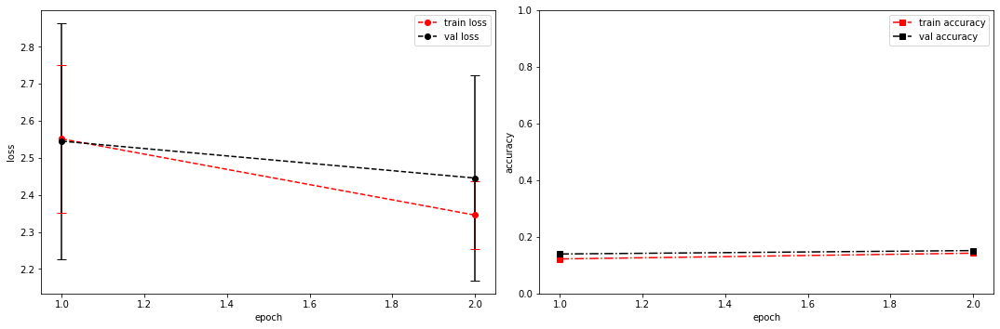

model saved


training epoch:  2
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [3/100], step [1/168],  Loss: 2.3214 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5304503440856934s
Epoch [3/100], step [17/168],  Loss: 2.2956 +/- 0.0557,  accuracy: 0.1484375, time elapsed = 6.241887331008911s
Epoch [3/100], step [33/168],  Loss: 2.2954 +/- 0.0849,  accuracy: 0.12890625, time elapsed = 6.243180274963379s
Epoch [3/100], step [49/168],  Loss: 2.3104 +/- 0.0629,  accuracy: 0.12890625, time elapsed = 6.242286443710327s
Epoch [3/100], step [65/168],  Loss: 2.3303 +/- 0.0735,  accuracy: 0.14453125, time elapsed = 6.243313312530518s
Epoch [3/100], step [81/168],  Loss: 2.3030 +/- 0.1009,  accuracy: 0.142578125, time elapsed = 6.242221117019653s
Epoch [3/100], step [97/168],  Loss: 2.2912 +/- 0.0915,  accuracy: 0.18359375, time elapsed = 6.241179704666138s
Epoch [3/100], step [113/168],  Loss: 2.2959 +/- 0.1257,  accuracy: 0.142578125, time elapsed = 6.242736577987671s
Epoch [3/100], step [129/168],  Loss: 2.3199 +/- 0.0963,  accuracy: 0.146484375, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.149,  precision = 0.149 recall = 0.149 f1 = 0.149 ::: val: acc = 0.177,  precision = 0.177 recall = 0.177 time elapsed = 70.5344307422638s


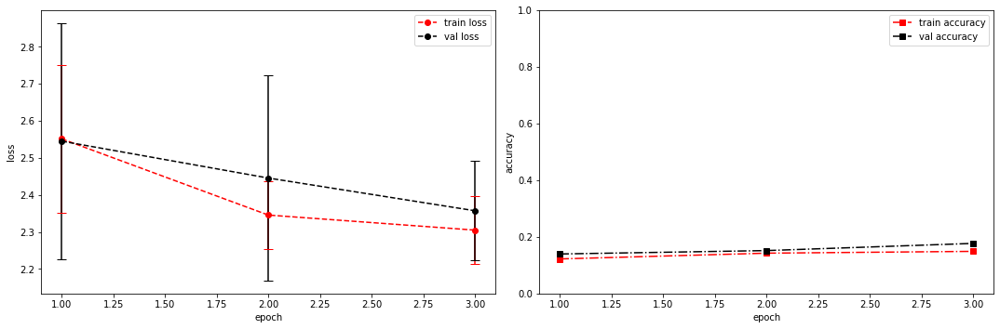

model saved


training epoch:  3
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [4/100], step [1/168],  Loss: 2.2220 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5357494354248047s
Epoch [4/100], step [17/168],  Loss: 2.2740 +/- 0.0789,  accuracy: 0.1796875, time elapsed = 6.243761301040649s
Epoch [4/100], step [33/168],  Loss: 2.2846 +/- 0.0813,  accuracy: 0.177734375, time elapsed = 6.24335503578186s
Epoch [4/100], step [49/168],  Loss: 2.2903 +/- 0.1042,  accuracy: 0.185546875, time elapsed = 6.243503093719482s
Epoch [4/100], step [65/168],  Loss: 2.2773 +/- 0.0995,  accuracy: 0.177734375, time elapsed = 6.240575313568115s
Epoch [4/100], step [81/168],  Loss: 2.2801 +/- 0.0786,  accuracy: 0.177734375, time elapsed = 6.241746664047241s
Epoch [4/100], step [97/168],  Loss: 2.2431 +/- 0.0857,  accuracy: 0.189453125, time elapsed = 6.242380142211914s
Epoch [4/100], step [113/168],  Loss: 2.2492 +/- 0.0955,  accuracy: 0.201171875, time elapsed = 6.2416980266571045s
Epoch [4/100], step [129/168],  Loss: 2.2454 +/- 0.1071,  accuracy: 0.193359375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.184,  precision = 0.184 recall = 0.184 f1 = 0.184 ::: val: acc = 0.210,  precision = 0.210 recall = 0.210 time elapsed = 70.52061462402344s


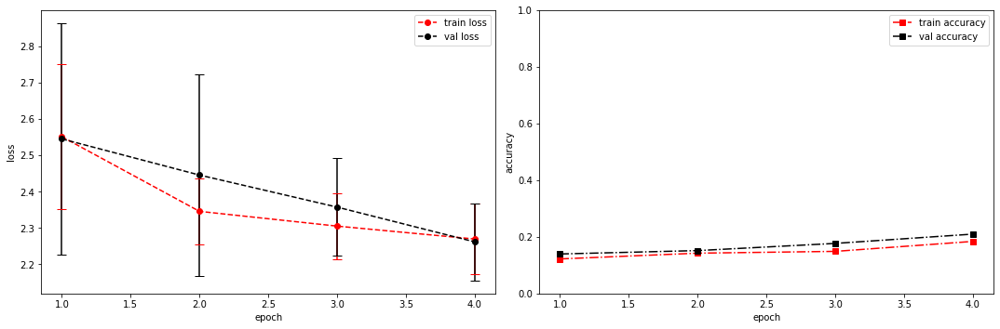

model saved


training epoch:  4
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [5/100], step [1/168],  Loss: 2.1300 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.533092737197876s
Epoch [5/100], step [17/168],  Loss: 2.2068 +/- 0.1037,  accuracy: 0.21875, time elapsed = 6.2408270835876465s
Epoch [5/100], step [33/168],  Loss: 2.1903 +/- 0.0947,  accuracy: 0.18359375, time elapsed = 6.240965843200684s
Epoch [5/100], step [49/168],  Loss: 2.2571 +/- 0.0990,  accuracy: 0.16796875, time elapsed = 6.2396814823150635s
Epoch [5/100], step [65/168],  Loss: 2.2225 +/- 0.0995,  accuracy: 0.166015625, time elapsed = 6.243424892425537s
Epoch [5/100], step [81/168],  Loss: 2.2010 +/- 0.1083,  accuracy: 0.216796875, time elapsed = 6.255051136016846s
Epoch [5/100], step [97/168],  Loss: 2.2180 +/- 0.0939,  accuracy: 0.201171875, time elapsed = 6.242191314697266s
Epoch [5/100], step [113/168],  Loss: 2.2460 +/- 0.1053,  accuracy: 0.1875, time elapsed = 6.2424092292785645s
Epoch [5/100], step [129/168],  Loss: 2.2435 +/- 0.1133,  accuracy: 0.19921875, time elapsed = 6.24

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.194,  precision = 0.194 recall = 0.194 f1 = 0.194 ::: val: acc = 0.204,  precision = 0.204 recall = 0.204 time elapsed = 70.54106020927429s


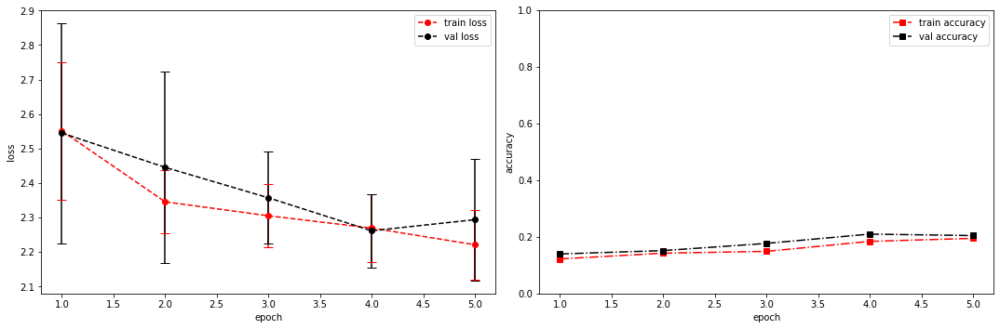

model saved


training epoch:  5
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [6/100], step [1/168],  Loss: 2.2487 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5391101837158203s
Epoch [6/100], step [17/168],  Loss: 2.1699 +/- 0.1075,  accuracy: 0.2265625, time elapsed = 6.24265718460083s
Epoch [6/100], step [33/168],  Loss: 2.2085 +/- 0.0904,  accuracy: 0.203125, time elapsed = 6.241401195526123s
Epoch [6/100], step [49/168],  Loss: 2.1928 +/- 0.1145,  accuracy: 0.21484375, time elapsed = 6.244257688522339s
Epoch [6/100], step [65/168],  Loss: 2.2061 +/- 0.1153,  accuracy: 0.232421875, time elapsed = 6.243519306182861s
Epoch [6/100], step [81/168],  Loss: 2.2175 +/- 0.0744,  accuracy: 0.201171875, time elapsed = 6.243996620178223s
Epoch [6/100], step [97/168],  Loss: 2.2082 +/- 0.1179,  accuracy: 0.1875, time elapsed = 6.242362022399902s
Epoch [6/100], step [113/168],  Loss: 2.1404 +/- 0.0883,  accuracy: 0.234375, time elapsed = 6.241530179977417s
Epoch [6/100], step [129/168],  Loss: 2.1646 +/- 0.1292,  accuracy: 0.23046875, time elapsed = 6.24391841

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.219,  precision = 0.219 recall = 0.219 f1 = 0.219 ::: val: acc = 0.226,  precision = 0.226 recall = 0.226 time elapsed = 70.54000115394592s


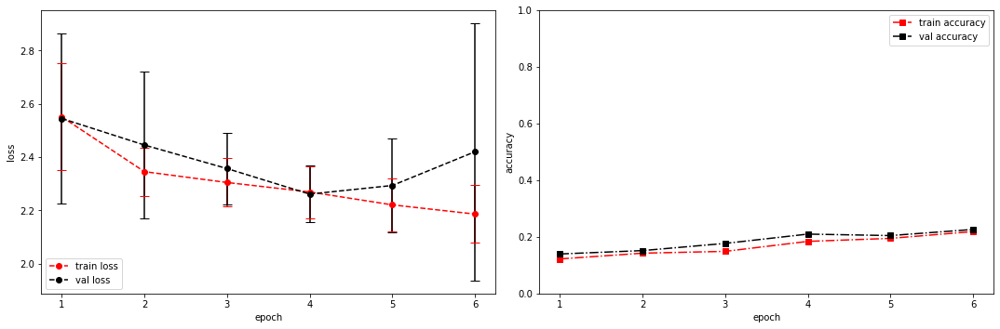

model saved


training epoch:  6
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [7/100], step [1/168],  Loss: 2.2411 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5408034324645996s
Epoch [7/100], step [17/168],  Loss: 2.2031 +/- 0.1061,  accuracy: 0.208984375, time elapsed = 6.255159616470337s
Epoch [7/100], step [33/168],  Loss: 2.1264 +/- 0.0816,  accuracy: 0.248046875, time elapsed = 6.243859529495239s
Epoch [7/100], step [49/168],  Loss: 2.1616 +/- 0.0984,  accuracy: 0.234375, time elapsed = 6.243135452270508s
Epoch [7/100], step [65/168],  Loss: 2.1168 +/- 0.1005,  accuracy: 0.255859375, time elapsed = 6.243114948272705s
Epoch [7/100], step [81/168],  Loss: 2.1628 +/- 0.1025,  accuracy: 0.25, time elapsed = 6.243112564086914s
Epoch [7/100], step [97/168],  Loss: 2.1764 +/- 0.1400,  accuracy: 0.220703125, time elapsed = 6.242787837982178s
Epoch [7/100], step [113/168],  Loss: 2.1661 +/- 0.1107,  accuracy: 0.232421875, time elapsed = 6.242733716964722s
Epoch [7/100], step [129/168],  Loss: 2.1126 +/- 0.1124,  accuracy: 0.240234375, time elapsed = 6

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.239,  precision = 0.239 recall = 0.239 f1 = 0.239 ::: val: acc = 0.250,  precision = 0.250 recall = 0.250 time elapsed = 70.55659651756287s


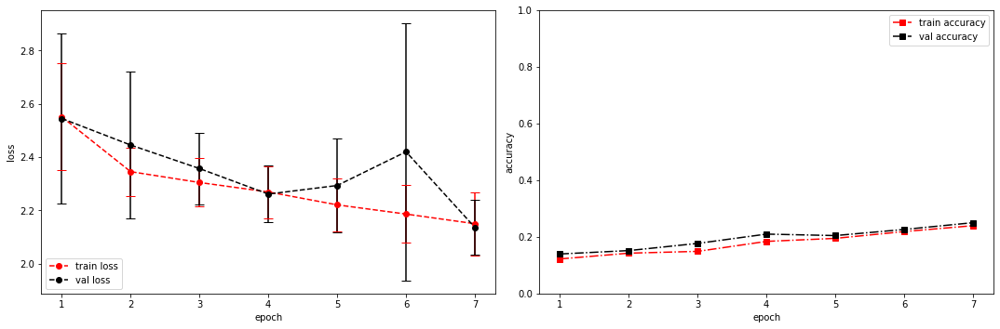

model saved


training epoch:  7
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [8/100], step [1/168],  Loss: 2.0171 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5620312690734863s
Epoch [8/100], step [17/168],  Loss: 2.1001 +/- 0.1038,  accuracy: 0.263671875, time elapsed = 6.242782115936279s
Epoch [8/100], step [33/168],  Loss: 2.1316 +/- 0.1126,  accuracy: 0.228515625, time elapsed = 6.242321014404297s
Epoch [8/100], step [49/168],  Loss: 2.1347 +/- 0.0989,  accuracy: 0.21484375, time elapsed = 6.243505239486694s
Epoch [8/100], step [65/168],  Loss: 2.1284 +/- 0.1588,  accuracy: 0.25, time elapsed = 6.243932008743286s
Epoch [8/100], step [81/168],  Loss: 2.1035 +/- 0.1251,  accuracy: 0.263671875, time elapsed = 6.2433037757873535s
Epoch [8/100], step [97/168],  Loss: 2.1116 +/- 0.1094,  accuracy: 0.259765625, time elapsed = 6.242176294326782s
Epoch [8/100], step [113/168],  Loss: 2.1418 +/- 0.1174,  accuracy: 0.236328125, time elapsed = 6.243417739868164s
Epoch [8/100], step [129/168],  Loss: 2.1139 +/- 0.1089,  accuracy: 0.248046875, time elapsed = 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.247,  precision = 0.247 recall = 0.247 f1 = 0.247 ::: val: acc = 0.239,  precision = 0.239 recall = 0.239 time elapsed = 70.58026909828186s


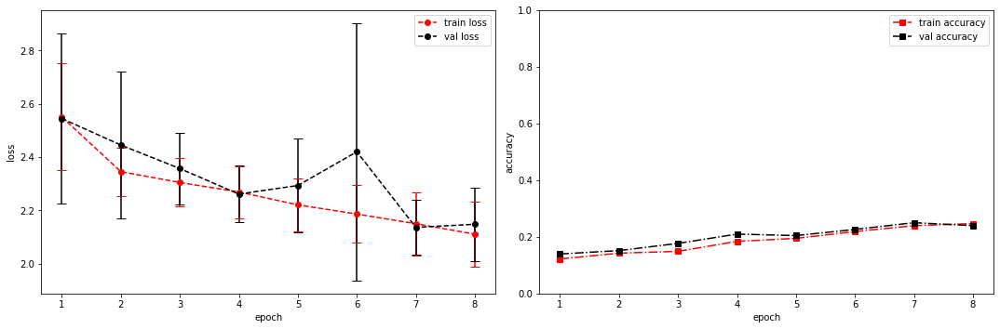

model saved


training epoch:  8
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [9/100], step [1/168],  Loss: 1.8175 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5758132934570312s
Epoch [9/100], step [17/168],  Loss: 2.0931 +/- 0.0988,  accuracy: 0.263671875, time elapsed = 6.242601633071899s
Epoch [9/100], step [33/168],  Loss: 2.0855 +/- 0.1138,  accuracy: 0.240234375, time elapsed = 6.241346597671509s
Epoch [9/100], step [49/168],  Loss: 2.0962 +/- 0.1461,  accuracy: 0.271484375, time elapsed = 6.241865396499634s
Epoch [9/100], step [65/168],  Loss: 2.0942 +/- 0.1130,  accuracy: 0.255859375, time elapsed = 6.242830514907837s
Epoch [9/100], step [81/168],  Loss: 2.0962 +/- 0.1079,  accuracy: 0.2421875, time elapsed = 6.242332220077515s
Epoch [9/100], step [97/168],  Loss: 2.1037 +/- 0.1164,  accuracy: 0.24609375, time elapsed = 6.244446039199829s
Epoch [9/100], step [113/168],  Loss: 2.0768 +/- 0.1141,  accuracy: 0.251953125, time elapsed = 6.2443389892578125s
Epoch [9/100], step [129/168],  Loss: 2.0846 +/- 0.1398,  accuracy: 0.267578125, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.252,  precision = 0.252 recall = 0.252 f1 = 0.252 ::: val: acc = 0.260,  precision = 0.260 recall = 0.260 time elapsed = 70.58399868011475s


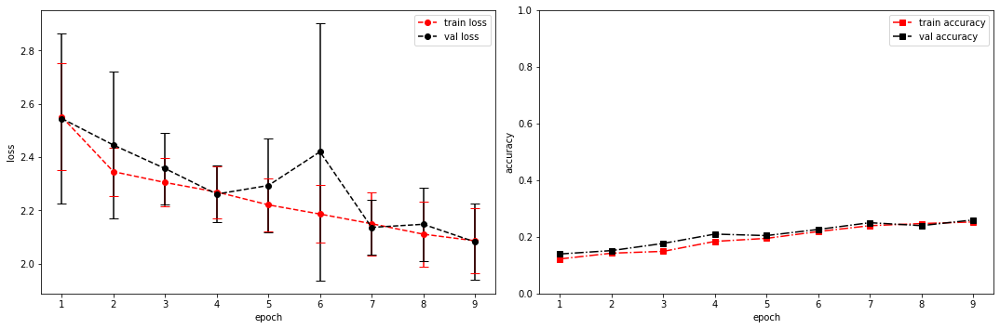

model saved


training epoch:  9
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [10/100], step [1/168],  Loss: 2.0006 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5438427925109863s
Epoch [10/100], step [17/168],  Loss: 2.0630 +/- 0.1118,  accuracy: 0.275390625, time elapsed = 6.241982936859131s
Epoch [10/100], step [33/168],  Loss: 2.0474 +/- 0.1374,  accuracy: 0.298828125, time elapsed = 6.242411375045776s
Epoch [10/100], step [49/168],  Loss: 2.1148 +/- 0.1158,  accuracy: 0.2578125, time elapsed = 6.241783380508423s
Epoch [10/100], step [65/168],  Loss: 2.0430 +/- 0.1477,  accuracy: 0.2890625, time elapsed = 6.241081237792969s
Epoch [10/100], step [81/168],  Loss: 2.0315 +/- 0.1564,  accuracy: 0.28515625, time elapsed = 6.245743751525879s
Epoch [10/100], step [97/168],  Loss: 2.0603 +/- 0.1344,  accuracy: 0.265625, time elapsed = 6.25150203704834s
Epoch [10/100], step [113/168],  Loss: 2.1211 +/- 0.1366,  accuracy: 0.25, time elapsed = 6.242326736450195s
Epoch [10/100], step [129/168],  Loss: 2.0733 +/- 0.1226,  accuracy: 0.259765625, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.278,  precision = 0.278 recall = 0.278 f1 = 0.278 ::: val: acc = 0.277,  precision = 0.277 recall = 0.277 time elapsed = 70.55059313774109s


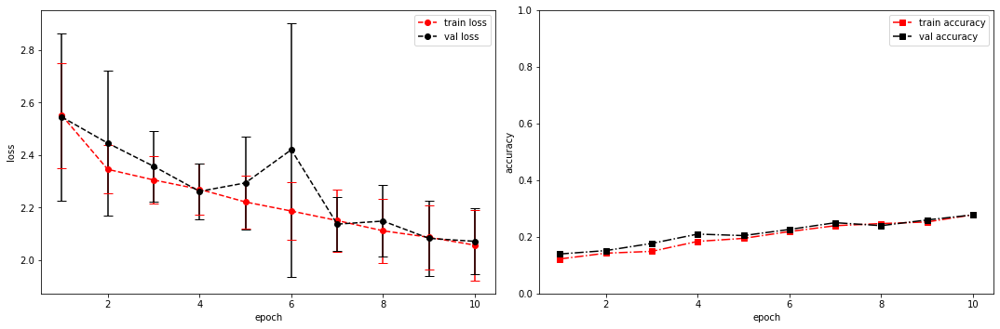

model saved


training epoch:  10
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [11/100], step [1/168],  Loss: 1.9128 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5412280559539795s
Epoch [11/100], step [17/168],  Loss: 2.0075 +/- 0.1318,  accuracy: 0.30078125, time elapsed = 6.241363763809204s
Epoch [11/100], step [33/168],  Loss: 1.9803 +/- 0.1053,  accuracy: 0.3046875, time elapsed = 6.241822242736816s
Epoch [11/100], step [49/168],  Loss: 2.0895 +/- 0.0856,  accuracy: 0.259765625, time elapsed = 6.243837118148804s
Epoch [11/100], step [65/168],  Loss: 2.0292 +/- 0.0747,  accuracy: 0.28125, time elapsed = 6.242550373077393s
Epoch [11/100], step [81/168],  Loss: 2.0590 +/- 0.1405,  accuracy: 0.3046875, time elapsed = 6.242706775665283s
Epoch [11/100], step [97/168],  Loss: 2.0303 +/- 0.1575,  accuracy: 0.2890625, time elapsed = 6.242211580276489s
Epoch [11/100], step [113/168],  Loss: 2.0552 +/- 0.1550,  accuracy: 0.25390625, time elapsed = 6.242763042449951s
Epoch [11/100], step [129/168],  Loss: 2.0904 +/- 0.1083,  accuracy: 0.251953125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.284,  precision = 0.284 recall = 0.284 f1 = 0.284 ::: val: acc = 0.292,  precision = 0.292 recall = 0.292 time elapsed = 70.53354501724243s


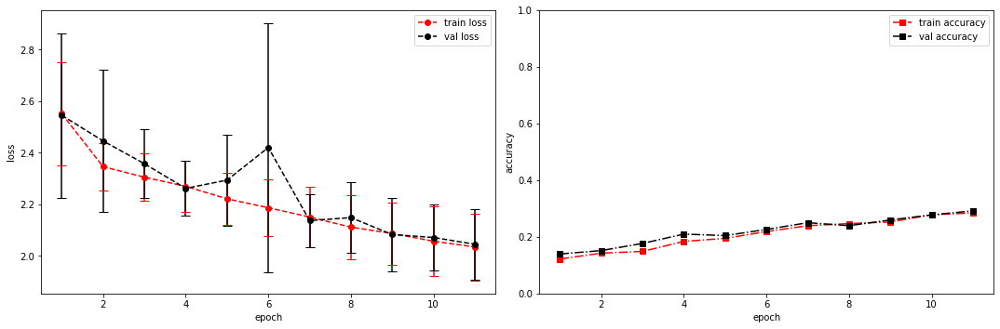

model saved


training epoch:  11
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [12/100], step [1/168],  Loss: 1.7846 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5323145389556885s
Epoch [12/100], step [17/168],  Loss: 1.9444 +/- 0.1395,  accuracy: 0.3359375, time elapsed = 6.243727207183838s
Epoch [12/100], step [33/168],  Loss: 2.0521 +/- 0.1146,  accuracy: 0.298828125, time elapsed = 6.255610704421997s
Epoch [12/100], step [49/168],  Loss: 2.0759 +/- 0.1336,  accuracy: 0.3125, time elapsed = 6.243687629699707s
Epoch [12/100], step [65/168],  Loss: 2.0008 +/- 0.1392,  accuracy: 0.287109375, time elapsed = 6.243326425552368s
Epoch [12/100], step [81/168],  Loss: 2.0021 +/- 0.1097,  accuracy: 0.29296875, time elapsed = 6.243442058563232s
Epoch [12/100], step [97/168],  Loss: 2.0184 +/- 0.1377,  accuracy: 0.2734375, time elapsed = 6.242680072784424s
Epoch [12/100], step [113/168],  Loss: 2.0267 +/- 0.1448,  accuracy: 0.30078125, time elapsed = 6.243169069290161s
Epoch [12/100], step [129/168],  Loss: 1.9789 +/- 0.1264,  accuracy: 0.318359375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.304,  precision = 0.304 recall = 0.304 f1 = 0.304 ::: val: acc = 0.316,  precision = 0.316 recall = 0.316 time elapsed = 70.5482132434845s


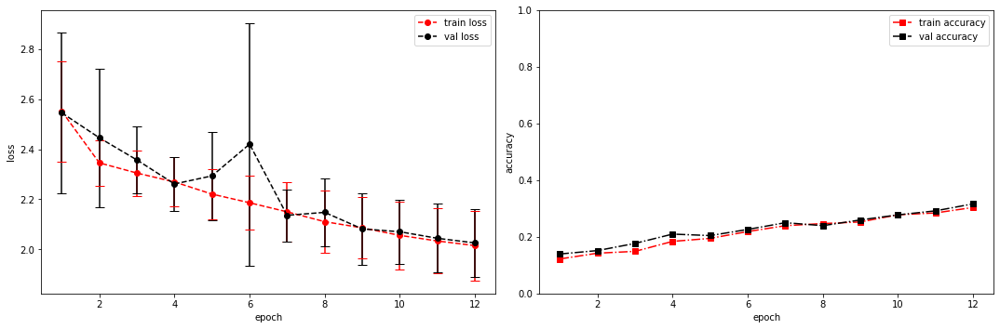

model saved


training epoch:  12
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [13/100], step [1/168],  Loss: 1.9203 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5414574146270752s
Epoch [13/100], step [17/168],  Loss: 2.0419 +/- 0.1350,  accuracy: 0.298828125, time elapsed = 6.241407871246338s
Epoch [13/100], step [33/168],  Loss: 2.0135 +/- 0.1268,  accuracy: 0.3125, time elapsed = 6.2416181564331055s
Epoch [13/100], step [49/168],  Loss: 1.9863 +/- 0.1133,  accuracy: 0.287109375, time elapsed = 6.2420430183410645s
Epoch [13/100], step [65/168],  Loss: 1.9966 +/- 0.1193,  accuracy: 0.328125, time elapsed = 6.241656064987183s
Epoch [13/100], step [81/168],  Loss: 2.0321 +/- 0.1485,  accuracy: 0.294921875, time elapsed = 6.242181301116943s
Epoch [13/100], step [97/168],  Loss: 2.0196 +/- 0.1425,  accuracy: 0.306640625, time elapsed = 6.242154359817505s
Epoch [13/100], step [113/168],  Loss: 2.0188 +/- 0.1523,  accuracy: 0.3046875, time elapsed = 6.242079973220825s
Epoch [13/100], step [129/168],  Loss: 2.0105 +/- 0.1053,  accuracy: 0.29296875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.306,  precision = 0.306 recall = 0.306 f1 = 0.306 ::: val: acc = 0.312,  precision = 0.312 recall = 0.312 time elapsed = 70.55720639228821s


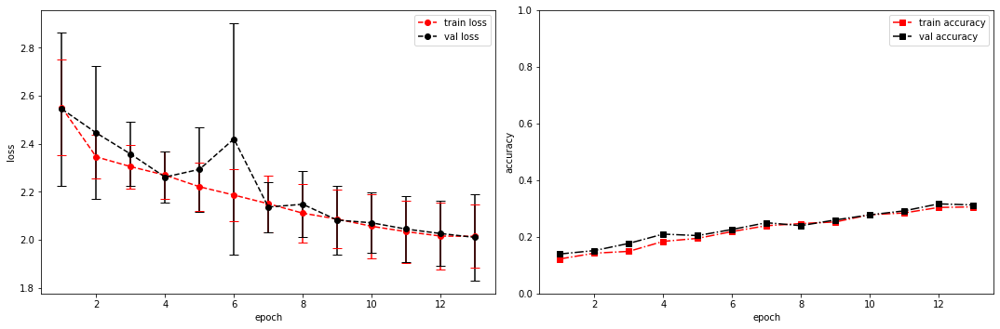

model saved


training epoch:  13
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [14/100], step [1/168],  Loss: 2.0810 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.537355899810791s
Epoch [14/100], step [17/168],  Loss: 1.9646 +/- 0.1187,  accuracy: 0.32421875, time elapsed = 6.242498397827148s
Epoch [14/100], step [33/168],  Loss: 1.9646 +/- 0.0964,  accuracy: 0.3046875, time elapsed = 6.242387056350708s
Epoch [14/100], step [49/168],  Loss: 1.9590 +/- 0.1279,  accuracy: 0.341796875, time elapsed = 6.244065523147583s
Epoch [14/100], step [65/168],  Loss: 1.9857 +/- 0.1277,  accuracy: 0.337890625, time elapsed = 6.242265462875366s
Epoch [14/100], step [81/168],  Loss: 2.0520 +/- 0.1276,  accuracy: 0.298828125, time elapsed = 6.2432777881622314s
Epoch [14/100], step [97/168],  Loss: 2.0629 +/- 0.1392,  accuracy: 0.302734375, time elapsed = 6.243565320968628s
Epoch [14/100], step [113/168],  Loss: 1.9962 +/- 0.1930,  accuracy: 0.294921875, time elapsed = 6.24173378944397s
Epoch [14/100], step [129/168],  Loss: 1.9256 +/- 0.1377,  accuracy: 0.328125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.317,  precision = 0.317 recall = 0.317 f1 = 0.317 ::: val: acc = 0.307,  precision = 0.307 recall = 0.307 time elapsed = 70.54436111450195s


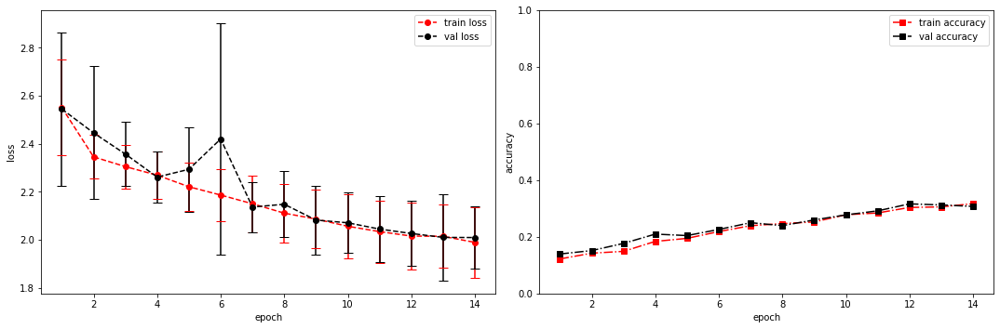

model saved


training epoch:  14
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [15/100], step [1/168],  Loss: 1.9000 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.536564826965332s
Epoch [15/100], step [17/168],  Loss: 1.9922 +/- 0.0840,  accuracy: 0.30859375, time elapsed = 6.241887807846069s
Epoch [15/100], step [33/168],  Loss: 2.0167 +/- 0.1321,  accuracy: 0.28125, time elapsed = 6.242684602737427s
Epoch [15/100], step [49/168],  Loss: 1.9763 +/- 0.1056,  accuracy: 0.31640625, time elapsed = 6.243252515792847s
Epoch [15/100], step [65/168],  Loss: 2.0063 +/- 0.1145,  accuracy: 0.3203125, time elapsed = 6.243313312530518s
Epoch [15/100], step [81/168],  Loss: 1.9834 +/- 0.1247,  accuracy: 0.31640625, time elapsed = 6.242751836776733s
Epoch [15/100], step [97/168],  Loss: 1.9530 +/- 0.1698,  accuracy: 0.341796875, time elapsed = 6.251553058624268s
Epoch [15/100], step [113/168],  Loss: 2.0254 +/- 0.1363,  accuracy: 0.3046875, time elapsed = 6.242218494415283s
Epoch [15/100], step [129/168],  Loss: 1.9792 +/- 0.1420,  accuracy: 0.3203125, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.319,  precision = 0.319 recall = 0.319 f1 = 0.319 ::: val: acc = 0.329,  precision = 0.329 recall = 0.329 time elapsed = 70.54711437225342s


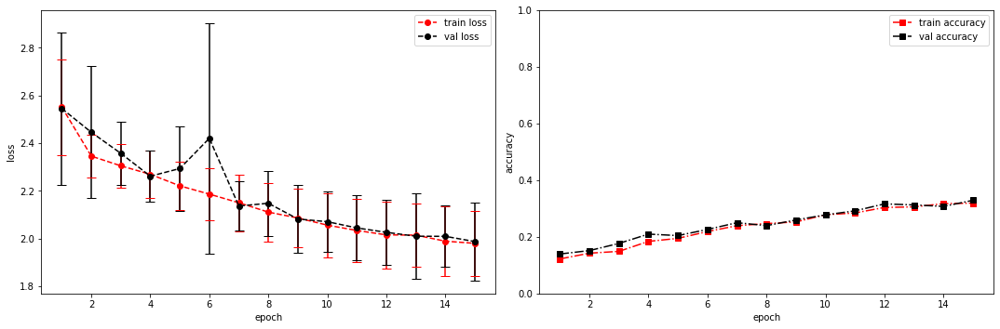

model saved


training epoch:  15
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [16/100], step [1/168],  Loss: 2.0286 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5380785465240479s
Epoch [16/100], step [17/168],  Loss: 1.9817 +/- 0.1812,  accuracy: 0.3359375, time elapsed = 6.24155855178833s
Epoch [16/100], step [33/168],  Loss: 2.0173 +/- 0.1486,  accuracy: 0.3046875, time elapsed = 6.242952585220337s
Epoch [16/100], step [49/168],  Loss: 1.9421 +/- 0.1404,  accuracy: 0.34765625, time elapsed = 6.241885185241699s
Epoch [16/100], step [65/168],  Loss: 1.9948 +/- 0.1360,  accuracy: 0.322265625, time elapsed = 6.244762659072876s
Epoch [16/100], step [81/168],  Loss: 1.8430 +/- 0.1523,  accuracy: 0.365234375, time elapsed = 6.242598295211792s
Epoch [16/100], step [97/168],  Loss: 2.0395 +/- 0.1399,  accuracy: 0.283203125, time elapsed = 6.24251914024353s
Epoch [16/100], step [113/168],  Loss: 1.9393 +/- 0.1646,  accuracy: 0.3359375, time elapsed = 6.2435667514801025s
Epoch [16/100], step [129/168],  Loss: 1.9516 +/- 0.1043,  accuracy: 0.306640625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.321,  precision = 0.321 recall = 0.321 f1 = 0.321 ::: val: acc = 0.316,  precision = 0.316 recall = 0.316 time elapsed = 70.54005932807922s


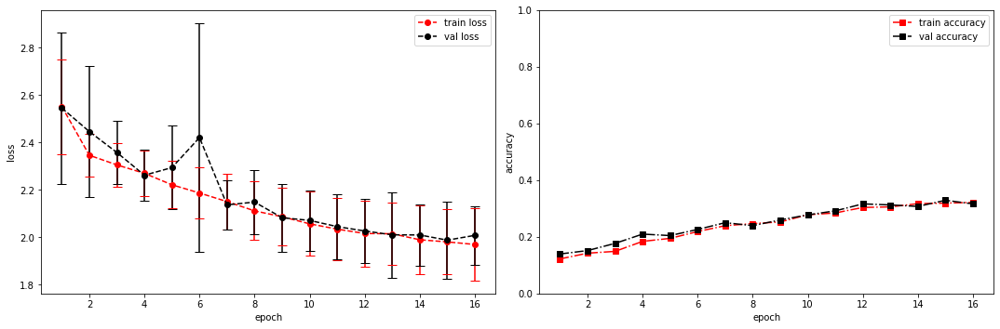

model saved


training epoch:  16
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [17/100], step [1/168],  Loss: 2.0644 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5353672504425049s
Epoch [17/100], step [17/168],  Loss: 1.8978 +/- 0.1266,  accuracy: 0.365234375, time elapsed = 6.242444753646851s
Epoch [17/100], step [33/168],  Loss: 1.9236 +/- 0.1446,  accuracy: 0.375, time elapsed = 6.244435548782349s
Epoch [17/100], step [49/168],  Loss: 1.9739 +/- 0.1323,  accuracy: 0.318359375, time elapsed = 6.255110740661621s
Epoch [17/100], step [65/168],  Loss: 1.9800 +/- 0.1651,  accuracy: 0.3515625, time elapsed = 6.244683742523193s
Epoch [17/100], step [81/168],  Loss: 2.0730 +/- 0.1035,  accuracy: 0.287109375, time elapsed = 6.242274045944214s
Epoch [17/100], step [97/168],  Loss: 1.9642 +/- 0.1325,  accuracy: 0.322265625, time elapsed = 6.241377353668213s
Epoch [17/100], step [113/168],  Loss: 1.9624 +/- 0.1081,  accuracy: 0.33203125, time elapsed = 6.24233603477478s
Epoch [17/100], step [129/168],  Loss: 1.9494 +/- 0.1061,  accuracy: 0.328125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.341,  precision = 0.341 recall = 0.341 f1 = 0.341 ::: val: acc = 0.332,  precision = 0.332 recall = 0.332 time elapsed = 70.54299783706665s


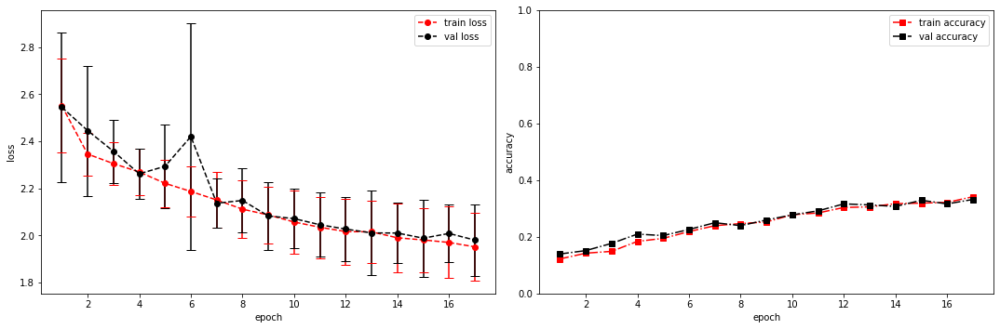

model saved


training epoch:  17
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [18/100], step [1/168],  Loss: 1.5392 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5328724384307861s
Epoch [18/100], step [17/168],  Loss: 1.9004 +/- 0.0874,  accuracy: 0.333984375, time elapsed = 6.243980646133423s
Epoch [18/100], step [33/168],  Loss: 1.9253 +/- 0.1701,  accuracy: 0.337890625, time elapsed = 6.243064880371094s
Epoch [18/100], step [49/168],  Loss: 1.8924 +/- 0.1114,  accuracy: 0.337890625, time elapsed = 6.242908477783203s
Epoch [18/100], step [65/168],  Loss: 1.9439 +/- 0.1495,  accuracy: 0.318359375, time elapsed = 6.243386268615723s
Epoch [18/100], step [81/168],  Loss: 1.9648 +/- 0.1461,  accuracy: 0.318359375, time elapsed = 6.241541624069214s
Epoch [18/100], step [97/168],  Loss: 1.9299 +/- 0.1386,  accuracy: 0.3671875, time elapsed = 6.2422802448272705s
Epoch [18/100], step [113/168],  Loss: 1.9171 +/- 0.1513,  accuracy: 0.34765625, time elapsed = 6.242975950241089s
Epoch [18/100], step [129/168],  Loss: 1.8816 +/- 0.1867,  accuracy: 0.37890625, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.342,  precision = 0.342 recall = 0.342 f1 = 0.342 ::: val: acc = 0.348,  precision = 0.348 recall = 0.348 time elapsed = 70.54564547538757s


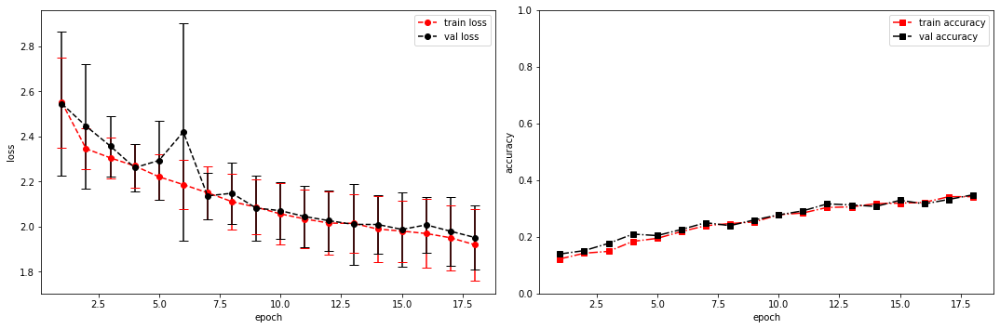

model saved


training epoch:  18
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [19/100], step [1/168],  Loss: 2.1220 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5369913578033447s
Epoch [19/100], step [17/168],  Loss: 1.8475 +/- 0.1312,  accuracy: 0.380859375, time elapsed = 6.242762088775635s
Epoch [19/100], step [33/168],  Loss: 1.9123 +/- 0.1949,  accuracy: 0.34375, time elapsed = 6.243457078933716s
Epoch [19/100], step [49/168],  Loss: 1.8929 +/- 0.1592,  accuracy: 0.353515625, time elapsed = 6.2427544593811035s
Epoch [19/100], step [65/168],  Loss: 1.9361 +/- 0.1450,  accuracy: 0.353515625, time elapsed = 6.242243051528931s
Epoch [19/100], step [81/168],  Loss: 1.9156 +/- 0.1329,  accuracy: 0.359375, time elapsed = 6.242721319198608s
Epoch [19/100], step [97/168],  Loss: 1.8949 +/- 0.1678,  accuracy: 0.32421875, time elapsed = 6.243319988250732s
Epoch [19/100], step [113/168],  Loss: 1.9060 +/- 0.1350,  accuracy: 0.32421875, time elapsed = 6.2432639598846436s
Epoch [19/100], step [129/168],  Loss: 1.9005 +/- 0.1070,  accuracy: 0.357421875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.353,  precision = 0.353 recall = 0.353 f1 = 0.353 ::: val: acc = 0.292,  precision = 0.292 recall = 0.292 time elapsed = 70.54903197288513s


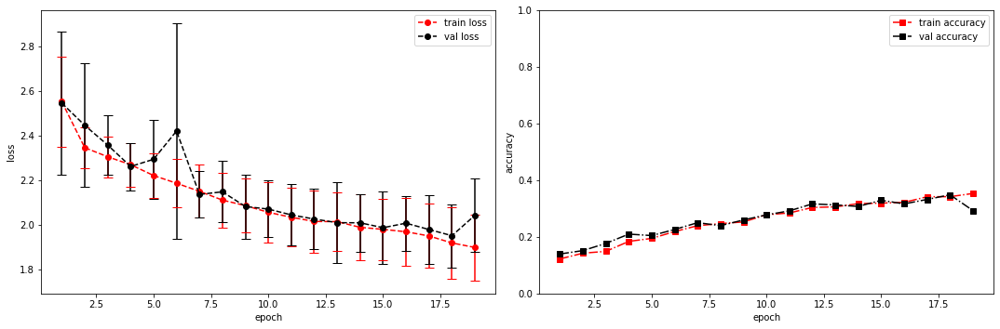

model saved


training epoch:  19
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [20/100], step [1/168],  Loss: 2.0077 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5320937633514404s
Epoch [20/100], step [17/168],  Loss: 1.9221 +/- 0.1672,  accuracy: 0.345703125, time elapsed = 6.242302894592285s
Epoch [20/100], step [33/168],  Loss: 1.9599 +/- 0.1935,  accuracy: 0.3515625, time elapsed = 6.2426464557647705s
Epoch [20/100], step [49/168],  Loss: 1.8369 +/- 0.1069,  accuracy: 0.369140625, time elapsed = 6.243503093719482s
Epoch [20/100], step [65/168],  Loss: 1.9252 +/- 0.1792,  accuracy: 0.337890625, time elapsed = 6.24321174621582s
Epoch [20/100], step [81/168],  Loss: 1.8623 +/- 0.1282,  accuracy: 0.353515625, time elapsed = 6.243014097213745s
Epoch [20/100], step [97/168],  Loss: 1.8047 +/- 0.0923,  accuracy: 0.3671875, time elapsed = 6.243190288543701s
Epoch [20/100], step [113/168],  Loss: 1.8729 +/- 0.2016,  accuracy: 0.38671875, time elapsed = 6.254663944244385s
Epoch [20/100], step [129/168],  Loss: 1.8483 +/- 0.1764,  accuracy: 0.380859375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.364,  precision = 0.364 recall = 0.364 f1 = 0.364 ::: val: acc = 0.339,  precision = 0.339 recall = 0.339 time elapsed = 70.5503659248352s


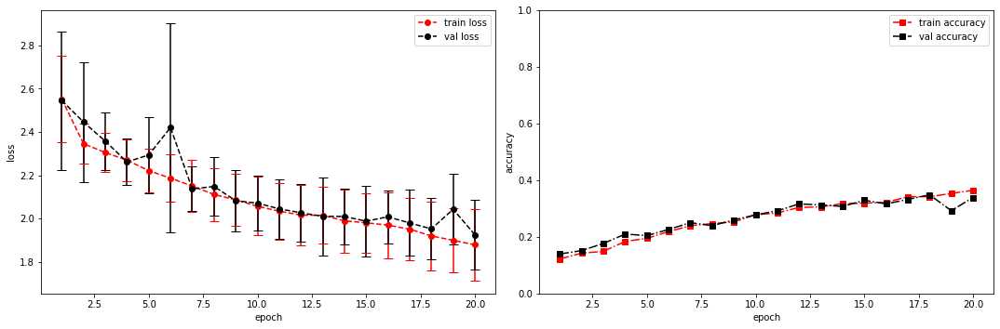

model saved


training epoch:  20
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [21/100], step [1/168],  Loss: 1.8193 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5337071418762207s
Epoch [21/100], step [17/168],  Loss: 1.8085 +/- 0.1269,  accuracy: 0.375, time elapsed = 6.2398457527160645s
Epoch [21/100], step [33/168],  Loss: 1.7967 +/- 0.1606,  accuracy: 0.435546875, time elapsed = 6.239842414855957s
Epoch [21/100], step [49/168],  Loss: 1.8858 +/- 0.1515,  accuracy: 0.3828125, time elapsed = 6.2394609451293945s
Epoch [21/100], step [65/168],  Loss: 1.9044 +/- 0.1623,  accuracy: 0.37109375, time elapsed = 6.240933656692505s
Epoch [21/100], step [81/168],  Loss: 1.8925 +/- 0.1640,  accuracy: 0.341796875, time elapsed = 6.242447853088379s
Epoch [21/100], step [97/168],  Loss: 1.8949 +/- 0.1418,  accuracy: 0.349609375, time elapsed = 6.241081476211548s
Epoch [21/100], step [113/168],  Loss: 1.7981 +/- 0.1591,  accuracy: 0.353515625, time elapsed = 6.2423694133758545s
Epoch [21/100], step [129/168],  Loss: 1.8616 +/- 0.2054,  accuracy: 0.37890625, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.370,  precision = 0.370 recall = 0.370 f1 = 0.370 ::: val: acc = 0.337,  precision = 0.337 recall = 0.337 time elapsed = 70.52140641212463s


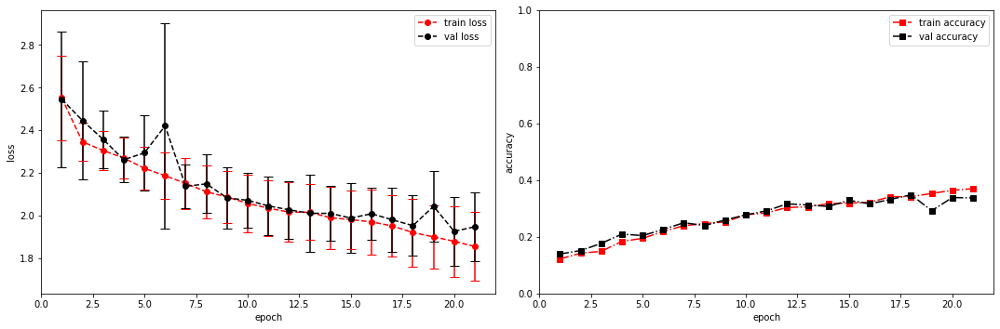

model saved


training epoch:  21
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [22/100], step [1/168],  Loss: 1.8602 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5318427085876465s
Epoch [22/100], step [17/168],  Loss: 1.7919 +/- 0.1406,  accuracy: 0.41796875, time elapsed = 6.242312669754028s
Epoch [22/100], step [33/168],  Loss: 1.8144 +/- 0.1535,  accuracy: 0.375, time elapsed = 6.242170810699463s
Epoch [22/100], step [49/168],  Loss: 1.8547 +/- 0.1446,  accuracy: 0.3671875, time elapsed = 6.246444463729858s
Epoch [22/100], step [65/168],  Loss: 1.7938 +/- 0.1390,  accuracy: 0.39453125, time elapsed = 6.253215789794922s
Epoch [22/100], step [81/168],  Loss: 1.8361 +/- 0.1511,  accuracy: 0.376953125, time elapsed = 6.2425925731658936s
Epoch [22/100], step [97/168],  Loss: 1.8852 +/- 0.1741,  accuracy: 0.365234375, time elapsed = 6.2426300048828125s
Epoch [22/100], step [113/168],  Loss: 1.8575 +/- 0.1001,  accuracy: 0.37109375, time elapsed = 6.2421488761901855s
Epoch [22/100], step [129/168],  Loss: 1.9454 +/- 0.1576,  accuracy: 0.33984375, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.370,  precision = 0.370 recall = 0.370 f1 = 0.370 ::: val: acc = 0.320,  precision = 0.320 recall = 0.320 time elapsed = 70.54423570632935s


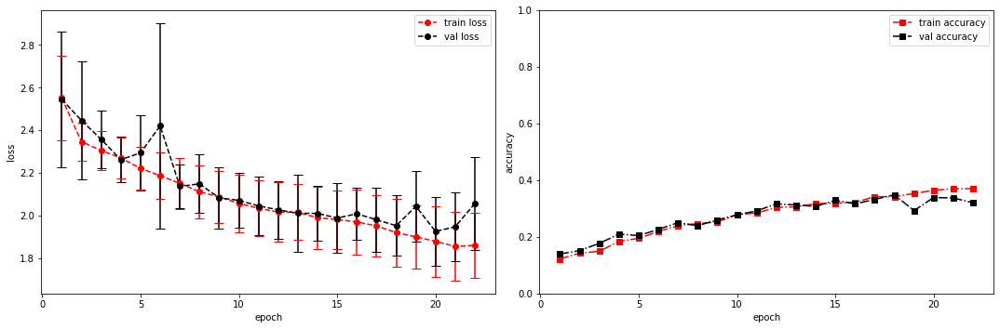

model saved


training epoch:  22
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [23/100], step [1/168],  Loss: 1.9517 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5420327186584473s
Epoch [23/100], step [17/168],  Loss: 1.8492 +/- 0.1495,  accuracy: 0.376953125, time elapsed = 6.243808031082153s
Epoch [23/100], step [33/168],  Loss: 1.8264 +/- 0.1568,  accuracy: 0.3828125, time elapsed = 6.24204683303833s
Epoch [23/100], step [49/168],  Loss: 1.8189 +/- 0.1480,  accuracy: 0.408203125, time elapsed = 6.241529703140259s
Epoch [23/100], step [65/168],  Loss: 1.7823 +/- 0.1412,  accuracy: 0.392578125, time elapsed = 6.24126935005188s
Epoch [23/100], step [81/168],  Loss: 1.7780 +/- 0.0967,  accuracy: 0.404296875, time elapsed = 6.242918491363525s
Epoch [23/100], step [97/168],  Loss: 1.8327 +/- 0.2016,  accuracy: 0.37890625, time elapsed = 6.242074728012085s
Epoch [23/100], step [113/168],  Loss: 1.8119 +/- 0.1277,  accuracy: 0.388671875, time elapsed = 6.241439342498779s
Epoch [23/100], step [129/168],  Loss: 1.8154 +/- 0.1448,  accuracy: 0.423828125, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.393,  precision = 0.393 recall = 0.393 f1 = 0.393 ::: val: acc = 0.372,  precision = 0.372 recall = 0.372 time elapsed = 70.5538547039032s


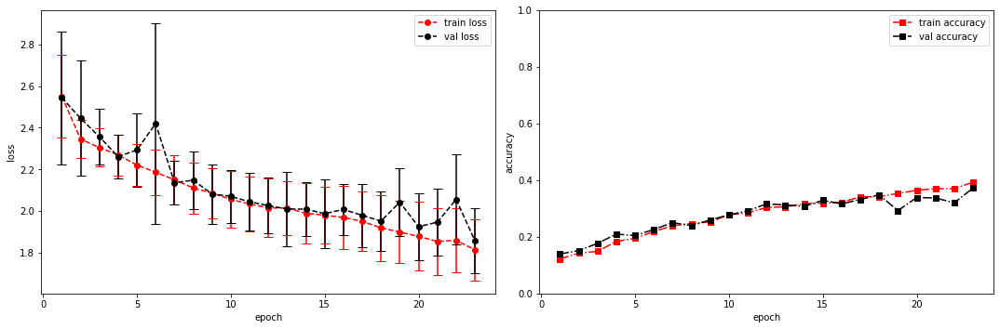

model saved


training epoch:  23
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [24/100], step [1/168],  Loss: 1.8311 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5340502262115479s
Epoch [24/100], step [17/168],  Loss: 1.7693 +/- 0.1548,  accuracy: 0.42578125, time elapsed = 6.242131948471069s
Epoch [24/100], step [33/168],  Loss: 1.8500 +/- 0.1556,  accuracy: 0.373046875, time elapsed = 6.242397785186768s
Epoch [24/100], step [49/168],  Loss: 1.8710 +/- 0.1824,  accuracy: 0.35546875, time elapsed = 6.243371486663818s
Epoch [24/100], step [65/168],  Loss: 1.7553 +/- 0.1819,  accuracy: 0.408203125, time elapsed = 6.2417755126953125s
Epoch [24/100], step [81/168],  Loss: 1.7480 +/- 0.1537,  accuracy: 0.419921875, time elapsed = 6.243120193481445s
Epoch [24/100], step [97/168],  Loss: 1.8336 +/- 0.1651,  accuracy: 0.392578125, time elapsed = 6.242205858230591s
Epoch [24/100], step [113/168],  Loss: 1.7907 +/- 0.1638,  accuracy: 0.37109375, time elapsed = 6.2441911697387695s
Epoch [24/100], step [129/168],  Loss: 1.8404 +/- 0.1782,  accuracy: 0.365234375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.389,  precision = 0.389 recall = 0.389 f1 = 0.389 ::: val: acc = 0.374,  precision = 0.374 recall = 0.374 time elapsed = 70.53307342529297s


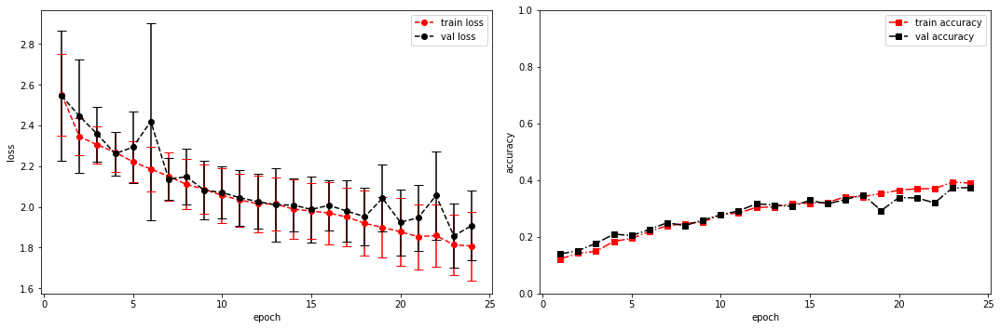

model saved


training epoch:  24
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [25/100], step [1/168],  Loss: 1.8714 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5385725498199463s
Epoch [25/100], step [17/168],  Loss: 1.7592 +/- 0.1883,  accuracy: 0.37890625, time elapsed = 6.241694211959839s
Epoch [25/100], step [33/168],  Loss: 1.7994 +/- 0.1355,  accuracy: 0.412109375, time elapsed = 6.2426958084106445s
Epoch [25/100], step [49/168],  Loss: 1.7839 +/- 0.1547,  accuracy: 0.41015625, time elapsed = 6.242929697036743s
Epoch [25/100], step [65/168],  Loss: 1.7840 +/- 0.2008,  accuracy: 0.38671875, time elapsed = 6.242602825164795s
Epoch [25/100], step [81/168],  Loss: 1.7958 +/- 0.1898,  accuracy: 0.3828125, time elapsed = 6.242196798324585s
Epoch [25/100], step [97/168],  Loss: 1.8013 +/- 0.0999,  accuracy: 0.42578125, time elapsed = 6.2410056591033936s
Epoch [25/100], step [113/168],  Loss: 1.7868 +/- 0.1765,  accuracy: 0.400390625, time elapsed = 6.243432998657227s
Epoch [25/100], step [129/168],  Loss: 1.7567 +/- 0.2171,  accuracy: 0.4375, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.402,  precision = 0.402 recall = 0.402 f1 = 0.402 ::: val: acc = 0.385,  precision = 0.385 recall = 0.385 time elapsed = 70.5451512336731s


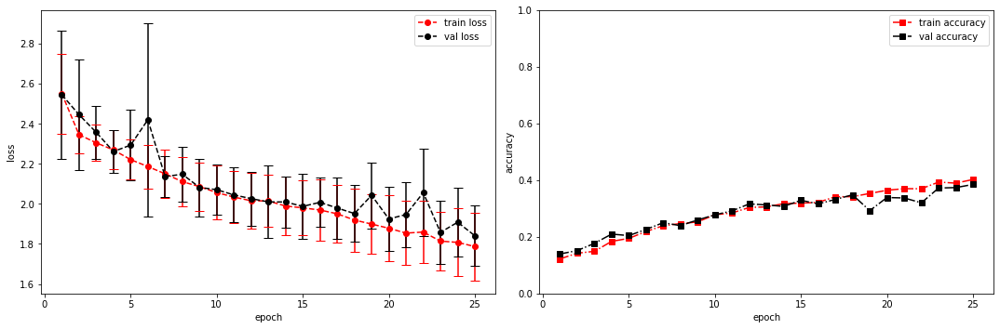

model saved


training epoch:  25
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [26/100], step [1/168],  Loss: 1.5358 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5420880317687988s
Epoch [26/100], step [17/168],  Loss: 1.8002 +/- 0.1361,  accuracy: 0.380859375, time elapsed = 6.241794109344482s
Epoch [26/100], step [33/168],  Loss: 1.7611 +/- 0.1239,  accuracy: 0.400390625, time elapsed = 6.241485595703125s
Epoch [26/100], step [49/168],  Loss: 1.8023 +/- 0.1487,  accuracy: 0.380859375, time elapsed = 6.242718696594238s
Epoch [26/100], step [65/168],  Loss: 1.8485 +/- 0.1754,  accuracy: 0.3671875, time elapsed = 6.241885423660278s
Epoch [26/100], step [81/168],  Loss: 1.7736 +/- 0.1054,  accuracy: 0.396484375, time elapsed = 6.243933916091919s
Epoch [26/100], step [97/168],  Loss: 1.8220 +/- 0.1553,  accuracy: 0.380859375, time elapsed = 6.242093086242676s
Epoch [26/100], step [113/168],  Loss: 1.7334 +/- 0.1740,  accuracy: 0.421875, time elapsed = 6.241094589233398s
Epoch [26/100], step [129/168],  Loss: 1.8269 +/- 0.1659,  accuracy: 0.396484375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.401,  precision = 0.401 recall = 0.401 f1 = 0.401 ::: val: acc = 0.380,  precision = 0.380 recall = 0.380 time elapsed = 70.53575658798218s


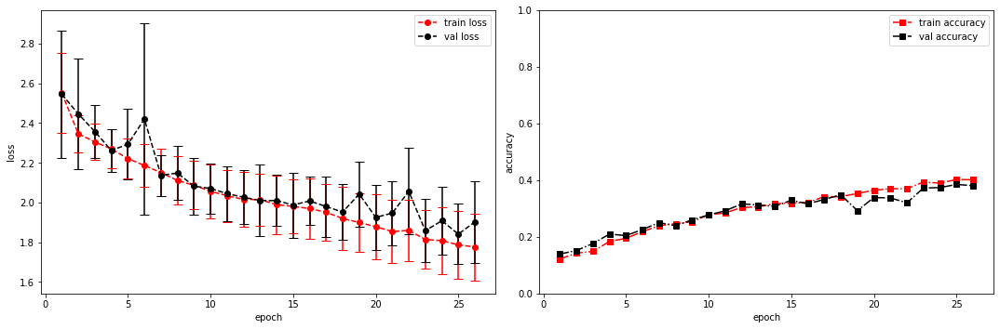

model saved


training epoch:  26
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [27/100], step [1/168],  Loss: 1.5647 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5361201763153076s
Epoch [27/100], step [17/168],  Loss: 1.7098 +/- 0.1532,  accuracy: 0.4453125, time elapsed = 6.241404056549072s
Epoch [27/100], step [33/168],  Loss: 1.6949 +/- 0.2327,  accuracy: 0.43359375, time elapsed = 6.2405126094818115s
Epoch [27/100], step [49/168],  Loss: 1.7467 +/- 0.1469,  accuracy: 0.388671875, time elapsed = 6.242060661315918s
Epoch [27/100], step [65/168],  Loss: 1.7280 +/- 0.1977,  accuracy: 0.41796875, time elapsed = 6.2549803256988525s
Epoch [27/100], step [81/168],  Loss: 1.6876 +/- 0.1873,  accuracy: 0.443359375, time elapsed = 6.251734256744385s
Epoch [27/100], step [97/168],  Loss: 1.7239 +/- 0.1355,  accuracy: 0.3984375, time elapsed = 6.242517709732056s
Epoch [27/100], step [113/168],  Loss: 1.7486 +/- 0.1473,  accuracy: 0.40234375, time elapsed = 6.24299168586731s
Epoch [27/100], step [129/168],  Loss: 1.7177 +/- 0.1589,  accuracy: 0.4375, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.419,  precision = 0.419 recall = 0.419 f1 = 0.419 ::: val: acc = 0.378,  precision = 0.378 recall = 0.378 time elapsed = 70.54804611206055s


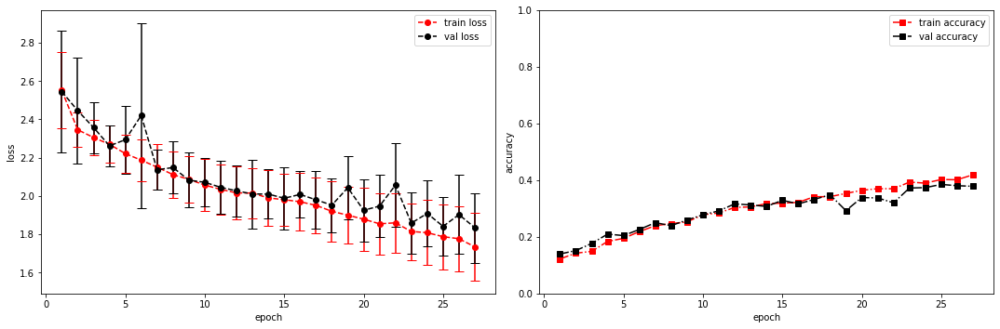

model saved


training epoch:  27
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [28/100], step [1/168],  Loss: 1.4274 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5336933135986328s
Epoch [28/100], step [17/168],  Loss: 1.6985 +/- 0.1896,  accuracy: 0.43359375, time elapsed = 6.243318557739258s
Epoch [28/100], step [33/168],  Loss: 1.6903 +/- 0.1350,  accuracy: 0.45703125, time elapsed = 6.244337558746338s
Epoch [28/100], step [49/168],  Loss: 1.6569 +/- 0.1691,  accuracy: 0.44140625, time elapsed = 6.2440102100372314s
Epoch [28/100], step [65/168],  Loss: 1.7682 +/- 0.1622,  accuracy: 0.404296875, time elapsed = 6.242274045944214s
Epoch [28/100], step [81/168],  Loss: 1.7718 +/- 0.2123,  accuracy: 0.396484375, time elapsed = 6.242815732955933s
Epoch [28/100], step [97/168],  Loss: 1.7522 +/- 0.2328,  accuracy: 0.423828125, time elapsed = 6.242033243179321s
Epoch [28/100], step [113/168],  Loss: 1.8011 +/- 0.2002,  accuracy: 0.380859375, time elapsed = 6.242046356201172s
Epoch [28/100], step [129/168],  Loss: 1.6659 +/- 0.2225,  accuracy: 0.458984375,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.425,  precision = 0.425 recall = 0.425 f1 = 0.425 ::: val: acc = 0.362,  precision = 0.362 recall = 0.362 time elapsed = 70.52946519851685s


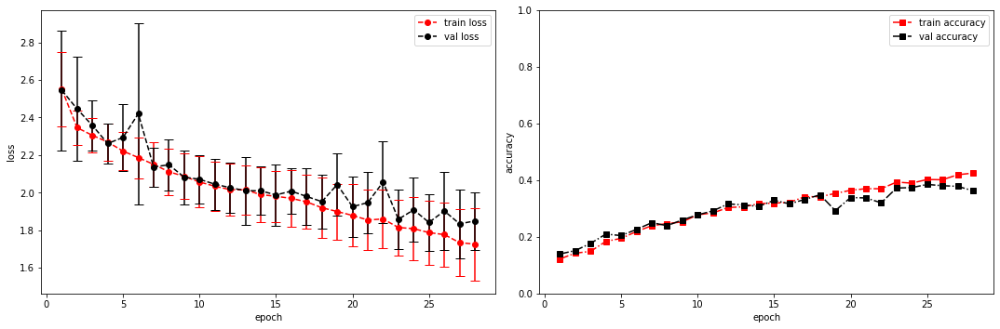

model saved


training epoch:  28
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [29/100], step [1/168],  Loss: 1.3435 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5419180393218994s
Epoch [29/100], step [17/168],  Loss: 1.6657 +/- 0.1962,  accuracy: 0.458984375, time elapsed = 6.253652811050415s
Epoch [29/100], step [33/168],  Loss: 1.6721 +/- 0.1810,  accuracy: 0.439453125, time elapsed = 6.242335081100464s
Epoch [29/100], step [49/168],  Loss: 1.7124 +/- 0.1865,  accuracy: 0.412109375, time elapsed = 6.242334604263306s
Epoch [29/100], step [65/168],  Loss: 1.6583 +/- 0.1055,  accuracy: 0.4453125, time elapsed = 6.2425923347473145s
Epoch [29/100], step [81/168],  Loss: 1.6825 +/- 0.1726,  accuracy: 0.4453125, time elapsed = 6.242305040359497s
Epoch [29/100], step [97/168],  Loss: 1.7210 +/- 0.1711,  accuracy: 0.423828125, time elapsed = 6.242215156555176s
Epoch [29/100], step [113/168],  Loss: 1.7337 +/- 0.1401,  accuracy: 0.421875, time elapsed = 6.241980075836182s
Epoch [29/100], step [129/168],  Loss: 1.7514 +/- 0.2083,  accuracy: 0.404296875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.432,  precision = 0.432 recall = 0.432 f1 = 0.432 ::: val: acc = 0.384,  precision = 0.384 recall = 0.384 time elapsed = 70.5574140548706s


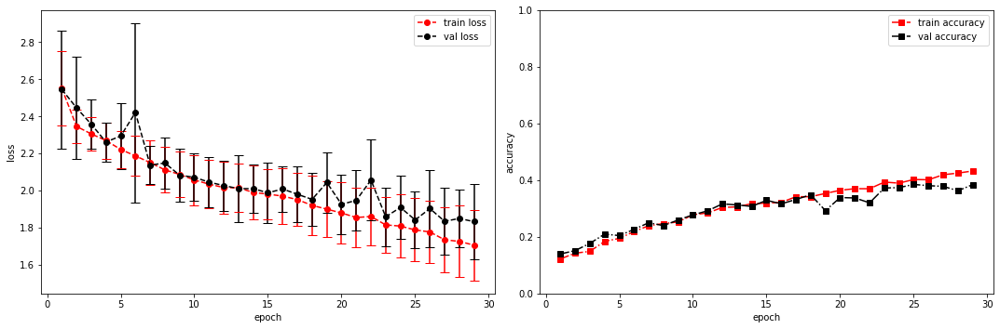

model saved


training epoch:  29
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [30/100], step [1/168],  Loss: 1.7286 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5349395275115967s
Epoch [30/100], step [17/168],  Loss: 1.6441 +/- 0.2266,  accuracy: 0.458984375, time elapsed = 6.242095708847046s
Epoch [30/100], step [33/168],  Loss: 1.6881 +/- 0.1691,  accuracy: 0.427734375, time elapsed = 6.2436535358428955s
Epoch [30/100], step [49/168],  Loss: 1.6261 +/- 0.1626,  accuracy: 0.4609375, time elapsed = 6.244126081466675s
Epoch [30/100], step [65/168],  Loss: 1.7222 +/- 0.2152,  accuracy: 0.443359375, time elapsed = 6.243349313735962s
Epoch [30/100], step [81/168],  Loss: 1.6936 +/- 0.1655,  accuracy: 0.44921875, time elapsed = 6.242262601852417s
Epoch [30/100], step [97/168],  Loss: 1.7548 +/- 0.2327,  accuracy: 0.419921875, time elapsed = 6.244072437286377s
Epoch [30/100], step [113/168],  Loss: 1.7235 +/- 0.2324,  accuracy: 0.439453125, time elapsed = 6.2427895069122314s
Epoch [30/100], step [129/168],  Loss: 1.8139 +/- 0.2052,  accuracy: 0.427734375, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.439,  precision = 0.439 recall = 0.439 f1 = 0.439 ::: val: acc = 0.354,  precision = 0.354 recall = 0.354 time elapsed = 70.54081916809082s


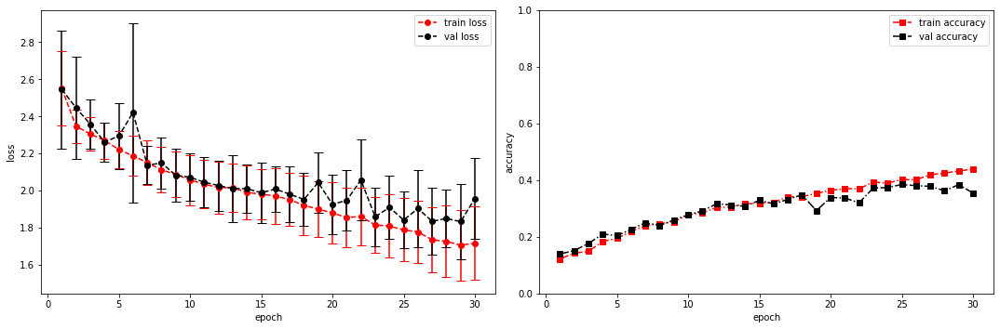

model saved


training epoch:  30
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [31/100], step [1/168],  Loss: 1.9766 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5360941886901855s
Epoch [31/100], step [17/168],  Loss: 1.7390 +/- 0.1742,  accuracy: 0.431640625, time elapsed = 6.240917682647705s
Epoch [31/100], step [33/168],  Loss: 1.7120 +/- 0.1219,  accuracy: 0.435546875, time elapsed = 6.24365234375s
Epoch [31/100], step [49/168],  Loss: 1.6431 +/- 0.1411,  accuracy: 0.466796875, time elapsed = 6.24270486831665s
Epoch [31/100], step [65/168],  Loss: 1.7282 +/- 0.2132,  accuracy: 0.423828125, time elapsed = 6.241971015930176s
Epoch [31/100], step [81/168],  Loss: 1.6315 +/- 0.1482,  accuracy: 0.44921875, time elapsed = 6.242271423339844s
Epoch [31/100], step [97/168],  Loss: 1.6765 +/- 0.0918,  accuracy: 0.435546875, time elapsed = 6.243129253387451s
Epoch [31/100], step [113/168],  Loss: 1.6938 +/- 0.1699,  accuracy: 0.447265625, time elapsed = 6.241999387741089s
Epoch [31/100], step [129/168],  Loss: 1.7190 +/- 0.1393,  accuracy: 0.443359375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.436,  precision = 0.436 recall = 0.436 f1 = 0.436 ::: val: acc = 0.392,  precision = 0.392 recall = 0.392 time elapsed = 70.54387545585632s


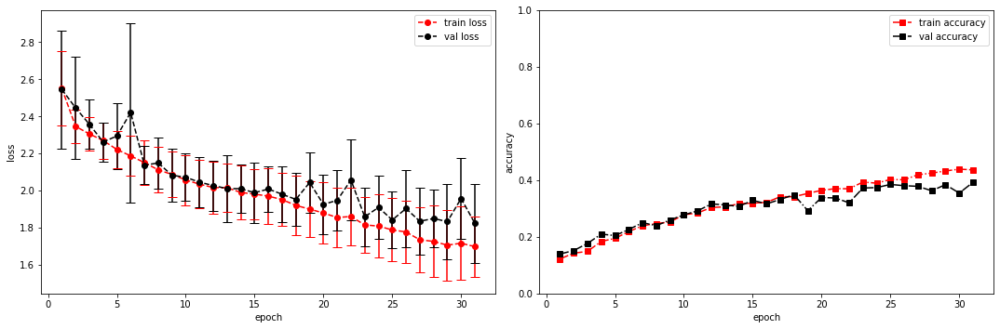

model saved


training epoch:  31
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [32/100], step [1/168],  Loss: 1.6070 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5371251106262207s
Epoch [32/100], step [17/168],  Loss: 1.6110 +/- 0.1876,  accuracy: 0.482421875, time elapsed = 6.239750623703003s
Epoch [32/100], step [33/168],  Loss: 1.6567 +/- 0.1240,  accuracy: 0.45703125, time elapsed = 6.240593194961548s
Epoch [32/100], step [49/168],  Loss: 1.6497 +/- 0.2240,  accuracy: 0.466796875, time elapsed = 6.241694688796997s
Epoch [32/100], step [65/168],  Loss: 1.6336 +/- 0.1622,  accuracy: 0.431640625, time elapsed = 6.243063926696777s
Epoch [32/100], step [81/168],  Loss: 1.8015 +/- 0.1838,  accuracy: 0.3984375, time elapsed = 6.254663944244385s
Epoch [32/100], step [97/168],  Loss: 1.7482 +/- 0.2600,  accuracy: 0.43359375, time elapsed = 6.243326187133789s
Epoch [32/100], step [113/168],  Loss: 1.6821 +/- 0.1805,  accuracy: 0.421875, time elapsed = 6.245689153671265s
Epoch [32/100], step [129/168],  Loss: 1.6193 +/- 0.1395,  accuracy: 0.470703125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.442,  precision = 0.442 recall = 0.442 f1 = 0.442 ::: val: acc = 0.411,  precision = 0.411 recall = 0.411 time elapsed = 70.53893303871155s


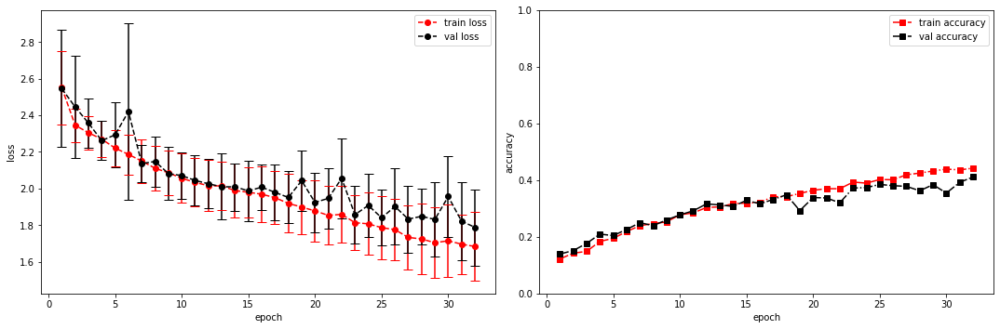

model saved


training epoch:  32
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [33/100], step [1/168],  Loss: 1.8276 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.534024715423584s
Epoch [33/100], step [17/168],  Loss: 1.7196 +/- 0.1635,  accuracy: 0.40234375, time elapsed = 6.2417685985565186s
Epoch [33/100], step [33/168],  Loss: 1.6724 +/- 0.1436,  accuracy: 0.455078125, time elapsed = 6.24133563041687s
Epoch [33/100], step [49/168],  Loss: 1.6547 +/- 0.1847,  accuracy: 0.453125, time elapsed = 6.243800640106201s
Epoch [33/100], step [65/168],  Loss: 1.5486 +/- 0.1860,  accuracy: 0.501953125, time elapsed = 6.241521120071411s
Epoch [33/100], step [81/168],  Loss: 1.6786 +/- 0.1353,  accuracy: 0.46484375, time elapsed = 6.242151498794556s
Epoch [33/100], step [97/168],  Loss: 1.7048 +/- 0.1674,  accuracy: 0.423828125, time elapsed = 6.242047309875488s
Epoch [33/100], step [113/168],  Loss: 1.6848 +/- 0.1400,  accuracy: 0.4296875, time elapsed = 6.241851091384888s
Epoch [33/100], step [129/168],  Loss: 1.6737 +/- 0.1801,  accuracy: 0.435546875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.446,  precision = 0.446 recall = 0.446 f1 = 0.446 ::: val: acc = 0.381,  precision = 0.381 recall = 0.381 time elapsed = 70.53785371780396s


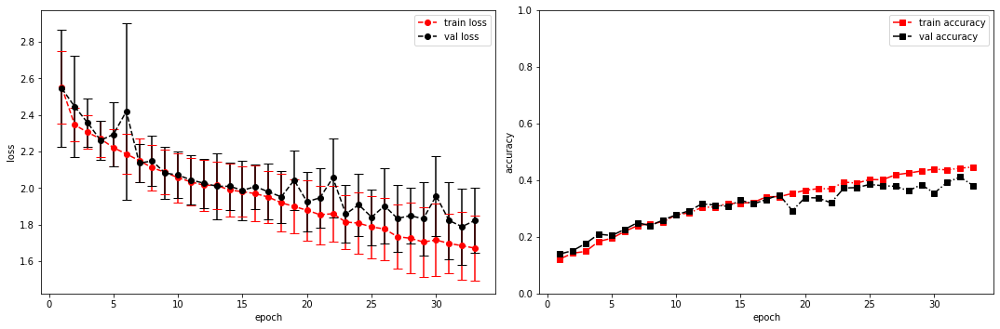

model saved


training epoch:  33
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [34/100], step [1/168],  Loss: 1.5773 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5332903861999512s
Epoch [34/100], step [17/168],  Loss: 1.6594 +/- 0.1411,  accuracy: 0.443359375, time elapsed = 6.255765914916992s
Epoch [34/100], step [33/168],  Loss: 1.5896 +/- 0.1683,  accuracy: 0.498046875, time elapsed = 6.244060039520264s
Epoch [34/100], step [49/168],  Loss: 1.6498 +/- 0.1755,  accuracy: 0.453125, time elapsed = 6.242470026016235s
Epoch [34/100], step [65/168],  Loss: 1.6663 +/- 0.1671,  accuracy: 0.455078125, time elapsed = 6.242867708206177s
Epoch [34/100], step [81/168],  Loss: 1.6738 +/- 0.1956,  accuracy: 0.43359375, time elapsed = 6.241894245147705s
Epoch [34/100], step [97/168],  Loss: 1.6796 +/- 0.1717,  accuracy: 0.43359375, time elapsed = 6.242207050323486s
Epoch [34/100], step [113/168],  Loss: 1.6897 +/- 0.1444,  accuracy: 0.4296875, time elapsed = 6.241507053375244s
Epoch [34/100], step [129/168],  Loss: 1.6119 +/- 0.2249,  accuracy: 0.470703125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.450,  precision = 0.450 recall = 0.450 f1 = 0.450 ::: val: acc = 0.390,  precision = 0.390 recall = 0.390 time elapsed = 70.55033946037292s


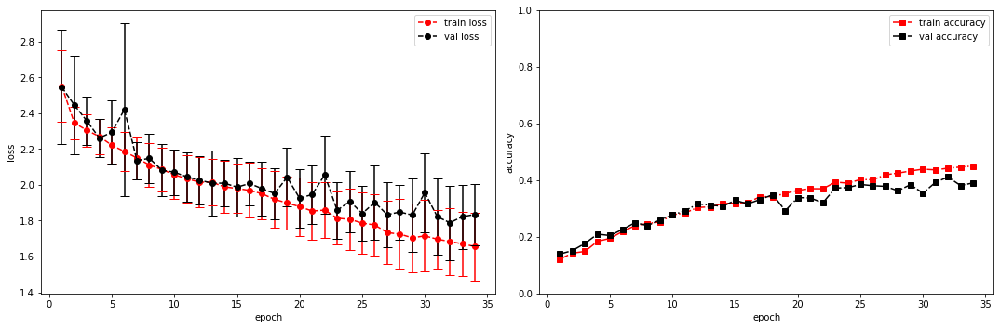

model saved


training epoch:  34
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [35/100], step [1/168],  Loss: 1.2631 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.537445068359375s
Epoch [35/100], step [17/168],  Loss: 1.6158 +/- 0.1633,  accuracy: 0.451171875, time elapsed = 6.242165803909302s
Epoch [35/100], step [33/168],  Loss: 1.5862 +/- 0.1759,  accuracy: 0.49609375, time elapsed = 6.24261999130249s
Epoch [35/100], step [49/168],  Loss: 1.6593 +/- 0.1754,  accuracy: 0.435546875, time elapsed = 6.241008281707764s
Epoch [35/100], step [65/168],  Loss: 1.5706 +/- 0.2144,  accuracy: 0.515625, time elapsed = 6.24264931678772s
Epoch [35/100], step [81/168],  Loss: 1.6854 +/- 0.2067,  accuracy: 0.435546875, time elapsed = 6.242018222808838s
Epoch [35/100], step [97/168],  Loss: 1.5608 +/- 0.1633,  accuracy: 0.50390625, time elapsed = 6.241369724273682s
Epoch [35/100], step [113/168],  Loss: 1.6679 +/- 0.1623,  accuracy: 0.44140625, time elapsed = 6.241302490234375s
Epoch [35/100], step [129/168],  Loss: 1.6613 +/- 0.1093,  accuracy: 0.462890625, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.465,  precision = 0.465 recall = 0.465 f1 = 0.465 ::: val: acc = 0.382,  precision = 0.382 recall = 0.382 time elapsed = 70.57078242301941s


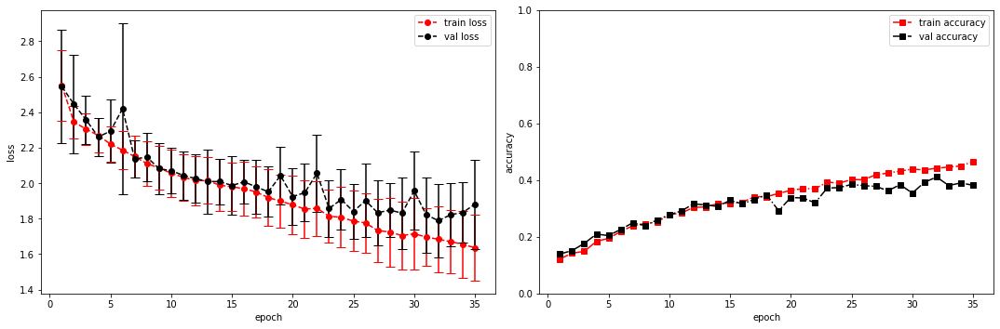

model saved


training epoch:  35
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [36/100], step [1/168],  Loss: 1.5522 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5635931491851807s
Epoch [36/100], step [17/168],  Loss: 1.6191 +/- 0.2126,  accuracy: 0.466796875, time elapsed = 6.243538856506348s
Epoch [36/100], step [33/168],  Loss: 1.5839 +/- 0.1527,  accuracy: 0.45703125, time elapsed = 6.245298385620117s
Epoch [36/100], step [49/168],  Loss: 1.5769 +/- 0.1594,  accuracy: 0.4921875, time elapsed = 6.24342942237854s
Epoch [36/100], step [65/168],  Loss: 1.6093 +/- 0.1841,  accuracy: 0.478515625, time elapsed = 6.242644309997559s
Epoch [36/100], step [81/168],  Loss: 1.6746 +/- 0.1789,  accuracy: 0.4453125, time elapsed = 6.243377447128296s
Epoch [36/100], step [97/168],  Loss: 1.6932 +/- 0.2304,  accuracy: 0.4609375, time elapsed = 6.243129253387451s
Epoch [36/100], step [113/168],  Loss: 1.6661 +/- 0.2439,  accuracy: 0.4296875, time elapsed = 6.2455153465271s
Epoch [36/100], step [129/168],  Loss: 1.6516 +/- 0.1921,  accuracy: 0.4609375, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.462,  precision = 0.462 recall = 0.462 f1 = 0.462 ::: val: acc = 0.405,  precision = 0.405 recall = 0.405 time elapsed = 70.57260727882385s


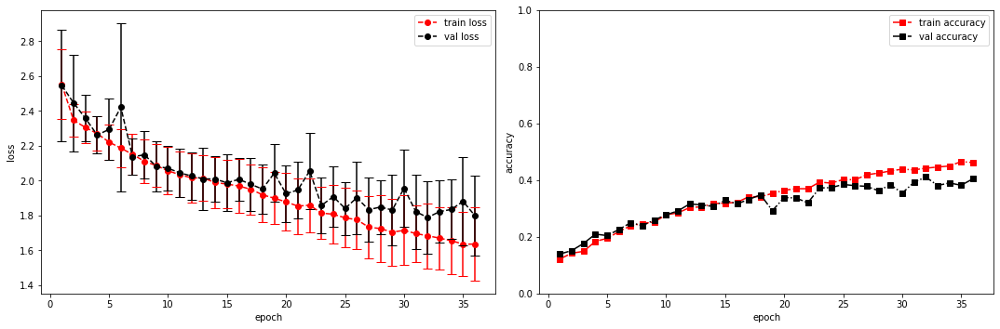

model saved


training epoch:  36
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [37/100], step [1/168],  Loss: 1.8506 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5340807437896729s
Epoch [37/100], step [17/168],  Loss: 1.6261 +/- 0.1776,  accuracy: 0.453125, time elapsed = 6.2430408000946045s
Epoch [37/100], step [33/168],  Loss: 1.5579 +/- 0.1396,  accuracy: 0.486328125, time elapsed = 6.242773056030273s
Epoch [37/100], step [49/168],  Loss: 1.6374 +/- 0.1977,  accuracy: 0.466796875, time elapsed = 6.2428879737854s
Epoch [37/100], step [65/168],  Loss: 1.5695 +/- 0.2087,  accuracy: 0.50390625, time elapsed = 6.242094993591309s
Epoch [37/100], step [81/168],  Loss: 1.6495 +/- 0.2090,  accuracy: 0.462890625, time elapsed = 6.243603467941284s
Epoch [37/100], step [97/168],  Loss: 1.5624 +/- 0.1617,  accuracy: 0.4921875, time elapsed = 6.254120826721191s
Epoch [37/100], step [113/168],  Loss: 1.6007 +/- 0.1593,  accuracy: 0.466796875, time elapsed = 6.242074489593506s
Epoch [37/100], step [129/168],  Loss: 1.7151 +/- 0.1984,  accuracy: 0.4296875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.475,  precision = 0.475 recall = 0.475 f1 = 0.475 ::: val: acc = 0.441,  precision = 0.441 recall = 0.441 time elapsed = 70.5460090637207s


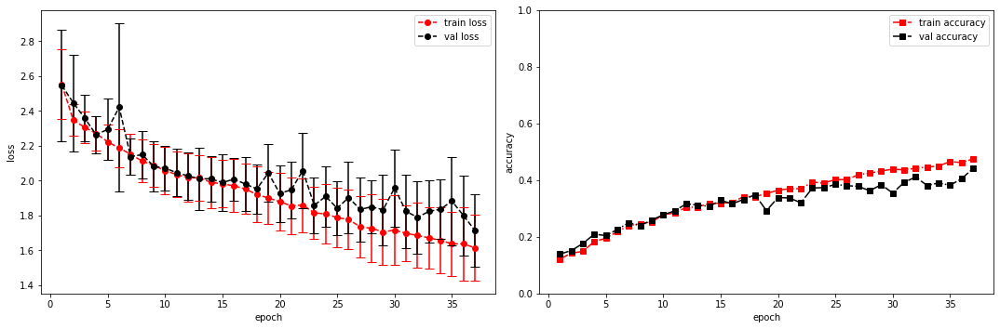

model saved


training epoch:  37
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [38/100], step [1/168],  Loss: 1.4436 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5428071022033691s
Epoch [38/100], step [17/168],  Loss: 1.5001 +/- 0.1514,  accuracy: 0.517578125, time elapsed = 6.242891073226929s
Epoch [38/100], step [33/168],  Loss: 1.5079 +/- 0.1735,  accuracy: 0.509765625, time elapsed = 6.2430877685546875s
Epoch [38/100], step [49/168],  Loss: 1.5863 +/- 0.1704,  accuracy: 0.486328125, time elapsed = 6.245129823684692s
Epoch [38/100], step [65/168],  Loss: 1.5544 +/- 0.1411,  accuracy: 0.505859375, time elapsed = 6.24385666847229s
Epoch [38/100], step [81/168],  Loss: 1.6539 +/- 0.1422,  accuracy: 0.462890625, time elapsed = 6.242947340011597s
Epoch [38/100], step [97/168],  Loss: 1.5794 +/- 0.2016,  accuracy: 0.490234375, time elapsed = 6.243365287780762s
Epoch [38/100], step [113/168],  Loss: 1.5338 +/- 0.1589,  accuracy: 0.501953125, time elapsed = 6.242291212081909s
Epoch [38/100], step [129/168],  Loss: 1.5994 +/- 0.1572,  accuracy: 0.48632812

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.493,  precision = 0.493 recall = 0.493 f1 = 0.493 ::: val: acc = 0.424,  precision = 0.424 recall = 0.424 time elapsed = 70.54621863365173s


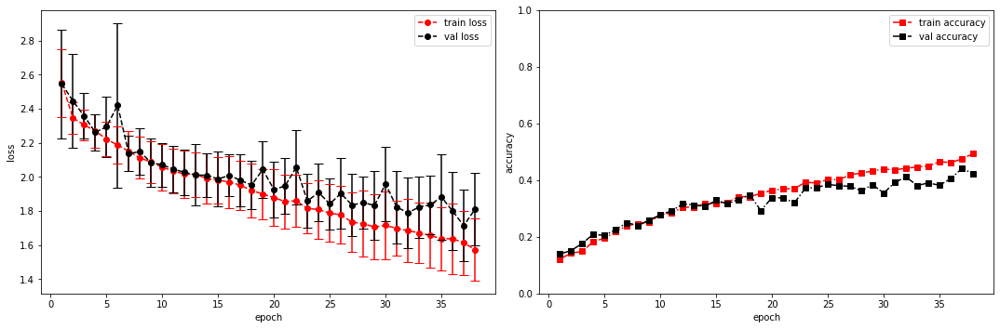

model saved


training epoch:  38
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [39/100], step [1/168],  Loss: 1.5296 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.533829927444458s
Epoch [39/100], step [17/168],  Loss: 1.5853 +/- 0.1840,  accuracy: 0.494140625, time elapsed = 6.242077112197876s
Epoch [39/100], step [33/168],  Loss: 1.4761 +/- 0.1620,  accuracy: 0.529296875, time elapsed = 6.256104230880737s
Epoch [39/100], step [49/168],  Loss: 1.5485 +/- 0.1150,  accuracy: 0.486328125, time elapsed = 6.242074728012085s
Epoch [39/100], step [65/168],  Loss: 1.6591 +/- 0.2895,  accuracy: 0.44921875, time elapsed = 6.242659091949463s
Epoch [39/100], step [81/168],  Loss: 1.5532 +/- 0.1958,  accuracy: 0.490234375, time elapsed = 6.241547346115112s
Epoch [39/100], step [97/168],  Loss: 1.5806 +/- 0.2185,  accuracy: 0.490234375, time elapsed = 6.241060256958008s
Epoch [39/100], step [113/168],  Loss: 1.6465 +/- 0.1778,  accuracy: 0.453125, time elapsed = 6.242216110229492s
Epoch [39/100], step [129/168],  Loss: 1.6118 +/- 0.1666,  accuracy: 0.478515625, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.481,  precision = 0.481 recall = 0.481 f1 = 0.481 ::: val: acc = 0.404,  precision = 0.404 recall = 0.404 time elapsed = 70.55039429664612s


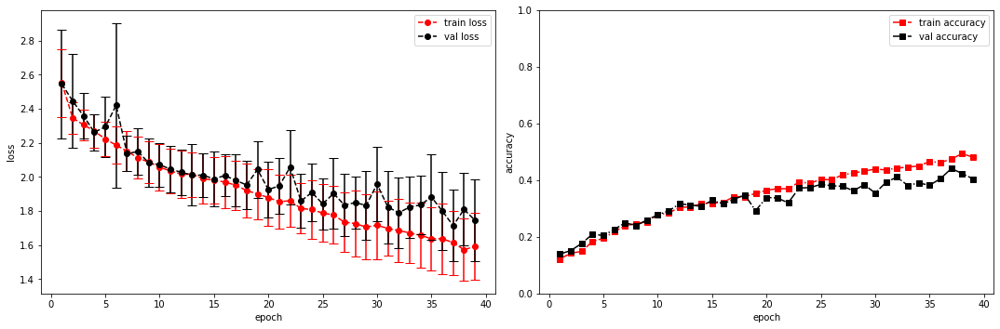

model saved


training epoch:  39
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [40/100], step [1/168],  Loss: 1.3448 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5348329544067383s
Epoch [40/100], step [17/168],  Loss: 1.4578 +/- 0.1252,  accuracy: 0.5390625, time elapsed = 6.242725133895874s
Epoch [40/100], step [33/168],  Loss: 1.5652 +/- 0.1826,  accuracy: 0.490234375, time elapsed = 6.241858959197998s
Epoch [40/100], step [49/168],  Loss: 1.5709 +/- 0.1988,  accuracy: 0.501953125, time elapsed = 6.241417646408081s
Epoch [40/100], step [65/168],  Loss: 1.5524 +/- 0.1332,  accuracy: 0.5, time elapsed = 6.244624614715576s
Epoch [40/100], step [81/168],  Loss: 1.6022 +/- 0.1561,  accuracy: 0.4765625, time elapsed = 6.243446111679077s
Epoch [40/100], step [97/168],  Loss: 1.4903 +/- 0.1251,  accuracy: 0.50390625, time elapsed = 6.24294638633728s
Epoch [40/100], step [113/168],  Loss: 1.5598 +/- 0.1756,  accuracy: 0.505859375, time elapsed = 6.24241042137146s
Epoch [40/100], step [129/168],  Loss: 1.6329 +/- 0.2037,  accuracy: 0.46875, time elapsed = 6.242

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.494,  precision = 0.494 recall = 0.494 f1 = 0.494 ::: val: acc = 0.448,  precision = 0.448 recall = 0.448 time elapsed = 70.55261754989624s


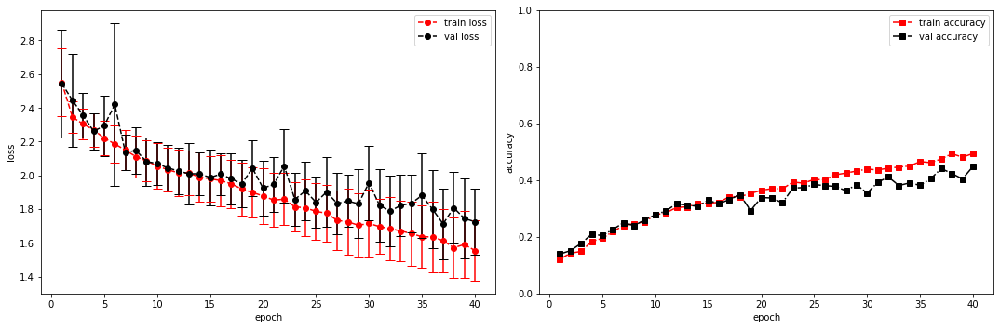

model saved


training epoch:  40
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [41/100], step [1/168],  Loss: 1.5719 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5569336414337158s
Epoch [41/100], step [17/168],  Loss: 1.4942 +/- 0.1754,  accuracy: 0.513671875, time elapsed = 6.241860389709473s
Epoch [41/100], step [33/168],  Loss: 1.6738 +/- 0.1414,  accuracy: 0.46875, time elapsed = 6.242220163345337s
Epoch [41/100], step [49/168],  Loss: 1.5215 +/- 0.1976,  accuracy: 0.5234375, time elapsed = 6.242464542388916s
Epoch [41/100], step [65/168],  Loss: 1.4912 +/- 0.1571,  accuracy: 0.50390625, time elapsed = 6.242236375808716s
Epoch [41/100], step [81/168],  Loss: 1.4800 +/- 0.1321,  accuracy: 0.53125, time elapsed = 6.242164611816406s
Epoch [41/100], step [97/168],  Loss: 1.5445 +/- 0.1203,  accuracy: 0.50390625, time elapsed = 6.243937015533447s
Epoch [41/100], step [113/168],  Loss: 1.4946 +/- 0.1568,  accuracy: 0.513671875, time elapsed = 6.241081237792969s
Epoch [41/100], step [129/168],  Loss: 1.6037 +/- 0.1813,  accuracy: 0.462890625, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.495,  precision = 0.495 recall = 0.495 f1 = 0.495 ::: val: acc = 0.459,  precision = 0.459 recall = 0.459 time elapsed = 70.5676679611206s


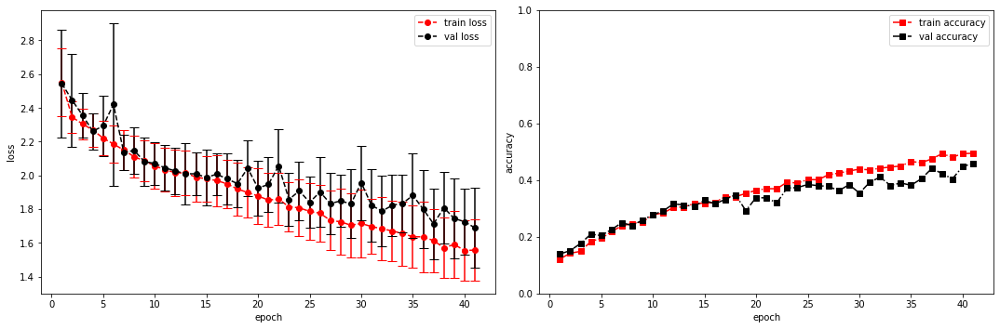

model saved


training epoch:  41
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [42/100], step [1/168],  Loss: 1.5129 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5395035743713379s
Epoch [42/100], step [17/168],  Loss: 1.4931 +/- 0.2350,  accuracy: 0.53125, time elapsed = 6.243187189102173s
Epoch [42/100], step [33/168],  Loss: 1.5146 +/- 0.1843,  accuracy: 0.51171875, time elapsed = 6.243934869766235s
Epoch [42/100], step [49/168],  Loss: 1.5355 +/- 0.2142,  accuracy: 0.4921875, time elapsed = 6.2429587841033936s
Epoch [42/100], step [65/168],  Loss: 1.5689 +/- 0.2095,  accuracy: 0.490234375, time elapsed = 6.242138624191284s
Epoch [42/100], step [81/168],  Loss: 1.5765 +/- 0.2194,  accuracy: 0.486328125, time elapsed = 6.2428178787231445s
Epoch [42/100], step [97/168],  Loss: 1.7090 +/- 0.1747,  accuracy: 0.42578125, time elapsed = 6.254000902175903s
Epoch [42/100], step [113/168],  Loss: 1.4943 +/- 0.1204,  accuracy: 0.4921875, time elapsed = 6.246661901473999s
Epoch [42/100], step [129/168],  Loss: 1.5708 +/- 0.1861,  accuracy: 0.498046875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.486,  precision = 0.486 recall = 0.486 f1 = 0.486 ::: val: acc = 0.422,  precision = 0.422 recall = 0.422 time elapsed = 70.55321073532104s


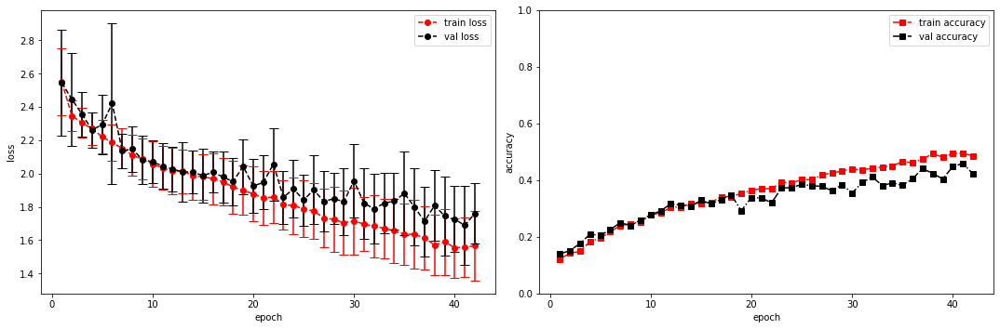

model saved


training epoch:  42
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [43/100], step [1/168],  Loss: 1.7080 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.534745454788208s
Epoch [43/100], step [17/168],  Loss: 1.5717 +/- 0.1451,  accuracy: 0.466796875, time elapsed = 6.240776300430298s
Epoch [43/100], step [33/168],  Loss: 1.4832 +/- 0.2402,  accuracy: 0.5390625, time elapsed = 6.242215156555176s
Epoch [43/100], step [49/168],  Loss: 1.6364 +/- 0.1861,  accuracy: 0.453125, time elapsed = 6.2416088581085205s
Epoch [43/100], step [65/168],  Loss: 1.4899 +/- 0.0950,  accuracy: 0.525390625, time elapsed = 6.242368936538696s
Epoch [43/100], step [81/168],  Loss: 1.5593 +/- 0.2062,  accuracy: 0.49609375, time elapsed = 6.242210388183594s
Epoch [43/100], step [97/168],  Loss: 1.5806 +/- 0.1857,  accuracy: 0.48828125, time elapsed = 6.241823196411133s
Epoch [43/100], step [113/168],  Loss: 1.5742 +/- 0.2374,  accuracy: 0.48828125, time elapsed = 6.241687536239624s
Epoch [43/100], step [129/168],  Loss: 1.5952 +/- 0.1967,  accuracy: 0.47265625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.497,  precision = 0.497 recall = 0.497 f1 = 0.497 ::: val: acc = 0.418,  precision = 0.418 recall = 0.418 time elapsed = 70.52776384353638s


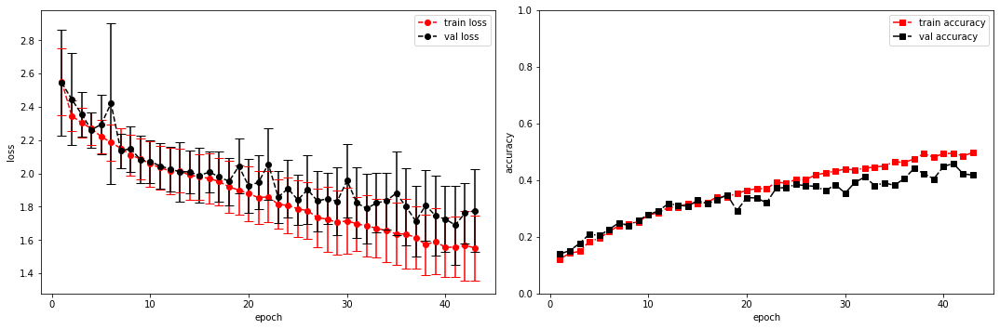

model saved


training epoch:  43
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [44/100], step [1/168],  Loss: 1.5193 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5369653701782227s
Epoch [44/100], step [17/168],  Loss: 1.4186 +/- 0.2365,  accuracy: 0.556640625, time elapsed = 6.243424415588379s
Epoch [44/100], step [33/168],  Loss: 1.4604 +/- 0.2547,  accuracy: 0.513671875, time elapsed = 6.242557764053345s
Epoch [44/100], step [49/168],  Loss: 1.6024 +/- 0.1449,  accuracy: 0.478515625, time elapsed = 6.2549684047698975s
Epoch [44/100], step [65/168],  Loss: 1.5515 +/- 0.2542,  accuracy: 0.5, time elapsed = 6.240865707397461s
Epoch [44/100], step [81/168],  Loss: 1.5928 +/- 0.2246,  accuracy: 0.490234375, time elapsed = 6.243590831756592s
Epoch [44/100], step [97/168],  Loss: 1.5693 +/- 0.1860,  accuracy: 0.494140625, time elapsed = 6.2435643672943115s
Epoch [44/100], step [113/168],  Loss: 1.6274 +/- 0.1968,  accuracy: 0.451171875, time elapsed = 6.242718696594238s
Epoch [44/100], step [129/168],  Loss: 1.4707 +/- 0.2066,  accuracy: 0.517578125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.500,  precision = 0.500 recall = 0.500 f1 = 0.500 ::: val: acc = 0.430,  precision = 0.430 recall = 0.430 time elapsed = 70.55120825767517s


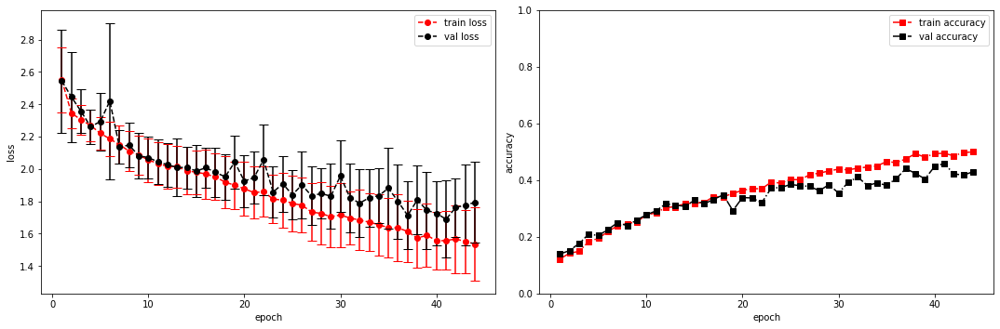

model saved


training epoch:  44
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [45/100], step [1/168],  Loss: 1.3884 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5422379970550537s
Epoch [45/100], step [17/168],  Loss: 1.5358 +/- 0.2614,  accuracy: 0.498046875, time elapsed = 6.243870496749878s
Epoch [45/100], step [33/168],  Loss: 1.4432 +/- 0.2007,  accuracy: 0.52734375, time elapsed = 6.241928815841675s
Epoch [45/100], step [49/168],  Loss: 1.5364 +/- 0.1952,  accuracy: 0.5234375, time elapsed = 6.2420454025268555s
Epoch [45/100], step [65/168],  Loss: 1.5203 +/- 0.1380,  accuracy: 0.498046875, time elapsed = 6.2415313720703125s
Epoch [45/100], step [81/168],  Loss: 1.4727 +/- 0.1486,  accuracy: 0.50390625, time elapsed = 6.2419445514678955s
Epoch [45/100], step [97/168],  Loss: 1.4998 +/- 0.1437,  accuracy: 0.521484375, time elapsed = 6.239923715591431s
Epoch [45/100], step [113/168],  Loss: 1.5125 +/- 0.2193,  accuracy: 0.51953125, time elapsed = 6.239479064941406s
Epoch [45/100], step [129/168],  Loss: 1.4860 +/- 0.1670,  accuracy: 0.505859375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.516,  precision = 0.516 recall = 0.516 f1 = 0.516 ::: val: acc = 0.427,  precision = 0.427 recall = 0.427 time elapsed = 70.5416157245636s


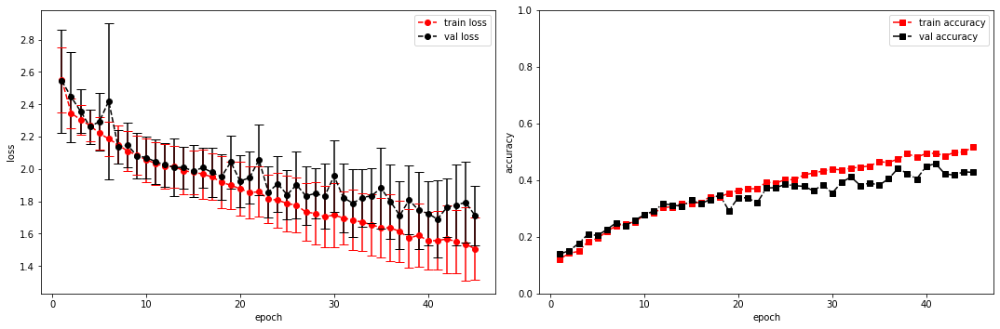

model saved


training epoch:  45
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [46/100], step [1/168],  Loss: 1.7567 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.541996955871582s
Epoch [46/100], step [17/168],  Loss: 1.4346 +/- 0.2531,  accuracy: 0.52734375, time elapsed = 6.24285101890564s
Epoch [46/100], step [33/168],  Loss: 1.4454 +/- 0.2049,  accuracy: 0.52734375, time elapsed = 6.243721961975098s
Epoch [46/100], step [49/168],  Loss: 1.4801 +/- 0.1616,  accuracy: 0.509765625, time elapsed = 6.24302864074707s
Epoch [46/100], step [65/168],  Loss: 1.5783 +/- 0.1853,  accuracy: 0.470703125, time elapsed = 6.243479251861572s
Epoch [46/100], step [81/168],  Loss: 1.5379 +/- 0.1759,  accuracy: 0.48828125, time elapsed = 6.24300479888916s
Epoch [46/100], step [97/168],  Loss: 1.5534 +/- 0.2460,  accuracy: 0.498046875, time elapsed = 6.2441301345825195s
Epoch [46/100], step [113/168],  Loss: 1.5324 +/- 0.1615,  accuracy: 0.5078125, time elapsed = 6.242994546890259s
Epoch [46/100], step [129/168],  Loss: 1.4848 +/- 0.2275,  accuracy: 0.5234375, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.511,  precision = 0.511 recall = 0.511 f1 = 0.511 ::: val: acc = 0.418,  precision = 0.418 recall = 0.418 time elapsed = 70.54295110702515s


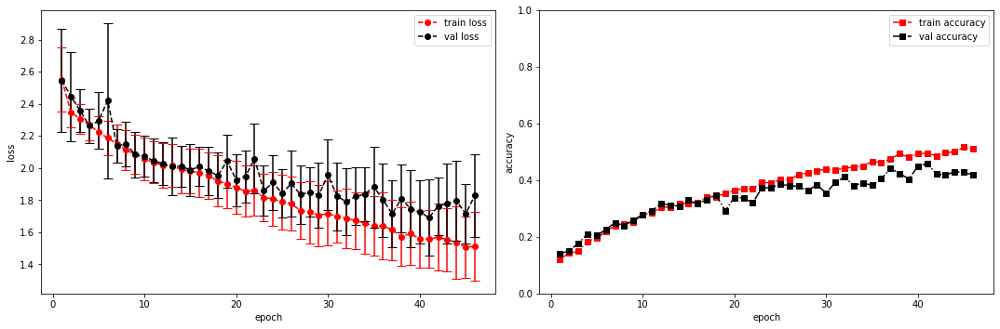

model saved


training epoch:  46
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [47/100], step [1/168],  Loss: 1.4814 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.54315185546875s
Epoch [47/100], step [17/168],  Loss: 1.4814 +/- 0.2342,  accuracy: 0.52734375, time elapsed = 6.242949724197388s
Epoch [47/100], step [33/168],  Loss: 1.4782 +/- 0.1663,  accuracy: 0.51953125, time elapsed = 6.242224216461182s
Epoch [47/100], step [49/168],  Loss: 1.4473 +/- 0.1993,  accuracy: 0.54296875, time elapsed = 6.242829322814941s
Epoch [47/100], step [65/168],  Loss: 1.5633 +/- 0.1787,  accuracy: 0.49609375, time elapsed = 6.2425572872161865s
Epoch [47/100], step [81/168],  Loss: 1.4695 +/- 0.1183,  accuracy: 0.541015625, time elapsed = 6.242978096008301s
Epoch [47/100], step [97/168],  Loss: 1.5574 +/- 0.2504,  accuracy: 0.498046875, time elapsed = 6.243731737136841s
Epoch [47/100], step [113/168],  Loss: 1.4328 +/- 0.1571,  accuracy: 0.5546875, time elapsed = 6.254792928695679s
Epoch [47/100], step [129/168],  Loss: 1.5148 +/- 0.1955,  accuracy: 0.49609375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.511,  precision = 0.511 recall = 0.511 f1 = 0.511 ::: val: acc = 0.459,  precision = 0.459 recall = 0.459 time elapsed = 70.55447196960449s


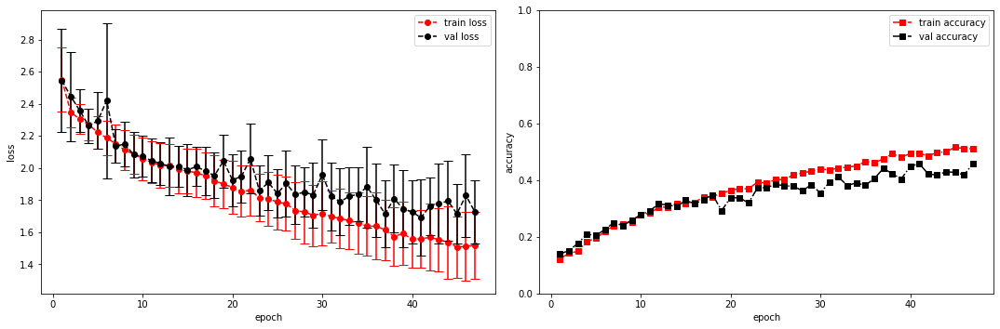

model saved


training epoch:  47
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [48/100], step [1/168],  Loss: 1.2180 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5478146076202393s
Epoch [48/100], step [17/168],  Loss: 1.5335 +/- 0.1874,  accuracy: 0.505859375, time elapsed = 6.23567008972168s
Epoch [48/100], step [33/168],  Loss: 1.4731 +/- 0.1927,  accuracy: 0.5234375, time elapsed = 6.243082046508789s
Epoch [48/100], step [49/168],  Loss: 1.4513 +/- 0.1672,  accuracy: 0.541015625, time elapsed = 6.2434611320495605s
Epoch [48/100], step [65/168],  Loss: 1.5423 +/- 0.1332,  accuracy: 0.478515625, time elapsed = 6.242319107055664s
Epoch [48/100], step [81/168],  Loss: 1.5594 +/- 0.1616,  accuracy: 0.5078125, time elapsed = 6.245163202285767s
Epoch [48/100], step [97/168],  Loss: 1.5101 +/- 0.1866,  accuracy: 0.4921875, time elapsed = 6.242921829223633s
Epoch [48/100], step [113/168],  Loss: 1.5952 +/- 0.2328,  accuracy: 0.484375, time elapsed = 6.242704629898071s
Epoch [48/100], step [129/168],  Loss: 1.6017 +/- 0.2332,  accuracy: 0.484375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.504,  precision = 0.504 recall = 0.504 f1 = 0.504 ::: val: acc = 0.442,  precision = 0.442 recall = 0.442 time elapsed = 70.55562448501587s


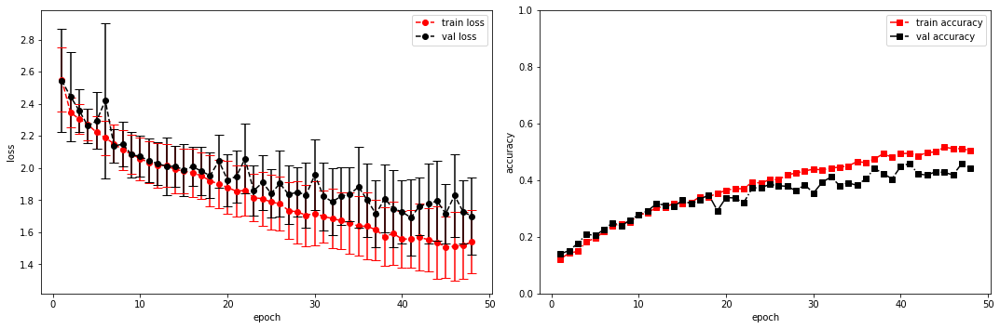

model saved


training epoch:  48
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [49/100], step [1/168],  Loss: 1.2706 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5328078269958496s
Epoch [49/100], step [17/168],  Loss: 1.3785 +/- 0.1311,  accuracy: 0.53125, time elapsed = 6.241616725921631s
Epoch [49/100], step [33/168],  Loss: 1.4260 +/- 0.1689,  accuracy: 0.541015625, time elapsed = 6.241826057434082s
Epoch [49/100], step [49/168],  Loss: 1.5475 +/- 0.2387,  accuracy: 0.509765625, time elapsed = 6.24467921257019s
Epoch [49/100], step [65/168],  Loss: 1.5545 +/- 0.2353,  accuracy: 0.501953125, time elapsed = 6.251427412033081s
Epoch [49/100], step [81/168],  Loss: 1.4984 +/- 0.1293,  accuracy: 0.5, time elapsed = 6.240869522094727s
Epoch [49/100], step [97/168],  Loss: 1.4856 +/- 0.1695,  accuracy: 0.5234375, time elapsed = 6.241119861602783s
Epoch [49/100], step [113/168],  Loss: 1.5980 +/- 0.1343,  accuracy: 0.470703125, time elapsed = 6.25590705871582s
Epoch [49/100], step [129/168],  Loss: 1.6969 +/- 0.1812,  accuracy: 0.443359375, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.505,  precision = 0.505 recall = 0.505 f1 = 0.505 ::: val: acc = 0.489,  precision = 0.489 recall = 0.489 time elapsed = 70.52216148376465s


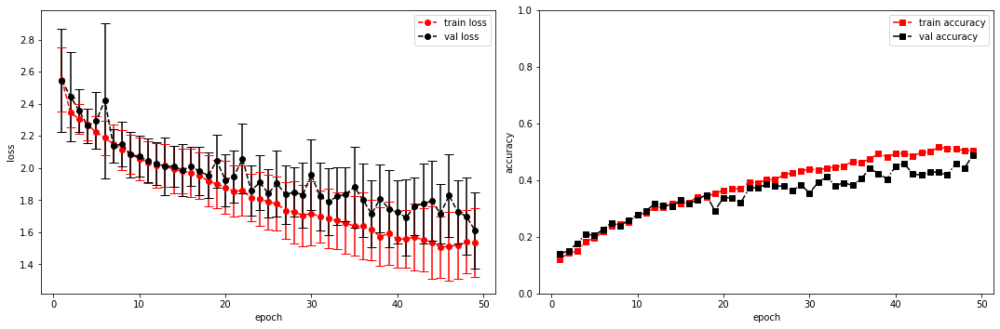

model saved


training epoch:  49
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [50/100], step [1/168],  Loss: 1.8187 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5384809970855713s
Epoch [50/100], step [17/168],  Loss: 1.3057 +/- 0.1227,  accuracy: 0.611328125, time elapsed = 6.243340253829956s
Epoch [50/100], step [33/168],  Loss: 1.5208 +/- 0.1410,  accuracy: 0.505859375, time elapsed = 6.242492914199829s
Epoch [50/100], step [49/168],  Loss: 1.4020 +/- 0.1572,  accuracy: 0.544921875, time elapsed = 6.242652416229248s
Epoch [50/100], step [65/168],  Loss: 1.4976 +/- 0.1878,  accuracy: 0.525390625, time elapsed = 6.242345333099365s
Epoch [50/100], step [81/168],  Loss: 1.4608 +/- 0.1609,  accuracy: 0.53515625, time elapsed = 6.242394208908081s
Epoch [50/100], step [97/168],  Loss: 1.3603 +/- 0.1884,  accuracy: 0.544921875, time elapsed = 6.24235200881958s
Epoch [50/100], step [113/168],  Loss: 1.5034 +/- 0.1880,  accuracy: 0.517578125, time elapsed = 6.24333119392395s
Epoch [50/100], step [129/168],  Loss: 1.4426 +/- 0.1773,  accuracy: 0.533203125, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.531,  precision = 0.531 recall = 0.531 f1 = 0.531 ::: val: acc = 0.442,  precision = 0.442 recall = 0.442 time elapsed = 70.5809907913208s


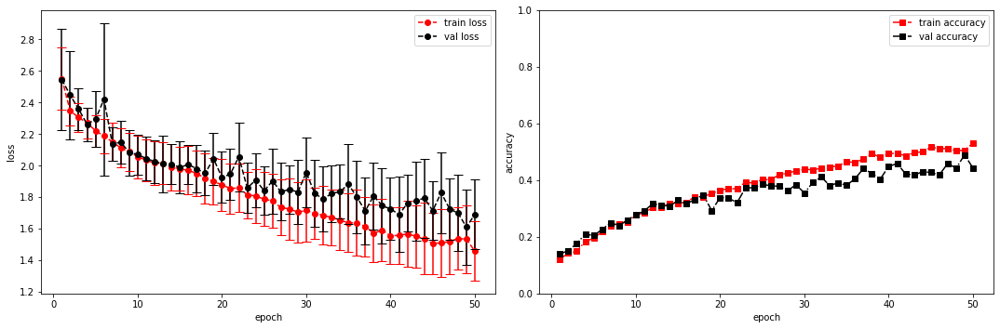

model saved


training epoch:  50
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [51/100], step [1/168],  Loss: 1.4505 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5328114032745361s
Epoch [51/100], step [17/168],  Loss: 1.3676 +/- 0.1453,  accuracy: 0.568359375, time elapsed = 6.241863489151001s
Epoch [51/100], step [33/168],  Loss: 1.3137 +/- 0.1237,  accuracy: 0.560546875, time elapsed = 6.241851091384888s
Epoch [51/100], step [49/168],  Loss: 1.4142 +/- 0.2176,  accuracy: 0.541015625, time elapsed = 6.242244720458984s
Epoch [51/100], step [65/168],  Loss: 1.6097 +/- 0.2460,  accuracy: 0.48828125, time elapsed = 6.2413129806518555s
Epoch [51/100], step [81/168],  Loss: 1.5197 +/- 0.1722,  accuracy: 0.49609375, time elapsed = 6.243217945098877s
Epoch [51/100], step [97/168],  Loss: 1.6356 +/- 0.2486,  accuracy: 0.466796875, time elapsed = 6.241697311401367s
Epoch [51/100], step [113/168],  Loss: 1.5502 +/- 0.2747,  accuracy: 0.505859375, time elapsed = 6.241980075836182s
Epoch [51/100], step [129/168],  Loss: 1.4574 +/- 0.2134,  accuracy: 0.521484375

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.517,  precision = 0.517 recall = 0.517 f1 = 0.517 ::: val: acc = 0.455,  precision = 0.455 recall = 0.455 time elapsed = 70.53344106674194s


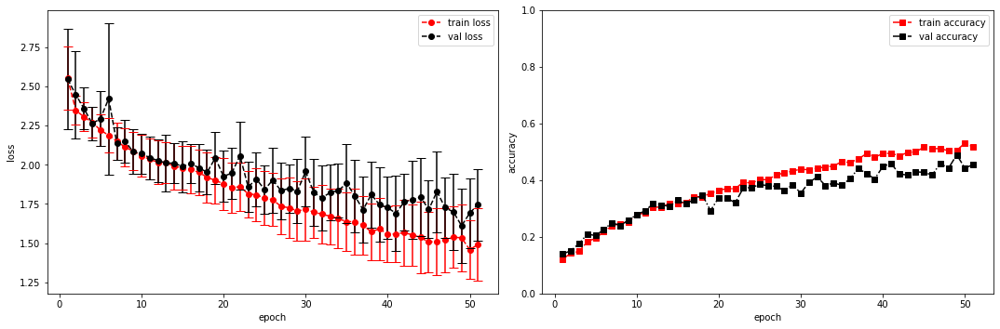

model saved


training epoch:  51
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [52/100], step [1/168],  Loss: 1.7517 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5349490642547607s
Epoch [52/100], step [17/168],  Loss: 1.3655 +/- 0.1601,  accuracy: 0.54296875, time elapsed = 6.243748426437378s
Epoch [52/100], step [33/168],  Loss: 1.5470 +/- 0.2409,  accuracy: 0.501953125, time elapsed = 6.24222207069397s
Epoch [52/100], step [49/168],  Loss: 1.4137 +/- 0.2111,  accuracy: 0.580078125, time elapsed = 6.244314432144165s
Epoch [52/100], step [65/168],  Loss: 1.5191 +/- 0.1882,  accuracy: 0.49609375, time elapsed = 6.244983196258545s
Epoch [52/100], step [81/168],  Loss: 1.3871 +/- 0.1765,  accuracy: 0.55078125, time elapsed = 6.243665933609009s
Epoch [52/100], step [97/168],  Loss: 1.4514 +/- 0.2028,  accuracy: 0.552734375, time elapsed = 6.242936611175537s
Epoch [52/100], step [113/168],  Loss: 1.4771 +/- 0.2311,  accuracy: 0.52734375, time elapsed = 6.244784832000732s
Epoch [52/100], step [129/168],  Loss: 1.4678 +/- 0.1329,  accuracy: 0.498046875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.527,  precision = 0.527 recall = 0.527 f1 = 0.527 ::: val: acc = 0.444,  precision = 0.444 recall = 0.444 time elapsed = 70.56076121330261s


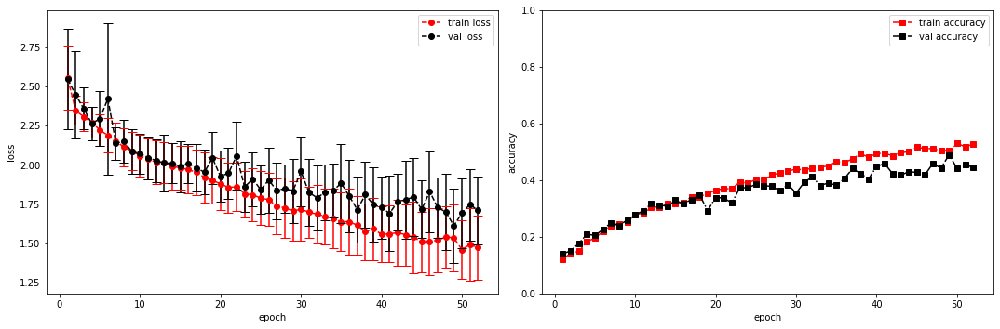

model saved


training epoch:  52
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [53/100], step [1/168],  Loss: 1.5359 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5845696926116943s
Epoch [53/100], step [17/168],  Loss: 1.3731 +/- 0.2006,  accuracy: 0.556640625, time elapsed = 6.242650032043457s
Epoch [53/100], step [33/168],  Loss: 1.4395 +/- 0.1973,  accuracy: 0.53125, time elapsed = 6.243468523025513s
Epoch [53/100], step [49/168],  Loss: 1.4383 +/- 0.1967,  accuracy: 0.529296875, time elapsed = 6.242091178894043s
Epoch [53/100], step [65/168],  Loss: 1.4399 +/- 0.1400,  accuracy: 0.53515625, time elapsed = 6.242449760437012s
Epoch [53/100], step [81/168],  Loss: 1.4451 +/- 0.1943,  accuracy: 0.5703125, time elapsed = 6.242182731628418s
Epoch [53/100], step [97/168],  Loss: 1.4705 +/- 0.2139,  accuracy: 0.525390625, time elapsed = 6.245738506317139s
Epoch [53/100], step [113/168],  Loss: 1.4504 +/- 0.1697,  accuracy: 0.541015625, time elapsed = 6.24238395690918s
Epoch [53/100], step [129/168],  Loss: 1.4980 +/- 0.2424,  accuracy: 0.498046875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.530,  precision = 0.530 recall = 0.530 f1 = 0.530 ::: val: acc = 0.443,  precision = 0.443 recall = 0.443 time elapsed = 70.58736395835876s


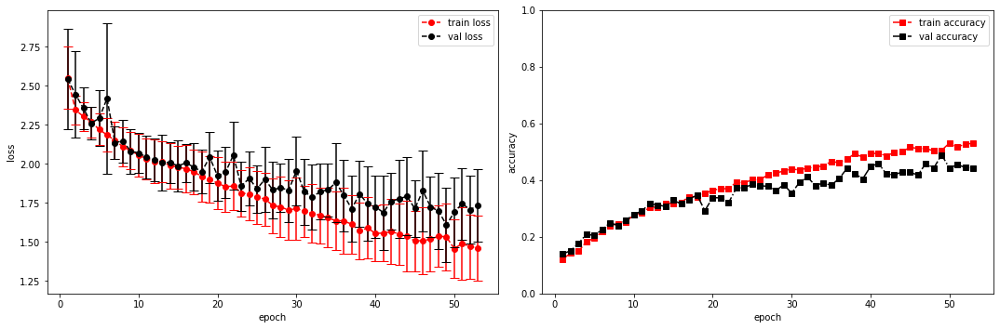

model saved


training epoch:  53
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [54/100], step [1/168],  Loss: 1.7984 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5353660583496094s
Epoch [54/100], step [17/168],  Loss: 1.4173 +/- 0.2190,  accuracy: 0.53515625, time elapsed = 6.242445230484009s
Epoch [54/100], step [33/168],  Loss: 1.3697 +/- 0.2137,  accuracy: 0.57421875, time elapsed = 6.242493629455566s
Epoch [54/100], step [49/168],  Loss: 1.4661 +/- 0.2128,  accuracy: 0.537109375, time elapsed = 6.242463111877441s
Epoch [54/100], step [65/168],  Loss: 1.5254 +/- 0.2182,  accuracy: 0.5234375, time elapsed = 6.253376483917236s
Epoch [54/100], step [81/168],  Loss: 1.5613 +/- 0.1724,  accuracy: 0.484375, time elapsed = 6.243746757507324s
Epoch [54/100], step [97/168],  Loss: 1.6366 +/- 0.1653,  accuracy: 0.455078125, time elapsed = 6.242682933807373s
Epoch [54/100], step [113/168],  Loss: 1.6264 +/- 0.2401,  accuracy: 0.482421875, time elapsed = 6.243512392044067s
Epoch [54/100], step [129/168],  Loss: 1.4933 +/- 0.1498,  accuracy: 0.509765625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.507,  precision = 0.507 recall = 0.507 f1 = 0.507 ::: val: acc = 0.465,  precision = 0.465 recall = 0.465 time elapsed = 70.53295660018921s


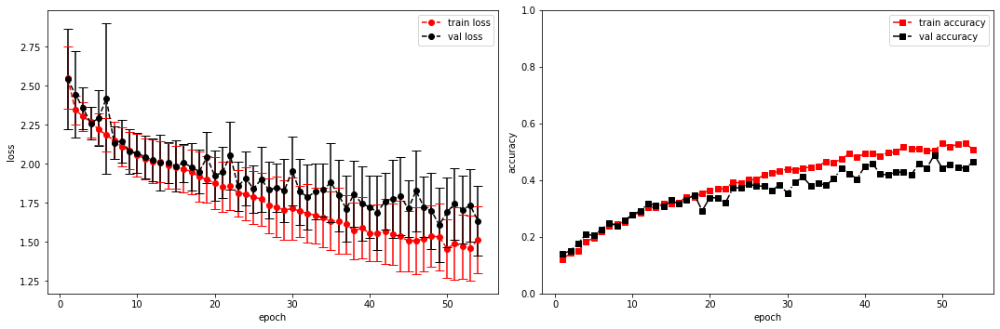

model saved


training epoch:  54
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [55/100], step [1/168],  Loss: 1.3783 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5320882797241211s
Epoch [55/100], step [17/168],  Loss: 1.5550 +/- 0.2037,  accuracy: 0.4921875, time elapsed = 6.241452693939209s
Epoch [55/100], step [33/168],  Loss: 1.5171 +/- 0.1967,  accuracy: 0.529296875, time elapsed = 6.244815111160278s
Epoch [55/100], step [49/168],  Loss: 1.4685 +/- 0.1696,  accuracy: 0.5078125, time elapsed = 6.241114616394043s
Epoch [55/100], step [65/168],  Loss: 1.4975 +/- 0.1910,  accuracy: 0.51171875, time elapsed = 6.24261212348938s
Epoch [55/100], step [81/168],  Loss: 1.4766 +/- 0.1396,  accuracy: 0.517578125, time elapsed = 6.243088960647583s
Epoch [55/100], step [97/168],  Loss: 1.4310 +/- 0.1493,  accuracy: 0.521484375, time elapsed = 6.24284815788269s
Epoch [55/100], step [113/168],  Loss: 1.5109 +/- 0.2037,  accuracy: 0.50390625, time elapsed = 6.2414164543151855s
Epoch [55/100], step [129/168],  Loss: 1.4323 +/- 0.2304,  accuracy: 0.53515625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.514,  precision = 0.514 recall = 0.514 f1 = 0.514 ::: val: acc = 0.453,  precision = 0.453 recall = 0.453 time elapsed = 70.54138088226318s


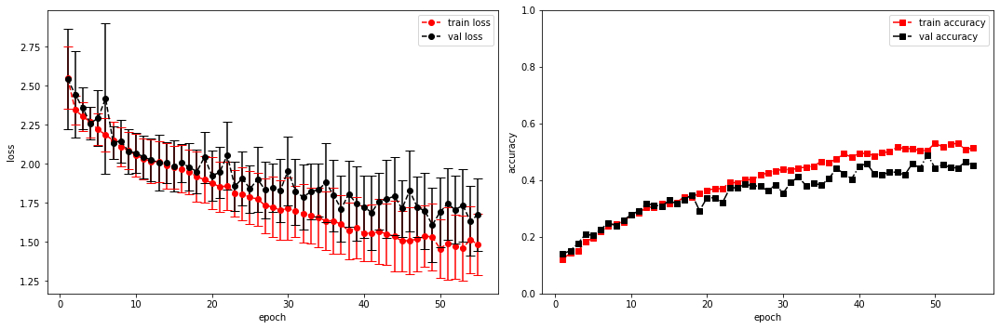

model saved


training epoch:  55
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [56/100], step [1/168],  Loss: 1.3840 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5379171371459961s
Epoch [56/100], step [17/168],  Loss: 1.3392 +/- 0.2144,  accuracy: 0.583984375, time elapsed = 6.264033317565918s
Epoch [56/100], step [33/168],  Loss: 1.3883 +/- 0.1866,  accuracy: 0.552734375, time elapsed = 6.2432074546813965s
Epoch [56/100], step [49/168],  Loss: 1.4299 +/- 0.1485,  accuracy: 0.537109375, time elapsed = 6.241856575012207s
Epoch [56/100], step [65/168],  Loss: 1.4066 +/- 0.0899,  accuracy: 0.525390625, time elapsed = 6.242271661758423s
Epoch [56/100], step [81/168],  Loss: 1.5083 +/- 0.1391,  accuracy: 0.513671875, time elapsed = 6.241762161254883s
Epoch [56/100], step [97/168],  Loss: 1.4647 +/- 0.1354,  accuracy: 0.52734375, time elapsed = 6.242514371871948s
Epoch [56/100], step [113/168],  Loss: 1.5051 +/- 0.1542,  accuracy: 0.517578125, time elapsed = 6.243807315826416s
Epoch [56/100], step [129/168],  Loss: 1.5103 +/- 0.1442,  accuracy: 0.5, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.533,  precision = 0.533 recall = 0.533 f1 = 0.533 ::: val: acc = 0.464,  precision = 0.464 recall = 0.464 time elapsed = 70.5681529045105s


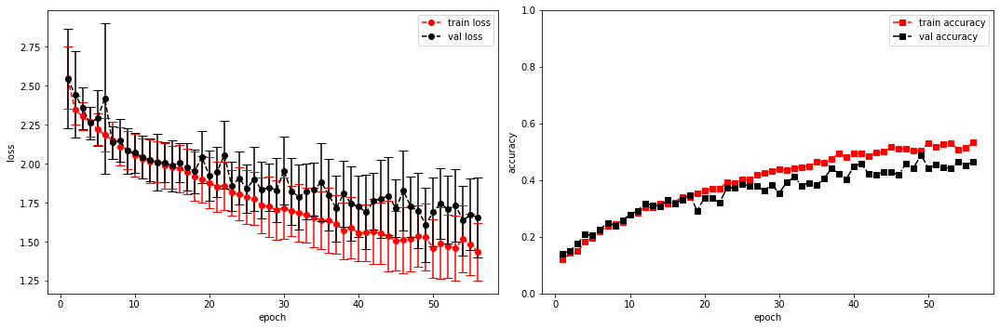

model saved


training epoch:  56
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [57/100], step [1/168],  Loss: 1.5369 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5425677299499512s
Epoch [57/100], step [17/168],  Loss: 1.3238 +/- 0.2118,  accuracy: 0.556640625, time elapsed = 6.241265535354614s
Epoch [57/100], step [33/168],  Loss: 1.5143 +/- 0.1871,  accuracy: 0.521484375, time elapsed = 6.241173267364502s
Epoch [57/100], step [49/168],  Loss: 1.4037 +/- 0.1916,  accuracy: 0.546875, time elapsed = 6.24125075340271s
Epoch [57/100], step [65/168],  Loss: 1.3324 +/- 0.2175,  accuracy: 0.56640625, time elapsed = 6.241732358932495s
Epoch [57/100], step [81/168],  Loss: 1.3648 +/- 0.2244,  accuracy: 0.583984375, time elapsed = 6.241554260253906s
Epoch [57/100], step [97/168],  Loss: 1.5128 +/- 0.2236,  accuracy: 0.525390625, time elapsed = 6.2409913539886475s
Epoch [57/100], step [113/168],  Loss: 1.5769 +/- 0.2210,  accuracy: 0.505859375, time elapsed = 6.2417120933532715s
Epoch [57/100], step [129/168],  Loss: 1.4996 +/- 0.2124,  accuracy: 0.533203125, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.537,  precision = 0.537 recall = 0.537 f1 = 0.537 ::: val: acc = 0.454,  precision = 0.454 recall = 0.454 time elapsed = 70.56205749511719s


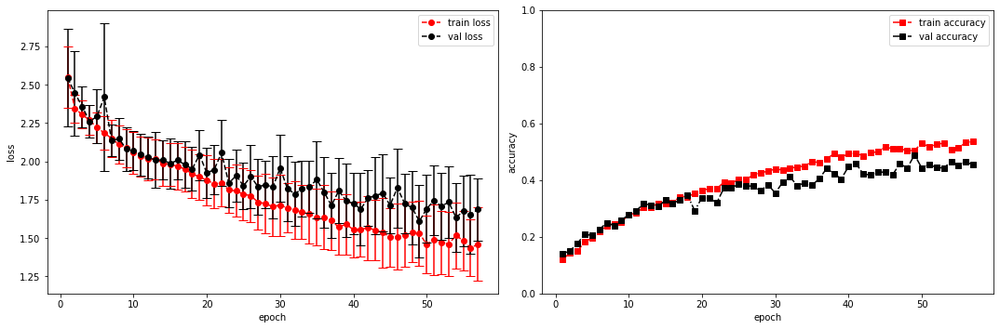

model saved


training epoch:  57
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [58/100], step [1/168],  Loss: 1.4441 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5465681552886963s
Epoch [58/100], step [17/168],  Loss: 1.4914 +/- 0.2597,  accuracy: 0.5234375, time elapsed = 6.241332530975342s
Epoch [58/100], step [33/168],  Loss: 1.3800 +/- 0.1934,  accuracy: 0.56640625, time elapsed = 6.239731550216675s
Epoch [58/100], step [49/168],  Loss: 1.5217 +/- 0.2271,  accuracy: 0.51171875, time elapsed = 6.239988803863525s
Epoch [58/100], step [65/168],  Loss: 1.4652 +/- 0.2099,  accuracy: 0.521484375, time elapsed = 6.240910530090332s
Epoch [58/100], step [81/168],  Loss: 1.4669 +/- 0.2086,  accuracy: 0.50390625, time elapsed = 6.240758895874023s
Epoch [58/100], step [97/168],  Loss: 1.3885 +/- 0.1561,  accuracy: 0.564453125, time elapsed = 6.241635799407959s
Epoch [58/100], step [113/168],  Loss: 1.3381 +/- 0.1553,  accuracy: 0.58203125, time elapsed = 6.239059686660767s
Epoch [58/100], step [129/168],  Loss: 1.5155 +/- 0.1198,  accuracy: 0.49609375, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.534,  precision = 0.534 recall = 0.534 f1 = 0.534 ::: val: acc = 0.441,  precision = 0.441 recall = 0.441 time elapsed = 70.5307502746582s


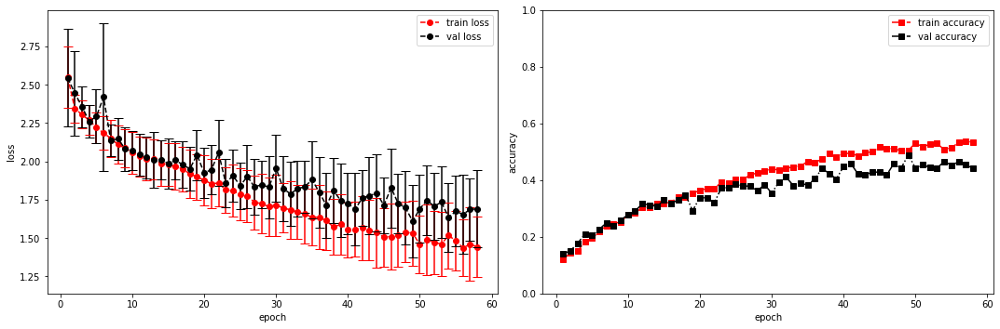

model saved


training epoch:  58
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [59/100], step [1/168],  Loss: 1.6801 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5395753383636475s
Epoch [59/100], step [17/168],  Loss: 1.3981 +/- 0.1404,  accuracy: 0.548828125, time elapsed = 6.24057149887085s
Epoch [59/100], step [33/168],  Loss: 1.4563 +/- 0.2119,  accuracy: 0.529296875, time elapsed = 6.241051435470581s
Epoch [59/100], step [49/168],  Loss: 1.3949 +/- 0.1381,  accuracy: 0.5390625, time elapsed = 6.241059064865112s
Epoch [59/100], step [65/168],  Loss: 1.4766 +/- 0.2172,  accuracy: 0.53125, time elapsed = 6.241425514221191s
Epoch [59/100], step [81/168],  Loss: 1.4336 +/- 0.1571,  accuracy: 0.53515625, time elapsed = 6.254619598388672s
Epoch [59/100], step [97/168],  Loss: 1.5187 +/- 0.1984,  accuracy: 0.4921875, time elapsed = 6.2417707443237305s
Epoch [59/100], step [113/168],  Loss: 1.5071 +/- 0.1850,  accuracy: 0.50390625, time elapsed = 6.241368532180786s
Epoch [59/100], step [129/168],  Loss: 1.4754 +/- 0.1485,  accuracy: 0.513671875, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.524,  precision = 0.524 recall = 0.524 f1 = 0.524 ::: val: acc = 0.440,  precision = 0.440 recall = 0.440 time elapsed = 70.55154323577881s


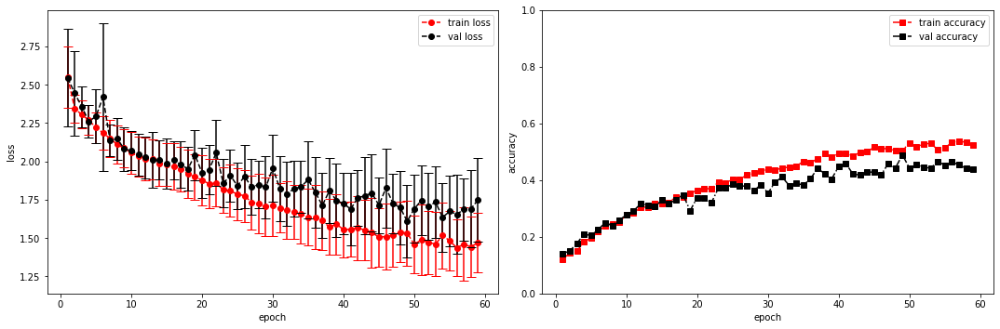

model saved


training epoch:  59
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [60/100], step [1/168],  Loss: 1.4455 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5408327579498291s
Epoch [60/100], step [17/168],  Loss: 1.4927 +/- 0.2187,  accuracy: 0.517578125, time elapsed = 6.242528915405273s
Epoch [60/100], step [33/168],  Loss: 1.3338 +/- 0.2044,  accuracy: 0.58203125, time elapsed = 6.240557670593262s
Epoch [60/100], step [49/168],  Loss: 1.4543 +/- 0.1398,  accuracy: 0.533203125, time elapsed = 6.24360728263855s
Epoch [60/100], step [65/168],  Loss: 1.4995 +/- 0.1988,  accuracy: 0.537109375, time elapsed = 6.241974830627441s
Epoch [60/100], step [81/168],  Loss: 1.4330 +/- 0.2115,  accuracy: 0.533203125, time elapsed = 6.241443872451782s
Epoch [60/100], step [97/168],  Loss: 1.4005 +/- 0.1981,  accuracy: 0.576171875, time elapsed = 6.242974519729614s
Epoch [60/100], step [113/168],  Loss: 1.4844 +/- 0.1837,  accuracy: 0.529296875, time elapsed = 6.243351697921753s
Epoch [60/100], step [129/168],  Loss: 1.3945 +/- 0.1629,  accuracy: 0.533203125,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.539,  precision = 0.539 recall = 0.539 f1 = 0.539 ::: val: acc = 0.488,  precision = 0.488 recall = 0.488 time elapsed = 70.54188752174377s


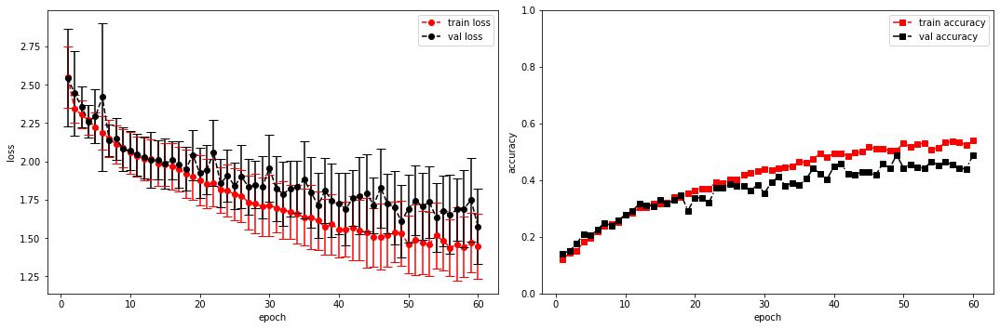

model saved


training epoch:  60
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [61/100], step [1/168],  Loss: 1.3917 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5659787654876709s
Epoch [61/100], step [17/168],  Loss: 1.3968 +/- 0.1978,  accuracy: 0.572265625, time elapsed = 6.245180368423462s
Epoch [61/100], step [33/168],  Loss: 1.4661 +/- 0.1451,  accuracy: 0.544921875, time elapsed = 6.251162052154541s
Epoch [61/100], step [49/168],  Loss: 1.2997 +/- 0.1927,  accuracy: 0.58203125, time elapsed = 6.241278171539307s
Epoch [61/100], step [65/168],  Loss: 1.5848 +/- 0.2156,  accuracy: 0.505859375, time elapsed = 6.241745471954346s
Epoch [61/100], step [81/168],  Loss: 1.4802 +/- 0.2321,  accuracy: 0.533203125, time elapsed = 6.241802453994751s
Epoch [61/100], step [97/168],  Loss: 1.3998 +/- 0.2184,  accuracy: 0.55078125, time elapsed = 6.241101503372192s
Epoch [61/100], step [113/168],  Loss: 1.4800 +/- 0.2349,  accuracy: 0.529296875, time elapsed = 6.241701602935791s
Epoch [61/100], step [129/168],  Loss: 1.4879 +/- 0.1380,  accuracy: 0.48828125, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.530,  precision = 0.530 recall = 0.530 f1 = 0.530 ::: val: acc = 0.488,  precision = 0.488 recall = 0.488 time elapsed = 70.57780694961548s


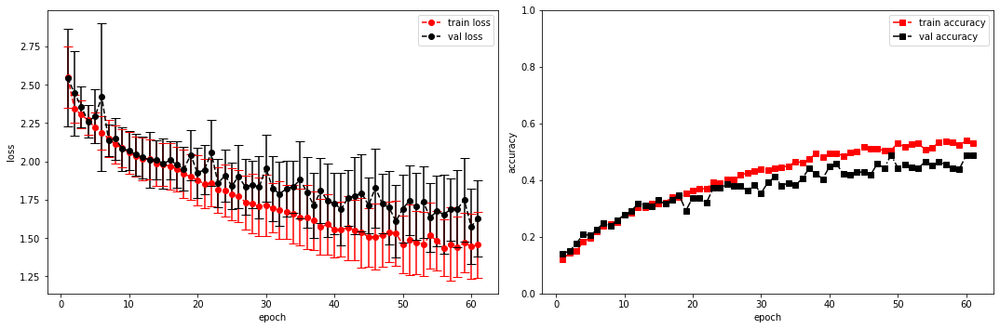

model saved


training epoch:  61
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [62/100], step [1/168],  Loss: 1.2809 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5376071929931641s
Epoch [62/100], step [17/168],  Loss: 1.2997 +/- 0.2049,  accuracy: 0.583984375, time elapsed = 6.24149227142334s
Epoch [62/100], step [33/168],  Loss: 1.3847 +/- 0.1276,  accuracy: 0.529296875, time elapsed = 6.2433693408966064s
Epoch [62/100], step [49/168],  Loss: 1.3531 +/- 0.1653,  accuracy: 0.5703125, time elapsed = 6.24185037612915s
Epoch [62/100], step [65/168],  Loss: 1.4062 +/- 0.2045,  accuracy: 0.529296875, time elapsed = 6.24122166633606s
Epoch [62/100], step [81/168],  Loss: 1.4558 +/- 0.2534,  accuracy: 0.537109375, time elapsed = 6.241459846496582s
Epoch [62/100], step [97/168],  Loss: 1.4862 +/- 0.2005,  accuracy: 0.51953125, time elapsed = 6.2396533489227295s
Epoch [62/100], step [113/168],  Loss: 1.4458 +/- 0.1474,  accuracy: 0.53515625, time elapsed = 6.242188930511475s
Epoch [62/100], step [129/168],  Loss: 1.4251 +/- 0.2007,  accuracy: 0.53125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.534,  precision = 0.534 recall = 0.534 f1 = 0.534 ::: val: acc = 0.445,  precision = 0.445 recall = 0.445 time elapsed = 70.53508520126343s


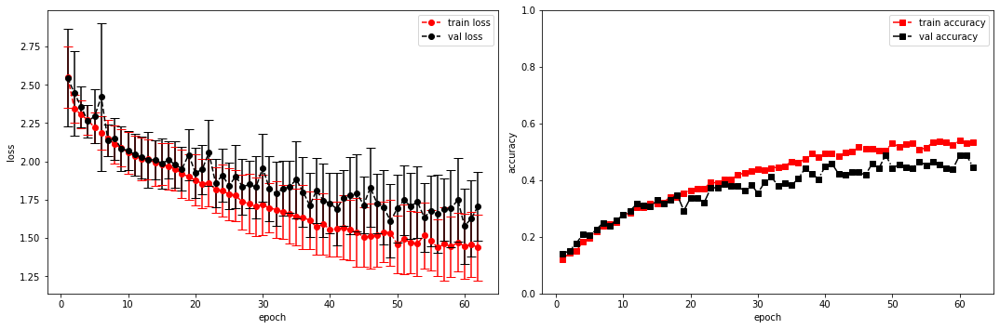

model saved


training epoch:  62
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [63/100], step [1/168],  Loss: 1.4794 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5406742095947266s
Epoch [63/100], step [17/168],  Loss: 1.4409 +/- 0.1685,  accuracy: 0.537109375, time elapsed = 6.241356611251831s
Epoch [63/100], step [33/168],  Loss: 1.4045 +/- 0.2259,  accuracy: 0.537109375, time elapsed = 6.241450071334839s
Epoch [63/100], step [49/168],  Loss: 1.4286 +/- 0.2149,  accuracy: 0.5234375, time elapsed = 6.241293907165527s
Epoch [63/100], step [65/168],  Loss: 1.4115 +/- 0.0971,  accuracy: 0.5390625, time elapsed = 6.2411463260650635s
Epoch [63/100], step [81/168],  Loss: 1.5076 +/- 0.1640,  accuracy: 0.529296875, time elapsed = 6.241366863250732s
Epoch [63/100], step [97/168],  Loss: 1.5652 +/- 0.1488,  accuracy: 0.486328125, time elapsed = 6.241681098937988s
Epoch [63/100], step [113/168],  Loss: 1.4760 +/- 0.2239,  accuracy: 0.5546875, time elapsed = 6.24324107170105s
Epoch [63/100], step [129/168],  Loss: 1.4521 +/- 0.1546,  accuracy: 0.5234375, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.526,  precision = 0.526 recall = 0.526 f1 = 0.526 ::: val: acc = 0.467,  precision = 0.467 recall = 0.467 time elapsed = 70.53187727928162s


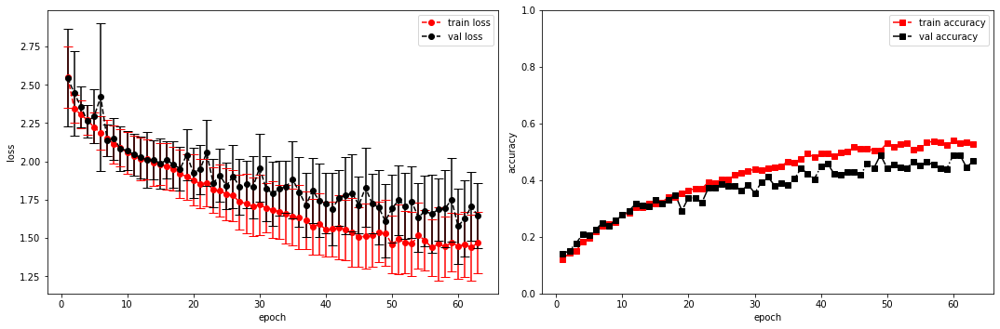

model saved


training epoch:  63
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [64/100], step [1/168],  Loss: 1.2661 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5390439033508301s
Epoch [64/100], step [17/168],  Loss: 1.4415 +/- 0.2002,  accuracy: 0.525390625, time elapsed = 6.242239713668823s
Epoch [64/100], step [33/168],  Loss: 1.4078 +/- 0.1675,  accuracy: 0.529296875, time elapsed = 6.241345643997192s
Epoch [64/100], step [49/168],  Loss: 1.3651 +/- 0.2055,  accuracy: 0.564453125, time elapsed = 6.240631341934204s
Epoch [64/100], step [65/168],  Loss: 1.3704 +/- 0.1491,  accuracy: 0.5390625, time elapsed = 6.242528915405273s
Epoch [64/100], step [81/168],  Loss: 1.4075 +/- 0.1829,  accuracy: 0.5546875, time elapsed = 6.242936611175537s
Epoch [64/100], step [97/168],  Loss: 1.4323 +/- 0.2170,  accuracy: 0.544921875, time elapsed = 6.255589246749878s
Epoch [64/100], step [113/168],  Loss: 1.5724 +/- 0.2536,  accuracy: 0.494140625, time elapsed = 6.2425689697265625s
Epoch [64/100], step [129/168],  Loss: 1.3373 +/- 0.1476,  accuracy: 0.556640625, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.534,  precision = 0.534 recall = 0.534 f1 = 0.534 ::: val: acc = 0.462,  precision = 0.462 recall = 0.462 time elapsed = 70.55012130737305s


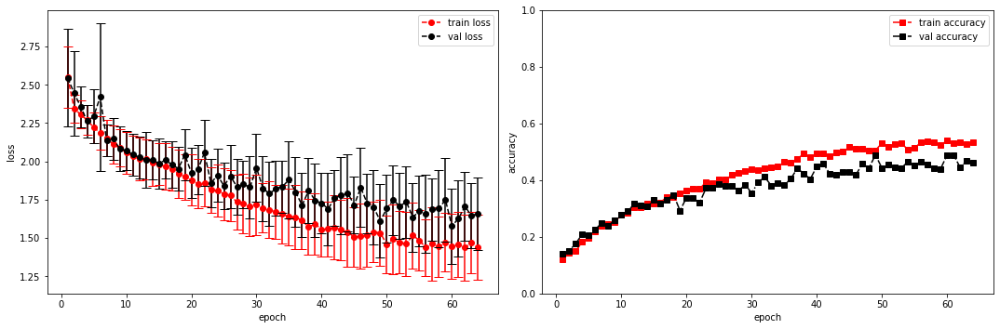

model saved


training epoch:  64
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [65/100], step [1/168],  Loss: 1.5577 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5463917255401611s
Epoch [65/100], step [17/168],  Loss: 1.3467 +/- 0.1790,  accuracy: 0.556640625, time elapsed = 6.2410728931427s
Epoch [65/100], step [33/168],  Loss: 1.3412 +/- 0.2142,  accuracy: 0.576171875, time elapsed = 6.242162227630615s
Epoch [65/100], step [49/168],  Loss: 1.3694 +/- 0.1639,  accuracy: 0.578125, time elapsed = 6.240983009338379s
Epoch [65/100], step [65/168],  Loss: 1.3332 +/- 0.2038,  accuracy: 0.59375, time elapsed = 6.244019269943237s
Epoch [65/100], step [81/168],  Loss: 1.4085 +/- 0.2012,  accuracy: 0.54296875, time elapsed = 6.242185115814209s
Epoch [65/100], step [97/168],  Loss: 1.5157 +/- 0.2005,  accuracy: 0.5234375, time elapsed = 6.242345571517944s
Epoch [65/100], step [113/168],  Loss: 1.4530 +/- 0.2267,  accuracy: 0.548828125, time elapsed = 6.241562366485596s
Epoch [65/100], step [129/168],  Loss: 1.4474 +/- 0.1293,  accuracy: 0.533203125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.547,  precision = 0.547 recall = 0.547 f1 = 0.547 ::: val: acc = 0.514,  precision = 0.514 recall = 0.514 time elapsed = 70.57133769989014s


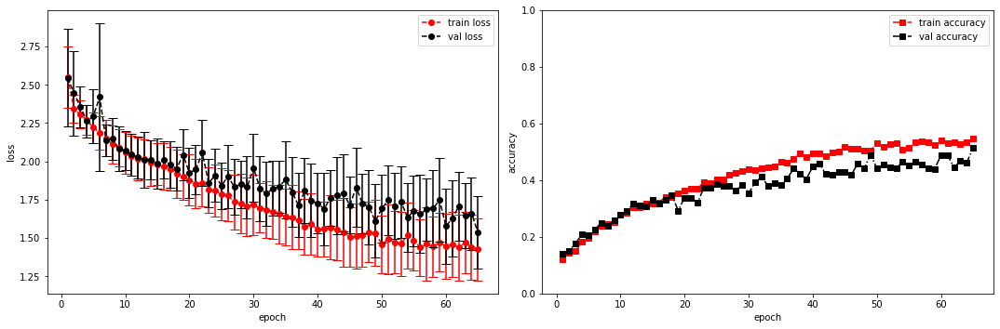

model saved


training epoch:  65
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [66/100], step [1/168],  Loss: 1.2110 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5431869029998779s
Epoch [66/100], step [17/168],  Loss: 1.3183 +/- 0.1666,  accuracy: 0.578125, time elapsed = 6.2424046993255615s
Epoch [66/100], step [33/168],  Loss: 1.4741 +/- 0.1805,  accuracy: 0.486328125, time elapsed = 6.253657102584839s
Epoch [66/100], step [49/168],  Loss: 1.4246 +/- 0.1535,  accuracy: 0.525390625, time elapsed = 6.244022369384766s
Epoch [66/100], step [65/168],  Loss: 1.4672 +/- 0.2167,  accuracy: 0.521484375, time elapsed = 6.243772983551025s
Epoch [66/100], step [81/168],  Loss: 1.4182 +/- 0.2169,  accuracy: 0.560546875, time elapsed = 6.2415149211883545s
Epoch [66/100], step [97/168],  Loss: 1.5185 +/- 0.1864,  accuracy: 0.51171875, time elapsed = 6.241917371749878s
Epoch [66/100], step [113/168],  Loss: 1.3631 +/- 0.2099,  accuracy: 0.568359375, time elapsed = 6.2420690059661865s
Epoch [66/100], step [129/168],  Loss: 1.2870 +/- 0.1606,  accuracy: 0.57421875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.537,  precision = 0.537 recall = 0.537 f1 = 0.537 ::: val: acc = 0.493,  precision = 0.493 recall = 0.493 time elapsed = 70.55361461639404s


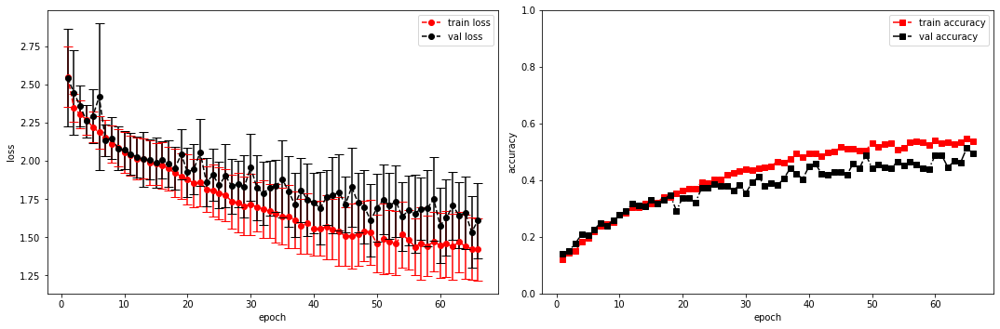

model saved


training epoch:  66
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [67/100], step [1/168],  Loss: 1.2892 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5358278751373291s
Epoch [67/100], step [17/168],  Loss: 1.3457 +/- 0.2037,  accuracy: 0.578125, time elapsed = 6.240936279296875s
Epoch [67/100], step [33/168],  Loss: 1.3491 +/- 0.1468,  accuracy: 0.5546875, time elapsed = 6.240145206451416s
Epoch [67/100], step [49/168],  Loss: 1.3418 +/- 0.1454,  accuracy: 0.55859375, time elapsed = 6.24146842956543s
Epoch [67/100], step [65/168],  Loss: 1.4445 +/- 0.2353,  accuracy: 0.5390625, time elapsed = 6.239971399307251s
Epoch [67/100], step [81/168],  Loss: 1.3627 +/- 0.2005,  accuracy: 0.568359375, time elapsed = 6.241807460784912s
Epoch [67/100], step [97/168],  Loss: 1.3486 +/- 0.2197,  accuracy: 0.578125, time elapsed = 6.242304086685181s
Epoch [67/100], step [113/168],  Loss: 1.3643 +/- 0.2115,  accuracy: 0.55078125, time elapsed = 6.241532325744629s
Epoch [67/100], step [129/168],  Loss: 1.3934 +/- 0.2249,  accuracy: 0.53125, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.548,  precision = 0.548 recall = 0.548 f1 = 0.548 ::: val: acc = 0.486,  precision = 0.486 recall = 0.486 time elapsed = 70.54588985443115s


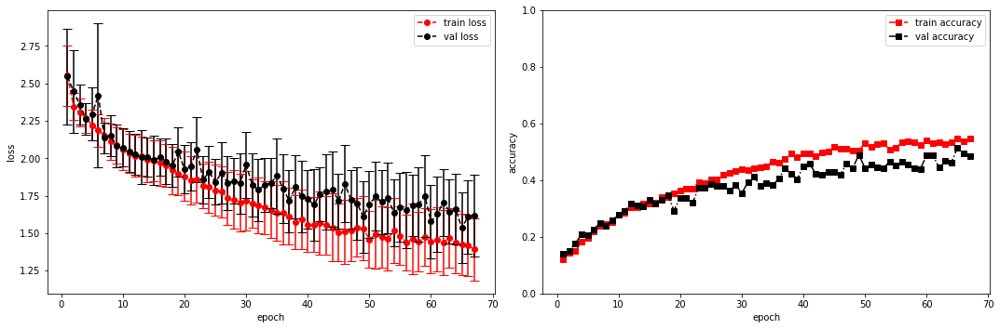

model saved


training epoch:  67
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [68/100], step [1/168],  Loss: 1.0742 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5549633502960205s
Epoch [68/100], step [17/168],  Loss: 1.3465 +/- 0.1406,  accuracy: 0.578125, time elapsed = 6.242827653884888s
Epoch [68/100], step [33/168],  Loss: 1.3426 +/- 0.2093,  accuracy: 0.560546875, time elapsed = 6.243448257446289s
Epoch [68/100], step [49/168],  Loss: 1.3756 +/- 0.1715,  accuracy: 0.560546875, time elapsed = 6.24291205406189s
Epoch [68/100], step [65/168],  Loss: 1.4443 +/- 0.1550,  accuracy: 0.529296875, time elapsed = 6.242717504501343s
Epoch [68/100], step [81/168],  Loss: 1.3854 +/- 0.2183,  accuracy: 0.568359375, time elapsed = 6.244206190109253s
Epoch [68/100], step [97/168],  Loss: 1.4121 +/- 0.1810,  accuracy: 0.537109375, time elapsed = 6.243627548217773s
Epoch [68/100], step [113/168],  Loss: 1.4656 +/- 0.2114,  accuracy: 0.533203125, time elapsed = 6.243326425552368s
Epoch [68/100], step [129/168],  Loss: 1.3952 +/- 0.2269,  accuracy: 0.537109375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.551,  precision = 0.551 recall = 0.551 f1 = 0.551 ::: val: acc = 0.467,  precision = 0.467 recall = 0.467 time elapsed = 70.56146287918091s


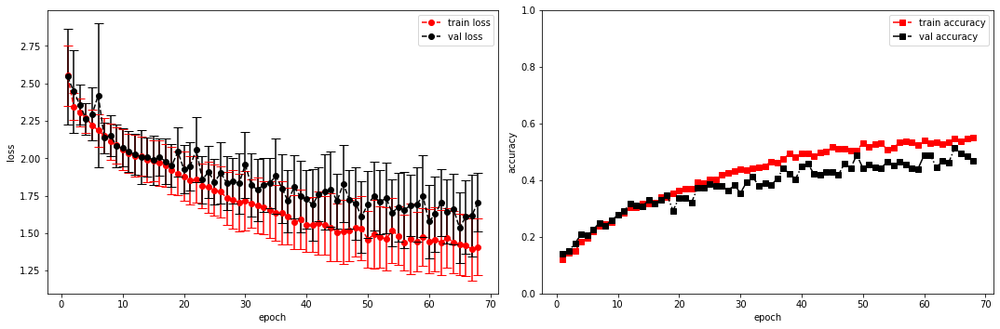

model saved


training epoch:  68
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [69/100], step [1/168],  Loss: 1.4826 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5489356517791748s
Epoch [69/100], step [17/168],  Loss: 1.3865 +/- 0.1796,  accuracy: 0.533203125, time elapsed = 6.240502595901489s
Epoch [69/100], step [33/168],  Loss: 1.3214 +/- 0.2183,  accuracy: 0.572265625, time elapsed = 6.239936113357544s
Epoch [69/100], step [49/168],  Loss: 1.3971 +/- 0.1764,  accuracy: 0.533203125, time elapsed = 6.240755558013916s
Epoch [69/100], step [65/168],  Loss: 1.2799 +/- 0.1666,  accuracy: 0.58203125, time elapsed = 6.240007162094116s
Epoch [69/100], step [81/168],  Loss: 1.4409 +/- 0.1922,  accuracy: 0.515625, time elapsed = 6.240922927856445s
Epoch [69/100], step [97/168],  Loss: 1.5288 +/- 0.2224,  accuracy: 0.505859375, time elapsed = 6.241149663925171s
Epoch [69/100], step [113/168],  Loss: 1.4283 +/- 0.1829,  accuracy: 0.515625, time elapsed = 6.253615856170654s
Epoch [69/100], step [129/168],  Loss: 1.3866 +/- 0.1900,  accuracy: 0.546875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.539,  precision = 0.539 recall = 0.539 f1 = 0.539 ::: val: acc = 0.475,  precision = 0.475 recall = 0.475 time elapsed = 70.54199743270874s


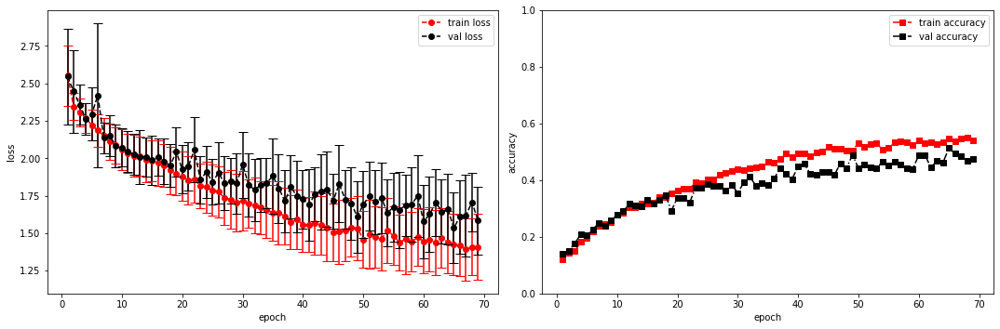

model saved


training epoch:  69
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [70/100], step [1/168],  Loss: 1.5349 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5340359210968018s
Epoch [70/100], step [17/168],  Loss: 1.4811 +/- 0.1958,  accuracy: 0.51953125, time elapsed = 6.242400646209717s
Epoch [70/100], step [33/168],  Loss: 1.3816 +/- 0.2189,  accuracy: 0.572265625, time elapsed = 6.245830535888672s
Epoch [70/100], step [49/168],  Loss: 1.3969 +/- 0.1828,  accuracy: 0.56640625, time elapsed = 6.24316668510437s
Epoch [70/100], step [65/168],  Loss: 1.3024 +/- 0.2209,  accuracy: 0.6015625, time elapsed = 6.243699789047241s
Epoch [70/100], step [81/168],  Loss: 1.3442 +/- 0.1943,  accuracy: 0.564453125, time elapsed = 6.242956638336182s
Epoch [70/100], step [97/168],  Loss: 1.3634 +/- 0.1719,  accuracy: 0.572265625, time elapsed = 6.241947650909424s
Epoch [70/100], step [113/168],  Loss: 1.4284 +/- 0.1996,  accuracy: 0.529296875, time elapsed = 6.24346137046814s
Epoch [70/100], step [129/168],  Loss: 1.4123 +/- 0.1649,  accuracy: 0.55859375, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.563,  precision = 0.563 recall = 0.563 f1 = 0.563 ::: val: acc = 0.494,  precision = 0.494 recall = 0.494 time elapsed = 70.54607510566711s


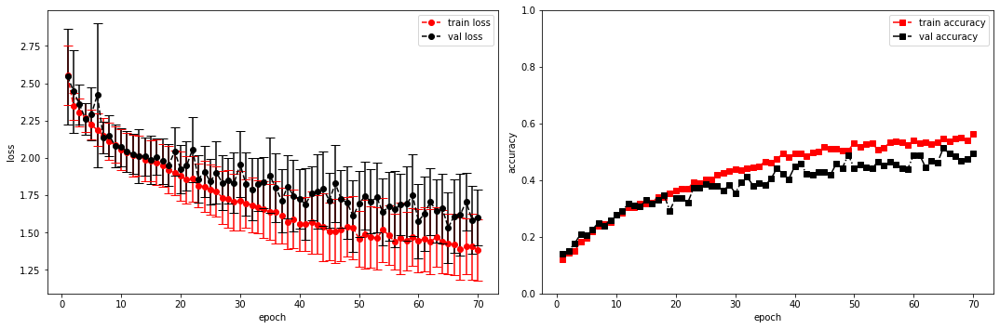

model saved


training epoch:  70
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [71/100], step [1/168],  Loss: 1.0136 +/- 0.0000,  accuracy: 0.044921875, time elapsed = 0.5332005023956299s
Epoch [71/100], step [17/168],  Loss: 1.3060 +/- 0.1903,  accuracy: 0.5859375, time elapsed = 6.241290092468262s
Epoch [71/100], step [33/168],  Loss: 1.2887 +/- 0.2063,  accuracy: 0.607421875, time elapsed = 6.244171142578125s
Epoch [71/100], step [49/168],  Loss: 1.3798 +/- 0.1900,  accuracy: 0.5703125, time elapsed = 6.255777835845947s
Epoch [71/100], step [65/168],  Loss: 1.4246 +/- 0.2074,  accuracy: 0.529296875, time elapsed = 6.240351676940918s
Epoch [71/100], step [81/168],  Loss: 1.3179 +/- 0.2000,  accuracy: 0.560546875, time elapsed = 6.240204095840454s
Epoch [71/100], step [97/168],  Loss: 1.4569 +/- 0.1550,  accuracy: 0.52734375, time elapsed = 6.240967035293579s
Epoch [71/100], step [113/168],  Loss: 1.3930 +/- 0.1930,  accuracy: 0.5390625, time elapsed = 6.241111516952515s
Epoch [71/100], step [129/168],  Loss: 1.3960 +/- 0.2450,  accuracy: 0.548828125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.550,  precision = 0.550 recall = 0.550 f1 = 0.550 ::: val: acc = 0.473,  precision = 0.473 recall = 0.473 time elapsed = 70.55243229866028s


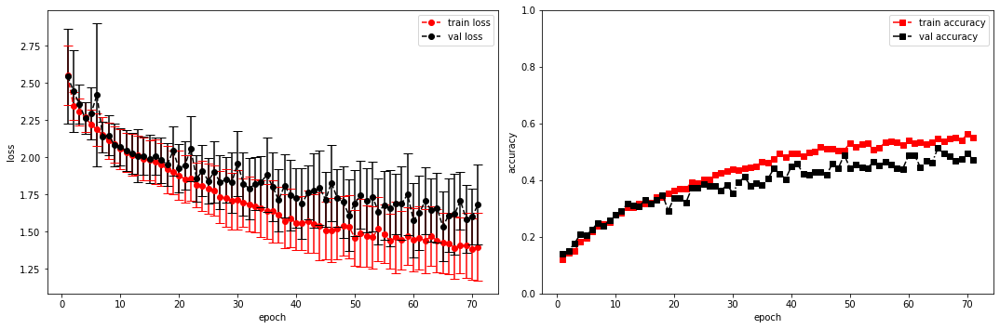

model saved


training epoch:  71
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [72/100], step [1/168],  Loss: 1.0874 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5398597717285156s
Epoch [72/100], step [17/168],  Loss: 1.3897 +/- 0.1616,  accuracy: 0.572265625, time elapsed = 6.2456581592559814s
Epoch [72/100], step [33/168],  Loss: 1.3632 +/- 0.1739,  accuracy: 0.55859375, time elapsed = 6.244187593460083s
Epoch [72/100], step [49/168],  Loss: 1.4117 +/- 0.1958,  accuracy: 0.517578125, time elapsed = 6.24360728263855s
Epoch [72/100], step [65/168],  Loss: 1.4591 +/- 0.1599,  accuracy: 0.51953125, time elapsed = 6.244112253189087s
Epoch [72/100], step [81/168],  Loss: 1.4178 +/- 0.1911,  accuracy: 0.552734375, time elapsed = 6.2425291538238525s
Epoch [72/100], step [97/168],  Loss: 1.4617 +/- 0.2218,  accuracy: 0.482421875, time elapsed = 6.242311477661133s
Epoch [72/100], step [113/168],  Loss: 1.4064 +/- 0.2321,  accuracy: 0.55078125, time elapsed = 6.242963790893555s
Epoch [72/100], step [129/168],  Loss: 1.3759 +/- 0.1740,  accuracy: 0.560546875,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.543,  precision = 0.543 recall = 0.543 f1 = 0.543 ::: val: acc = 0.477,  precision = 0.477 recall = 0.477 time elapsed = 70.58069324493408s


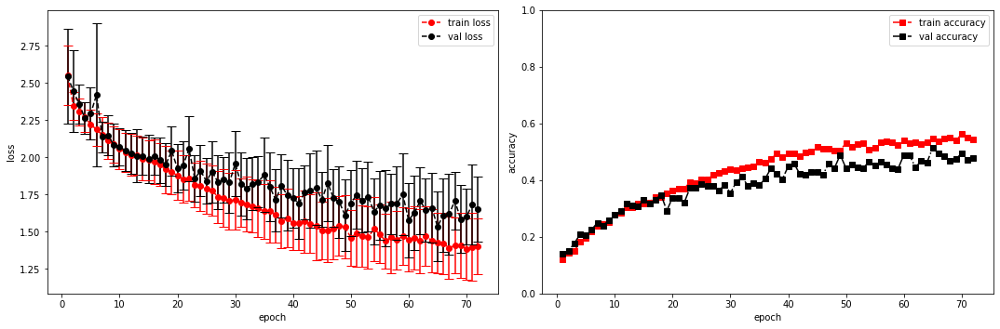

model saved


training epoch:  72
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [73/100], step [1/168],  Loss: 1.2771 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5373945236206055s
Epoch [73/100], step [17/168],  Loss: 1.3237 +/- 0.2153,  accuracy: 0.572265625, time elapsed = 6.243070840835571s
Epoch [73/100], step [33/168],  Loss: 1.3133 +/- 0.2200,  accuracy: 0.60546875, time elapsed = 6.243191480636597s
Epoch [73/100], step [49/168],  Loss: 1.3193 +/- 0.1844,  accuracy: 0.59765625, time elapsed = 6.241803884506226s
Epoch [73/100], step [65/168],  Loss: 1.4341 +/- 0.2304,  accuracy: 0.53515625, time elapsed = 6.240940093994141s
Epoch [73/100], step [81/168],  Loss: 1.4096 +/- 0.2124,  accuracy: 0.55078125, time elapsed = 6.241955995559692s
Epoch [73/100], step [97/168],  Loss: 1.2478 +/- 0.1636,  accuracy: 0.59765625, time elapsed = 6.241210222244263s
Epoch [73/100], step [113/168],  Loss: 1.3977 +/- 0.1899,  accuracy: 0.5546875, time elapsed = 6.242247104644775s
Epoch [73/100], step [129/168],  Loss: 1.3698 +/- 0.1215,  accuracy: 0.580078125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.572,  precision = 0.572 recall = 0.572 f1 = 0.572 ::: val: acc = 0.450,  precision = 0.450 recall = 0.450 time elapsed = 70.5412540435791s


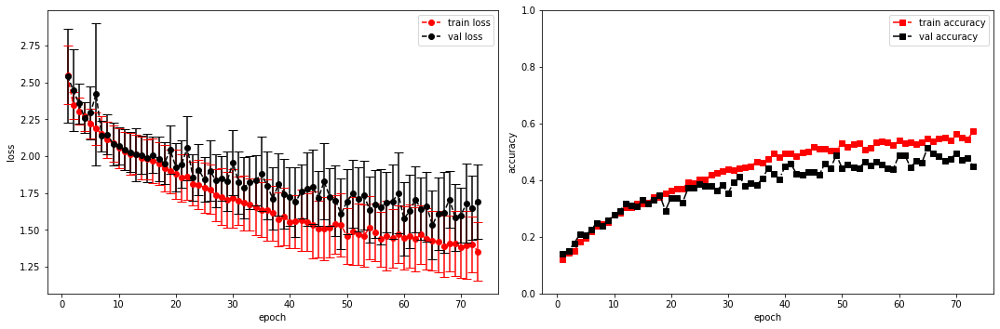

model saved


training epoch:  73
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [74/100], step [1/168],  Loss: 1.3080 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5338230133056641s
Epoch [74/100], step [17/168],  Loss: 1.2595 +/- 0.2110,  accuracy: 0.625, time elapsed = 6.242217302322388s
Epoch [74/100], step [33/168],  Loss: 1.3461 +/- 0.2543,  accuracy: 0.564453125, time elapsed = 6.2435126304626465s
Epoch [74/100], step [49/168],  Loss: 1.2250 +/- 0.1739,  accuracy: 0.603515625, time elapsed = 6.241482257843018s
Epoch [74/100], step [65/168],  Loss: 1.2896 +/- 0.1631,  accuracy: 0.580078125, time elapsed = 6.2418177127838135s
Epoch [74/100], step [81/168],  Loss: 1.2534 +/- 0.2029,  accuracy: 0.595703125, time elapsed = 6.24031138420105s
Epoch [74/100], step [97/168],  Loss: 1.5231 +/- 0.2503,  accuracy: 0.509765625, time elapsed = 6.2410502433776855s
Epoch [74/100], step [113/168],  Loss: 1.4790 +/- 0.2418,  accuracy: 0.513671875, time elapsed = 6.254694700241089s
Epoch [74/100], step [129/168],  Loss: 1.4798 +/- 0.2143,  accuracy: 0.517578125, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.559,  precision = 0.559 recall = 0.559 f1 = 0.559 ::: val: acc = 0.511,  precision = 0.511 recall = 0.511 time elapsed = 70.55008101463318s


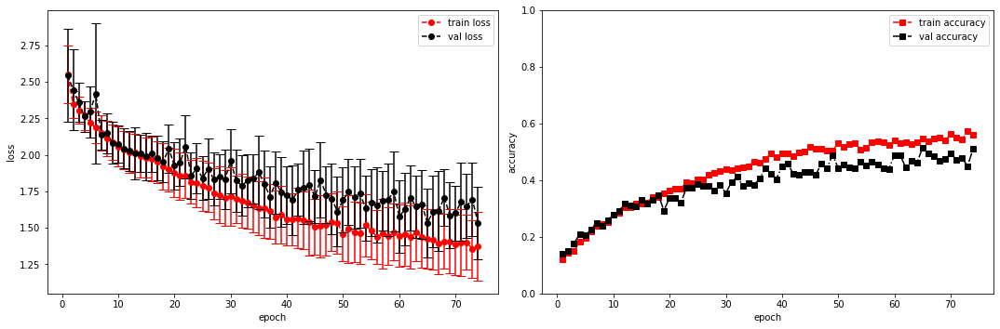

model saved


training epoch:  74
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [75/100], step [1/168],  Loss: 1.1023 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5318114757537842s
Epoch [75/100], step [17/168],  Loss: 1.3483 +/- 0.2727,  accuracy: 0.556640625, time elapsed = 6.2416064739227295s
Epoch [75/100], step [33/168],  Loss: 1.3234 +/- 0.2415,  accuracy: 0.580078125, time elapsed = 6.242173910140991s
Epoch [75/100], step [49/168],  Loss: 1.3336 +/- 0.1835,  accuracy: 0.556640625, time elapsed = 6.241888999938965s
Epoch [75/100], step [65/168],  Loss: 1.4045 +/- 0.2391,  accuracy: 0.564453125, time elapsed = 6.2425477504730225s
Epoch [75/100], step [81/168],  Loss: 1.3960 +/- 0.2399,  accuracy: 0.576171875, time elapsed = 6.242827415466309s
Epoch [75/100], step [97/168],  Loss: 1.2176 +/- 0.2165,  accuracy: 0.625, time elapsed = 6.241781711578369s
Epoch [75/100], step [113/168],  Loss: 1.3849 +/- 0.2584,  accuracy: 0.57421875, time elapsed = 6.241019010543823s
Epoch [75/100], step [129/168],  Loss: 1.3693 +/- 0.2061,  accuracy: 0.560546875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.570,  precision = 0.570 recall = 0.570 f1 = 0.570 ::: val: acc = 0.464,  precision = 0.464 recall = 0.464 time elapsed = 70.52618646621704s


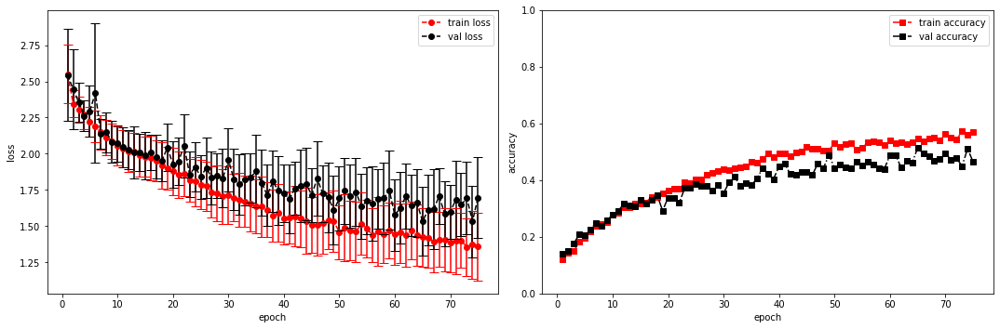

model saved


training epoch:  75
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [76/100], step [1/168],  Loss: 1.4916 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5333166122436523s
Epoch [76/100], step [17/168],  Loss: 1.3529 +/- 0.1418,  accuracy: 0.5625, time elapsed = 6.241924285888672s
Epoch [76/100], step [33/168],  Loss: 1.3491 +/- 0.1534,  accuracy: 0.587890625, time elapsed = 6.243039608001709s
Epoch [76/100], step [49/168],  Loss: 1.3271 +/- 0.2238,  accuracy: 0.568359375, time elapsed = 6.242282867431641s
Epoch [76/100], step [65/168],  Loss: 1.4175 +/- 0.1730,  accuracy: 0.548828125, time elapsed = 6.256758213043213s
Epoch [76/100], step [81/168],  Loss: 1.4374 +/- 0.2695,  accuracy: 0.52734375, time elapsed = 6.2430384159088135s
Epoch [76/100], step [97/168],  Loss: 1.3410 +/- 0.1701,  accuracy: 0.55078125, time elapsed = 6.2420337200164795s
Epoch [76/100], step [113/168],  Loss: 1.3593 +/- 0.2489,  accuracy: 0.578125, time elapsed = 6.24110221862793s
Epoch [76/100], step [129/168],  Loss: 1.3698 +/- 0.1836,  accuracy: 0.55859375, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.559,  precision = 0.559 recall = 0.559 f1 = 0.559 ::: val: acc = 0.471,  precision = 0.471 recall = 0.471 time elapsed = 70.55048894882202s


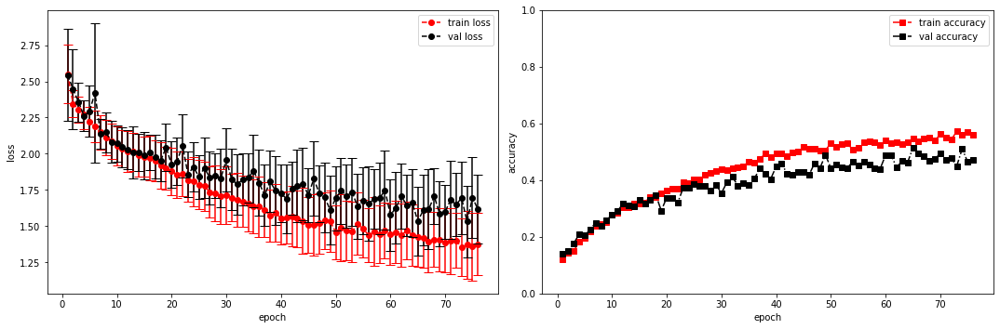

model saved


training epoch:  76
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [77/100], step [1/168],  Loss: 1.6698 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5312302112579346s
Epoch [77/100], step [17/168],  Loss: 1.3531 +/- 0.1666,  accuracy: 0.58984375, time elapsed = 6.244842767715454s
Epoch [77/100], step [33/168],  Loss: 1.2966 +/- 0.2507,  accuracy: 0.5859375, time elapsed = 6.241420030593872s
Epoch [77/100], step [49/168],  Loss: 1.3625 +/- 0.1647,  accuracy: 0.564453125, time elapsed = 6.241880893707275s
Epoch [77/100], step [65/168],  Loss: 1.2977 +/- 0.2664,  accuracy: 0.603515625, time elapsed = 6.2410478591918945s
Epoch [77/100], step [81/168],  Loss: 1.2894 +/- 0.2416,  accuracy: 0.58203125, time elapsed = 6.242594003677368s
Epoch [77/100], step [97/168],  Loss: 1.3110 +/- 0.2177,  accuracy: 0.603515625, time elapsed = 6.242058753967285s
Epoch [77/100], step [113/168],  Loss: 1.2828 +/- 0.1960,  accuracy: 0.58984375, time elapsed = 6.242848634719849s
Epoch [77/100], step [129/168],  Loss: 1.3393 +/- 0.1955,  accuracy: 0.599609375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.577,  precision = 0.577 recall = 0.577 f1 = 0.577 ::: val: acc = 0.515,  precision = 0.515 recall = 0.515 time elapsed = 70.5808777809143s


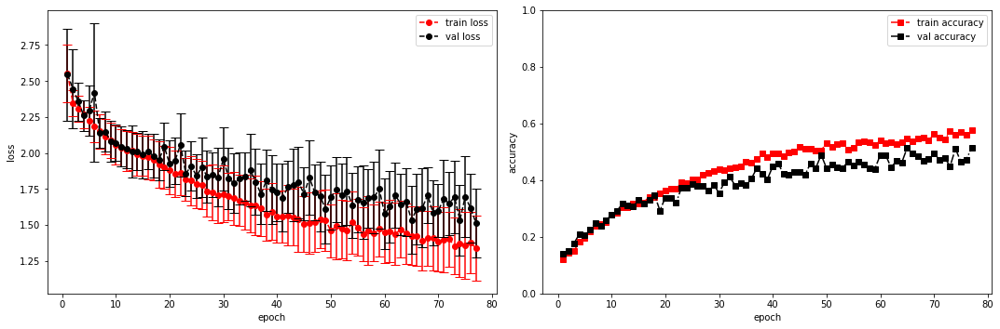

model saved


training epoch:  77
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [78/100], step [1/168],  Loss: 1.1154 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5397961139678955s
Epoch [78/100], step [17/168],  Loss: 1.2266 +/- 0.1849,  accuracy: 0.61328125, time elapsed = 6.244738817214966s
Epoch [78/100], step [33/168],  Loss: 1.2280 +/- 0.1852,  accuracy: 0.58984375, time elapsed = 6.242893695831299s
Epoch [78/100], step [49/168],  Loss: 1.2596 +/- 0.2385,  accuracy: 0.599609375, time elapsed = 6.243120193481445s
Epoch [78/100], step [65/168],  Loss: 1.3455 +/- 0.2599,  accuracy: 0.576171875, time elapsed = 6.242570161819458s
Epoch [78/100], step [81/168],  Loss: 1.3226 +/- 0.1608,  accuracy: 0.556640625, time elapsed = 6.243178844451904s
Epoch [78/100], step [97/168],  Loss: 1.3790 +/- 0.1930,  accuracy: 0.55859375, time elapsed = 6.2436747550964355s
Epoch [78/100], step [113/168],  Loss: 1.3885 +/- 0.1574,  accuracy: 0.546875, time elapsed = 6.244116306304932s
Epoch [78/100], step [129/168],  Loss: 1.3757 +/- 0.1568,  accuracy: 0.55859375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.577,  precision = 0.577 recall = 0.577 f1 = 0.577 ::: val: acc = 0.530,  precision = 0.530 recall = 0.530 time elapsed = 70.57080268859863s


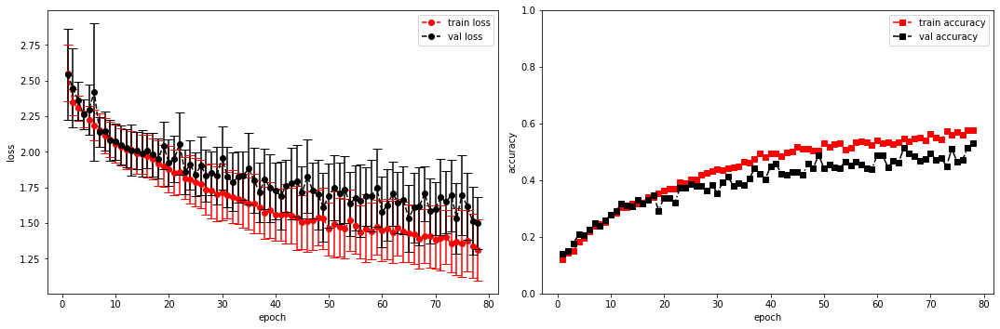

model saved


training epoch:  78
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [79/100], step [1/168],  Loss: 1.2643 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5318465232849121s
Epoch [79/100], step [17/168],  Loss: 1.2512 +/- 0.1730,  accuracy: 0.59375, time elapsed = 6.241885185241699s
Epoch [79/100], step [33/168],  Loss: 1.1524 +/- 0.1739,  accuracy: 0.630859375, time elapsed = 6.242360353469849s
Epoch [79/100], step [49/168],  Loss: 1.2688 +/- 0.1610,  accuracy: 0.60546875, time elapsed = 6.241931200027466s
Epoch [79/100], step [65/168],  Loss: 1.2568 +/- 0.1230,  accuracy: 0.583984375, time elapsed = 6.242053270339966s
Epoch [79/100], step [81/168],  Loss: 1.2893 +/- 0.1769,  accuracy: 0.58203125, time elapsed = 6.241775035858154s
Epoch [79/100], step [97/168],  Loss: 1.2844 +/- 0.1213,  accuracy: 0.59765625, time elapsed = 6.241994857788086s
Epoch [79/100], step [113/168],  Loss: 1.3293 +/- 0.1786,  accuracy: 0.58203125, time elapsed = 6.242719411849976s
Epoch [79/100], step [129/168],  Loss: 1.3297 +/- 0.2231,  accuracy: 0.578125, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.582,  precision = 0.582 recall = 0.582 f1 = 0.582 ::: val: acc = 0.469,  precision = 0.469 recall = 0.469 time elapsed = 70.54145288467407s


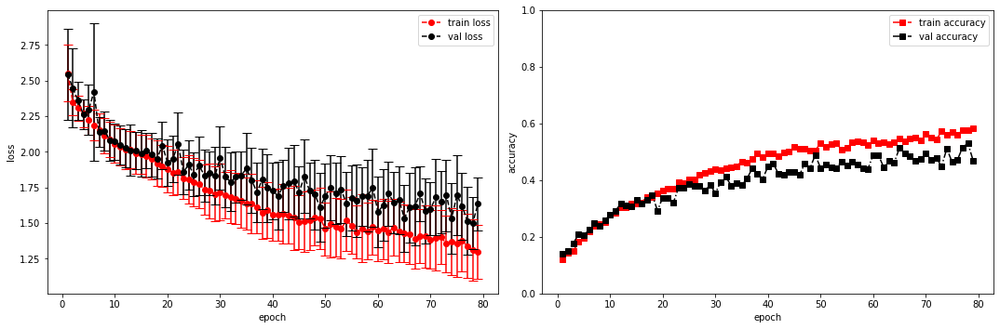

model saved
model saved


training epoch:  79
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [80/100], step [1/168],  Loss: 1.8639 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5341427326202393s
Epoch [80/100], step [17/168],  Loss: 1.2935 +/- 0.1861,  accuracy: 0.5859375, time elapsed = 6.241680860519409s
Epoch [80/100], step [33/168],  Loss: 1.2844 +/- 0.1768,  accuracy: 0.587890625, time elapsed = 6.242737770080566s
Epoch [80/100], step [49/168],  Loss: 1.2403 +/- 0.2269,  accuracy: 0.630859375, time elapsed = 6.242397308349609s
Epoch [80/100], step [65/168],  Loss: 1.3259 +/- 0.2035,  accuracy: 0.5859375, time elapsed = 6.2431724071502686s
Epoch [80/100], step [81/168],  Loss: 1.3177 +/- 0.1860,  accuracy: 0.591796875, time elapsed = 6.242372751235962s
Epoch [80/100], step [97/168],  Loss: 1.3003 +/- 0.2030,  accuracy: 0.5859375, time elapsed = 6.245556116104126s
Epoch [80/100], step [113/168],  Loss: 1.3608 +/- 0.2708,  accuracy: 0.541015625, time elapsed = 6.243488311767578s
Epoch [80/100], step [129/168],  Loss: 1.3880 +/- 0.2925,  accuracy: 0.548828125, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.578,  precision = 0.578 recall = 0.578 f1 = 0.578 ::: val: acc = 0.450,  precision = 0.450 recall = 0.450 time elapsed = 70.53864002227783s


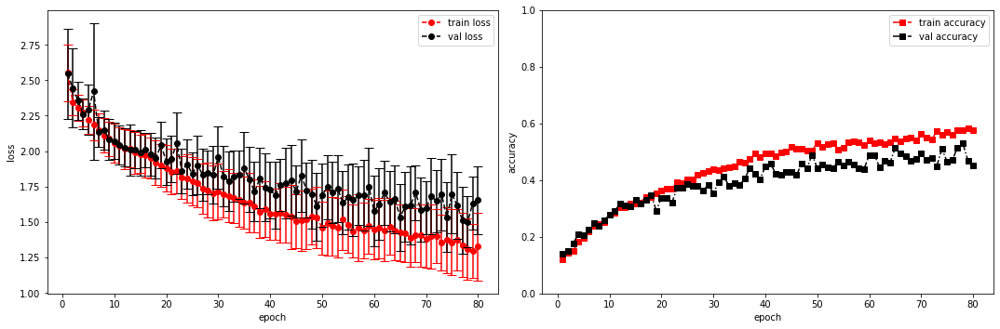

model saved


training epoch:  80
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [81/100], step [1/168],  Loss: 1.3168 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.533700704574585s
Epoch [81/100], step [17/168],  Loss: 1.3266 +/- 0.2039,  accuracy: 0.6015625, time elapsed = 6.242746353149414s
Epoch [81/100], step [33/168],  Loss: 1.3208 +/- 0.2646,  accuracy: 0.5859375, time elapsed = 6.2424304485321045s
Epoch [81/100], step [49/168],  Loss: 1.3383 +/- 0.2536,  accuracy: 0.576171875, time elapsed = 6.2420244216918945s
Epoch [81/100], step [65/168],  Loss: 1.2807 +/- 0.1427,  accuracy: 0.595703125, time elapsed = 6.253506183624268s
Epoch [81/100], step [81/168],  Loss: 1.2606 +/- 0.1633,  accuracy: 0.615234375, time elapsed = 6.248993635177612s
Epoch [81/100], step [97/168],  Loss: 1.3099 +/- 0.2674,  accuracy: 0.59375, time elapsed = 6.2422034740448s
Epoch [81/100], step [113/168],  Loss: 1.3381 +/- 0.1753,  accuracy: 0.560546875, time elapsed = 6.241939067840576s
Epoch [81/100], step [129/168],  Loss: 1.2390 +/- 0.2049,  accuracy: 0.58203125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.590,  precision = 0.590 recall = 0.590 f1 = 0.590 ::: val: acc = 0.478,  precision = 0.478 recall = 0.478 time elapsed = 70.55108690261841s


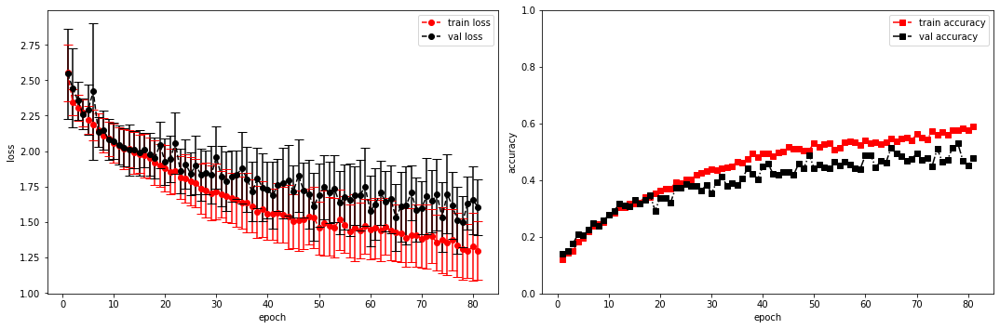

model saved


training epoch:  81
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [82/100], step [1/168],  Loss: 1.4809 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5370998382568359s
Epoch [82/100], step [17/168],  Loss: 1.2812 +/- 0.2284,  accuracy: 0.578125, time elapsed = 6.241877317428589s
Epoch [82/100], step [33/168],  Loss: 1.1799 +/- 0.1898,  accuracy: 0.611328125, time elapsed = 6.243835687637329s
Epoch [82/100], step [49/168],  Loss: 1.3278 +/- 0.2629,  accuracy: 0.572265625, time elapsed = 6.242267370223999s
Epoch [82/100], step [65/168],  Loss: 1.2691 +/- 0.1712,  accuracy: 0.587890625, time elapsed = 6.241855144500732s
Epoch [82/100], step [81/168],  Loss: 1.3687 +/- 0.1982,  accuracy: 0.548828125, time elapsed = 6.242274284362793s
Epoch [82/100], step [97/168],  Loss: 1.2672 +/- 0.2929,  accuracy: 0.587890625, time elapsed = 6.241905212402344s
Epoch [82/100], step [113/168],  Loss: 1.3772 +/- 0.2237,  accuracy: 0.5546875, time elapsed = 6.243695259094238s
Epoch [82/100], step [129/168],  Loss: 1.2056 +/- 0.1224,  accuracy: 0.623046875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.581,  precision = 0.581 recall = 0.581 f1 = 0.581 ::: val: acc = 0.424,  precision = 0.424 recall = 0.424 time elapsed = 70.54283571243286s


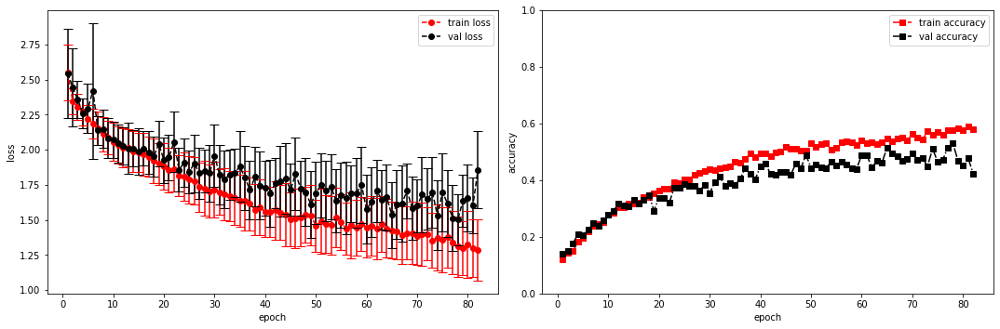

model saved
model saved


training epoch:  82
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [83/100], step [1/168],  Loss: 1.3976 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5306320190429688s
Epoch [83/100], step [17/168],  Loss: 1.2404 +/- 0.2432,  accuracy: 0.572265625, time elapsed = 6.262692451477051s
Epoch [83/100], step [33/168],  Loss: 1.2411 +/- 0.1881,  accuracy: 0.591796875, time elapsed = 6.242207050323486s
Epoch [83/100], step [49/168],  Loss: 1.2378 +/- 0.1822,  accuracy: 0.60546875, time elapsed = 6.24216890335083s
Epoch [83/100], step [65/168],  Loss: 1.2042 +/- 0.1367,  accuracy: 0.603515625, time elapsed = 6.243697166442871s
Epoch [83/100], step [81/168],  Loss: 1.2081 +/- 0.2214,  accuracy: 0.62109375, time elapsed = 6.241545915603638s
Epoch [83/100], step [97/168],  Loss: 1.3845 +/- 0.2439,  accuracy: 0.560546875, time elapsed = 6.242563009262085s
Epoch [83/100], step [113/168],  Loss: 1.3921 +/- 0.1730,  accuracy: 0.54296875, time elapsed = 6.242457151412964s
Epoch [83/100], step [129/168],  Loss: 1.3833 +/- 0.2491,  accuracy: 0.556640625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.572,  precision = 0.572 recall = 0.572 f1 = 0.572 ::: val: acc = 0.474,  precision = 0.474 recall = 0.474 time elapsed = 70.56174087524414s


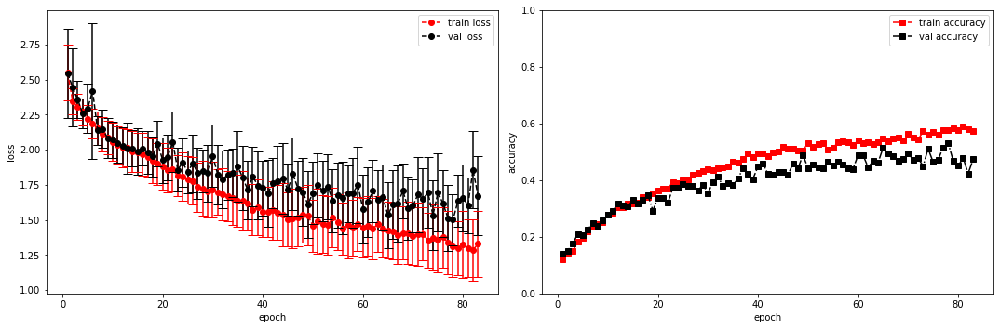

model saved


training epoch:  83
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [84/100], step [1/168],  Loss: 1.2789 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5344953536987305s
Epoch [84/100], step [17/168],  Loss: 1.3409 +/- 0.2631,  accuracy: 0.5625, time elapsed = 6.241326808929443s
Epoch [84/100], step [33/168],  Loss: 1.2569 +/- 0.2320,  accuracy: 0.587890625, time elapsed = 6.242804765701294s
Epoch [84/100], step [49/168],  Loss: 1.2498 +/- 0.1835,  accuracy: 0.6015625, time elapsed = 6.242123603820801s
Epoch [84/100], step [65/168],  Loss: 1.2883 +/- 0.2338,  accuracy: 0.609375, time elapsed = 6.242600679397583s
Epoch [84/100], step [81/168],  Loss: 1.2853 +/- 0.1823,  accuracy: 0.5625, time elapsed = 6.24148964881897s
Epoch [84/100], step [97/168],  Loss: 1.2219 +/- 0.2169,  accuracy: 0.6171875, time elapsed = 6.241999864578247s
Epoch [84/100], step [113/168],  Loss: 1.3128 +/- 0.1668,  accuracy: 0.6015625, time elapsed = 6.242180347442627s
Epoch [84/100], step [129/168],  Loss: 1.3269 +/- 0.1615,  accuracy: 0.576171875, time elapsed = 6.24

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.592,  precision = 0.592 recall = 0.592 f1 = 0.592 ::: val: acc = 0.509,  precision = 0.509 recall = 0.509 time elapsed = 70.54773759841919s


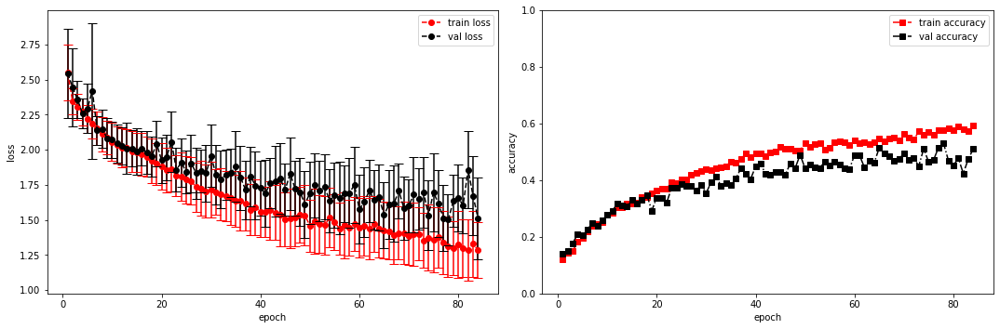

model saved


training epoch:  84
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [85/100], step [1/168],  Loss: 1.5340 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5323331356048584s
Epoch [85/100], step [17/168],  Loss: 1.1885 +/- 0.2228,  accuracy: 0.62890625, time elapsed = 6.242107152938843s
Epoch [85/100], step [33/168],  Loss: 1.1935 +/- 0.2409,  accuracy: 0.630859375, time elapsed = 6.241592168807983s
Epoch [85/100], step [49/168],  Loss: 1.3461 +/- 0.1893,  accuracy: 0.560546875, time elapsed = 6.240696907043457s
Epoch [85/100], step [65/168],  Loss: 1.3035 +/- 0.2108,  accuracy: 0.607421875, time elapsed = 6.240886211395264s
Epoch [85/100], step [81/168],  Loss: 1.2960 +/- 0.1317,  accuracy: 0.578125, time elapsed = 6.241090297698975s
Epoch [85/100], step [97/168],  Loss: 1.2469 +/- 0.2519,  accuracy: 0.62109375, time elapsed = 6.243410348892212s
Epoch [85/100], step [113/168],  Loss: 1.1430 +/- 0.1508,  accuracy: 0.625, time elapsed = 6.240959405899048s
Epoch [85/100], step [129/168],  Loss: 1.2572 +/- 0.2310,  accuracy: 0.611328125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.602,  precision = 0.602 recall = 0.602 f1 = 0.602 ::: val: acc = 0.543,  precision = 0.543 recall = 0.543 time elapsed = 70.52614641189575s


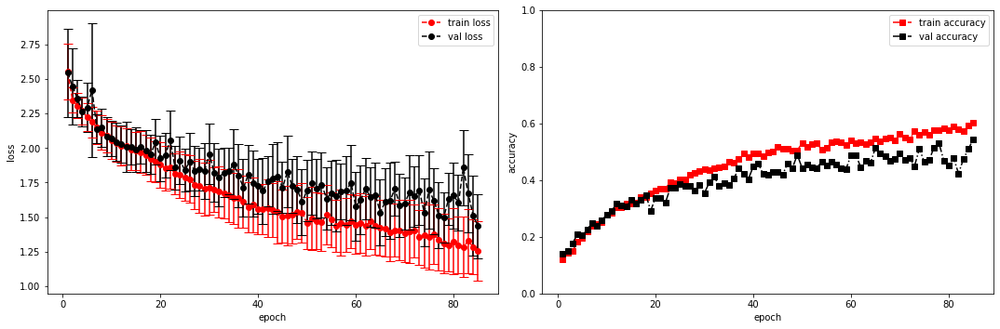

model saved


training epoch:  85
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [86/100], step [1/168],  Loss: 1.5037 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5315876007080078s
Epoch [86/100], step [17/168],  Loss: 1.1918 +/- 0.2006,  accuracy: 0.625, time elapsed = 6.242765665054321s
Epoch [86/100], step [33/168],  Loss: 1.2774 +/- 0.1975,  accuracy: 0.62109375, time elapsed = 6.24364709854126s
Epoch [86/100], step [49/168],  Loss: 1.2003 +/- 0.2031,  accuracy: 0.603515625, time elapsed = 6.2425196170806885s
Epoch [86/100], step [65/168],  Loss: 1.2587 +/- 0.1848,  accuracy: 0.58984375, time elapsed = 6.244160413742065s
Epoch [86/100], step [81/168],  Loss: 1.2985 +/- 0.2073,  accuracy: 0.59375, time elapsed = 6.261234998703003s
Epoch [86/100], step [97/168],  Loss: 1.1852 +/- 0.2090,  accuracy: 0.634765625, time elapsed = 6.242079257965088s
Epoch [86/100], step [113/168],  Loss: 1.1967 +/- 0.1688,  accuracy: 0.60546875, time elapsed = 6.241790533065796s
Epoch [86/100], step [129/168],  Loss: 1.2151 +/- 0.1932,  accuracy: 0.609375, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.608,  precision = 0.608 recall = 0.608 f1 = 0.608 ::: val: acc = 0.518,  precision = 0.518 recall = 0.518 time elapsed = 70.55137944221497s


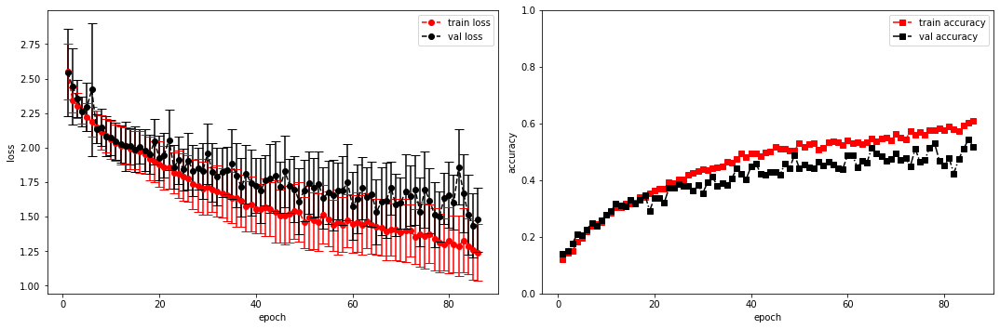

model saved


training epoch:  86
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [87/100], step [1/168],  Loss: 1.4298 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5343706607818604s
Epoch [87/100], step [17/168],  Loss: 1.1735 +/- 0.1440,  accuracy: 0.609375, time elapsed = 6.242386341094971s
Epoch [87/100], step [33/168],  Loss: 1.2378 +/- 0.2171,  accuracy: 0.60546875, time elapsed = 6.242920637130737s
Epoch [87/100], step [49/168],  Loss: 1.3570 +/- 0.2398,  accuracy: 0.568359375, time elapsed = 6.243844270706177s
Epoch [87/100], step [65/168],  Loss: 1.3196 +/- 0.1959,  accuracy: 0.564453125, time elapsed = 6.2406957149505615s
Epoch [87/100], step [81/168],  Loss: 1.1917 +/- 0.1971,  accuracy: 0.62109375, time elapsed = 6.2417356967926025s
Epoch [87/100], step [97/168],  Loss: 1.3499 +/- 0.2157,  accuracy: 0.5625, time elapsed = 6.244986295700073s
Epoch [87/100], step [113/168],  Loss: 1.2388 +/- 0.1826,  accuracy: 0.623046875, time elapsed = 6.243508815765381s
Epoch [87/100], step [129/168],  Loss: 1.2815 +/- 0.2306,  accuracy: 0.591796875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.590,  precision = 0.590 recall = 0.590 f1 = 0.590 ::: val: acc = 0.512,  precision = 0.512 recall = 0.512 time elapsed = 70.55825734138489s


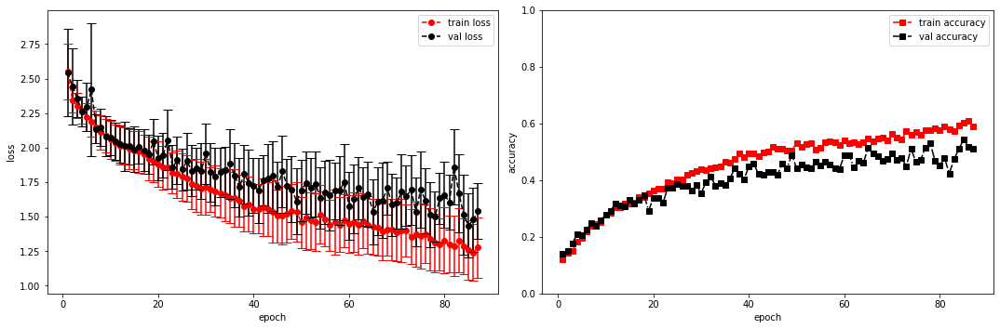

model saved


training epoch:  87
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [88/100], step [1/168],  Loss: 1.3071 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5447790622711182s
Epoch [88/100], step [17/168],  Loss: 1.1852 +/- 0.1740,  accuracy: 0.623046875, time elapsed = 6.247880458831787s
Epoch [88/100], step [33/168],  Loss: 1.1484 +/- 0.2120,  accuracy: 0.638671875, time elapsed = 6.25190806388855s
Epoch [88/100], step [49/168],  Loss: 1.2789 +/- 0.2351,  accuracy: 0.587890625, time elapsed = 6.2435994148254395s
Epoch [88/100], step [65/168],  Loss: 1.2451 +/- 0.1985,  accuracy: 0.599609375, time elapsed = 6.242316246032715s
Epoch [88/100], step [81/168],  Loss: 1.2419 +/- 0.1908,  accuracy: 0.57421875, time elapsed = 6.242258071899414s
Epoch [88/100], step [97/168],  Loss: 1.2895 +/- 0.2610,  accuracy: 0.576171875, time elapsed = 6.242708444595337s
Epoch [88/100], step [113/168],  Loss: 1.3423 +/- 0.2760,  accuracy: 0.568359375, time elapsed = 6.242267847061157s
Epoch [88/100], step [129/168],  Loss: 1.2261 +/- 0.2294,  accuracy: 0.62890625,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.592,  precision = 0.592 recall = 0.592 f1 = 0.592 ::: val: acc = 0.529,  precision = 0.529 recall = 0.529 time elapsed = 70.57466888427734s


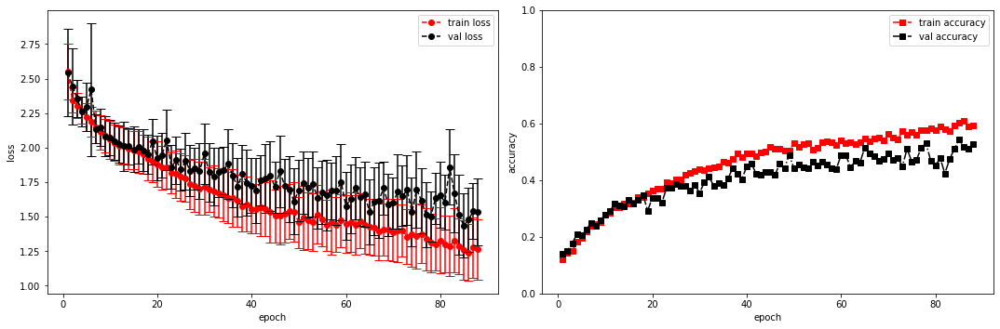

model saved


training epoch:  88
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [89/100], step [1/168],  Loss: 1.1593 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5337169170379639s
Epoch [89/100], step [17/168],  Loss: 1.1399 +/- 0.1844,  accuracy: 0.642578125, time elapsed = 6.241482973098755s
Epoch [89/100], step [33/168],  Loss: 1.1489 +/- 0.2063,  accuracy: 0.623046875, time elapsed = 6.240549087524414s
Epoch [89/100], step [49/168],  Loss: 1.2141 +/- 0.2551,  accuracy: 0.615234375, time elapsed = 6.240223407745361s
Epoch [89/100], step [65/168],  Loss: 1.2108 +/- 0.1818,  accuracy: 0.591796875, time elapsed = 6.2395920753479s
Epoch [89/100], step [81/168],  Loss: 1.1303 +/- 0.1661,  accuracy: 0.640625, time elapsed = 6.241365432739258s
Epoch [89/100], step [97/168],  Loss: 1.1989 +/- 0.1641,  accuracy: 0.630859375, time elapsed = 6.24050760269165s
Epoch [89/100], step [113/168],  Loss: 1.1880 +/- 0.1993,  accuracy: 0.630859375, time elapsed = 6.24170446395874s
Epoch [89/100], step [129/168],  Loss: 1.1989 +/- 0.1640,  accuracy: 0.619140625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.626,  precision = 0.626 recall = 0.626 f1 = 0.626 ::: val: acc = 0.533,  precision = 0.533 recall = 0.533 time elapsed = 70.54258060455322s


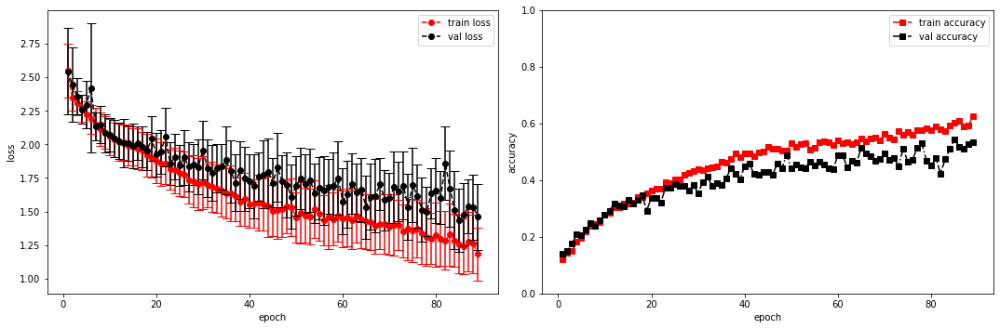

model saved


training epoch:  89
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [90/100], step [1/168],  Loss: 1.3604 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.53639817237854s
Epoch [90/100], step [17/168],  Loss: 1.0957 +/- 0.1670,  accuracy: 0.64453125, time elapsed = 6.241575717926025s
Epoch [90/100], step [33/168],  Loss: 1.1426 +/- 0.2490,  accuracy: 0.642578125, time elapsed = 6.242541551589966s
Epoch [90/100], step [49/168],  Loss: 1.2657 +/- 0.1747,  accuracy: 0.580078125, time elapsed = 6.242166996002197s
Epoch [90/100], step [65/168],  Loss: 1.1853 +/- 0.1880,  accuracy: 0.6328125, time elapsed = 6.24201226234436s
Epoch [90/100], step [81/168],  Loss: 1.2048 +/- 0.1937,  accuracy: 0.623046875, time elapsed = 6.2428343296051025s
Epoch [90/100], step [97/168],  Loss: 1.2401 +/- 0.2413,  accuracy: 0.603515625, time elapsed = 6.24180006980896s
Epoch [90/100], step [113/168],  Loss: 1.2560 +/- 0.2477,  accuracy: 0.599609375, time elapsed = 6.24428653717041s
Epoch [90/100], step [129/168],  Loss: 1.2620 +/- 0.1658,  accuracy: 0.59765625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.615,  precision = 0.615 recall = 0.615 f1 = 0.615 ::: val: acc = 0.537,  precision = 0.537 recall = 0.537 time elapsed = 70.54794383049011s


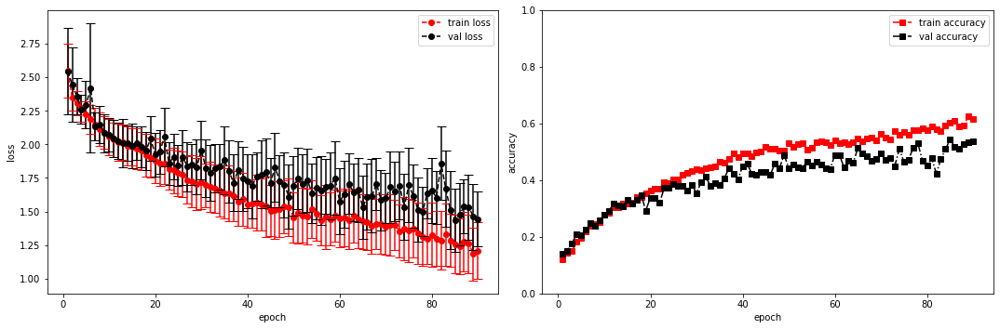

model saved


training epoch:  90
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [91/100], step [1/168],  Loss: 1.2486 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5377237796783447s
Epoch [91/100], step [17/168],  Loss: 1.1971 +/- 0.1448,  accuracy: 0.634765625, time elapsed = 6.241814374923706s
Epoch [91/100], step [33/168],  Loss: 1.2114 +/- 0.2171,  accuracy: 0.6171875, time elapsed = 6.243232011795044s
Epoch [91/100], step [49/168],  Loss: 1.1783 +/- 0.2236,  accuracy: 0.642578125, time elapsed = 6.241931915283203s
Epoch [91/100], step [65/168],  Loss: 1.1389 +/- 0.1510,  accuracy: 0.6328125, time elapsed = 6.242678642272949s
Epoch [91/100], step [81/168],  Loss: 1.1840 +/- 0.1437,  accuracy: 0.603515625, time elapsed = 6.243927001953125s
Epoch [91/100], step [97/168],  Loss: 1.1518 +/- 0.1714,  accuracy: 0.62109375, time elapsed = 6.252673149108887s
Epoch [91/100], step [113/168],  Loss: 1.2200 +/- 0.1874,  accuracy: 0.615234375, time elapsed = 6.241109132766724s
Epoch [91/100], step [129/168],  Loss: 1.1919 +/- 0.1728,  accuracy: 0.61328125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.624,  precision = 0.624 recall = 0.624 f1 = 0.624 ::: val: acc = 0.512,  precision = 0.512 recall = 0.512 time elapsed = 70.55763220787048s


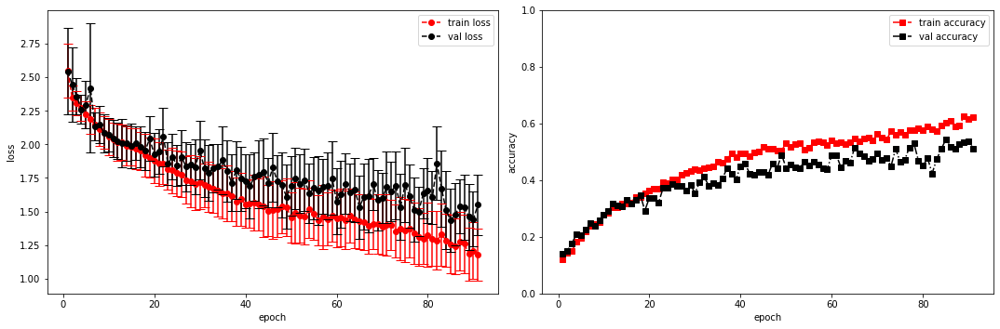

model saved
model saved


training epoch:  91
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [92/100], step [1/168],  Loss: 1.0549 +/- 0.0000,  accuracy: 0.046875, time elapsed = 0.5531611442565918s
Epoch [92/100], step [17/168],  Loss: 1.1015 +/- 0.2164,  accuracy: 0.6640625, time elapsed = 6.242393255233765s
Epoch [92/100], step [33/168],  Loss: 1.1598 +/- 0.2210,  accuracy: 0.626953125, time elapsed = 6.2430291175842285s
Epoch [92/100], step [49/168],  Loss: 1.1142 +/- 0.1710,  accuracy: 0.650390625, time elapsed = 6.243849754333496s
Epoch [92/100], step [65/168],  Loss: 1.2459 +/- 0.2096,  accuracy: 0.611328125, time elapsed = 6.242814540863037s
Epoch [92/100], step [81/168],  Loss: 1.2182 +/- 0.2184,  accuracy: 0.626953125, time elapsed = 6.243531942367554s
Epoch [92/100], step [97/168],  Loss: 1.1803 +/- 0.2513,  accuracy: 0.63671875, time elapsed = 6.243429660797119s
Epoch [92/100], step [113/168],  Loss: 1.2569 +/- 0.1791,  accuracy: 0.58203125, time elapsed = 6.242435693740845s
Epoch [92/100], step [129/168],  Loss: 1.2283 +/- 0.2415,  accuracy: 0.62890625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.624,  precision = 0.624 recall = 0.624 f1 = 0.624 ::: val: acc = 0.485,  precision = 0.485 recall = 0.485 time elapsed = 70.55978107452393s


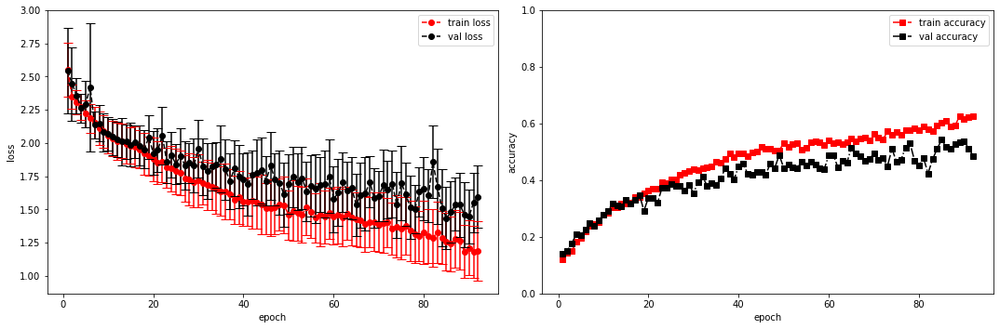

model saved


training epoch:  92
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [93/100], step [1/168],  Loss: 1.4470 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5375792980194092s
Epoch [93/100], step [17/168],  Loss: 1.1641 +/- 0.2198,  accuracy: 0.625, time elapsed = 6.241870403289795s
Epoch [93/100], step [33/168],  Loss: 1.1385 +/- 0.2290,  accuracy: 0.650390625, time elapsed = 6.261402606964111s
Epoch [93/100], step [49/168],  Loss: 1.2429 +/- 0.1996,  accuracy: 0.58984375, time elapsed = 6.241523027420044s
Epoch [93/100], step [65/168],  Loss: 1.0764 +/- 0.2564,  accuracy: 0.65234375, time elapsed = 6.240944862365723s
Epoch [93/100], step [81/168],  Loss: 1.1771 +/- 0.2570,  accuracy: 0.623046875, time elapsed = 6.241454124450684s
Epoch [93/100], step [97/168],  Loss: 1.2957 +/- 0.2028,  accuracy: 0.578125, time elapsed = 6.241706371307373s
Epoch [93/100], step [113/168],  Loss: 1.3179 +/- 0.2664,  accuracy: 0.572265625, time elapsed = 6.242851734161377s
Epoch [93/100], step [129/168],  Loss: 1.2197 +/- 0.2002,  accuracy: 0.62109375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.613,  precision = 0.613 recall = 0.613 f1 = 0.613 ::: val: acc = 0.496,  precision = 0.496 recall = 0.496 time elapsed = 70.54781770706177s


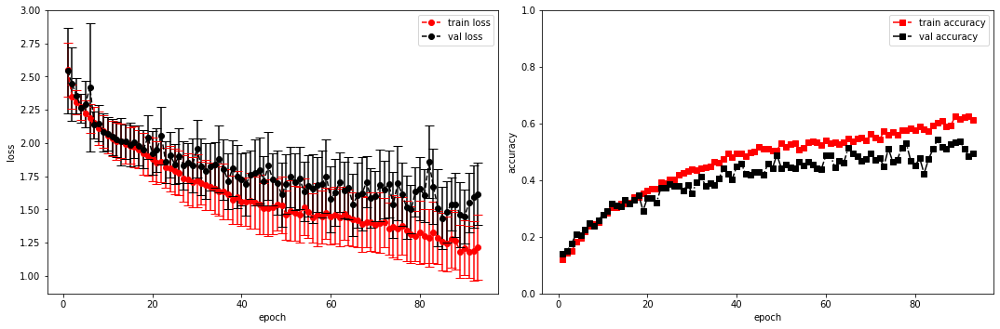

model saved


training epoch:  93
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [94/100], step [1/168],  Loss: 0.9851 +/- 0.0000,  accuracy: 0.044921875, time elapsed = 0.5365149974822998s
Epoch [94/100], step [17/168],  Loss: 1.1680 +/- 0.1675,  accuracy: 0.626953125, time elapsed = 6.241672515869141s
Epoch [94/100], step [33/168],  Loss: 1.1103 +/- 0.2458,  accuracy: 0.666015625, time elapsed = 6.24252986907959s
Epoch [94/100], step [49/168],  Loss: 1.2505 +/- 0.1924,  accuracy: 0.607421875, time elapsed = 6.2431886196136475s
Epoch [94/100], step [65/168],  Loss: 1.0783 +/- 0.2547,  accuracy: 0.634765625, time elapsed = 6.242263555526733s
Epoch [94/100], step [81/168],  Loss: 1.2491 +/- 0.1804,  accuracy: 0.6171875, time elapsed = 6.241284132003784s
Epoch [94/100], step [97/168],  Loss: 1.1643 +/- 0.2222,  accuracy: 0.642578125, time elapsed = 6.242192506790161s
Epoch [94/100], step [113/168],  Loss: 1.1603 +/- 0.2535,  accuracy: 0.63671875, time elapsed = 6.2430243492126465s
Epoch [94/100], step [129/168],  Loss: 1.2054 +/- 0.2208,  accuracy: 0.62890625, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.631,  precision = 0.631 recall = 0.631 f1 = 0.631 ::: val: acc = 0.548,  precision = 0.548 recall = 0.548 time elapsed = 70.56249332427979s


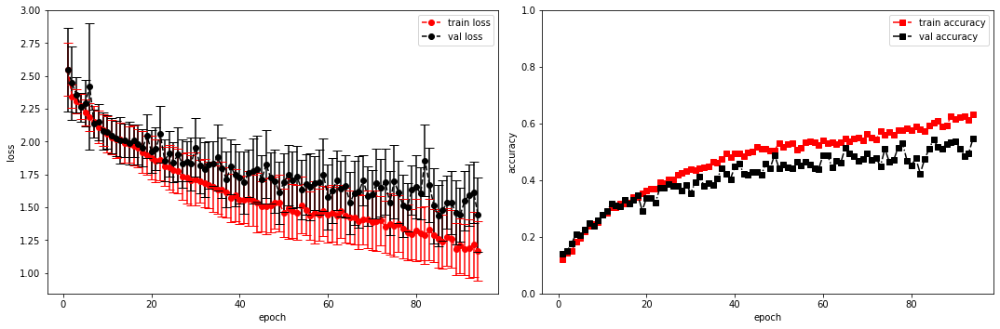

model saved


training epoch:  94
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [95/100], step [1/168],  Loss: 0.9210 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5733788013458252s
Epoch [95/100], step [17/168],  Loss: 1.0921 +/- 0.1734,  accuracy: 0.65234375, time elapsed = 6.242493391036987s
Epoch [95/100], step [33/168],  Loss: 1.1588 +/- 0.1723,  accuracy: 0.62109375, time elapsed = 6.241305351257324s
Epoch [95/100], step [49/168],  Loss: 1.1497 +/- 0.2171,  accuracy: 0.646484375, time elapsed = 6.2422935962677s
Epoch [95/100], step [65/168],  Loss: 1.2497 +/- 0.1717,  accuracy: 0.5859375, time elapsed = 6.24135160446167s
Epoch [95/100], step [81/168],  Loss: 1.1056 +/- 0.2059,  accuracy: 0.65234375, time elapsed = 6.2422144412994385s
Epoch [95/100], step [97/168],  Loss: 1.0776 +/- 0.1767,  accuracy: 0.666015625, time elapsed = 6.242857217788696s
Epoch [95/100], step [113/168],  Loss: 1.0580 +/- 0.1598,  accuracy: 0.65625, time elapsed = 6.243485927581787s
Epoch [95/100], step [129/168],  Loss: 1.1072 +/- 0.2100,  accuracy: 0.630859375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.633,  precision = 0.633 recall = 0.633 f1 = 0.633 ::: val: acc = 0.521,  precision = 0.521 recall = 0.521 time elapsed = 70.57691645622253s


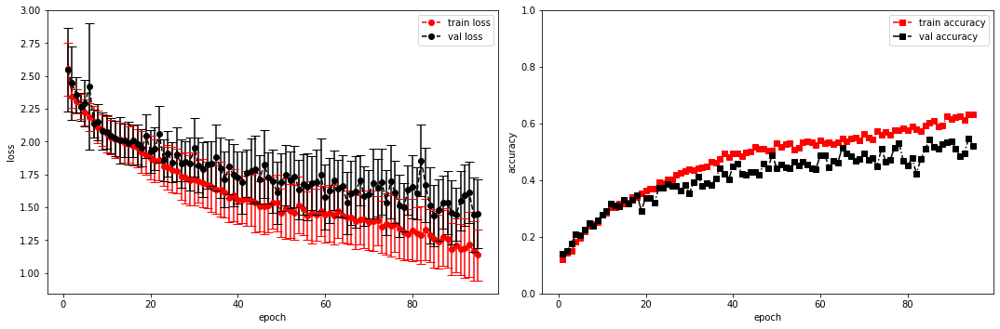

model saved


training epoch:  95
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [96/100], step [1/168],  Loss: 1.0813 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5353057384490967s
Epoch [96/100], step [17/168],  Loss: 0.9792 +/- 0.1311,  accuracy: 0.677734375, time elapsed = 6.24078631401062s
Epoch [96/100], step [33/168],  Loss: 1.0629 +/- 0.2447,  accuracy: 0.6796875, time elapsed = 6.242514133453369s
Epoch [96/100], step [49/168],  Loss: 1.1185 +/- 0.2063,  accuracy: 0.65625, time elapsed = 6.241480827331543s
Epoch [96/100], step [65/168],  Loss: 1.1742 +/- 0.1646,  accuracy: 0.6171875, time elapsed = 6.24122428894043s
Epoch [96/100], step [81/168],  Loss: 1.1392 +/- 0.1969,  accuracy: 0.6484375, time elapsed = 6.241786479949951s
Epoch [96/100], step [97/168],  Loss: 1.0545 +/- 0.1493,  accuracy: 0.67578125, time elapsed = 6.253412246704102s
Epoch [96/100], step [113/168],  Loss: 1.0987 +/- 0.2092,  accuracy: 0.638671875, time elapsed = 6.241207838058472s
Epoch [96/100], step [129/168],  Loss: 1.0236 +/- 0.2055,  accuracy: 0.67578125, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.654,  precision = 0.654 recall = 0.654 f1 = 0.654 ::: val: acc = 0.529,  precision = 0.529 recall = 0.529 time elapsed = 70.54341983795166s


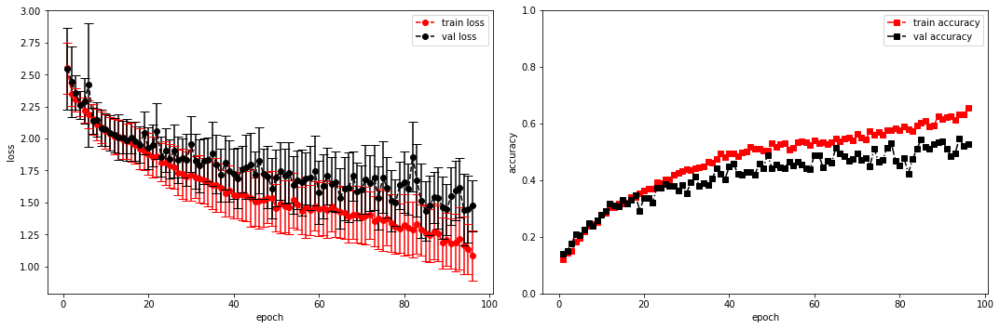

model saved
model saved


training epoch:  96
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [97/100], step [1/168],  Loss: 0.8479 +/- 0.0000,  accuracy: 0.044921875, time elapsed = 0.5337929725646973s
Epoch [97/100], step [17/168],  Loss: 1.0233 +/- 0.2313,  accuracy: 0.65625, time elapsed = 6.241518497467041s
Epoch [97/100], step [33/168],  Loss: 1.1452 +/- 0.2386,  accuracy: 0.63671875, time elapsed = 6.241361379623413s
Epoch [97/100], step [49/168],  Loss: 1.0772 +/- 0.2150,  accuracy: 0.62890625, time elapsed = 6.242245435714722s
Epoch [97/100], step [65/168],  Loss: 1.0776 +/- 0.1676,  accuracy: 0.669921875, time elapsed = 6.243960618972778s
Epoch [97/100], step [81/168],  Loss: 1.1397 +/- 0.1962,  accuracy: 0.642578125, time elapsed = 6.242756128311157s
Epoch [97/100], step [97/168],  Loss: 1.1077 +/- 0.1560,  accuracy: 0.6328125, time elapsed = 6.241454601287842s
Epoch [97/100], step [113/168],  Loss: 1.0628 +/- 0.1520,  accuracy: 0.666015625, time elapsed = 6.2416298389434814s
Epoch [97/100], step [129/168],  Loss: 1.0631 +/- 0.1928,  accuracy: 0.654296875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.650,  precision = 0.650 recall = 0.650 f1 = 0.650 ::: val: acc = 0.515,  precision = 0.515 recall = 0.515 time elapsed = 70.54295015335083s


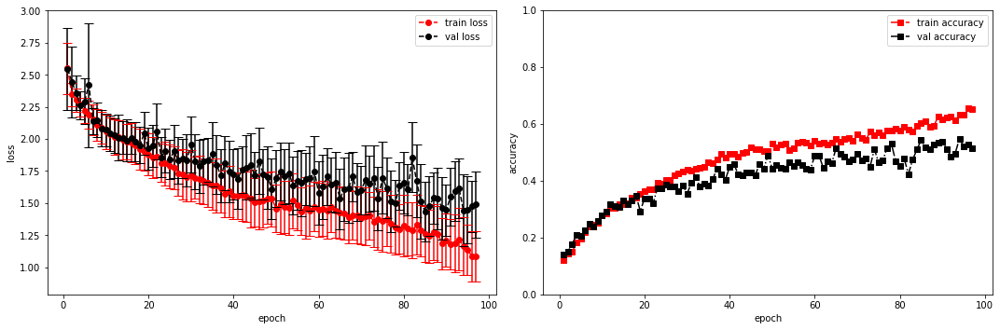

model saved
stopping early
device:  cuda
dataset metadata:  {'n_fft': 2048, 'hop_length': 512, 'n_mfcc': 40, 'notes': 'optional notes not passed'}
train model: data loaders initialized
sample shape =  (1, 40, 259)
model loaded
Layer (type:depth-idx)                   Output Shape              Param #
├─TripleConv: 1-1                        [-1, 8, 40, 259]          --
|    └─ConvBlock: 2-1                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-1              [-1, 8, 40, 259]          96
|    └─ConvBlock: 2-2                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-2              [-1, 8, 40, 259]          600
|    └─ConvBlock: 2-3                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-3              [-1, 8, 40, 259]          600
├─ConvBlock: 1-2                         [-1, 8, 20, 129]          --
|    └─Sequential: 2-4                   [-1, 8, 20, 129]          --
|    |    └─Conv2d: 3-4                  [-1, 8, 40, 259]         

<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [1/100], step [1/168],  Loss: 2.9158 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5201003551483154s
Epoch [1/100], step [17/168],  Loss: 2.7543 +/- 0.1687,  accuracy: 0.12109375, time elapsed = 6.217078924179077s
Epoch [1/100], step [33/168],  Loss: 2.7121 +/- 0.1188,  accuracy: 0.091796875, time elapsed = 6.2164390087127686s
Epoch [1/100], step [49/168],  Loss: 2.6192 +/- 0.1328,  accuracy: 0.1015625, time elapsed = 6.218926906585693s
Epoch [1/100], step [65/168],  Loss: 2.5246 +/- 0.1830,  accuracy: 0.1171875, time elapsed = 6.244762420654297s
Epoch [1/100], step [81/168],  Loss: 2.5620 +/- 0.1520,  accuracy: 0.095703125, time elapsed = 6.244109869003296s
Epoch [1/100], step [97/168],  Loss: 2.4632 +/- 0.0930,  accuracy: 0.126953125, time elapsed = 6.244318962097168s
Epoch [1/100], step [113/168],  Loss: 2.4389 +/- 0.0899,  accuracy: 0.123046875, time elapsed = 6.2461607456207275s
Epoch [1/100], step [129/168],  Loss: 2.4294 +/- 0.0965,  accuracy: 0.123046875, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.112,  precision = 0.112 recall = 0.112 f1 = 0.112 ::: val: acc = 0.130,  precision = 0.130 recall = 0.130 time elapsed = 70.4709620475769s


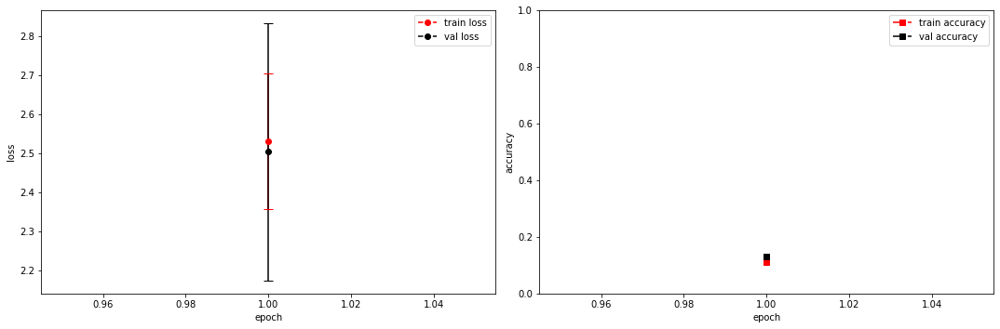

model saved


training epoch:  1
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [2/100], step [1/168],  Loss: 2.3877 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5568315982818604s
Epoch [2/100], step [17/168],  Loss: 2.3907 +/- 0.0820,  accuracy: 0.12890625, time elapsed = 6.243267774581909s
Epoch [2/100], step [33/168],  Loss: 2.3769 +/- 0.0533,  accuracy: 0.140625, time elapsed = 6.244521617889404s
Epoch [2/100], step [49/168],  Loss: 2.3618 +/- 0.0567,  accuracy: 0.125, time elapsed = 6.243167877197266s
Epoch [2/100], step [65/168],  Loss: 2.3468 +/- 0.0519,  accuracy: 0.138671875, time elapsed = 6.2433180809021s
Epoch [2/100], step [81/168],  Loss: 2.3206 +/- 0.0757,  accuracy: 0.14453125, time elapsed = 6.25633978843689s
Epoch [2/100], step [97/168],  Loss: 2.3333 +/- 0.0811,  accuracy: 0.169921875, time elapsed = 6.239339828491211s
Epoch [2/100], step [113/168],  Loss: 2.3736 +/- 0.0564,  accuracy: 0.16015625, time elapsed = 6.239550828933716s
Epoch [2/100], step [129/168],  Loss: 2.3258 +/- 0.0884,  accuracy: 0.14453125, time elapsed = 6.23878

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.141,  precision = 0.141 recall = 0.141 f1 = 0.141 ::: val: acc = 0.145,  precision = 0.145 recall = 0.145 time elapsed = 70.56018376350403s


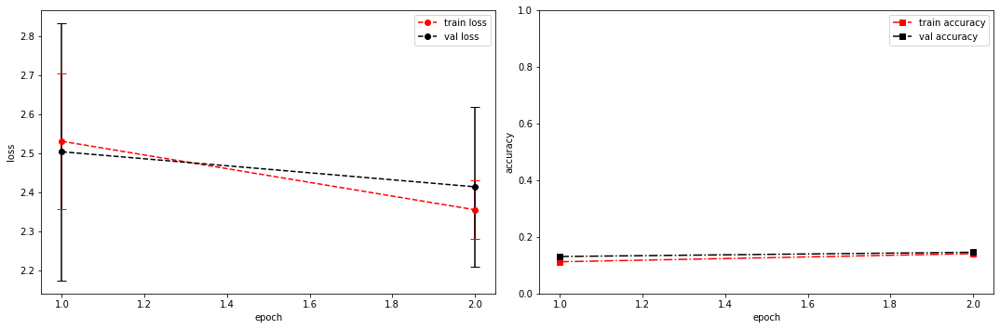

model saved


training epoch:  2
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [3/100], step [1/168],  Loss: 2.3607 +/- 0.0000,  accuracy: 0.0078125, time elapsed = 0.5314435958862305s
Epoch [3/100], step [17/168],  Loss: 2.3445 +/- 0.0597,  accuracy: 0.134765625, time elapsed = 6.2393717765808105s
Epoch [3/100], step [33/168],  Loss: 2.3247 +/- 0.0865,  accuracy: 0.150390625, time elapsed = 6.239627122879028s
Epoch [3/100], step [49/168],  Loss: 2.3326 +/- 0.0581,  accuracy: 0.16015625, time elapsed = 6.242321729660034s
Epoch [3/100], step [65/168],  Loss: 2.3284 +/- 0.0707,  accuracy: 0.162109375, time elapsed = 6.238854169845581s
Epoch [3/100], step [81/168],  Loss: 2.2814 +/- 0.0584,  accuracy: 0.16015625, time elapsed = 6.240685224533081s
Epoch [3/100], step [97/168],  Loss: 2.2868 +/- 0.0495,  accuracy: 0.173828125, time elapsed = 6.240673542022705s
Epoch [3/100], step [113/168],  Loss: 2.3425 +/- 0.1053,  accuracy: 0.134765625, time elapsed = 6.2392027378082275s
Epoch [3/100], step [129/168],  Loss: 2.2975 +/- 0.0917,  accuracy: 0.15234375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.155,  precision = 0.155 recall = 0.155 f1 = 0.155 ::: val: acc = 0.170,  precision = 0.170 recall = 0.170 time elapsed = 70.50190353393555s


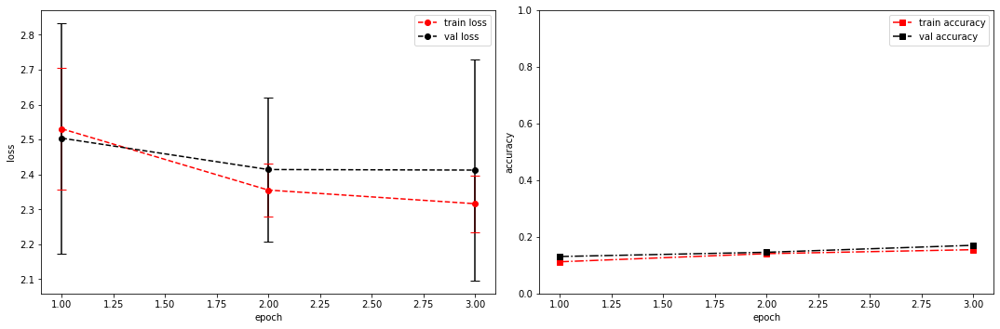

model saved


training epoch:  3
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [4/100], step [1/168],  Loss: 2.2886 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.538438081741333s
Epoch [4/100], step [17/168],  Loss: 2.2912 +/- 0.0936,  accuracy: 0.162109375, time elapsed = 6.238919019699097s
Epoch [4/100], step [33/168],  Loss: 2.2756 +/- 0.0860,  accuracy: 0.166015625, time elapsed = 6.248921871185303s
Epoch [4/100], step [49/168],  Loss: 2.2755 +/- 0.0505,  accuracy: 0.158203125, time elapsed = 6.239349842071533s
Epoch [4/100], step [65/168],  Loss: 2.2942 +/- 0.0766,  accuracy: 0.16796875, time elapsed = 6.239600658416748s
Epoch [4/100], step [81/168],  Loss: 2.3152 +/- 0.1098,  accuracy: 0.171875, time elapsed = 6.239510774612427s
Epoch [4/100], step [97/168],  Loss: 2.2644 +/- 0.0793,  accuracy: 0.19140625, time elapsed = 6.239847183227539s
Epoch [4/100], step [113/168],  Loss: 2.2803 +/- 0.0780,  accuracy: 0.16015625, time elapsed = 6.238743305206299s
Epoch [4/100], step [129/168],  Loss: 2.2991 +/- 0.0777,  accuracy: 0.171875, time elapsed = 6.23

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.173,  precision = 0.173 recall = 0.173 f1 = 0.173 ::: val: acc = 0.198,  precision = 0.198 recall = 0.198 time elapsed = 70.50960612297058s


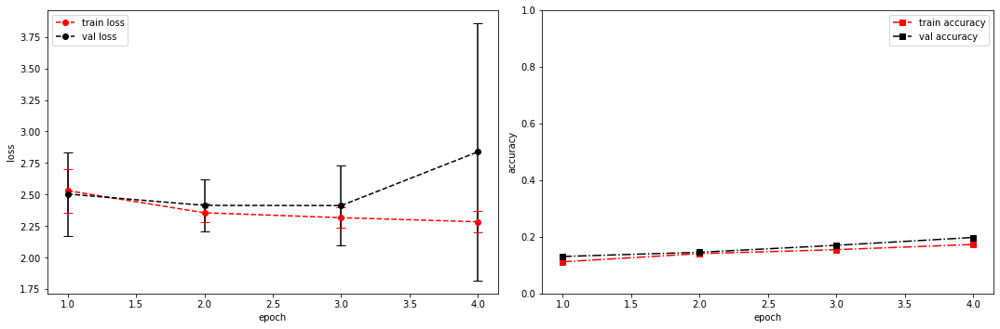

model saved


training epoch:  4
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [5/100], step [1/168],  Loss: 2.2312 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5306589603424072s
Epoch [5/100], step [17/168],  Loss: 2.2676 +/- 0.0901,  accuracy: 0.18359375, time elapsed = 6.240633487701416s
Epoch [5/100], step [33/168],  Loss: 2.2708 +/- 0.1044,  accuracy: 0.201171875, time elapsed = 6.239822864532471s
Epoch [5/100], step [49/168],  Loss: 2.3148 +/- 0.1293,  accuracy: 0.18359375, time elapsed = 6.240190744400024s
Epoch [5/100], step [65/168],  Loss: 2.2830 +/- 0.1023,  accuracy: 0.2109375, time elapsed = 6.239738941192627s
Epoch [5/100], step [81/168],  Loss: 2.2625 +/- 0.0985,  accuracy: 0.19140625, time elapsed = 6.238692998886108s
Epoch [5/100], step [97/168],  Loss: 2.2998 +/- 0.0784,  accuracy: 0.142578125, time elapsed = 6.239986896514893s
Epoch [5/100], step [113/168],  Loss: 2.2722 +/- 0.0743,  accuracy: 0.171875, time elapsed = 6.238545179367065s
Epoch [5/100], step [129/168],  Loss: 2.2464 +/- 0.0868,  accuracy: 0.18359375, time elapsed = 6

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.185,  precision = 0.185 recall = 0.185 f1 = 0.185 ::: val: acc = 0.203,  precision = 0.203 recall = 0.203 time elapsed = 70.5119559764862s


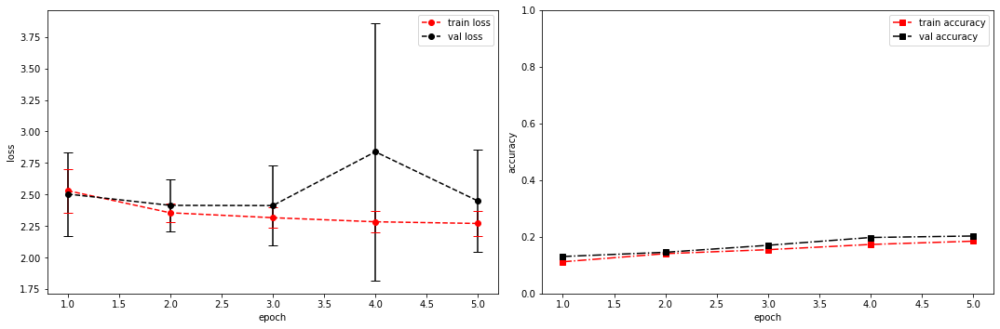

model saved


training epoch:  5
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [6/100], step [1/168],  Loss: 2.0611 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.533592700958252s
Epoch [6/100], step [17/168],  Loss: 2.3234 +/- 0.1126,  accuracy: 0.15625, time elapsed = 6.239193439483643s
Epoch [6/100], step [33/168],  Loss: 2.2429 +/- 0.0844,  accuracy: 0.177734375, time elapsed = 6.239742279052734s
Epoch [6/100], step [49/168],  Loss: 2.2479 +/- 0.0909,  accuracy: 0.18359375, time elapsed = 6.237853527069092s
Epoch [6/100], step [65/168],  Loss: 2.2622 +/- 0.0935,  accuracy: 0.19140625, time elapsed = 6.238296031951904s
Epoch [6/100], step [81/168],  Loss: 2.2303 +/- 0.1103,  accuracy: 0.205078125, time elapsed = 6.238726377487183s
Epoch [6/100], step [97/168],  Loss: 2.2611 +/- 0.0900,  accuracy: 0.181640625, time elapsed = 6.238641023635864s
Epoch [6/100], step [113/168],  Loss: 2.2485 +/- 0.1049,  accuracy: 0.201171875, time elapsed = 6.240549802780151s
Epoch [6/100], step [129/168],  Loss: 2.2263 +/- 0.0871,  accuracy: 0.193359375, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.190,  precision = 0.190 recall = 0.190 f1 = 0.190 ::: val: acc = 0.223,  precision = 0.223 recall = 0.223 time elapsed = 70.50084066390991s


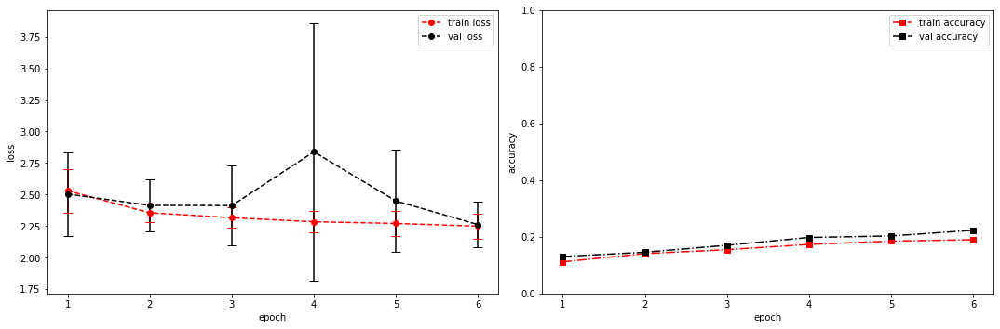

model saved


training epoch:  6
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [7/100], step [1/168],  Loss: 2.1789 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.530536413192749s
Epoch [7/100], step [17/168],  Loss: 2.2584 +/- 0.1249,  accuracy: 0.189453125, time elapsed = 6.239068269729614s
Epoch [7/100], step [33/168],  Loss: 2.2230 +/- 0.0814,  accuracy: 0.18359375, time elapsed = 6.238874912261963s
Epoch [7/100], step [49/168],  Loss: 2.2447 +/- 0.1242,  accuracy: 0.216796875, time elapsed = 6.239164590835571s
Epoch [7/100], step [65/168],  Loss: 2.2511 +/- 0.1053,  accuracy: 0.212890625, time elapsed = 6.239748239517212s
Epoch [7/100], step [81/168],  Loss: 2.2915 +/- 0.0919,  accuracy: 0.19921875, time elapsed = 6.239866495132446s
Epoch [7/100], step [97/168],  Loss: 2.2222 +/- 0.1294,  accuracy: 0.197265625, time elapsed = 6.247753858566284s
Epoch [7/100], step [113/168],  Loss: 2.2385 +/- 0.0851,  accuracy: 0.189453125, time elapsed = 6.239433288574219s
Epoch [7/100], step [129/168],  Loss: 2.1830 +/- 0.0863,  accuracy: 0.228515625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.207,  precision = 0.207 recall = 0.207 f1 = 0.207 ::: val: acc = 0.236,  precision = 0.236 recall = 0.236 time elapsed = 70.51173663139343s


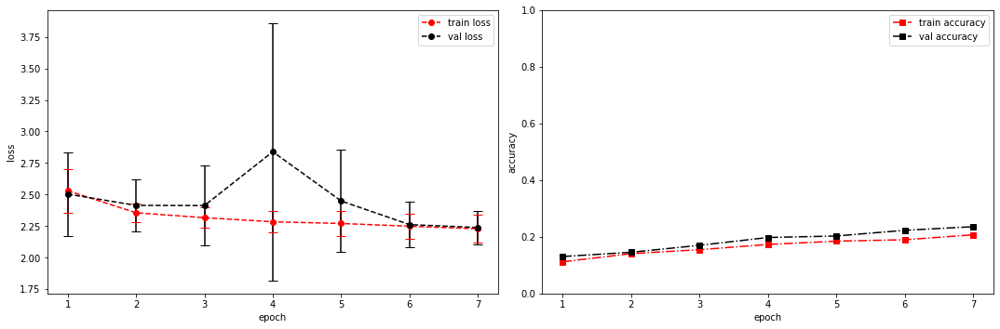

model saved


training epoch:  7
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [8/100], step [1/168],  Loss: 2.3263 +/- 0.0000,  accuracy: 0.005859375, time elapsed = 0.5338361263275146s
Epoch [8/100], step [17/168],  Loss: 2.2028 +/- 0.0963,  accuracy: 0.228515625, time elapsed = 6.239268779754639s
Epoch [8/100], step [33/168],  Loss: 2.2270 +/- 0.0850,  accuracy: 0.21875, time elapsed = 6.23911452293396s
Epoch [8/100], step [49/168],  Loss: 2.2344 +/- 0.0712,  accuracy: 0.212890625, time elapsed = 6.2387542724609375s
Epoch [8/100], step [65/168],  Loss: 2.1595 +/- 0.0964,  accuracy: 0.2578125, time elapsed = 6.240884304046631s
Epoch [8/100], step [81/168],  Loss: 2.0921 +/- 0.1114,  accuracy: 0.24609375, time elapsed = 6.23932957649231s
Epoch [8/100], step [97/168],  Loss: 2.2415 +/- 0.1143,  accuracy: 0.2109375, time elapsed = 6.2396838665008545s
Epoch [8/100], step [113/168],  Loss: 2.2104 +/- 0.1299,  accuracy: 0.203125, time elapsed = 6.239879846572876s
Epoch [8/100], step [129/168],  Loss: 2.2112 +/- 0.1069,  accuracy: 0.22265625, time elapsed = 6.23

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.231,  precision = 0.231 recall = 0.231 f1 = 0.231 ::: val: acc = 0.258,  precision = 0.258 recall = 0.258 time elapsed = 70.50949883460999s


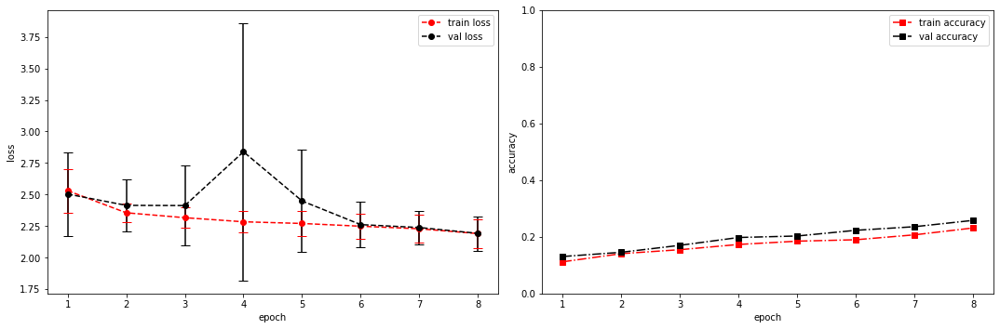

model saved


training epoch:  8
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [9/100], step [1/168],  Loss: 2.1345 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.531949520111084s
Epoch [9/100], step [17/168],  Loss: 2.1921 +/- 0.1136,  accuracy: 0.234375, time elapsed = 6.2402331829071045s
Epoch [9/100], step [33/168],  Loss: 2.1851 +/- 0.1205,  accuracy: 0.224609375, time elapsed = 6.242178201675415s
Epoch [9/100], step [49/168],  Loss: 2.1767 +/- 0.0979,  accuracy: 0.263671875, time elapsed = 6.2469422817230225s
Epoch [9/100], step [65/168],  Loss: 2.1768 +/- 0.0780,  accuracy: 0.232421875, time elapsed = 6.240384817123413s
Epoch [9/100], step [81/168],  Loss: 2.1835 +/- 0.1321,  accuracy: 0.24609375, time elapsed = 6.239652395248413s
Epoch [9/100], step [97/168],  Loss: 2.1596 +/- 0.1030,  accuracy: 0.2578125, time elapsed = 6.239716529846191s
Epoch [9/100], step [113/168],  Loss: 2.2000 +/- 0.0804,  accuracy: 0.25390625, time elapsed = 6.238752841949463s
Epoch [9/100], step [129/168],  Loss: 2.1790 +/- 0.1045,  accuracy: 0.193359375, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.236,  precision = 0.236 recall = 0.236 f1 = 0.236 ::: val: acc = 0.239,  precision = 0.239 recall = 0.239 time elapsed = 70.51596879959106s


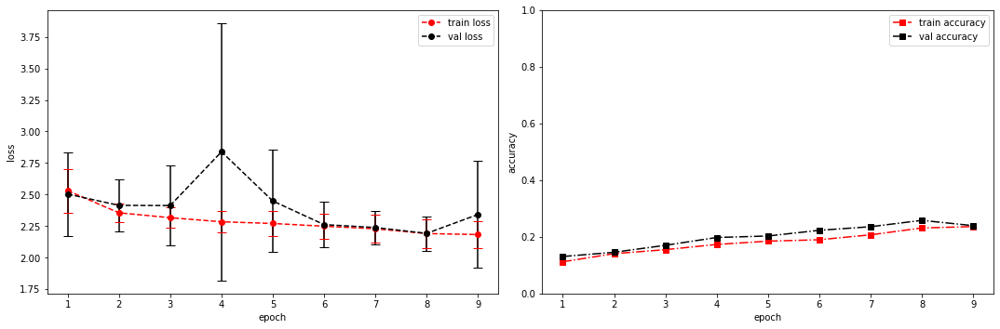

model saved


training epoch:  9
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [10/100], step [1/168],  Loss: 2.1899 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.532421350479126s
Epoch [10/100], step [17/168],  Loss: 2.1556 +/- 0.1046,  accuracy: 0.26171875, time elapsed = 6.237419366836548s
Epoch [10/100], step [33/168],  Loss: 2.1688 +/- 0.0946,  accuracy: 0.228515625, time elapsed = 6.238081216812134s
Epoch [10/100], step [49/168],  Loss: 2.1960 +/- 0.1363,  accuracy: 0.25390625, time elapsed = 6.240013599395752s
Epoch [10/100], step [65/168],  Loss: 2.1627 +/- 0.0976,  accuracy: 0.25, time elapsed = 6.2397682666778564s
Epoch [10/100], step [81/168],  Loss: 2.2029 +/- 0.1190,  accuracy: 0.21484375, time elapsed = 6.2376322746276855s
Epoch [10/100], step [97/168],  Loss: 2.1739 +/- 0.1270,  accuracy: 0.24609375, time elapsed = 6.2389185428619385s
Epoch [10/100], step [113/168],  Loss: 2.1071 +/- 0.1150,  accuracy: 0.259765625, time elapsed = 6.239306211471558s
Epoch [10/100], step [129/168],  Loss: 2.1265 +/- 0.0881,  accuracy: 0.259765625, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.248,  precision = 0.248 recall = 0.248 f1 = 0.248 ::: val: acc = 0.255,  precision = 0.255 recall = 0.255 time elapsed = 70.52182030677795s


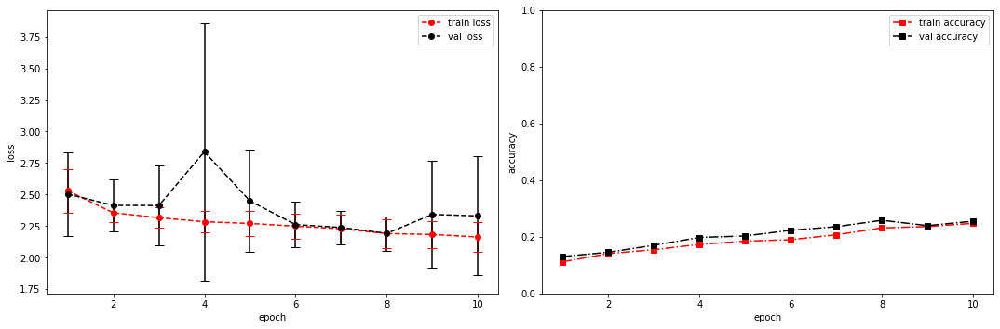

model saved


training epoch:  10
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [11/100], step [1/168],  Loss: 2.1136 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5281577110290527s
Epoch [11/100], step [17/168],  Loss: 2.1083 +/- 0.1011,  accuracy: 0.236328125, time elapsed = 6.239121437072754s
Epoch [11/100], step [33/168],  Loss: 2.1565 +/- 0.1035,  accuracy: 0.259765625, time elapsed = 6.240262746810913s
Epoch [11/100], step [49/168],  Loss: 2.1670 +/- 0.1374,  accuracy: 0.23828125, time elapsed = 6.240864276885986s
Epoch [11/100], step [65/168],  Loss: 2.1895 +/- 0.1019,  accuracy: 0.216796875, time elapsed = 6.238919734954834s
Epoch [11/100], step [81/168],  Loss: 2.1855 +/- 0.1048,  accuracy: 0.23828125, time elapsed = 6.23943829536438s
Epoch [11/100], step [97/168],  Loss: 2.1265 +/- 0.1169,  accuracy: 0.24609375, time elapsed = 6.239675998687744s
Epoch [11/100], step [113/168],  Loss: 2.1356 +/- 0.0906,  accuracy: 0.26953125, time elapsed = 6.239960670471191s
Epoch [11/100], step [129/168],  Loss: 2.1447 +/- 0.0973,  accuracy: 0.23828125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.246,  precision = 0.246 recall = 0.246 f1 = 0.246 ::: val: acc = 0.273,  precision = 0.273 recall = 0.273 time elapsed = 70.51592111587524s


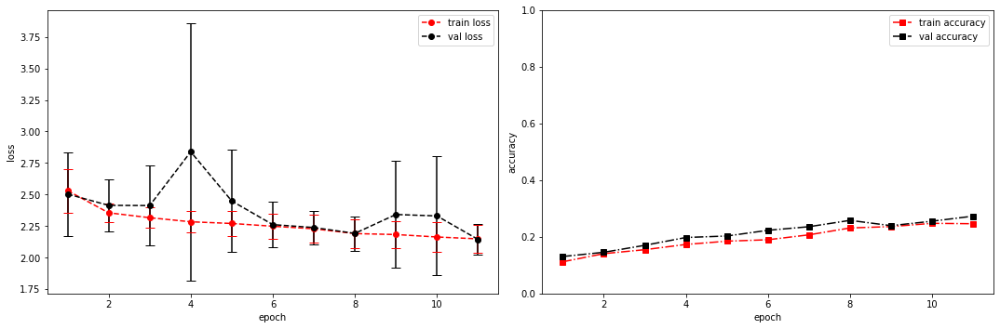

model saved


training epoch:  11
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [12/100], step [1/168],  Loss: 2.1006 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5282011032104492s
Epoch [12/100], step [17/168],  Loss: 2.1556 +/- 0.1249,  accuracy: 0.2578125, time elapsed = 6.237849473953247s
Epoch [12/100], step [33/168],  Loss: 2.1169 +/- 0.1269,  accuracy: 0.236328125, time elapsed = 6.240206003189087s
Epoch [12/100], step [49/168],  Loss: 2.1789 +/- 0.1237,  accuracy: 0.234375, time elapsed = 6.240526914596558s
Epoch [12/100], step [65/168],  Loss: 2.1011 +/- 0.1055,  accuracy: 0.27734375, time elapsed = 6.243951797485352s
Epoch [12/100], step [81/168],  Loss: 2.1666 +/- 0.1247,  accuracy: 0.25390625, time elapsed = 6.238167762756348s
Epoch [12/100], step [97/168],  Loss: 2.1641 +/- 0.1342,  accuracy: 0.228515625, time elapsed = 6.23948335647583s
Epoch [12/100], step [113/168],  Loss: 2.1596 +/- 0.1457,  accuracy: 0.244140625, time elapsed = 6.2483437061309814s
Epoch [12/100], step [129/168],  Loss: 2.1630 +/- 0.1313,  accuracy: 0.240234375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.248,  precision = 0.248 recall = 0.248 f1 = 0.248 ::: val: acc = 0.268,  precision = 0.268 recall = 0.268 time elapsed = 70.49697613716125s


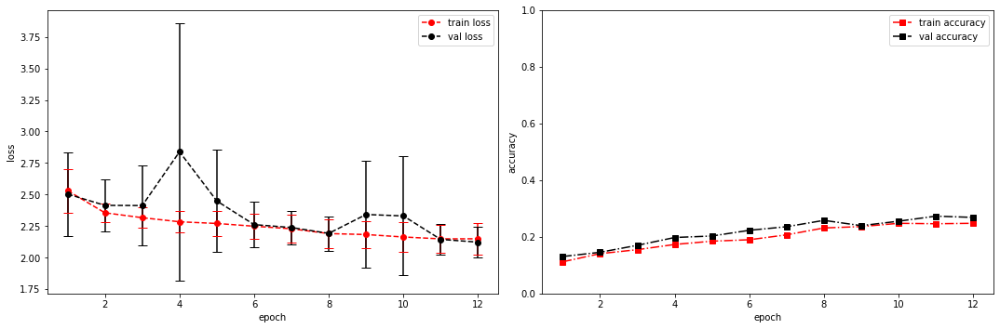

model saved


training epoch:  12
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [13/100], step [1/168],  Loss: 2.0986 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5298795700073242s
Epoch [13/100], step [17/168],  Loss: 2.0881 +/- 0.1525,  accuracy: 0.287109375, time elapsed = 6.240454196929932s
Epoch [13/100], step [33/168],  Loss: 2.1235 +/- 0.1174,  accuracy: 0.27734375, time elapsed = 6.238846778869629s
Epoch [13/100], step [49/168],  Loss: 2.1110 +/- 0.1123,  accuracy: 0.2578125, time elapsed = 6.239742994308472s
Epoch [13/100], step [65/168],  Loss: 2.1198 +/- 0.1072,  accuracy: 0.275390625, time elapsed = 6.240834474563599s
Epoch [13/100], step [81/168],  Loss: 2.1552 +/- 0.1791,  accuracy: 0.26171875, time elapsed = 6.2401933670043945s
Epoch [13/100], step [97/168],  Loss: 2.1245 +/- 0.1196,  accuracy: 0.255859375, time elapsed = 6.239835262298584s
Epoch [13/100], step [113/168],  Loss: 2.1415 +/- 0.1323,  accuracy: 0.28515625, time elapsed = 6.240189790725708s
Epoch [13/100], step [129/168],  Loss: 2.1595 +/- 0.1087,  accuracy: 0.248046875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.275,  precision = 0.275 recall = 0.275 f1 = 0.275 ::: val: acc = 0.271,  precision = 0.271 recall = 0.271 time elapsed = 70.49895000457764s


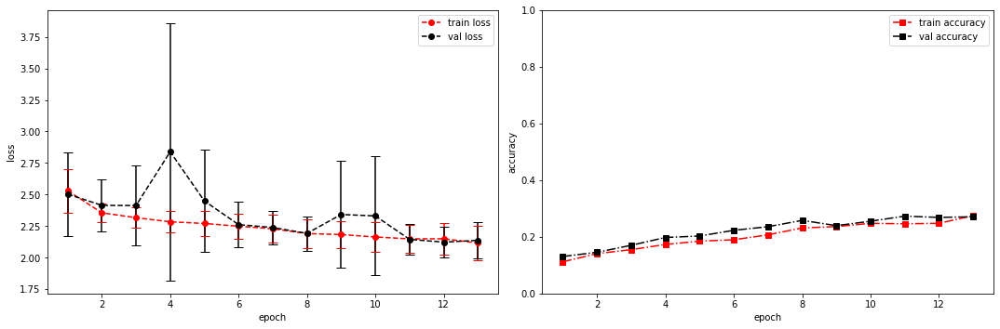

model saved


training epoch:  13
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [14/100], step [1/168],  Loss: 1.8588 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5389604568481445s
Epoch [14/100], step [17/168],  Loss: 2.0779 +/- 0.1094,  accuracy: 0.271484375, time elapsed = 6.238636016845703s
Epoch [14/100], step [33/168],  Loss: 2.1690 +/- 0.1456,  accuracy: 0.232421875, time elapsed = 6.239265441894531s
Epoch [14/100], step [49/168],  Loss: 2.1155 +/- 0.1010,  accuracy: 0.267578125, time elapsed = 6.251698970794678s
Epoch [14/100], step [65/168],  Loss: 2.1552 +/- 0.1151,  accuracy: 0.263671875, time elapsed = 6.23892068862915s
Epoch [14/100], step [81/168],  Loss: 2.0326 +/- 0.0934,  accuracy: 0.30859375, time elapsed = 6.239504098892212s
Epoch [14/100], step [97/168],  Loss: 2.1228 +/- 0.1099,  accuracy: 0.28125, time elapsed = 6.238694429397583s
Epoch [14/100], step [113/168],  Loss: 2.0800 +/- 0.1623,  accuracy: 0.287109375, time elapsed = 6.239534378051758s
Epoch [14/100], step [129/168],  Loss: 2.1407 +/- 0.1332,  accuracy: 0.26953125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.272,  precision = 0.272 recall = 0.272 f1 = 0.272 ::: val: acc = 0.277,  precision = 0.277 recall = 0.277 time elapsed = 70.51918244361877s


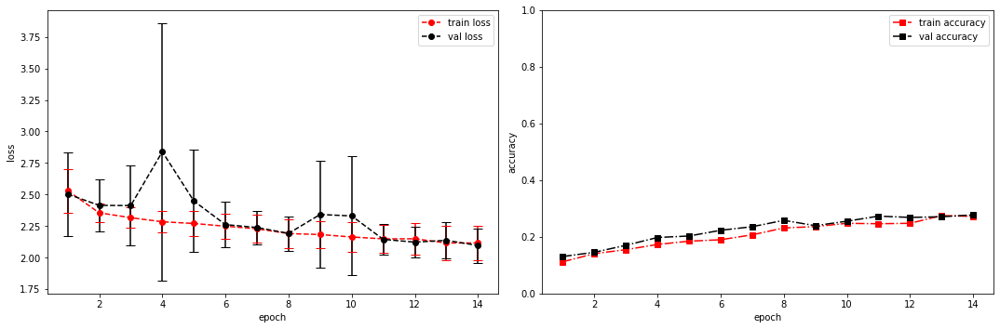

model saved


training epoch:  14
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [15/100], step [1/168],  Loss: 1.8752 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5323648452758789s
Epoch [15/100], step [17/168],  Loss: 2.1334 +/- 0.1359,  accuracy: 0.23828125, time elapsed = 6.240674257278442s
Epoch [15/100], step [33/168],  Loss: 2.1125 +/- 0.1332,  accuracy: 0.263671875, time elapsed = 6.23960018157959s
Epoch [15/100], step [49/168],  Loss: 2.1121 +/- 0.1530,  accuracy: 0.265625, time elapsed = 6.2389373779296875s
Epoch [15/100], step [65/168],  Loss: 2.1093 +/- 0.1245,  accuracy: 0.271484375, time elapsed = 6.240153789520264s
Epoch [15/100], step [81/168],  Loss: 2.1108 +/- 0.2072,  accuracy: 0.275390625, time elapsed = 6.239476919174194s
Epoch [15/100], step [97/168],  Loss: 2.0579 +/- 0.1378,  accuracy: 0.298828125, time elapsed = 6.2397027015686035s
Epoch [15/100], step [113/168],  Loss: 2.0736 +/- 0.1331,  accuracy: 0.283203125, time elapsed = 6.239566087722778s
Epoch [15/100], step [129/168],  Loss: 2.0514 +/- 0.0932,  accuracy: 0.275390625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.272,  precision = 0.272 recall = 0.272 f1 = 0.272 ::: val: acc = 0.274,  precision = 0.274 recall = 0.274 time elapsed = 70.5465407371521s


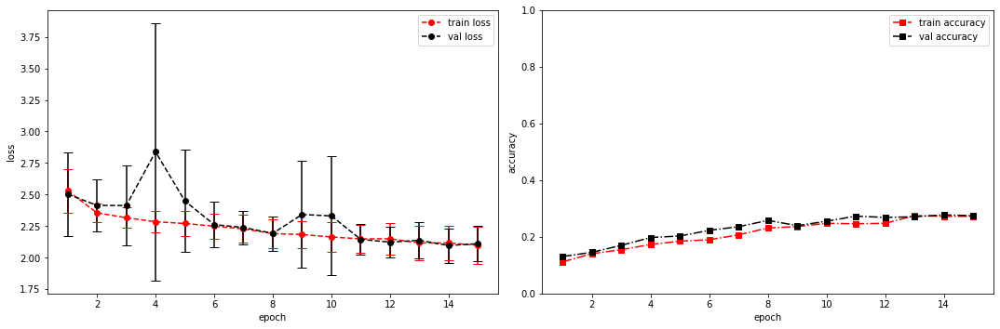

model saved


training epoch:  15
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [16/100], step [1/168],  Loss: 2.0802 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5353424549102783s
Epoch [16/100], step [17/168],  Loss: 2.0888 +/- 0.1293,  accuracy: 0.283203125, time elapsed = 6.238329887390137s
Epoch [16/100], step [33/168],  Loss: 2.0504 +/- 0.1427,  accuracy: 0.31640625, time elapsed = 6.239349365234375s
Epoch [16/100], step [49/168],  Loss: 2.0688 +/- 0.1057,  accuracy: 0.3046875, time elapsed = 6.237824201583862s
Epoch [16/100], step [65/168],  Loss: 2.0440 +/- 0.1610,  accuracy: 0.298828125, time elapsed = 6.238556623458862s
Epoch [16/100], step [81/168],  Loss: 2.0750 +/- 0.1311,  accuracy: 0.2890625, time elapsed = 6.23854398727417s
Epoch [16/100], step [97/168],  Loss: 2.1195 +/- 0.1135,  accuracy: 0.25390625, time elapsed = 6.239147663116455s
Epoch [16/100], step [113/168],  Loss: 2.0380 +/- 0.1451,  accuracy: 0.296875, time elapsed = 6.238599061965942s
Epoch [16/100], step [129/168],  Loss: 2.1174 +/- 0.1637,  accuracy: 0.26171875, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.282,  precision = 0.282 recall = 0.282 f1 = 0.282 ::: val: acc = 0.274,  precision = 0.274 recall = 0.274 time elapsed = 70.49182558059692s


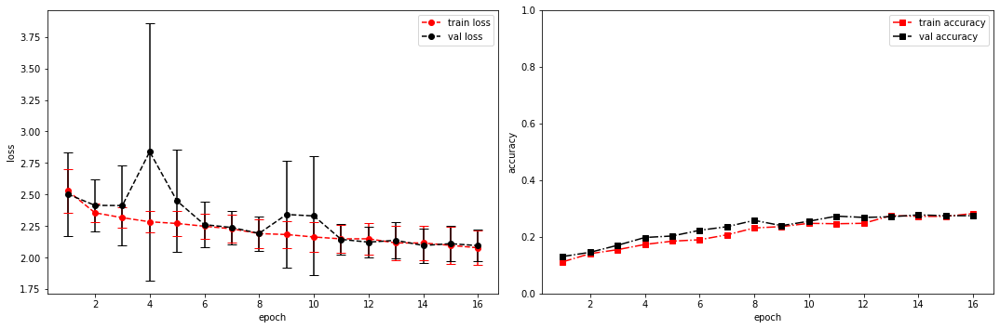

model saved


training epoch:  16
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [17/100], step [1/168],  Loss: 2.2024 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5382428169250488s
Epoch [17/100], step [17/168],  Loss: 2.0145 +/- 0.1195,  accuracy: 0.294921875, time elapsed = 6.239191293716431s
Epoch [17/100], step [33/168],  Loss: 1.9937 +/- 0.1549,  accuracy: 0.3203125, time elapsed = 6.240212917327881s
Epoch [17/100], step [49/168],  Loss: 2.0809 +/- 0.0899,  accuracy: 0.255859375, time elapsed = 6.238744020462036s
Epoch [17/100], step [65/168],  Loss: 2.0963 +/- 0.1251,  accuracy: 0.2734375, time elapsed = 6.2387285232543945s
Epoch [17/100], step [81/168],  Loss: 2.0611 +/- 0.1411,  accuracy: 0.26953125, time elapsed = 6.23884391784668s
Epoch [17/100], step [97/168],  Loss: 2.0636 +/- 0.1305,  accuracy: 0.28515625, time elapsed = 6.2401299476623535s
Epoch [17/100], step [113/168],  Loss: 2.0665 +/- 0.1518,  accuracy: 0.3046875, time elapsed = 6.24242377281189s
Epoch [17/100], step [129/168],  Loss: 2.0261 +/- 0.1539,  accuracy: 0.31640625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.285,  precision = 0.285 recall = 0.285 f1 = 0.285 ::: val: acc = 0.279,  precision = 0.279 recall = 0.279 time elapsed = 70.52589011192322s


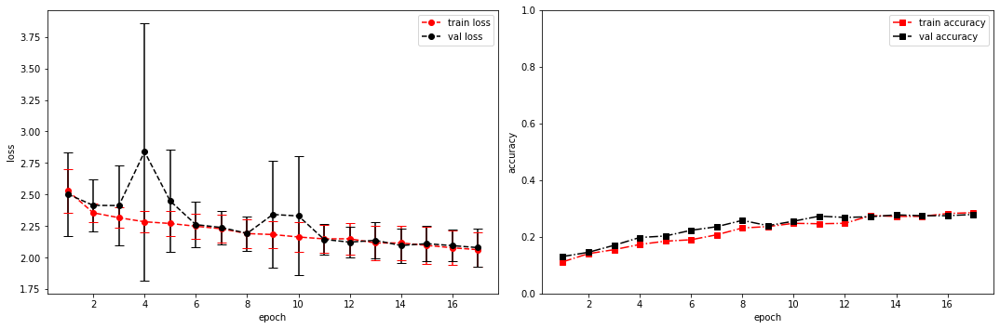

model saved


training epoch:  17
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [18/100], step [1/168],  Loss: 2.1171 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5313701629638672s
Epoch [18/100], step [17/168],  Loss: 2.0956 +/- 0.1578,  accuracy: 0.27734375, time elapsed = 6.238742351531982s
Epoch [18/100], step [33/168],  Loss: 2.0616 +/- 0.1477,  accuracy: 0.30078125, time elapsed = 6.238218307495117s
Epoch [18/100], step [49/168],  Loss: 2.0220 +/- 0.1273,  accuracy: 0.298828125, time elapsed = 6.238569736480713s
Epoch [18/100], step [65/168],  Loss: 2.0438 +/- 0.1172,  accuracy: 0.306640625, time elapsed = 6.238394021987915s
Epoch [18/100], step [81/168],  Loss: 2.0190 +/- 0.1477,  accuracy: 0.330078125, time elapsed = 6.240747928619385s
Epoch [18/100], step [97/168],  Loss: 2.0455 +/- 0.1441,  accuracy: 0.291015625, time elapsed = 6.2386884689331055s
Epoch [18/100], step [113/168],  Loss: 2.0077 +/- 0.1491,  accuracy: 0.294921875, time elapsed = 6.238270044326782s
Epoch [18/100], step [129/168],  Loss: 2.0707 +/- 0.1637,  accuracy: 0.28125, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.293,  precision = 0.293 recall = 0.293 f1 = 0.293 ::: val: acc = 0.294,  precision = 0.294 recall = 0.294 time elapsed = 70.49599075317383s


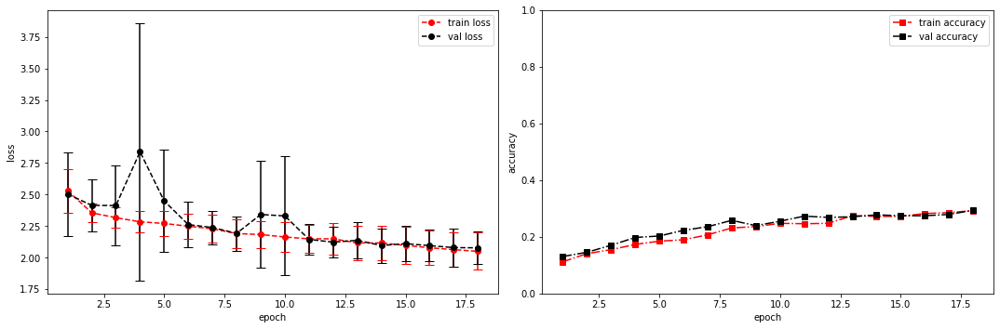

model saved


training epoch:  18
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [19/100], step [1/168],  Loss: 1.9202 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5376894474029541s
Epoch [19/100], step [17/168],  Loss: 2.0819 +/- 0.1647,  accuracy: 0.29296875, time elapsed = 6.23967170715332s
Epoch [19/100], step [33/168],  Loss: 2.0101 +/- 0.1335,  accuracy: 0.310546875, time elapsed = 6.238805770874023s
Epoch [19/100], step [49/168],  Loss: 2.0493 +/- 0.1018,  accuracy: 0.29296875, time elapsed = 6.240346670150757s
Epoch [19/100], step [65/168],  Loss: 2.0233 +/- 0.1455,  accuracy: 0.328125, time elapsed = 6.249547243118286s
Epoch [19/100], step [81/168],  Loss: 2.0249 +/- 0.1309,  accuracy: 0.31640625, time elapsed = 6.240566253662109s
Epoch [19/100], step [97/168],  Loss: 1.9712 +/- 0.0906,  accuracy: 0.32421875, time elapsed = 6.23900842666626s
Epoch [19/100], step [113/168],  Loss: 2.0269 +/- 0.1183,  accuracy: 0.28515625, time elapsed = 6.240988492965698s
Epoch [19/100], step [129/168],  Loss: 2.0616 +/- 0.1121,  accuracy: 0.30078125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.305,  precision = 0.305 recall = 0.305 f1 = 0.305 ::: val: acc = 0.287,  precision = 0.287 recall = 0.287 time elapsed = 70.52114844322205s


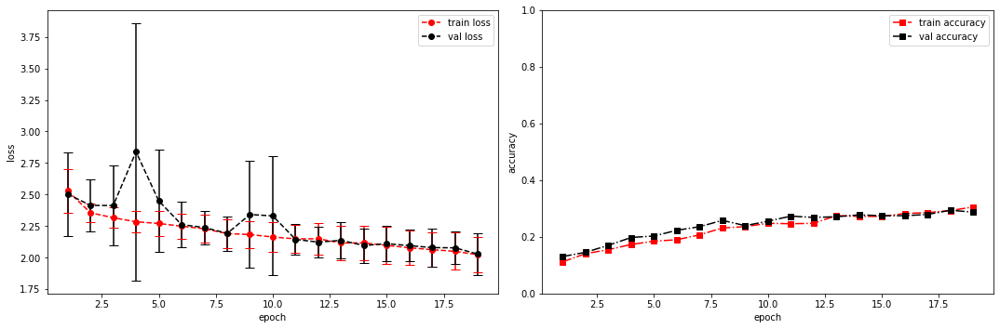

model saved


training epoch:  19
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [20/100], step [1/168],  Loss: 2.0082 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5392637252807617s
Epoch [20/100], step [17/168],  Loss: 2.0012 +/- 0.1299,  accuracy: 0.328125, time elapsed = 6.23860239982605s
Epoch [20/100], step [33/168],  Loss: 2.0007 +/- 0.1512,  accuracy: 0.326171875, time elapsed = 6.238750696182251s
Epoch [20/100], step [49/168],  Loss: 1.9951 +/- 0.1223,  accuracy: 0.3359375, time elapsed = 6.237727165222168s
Epoch [20/100], step [65/168],  Loss: 1.9624 +/- 0.1634,  accuracy: 0.3515625, time elapsed = 6.238215923309326s
Epoch [20/100], step [81/168],  Loss: 2.0548 +/- 0.1423,  accuracy: 0.30078125, time elapsed = 6.238914966583252s
Epoch [20/100], step [97/168],  Loss: 2.0319 +/- 0.1139,  accuracy: 0.310546875, time elapsed = 6.238526821136475s
Epoch [20/100], step [113/168],  Loss: 1.9880 +/- 0.1457,  accuracy: 0.2734375, time elapsed = 6.238318920135498s
Epoch [20/100], step [129/168],  Loss: 1.9630 +/- 0.1511,  accuracy: 0.333984375, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.317,  precision = 0.317 recall = 0.317 f1 = 0.317 ::: val: acc = 0.299,  precision = 0.299 recall = 0.299 time elapsed = 70.52496695518494s


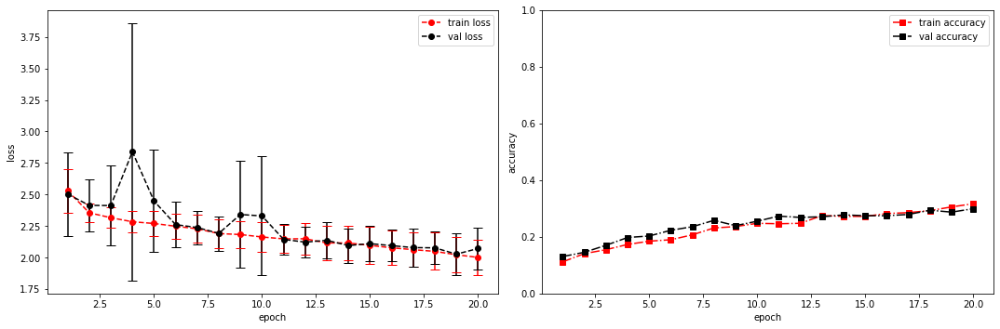

model saved


training epoch:  20
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [21/100], step [1/168],  Loss: 2.2329 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5912916660308838s
Epoch [21/100], step [17/168],  Loss: 1.9915 +/- 0.1267,  accuracy: 0.30078125, time elapsed = 6.248983860015869s
Epoch [21/100], step [33/168],  Loss: 2.0109 +/- 0.1109,  accuracy: 0.3046875, time elapsed = 6.239952087402344s
Epoch [21/100], step [49/168],  Loss: 1.9543 +/- 0.1119,  accuracy: 0.34375, time elapsed = 6.239564418792725s
Epoch [21/100], step [65/168],  Loss: 1.9971 +/- 0.1554,  accuracy: 0.32421875, time elapsed = 6.239898920059204s
Epoch [21/100], step [81/168],  Loss: 2.0134 +/- 0.1343,  accuracy: 0.298828125, time elapsed = 6.238890171051025s
Epoch [21/100], step [97/168],  Loss: 1.9565 +/- 0.1797,  accuracy: 0.326171875, time elapsed = 6.2393200397491455s
Epoch [21/100], step [113/168],  Loss: 1.9781 +/- 0.2108,  accuracy: 0.3359375, time elapsed = 6.240252256393433s
Epoch [21/100], step [129/168],  Loss: 1.9781 +/- 0.1111,  accuracy: 0.298828125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.318,  precision = 0.318 recall = 0.318 f1 = 0.318 ::: val: acc = 0.321,  precision = 0.321 recall = 0.321 time elapsed = 70.57065081596375s


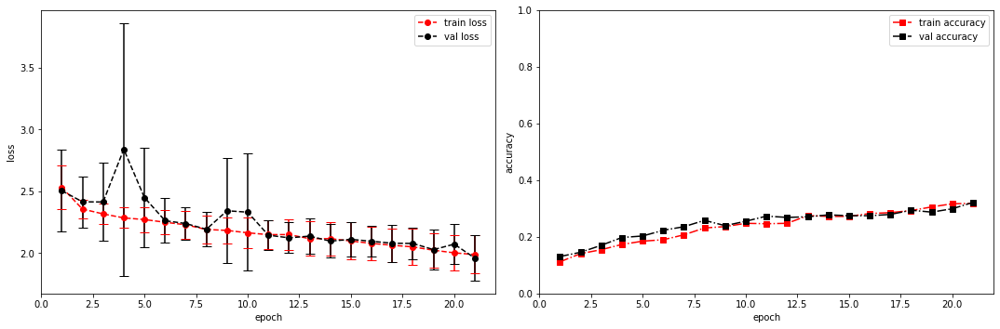

model saved


training epoch:  21
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [22/100], step [1/168],  Loss: 1.9028 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.535088300704956s
Epoch [22/100], step [17/168],  Loss: 1.9175 +/- 0.1597,  accuracy: 0.3515625, time elapsed = 6.237049341201782s
Epoch [22/100], step [33/168],  Loss: 1.9395 +/- 0.1103,  accuracy: 0.322265625, time elapsed = 6.237595558166504s
Epoch [22/100], step [49/168],  Loss: 1.9196 +/- 0.1254,  accuracy: 0.3359375, time elapsed = 6.238583564758301s
Epoch [22/100], step [65/168],  Loss: 1.9602 +/- 0.1742,  accuracy: 0.353515625, time elapsed = 6.238076686859131s
Epoch [22/100], step [81/168],  Loss: 1.9768 +/- 0.1849,  accuracy: 0.328125, time elapsed = 6.23802638053894s
Epoch [22/100], step [97/168],  Loss: 2.0029 +/- 0.1220,  accuracy: 0.314453125, time elapsed = 6.238109588623047s
Epoch [22/100], step [113/168],  Loss: 1.9405 +/- 0.1170,  accuracy: 0.330078125, time elapsed = 6.237480401992798s
Epoch [22/100], step [129/168],  Loss: 1.9769 +/- 0.1283,  accuracy: 0.32421875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.332,  precision = 0.332 recall = 0.332 f1 = 0.332 ::: val: acc = 0.334,  precision = 0.334 recall = 0.334 time elapsed = 70.50699758529663s


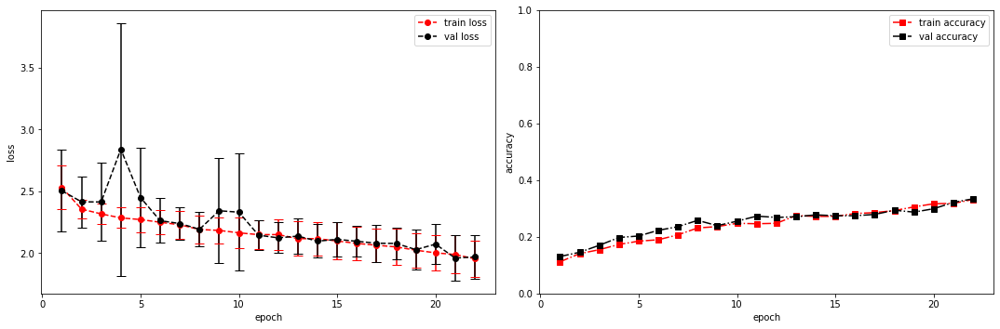

model saved


training epoch:  22
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [23/100], step [1/168],  Loss: 2.1122 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.53305983543396s
Epoch [23/100], step [17/168],  Loss: 1.8723 +/- 0.1277,  accuracy: 0.3359375, time elapsed = 6.239858150482178s
Epoch [23/100], step [33/168],  Loss: 1.9181 +/- 0.1503,  accuracy: 0.337890625, time elapsed = 6.239358186721802s
Epoch [23/100], step [49/168],  Loss: 1.9846 +/- 0.0821,  accuracy: 0.30859375, time elapsed = 6.238885402679443s
Epoch [23/100], step [65/168],  Loss: 1.9385 +/- 0.1688,  accuracy: 0.3515625, time elapsed = 6.239936113357544s
Epoch [23/100], step [81/168],  Loss: 1.9622 +/- 0.0902,  accuracy: 0.310546875, time elapsed = 6.239171028137207s
Epoch [23/100], step [97/168],  Loss: 1.9762 +/- 0.1876,  accuracy: 0.3359375, time elapsed = 6.240200757980347s
Epoch [23/100], step [113/168],  Loss: 1.9521 +/- 0.1158,  accuracy: 0.3359375, time elapsed = 6.238860368728638s
Epoch [23/100], step [129/168],  Loss: 1.9230 +/- 0.1356,  accuracy: 0.37109375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.338,  precision = 0.338 recall = 0.338 f1 = 0.338 ::: val: acc = 0.329,  precision = 0.329 recall = 0.329 time elapsed = 70.51084184646606s


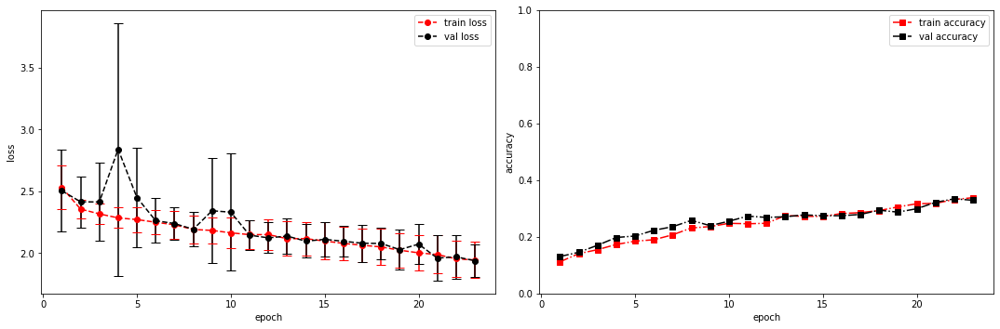

model saved


training epoch:  23
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [24/100], step [1/168],  Loss: 1.8334 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5358855724334717s
Epoch [24/100], step [17/168],  Loss: 1.9854 +/- 0.1885,  accuracy: 0.322265625, time elapsed = 6.239480257034302s
Epoch [24/100], step [33/168],  Loss: 1.9021 +/- 0.1378,  accuracy: 0.34765625, time elapsed = 6.239094495773315s
Epoch [24/100], step [49/168],  Loss: 1.9565 +/- 0.1661,  accuracy: 0.31640625, time elapsed = 6.238790035247803s
Epoch [24/100], step [65/168],  Loss: 1.8029 +/- 0.1404,  accuracy: 0.404296875, time elapsed = 6.239666700363159s
Epoch [24/100], step [81/168],  Loss: 1.9611 +/- 0.1392,  accuracy: 0.33203125, time elapsed = 6.250781297683716s
Epoch [24/100], step [97/168],  Loss: 1.8853 +/- 0.1670,  accuracy: 0.361328125, time elapsed = 6.2375168800354s
Epoch [24/100], step [113/168],  Loss: 1.9174 +/- 0.1685,  accuracy: 0.345703125, time elapsed = 6.236880779266357s
Epoch [24/100], step [129/168],  Loss: 1.9150 +/- 0.1423,  accuracy: 0.365234375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.347,  precision = 0.347 recall = 0.347 f1 = 0.347 ::: val: acc = 0.325,  precision = 0.325 recall = 0.325 time elapsed = 70.51365113258362s


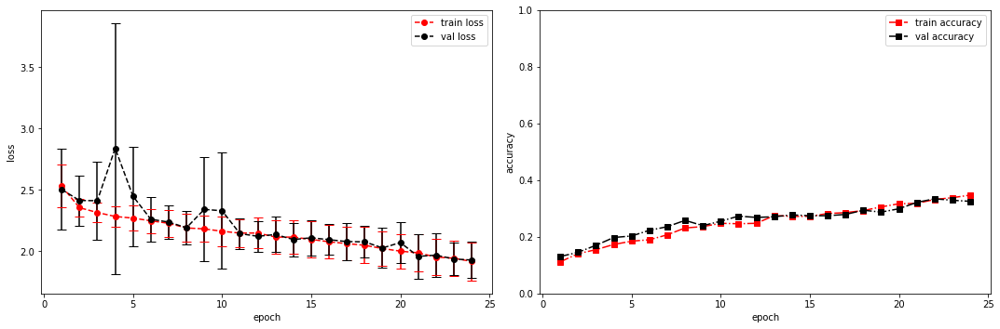

model saved


training epoch:  24
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [25/100], step [1/168],  Loss: 2.0872 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5333387851715088s
Epoch [25/100], step [17/168],  Loss: 1.8690 +/- 0.1480,  accuracy: 0.375, time elapsed = 6.24064040184021s
Epoch [25/100], step [33/168],  Loss: 1.8877 +/- 0.1408,  accuracy: 0.35546875, time elapsed = 6.241694211959839s
Epoch [25/100], step [49/168],  Loss: 1.8810 +/- 0.2038,  accuracy: 0.373046875, time elapsed = 6.238715648651123s
Epoch [25/100], step [65/168],  Loss: 1.9031 +/- 0.2140,  accuracy: 0.369140625, time elapsed = 6.239390850067139s
Epoch [25/100], step [81/168],  Loss: 1.9199 +/- 0.1527,  accuracy: 0.322265625, time elapsed = 6.2391743659973145s
Epoch [25/100], step [97/168],  Loss: 1.9493 +/- 0.1778,  accuracy: 0.34375, time elapsed = 6.2407331466674805s
Epoch [25/100], step [113/168],  Loss: 1.9106 +/- 0.1708,  accuracy: 0.373046875, time elapsed = 6.241668701171875s
Epoch [25/100], step [129/168],  Loss: 1.9167 +/- 0.1829,  accuracy: 0.341796875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.351,  precision = 0.351 recall = 0.351 f1 = 0.351 ::: val: acc = 0.343,  precision = 0.343 recall = 0.343 time elapsed = 70.50891757011414s


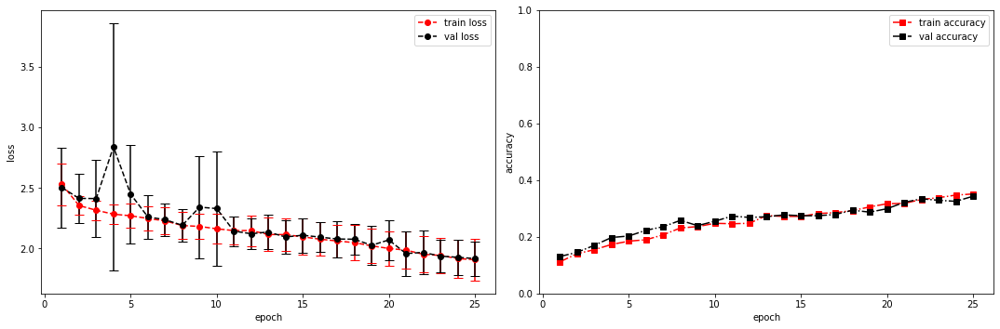

model saved


training epoch:  25
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [26/100], step [1/168],  Loss: 1.6770 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5453870296478271s
Epoch [26/100], step [17/168],  Loss: 1.8478 +/- 0.1589,  accuracy: 0.396484375, time elapsed = 6.2426228523254395s
Epoch [26/100], step [33/168],  Loss: 1.8790 +/- 0.1368,  accuracy: 0.34375, time elapsed = 6.248251914978027s
Epoch [26/100], step [49/168],  Loss: 1.8341 +/- 0.1494,  accuracy: 0.359375, time elapsed = 6.238560438156128s
Epoch [26/100], step [65/168],  Loss: 1.8791 +/- 0.1729,  accuracy: 0.328125, time elapsed = 6.239901542663574s
Epoch [26/100], step [81/168],  Loss: 1.9053 +/- 0.1445,  accuracy: 0.34765625, time elapsed = 6.238192796707153s
Epoch [26/100], step [97/168],  Loss: 1.9045 +/- 0.1336,  accuracy: 0.34375, time elapsed = 6.240314960479736s
Epoch [26/100], step [113/168],  Loss: 1.9417 +/- 0.1326,  accuracy: 0.345703125, time elapsed = 6.239589691162109s
Epoch [26/100], step [129/168],  Loss: 1.8712 +/- 0.1440,  accuracy: 0.33984375, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.351,  precision = 0.351 recall = 0.351 f1 = 0.351 ::: val: acc = 0.343,  precision = 0.343 recall = 0.343 time elapsed = 70.52697157859802s


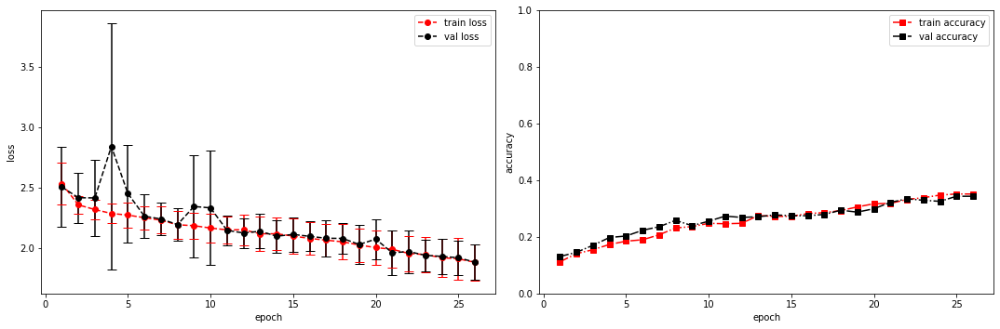

model saved


training epoch:  26
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [27/100], step [1/168],  Loss: 1.7132 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.53586745262146s
Epoch [27/100], step [17/168],  Loss: 1.8089 +/- 0.1627,  accuracy: 0.3984375, time elapsed = 6.237309694290161s
Epoch [27/100], step [33/168],  Loss: 1.9522 +/- 0.1646,  accuracy: 0.333984375, time elapsed = 6.238728046417236s
Epoch [27/100], step [49/168],  Loss: 1.8477 +/- 0.1554,  accuracy: 0.376953125, time elapsed = 6.239446401596069s
Epoch [27/100], step [65/168],  Loss: 1.9178 +/- 0.1569,  accuracy: 0.3359375, time elapsed = 6.238868951797485s
Epoch [27/100], step [81/168],  Loss: 1.8642 +/- 0.1369,  accuracy: 0.365234375, time elapsed = 6.237940549850464s
Epoch [27/100], step [97/168],  Loss: 1.8202 +/- 0.1836,  accuracy: 0.361328125, time elapsed = 6.237767219543457s
Epoch [27/100], step [113/168],  Loss: 1.9054 +/- 0.1650,  accuracy: 0.36328125, time elapsed = 6.239666700363159s
Epoch [27/100], step [129/168],  Loss: 1.8852 +/- 0.1604,  accuracy: 0.365234375, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.365,  precision = 0.365 recall = 0.365 f1 = 0.365 ::: val: acc = 0.361,  precision = 0.361 recall = 0.361 time elapsed = 70.51452779769897s


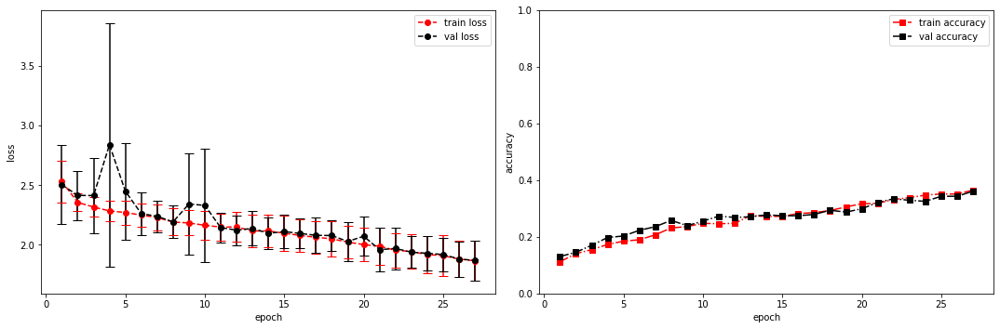

model saved


training epoch:  27
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [28/100], step [1/168],  Loss: 1.5164 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5412774085998535s
Epoch [28/100], step [17/168],  Loss: 1.8634 +/- 0.1406,  accuracy: 0.3671875, time elapsed = 6.237471342086792s
Epoch [28/100], step [33/168],  Loss: 1.8194 +/- 0.1643,  accuracy: 0.39453125, time elapsed = 6.23881983757019s
Epoch [28/100], step [49/168],  Loss: 1.8437 +/- 0.2024,  accuracy: 0.388671875, time elapsed = 6.2390618324279785s
Epoch [28/100], step [65/168],  Loss: 1.8123 +/- 0.1675,  accuracy: 0.400390625, time elapsed = 6.238152265548706s
Epoch [28/100], step [81/168],  Loss: 1.8612 +/- 0.1513,  accuracy: 0.365234375, time elapsed = 6.23715353012085s
Epoch [28/100], step [97/168],  Loss: 1.8024 +/- 0.1543,  accuracy: 0.40234375, time elapsed = 6.238517761230469s
Epoch [28/100], step [113/168],  Loss: 1.9404 +/- 0.1706,  accuracy: 0.34375, time elapsed = 6.240126371383667s
Epoch [28/100], step [129/168],  Loss: 1.8388 +/- 0.1740,  accuracy: 0.359375, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.374,  precision = 0.374 recall = 0.374 f1 = 0.374 ::: val: acc = 0.368,  precision = 0.368 recall = 0.368 time elapsed = 70.50441765785217s


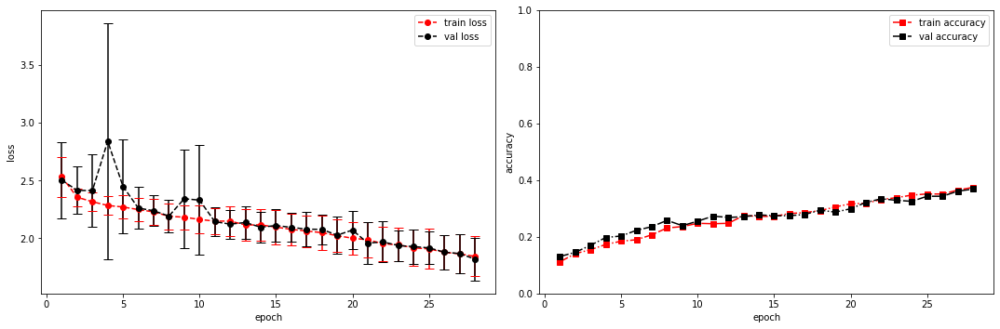

model saved


training epoch:  28
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [29/100], step [1/168],  Loss: 1.5278 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5337364673614502s
Epoch [29/100], step [17/168],  Loss: 1.9096 +/- 0.1480,  accuracy: 0.31640625, time elapsed = 6.239278793334961s
Epoch [29/100], step [33/168],  Loss: 1.7916 +/- 0.1930,  accuracy: 0.41796875, time elapsed = 6.240476131439209s
Epoch [29/100], step [49/168],  Loss: 1.7092 +/- 0.1244,  accuracy: 0.416015625, time elapsed = 6.24001145362854s
Epoch [29/100], step [65/168],  Loss: 1.8053 +/- 0.1005,  accuracy: 0.361328125, time elapsed = 6.23980188369751s
Epoch [29/100], step [81/168],  Loss: 1.8813 +/- 0.1953,  accuracy: 0.353515625, time elapsed = 6.243748664855957s
Epoch [29/100], step [97/168],  Loss: 1.7597 +/- 0.1433,  accuracy: 0.431640625, time elapsed = 6.242311477661133s
Epoch [29/100], step [113/168],  Loss: 1.7456 +/- 0.1704,  accuracy: 0.412109375, time elapsed = 6.237727403640747s
Epoch [29/100], step [129/168],  Loss: 1.9336 +/- 0.2022,  accuracy: 0.34375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.384,  precision = 0.384 recall = 0.384 f1 = 0.384 ::: val: acc = 0.367,  precision = 0.367 recall = 0.367 time elapsed = 70.51508975028992s


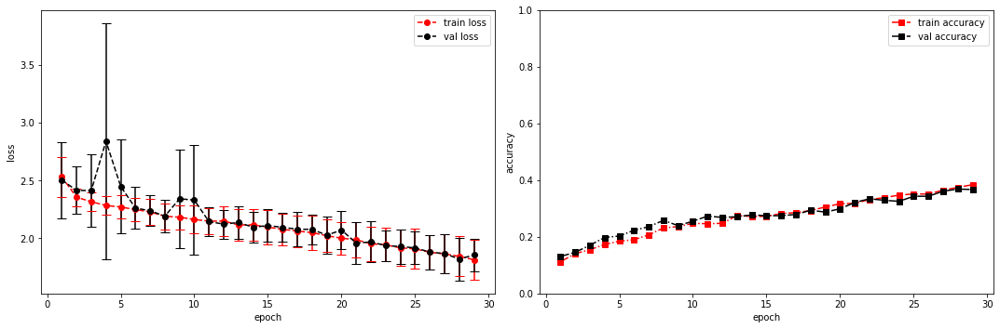

model saved


training epoch:  29
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [30/100], step [1/168],  Loss: 1.8675 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.543379545211792s
Epoch [30/100], step [17/168],  Loss: 1.8187 +/- 0.1347,  accuracy: 0.345703125, time elapsed = 6.239009618759155s
Epoch [30/100], step [33/168],  Loss: 1.7626 +/- 0.1733,  accuracy: 0.40625, time elapsed = 6.2382917404174805s
Epoch [30/100], step [49/168],  Loss: 1.8015 +/- 0.1936,  accuracy: 0.404296875, time elapsed = 6.240299701690674s
Epoch [30/100], step [65/168],  Loss: 1.8015 +/- 0.1911,  accuracy: 0.40625, time elapsed = 6.237475872039795s
Epoch [30/100], step [81/168],  Loss: 1.8071 +/- 0.1328,  accuracy: 0.404296875, time elapsed = 6.238037347793579s
Epoch [30/100], step [97/168],  Loss: 1.7262 +/- 0.1050,  accuracy: 0.40625, time elapsed = 6.238261699676514s
Epoch [30/100], step [113/168],  Loss: 1.8002 +/- 0.1287,  accuracy: 0.384765625, time elapsed = 6.238239765167236s
Epoch [30/100], step [129/168],  Loss: 1.7654 +/- 0.1061,  accuracy: 0.388671875, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.391,  precision = 0.391 recall = 0.391 f1 = 0.391 ::: val: acc = 0.383,  precision = 0.383 recall = 0.383 time elapsed = 70.51500463485718s


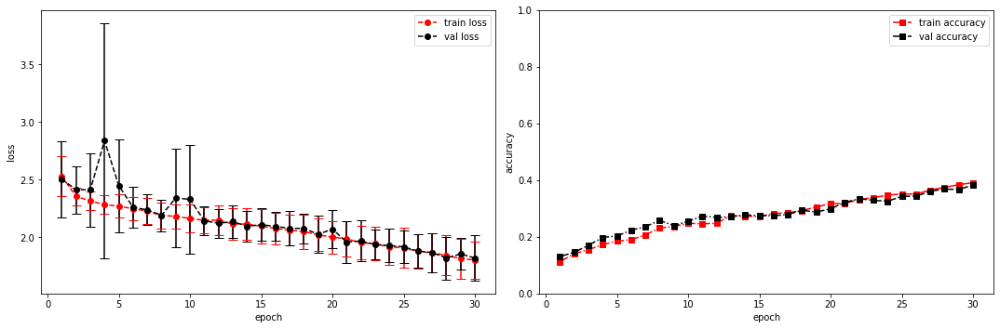

model saved


training epoch:  30
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [31/100], step [1/168],  Loss: 1.7651 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5355014801025391s
Epoch [31/100], step [17/168],  Loss: 1.6858 +/- 0.1792,  accuracy: 0.447265625, time elapsed = 6.24071741104126s
Epoch [31/100], step [33/168],  Loss: 1.7736 +/- 0.1803,  accuracy: 0.423828125, time elapsed = 6.252187967300415s
Epoch [31/100], step [49/168],  Loss: 1.7499 +/- 0.1895,  accuracy: 0.416015625, time elapsed = 6.238443613052368s
Epoch [31/100], step [65/168],  Loss: 1.8045 +/- 0.1457,  accuracy: 0.3984375, time elapsed = 6.238992929458618s
Epoch [31/100], step [81/168],  Loss: 1.6943 +/- 0.1826,  accuracy: 0.41796875, time elapsed = 6.239365816116333s
Epoch [31/100], step [97/168],  Loss: 1.7172 +/- 0.1840,  accuracy: 0.42578125, time elapsed = 6.2383482456207275s
Epoch [31/100], step [113/168],  Loss: 1.7507 +/- 0.1057,  accuracy: 0.40625, time elapsed = 6.240145206451416s
Epoch [31/100], step [129/168],  Loss: 1.7827 +/- 0.1626,  accuracy: 0.38671875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.410,  precision = 0.410 recall = 0.410 f1 = 0.410 ::: val: acc = 0.388,  precision = 0.388 recall = 0.388 time elapsed = 70.5267014503479s


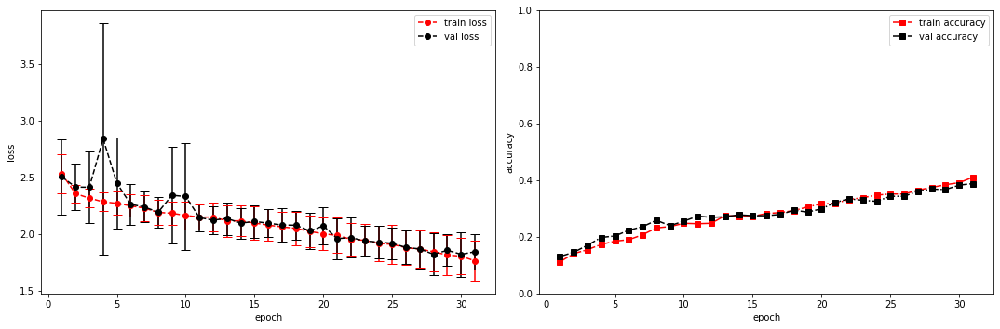

model saved


training epoch:  31
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [32/100], step [1/168],  Loss: 1.4720 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5462801456451416s
Epoch [32/100], step [17/168],  Loss: 1.6969 +/- 0.1782,  accuracy: 0.44140625, time elapsed = 6.2383198738098145s
Epoch [32/100], step [33/168],  Loss: 1.7319 +/- 0.1122,  accuracy: 0.42578125, time elapsed = 6.237888336181641s
Epoch [32/100], step [49/168],  Loss: 1.7675 +/- 0.1452,  accuracy: 0.400390625, time elapsed = 6.239272356033325s
Epoch [32/100], step [65/168],  Loss: 1.7437 +/- 0.1433,  accuracy: 0.4140625, time elapsed = 6.238681316375732s
Epoch [32/100], step [81/168],  Loss: 1.7899 +/- 0.1025,  accuracy: 0.384765625, time elapsed = 6.238004446029663s
Epoch [32/100], step [97/168],  Loss: 1.7518 +/- 0.1829,  accuracy: 0.421875, time elapsed = 6.236788034439087s
Epoch [32/100], step [113/168],  Loss: 1.7621 +/- 0.1479,  accuracy: 0.412109375, time elapsed = 6.236221075057983s
Epoch [32/100], step [129/168],  Loss: 1.7525 +/- 0.1835,  accuracy: 0.400390625, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.407,  precision = 0.407 recall = 0.407 f1 = 0.407 ::: val: acc = 0.377,  precision = 0.377 recall = 0.377 time elapsed = 70.51030945777893s


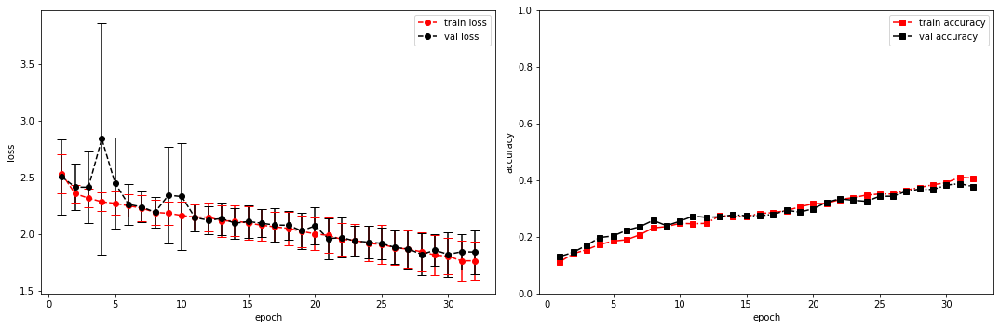

model saved


training epoch:  32
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [33/100], step [1/168],  Loss: 2.1257 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5433955192565918s
Epoch [33/100], step [17/168],  Loss: 1.7098 +/- 0.1613,  accuracy: 0.419921875, time elapsed = 6.2370734214782715s
Epoch [33/100], step [33/168],  Loss: 1.7585 +/- 0.1870,  accuracy: 0.412109375, time elapsed = 6.238554954528809s
Epoch [33/100], step [49/168],  Loss: 1.7894 +/- 0.1813,  accuracy: 0.38671875, time elapsed = 6.238121747970581s
Epoch [33/100], step [65/168],  Loss: 1.6405 +/- 0.1749,  accuracy: 0.458984375, time elapsed = 6.239427328109741s
Epoch [33/100], step [81/168],  Loss: 1.7322 +/- 0.1656,  accuracy: 0.416015625, time elapsed = 6.23916220664978s
Epoch [33/100], step [97/168],  Loss: 1.7949 +/- 0.1554,  accuracy: 0.37890625, time elapsed = 6.240111351013184s
Epoch [33/100], step [113/168],  Loss: 1.8006 +/- 0.1915,  accuracy: 0.380859375, time elapsed = 6.238649845123291s
Epoch [33/100], step [129/168],  Loss: 1.7998 +/- 0.2034,  accuracy: 0.36328125, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.408,  precision = 0.408 recall = 0.408 f1 = 0.408 ::: val: acc = 0.378,  precision = 0.378 recall = 0.378 time elapsed = 70.50186276435852s


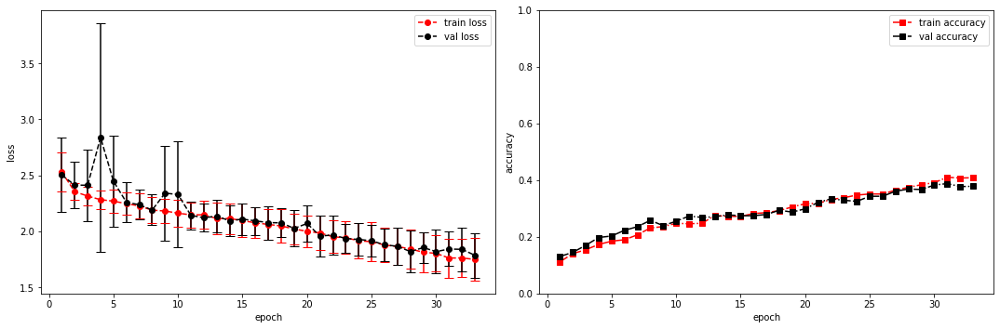

model saved


training epoch:  33
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [34/100], step [1/168],  Loss: 1.7443 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5353975296020508s
Epoch [34/100], step [17/168],  Loss: 1.7049 +/- 0.1524,  accuracy: 0.4140625, time elapsed = 6.237539291381836s
Epoch [34/100], step [33/168],  Loss: 1.7804 +/- 0.1849,  accuracy: 0.408203125, time elapsed = 6.237847805023193s
Epoch [34/100], step [49/168],  Loss: 1.7095 +/- 0.1418,  accuracy: 0.447265625, time elapsed = 6.237989664077759s
Epoch [34/100], step [65/168],  Loss: 1.6308 +/- 0.1503,  accuracy: 0.447265625, time elapsed = 6.239057302474976s
Epoch [34/100], step [81/168],  Loss: 1.6836 +/- 0.1462,  accuracy: 0.439453125, time elapsed = 6.237976551055908s
Epoch [34/100], step [97/168],  Loss: 1.8009 +/- 0.2647,  accuracy: 0.38671875, time elapsed = 6.252305269241333s
Epoch [34/100], step [113/168],  Loss: 1.7499 +/- 0.1571,  accuracy: 0.400390625, time elapsed = 6.240257740020752s
Epoch [34/100], step [129/168],  Loss: 1.8637 +/- 0.1976,  accuracy: 0.376953125, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.414,  precision = 0.414 recall = 0.414 f1 = 0.414 ::: val: acc = 0.405,  precision = 0.405 recall = 0.405 time elapsed = 70.51072287559509s


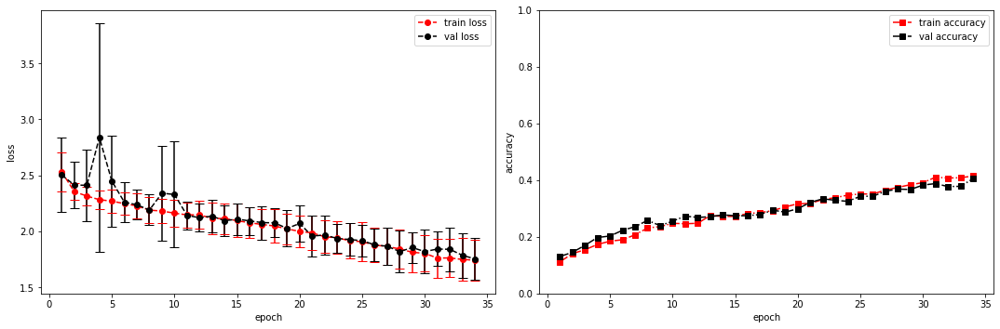

model saved


training epoch:  34
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [35/100], step [1/168],  Loss: 1.5549 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5385777950286865s
Epoch [35/100], step [17/168],  Loss: 1.6569 +/- 0.2017,  accuracy: 0.4609375, time elapsed = 6.239831924438477s
Epoch [35/100], step [33/168],  Loss: 1.7262 +/- 0.1512,  accuracy: 0.416015625, time elapsed = 6.239914655685425s
Epoch [35/100], step [49/168],  Loss: 1.5928 +/- 0.1476,  accuracy: 0.482421875, time elapsed = 6.239468336105347s
Epoch [35/100], step [65/168],  Loss: 1.6756 +/- 0.1907,  accuracy: 0.44140625, time elapsed = 6.241888999938965s
Epoch [35/100], step [81/168],  Loss: 1.8139 +/- 0.2203,  accuracy: 0.400390625, time elapsed = 6.240674018859863s
Epoch [35/100], step [97/168],  Loss: 1.6635 +/- 0.1506,  accuracy: 0.4453125, time elapsed = 6.239365339279175s
Epoch [35/100], step [113/168],  Loss: 1.6948 +/- 0.2238,  accuracy: 0.423828125, time elapsed = 6.2399022579193115s
Epoch [35/100], step [129/168],  Loss: 1.7211 +/- 0.1692,  accuracy: 0.4296875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.441,  precision = 0.441 recall = 0.441 f1 = 0.441 ::: val: acc = 0.394,  precision = 0.394 recall = 0.394 time elapsed = 70.51018404960632s


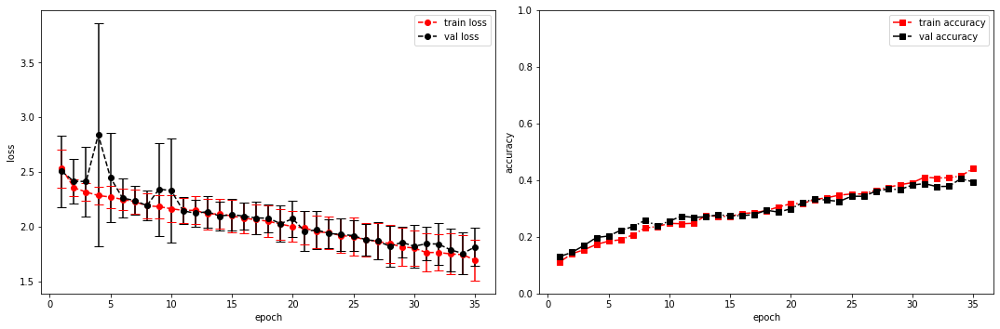

model saved


training epoch:  35
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [36/100], step [1/168],  Loss: 1.6991 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5425877571105957s
Epoch [36/100], step [17/168],  Loss: 1.6748 +/- 0.1926,  accuracy: 0.458984375, time elapsed = 6.235801458358765s
Epoch [36/100], step [33/168],  Loss: 1.6902 +/- 0.1512,  accuracy: 0.419921875, time elapsed = 6.23833441734314s
Epoch [36/100], step [49/168],  Loss: 1.7120 +/- 0.1361,  accuracy: 0.44921875, time elapsed = 6.24535059928894s
Epoch [36/100], step [65/168],  Loss: 1.6988 +/- 0.1970,  accuracy: 0.44921875, time elapsed = 6.239555835723877s
Epoch [36/100], step [81/168],  Loss: 1.6557 +/- 0.1922,  accuracy: 0.4296875, time elapsed = 6.239076137542725s
Epoch [36/100], step [97/168],  Loss: 1.7097 +/- 0.1389,  accuracy: 0.423828125, time elapsed = 6.239916801452637s
Epoch [36/100], step [113/168],  Loss: 1.7217 +/- 0.2085,  accuracy: 0.447265625, time elapsed = 6.237911224365234s
Epoch [36/100], step [129/168],  Loss: 1.7540 +/- 0.1708,  accuracy: 0.404296875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.433,  precision = 0.433 recall = 0.433 f1 = 0.433 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.523264169693s


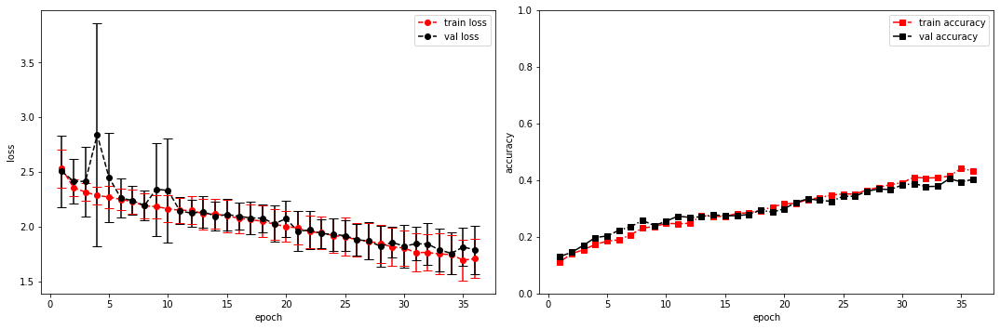

model saved


training epoch:  36
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [37/100], step [1/168],  Loss: 2.0416 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5443346500396729s
Epoch [37/100], step [17/168],  Loss: 1.6406 +/- 0.1440,  accuracy: 0.44140625, time elapsed = 6.239330291748047s
Epoch [37/100], step [33/168],  Loss: 1.6592 +/- 0.0869,  accuracy: 0.453125, time elapsed = 6.23882532119751s
Epoch [37/100], step [49/168],  Loss: 1.7006 +/- 0.1298,  accuracy: 0.412109375, time elapsed = 6.2402565479278564s
Epoch [37/100], step [65/168],  Loss: 1.7808 +/- 0.1582,  accuracy: 0.3984375, time elapsed = 6.239461660385132s
Epoch [37/100], step [81/168],  Loss: 1.6077 +/- 0.1750,  accuracy: 0.478515625, time elapsed = 6.239855766296387s
Epoch [37/100], step [97/168],  Loss: 1.7584 +/- 0.1587,  accuracy: 0.40234375, time elapsed = 6.240368366241455s
Epoch [37/100], step [113/168],  Loss: 1.6912 +/- 0.1926,  accuracy: 0.443359375, time elapsed = 6.239396572113037s
Epoch [37/100], step [129/168],  Loss: 1.6594 +/- 0.1589,  accuracy: 0.455078125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.438,  precision = 0.438 recall = 0.438 f1 = 0.438 ::: val: acc = 0.391,  precision = 0.391 recall = 0.391 time elapsed = 70.54488706588745s


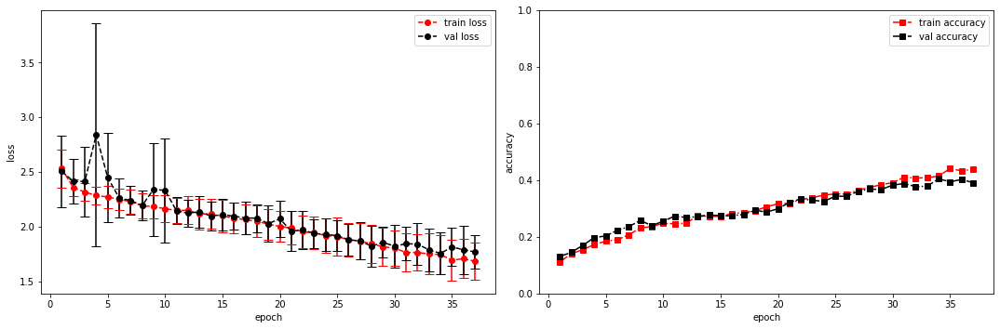

model saved


training epoch:  37
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [38/100], step [1/168],  Loss: 1.7134 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5435376167297363s
Epoch [38/100], step [17/168],  Loss: 1.6826 +/- 0.2298,  accuracy: 0.482421875, time elapsed = 6.238750457763672s
Epoch [38/100], step [33/168],  Loss: 1.6701 +/- 0.1931,  accuracy: 0.451171875, time elapsed = 6.238880157470703s
Epoch [38/100], step [49/168],  Loss: 1.6300 +/- 0.1901,  accuracy: 0.455078125, time elapsed = 6.237772226333618s
Epoch [38/100], step [65/168],  Loss: 1.6179 +/- 0.1659,  accuracy: 0.4765625, time elapsed = 6.2384960651397705s
Epoch [38/100], step [81/168],  Loss: 1.6885 +/- 0.2062,  accuracy: 0.443359375, time elapsed = 6.238360404968262s
Epoch [38/100], step [97/168],  Loss: 1.7428 +/- 0.2273,  accuracy: 0.443359375, time elapsed = 6.238753318786621s
Epoch [38/100], step [113/168],  Loss: 1.7611 +/- 0.1930,  accuracy: 0.421875, time elapsed = 6.238635063171387s
Epoch [38/100], step [129/168],  Loss: 1.6580 +/- 0.1751,  accuracy: 0.45703125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.446,  precision = 0.446 recall = 0.446 f1 = 0.446 ::: val: acc = 0.393,  precision = 0.393 recall = 0.393 time elapsed = 70.50525307655334s


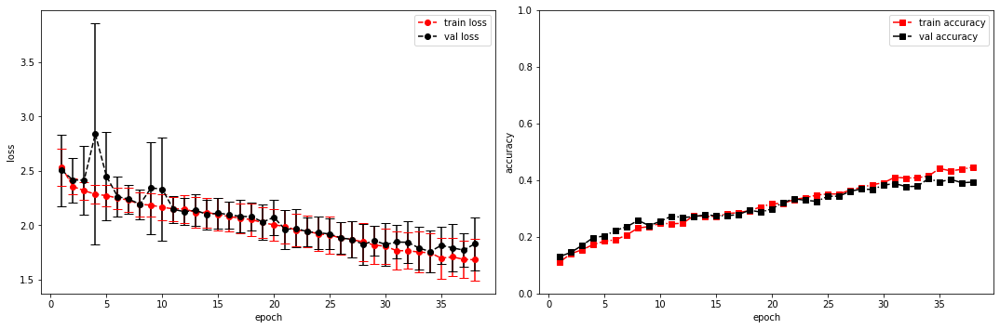

model saved


training epoch:  38
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [39/100], step [1/168],  Loss: 1.6407 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5456526279449463s
Epoch [39/100], step [17/168],  Loss: 1.6197 +/- 0.1625,  accuracy: 0.48828125, time elapsed = 6.239002227783203s
Epoch [39/100], step [33/168],  Loss: 1.7013 +/- 0.1917,  accuracy: 0.41015625, time elapsed = 6.238860130310059s
Epoch [39/100], step [49/168],  Loss: 1.7248 +/- 0.1899,  accuracy: 0.42578125, time elapsed = 6.238811254501343s
Epoch [39/100], step [65/168],  Loss: 1.6224 +/- 0.1462,  accuracy: 0.447265625, time elapsed = 6.237830877304077s
Epoch [39/100], step [81/168],  Loss: 1.6583 +/- 0.1718,  accuracy: 0.451171875, time elapsed = 6.23926854133606s
Epoch [39/100], step [97/168],  Loss: 1.6642 +/- 0.0926,  accuracy: 0.4375, time elapsed = 6.239288091659546s
Epoch [39/100], step [113/168],  Loss: 1.6971 +/- 0.1939,  accuracy: 0.43359375, time elapsed = 6.244307041168213s
Epoch [39/100], step [129/168],  Loss: 1.7070 +/- 0.1743,  accuracy: 0.3984375, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.436,  precision = 0.436 recall = 0.436 f1 = 0.436 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.52288699150085s


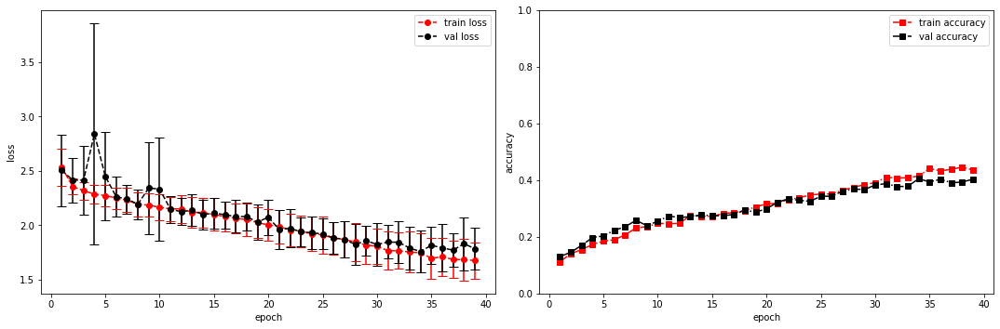

model saved


training epoch:  39
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [40/100], step [1/168],  Loss: 1.4681 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5440664291381836s
Epoch [40/100], step [17/168],  Loss: 1.7085 +/- 0.1937,  accuracy: 0.423828125, time elapsed = 6.238648176193237s
Epoch [40/100], step [33/168],  Loss: 1.5561 +/- 0.1710,  accuracy: 0.462890625, time elapsed = 6.2389140129089355s
Epoch [40/100], step [49/168],  Loss: 1.6039 +/- 0.1989,  accuracy: 0.453125, time elapsed = 6.239305019378662s
Epoch [40/100], step [65/168],  Loss: 1.6621 +/- 0.1556,  accuracy: 0.44921875, time elapsed = 6.237502574920654s
Epoch [40/100], step [81/168],  Loss: 1.6839 +/- 0.2123,  accuracy: 0.435546875, time elapsed = 6.24012565612793s
Epoch [40/100], step [97/168],  Loss: 1.6281 +/- 0.1523,  accuracy: 0.470703125, time elapsed = 6.238611936569214s
Epoch [40/100], step [113/168],  Loss: 1.6277 +/- 0.1933,  accuracy: 0.455078125, time elapsed = 6.239486455917358s
Epoch [40/100], step [129/168],  Loss: 1.5768 +/- 0.1189,  accuracy: 0.462890625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.449,  precision = 0.449 recall = 0.449 f1 = 0.449 ::: val: acc = 0.438,  precision = 0.438 recall = 0.438 time elapsed = 70.51293516159058s


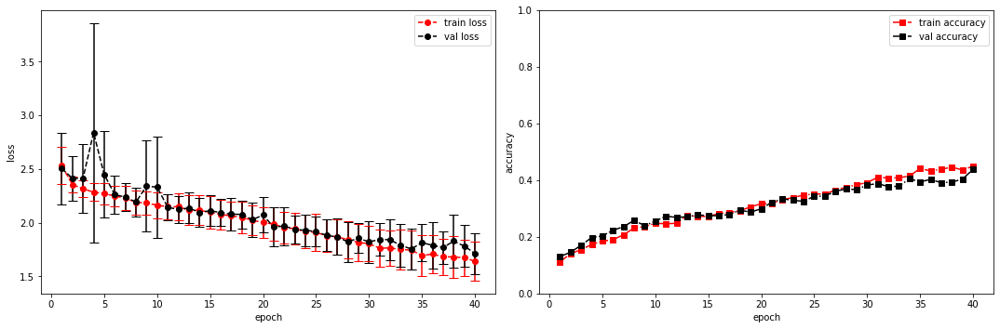

model saved


training epoch:  40
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [41/100], step [1/168],  Loss: 1.6085 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5380606651306152s
Epoch [41/100], step [17/168],  Loss: 1.5748 +/- 0.1783,  accuracy: 0.46484375, time elapsed = 6.238575458526611s
Epoch [41/100], step [33/168],  Loss: 1.5984 +/- 0.1830,  accuracy: 0.474609375, time elapsed = 6.238155364990234s
Epoch [41/100], step [49/168],  Loss: 1.4818 +/- 0.1400,  accuracy: 0.525390625, time elapsed = 6.243445158004761s
Epoch [41/100], step [65/168],  Loss: 1.5525 +/- 0.1571,  accuracy: 0.4921875, time elapsed = 6.248684644699097s
Epoch [41/100], step [81/168],  Loss: 1.6655 +/- 0.2116,  accuracy: 0.443359375, time elapsed = 6.239510774612427s
Epoch [41/100], step [97/168],  Loss: 1.6294 +/- 0.1926,  accuracy: 0.45703125, time elapsed = 6.239473104476929s
Epoch [41/100], step [113/168],  Loss: 1.6694 +/- 0.1641,  accuracy: 0.458984375, time elapsed = 6.239158391952515s
Epoch [41/100], step [129/168],  Loss: 1.6420 +/- 0.1717,  accuracy: 0.44140625, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.463,  precision = 0.463 recall = 0.463 f1 = 0.463 ::: val: acc = 0.418,  precision = 0.418 recall = 0.418 time elapsed = 70.53870296478271s


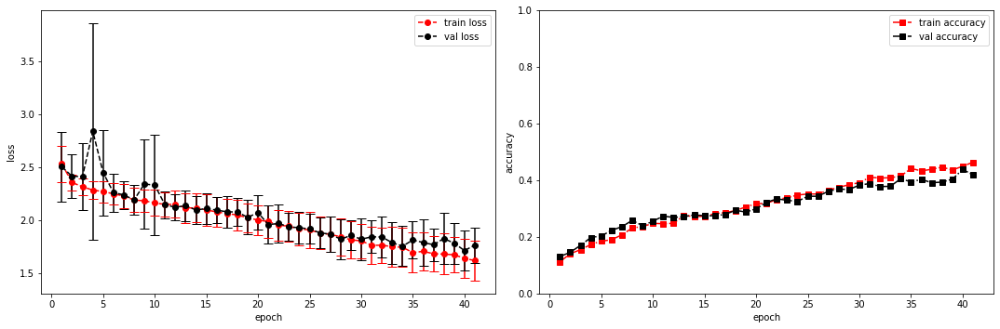

model saved


training epoch:  41
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [42/100], step [1/168],  Loss: 1.7349 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5435371398925781s
Epoch [42/100], step [17/168],  Loss: 1.5345 +/- 0.1698,  accuracy: 0.48046875, time elapsed = 6.239820241928101s
Epoch [42/100], step [33/168],  Loss: 1.6374 +/- 0.2066,  accuracy: 0.462890625, time elapsed = 6.23999285697937s
Epoch [42/100], step [49/168],  Loss: 1.6368 +/- 0.2000,  accuracy: 0.453125, time elapsed = 6.2396485805511475s
Epoch [42/100], step [65/168],  Loss: 1.5366 +/- 0.1791,  accuracy: 0.513671875, time elapsed = 6.239613771438599s
Epoch [42/100], step [81/168],  Loss: 1.6162 +/- 0.2318,  accuracy: 0.466796875, time elapsed = 6.238769054412842s
Epoch [42/100], step [97/168],  Loss: 1.5509 +/- 0.1938,  accuracy: 0.501953125, time elapsed = 6.239912509918213s
Epoch [42/100], step [113/168],  Loss: 1.5715 +/- 0.1897,  accuracy: 0.505859375, time elapsed = 6.238601207733154s
Epoch [42/100], step [129/168],  Loss: 1.6914 +/- 0.1646,  accuracy: 0.431640625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.474,  precision = 0.474 recall = 0.474 f1 = 0.474 ::: val: acc = 0.399,  precision = 0.399 recall = 0.399 time elapsed = 70.5228533744812s


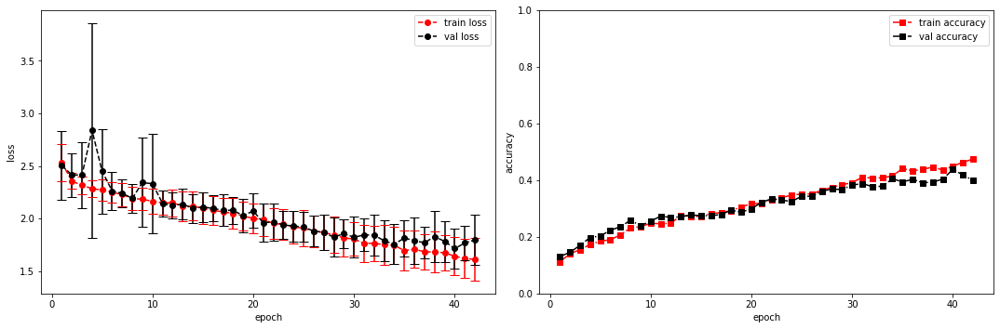

model saved


training epoch:  42
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [43/100], step [1/168],  Loss: 1.9023 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5347466468811035s
Epoch [43/100], step [17/168],  Loss: 1.6071 +/- 0.1285,  accuracy: 0.453125, time elapsed = 6.236804962158203s
Epoch [43/100], step [33/168],  Loss: 1.6284 +/- 0.2182,  accuracy: 0.435546875, time elapsed = 6.236161470413208s
Epoch [43/100], step [49/168],  Loss: 1.7403 +/- 0.1697,  accuracy: 0.41796875, time elapsed = 6.237142086029053s
Epoch [43/100], step [65/168],  Loss: 1.6115 +/- 0.1575,  accuracy: 0.486328125, time elapsed = 6.236680030822754s
Epoch [43/100], step [81/168],  Loss: 1.5819 +/- 0.1902,  accuracy: 0.4921875, time elapsed = 6.2376179695129395s
Epoch [43/100], step [97/168],  Loss: 1.6690 +/- 0.2177,  accuracy: 0.4375, time elapsed = 6.2365570068359375s
Epoch [43/100], step [113/168],  Loss: 1.6229 +/- 0.1561,  accuracy: 0.4609375, time elapsed = 6.237595796585083s
Epoch [43/100], step [129/168],  Loss: 1.7447 +/- 0.2211,  accuracy: 0.4296875, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.450,  precision = 0.450 recall = 0.450 f1 = 0.450 ::: val: acc = 0.424,  precision = 0.424 recall = 0.424 time elapsed = 70.48417615890503s


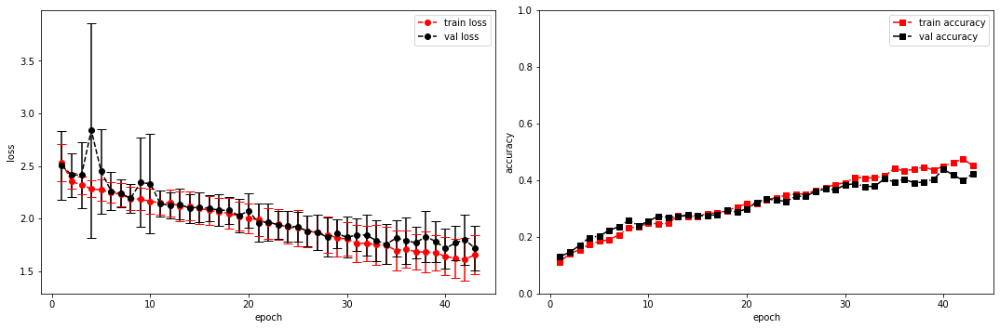

model saved


training epoch:  43
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [44/100], step [1/168],  Loss: 1.4801 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5923888683319092s
Epoch [44/100], step [17/168],  Loss: 1.5460 +/- 0.1808,  accuracy: 0.46484375, time elapsed = 6.2383551597595215s
Epoch [44/100], step [33/168],  Loss: 1.5241 +/- 0.1575,  accuracy: 0.498046875, time elapsed = 6.239882707595825s
Epoch [44/100], step [49/168],  Loss: 1.6229 +/- 0.1344,  accuracy: 0.4609375, time elapsed = 6.239580869674683s
Epoch [44/100], step [65/168],  Loss: 1.6614 +/- 0.2251,  accuracy: 0.458984375, time elapsed = 6.237550973892212s
Epoch [44/100], step [81/168],  Loss: 1.6021 +/- 0.2260,  accuracy: 0.484375, time elapsed = 6.238677263259888s
Epoch [44/100], step [97/168],  Loss: 1.6408 +/- 0.1841,  accuracy: 0.46875, time elapsed = 6.237954616546631s
Epoch [44/100], step [113/168],  Loss: 1.5722 +/- 0.1831,  accuracy: 0.48046875, time elapsed = 6.239343643188477s
Epoch [44/100], step [129/168],  Loss: 1.5925 +/- 0.1565,  accuracy: 0.47265625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.471,  precision = 0.471 recall = 0.471 f1 = 0.471 ::: val: acc = 0.431,  precision = 0.431 recall = 0.431 time elapsed = 70.58262729644775s


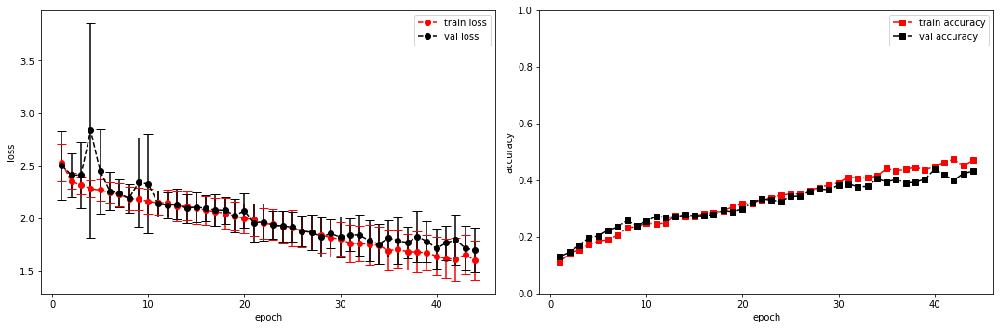

model saved


training epoch:  44
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [45/100], step [1/168],  Loss: 1.5716 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5406384468078613s
Epoch [45/100], step [17/168],  Loss: 1.5975 +/- 0.2286,  accuracy: 0.478515625, time elapsed = 6.239842891693115s
Epoch [45/100], step [33/168],  Loss: 1.6434 +/- 0.1967,  accuracy: 0.4453125, time elapsed = 6.240582227706909s
Epoch [45/100], step [49/168],  Loss: 1.5338 +/- 0.1383,  accuracy: 0.474609375, time elapsed = 6.240011930465698s
Epoch [45/100], step [65/168],  Loss: 1.4869 +/- 0.1904,  accuracy: 0.515625, time elapsed = 6.23989462852478s
Epoch [45/100], step [81/168],  Loss: 1.6065 +/- 0.1938,  accuracy: 0.46875, time elapsed = 6.239669322967529s
Epoch [45/100], step [97/168],  Loss: 1.5188 +/- 0.1411,  accuracy: 0.494140625, time elapsed = 6.2414796352386475s
Epoch [45/100], step [113/168],  Loss: 1.5034 +/- 0.1872,  accuracy: 0.490234375, time elapsed = 6.239084005355835s
Epoch [45/100], step [129/168],  Loss: 1.5627 +/- 0.2582,  accuracy: 0.513671875, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.471,  precision = 0.471 recall = 0.471 f1 = 0.471 ::: val: acc = 0.420,  precision = 0.420 recall = 0.420 time elapsed = 70.52417850494385s


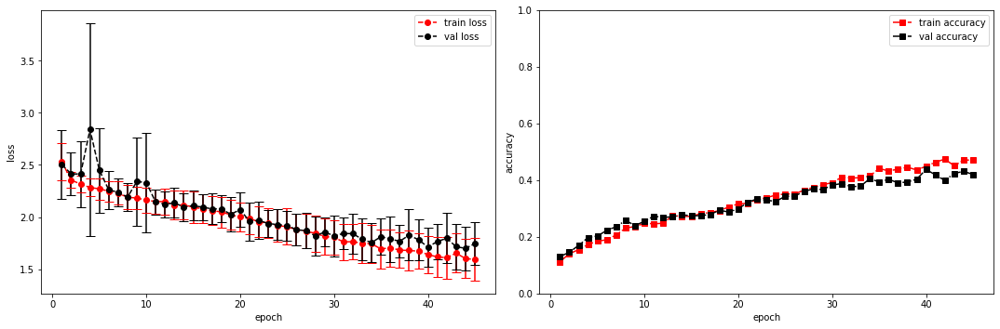

model saved


training epoch:  45
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [46/100], step [1/168],  Loss: 1.6303 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5346527099609375s
Epoch [46/100], step [17/168],  Loss: 1.5435 +/- 0.1955,  accuracy: 0.490234375, time elapsed = 6.2388529777526855s
Epoch [46/100], step [33/168],  Loss: 1.6381 +/- 0.1468,  accuracy: 0.453125, time elapsed = 6.238705396652222s
Epoch [46/100], step [49/168],  Loss: 1.6227 +/- 0.1598,  accuracy: 0.470703125, time elapsed = 6.238833665847778s
Epoch [46/100], step [65/168],  Loss: 1.4824 +/- 0.1845,  accuracy: 0.513671875, time elapsed = 6.248758554458618s
Epoch [46/100], step [81/168],  Loss: 1.6571 +/- 0.2375,  accuracy: 0.466796875, time elapsed = 6.2405922412872314s
Epoch [46/100], step [97/168],  Loss: 1.5507 +/- 0.1634,  accuracy: 0.494140625, time elapsed = 6.239805698394775s
Epoch [46/100], step [113/168],  Loss: 1.5954 +/- 0.1930,  accuracy: 0.46875, time elapsed = 6.239098072052002s
Epoch [46/100], step [129/168],  Loss: 1.5579 +/- 0.1341,  accuracy: 0.466796875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.475,  precision = 0.475 recall = 0.475 f1 = 0.475 ::: val: acc = 0.406,  precision = 0.406 recall = 0.406 time elapsed = 70.52233600616455s


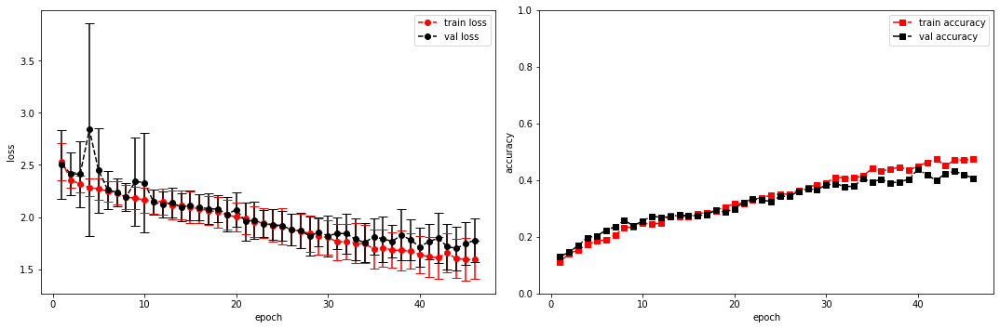

model saved


training epoch:  46
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [47/100], step [1/168],  Loss: 1.6469 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5316905975341797s
Epoch [47/100], step [17/168],  Loss: 1.5459 +/- 0.1847,  accuracy: 0.48046875, time elapsed = 6.240357398986816s
Epoch [47/100], step [33/168],  Loss: 1.5170 +/- 0.1906,  accuracy: 0.51171875, time elapsed = 6.242279291152954s
Epoch [47/100], step [49/168],  Loss: 1.5386 +/- 0.1941,  accuracy: 0.484375, time elapsed = 6.23934531211853s
Epoch [47/100], step [65/168],  Loss: 1.6113 +/- 0.1674,  accuracy: 0.470703125, time elapsed = 6.239781141281128s
Epoch [47/100], step [81/168],  Loss: 1.5748 +/- 0.1639,  accuracy: 0.48046875, time elapsed = 6.238924503326416s
Epoch [47/100], step [97/168],  Loss: 1.5121 +/- 0.1797,  accuracy: 0.474609375, time elapsed = 6.2387049198150635s
Epoch [47/100], step [113/168],  Loss: 1.6848 +/- 0.1985,  accuracy: 0.439453125, time elapsed = 6.240077972412109s
Epoch [47/100], step [129/168],  Loss: 1.6024 +/- 0.1945,  accuracy: 0.482421875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.478,  precision = 0.478 recall = 0.478 f1 = 0.478 ::: val: acc = 0.449,  precision = 0.449 recall = 0.449 time elapsed = 70.50488829612732s


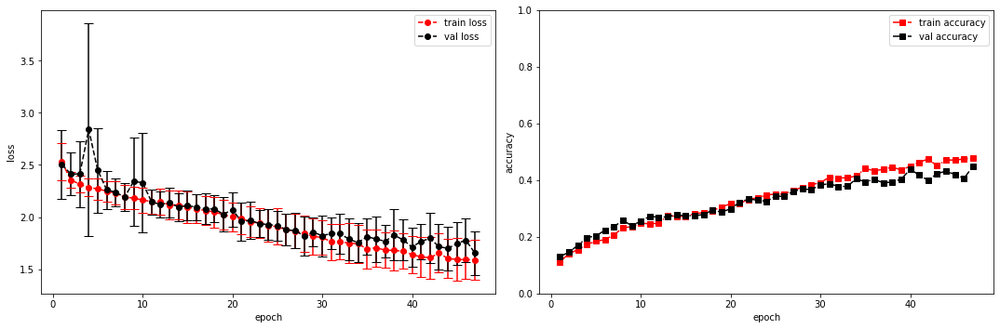

model saved


training epoch:  47
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [48/100], step [1/168],  Loss: 1.4370 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.539684534072876s
Epoch [48/100], step [17/168],  Loss: 1.4751 +/- 0.1744,  accuracy: 0.513671875, time elapsed = 6.250166654586792s
Epoch [48/100], step [33/168],  Loss: 1.5215 +/- 0.2030,  accuracy: 0.48828125, time elapsed = 6.239258289337158s
Epoch [48/100], step [49/168],  Loss: 1.5089 +/- 0.2178,  accuracy: 0.5078125, time elapsed = 6.239690542221069s
Epoch [48/100], step [65/168],  Loss: 1.5388 +/- 0.2200,  accuracy: 0.46875, time elapsed = 6.23895525932312s
Epoch [48/100], step [81/168],  Loss: 1.5741 +/- 0.1957,  accuracy: 0.494140625, time elapsed = 6.2389280796051025s
Epoch [48/100], step [97/168],  Loss: 1.6131 +/- 0.1679,  accuracy: 0.48046875, time elapsed = 6.238879203796387s
Epoch [48/100], step [113/168],  Loss: 1.5475 +/- 0.1618,  accuracy: 0.498046875, time elapsed = 6.238752841949463s
Epoch [48/100], step [129/168],  Loss: 1.5766 +/- 0.2306,  accuracy: 0.494140625, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.490,  precision = 0.490 recall = 0.490 f1 = 0.490 ::: val: acc = 0.396,  precision = 0.396 recall = 0.396 time elapsed = 70.52378964424133s


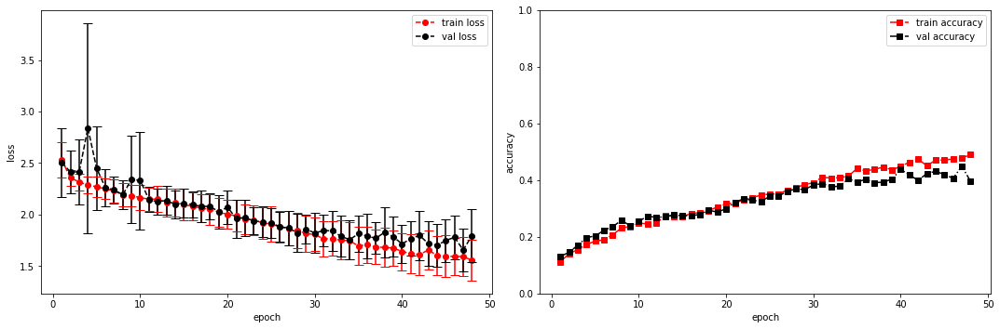

model saved


training epoch:  48
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [49/100], step [1/168],  Loss: 1.4356 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5342838764190674s
Epoch [49/100], step [17/168],  Loss: 1.3626 +/- 0.1497,  accuracy: 0.556640625, time elapsed = 6.241054058074951s
Epoch [49/100], step [33/168],  Loss: 1.5897 +/- 0.1532,  accuracy: 0.474609375, time elapsed = 6.240796089172363s
Epoch [49/100], step [49/168],  Loss: 1.5621 +/- 0.1433,  accuracy: 0.46875, time elapsed = 6.239252090454102s
Epoch [49/100], step [65/168],  Loss: 1.5317 +/- 0.1532,  accuracy: 0.498046875, time elapsed = 6.240289688110352s
Epoch [49/100], step [81/168],  Loss: 1.5646 +/- 0.2238,  accuracy: 0.498046875, time elapsed = 6.240921497344971s
Epoch [49/100], step [97/168],  Loss: 1.5565 +/- 0.2075,  accuracy: 0.48046875, time elapsed = 6.239614009857178s
Epoch [49/100], step [113/168],  Loss: 1.5358 +/- 0.1307,  accuracy: 0.5, time elapsed = 6.23970890045166s
Epoch [49/100], step [129/168],  Loss: 1.6316 +/- 0.1487,  accuracy: 0.458984375, time elapsed = 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.484,  precision = 0.484 recall = 0.484 f1 = 0.484 ::: val: acc = 0.459,  precision = 0.459 recall = 0.459 time elapsed = 70.53282928466797s


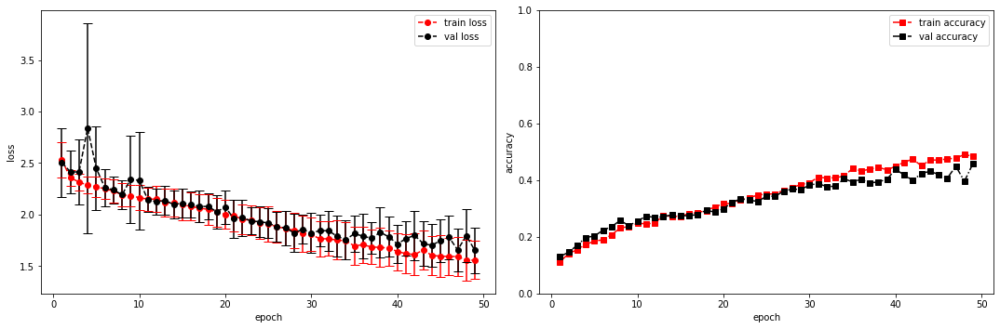

model saved


training epoch:  49
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [50/100], step [1/168],  Loss: 1.0666 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.548875093460083s
Epoch [50/100], step [17/168],  Loss: 1.5314 +/- 0.1820,  accuracy: 0.513671875, time elapsed = 6.2384257316589355s
Epoch [50/100], step [33/168],  Loss: 1.5301 +/- 0.1442,  accuracy: 0.4921875, time elapsed = 6.238163471221924s
Epoch [50/100], step [49/168],  Loss: 1.5231 +/- 0.2060,  accuracy: 0.48828125, time elapsed = 6.238573789596558s
Epoch [50/100], step [65/168],  Loss: 1.5908 +/- 0.1534,  accuracy: 0.48046875, time elapsed = 6.238662004470825s
Epoch [50/100], step [81/168],  Loss: 1.4984 +/- 0.1773,  accuracy: 0.521484375, time elapsed = 6.240774869918823s
Epoch [50/100], step [97/168],  Loss: 1.5170 +/- 0.1371,  accuracy: 0.5078125, time elapsed = 6.238910675048828s
Epoch [50/100], step [113/168],  Loss: 1.5315 +/- 0.2963,  accuracy: 0.50390625, time elapsed = 6.239949703216553s
Epoch [50/100], step [129/168],  Loss: 1.6171 +/- 0.2104,  accuracy: 0.455078125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.492,  precision = 0.492 recall = 0.492 f1 = 0.492 ::: val: acc = 0.453,  precision = 0.453 recall = 0.453 time elapsed = 70.53848886489868s


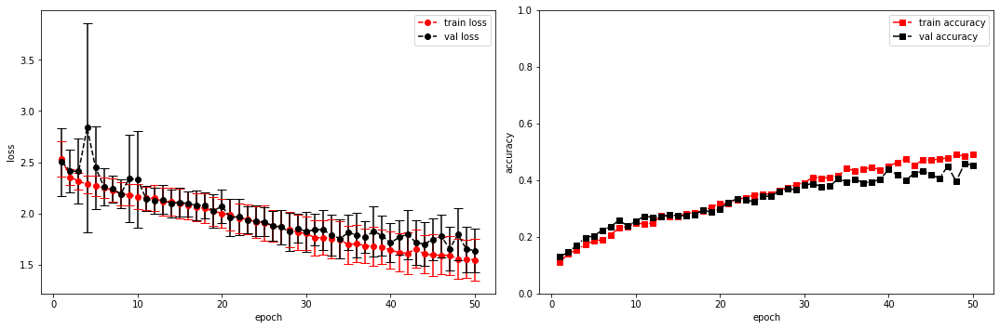

model saved


training epoch:  50
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [51/100], step [1/168],  Loss: 1.3373 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.534327507019043s
Epoch [51/100], step [17/168],  Loss: 1.5286 +/- 0.2213,  accuracy: 0.501953125, time elapsed = 6.24141526222229s
Epoch [51/100], step [33/168],  Loss: 1.4666 +/- 0.1656,  accuracy: 0.517578125, time elapsed = 6.241557836532593s
Epoch [51/100], step [49/168],  Loss: 1.6497 +/- 0.2406,  accuracy: 0.4375, time elapsed = 6.241592884063721s
Epoch [51/100], step [65/168],  Loss: 1.5563 +/- 0.2084,  accuracy: 0.505859375, time elapsed = 6.242274284362793s
Epoch [51/100], step [81/168],  Loss: 1.5702 +/- 0.1279,  accuracy: 0.455078125, time elapsed = 6.254280090332031s
Epoch [51/100], step [97/168],  Loss: 1.5966 +/- 0.2010,  accuracy: 0.494140625, time elapsed = 6.240106105804443s
Epoch [51/100], step [113/168],  Loss: 1.4236 +/- 0.1984,  accuracy: 0.54296875, time elapsed = 6.239283561706543s
Epoch [51/100], step [129/168],  Loss: 1.5603 +/- 0.2209,  accuracy: 0.486328125, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.490,  precision = 0.490 recall = 0.490 f1 = 0.490 ::: val: acc = 0.412,  precision = 0.412 recall = 0.412 time elapsed = 70.54019522666931s


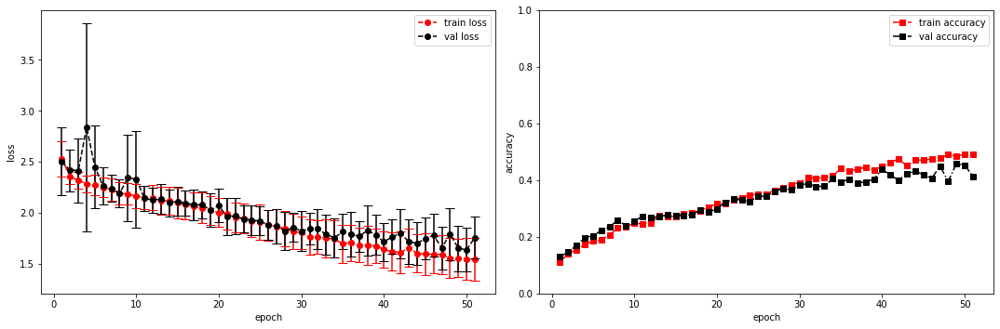

model saved


training epoch:  51
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [52/100], step [1/168],  Loss: 1.4118 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5443120002746582s
Epoch [52/100], step [17/168],  Loss: 1.5162 +/- 0.2029,  accuracy: 0.513671875, time elapsed = 6.238306760787964s
Epoch [52/100], step [33/168],  Loss: 1.4936 +/- 0.2169,  accuracy: 0.533203125, time elapsed = 6.239016532897949s
Epoch [52/100], step [49/168],  Loss: 1.4760 +/- 0.1051,  accuracy: 0.51953125, time elapsed = 6.239774465560913s
Epoch [52/100], step [65/168],  Loss: 1.5025 +/- 0.1556,  accuracy: 0.474609375, time elapsed = 6.2394020557403564s
Epoch [52/100], step [81/168],  Loss: 1.5413 +/- 0.1541,  accuracy: 0.5, time elapsed = 6.239389657974243s
Epoch [52/100], step [97/168],  Loss: 1.5939 +/- 0.1376,  accuracy: 0.447265625, time elapsed = 6.23918890953064s
Epoch [52/100], step [113/168],  Loss: 1.5196 +/- 0.1263,  accuracy: 0.494140625, time elapsed = 6.238313674926758s
Epoch [52/100], step [129/168],  Loss: 1.5209 +/- 0.1810,  accuracy: 0.49609375, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.500,  precision = 0.500 recall = 0.500 f1 = 0.500 ::: val: acc = 0.446,  precision = 0.446 recall = 0.446 time elapsed = 70.50999307632446s


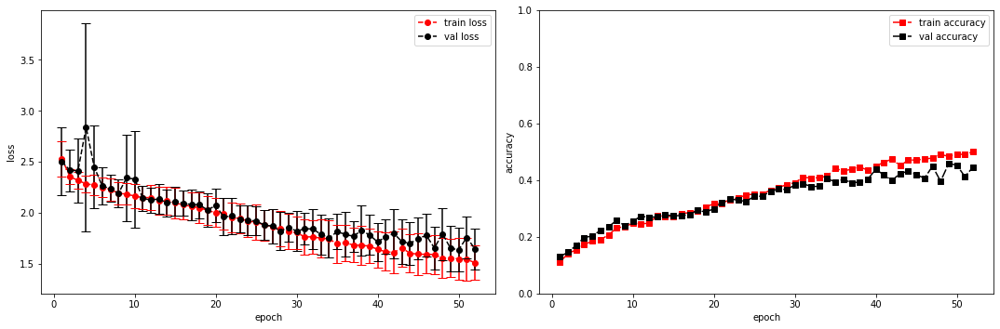

model saved


training epoch:  52
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [53/100], step [1/168],  Loss: 1.9016 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5361459255218506s
Epoch [53/100], step [17/168],  Loss: 1.4398 +/- 0.1802,  accuracy: 0.544921875, time elapsed = 6.243786096572876s
Epoch [53/100], step [33/168],  Loss: 1.4178 +/- 0.1888,  accuracy: 0.529296875, time elapsed = 6.244469404220581s
Epoch [53/100], step [49/168],  Loss: 1.5059 +/- 0.1906,  accuracy: 0.525390625, time elapsed = 6.239556789398193s
Epoch [53/100], step [65/168],  Loss: 1.4433 +/- 0.2227,  accuracy: 0.529296875, time elapsed = 6.241133213043213s
Epoch [53/100], step [81/168],  Loss: 1.5625 +/- 0.2220,  accuracy: 0.4765625, time elapsed = 6.239588022232056s
Epoch [53/100], step [97/168],  Loss: 1.5485 +/- 0.1955,  accuracy: 0.48828125, time elapsed = 6.237667083740234s
Epoch [53/100], step [113/168],  Loss: 1.4419 +/- 0.2078,  accuracy: 0.513671875, time elapsed = 6.23977518081665s
Epoch [53/100], step [129/168],  Loss: 1.4543 +/- 0.2106,  accuracy: 0.529296875, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.507,  precision = 0.507 recall = 0.507 f1 = 0.507 ::: val: acc = 0.438,  precision = 0.438 recall = 0.438 time elapsed = 70.51281309127808s


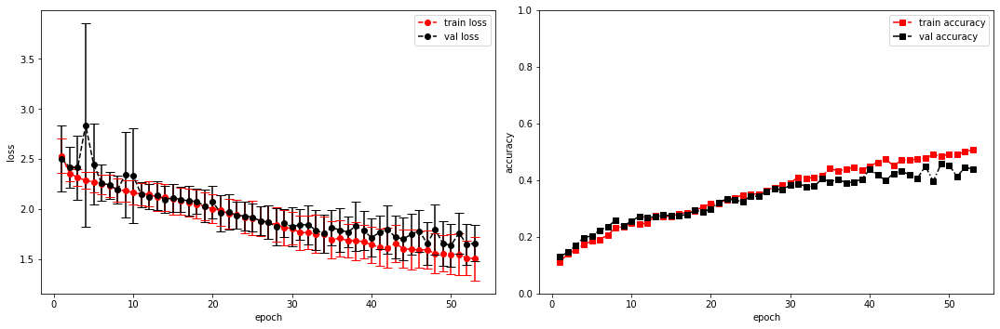

model saved


training epoch:  53
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [54/100], step [1/168],  Loss: 1.6194 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5300185680389404s
Epoch [54/100], step [17/168],  Loss: 1.4969 +/- 0.1587,  accuracy: 0.501953125, time elapsed = 6.237062931060791s
Epoch [54/100], step [33/168],  Loss: 1.5362 +/- 0.2029,  accuracy: 0.5, time elapsed = 6.240149021148682s
Epoch [54/100], step [49/168],  Loss: 1.5781 +/- 0.2569,  accuracy: 0.49609375, time elapsed = 6.2390525341033936s
Epoch [54/100], step [65/168],  Loss: 1.4848 +/- 0.2124,  accuracy: 0.509765625, time elapsed = 6.238804340362549s
Epoch [54/100], step [81/168],  Loss: 1.4555 +/- 0.1101,  accuracy: 0.533203125, time elapsed = 6.238800764083862s
Epoch [54/100], step [97/168],  Loss: 1.5427 +/- 0.1707,  accuracy: 0.4765625, time elapsed = 6.238983631134033s
Epoch [54/100], step [113/168],  Loss: 1.5428 +/- 0.1784,  accuracy: 0.470703125, time elapsed = 6.237913608551025s
Epoch [54/100], step [129/168],  Loss: 1.4963 +/- 0.2445,  accuracy: 0.5078125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.502,  precision = 0.502 recall = 0.502 f1 = 0.502 ::: val: acc = 0.456,  precision = 0.456 recall = 0.456 time elapsed = 70.53220987319946s


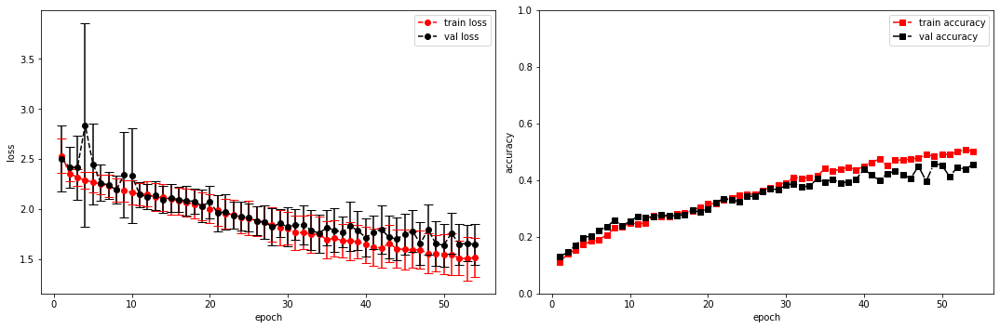

model saved


training epoch:  54
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [55/100], step [1/168],  Loss: 1.6857 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5464284420013428s
Epoch [55/100], step [17/168],  Loss: 1.4571 +/- 0.1534,  accuracy: 0.537109375, time elapsed = 6.240067720413208s
Epoch [55/100], step [33/168],  Loss: 1.4136 +/- 0.1550,  accuracy: 0.515625, time elapsed = 6.23997688293457s
Epoch [55/100], step [49/168],  Loss: 1.4565 +/- 0.1976,  accuracy: 0.509765625, time elapsed = 6.23976731300354s
Epoch [55/100], step [65/168],  Loss: 1.5196 +/- 0.1782,  accuracy: 0.486328125, time elapsed = 6.240746021270752s
Epoch [55/100], step [81/168],  Loss: 1.5477 +/- 0.1931,  accuracy: 0.474609375, time elapsed = 6.240249872207642s
Epoch [55/100], step [97/168],  Loss: 1.6323 +/- 0.2125,  accuracy: 0.45703125, time elapsed = 6.240305423736572s
Epoch [55/100], step [113/168],  Loss: 1.5326 +/- 0.2092,  accuracy: 0.498046875, time elapsed = 6.243772506713867s
Epoch [55/100], step [129/168],  Loss: 1.5570 +/- 0.1783,  accuracy: 0.498046875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.497,  precision = 0.497 recall = 0.497 f1 = 0.497 ::: val: acc = 0.422,  precision = 0.422 recall = 0.422 time elapsed = 70.52831721305847s


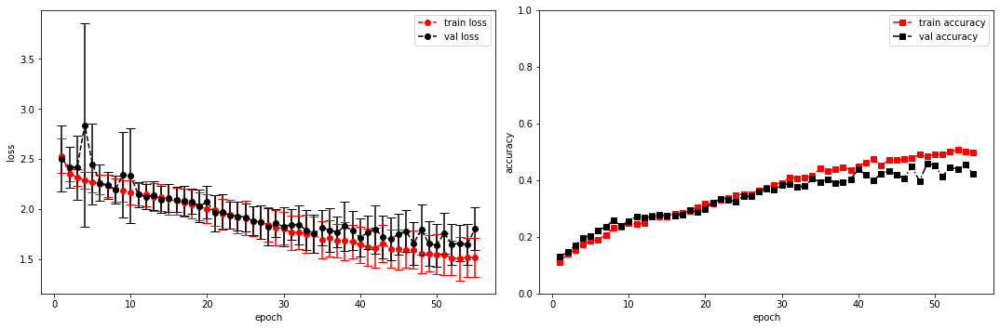

model saved


training epoch:  55
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [56/100], step [1/168],  Loss: 1.1419 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5357000827789307s
Epoch [56/100], step [17/168],  Loss: 1.6007 +/- 0.2185,  accuracy: 0.470703125, time elapsed = 6.239429712295532s
Epoch [56/100], step [33/168],  Loss: 1.4534 +/- 0.1603,  accuracy: 0.537109375, time elapsed = 6.23907470703125s
Epoch [56/100], step [49/168],  Loss: 1.4484 +/- 0.1540,  accuracy: 0.521484375, time elapsed = 6.238956451416016s
Epoch [56/100], step [65/168],  Loss: 1.4805 +/- 0.1438,  accuracy: 0.5078125, time elapsed = 6.238192081451416s
Epoch [56/100], step [81/168],  Loss: 1.5231 +/- 0.2301,  accuracy: 0.505859375, time elapsed = 6.2396838665008545s
Epoch [56/100], step [97/168],  Loss: 1.5681 +/- 0.2025,  accuracy: 0.5, time elapsed = 6.251544952392578s
Epoch [56/100], step [113/168],  Loss: 1.4022 +/- 0.1477,  accuracy: 0.5390625, time elapsed = 6.240283250808716s
Epoch [56/100], step [129/168],  Loss: 1.4950 +/- 0.2169,  accuracy: 0.513671875, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.509,  precision = 0.509 recall = 0.509 f1 = 0.509 ::: val: acc = 0.446,  precision = 0.446 recall = 0.446 time elapsed = 70.52271819114685s


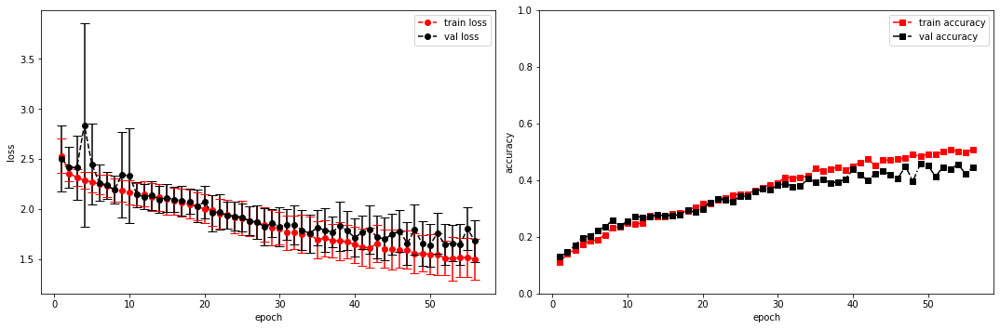

model saved


training epoch:  56
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [57/100], step [1/168],  Loss: 1.3494 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5519075393676758s
Epoch [57/100], step [17/168],  Loss: 1.4820 +/- 0.1490,  accuracy: 0.515625, time elapsed = 6.239392518997192s
Epoch [57/100], step [33/168],  Loss: 1.4987 +/- 0.1636,  accuracy: 0.5, time elapsed = 6.239253997802734s
Epoch [57/100], step [49/168],  Loss: 1.4540 +/- 0.1433,  accuracy: 0.517578125, time elapsed = 6.236039400100708s
Epoch [57/100], step [65/168],  Loss: 1.5178 +/- 0.1850,  accuracy: 0.521484375, time elapsed = 6.239100456237793s
Epoch [57/100], step [81/168],  Loss: 1.4995 +/- 0.1554,  accuracy: 0.51953125, time elapsed = 6.236891746520996s
Epoch [57/100], step [97/168],  Loss: 1.5062 +/- 0.2092,  accuracy: 0.478515625, time elapsed = 6.23601222038269s
Epoch [57/100], step [113/168],  Loss: 1.5668 +/- 0.1238,  accuracy: 0.458984375, time elapsed = 6.236551761627197s
Epoch [57/100], step [129/168],  Loss: 1.5027 +/- 0.2053,  accuracy: 0.490234375, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.505,  precision = 0.505 recall = 0.505 f1 = 0.505 ::: val: acc = 0.427,  precision = 0.427 recall = 0.427 time elapsed = 70.50209188461304s


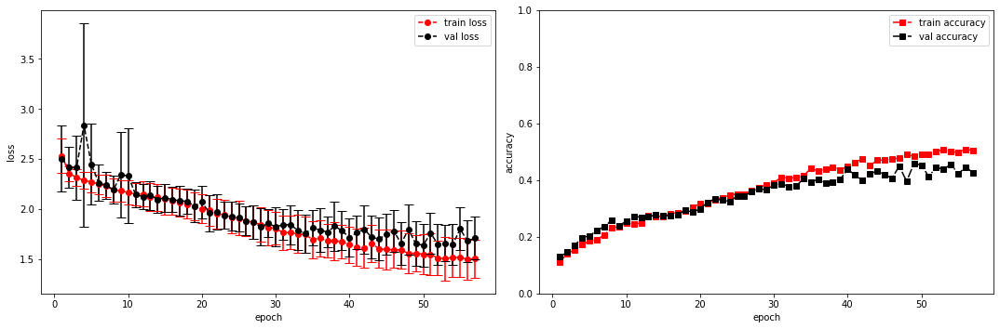

model saved


training epoch:  57
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [58/100], step [1/168],  Loss: 1.6858 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5422499179840088s
Epoch [58/100], step [17/168],  Loss: 1.3902 +/- 0.1627,  accuracy: 0.521484375, time elapsed = 6.2359185218811035s
Epoch [58/100], step [33/168],  Loss: 1.4944 +/- 0.2404,  accuracy: 0.533203125, time elapsed = 6.238641977310181s
Epoch [58/100], step [49/168],  Loss: 1.4420 +/- 0.1576,  accuracy: 0.51953125, time elapsed = 6.2496278285980225s
Epoch [58/100], step [65/168],  Loss: 1.5298 +/- 0.2336,  accuracy: 0.484375, time elapsed = 6.237783670425415s
Epoch [58/100], step [81/168],  Loss: 1.5237 +/- 0.2299,  accuracy: 0.4921875, time elapsed = 6.238352537155151s
Epoch [58/100], step [97/168],  Loss: 1.5303 +/- 0.2315,  accuracy: 0.490234375, time elapsed = 6.237119436264038s
Epoch [58/100], step [113/168],  Loss: 1.5897 +/- 0.2203,  accuracy: 0.466796875, time elapsed = 6.2376930713653564s
Epoch [58/100], step [129/168],  Loss: 1.5629 +/- 0.1846,  accuracy: 0.4609375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.495,  precision = 0.495 recall = 0.495 f1 = 0.495 ::: val: acc = 0.445,  precision = 0.445 recall = 0.445 time elapsed = 70.52302432060242s


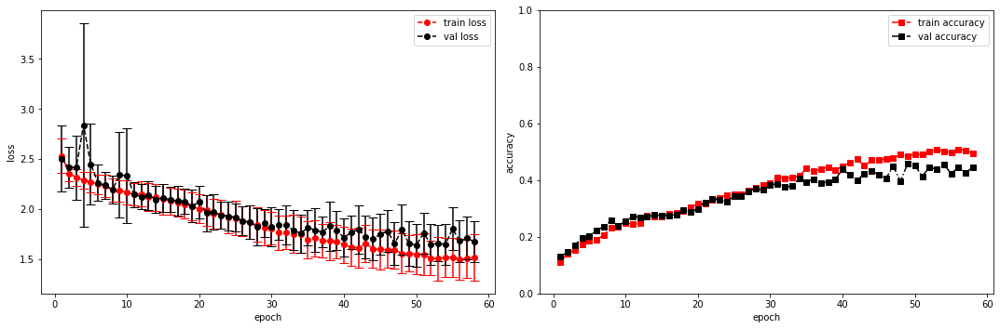

model saved


training epoch:  58
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [59/100], step [1/168],  Loss: 1.5505 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5377426147460938s
Epoch [59/100], step [17/168],  Loss: 1.4920 +/- 0.1838,  accuracy: 0.482421875, time elapsed = 6.237070083618164s
Epoch [59/100], step [33/168],  Loss: 1.4197 +/- 0.1835,  accuracy: 0.51171875, time elapsed = 6.239688396453857s
Epoch [59/100], step [49/168],  Loss: 1.4345 +/- 0.2314,  accuracy: 0.53515625, time elapsed = 6.239140510559082s
Epoch [59/100], step [65/168],  Loss: 1.4308 +/- 0.1508,  accuracy: 0.5390625, time elapsed = 6.238746404647827s
Epoch [59/100], step [81/168],  Loss: 1.5298 +/- 0.2365,  accuracy: 0.470703125, time elapsed = 6.240199089050293s
Epoch [59/100], step [97/168],  Loss: 1.5368 +/- 0.1665,  accuracy: 0.482421875, time elapsed = 6.239908933639526s
Epoch [59/100], step [113/168],  Loss: 1.5048 +/- 0.2538,  accuracy: 0.525390625, time elapsed = 6.240478754043579s
Epoch [59/100], step [129/168],  Loss: 1.5134 +/- 0.2118,  accuracy: 0.498046875, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.502,  precision = 0.502 recall = 0.502 f1 = 0.502 ::: val: acc = 0.433,  precision = 0.433 recall = 0.433 time elapsed = 70.52747631072998s


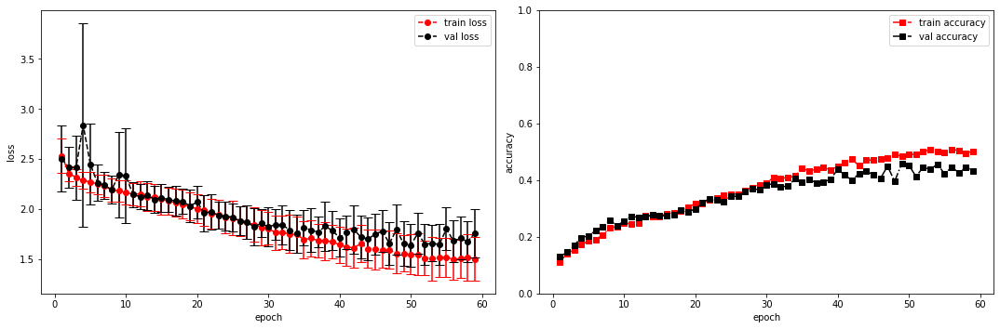

model saved


training epoch:  59
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [60/100], step [1/168],  Loss: 1.4521 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5376896858215332s
Epoch [60/100], step [17/168],  Loss: 1.5462 +/- 0.1838,  accuracy: 0.494140625, time elapsed = 6.240612745285034s
Epoch [60/100], step [33/168],  Loss: 1.5129 +/- 0.2357,  accuracy: 0.529296875, time elapsed = 6.241664409637451s
Epoch [60/100], step [49/168],  Loss: 1.4611 +/- 0.1931,  accuracy: 0.513671875, time elapsed = 6.240453243255615s
Epoch [60/100], step [65/168],  Loss: 1.4783 +/- 0.1550,  accuracy: 0.52734375, time elapsed = 6.237246990203857s
Epoch [60/100], step [81/168],  Loss: 1.4998 +/- 0.2170,  accuracy: 0.52734375, time elapsed = 6.23854923248291s
Epoch [60/100], step [97/168],  Loss: 1.4891 +/- 0.1942,  accuracy: 0.5078125, time elapsed = 6.239448070526123s
Epoch [60/100], step [113/168],  Loss: 1.5220 +/- 0.1597,  accuracy: 0.521484375, time elapsed = 6.239060640335083s
Epoch [60/100], step [129/168],  Loss: 1.5136 +/- 0.1430,  accuracy: 0.498046875, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.513,  precision = 0.513 recall = 0.513 f1 = 0.513 ::: val: acc = 0.472,  precision = 0.472 recall = 0.472 time elapsed = 70.51888275146484s


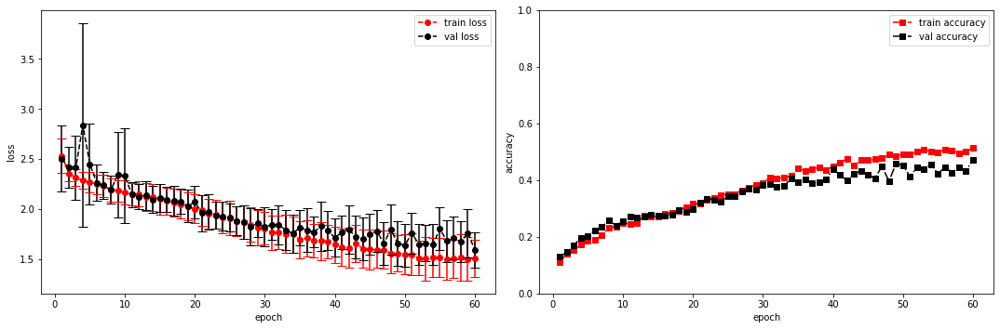

model saved


training epoch:  60
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [61/100], step [1/168],  Loss: 1.5462 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5469436645507812s
Epoch [61/100], step [17/168],  Loss: 1.5421 +/- 0.2270,  accuracy: 0.5078125, time elapsed = 6.239490032196045s
Epoch [61/100], step [33/168],  Loss: 1.5067 +/- 0.1363,  accuracy: 0.5078125, time elapsed = 6.240273952484131s
Epoch [61/100], step [49/168],  Loss: 1.3903 +/- 0.1258,  accuracy: 0.533203125, time elapsed = 6.239573955535889s
Epoch [61/100], step [65/168],  Loss: 1.4480 +/- 0.2137,  accuracy: 0.521484375, time elapsed = 6.239938497543335s
Epoch [61/100], step [81/168],  Loss: 1.5112 +/- 0.1252,  accuracy: 0.5234375, time elapsed = 6.240399122238159s
Epoch [61/100], step [97/168],  Loss: 1.4874 +/- 0.2093,  accuracy: 0.5078125, time elapsed = 6.241199493408203s
Epoch [61/100], step [113/168],  Loss: 1.4549 +/- 0.1900,  accuracy: 0.51171875, time elapsed = 6.26070499420166s
Epoch [61/100], step [129/168],  Loss: 1.5840 +/- 0.2242,  accuracy: 0.458984375, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.503,  precision = 0.503 recall = 0.503 f1 = 0.503 ::: val: acc = 0.477,  precision = 0.477 recall = 0.477 time elapsed = 70.55288171768188s


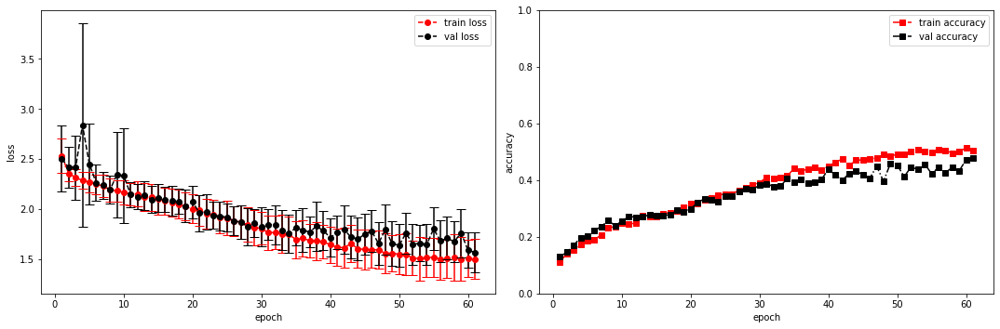

model saved


training epoch:  61
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [62/100], step [1/168],  Loss: 1.3166 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5414144992828369s
Epoch [62/100], step [17/168],  Loss: 1.4466 +/- 0.1937,  accuracy: 0.533203125, time elapsed = 6.236483573913574s
Epoch [62/100], step [33/168],  Loss: 1.4976 +/- 0.1740,  accuracy: 0.48828125, time elapsed = 6.23759126663208s
Epoch [62/100], step [49/168],  Loss: 1.5562 +/- 0.1279,  accuracy: 0.486328125, time elapsed = 6.236979961395264s
Epoch [62/100], step [65/168],  Loss: 1.4715 +/- 0.2046,  accuracy: 0.4921875, time elapsed = 6.238630771636963s
Epoch [62/100], step [81/168],  Loss: 1.5217 +/- 0.1971,  accuracy: 0.509765625, time elapsed = 6.238695383071899s
Epoch [62/100], step [97/168],  Loss: 1.5394 +/- 0.2516,  accuracy: 0.529296875, time elapsed = 6.2396299839019775s
Epoch [62/100], step [113/168],  Loss: 1.5171 +/- 0.1385,  accuracy: 0.48828125, time elapsed = 6.240203619003296s
Epoch [62/100], step [129/168],  Loss: 1.5683 +/- 0.1954,  accuracy: 0.46484375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.500,  precision = 0.500 recall = 0.500 f1 = 0.500 ::: val: acc = 0.455,  precision = 0.455 recall = 0.455 time elapsed = 70.49938201904297s


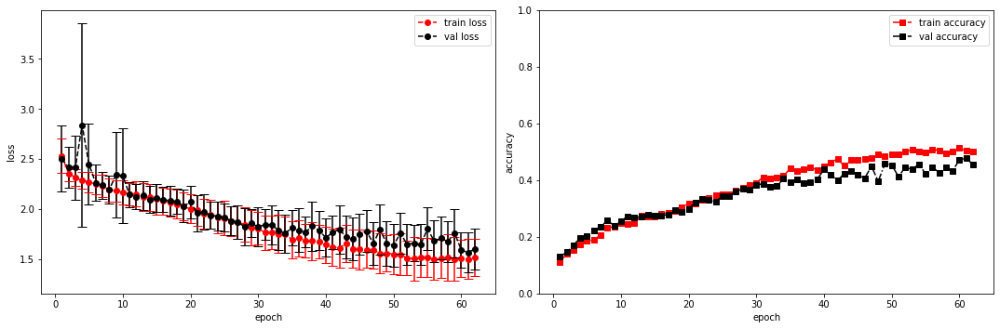

model saved


training epoch:  62
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [63/100], step [1/168],  Loss: 1.2702 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5379488468170166s
Epoch [63/100], step [17/168],  Loss: 1.4425 +/- 0.1879,  accuracy: 0.533203125, time elapsed = 6.240474700927734s
Epoch [63/100], step [33/168],  Loss: 1.4605 +/- 0.2034,  accuracy: 0.513671875, time elapsed = 6.238525152206421s
Epoch [63/100], step [49/168],  Loss: 1.5127 +/- 0.1903,  accuracy: 0.486328125, time elapsed = 6.251047134399414s
Epoch [63/100], step [65/168],  Loss: 1.5274 +/- 0.1761,  accuracy: 0.5078125, time elapsed = 6.240717172622681s
Epoch [63/100], step [81/168],  Loss: 1.5177 +/- 0.2508,  accuracy: 0.49609375, time elapsed = 6.239438056945801s
Epoch [63/100], step [97/168],  Loss: 1.5503 +/- 0.1710,  accuracy: 0.484375, time elapsed = 6.2405171394348145s
Epoch [63/100], step [113/168],  Loss: 1.4050 +/- 0.1515,  accuracy: 0.548828125, time elapsed = 6.241226434707642s
Epoch [63/100], step [129/168],  Loss: 1.4562 +/- 0.1740,  accuracy: 0.51953125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.512,  precision = 0.512 recall = 0.512 f1 = 0.512 ::: val: acc = 0.487,  precision = 0.487 recall = 0.487 time elapsed = 70.52046585083008s


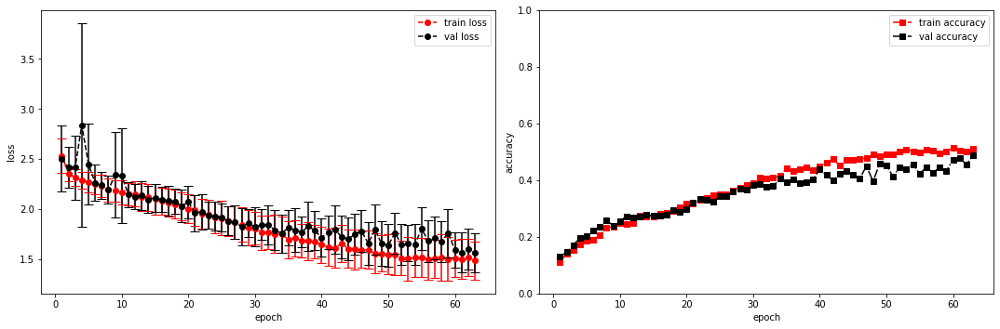

model saved


training epoch:  63
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [64/100], step [1/168],  Loss: 1.2956 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5369486808776855s
Epoch [64/100], step [17/168],  Loss: 1.4822 +/- 0.1755,  accuracy: 0.49609375, time elapsed = 6.24236536026001s
Epoch [64/100], step [33/168],  Loss: 1.5522 +/- 0.2075,  accuracy: 0.5078125, time elapsed = 6.23918604850769s
Epoch [64/100], step [49/168],  Loss: 1.4917 +/- 0.2044,  accuracy: 0.52734375, time elapsed = 6.238735914230347s
Epoch [64/100], step [65/168],  Loss: 1.4934 +/- 0.2639,  accuracy: 0.51171875, time elapsed = 6.238340854644775s
Epoch [64/100], step [81/168],  Loss: 1.4721 +/- 0.1491,  accuracy: 0.50390625, time elapsed = 6.2396628856658936s
Epoch [64/100], step [97/168],  Loss: 1.5107 +/- 0.1680,  accuracy: 0.513671875, time elapsed = 6.238927364349365s
Epoch [64/100], step [113/168],  Loss: 1.4912 +/- 0.1473,  accuracy: 0.494140625, time elapsed = 6.238860130310059s
Epoch [64/100], step [129/168],  Loss: 1.5920 +/- 0.1822,  accuracy: 0.4921875, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.503,  precision = 0.503 recall = 0.503 f1 = 0.503 ::: val: acc = 0.416,  precision = 0.416 recall = 0.416 time elapsed = 70.60494065284729s


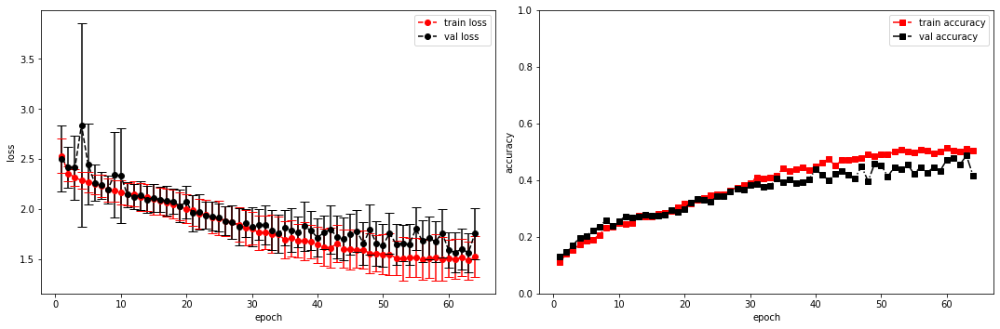

model saved


training epoch:  64
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [65/100], step [1/168],  Loss: 1.8488 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5338764190673828s
Epoch [65/100], step [17/168],  Loss: 1.5381 +/- 0.2270,  accuracy: 0.501953125, time elapsed = 6.237512111663818s
Epoch [65/100], step [33/168],  Loss: 1.4111 +/- 0.1604,  accuracy: 0.501953125, time elapsed = 6.2386016845703125s
Epoch [65/100], step [49/168],  Loss: 1.5168 +/- 0.2281,  accuracy: 0.49609375, time elapsed = 6.2394068241119385s
Epoch [65/100], step [65/168],  Loss: 1.4263 +/- 0.1663,  accuracy: 0.541015625, time elapsed = 6.238793134689331s
Epoch [65/100], step [81/168],  Loss: 1.5753 +/- 0.2232,  accuracy: 0.48046875, time elapsed = 6.238679647445679s
Epoch [65/100], step [97/168],  Loss: 1.5149 +/- 0.1464,  accuracy: 0.501953125, time elapsed = 6.239342927932739s
Epoch [65/100], step [113/168],  Loss: 1.5303 +/- 0.1305,  accuracy: 0.47265625, time elapsed = 6.23947811126709s
Epoch [65/100], step [129/168],  Loss: 1.5537 +/- 0.1645,  accuracy: 0.474609375,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.495,  precision = 0.495 recall = 0.495 f1 = 0.495 ::: val: acc = 0.440,  precision = 0.440 recall = 0.440 time elapsed = 70.50905418395996s


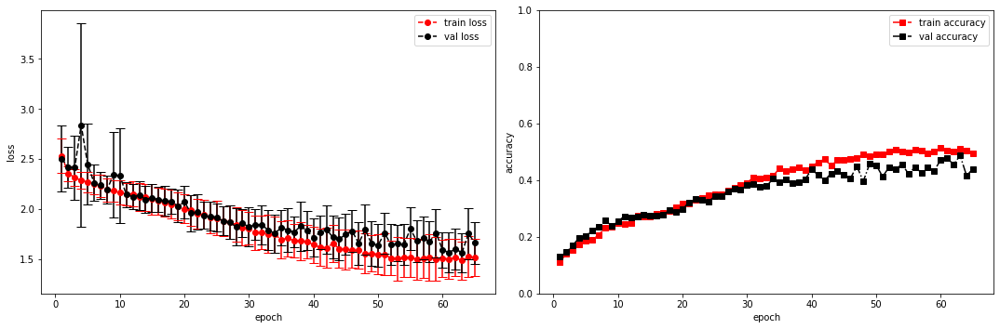

model saved


training epoch:  65
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [66/100], step [1/168],  Loss: 1.6643 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5373854637145996s
Epoch [66/100], step [17/168],  Loss: 1.4608 +/- 0.1743,  accuracy: 0.51171875, time elapsed = 6.239063024520874s
Epoch [66/100], step [33/168],  Loss: 1.3619 +/- 0.1773,  accuracy: 0.546875, time elapsed = 6.239426851272583s
Epoch [66/100], step [49/168],  Loss: 1.5460 +/- 0.2033,  accuracy: 0.48828125, time elapsed = 6.238405466079712s
Epoch [66/100], step [65/168],  Loss: 1.4617 +/- 0.0970,  accuracy: 0.5, time elapsed = 6.238891363143921s
Epoch [66/100], step [81/168],  Loss: 1.4035 +/- 0.1328,  accuracy: 0.515625, time elapsed = 6.239477634429932s
Epoch [66/100], step [97/168],  Loss: 1.4143 +/- 0.2658,  accuracy: 0.5234375, time elapsed = 6.238968372344971s
Epoch [66/100], step [113/168],  Loss: 1.4255 +/- 0.1522,  accuracy: 0.505859375, time elapsed = 6.24238395690918s
Epoch [66/100], step [129/168],  Loss: 1.4110 +/- 0.1569,  accuracy: 0.54296875, time elapsed = 6.24

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.518,  precision = 0.518 recall = 0.518 f1 = 0.518 ::: val: acc = 0.467,  precision = 0.467 recall = 0.467 time elapsed = 70.51685810089111s


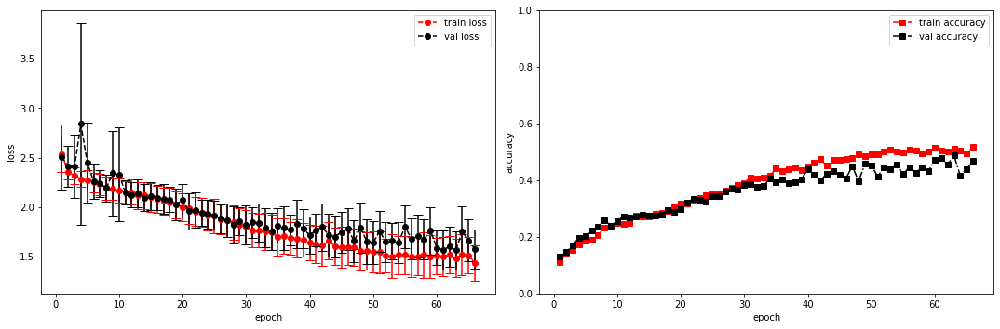

model saved


training epoch:  66
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [67/100], step [1/168],  Loss: 1.3023 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5368618965148926s
Epoch [67/100], step [17/168],  Loss: 1.3766 +/- 0.1724,  accuracy: 0.55078125, time elapsed = 6.239508867263794s
Epoch [67/100], step [33/168],  Loss: 1.3844 +/- 0.1801,  accuracy: 0.5546875, time elapsed = 6.240476846694946s
Epoch [67/100], step [49/168],  Loss: 1.3072 +/- 0.1756,  accuracy: 0.580078125, time elapsed = 6.239940881729126s
Epoch [67/100], step [65/168],  Loss: 1.4985 +/- 0.1520,  accuracy: 0.486328125, time elapsed = 6.239467144012451s
Epoch [67/100], step [81/168],  Loss: 1.4157 +/- 0.1777,  accuracy: 0.53515625, time elapsed = 6.241617918014526s
Epoch [67/100], step [97/168],  Loss: 1.4744 +/- 0.2693,  accuracy: 0.490234375, time elapsed = 6.238786220550537s
Epoch [67/100], step [113/168],  Loss: 1.5583 +/- 0.1369,  accuracy: 0.47265625, time elapsed = 6.240190744400024s
Epoch [67/100], step [129/168],  Loss: 1.5436 +/- 0.1486,  accuracy: 0.498046875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.512,  precision = 0.512 recall = 0.512 f1 = 0.512 ::: val: acc = 0.449,  precision = 0.449 recall = 0.449 time elapsed = 70.52185249328613s


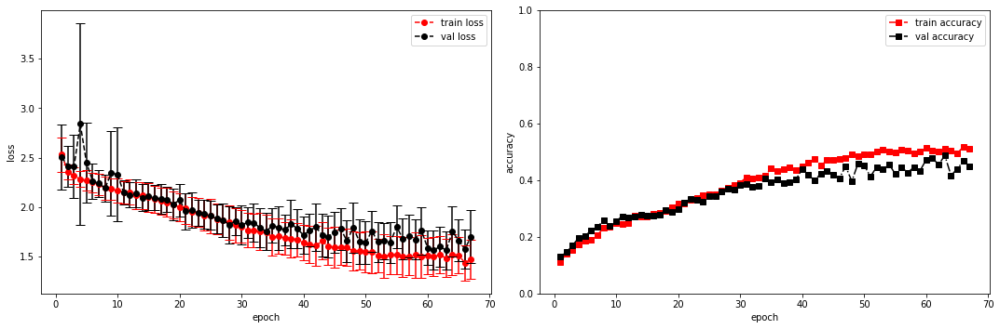

model saved


training epoch:  67
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [68/100], step [1/168],  Loss: 1.5397 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5359485149383545s
Epoch [68/100], step [17/168],  Loss: 1.5274 +/- 0.2089,  accuracy: 0.49609375, time elapsed = 6.2380125522613525s
Epoch [68/100], step [33/168],  Loss: 1.4958 +/- 0.1660,  accuracy: 0.515625, time elapsed = 6.238083124160767s
Epoch [68/100], step [49/168],  Loss: 1.3995 +/- 0.1481,  accuracy: 0.537109375, time elapsed = 6.239828109741211s
Epoch [68/100], step [65/168],  Loss: 1.4088 +/- 0.2208,  accuracy: 0.5625, time elapsed = 6.258516788482666s
Epoch [68/100], step [81/168],  Loss: 1.3520 +/- 0.2238,  accuracy: 0.546875, time elapsed = 6.2392425537109375s
Epoch [68/100], step [97/168],  Loss: 1.3329 +/- 0.1864,  accuracy: 0.55078125, time elapsed = 6.237431049346924s
Epoch [68/100], step [113/168],  Loss: 1.4351 +/- 0.2154,  accuracy: 0.521484375, time elapsed = 6.237800598144531s
Epoch [68/100], step [129/168],  Loss: 1.4686 +/- 0.2682,  accuracy: 0.5, time elapsed = 6.

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.526,  precision = 0.526 recall = 0.526 f1 = 0.526 ::: val: acc = 0.468,  precision = 0.468 recall = 0.468 time elapsed = 70.53556680679321s


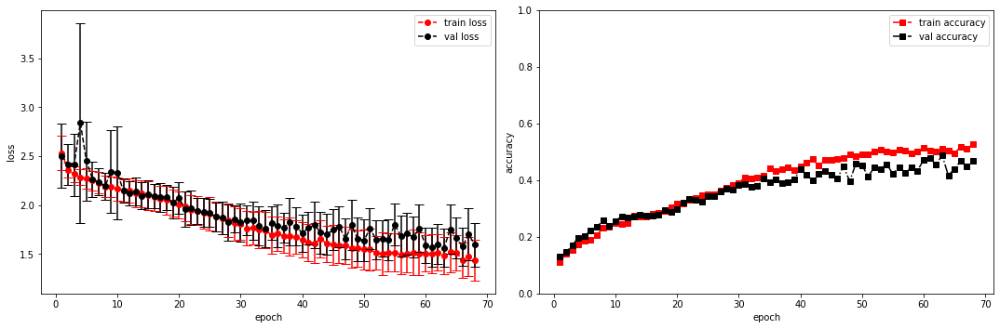

model saved


training epoch:  68
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [69/100], step [1/168],  Loss: 1.0727 +/- 0.0000,  accuracy: 0.044921875, time elapsed = 0.5372614860534668s
Epoch [69/100], step [17/168],  Loss: 1.3598 +/- 0.2146,  accuracy: 0.55078125, time elapsed = 6.240452289581299s
Epoch [69/100], step [33/168],  Loss: 1.4337 +/- 0.1891,  accuracy: 0.53515625, time elapsed = 6.241245985031128s
Epoch [69/100], step [49/168],  Loss: 1.4801 +/- 0.2159,  accuracy: 0.5, time elapsed = 6.239969253540039s
Epoch [69/100], step [65/168],  Loss: 1.5457 +/- 0.2054,  accuracy: 0.498046875, time elapsed = 6.238841772079468s
Epoch [69/100], step [81/168],  Loss: 1.3633 +/- 0.1751,  accuracy: 0.56640625, time elapsed = 6.238977909088135s
Epoch [69/100], step [97/168],  Loss: 1.5210 +/- 0.2102,  accuracy: 0.501953125, time elapsed = 6.239654779434204s
Epoch [69/100], step [113/168],  Loss: 1.4098 +/- 0.2942,  accuracy: 0.546875, time elapsed = 6.239390850067139s
Epoch [69/100], step [129/168],  Loss: 1.4223 +/- 0.1475,  accuracy: 0.541015625, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.527,  precision = 0.527 recall = 0.527 f1 = 0.527 ::: val: acc = 0.459,  precision = 0.459 recall = 0.459 time elapsed = 70.54333138465881s


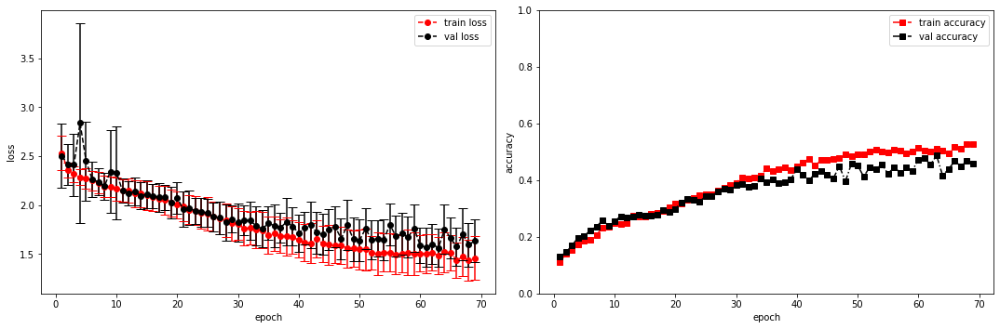

model saved


training epoch:  69
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [70/100], step [1/168],  Loss: 1.6029 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5388758182525635s
Epoch [70/100], step [17/168],  Loss: 1.4769 +/- 0.2376,  accuracy: 0.505859375, time elapsed = 6.250228643417358s
Epoch [70/100], step [33/168],  Loss: 1.3080 +/- 0.1478,  accuracy: 0.56640625, time elapsed = 6.239300489425659s
Epoch [70/100], step [49/168],  Loss: 1.3560 +/- 0.1464,  accuracy: 0.564453125, time elapsed = 6.239285469055176s
Epoch [70/100], step [65/168],  Loss: 1.3752 +/- 0.1648,  accuracy: 0.5625, time elapsed = 6.238325357437134s
Epoch [70/100], step [81/168],  Loss: 1.2770 +/- 0.1915,  accuracy: 0.576171875, time elapsed = 6.2394702434539795s
Epoch [70/100], step [97/168],  Loss: 1.4461 +/- 0.3021,  accuracy: 0.544921875, time elapsed = 6.238651990890503s
Epoch [70/100], step [113/168],  Loss: 1.5343 +/- 0.1675,  accuracy: 0.484375, time elapsed = 6.238277196884155s
Epoch [70/100], step [129/168],  Loss: 1.4426 +/- 0.2130,  accuracy: 0.525390625, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.536,  precision = 0.536 recall = 0.536 f1 = 0.536 ::: val: acc = 0.482,  precision = 0.482 recall = 0.482 time elapsed = 70.52222657203674s


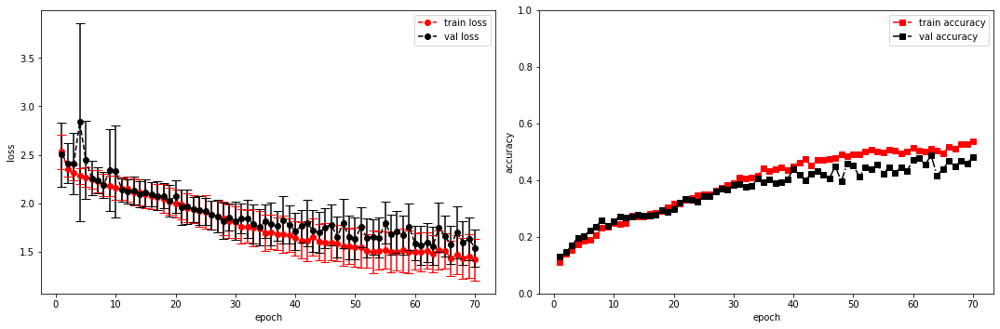

model saved


training epoch:  70
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [71/100], step [1/168],  Loss: 1.2387 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5342867374420166s
Epoch [71/100], step [17/168],  Loss: 1.3741 +/- 0.1793,  accuracy: 0.5546875, time elapsed = 6.2389609813690186s
Epoch [71/100], step [33/168],  Loss: 1.4324 +/- 0.1912,  accuracy: 0.544921875, time elapsed = 6.240127086639404s
Epoch [71/100], step [49/168],  Loss: 1.4595 +/- 0.1668,  accuracy: 0.53125, time elapsed = 6.241266489028931s
Epoch [71/100], step [65/168],  Loss: 1.4210 +/- 0.2010,  accuracy: 0.54296875, time elapsed = 6.2393693923950195s
Epoch [71/100], step [81/168],  Loss: 1.4910 +/- 0.2259,  accuracy: 0.544921875, time elapsed = 6.238290309906006s
Epoch [71/100], step [97/168],  Loss: 1.5703 +/- 0.2264,  accuracy: 0.48046875, time elapsed = 6.237677812576294s
Epoch [71/100], step [113/168],  Loss: 1.5310 +/- 0.2817,  accuracy: 0.490234375, time elapsed = 6.2383644580841064s
Epoch [71/100], step [129/168],  Loss: 1.5067 +/- 0.1502,  accuracy: 0.501953125, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.517,  precision = 0.517 recall = 0.517 f1 = 0.517 ::: val: acc = 0.442,  precision = 0.442 recall = 0.442 time elapsed = 70.5271806716919s


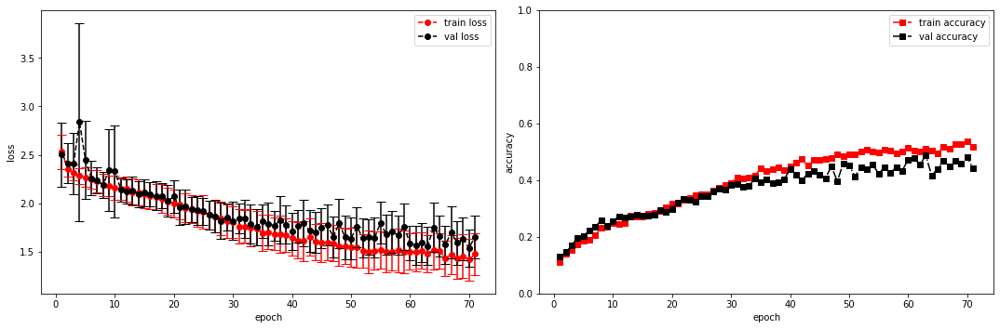

model saved


training epoch:  71
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [72/100], step [1/168],  Loss: 1.6609 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5356557369232178s
Epoch [72/100], step [17/168],  Loss: 1.5367 +/- 0.1909,  accuracy: 0.466796875, time elapsed = 6.238915681838989s
Epoch [72/100], step [33/168],  Loss: 1.4688 +/- 0.1566,  accuracy: 0.49609375, time elapsed = 6.238110780715942s
Epoch [72/100], step [49/168],  Loss: 1.3173 +/- 0.2410,  accuracy: 0.5703125, time elapsed = 6.238478422164917s
Epoch [72/100], step [65/168],  Loss: 1.4837 +/- 0.1775,  accuracy: 0.509765625, time elapsed = 6.2380149364471436s
Epoch [72/100], step [81/168],  Loss: 1.4577 +/- 0.2133,  accuracy: 0.53125, time elapsed = 6.238146066665649s
Epoch [72/100], step [97/168],  Loss: 1.5084 +/- 0.1851,  accuracy: 0.509765625, time elapsed = 6.239438772201538s
Epoch [72/100], step [113/168],  Loss: 1.3827 +/- 0.1118,  accuracy: 0.5234375, time elapsed = 6.238872766494751s
Epoch [72/100], step [129/168],  Loss: 1.3797 +/- 0.1970,  accuracy: 0.546875, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.527,  precision = 0.527 recall = 0.527 f1 = 0.527 ::: val: acc = 0.431,  precision = 0.431 recall = 0.431 time elapsed = 70.50661563873291s


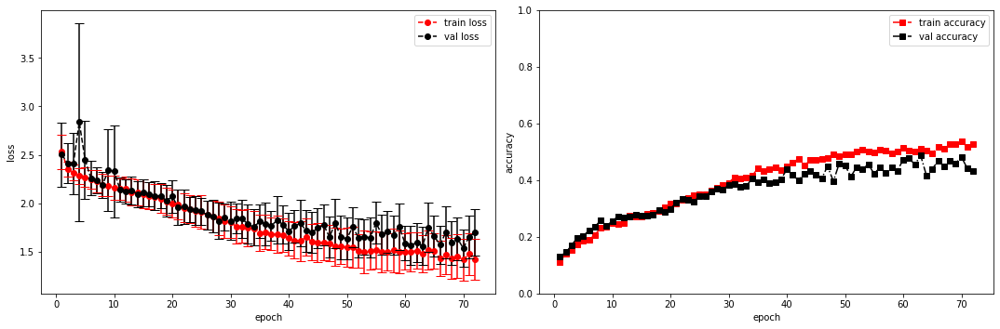

model saved


training epoch:  72
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [73/100], step [1/168],  Loss: 1.5180 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.539654016494751s
Epoch [73/100], step [17/168],  Loss: 1.4067 +/- 0.1987,  accuracy: 0.541015625, time elapsed = 6.239546298980713s
Epoch [73/100], step [33/168],  Loss: 1.4980 +/- 0.2452,  accuracy: 0.515625, time elapsed = 6.238142490386963s
Epoch [73/100], step [49/168],  Loss: 1.4596 +/- 0.2230,  accuracy: 0.482421875, time elapsed = 6.239058494567871s
Epoch [73/100], step [65/168],  Loss: 1.4563 +/- 0.1845,  accuracy: 0.54296875, time elapsed = 6.242546319961548s
Epoch [73/100], step [81/168],  Loss: 1.4144 +/- 0.1903,  accuracy: 0.525390625, time elapsed = 6.245418310165405s
Epoch [73/100], step [97/168],  Loss: 1.4656 +/- 0.2586,  accuracy: 0.494140625, time elapsed = 6.239758014678955s
Epoch [73/100], step [113/168],  Loss: 1.3873 +/- 0.2054,  accuracy: 0.556640625, time elapsed = 6.239292860031128s
Epoch [73/100], step [129/168],  Loss: 1.3797 +/- 0.1916,  accuracy: 0.537109375, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.524,  precision = 0.524 recall = 0.524 f1 = 0.524 ::: val: acc = 0.488,  precision = 0.488 recall = 0.488 time elapsed = 70.52187848091125s


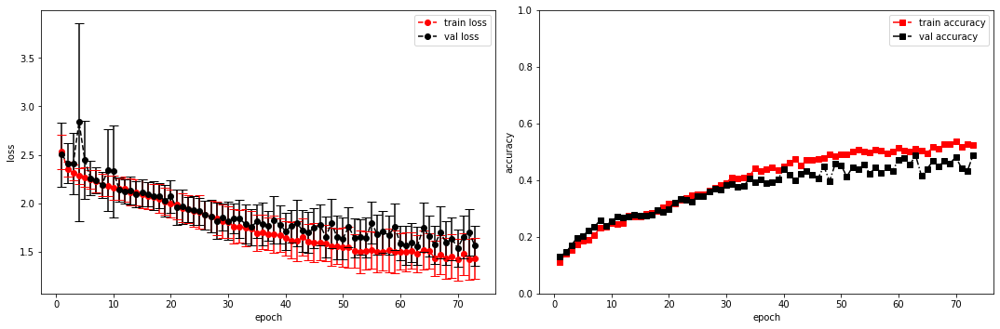

model saved


training epoch:  73
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [74/100], step [1/168],  Loss: 1.1264 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5650691986083984s
Epoch [74/100], step [17/168],  Loss: 1.4032 +/- 0.2131,  accuracy: 0.552734375, time elapsed = 6.238126516342163s
Epoch [74/100], step [33/168],  Loss: 1.3176 +/- 0.1724,  accuracy: 0.591796875, time elapsed = 6.240624666213989s
Epoch [74/100], step [49/168],  Loss: 1.4099 +/- 0.1871,  accuracy: 0.5234375, time elapsed = 6.238785266876221s
Epoch [74/100], step [65/168],  Loss: 1.3748 +/- 0.2132,  accuracy: 0.544921875, time elapsed = 6.238732099533081s
Epoch [74/100], step [81/168],  Loss: 1.3772 +/- 0.1916,  accuracy: 0.529296875, time elapsed = 6.239685535430908s
Epoch [74/100], step [97/168],  Loss: 1.4649 +/- 0.2116,  accuracy: 0.52734375, time elapsed = 6.238831520080566s
Epoch [74/100], step [113/168],  Loss: 1.5219 +/- 0.2115,  accuracy: 0.46875, time elapsed = 6.23949933052063s
Epoch [74/100], step [129/168],  Loss: 1.4228 +/- 0.2154,  accuracy: 0.552734375, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.530,  precision = 0.530 recall = 0.530 f1 = 0.530 ::: val: acc = 0.450,  precision = 0.450 recall = 0.450 time elapsed = 70.53651261329651s


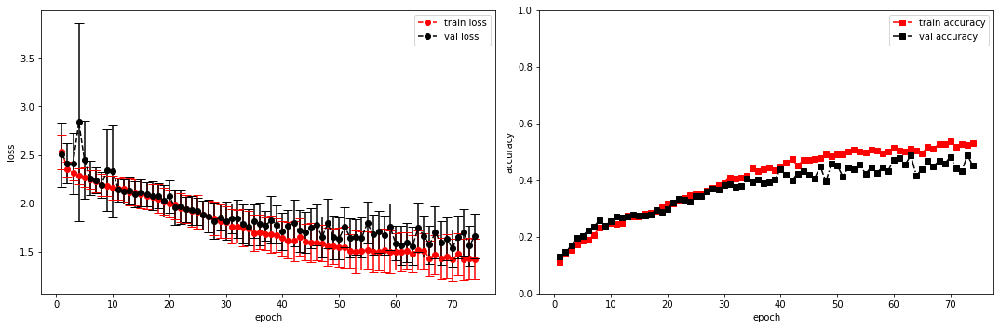

model saved


training epoch:  74
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [75/100], step [1/168],  Loss: 0.9850 +/- 0.0000,  accuracy: 0.04296875, time elapsed = 0.5352084636688232s
Epoch [75/100], step [17/168],  Loss: 1.4725 +/- 0.1433,  accuracy: 0.509765625, time elapsed = 6.252525329589844s
Epoch [75/100], step [33/168],  Loss: 1.3641 +/- 0.1880,  accuracy: 0.56640625, time elapsed = 6.239715099334717s
Epoch [75/100], step [49/168],  Loss: 1.3688 +/- 0.1445,  accuracy: 0.576171875, time elapsed = 6.240640163421631s
Epoch [75/100], step [65/168],  Loss: 1.3212 +/- 0.1818,  accuracy: 0.57421875, time elapsed = 6.239502668380737s
Epoch [75/100], step [81/168],  Loss: 1.4957 +/- 0.2345,  accuracy: 0.49609375, time elapsed = 6.239333868026733s
Epoch [75/100], step [97/168],  Loss: 1.4457 +/- 0.2006,  accuracy: 0.515625, time elapsed = 6.2393341064453125s
Epoch [75/100], step [113/168],  Loss: 1.5010 +/- 0.1962,  accuracy: 0.5, time elapsed = 6.239358425140381s
Epoch [75/100], step [129/168],  Loss: 1.4818 +/- 0.2462,  accuracy: 0.49609375, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.529,  precision = 0.529 recall = 0.529 f1 = 0.529 ::: val: acc = 0.458,  precision = 0.458 recall = 0.458 time elapsed = 70.52339386940002s


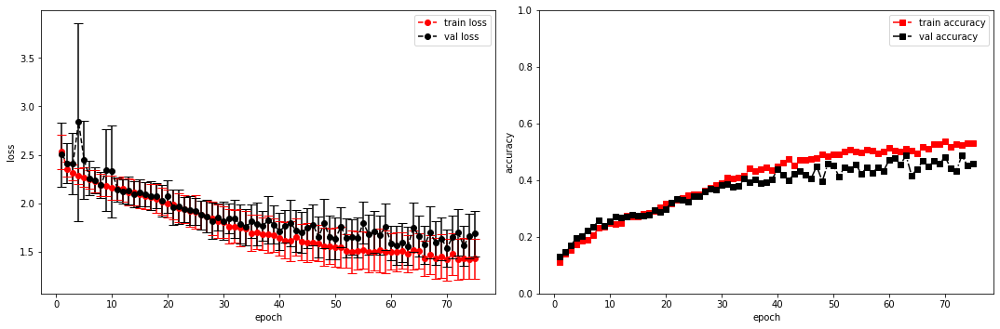

model saved


training epoch:  75
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [76/100], step [1/168],  Loss: 1.4370 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5338871479034424s
Epoch [76/100], step [17/168],  Loss: 1.3940 +/- 0.2111,  accuracy: 0.533203125, time elapsed = 6.237036466598511s
Epoch [76/100], step [33/168],  Loss: 1.4097 +/- 0.2125,  accuracy: 0.541015625, time elapsed = 6.237086057662964s
Epoch [76/100], step [49/168],  Loss: 1.3448 +/- 0.1386,  accuracy: 0.564453125, time elapsed = 6.23833966255188s
Epoch [76/100], step [65/168],  Loss: 1.3695 +/- 0.1842,  accuracy: 0.54296875, time elapsed = 6.236939191818237s
Epoch [76/100], step [81/168],  Loss: 1.3864 +/- 0.2365,  accuracy: 0.552734375, time elapsed = 6.237827777862549s
Epoch [76/100], step [97/168],  Loss: 1.3700 +/- 0.1868,  accuracy: 0.55859375, time elapsed = 6.237124681472778s
Epoch [76/100], step [113/168],  Loss: 1.4117 +/- 0.2178,  accuracy: 0.521484375, time elapsed = 6.2372612953186035s
Epoch [76/100], step [129/168],  Loss: 1.3545 +/- 0.1877,  accuracy: 0.548828125, 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.545,  precision = 0.545 recall = 0.545 f1 = 0.545 ::: val: acc = 0.488,  precision = 0.488 recall = 0.488 time elapsed = 70.50027847290039s


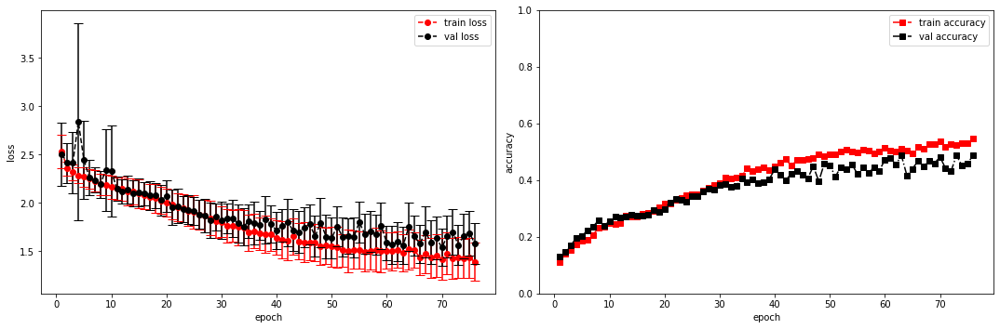

model saved


training epoch:  76
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [77/100], step [1/168],  Loss: 1.4828 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5470221042633057s
Epoch [77/100], step [17/168],  Loss: 1.2835 +/- 0.1825,  accuracy: 0.58203125, time elapsed = 6.2391955852508545s
Epoch [77/100], step [33/168],  Loss: 1.3602 +/- 0.2737,  accuracy: 0.548828125, time elapsed = 6.239713191986084s
Epoch [77/100], step [49/168],  Loss: 1.2847 +/- 0.1733,  accuracy: 0.5625, time elapsed = 6.238588571548462s
Epoch [77/100], step [65/168],  Loss: 1.3028 +/- 0.2179,  accuracy: 0.572265625, time elapsed = 6.239469528198242s
Epoch [77/100], step [81/168],  Loss: 1.4165 +/- 0.1641,  accuracy: 0.544921875, time elapsed = 6.239715337753296s
Epoch [77/100], step [97/168],  Loss: 1.3255 +/- 0.1392,  accuracy: 0.568359375, time elapsed = 6.241884708404541s
Epoch [77/100], step [113/168],  Loss: 1.3392 +/- 0.1348,  accuracy: 0.5625, time elapsed = 6.240177869796753s
Epoch [77/100], step [129/168],  Loss: 1.4174 +/- 0.1869,  accuracy: 0.546875, time elapse

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.546,  precision = 0.546 recall = 0.546 f1 = 0.546 ::: val: acc = 0.430,  precision = 0.430 recall = 0.430 time elapsed = 70.54229593276978s


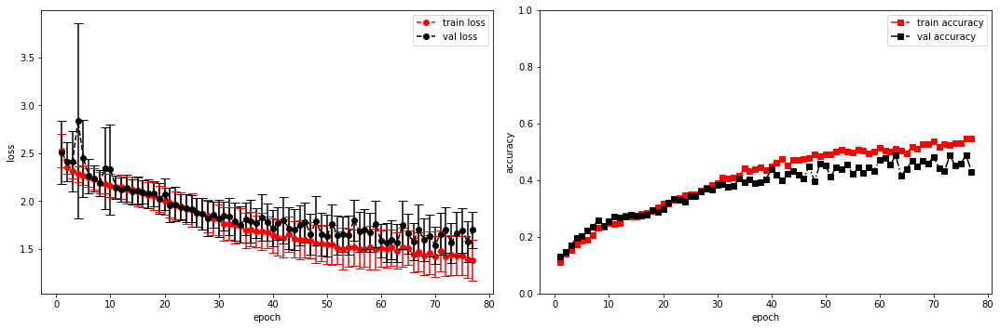

model saved


training epoch:  77
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [78/100], step [1/168],  Loss: 1.5112 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5402793884277344s
Epoch [78/100], step [17/168],  Loss: 1.4608 +/- 0.2211,  accuracy: 0.521484375, time elapsed = 6.237905502319336s
Epoch [78/100], step [33/168],  Loss: 1.3734 +/- 0.1915,  accuracy: 0.5546875, time elapsed = 6.238633394241333s
Epoch [78/100], step [49/168],  Loss: 1.2883 +/- 0.2968,  accuracy: 0.58984375, time elapsed = 6.239034175872803s
Epoch [78/100], step [65/168],  Loss: 1.4049 +/- 0.1327,  accuracy: 0.548828125, time elapsed = 6.239288091659546s
Epoch [78/100], step [81/168],  Loss: 1.4129 +/- 0.2309,  accuracy: 0.546875, time elapsed = 6.2503440380096436s
Epoch [78/100], step [97/168],  Loss: 1.4776 +/- 0.2418,  accuracy: 0.505859375, time elapsed = 6.2389843463897705s
Epoch [78/100], step [113/168],  Loss: 1.4139 +/- 0.2354,  accuracy: 0.498046875, time elapsed = 6.238682508468628s
Epoch [78/100], step [129/168],  Loss: 1.3712 +/- 0.1735,  accuracy: 0.5625, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.531,  precision = 0.531 recall = 0.531 f1 = 0.531 ::: val: acc = 0.464,  precision = 0.464 recall = 0.464 time elapsed = 70.53860092163086s


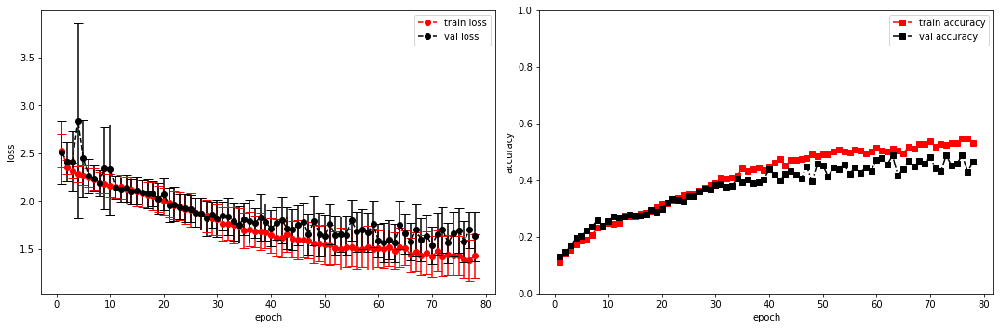

model saved


training epoch:  78
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [79/100], step [1/168],  Loss: 1.1846 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5376763343811035s
Epoch [79/100], step [17/168],  Loss: 1.3890 +/- 0.1745,  accuracy: 0.55078125, time elapsed = 6.239504098892212s
Epoch [79/100], step [33/168],  Loss: 1.3981 +/- 0.1678,  accuracy: 0.5546875, time elapsed = 6.238814353942871s
Epoch [79/100], step [49/168],  Loss: 1.3745 +/- 0.2058,  accuracy: 0.544921875, time elapsed = 6.240599155426025s
Epoch [79/100], step [65/168],  Loss: 1.3008 +/- 0.1679,  accuracy: 0.58984375, time elapsed = 6.239967346191406s
Epoch [79/100], step [81/168],  Loss: 1.3357 +/- 0.1839,  accuracy: 0.548828125, time elapsed = 6.2398316860198975s
Epoch [79/100], step [97/168],  Loss: 1.3273 +/- 0.1661,  accuracy: 0.556640625, time elapsed = 6.238725900650024s
Epoch [79/100], step [113/168],  Loss: 1.3751 +/- 0.1152,  accuracy: 0.55859375, time elapsed = 6.238235712051392s
Epoch [79/100], step [129/168],  Loss: 1.4054 +/- 0.1665,  accuracy: 0.548828125, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.553,  precision = 0.553 recall = 0.553 f1 = 0.553 ::: val: acc = 0.465,  precision = 0.465 recall = 0.465 time elapsed = 70.51610374450684s


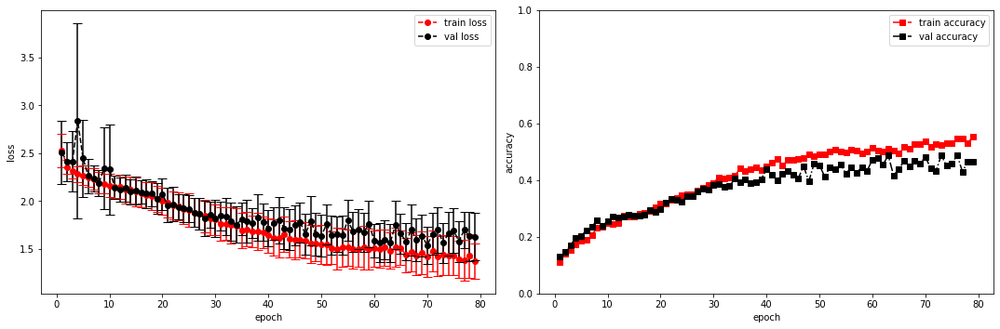

model saved


training epoch:  79
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [80/100], step [1/168],  Loss: 1.3118 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.535646915435791s
Epoch [80/100], step [17/168],  Loss: 1.4042 +/- 0.2118,  accuracy: 0.54296875, time elapsed = 6.23969841003418s
Epoch [80/100], step [33/168],  Loss: 1.3417 +/- 0.1397,  accuracy: 0.576171875, time elapsed = 6.2516279220581055s
Epoch [80/100], step [49/168],  Loss: 1.2041 +/- 0.1972,  accuracy: 0.625, time elapsed = 6.239415168762207s
Epoch [80/100], step [65/168],  Loss: 1.4156 +/- 0.2221,  accuracy: 0.544921875, time elapsed = 6.239277362823486s
Epoch [80/100], step [81/168],  Loss: 1.3639 +/- 0.1848,  accuracy: 0.5625, time elapsed = 6.239362001419067s
Epoch [80/100], step [97/168],  Loss: 1.4421 +/- 0.1650,  accuracy: 0.52734375, time elapsed = 6.239327669143677s
Epoch [80/100], step [113/168],  Loss: 1.3407 +/- 0.1870,  accuracy: 0.576171875, time elapsed = 6.237934589385986s
Epoch [80/100], step [129/168],  Loss: 1.3411 +/- 0.1291,  accuracy: 0.5703125, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.566,  precision = 0.566 recall = 0.566 f1 = 0.566 ::: val: acc = 0.495,  precision = 0.495 recall = 0.495 time elapsed = 70.51716184616089s


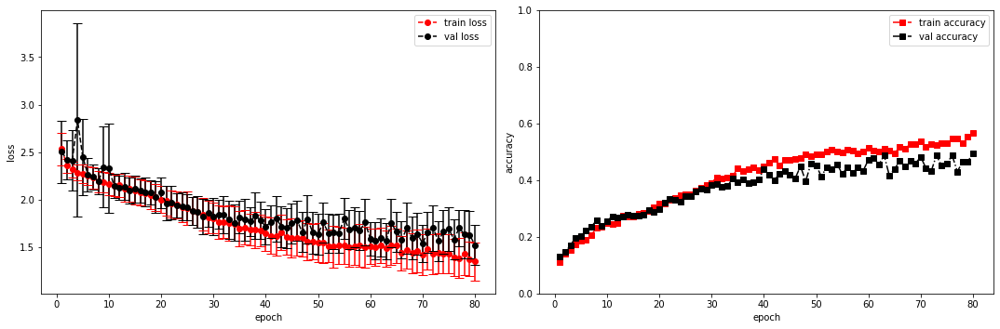

model saved


training epoch:  80
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [81/100], step [1/168],  Loss: 1.5119 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5452456474304199s
Epoch [81/100], step [17/168],  Loss: 1.3399 +/- 0.1540,  accuracy: 0.5546875, time elapsed = 6.23969030380249s
Epoch [81/100], step [33/168],  Loss: 1.2469 +/- 0.1733,  accuracy: 0.58984375, time elapsed = 6.238985061645508s
Epoch [81/100], step [49/168],  Loss: 1.3673 +/- 0.1964,  accuracy: 0.552734375, time elapsed = 6.23944878578186s
Epoch [81/100], step [65/168],  Loss: 1.3382 +/- 0.2156,  accuracy: 0.5546875, time elapsed = 6.238727569580078s
Epoch [81/100], step [81/168],  Loss: 1.3645 +/- 0.2374,  accuracy: 0.560546875, time elapsed = 6.23941969871521s
Epoch [81/100], step [97/168],  Loss: 1.3717 +/- 0.1677,  accuracy: 0.556640625, time elapsed = 6.239819765090942s
Epoch [81/100], step [113/168],  Loss: 1.3227 +/- 0.2137,  accuracy: 0.56640625, time elapsed = 6.23955512046814s
Epoch [81/100], step [129/168],  Loss: 1.3628 +/- 0.2057,  accuracy: 0.544921875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.564,  precision = 0.564 recall = 0.564 f1 = 0.564 ::: val: acc = 0.499,  precision = 0.499 recall = 0.499 time elapsed = 70.53005051612854s


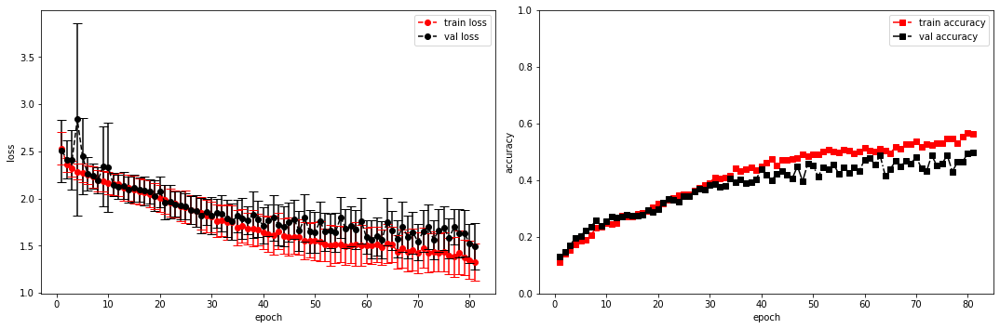

model saved


training epoch:  81
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [82/100], step [1/168],  Loss: 1.0293 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5379319190979004s
Epoch [82/100], step [17/168],  Loss: 1.2461 +/- 0.1675,  accuracy: 0.603515625, time elapsed = 6.238615274429321s
Epoch [82/100], step [33/168],  Loss: 1.2808 +/- 0.1629,  accuracy: 0.58984375, time elapsed = 6.23809814453125s
Epoch [82/100], step [49/168],  Loss: 1.3084 +/- 0.1724,  accuracy: 0.583984375, time elapsed = 6.238302230834961s
Epoch [82/100], step [65/168],  Loss: 1.3898 +/- 0.2031,  accuracy: 0.541015625, time elapsed = 6.2383410930633545s
Epoch [82/100], step [81/168],  Loss: 1.2859 +/- 0.1891,  accuracy: 0.576171875, time elapsed = 6.237142086029053s
Epoch [82/100], step [97/168],  Loss: 1.2709 +/- 0.1716,  accuracy: 0.578125, time elapsed = 6.239103078842163s
Epoch [82/100], step [113/168],  Loss: 1.2416 +/- 0.1243,  accuracy: 0.603515625, time elapsed = 6.239684104919434s
Epoch [82/100], step [129/168],  Loss: 1.2187 +/- 0.2035,  accuracy: 0.59765625, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.582,  precision = 0.582 recall = 0.582 f1 = 0.582 ::: val: acc = 0.487,  precision = 0.487 recall = 0.487 time elapsed = 70.50411748886108s


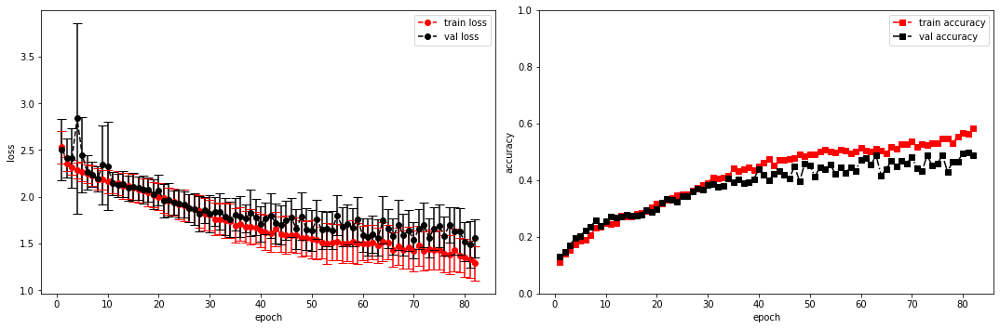

model saved


training epoch:  82
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [83/100], step [1/168],  Loss: 1.1064 +/- 0.0000,  accuracy: 0.04296875, time elapsed = 0.5531184673309326s
Epoch [83/100], step [17/168],  Loss: 1.2277 +/- 0.2000,  accuracy: 0.615234375, time elapsed = 6.239241123199463s
Epoch [83/100], step [33/168],  Loss: 1.2117 +/- 0.1764,  accuracy: 0.607421875, time elapsed = 6.240392684936523s
Epoch [83/100], step [49/168],  Loss: 1.2505 +/- 0.2411,  accuracy: 0.5859375, time elapsed = 6.239449501037598s
Epoch [83/100], step [65/168],  Loss: 1.2655 +/- 0.2133,  accuracy: 0.580078125, time elapsed = 6.238566875457764s
Epoch [83/100], step [81/168],  Loss: 1.2828 +/- 0.2272,  accuracy: 0.587890625, time elapsed = 6.241804122924805s
Epoch [83/100], step [97/168],  Loss: 1.2875 +/- 0.1924,  accuracy: 0.580078125, time elapsed = 6.250988245010376s
Epoch [83/100], step [113/168],  Loss: 1.3001 +/- 0.1844,  accuracy: 0.578125, time elapsed = 6.238762617111206s
Epoch [83/100], step [129/168],  Loss: 1.2477 +/- 0.2273,  accuracy: 0.580078125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.582,  precision = 0.582 recall = 0.582 f1 = 0.582 ::: val: acc = 0.465,  precision = 0.465 recall = 0.465 time elapsed = 70.54516124725342s


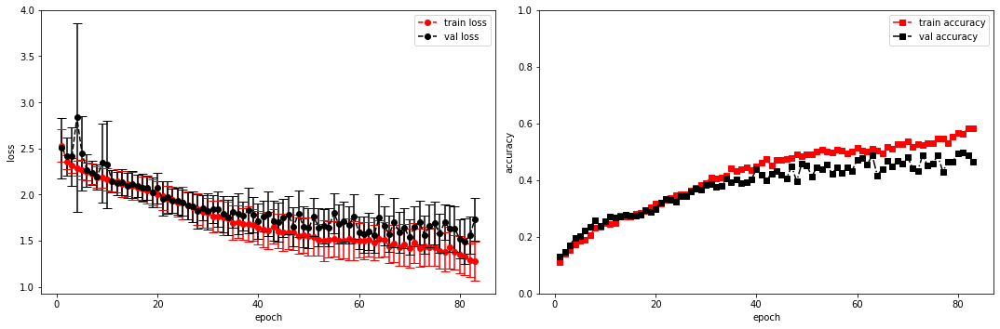

model saved
model saved


training epoch:  83
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [84/100], step [1/168],  Loss: 1.4341 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5301229953765869s
Epoch [84/100], step [17/168],  Loss: 1.1765 +/- 0.1652,  accuracy: 0.591796875, time elapsed = 6.23728609085083s
Epoch [84/100], step [33/168],  Loss: 1.2735 +/- 0.2003,  accuracy: 0.568359375, time elapsed = 6.237839460372925s
Epoch [84/100], step [49/168],  Loss: 1.2175 +/- 0.2488,  accuracy: 0.640625, time elapsed = 6.239512205123901s
Epoch [84/100], step [65/168],  Loss: 1.2410 +/- 0.1906,  accuracy: 0.57421875, time elapsed = 6.2410242557525635s
Epoch [84/100], step [81/168],  Loss: 1.3415 +/- 0.1935,  accuracy: 0.548828125, time elapsed = 6.239044189453125s
Epoch [84/100], step [97/168],  Loss: 1.2972 +/- 0.2005,  accuracy: 0.57421875, time elapsed = 6.239656925201416s
Epoch [84/100], step [113/168],  Loss: 1.2384 +/- 0.1636,  accuracy: 0.6015625, time elapsed = 6.238556385040283s
Epoch [84/100], step [129/168],  Loss: 1.2633 +/- 0.2462,  accuracy: 0.61328125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.584,  precision = 0.584 recall = 0.584 f1 = 0.584 ::: val: acc = 0.460,  precision = 0.460 recall = 0.460 time elapsed = 70.50468611717224s


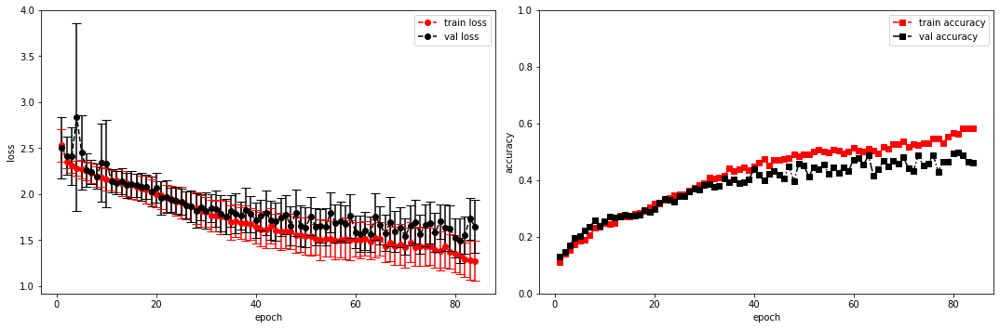

model saved


training epoch:  84
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [85/100], step [1/168],  Loss: 1.5214 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5446112155914307s
Epoch [85/100], step [17/168],  Loss: 1.2853 +/- 0.2090,  accuracy: 0.583984375, time elapsed = 6.23836350440979s
Epoch [85/100], step [33/168],  Loss: 1.2046 +/- 0.2162,  accuracy: 0.611328125, time elapsed = 6.249028444290161s
Epoch [85/100], step [49/168],  Loss: 1.2149 +/- 0.1495,  accuracy: 0.62109375, time elapsed = 6.240230321884155s
Epoch [85/100], step [65/168],  Loss: 1.1851 +/- 0.2089,  accuracy: 0.607421875, time elapsed = 6.236780405044556s
Epoch [85/100], step [81/168],  Loss: 1.2910 +/- 0.2128,  accuracy: 0.572265625, time elapsed = 6.2377707958221436s
Epoch [85/100], step [97/168],  Loss: 1.2637 +/- 0.2274,  accuracy: 0.578125, time elapsed = 6.2369773387908936s
Epoch [85/100], step [113/168],  Loss: 1.3686 +/- 0.2021,  accuracy: 0.5390625, time elapsed = 6.237607479095459s
Epoch [85/100], step [129/168],  Loss: 1.3663 +/- 0.2116,  accuracy: 0.57421875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.580,  precision = 0.580 recall = 0.580 f1 = 0.580 ::: val: acc = 0.479,  precision = 0.479 recall = 0.479 time elapsed = 70.52786326408386s


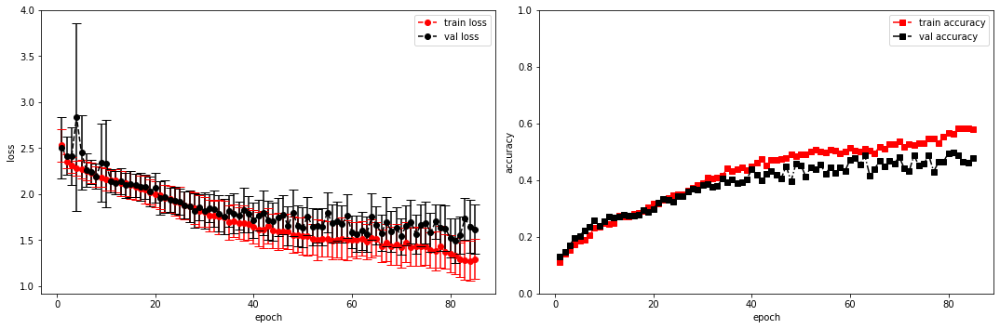

model saved


training epoch:  85
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [86/100], step [1/168],  Loss: 1.4329 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5376362800598145s
Epoch [86/100], step [17/168],  Loss: 1.2901 +/- 0.1993,  accuracy: 0.595703125, time elapsed = 6.238213300704956s
Epoch [86/100], step [33/168],  Loss: 1.1880 +/- 0.2399,  accuracy: 0.587890625, time elapsed = 6.2376649379730225s
Epoch [86/100], step [49/168],  Loss: 1.2882 +/- 0.1754,  accuracy: 0.572265625, time elapsed = 6.2388622760772705s
Epoch [86/100], step [65/168],  Loss: 1.2215 +/- 0.2048,  accuracy: 0.609375, time elapsed = 6.237610101699829s
Epoch [86/100], step [81/168],  Loss: 1.2356 +/- 0.1757,  accuracy: 0.587890625, time elapsed = 6.23730731010437s
Epoch [86/100], step [97/168],  Loss: 1.2451 +/- 0.2331,  accuracy: 0.59375, time elapsed = 6.237689018249512s
Epoch [86/100], step [113/168],  Loss: 1.2250 +/- 0.1581,  accuracy: 0.599609375, time elapsed = 6.237992763519287s
Epoch [86/100], step [129/168],  Loss: 1.2531 +/- 0.2199,  accuracy: 0.591796875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.598,  precision = 0.598 recall = 0.598 f1 = 0.598 ::: val: acc = 0.496,  precision = 0.496 recall = 0.496 time elapsed = 70.52097344398499s


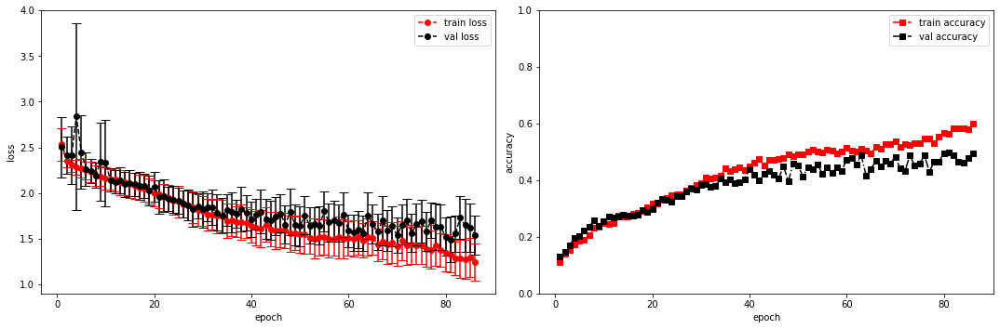

model saved


training epoch:  86
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [87/100], step [1/168],  Loss: 0.9066 +/- 0.0000,  accuracy: 0.04296875, time elapsed = 0.533228874206543s
Epoch [87/100], step [17/168],  Loss: 1.2067 +/- 0.2094,  accuracy: 0.607421875, time elapsed = 6.240020036697388s
Epoch [87/100], step [33/168],  Loss: 1.2322 +/- 0.2549,  accuracy: 0.595703125, time elapsed = 6.239870548248291s
Epoch [87/100], step [49/168],  Loss: 1.3611 +/- 0.1998,  accuracy: 0.568359375, time elapsed = 6.239551544189453s
Epoch [87/100], step [65/168],  Loss: 1.2410 +/- 0.2408,  accuracy: 0.57421875, time elapsed = 6.239684820175171s
Epoch [87/100], step [81/168],  Loss: 1.2279 +/- 0.1333,  accuracy: 0.625, time elapsed = 6.239369630813599s
Epoch [87/100], step [97/168],  Loss: 1.2637 +/- 0.1741,  accuracy: 0.59765625, time elapsed = 6.238723993301392s
Epoch [87/100], step [113/168],  Loss: 1.1696 +/- 0.1396,  accuracy: 0.603515625, time elapsed = 6.238958120346069s
Epoch [87/100], step [129/168],  Loss: 1.3169 +/- 0.2538,  accuracy: 0.556640625, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.586,  precision = 0.586 recall = 0.586 f1 = 0.586 ::: val: acc = 0.523,  precision = 0.523 recall = 0.523 time elapsed = 70.49910974502563s


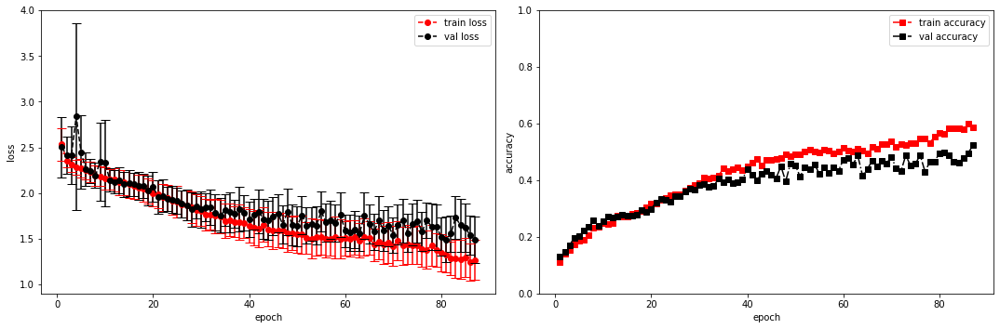

model saved


training epoch:  87
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [88/100], step [1/168],  Loss: 1.1752 +/- 0.0000,  accuracy: 0.037109375, time elapsed = 0.5379734039306641s
Epoch [88/100], step [17/168],  Loss: 1.0865 +/- 0.1677,  accuracy: 0.64453125, time elapsed = 6.238154172897339s
Epoch [88/100], step [33/168],  Loss: 1.2357 +/- 0.1815,  accuracy: 0.583984375, time elapsed = 6.240006923675537s
Epoch [88/100], step [49/168],  Loss: 1.2014 +/- 0.2012,  accuracy: 0.62109375, time elapsed = 6.23891282081604s
Epoch [88/100], step [65/168],  Loss: 1.1223 +/- 0.1522,  accuracy: 0.638671875, time elapsed = 6.239508628845215s
Epoch [88/100], step [81/168],  Loss: 1.1544 +/- 0.2303,  accuracy: 0.63671875, time elapsed = 6.237371444702148s
Epoch [88/100], step [97/168],  Loss: 1.2961 +/- 0.1677,  accuracy: 0.578125, time elapsed = 6.242354393005371s
Epoch [88/100], step [113/168],  Loss: 1.2900 +/- 0.2862,  accuracy: 0.5703125, time elapsed = 6.2498345375061035s
Epoch [88/100], step [129/168],  Loss: 1.2149 +/- 0.1794,  accuracy: 0.611328125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.610,  precision = 0.610 recall = 0.610 f1 = 0.610 ::: val: acc = 0.481,  precision = 0.481 recall = 0.481 time elapsed = 70.52204179763794s


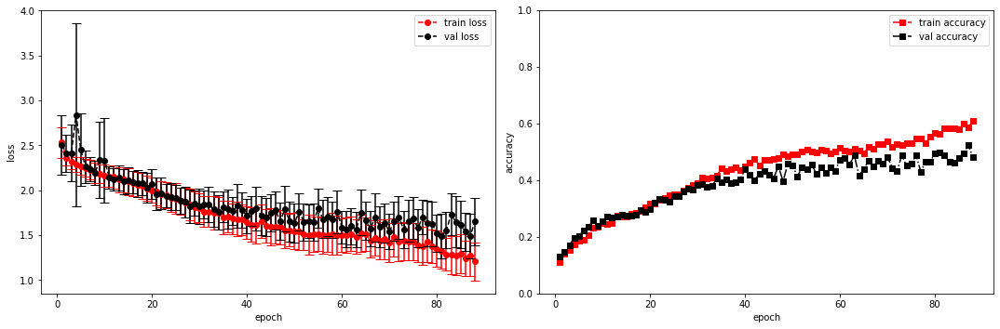

model saved
model saved


training epoch:  88
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [89/100], step [1/168],  Loss: 1.4285 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5516912937164307s
Epoch [89/100], step [17/168],  Loss: 1.2384 +/- 0.1509,  accuracy: 0.583984375, time elapsed = 6.239412784576416s
Epoch [89/100], step [33/168],  Loss: 1.2641 +/- 0.2284,  accuracy: 0.58984375, time elapsed = 6.2383201122283936s
Epoch [89/100], step [49/168],  Loss: 1.1119 +/- 0.1706,  accuracy: 0.646484375, time elapsed = 6.239405155181885s
Epoch [89/100], step [65/168],  Loss: 1.1646 +/- 0.1835,  accuracy: 0.6328125, time elapsed = 6.241543531417847s
Epoch [89/100], step [81/168],  Loss: 1.0893 +/- 0.2069,  accuracy: 0.65625, time elapsed = 6.242685556411743s
Epoch [89/100], step [97/168],  Loss: 1.1429 +/- 0.2051,  accuracy: 0.62109375, time elapsed = 6.240743398666382s
Epoch [89/100], step [113/168],  Loss: 1.1133 +/- 0.1676,  accuracy: 0.623046875, time elapsed = 6.240422010421753s
Epoch [89/100], step [129/168],  Loss: 1.1271 +/- 0.1911,  accuracy: 0.6171875, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.605,  precision = 0.605 recall = 0.605 f1 = 0.605 ::: val: acc = 0.447,  precision = 0.447 recall = 0.447 time elapsed = 70.62580180168152s


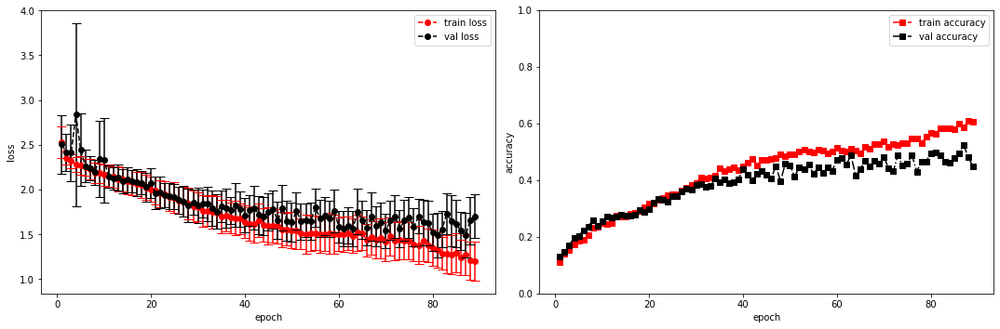

model saved
stopping early
device:  cuda
dataset metadata:  {'n_fft': 2048, 'hop_length': 512, 'n_mfcc': 40, 'notes': 'optional notes not passed'}
train model: data loaders initialized
sample shape =  (1, 40, 259)
model loaded
Layer (type:depth-idx)                   Output Shape              Param #
├─TripleConv: 1-1                        [-1, 8, 40, 259]          --
|    └─ConvBlock: 2-1                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-1              [-1, 8, 40, 259]          96
|    └─ConvBlock: 2-2                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-2              [-1, 8, 40, 259]          600
|    └─ConvBlock: 2-3                    [-1, 8, 40, 259]          --
|    |    └─Sequential: 3-3              [-1, 8, 40, 259]          600
├─ConvBlock: 1-2                         [-1, 8, 20, 129]          --
|    └─Sequential: 2-4                   [-1, 8, 20, 129]          --
|    |    └─Conv2d: 3-4                  [-1, 8, 40, 259]         

<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [1/100], step [1/168],  Loss: 3.1609 +/- 0.0000,  accuracy: 0.0, time elapsed = 0.5884532928466797s
Epoch [1/100], step [17/168],  Loss: 2.8704 +/- 0.1738,  accuracy: 0.07421875, time elapsed = 6.449719429016113s
Epoch [1/100], step [33/168],  Loss: 2.7711 +/- 0.1704,  accuracy: 0.099609375, time elapsed = 6.418990850448608s
Epoch [1/100], step [49/168],  Loss: 2.6158 +/- 0.1135,  accuracy: 0.125, time elapsed = 6.649874925613403s
Epoch [1/100], step [65/168],  Loss: 2.5250 +/- 0.1341,  accuracy: 0.111328125, time elapsed = 6.329319953918457s
Epoch [1/100], step [81/168],  Loss: 2.4911 +/- 0.1291,  accuracy: 0.126953125, time elapsed = 6.534857273101807s
Epoch [1/100], step [97/168],  Loss: 2.4808 +/- 0.0824,  accuracy: 0.119140625, time elapsed = 6.356319427490234s
Epoch [1/100], step [113/168],  Loss: 2.4014 +/- 0.0831,  accuracy: 0.123046875, time elapsed = 6.69078516960144s
Epoch [1/100], step [129/168],  Loss: 2.3796 +/- 0.0681,  accuracy: 0.126953125, time elapsed = 6.69671

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.123,  precision = 0.123 recall = 0.123 f1 = 0.123 ::: val: acc = 0.151,  precision = 0.151 recall = 0.151 time elapsed = 73.67243337631226s


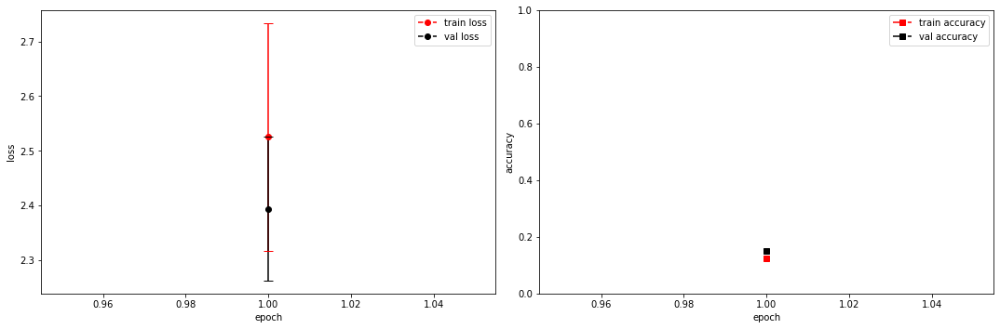

model saved


training epoch:  1
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [2/100], step [1/168],  Loss: 2.2198 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5533022880554199s
Epoch [2/100], step [17/168],  Loss: 2.3772 +/- 0.0638,  accuracy: 0.142578125, time elapsed = 6.571133136749268s
Epoch [2/100], step [33/168],  Loss: 2.3831 +/- 0.0918,  accuracy: 0.142578125, time elapsed = 6.527938365936279s
Epoch [2/100], step [49/168],  Loss: 2.2937 +/- 0.0735,  accuracy: 0.162109375, time elapsed = 6.287245988845825s
Epoch [2/100], step [65/168],  Loss: 2.3504 +/- 0.0790,  accuracy: 0.14453125, time elapsed = 6.249786138534546s
Epoch [2/100], step [81/168],  Loss: 2.3232 +/- 0.0988,  accuracy: 0.15625, time elapsed = 6.251311302185059s
Epoch [2/100], step [97/168],  Loss: 2.3378 +/- 0.0888,  accuracy: 0.146484375, time elapsed = 6.244575500488281s
Epoch [2/100], step [113/168],  Loss: 2.3111 +/- 0.0764,  accuracy: 0.169921875, time elapsed = 6.245284080505371s
Epoch [2/100], step [129/168],  Loss: 2.3276 +/- 0.0885,  accuracy: 0.162109375, time elapsed

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.156,  precision = 0.156 recall = 0.156 f1 = 0.156 ::: val: acc = 0.183,  precision = 0.183 recall = 0.183 time elapsed = 71.2534716129303s


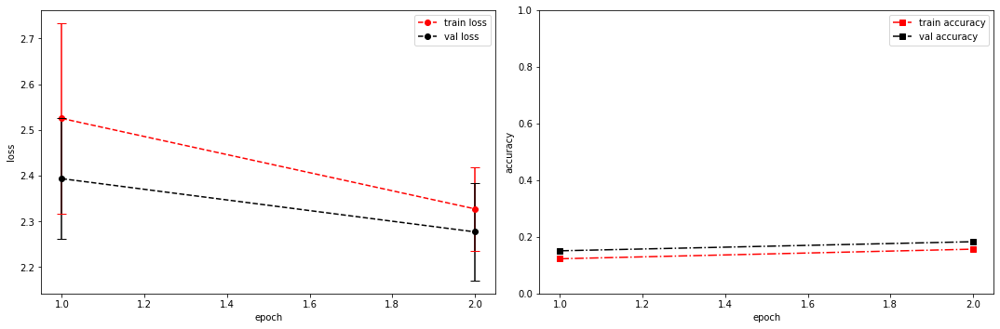

model saved


training epoch:  2
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [3/100], step [1/168],  Loss: 2.2236 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5610315799713135s
Epoch [3/100], step [17/168],  Loss: 2.3134 +/- 0.0976,  accuracy: 0.15625, time elapsed = 6.244393825531006s
Epoch [3/100], step [33/168],  Loss: 2.3231 +/- 0.1036,  accuracy: 0.16015625, time elapsed = 6.245122909545898s
Epoch [3/100], step [49/168],  Loss: 2.2341 +/- 0.0713,  accuracy: 0.216796875, time elapsed = 6.245798110961914s
Epoch [3/100], step [65/168],  Loss: 2.3544 +/- 0.0796,  accuracy: 0.140625, time elapsed = 6.245126485824585s
Epoch [3/100], step [81/168],  Loss: 2.3335 +/- 0.0764,  accuracy: 0.142578125, time elapsed = 6.245764970779419s
Epoch [3/100], step [97/168],  Loss: 2.3392 +/- 0.0645,  accuracy: 0.130859375, time elapsed = 6.245016574859619s
Epoch [3/100], step [113/168],  Loss: 2.2630 +/- 0.0791,  accuracy: 0.150390625, time elapsed = 6.245741844177246s
Epoch [3/100], step [129/168],  Loss: 2.2497 +/- 0.0665,  accuracy: 0.150390625, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.161,  precision = 0.161 recall = 0.161 f1 = 0.161 ::: val: acc = 0.182,  precision = 0.182 recall = 0.182 time elapsed = 70.68061780929565s


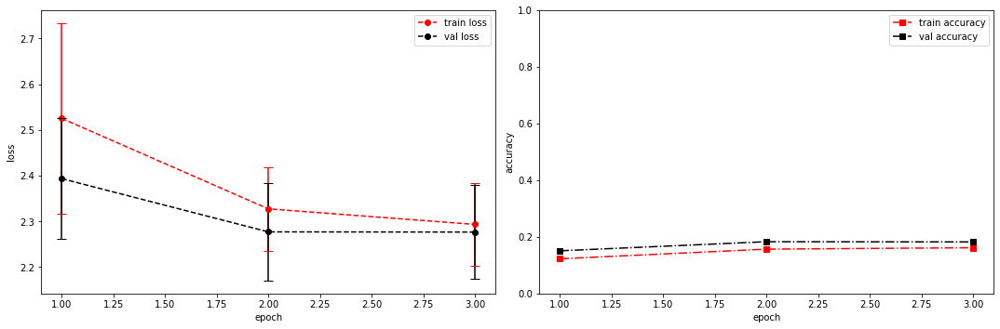

model saved


training epoch:  3
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [4/100], step [1/168],  Loss: 2.3723 +/- 0.0000,  accuracy: 0.00390625, time elapsed = 0.5416409969329834s
Epoch [4/100], step [17/168],  Loss: 2.2744 +/- 0.1063,  accuracy: 0.166015625, time elapsed = 6.242236375808716s
Epoch [4/100], step [33/168],  Loss: 2.2584 +/- 0.0840,  accuracy: 0.18359375, time elapsed = 6.243263483047485s
Epoch [4/100], step [49/168],  Loss: 2.2326 +/- 0.0982,  accuracy: 0.20703125, time elapsed = 6.243468284606934s
Epoch [4/100], step [65/168],  Loss: 2.2576 +/- 0.0810,  accuracy: 0.193359375, time elapsed = 6.243439435958862s
Epoch [4/100], step [81/168],  Loss: 2.2377 +/- 0.1042,  accuracy: 0.19921875, time elapsed = 6.244101047515869s
Epoch [4/100], step [97/168],  Loss: 2.2736 +/- 0.0876,  accuracy: 0.197265625, time elapsed = 6.2467944622039795s
Epoch [4/100], step [113/168],  Loss: 2.1846 +/- 0.0904,  accuracy: 0.212890625, time elapsed = 6.243059396743774s
Epoch [4/100], step [129/168],  Loss: 2.1957 +/- 0.0807,  accuracy: 0.21484375, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.197,  precision = 0.197 recall = 0.197 f1 = 0.197 ::: val: acc = 0.208,  precision = 0.208 recall = 0.208 time elapsed = 70.58753228187561s


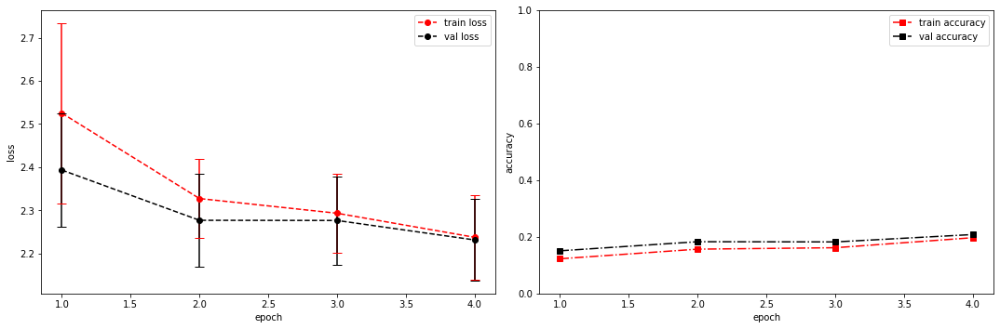

model saved


training epoch:  4
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [5/100], step [1/168],  Loss: 2.3109 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.6513521671295166s
Epoch [5/100], step [17/168],  Loss: 2.2279 +/- 0.1370,  accuracy: 0.21875, time elapsed = 6.244398832321167s
Epoch [5/100], step [33/168],  Loss: 2.2242 +/- 0.0847,  accuracy: 0.201171875, time elapsed = 6.245170831680298s
Epoch [5/100], step [49/168],  Loss: 2.2053 +/- 0.0946,  accuracy: 0.205078125, time elapsed = 6.24433159828186s
Epoch [5/100], step [65/168],  Loss: 2.2017 +/- 0.0678,  accuracy: 0.212890625, time elapsed = 6.246310710906982s
Epoch [5/100], step [81/168],  Loss: 2.1788 +/- 0.0980,  accuracy: 0.236328125, time elapsed = 6.248411178588867s
Epoch [5/100], step [97/168],  Loss: 2.1587 +/- 0.1016,  accuracy: 0.216796875, time elapsed = 6.259723663330078s
Epoch [5/100], step [113/168],  Loss: 2.1442 +/- 0.1178,  accuracy: 0.2421875, time elapsed = 6.267947435379028s
Epoch [5/100], step [129/168],  Loss: 2.1886 +/- 0.1259,  accuracy: 0.248046875, time elapsed 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.219,  precision = 0.219 recall = 0.219 f1 = 0.219 ::: val: acc = 0.212,  precision = 0.212 recall = 0.212 time elapsed = 70.7506320476532s


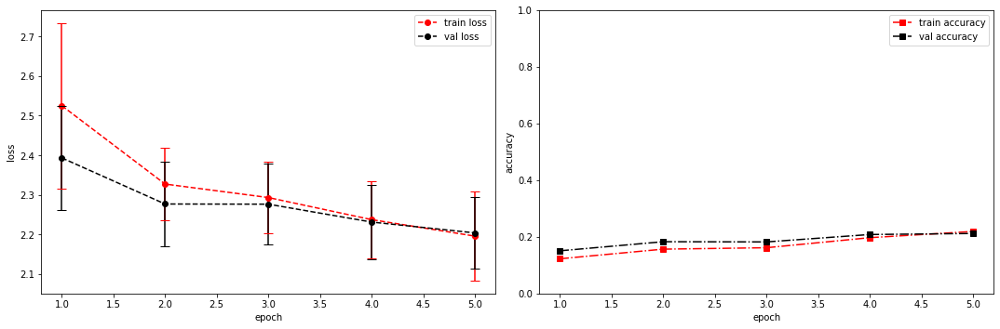

model saved


training epoch:  5
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [6/100], step [1/168],  Loss: 2.2126 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5438346862792969s
Epoch [6/100], step [17/168],  Loss: 2.1581 +/- 0.1145,  accuracy: 0.21875, time elapsed = 6.2439069747924805s
Epoch [6/100], step [33/168],  Loss: 2.1424 +/- 0.1176,  accuracy: 0.259765625, time elapsed = 6.245343208312988s
Epoch [6/100], step [49/168],  Loss: 2.1930 +/- 0.1242,  accuracy: 0.228515625, time elapsed = 6.248291015625s
Epoch [6/100], step [65/168],  Loss: 2.1546 +/- 0.0972,  accuracy: 0.2421875, time elapsed = 6.245813608169556s
Epoch [6/100], step [81/168],  Loss: 2.1832 +/- 0.1201,  accuracy: 0.1953125, time elapsed = 6.813634634017944s
Epoch [6/100], step [97/168],  Loss: 2.2215 +/- 0.0729,  accuracy: 0.1953125, time elapsed = 6.487529754638672s
Epoch [6/100], step [113/168],  Loss: 2.1260 +/- 0.1119,  accuracy: 0.2421875, time elapsed = 6.239837169647217s
Epoch [6/100], step [129/168],  Loss: 2.1732 +/- 0.1649,  accuracy: 0.248046875, time elapsed = 6.241792

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.223,  precision = 0.223 recall = 0.223 f1 = 0.223 ::: val: acc = 0.210,  precision = 0.210 recall = 0.210 time elapsed = 71.37768268585205s


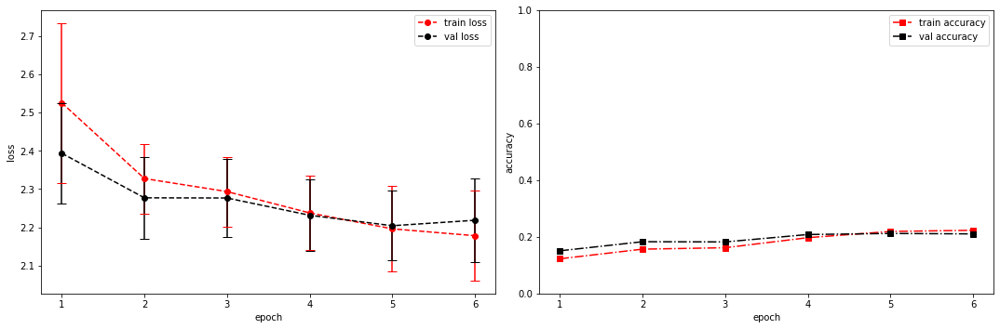

model saved


training epoch:  6
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [7/100], step [1/168],  Loss: 2.2870 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5344431400299072s
Epoch [7/100], step [17/168],  Loss: 2.1400 +/- 0.0609,  accuracy: 0.2265625, time elapsed = 6.244265079498291s
Epoch [7/100], step [33/168],  Loss: 2.1442 +/- 0.1010,  accuracy: 0.26171875, time elapsed = 6.242372274398804s
Epoch [7/100], step [49/168],  Loss: 2.1788 +/- 0.0909,  accuracy: 0.21875, time elapsed = 6.245748043060303s
Epoch [7/100], step [65/168],  Loss: 2.1593 +/- 0.1030,  accuracy: 0.236328125, time elapsed = 6.256484270095825s
Epoch [7/100], step [81/168],  Loss: 2.1479 +/- 0.1052,  accuracy: 0.259765625, time elapsed = 6.241577386856079s
Epoch [7/100], step [97/168],  Loss: 2.1994 +/- 0.1312,  accuracy: 0.21875, time elapsed = 6.2411158084869385s
Epoch [7/100], step [113/168],  Loss: 2.1777 +/- 0.0928,  accuracy: 0.228515625, time elapsed = 6.242349624633789s
Epoch [7/100], step [129/168],  Loss: 2.1870 +/- 0.1567,  accuracy: 0.232421875, time elapsed = 6

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.234,  precision = 0.234 recall = 0.234 f1 = 0.234 ::: val: acc = 0.234,  precision = 0.234 recall = 0.234 time elapsed = 70.55979752540588s


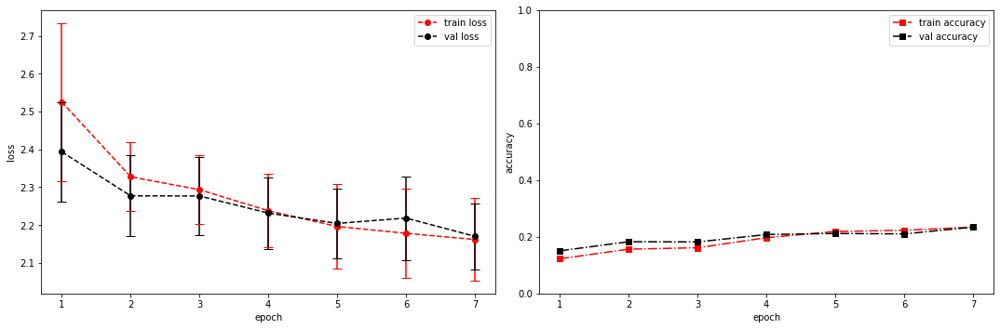

model saved


training epoch:  7
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [8/100], step [1/168],  Loss: 2.3723 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5870943069458008s
Epoch [8/100], step [17/168],  Loss: 2.1834 +/- 0.0990,  accuracy: 0.212890625, time elapsed = 6.242603302001953s
Epoch [8/100], step [33/168],  Loss: 2.1285 +/- 0.1029,  accuracy: 0.271484375, time elapsed = 6.243627548217773s
Epoch [8/100], step [49/168],  Loss: 2.1128 +/- 0.1118,  accuracy: 0.267578125, time elapsed = 6.2428576946258545s
Epoch [8/100], step [65/168],  Loss: 2.0844 +/- 0.0728,  accuracy: 0.25, time elapsed = 6.242795705795288s
Epoch [8/100], step [81/168],  Loss: 2.1026 +/- 0.1295,  accuracy: 0.271484375, time elapsed = 6.243768692016602s
Epoch [8/100], step [97/168],  Loss: 2.1138 +/- 0.1141,  accuracy: 0.251953125, time elapsed = 6.241556882858276s
Epoch [8/100], step [113/168],  Loss: 2.0955 +/- 0.1254,  accuracy: 0.25, time elapsed = 6.243628263473511s
Epoch [8/100], step [129/168],  Loss: 2.1639 +/- 0.1094,  accuracy: 0.240234375, time elapsed = 6.24

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.247,  precision = 0.247 recall = 0.247 f1 = 0.247 ::: val: acc = 0.235,  precision = 0.235 recall = 0.235 time elapsed = 70.65443873405457s


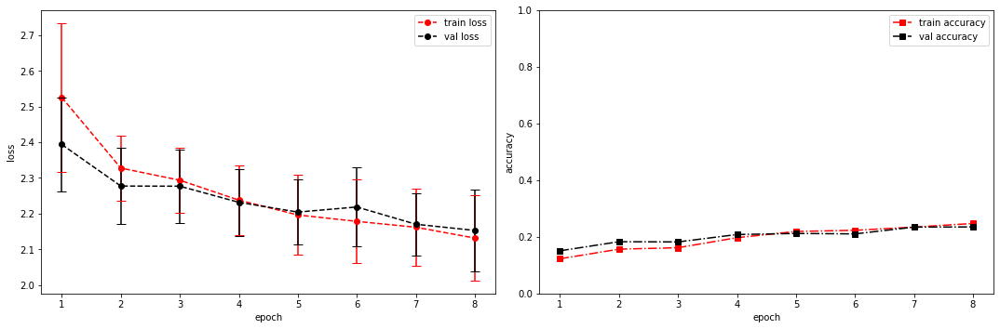

model saved


training epoch:  8
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [9/100], step [1/168],  Loss: 2.1009 +/- 0.0000,  accuracy: 0.015625, time elapsed = 0.5394480228424072s
Epoch [9/100], step [17/168],  Loss: 2.0785 +/- 0.1238,  accuracy: 0.279296875, time elapsed = 6.241516590118408s
Epoch [9/100], step [33/168],  Loss: 2.1213 +/- 0.1193,  accuracy: 0.248046875, time elapsed = 6.242905855178833s
Epoch [9/100], step [49/168],  Loss: 2.1044 +/- 0.1140,  accuracy: 0.2734375, time elapsed = 6.242206811904907s
Epoch [9/100], step [65/168],  Loss: 2.0600 +/- 0.1204,  accuracy: 0.29296875, time elapsed = 6.242088317871094s
Epoch [9/100], step [81/168],  Loss: 2.1072 +/- 0.1328,  accuracy: 0.2421875, time elapsed = 6.240841865539551s
Epoch [9/100], step [97/168],  Loss: 2.1177 +/- 0.0716,  accuracy: 0.21875, time elapsed = 6.239688396453857s
Epoch [9/100], step [113/168],  Loss: 2.1891 +/- 0.1608,  accuracy: 0.21484375, time elapsed = 6.2451348304748535s
Epoch [9/100], step [129/168],  Loss: 2.1178 +/- 0.1432,  accuracy: 0.26171875, time elapsed = 6.24

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.258,  precision = 0.258 recall = 0.258 f1 = 0.258 ::: val: acc = 0.218,  precision = 0.218 recall = 0.218 time elapsed = 70.53881978988647s


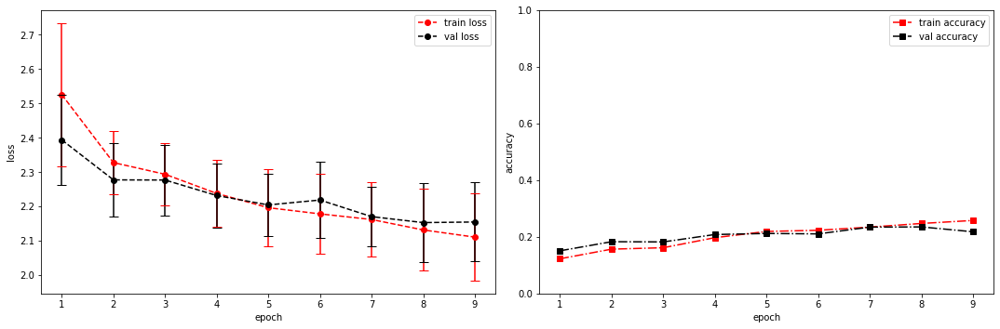

model saved


training epoch:  9
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [10/100], step [1/168],  Loss: 2.0931 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5442543029785156s
Epoch [10/100], step [17/168],  Loss: 2.0408 +/- 0.0867,  accuracy: 0.27734375, time elapsed = 6.243159770965576s
Epoch [10/100], step [33/168],  Loss: 2.1250 +/- 0.0974,  accuracy: 0.2265625, time elapsed = 6.242768049240112s
Epoch [10/100], step [49/168],  Loss: 2.1024 +/- 0.1217,  accuracy: 0.26171875, time elapsed = 6.242792844772339s
Epoch [10/100], step [65/168],  Loss: 2.0976 +/- 0.1438,  accuracy: 0.265625, time elapsed = 6.242159366607666s
Epoch [10/100], step [81/168],  Loss: 2.1028 +/- 0.1104,  accuracy: 0.259765625, time elapsed = 6.24329137802124s
Epoch [10/100], step [97/168],  Loss: 2.0889 +/- 0.1253,  accuracy: 0.271484375, time elapsed = 6.242952823638916s
Epoch [10/100], step [113/168],  Loss: 2.0610 +/- 0.0839,  accuracy: 0.27734375, time elapsed = 6.2456018924713135s
Epoch [10/100], step [129/168],  Loss: 2.0176 +/- 0.1207,  accuracy: 0.302734375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.268,  precision = 0.268 recall = 0.268 f1 = 0.268 ::: val: acc = 0.252,  precision = 0.252 recall = 0.252 time elapsed = 70.56246066093445s


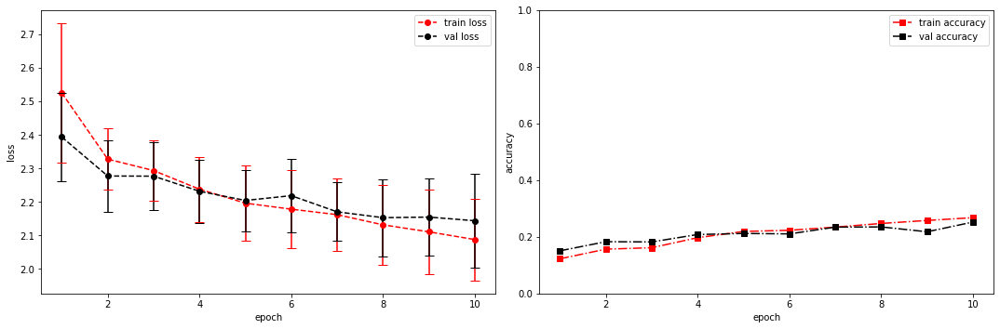

model saved


training epoch:  10
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [11/100], step [1/168],  Loss: 2.1566 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5380854606628418s
Epoch [11/100], step [17/168],  Loss: 2.0327 +/- 0.1364,  accuracy: 0.310546875, time elapsed = 6.240884065628052s
Epoch [11/100], step [33/168],  Loss: 2.0730 +/- 0.1301,  accuracy: 0.2890625, time elapsed = 6.240542411804199s
Epoch [11/100], step [49/168],  Loss: 2.0699 +/- 0.1442,  accuracy: 0.275390625, time elapsed = 6.242296934127808s
Epoch [11/100], step [65/168],  Loss: 2.0965 +/- 0.0895,  accuracy: 0.216796875, time elapsed = 6.2399702072143555s
Epoch [11/100], step [81/168],  Loss: 2.1095 +/- 0.1111,  accuracy: 0.240234375, time elapsed = 6.240550518035889s
Epoch [11/100], step [97/168],  Loss: 2.0751 +/- 0.1111,  accuracy: 0.275390625, time elapsed = 6.239759922027588s
Epoch [11/100], step [113/168],  Loss: 2.0950 +/- 0.0833,  accuracy: 0.30078125, time elapsed = 6.241984128952026s
Epoch [11/100], step [129/168],  Loss: 2.0903 +/- 0.1412,  accuracy: 0.28125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.271,  precision = 0.271 recall = 0.271 f1 = 0.271 ::: val: acc = 0.257,  precision = 0.257 recall = 0.257 time elapsed = 70.52804803848267s


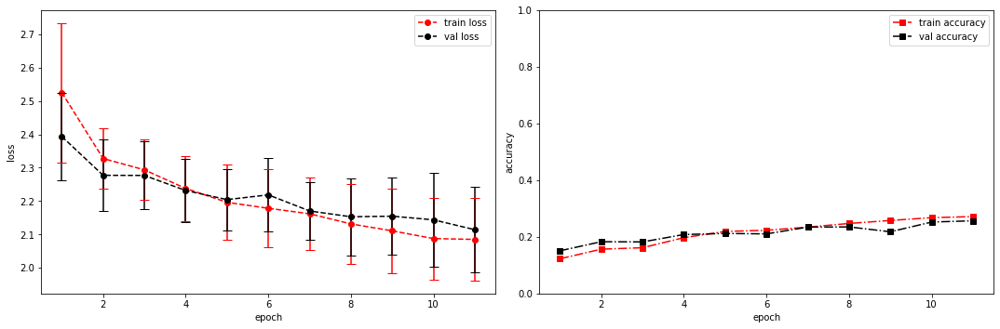

model saved


training epoch:  11
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [12/100], step [1/168],  Loss: 2.1649 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5766053199768066s
Epoch [12/100], step [17/168],  Loss: 2.0342 +/- 0.1010,  accuracy: 0.267578125, time elapsed = 6.243662357330322s
Epoch [12/100], step [33/168],  Loss: 2.1416 +/- 0.1282,  accuracy: 0.216796875, time elapsed = 6.243080377578735s
Epoch [12/100], step [49/168],  Loss: 2.0549 +/- 0.1288,  accuracy: 0.27734375, time elapsed = 6.243544578552246s
Epoch [12/100], step [65/168],  Loss: 2.0215 +/- 0.1221,  accuracy: 0.26953125, time elapsed = 6.258651494979858s
Epoch [12/100], step [81/168],  Loss: 2.0393 +/- 0.1463,  accuracy: 0.318359375, time elapsed = 6.245000123977661s
Epoch [12/100], step [97/168],  Loss: 2.0261 +/- 0.0801,  accuracy: 0.3046875, time elapsed = 6.243099927902222s
Epoch [12/100], step [113/168],  Loss: 2.0987 +/- 0.1207,  accuracy: 0.29296875, time elapsed = 6.24306845664978s
Epoch [12/100], step [129/168],  Loss: 2.0523 +/- 0.1369,  accuracy: 0.29296875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.282,  precision = 0.282 recall = 0.282 f1 = 0.282 ::: val: acc = 0.268,  precision = 0.268 recall = 0.268 time elapsed = 70.6038646697998s


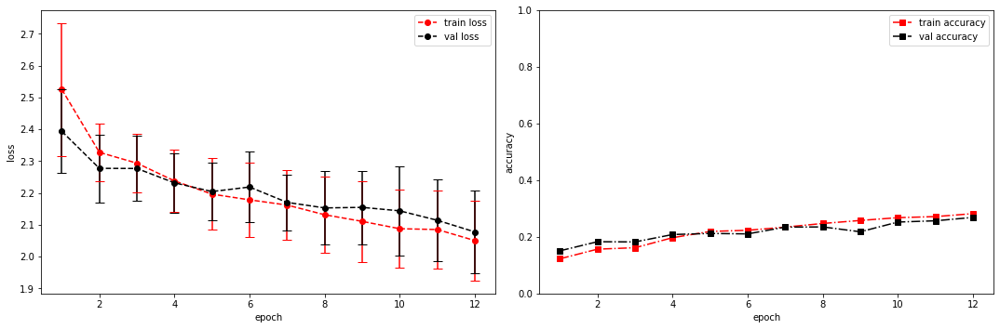

model saved


training epoch:  12
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [13/100], step [1/168],  Loss: 1.9297 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5460062026977539s
Epoch [13/100], step [17/168],  Loss: 2.0311 +/- 0.1253,  accuracy: 0.271484375, time elapsed = 6.241092681884766s
Epoch [13/100], step [33/168],  Loss: 1.9902 +/- 0.1396,  accuracy: 0.30859375, time elapsed = 6.241415977478027s
Epoch [13/100], step [49/168],  Loss: 1.9649 +/- 0.1332,  accuracy: 0.306640625, time elapsed = 6.2399773597717285s
Epoch [13/100], step [65/168],  Loss: 2.0558 +/- 0.1424,  accuracy: 0.283203125, time elapsed = 6.240455627441406s
Epoch [13/100], step [81/168],  Loss: 2.0612 +/- 0.1348,  accuracy: 0.26953125, time elapsed = 6.240313529968262s
Epoch [13/100], step [97/168],  Loss: 1.9923 +/- 0.1612,  accuracy: 0.3046875, time elapsed = 6.2410454750061035s
Epoch [13/100], step [113/168],  Loss: 2.0440 +/- 0.1249,  accuracy: 0.3046875, time elapsed = 6.239868640899658s
Epoch [13/100], step [129/168],  Loss: 2.0205 +/- 0.1170,  accuracy: 0.318359375, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.299,  precision = 0.299 recall = 0.299 f1 = 0.299 ::: val: acc = 0.239,  precision = 0.239 recall = 0.239 time elapsed = 70.56263828277588s


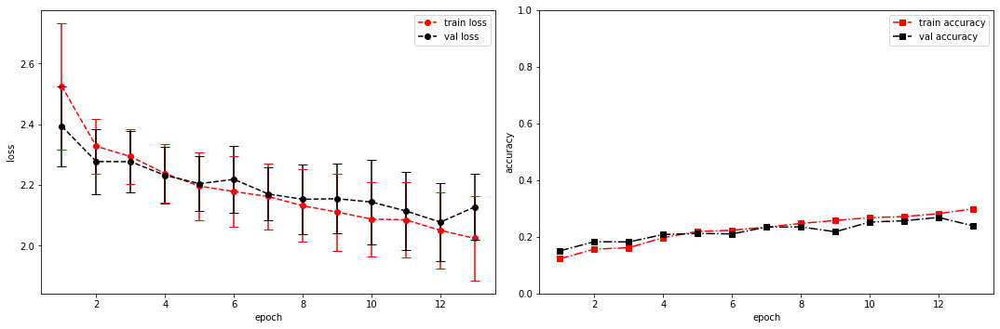

model saved


training epoch:  13
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [14/100], step [1/168],  Loss: 2.2603 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5657656192779541s
Epoch [14/100], step [17/168],  Loss: 2.0397 +/- 0.1600,  accuracy: 0.296875, time elapsed = 6.260043382644653s
Epoch [14/100], step [33/168],  Loss: 2.0347 +/- 0.1071,  accuracy: 0.302734375, time elapsed = 6.242445468902588s
Epoch [14/100], step [49/168],  Loss: 1.9778 +/- 0.1496,  accuracy: 0.31640625, time elapsed = 6.241943359375s
Epoch [14/100], step [65/168],  Loss: 2.0271 +/- 0.1934,  accuracy: 0.318359375, time elapsed = 6.241748094558716s
Epoch [14/100], step [81/168],  Loss: 2.0310 +/- 0.1350,  accuracy: 0.31640625, time elapsed = 6.242499828338623s
Epoch [14/100], step [97/168],  Loss: 2.0087 +/- 0.1341,  accuracy: 0.306640625, time elapsed = 6.310297966003418s
Epoch [14/100], step [113/168],  Loss: 2.0130 +/- 0.1443,  accuracy: 0.298828125, time elapsed = 6.438936471939087s
Epoch [14/100], step [129/168],  Loss: 2.0030 +/- 0.1552,  accuracy: 0.29296875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.309,  precision = 0.309 recall = 0.309 f1 = 0.309 ::: val: acc = 0.280,  precision = 0.280 recall = 0.280 time elapsed = 70.91410660743713s


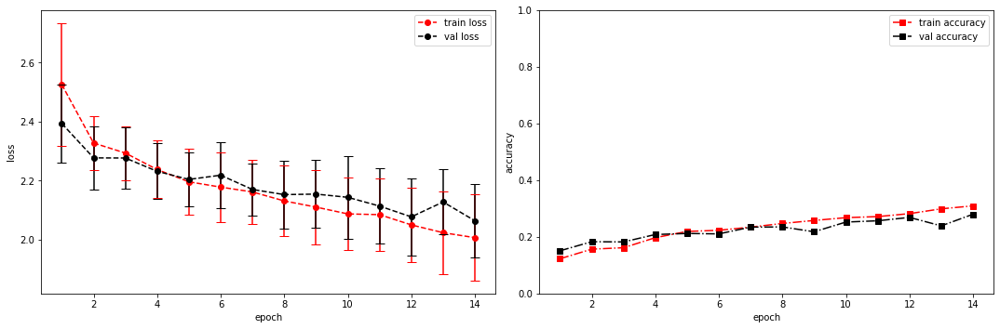

model saved


training epoch:  14
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [15/100], step [1/168],  Loss: 1.8699 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5432734489440918s
Epoch [15/100], step [17/168],  Loss: 2.0565 +/- 0.1734,  accuracy: 0.30859375, time elapsed = 6.307591915130615s
Epoch [15/100], step [33/168],  Loss: 1.9620 +/- 0.1294,  accuracy: 0.318359375, time elapsed = 6.240352153778076s
Epoch [15/100], step [49/168],  Loss: 1.9726 +/- 0.1431,  accuracy: 0.306640625, time elapsed = 6.241156339645386s
Epoch [15/100], step [65/168],  Loss: 2.0465 +/- 0.1130,  accuracy: 0.2734375, time elapsed = 6.241075277328491s
Epoch [15/100], step [81/168],  Loss: 1.9452 +/- 0.2153,  accuracy: 0.349609375, time elapsed = 6.2403035163879395s
Epoch [15/100], step [97/168],  Loss: 1.9614 +/- 0.1722,  accuracy: 0.341796875, time elapsed = 6.242041110992432s
Epoch [15/100], step [113/168],  Loss: 2.0277 +/- 0.1532,  accuracy: 0.3125, time elapsed = 6.240538120269775s
Epoch [15/100], step [129/168],  Loss: 2.0272 +/- 0.1527,  accuracy: 0.302734375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.310,  precision = 0.310 recall = 0.310 f1 = 0.310 ::: val: acc = 0.287,  precision = 0.287 recall = 0.287 time elapsed = 70.61476683616638s


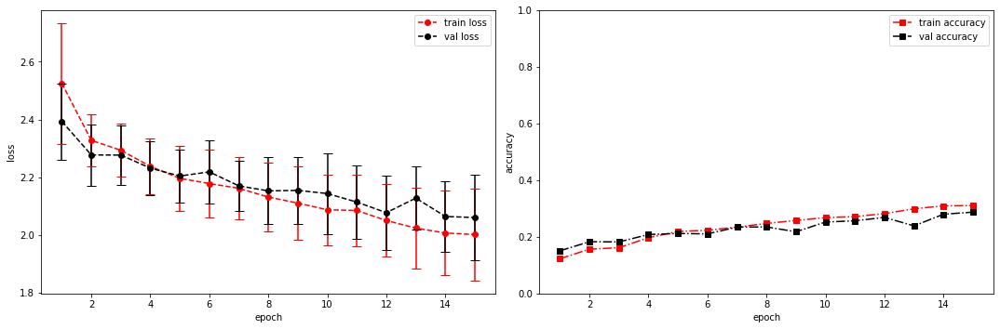

model saved


training epoch:  15
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [16/100], step [1/168],  Loss: 2.2113 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5451323986053467s
Epoch [16/100], step [17/168],  Loss: 1.9250 +/- 0.1558,  accuracy: 0.345703125, time elapsed = 6.240338325500488s
Epoch [16/100], step [33/168],  Loss: 2.0443 +/- 0.1792,  accuracy: 0.314453125, time elapsed = 6.240133285522461s
Epoch [16/100], step [49/168],  Loss: 1.9388 +/- 0.1231,  accuracy: 0.328125, time elapsed = 6.23851203918457s
Epoch [16/100], step [65/168],  Loss: 1.9933 +/- 0.1326,  accuracy: 0.32421875, time elapsed = 6.242339611053467s
Epoch [16/100], step [81/168],  Loss: 1.9626 +/- 0.1344,  accuracy: 0.34375, time elapsed = 6.241674423217773s
Epoch [16/100], step [97/168],  Loss: 1.9177 +/- 0.1236,  accuracy: 0.3203125, time elapsed = 6.240414381027222s
Epoch [16/100], step [113/168],  Loss: 1.9330 +/- 0.1540,  accuracy: 0.3515625, time elapsed = 6.241230249404907s
Epoch [16/100], step [129/168],  Loss: 1.9548 +/- 0.1237,  accuracy: 0.326171875, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.327,  precision = 0.327 recall = 0.327 f1 = 0.327 ::: val: acc = 0.147,  precision = 0.147 recall = 0.147 time elapsed = 70.55444574356079s


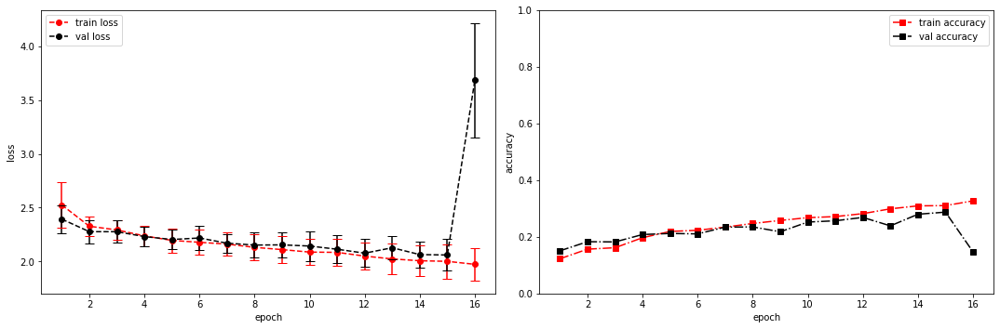

model saved
model saved


training epoch:  16
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [17/100], step [1/168],  Loss: 2.3549 +/- 0.0000,  accuracy: 0.01171875, time elapsed = 0.5477609634399414s
Epoch [17/100], step [17/168],  Loss: 2.1205 +/- 0.0857,  accuracy: 0.28515625, time elapsed = 6.241288423538208s
Epoch [17/100], step [33/168],  Loss: 2.0919 +/- 0.1253,  accuracy: 0.26953125, time elapsed = 6.242664098739624s
Epoch [17/100], step [49/168],  Loss: 2.0273 +/- 0.1341,  accuracy: 0.291015625, time elapsed = 6.243390083312988s
Epoch [17/100], step [65/168],  Loss: 1.9646 +/- 0.1262,  accuracy: 0.298828125, time elapsed = 6.244868278503418s
Epoch [17/100], step [81/168],  Loss: 2.0208 +/- 0.1425,  accuracy: 0.2890625, time elapsed = 6.25085973739624s
Epoch [17/100], step [97/168],  Loss: 1.9977 +/- 0.1299,  accuracy: 0.306640625, time elapsed = 6.240496397018433s
Epoch [17/100], step [113/168],  Loss: 2.0408 +/- 0.2009,  accuracy: 0.30859375, time elapsed = 6.241201877593994s
Epoch [17/100], step [129/168],  Loss: 1.9831 +/- 0.1624,  accuracy: 0.32421875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.301,  precision = 0.301 recall = 0.301 f1 = 0.301 ::: val: acc = 0.304,  precision = 0.304 recall = 0.304 time elapsed = 70.71985816955566s


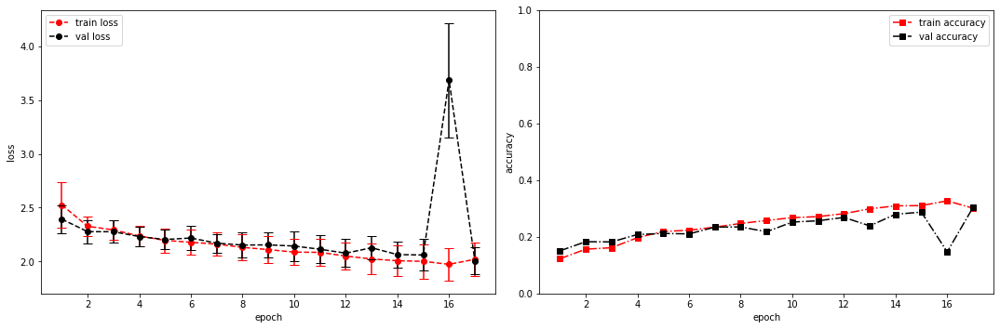

model saved


training epoch:  17
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [18/100], step [1/168],  Loss: 1.8014 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5706894397735596s
Epoch [18/100], step [17/168],  Loss: 1.9391 +/- 0.1059,  accuracy: 0.3359375, time elapsed = 6.24462103843689s
Epoch [18/100], step [33/168],  Loss: 1.9625 +/- 0.1433,  accuracy: 0.326171875, time elapsed = 6.24450159072876s
Epoch [18/100], step [49/168],  Loss: 1.9458 +/- 0.1596,  accuracy: 0.33203125, time elapsed = 6.244184732437134s
Epoch [18/100], step [65/168],  Loss: 1.9291 +/- 0.1703,  accuracy: 0.314453125, time elapsed = 6.243980169296265s
Epoch [18/100], step [81/168],  Loss: 1.9410 +/- 0.1378,  accuracy: 0.333984375, time elapsed = 6.243677616119385s
Epoch [18/100], step [97/168],  Loss: 1.9317 +/- 0.1822,  accuracy: 0.3359375, time elapsed = 6.243746042251587s
Epoch [18/100], step [113/168],  Loss: 2.0014 +/- 0.1597,  accuracy: 0.326171875, time elapsed = 6.2435524463653564s
Epoch [18/100], step [129/168],  Loss: 1.9578 +/- 0.2151,  accuracy: 0.3203125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.333,  precision = 0.333 recall = 0.333 f1 = 0.333 ::: val: acc = 0.318,  precision = 0.318 recall = 0.318 time elapsed = 71.00870084762573s


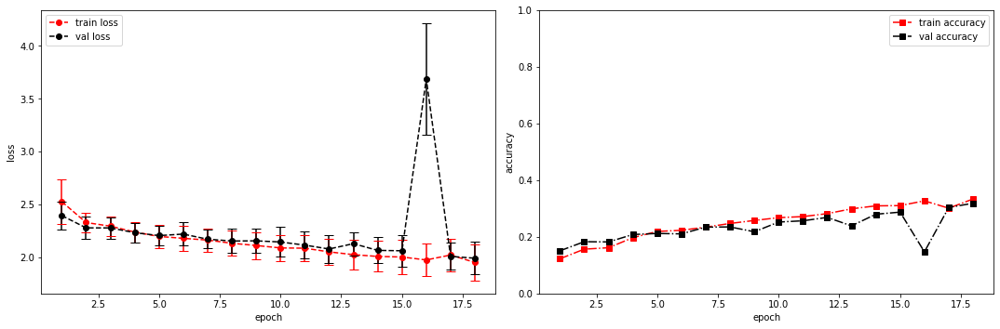

model saved


training epoch:  18
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [19/100], step [1/168],  Loss: 1.8283 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5416891574859619s
Epoch [19/100], step [17/168],  Loss: 1.9219 +/- 0.1089,  accuracy: 0.345703125, time elapsed = 6.254179000854492s
Epoch [19/100], step [33/168],  Loss: 1.8114 +/- 0.1289,  accuracy: 0.380859375, time elapsed = 6.240968704223633s
Epoch [19/100], step [49/168],  Loss: 1.9213 +/- 0.1636,  accuracy: 0.34375, time elapsed = 6.239607810974121s
Epoch [19/100], step [65/168],  Loss: 1.8896 +/- 0.1224,  accuracy: 0.34765625, time elapsed = 6.241231203079224s
Epoch [19/100], step [81/168],  Loss: 1.9233 +/- 0.1343,  accuracy: 0.32421875, time elapsed = 6.241323232650757s
Epoch [19/100], step [97/168],  Loss: 1.9767 +/- 0.1511,  accuracy: 0.326171875, time elapsed = 6.241805553436279s
Epoch [19/100], step [113/168],  Loss: 1.9514 +/- 0.1404,  accuracy: 0.33203125, time elapsed = 6.241492509841919s
Epoch [19/100], step [129/168],  Loss: 1.8574 +/- 0.1091,  accuracy: 0.373046875, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.342,  precision = 0.342 recall = 0.342 f1 = 0.342 ::: val: acc = 0.322,  precision = 0.322 recall = 0.322 time elapsed = 70.56618237495422s


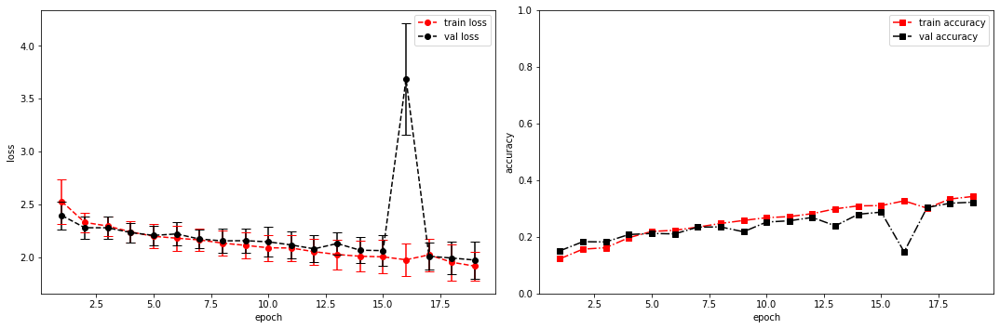

model saved


training epoch:  19
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [20/100], step [1/168],  Loss: 1.8585 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5495936870574951s
Epoch [20/100], step [17/168],  Loss: 1.8716 +/- 0.1810,  accuracy: 0.353515625, time elapsed = 6.242584228515625s
Epoch [20/100], step [33/168],  Loss: 1.8949 +/- 0.1466,  accuracy: 0.353515625, time elapsed = 6.242995262145996s
Epoch [20/100], step [49/168],  Loss: 1.8626 +/- 0.1250,  accuracy: 0.337890625, time elapsed = 6.242565631866455s
Epoch [20/100], step [65/168],  Loss: 1.8543 +/- 0.1361,  accuracy: 0.359375, time elapsed = 6.242746353149414s
Epoch [20/100], step [81/168],  Loss: 1.9591 +/- 0.1477,  accuracy: 0.318359375, time elapsed = 6.244019508361816s
Epoch [20/100], step [97/168],  Loss: 1.8947 +/- 0.1005,  accuracy: 0.345703125, time elapsed = 6.244195461273193s
Epoch [20/100], step [113/168],  Loss: 1.8493 +/- 0.1499,  accuracy: 0.404296875, time elapsed = 6.24300479888916s
Epoch [20/100], step [129/168],  Loss: 1.9112 +/- 0.1747,  accuracy: 0.357421875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.354,  precision = 0.354 recall = 0.354 f1 = 0.354 ::: val: acc = 0.322,  precision = 0.322 recall = 0.322 time elapsed = 70.58828616142273s


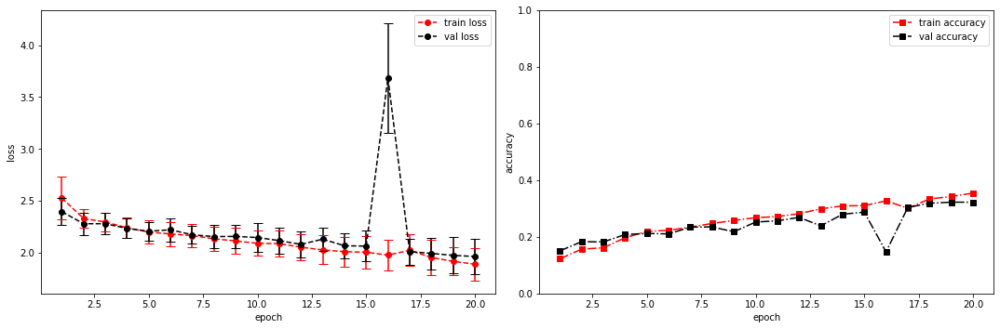

model saved


training epoch:  20
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [21/100], step [1/168],  Loss: 2.1335 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5362658500671387s
Epoch [21/100], step [17/168],  Loss: 1.7689 +/- 0.1247,  accuracy: 0.40625, time elapsed = 6.241942882537842s
Epoch [21/100], step [33/168],  Loss: 1.8326 +/- 0.1873,  accuracy: 0.392578125, time elapsed = 6.24168586730957s
Epoch [21/100], step [49/168],  Loss: 1.8482 +/- 0.1240,  accuracy: 0.38671875, time elapsed = 6.241858243942261s
Epoch [21/100], step [65/168],  Loss: 1.8452 +/- 0.1049,  accuracy: 0.36328125, time elapsed = 6.241077184677124s
Epoch [21/100], step [81/168],  Loss: 1.8472 +/- 0.1873,  accuracy: 0.369140625, time elapsed = 6.244483709335327s
Epoch [21/100], step [97/168],  Loss: 1.8787 +/- 0.1555,  accuracy: 0.3359375, time elapsed = 6.241536378860474s
Epoch [21/100], step [113/168],  Loss: 1.8385 +/- 0.1865,  accuracy: 0.369140625, time elapsed = 6.243066310882568s
Epoch [21/100], step [129/168],  Loss: 1.8612 +/- 0.1665,  accuracy: 0.36328125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.372,  precision = 0.372 recall = 0.372 f1 = 0.372 ::: val: acc = 0.345,  precision = 0.345 recall = 0.345 time elapsed = 70.5442636013031s


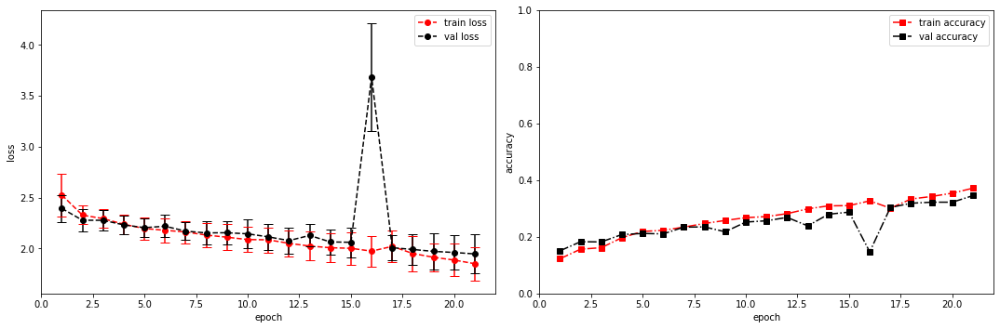

model saved


training epoch:  21
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [22/100], step [1/168],  Loss: 1.9768 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5377814769744873s
Epoch [22/100], step [17/168],  Loss: 1.7829 +/- 0.1475,  accuracy: 0.4140625, time elapsed = 6.243192195892334s
Epoch [22/100], step [33/168],  Loss: 1.8825 +/- 0.1783,  accuracy: 0.357421875, time elapsed = 6.2435808181762695s
Epoch [22/100], step [49/168],  Loss: 1.8674 +/- 0.1225,  accuracy: 0.3515625, time elapsed = 6.243566513061523s
Epoch [22/100], step [65/168],  Loss: 1.8636 +/- 0.1708,  accuracy: 0.3515625, time elapsed = 6.243105173110962s
Epoch [22/100], step [81/168],  Loss: 1.8932 +/- 0.0913,  accuracy: 0.326171875, time elapsed = 6.254709243774414s
Epoch [22/100], step [97/168],  Loss: 1.7713 +/- 0.1640,  accuracy: 0.388671875, time elapsed = 6.252029657363892s
Epoch [22/100], step [113/168],  Loss: 1.8836 +/- 0.2004,  accuracy: 0.36328125, time elapsed = 6.2424516677856445s
Epoch [22/100], step [129/168],  Loss: 1.8490 +/- 0.1699,  accuracy: 0.349609375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.367,  precision = 0.367 recall = 0.367 f1 = 0.367 ::: val: acc = 0.363,  precision = 0.363 recall = 0.363 time elapsed = 70.59023213386536s


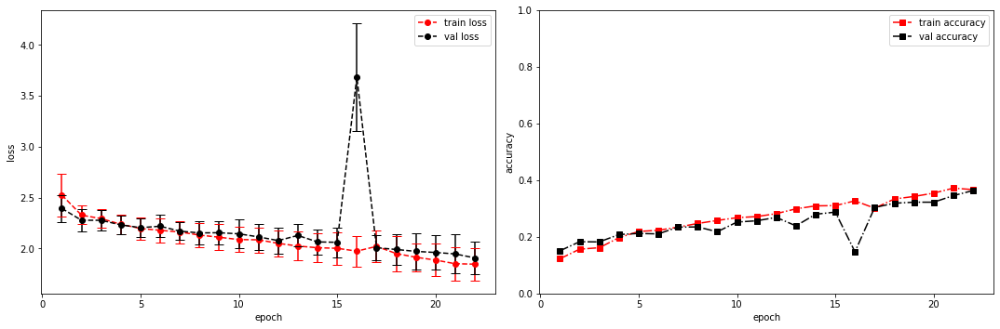

model saved


training epoch:  22
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [23/100], step [1/168],  Loss: 1.6468 +/- 0.0000,  accuracy: 0.01953125, time elapsed = 0.5507724285125732s
Epoch [23/100], step [17/168],  Loss: 1.8162 +/- 0.1447,  accuracy: 0.359375, time elapsed = 6.245906352996826s
Epoch [23/100], step [33/168],  Loss: 1.7902 +/- 0.1691,  accuracy: 0.384765625, time elapsed = 6.243744134902954s
Epoch [23/100], step [49/168],  Loss: 1.8572 +/- 0.1425,  accuracy: 0.359375, time elapsed = 6.244287967681885s
Epoch [23/100], step [65/168],  Loss: 1.8236 +/- 0.1655,  accuracy: 0.39453125, time elapsed = 6.249025106430054s
Epoch [23/100], step [81/168],  Loss: 1.8388 +/- 0.1714,  accuracy: 0.396484375, time elapsed = 6.2466371059417725s
Epoch [23/100], step [97/168],  Loss: 1.7679 +/- 0.1347,  accuracy: 0.419921875, time elapsed = 6.245770215988159s
Epoch [23/100], step [113/168],  Loss: 1.9175 +/- 0.1539,  accuracy: 0.345703125, time elapsed = 6.243144273757935s
Epoch [23/100], step [129/168],  Loss: 1.7772 +/- 0.1377,  accuracy: 0.40234375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.384,  precision = 0.384 recall = 0.384 f1 = 0.384 ::: val: acc = 0.341,  precision = 0.341 recall = 0.341 time elapsed = 70.60407972335815s


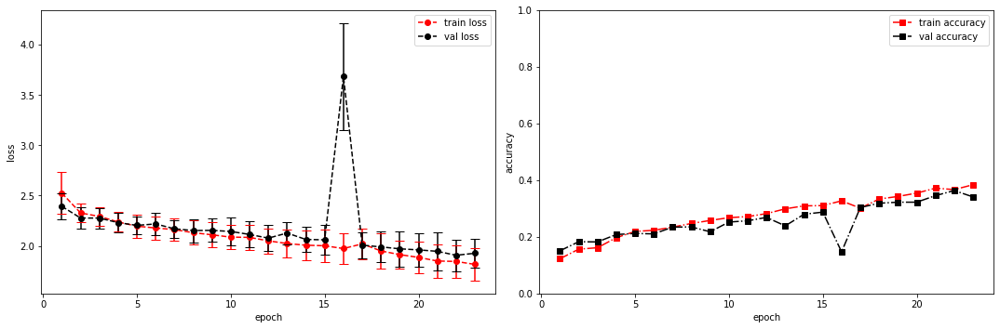

model saved


training epoch:  23
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [24/100], step [1/168],  Loss: 2.0122 +/- 0.0000,  accuracy: 0.017578125, time elapsed = 0.5410850048065186s
Epoch [24/100], step [17/168],  Loss: 1.7673 +/- 0.1413,  accuracy: 0.404296875, time elapsed = 6.2443366050720215s
Epoch [24/100], step [33/168],  Loss: 1.8776 +/- 0.2088,  accuracy: 0.3828125, time elapsed = 6.255459308624268s
Epoch [24/100], step [49/168],  Loss: 1.7691 +/- 0.1452,  accuracy: 0.3984375, time elapsed = 6.241527318954468s
Epoch [24/100], step [65/168],  Loss: 1.8521 +/- 0.2031,  accuracy: 0.35546875, time elapsed = 6.24259352684021s
Epoch [24/100], step [81/168],  Loss: 1.7829 +/- 0.1626,  accuracy: 0.404296875, time elapsed = 6.242481470108032s
Epoch [24/100], step [97/168],  Loss: 1.8177 +/- 0.1673,  accuracy: 0.392578125, time elapsed = 6.2419774532318115s
Epoch [24/100], step [113/168],  Loss: 1.7070 +/- 0.1532,  accuracy: 0.40625, time elapsed = 6.242493152618408s
Epoch [24/100], step [129/168],  Loss: 1.7946 +/- 0.2057,  accuracy: 0.3828125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.390,  precision = 0.390 recall = 0.390 f1 = 0.390 ::: val: acc = 0.356,  precision = 0.356 recall = 0.356 time elapsed = 70.57398128509521s


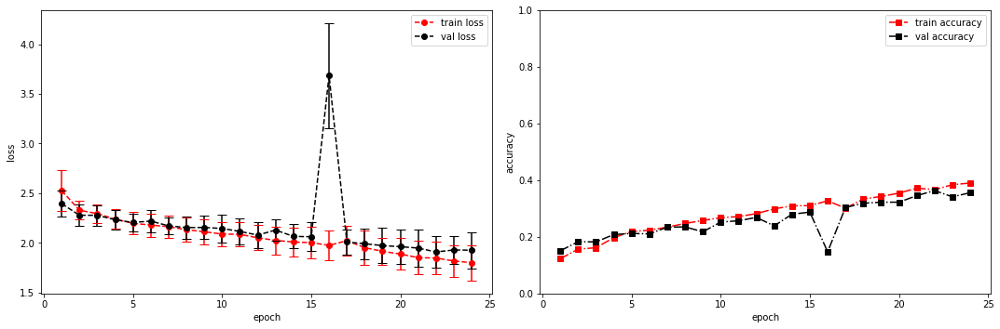

model saved


training epoch:  24
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [25/100], step [1/168],  Loss: 1.7487 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5499320030212402s
Epoch [25/100], step [17/168],  Loss: 1.7212 +/- 0.1764,  accuracy: 0.404296875, time elapsed = 6.240435361862183s
Epoch [25/100], step [33/168],  Loss: 1.7375 +/- 0.1177,  accuracy: 0.40234375, time elapsed = 6.24007248878479s
Epoch [25/100], step [49/168],  Loss: 1.7952 +/- 0.2176,  accuracy: 0.388671875, time elapsed = 6.239628553390503s
Epoch [25/100], step [65/168],  Loss: 1.7142 +/- 0.1282,  accuracy: 0.416015625, time elapsed = 6.240255355834961s
Epoch [25/100], step [81/168],  Loss: 1.7084 +/- 0.1815,  accuracy: 0.427734375, time elapsed = 6.244808673858643s
Epoch [25/100], step [97/168],  Loss: 1.8013 +/- 0.2048,  accuracy: 0.388671875, time elapsed = 6.244116306304932s
Epoch [25/100], step [113/168],  Loss: 1.8018 +/- 0.1999,  accuracy: 0.37890625, time elapsed = 6.242419481277466s
Epoch [25/100], step [129/168],  Loss: 1.8863 +/- 0.2056,  accuracy: 0.3671875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.393,  precision = 0.393 recall = 0.393 f1 = 0.393 ::: val: acc = 0.353,  precision = 0.353 recall = 0.353 time elapsed = 70.57247185707092s


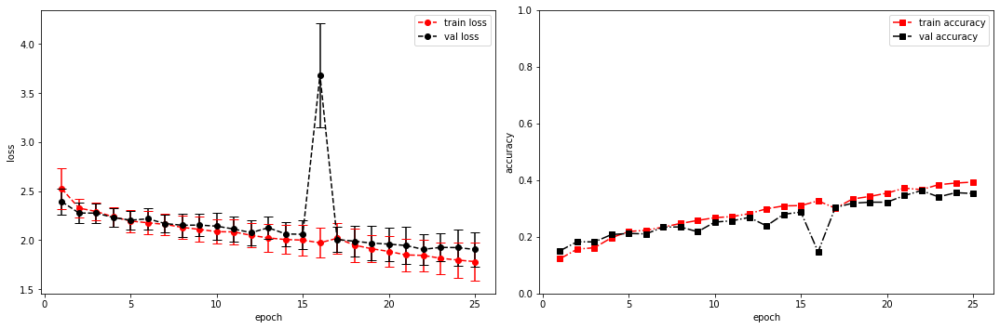

model saved


training epoch:  25
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [26/100], step [1/168],  Loss: 1.4679 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5400807857513428s
Epoch [26/100], step [17/168],  Loss: 1.7309 +/- 0.1624,  accuracy: 0.39453125, time elapsed = 6.242566823959351s
Epoch [26/100], step [33/168],  Loss: 1.7952 +/- 0.1719,  accuracy: 0.37890625, time elapsed = 6.242746591567993s
Epoch [26/100], step [49/168],  Loss: 1.7462 +/- 0.2264,  accuracy: 0.41796875, time elapsed = 6.242169141769409s
Epoch [26/100], step [65/168],  Loss: 1.7758 +/- 0.1848,  accuracy: 0.396484375, time elapsed = 6.244648456573486s
Epoch [26/100], step [81/168],  Loss: 1.8115 +/- 0.1328,  accuracy: 0.40625, time elapsed = 6.244383335113525s
Epoch [26/100], step [97/168],  Loss: 1.6989 +/- 0.1682,  accuracy: 0.44140625, time elapsed = 6.242481470108032s
Epoch [26/100], step [113/168],  Loss: 1.7684 +/- 0.1511,  accuracy: 0.435546875, time elapsed = 6.24406099319458s
Epoch [26/100], step [129/168],  Loss: 1.8408 +/- 0.1333,  accuracy: 0.392578125, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.412,  precision = 0.412 recall = 0.412 f1 = 0.412 ::: val: acc = 0.342,  precision = 0.342 recall = 0.342 time elapsed = 70.55598735809326s


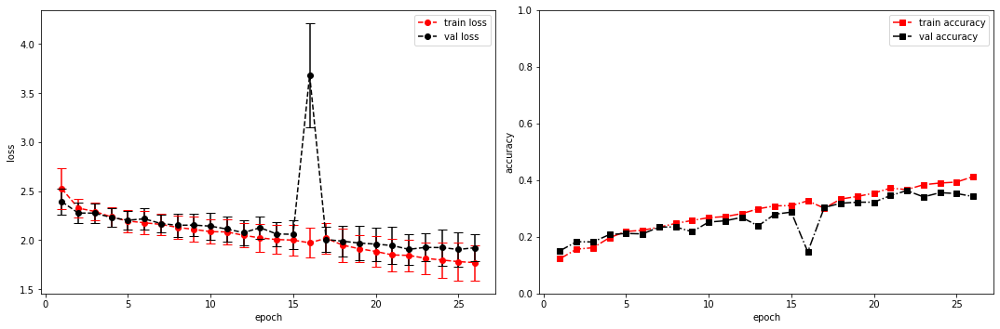

model saved


training epoch:  26
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [27/100], step [1/168],  Loss: 1.7688 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5739479064941406s
Epoch [27/100], step [17/168],  Loss: 1.7946 +/- 0.1381,  accuracy: 0.3984375, time elapsed = 6.242051839828491s
Epoch [27/100], step [33/168],  Loss: 1.7259 +/- 0.1589,  accuracy: 0.431640625, time elapsed = 6.241784334182739s
Epoch [27/100], step [49/168],  Loss: 1.7293 +/- 0.1282,  accuracy: 0.4140625, time elapsed = 6.2439329624176025s
Epoch [27/100], step [65/168],  Loss: 1.7507 +/- 0.1851,  accuracy: 0.412109375, time elapsed = 6.241766929626465s
Epoch [27/100], step [81/168],  Loss: 1.7743 +/- 0.1650,  accuracy: 0.39453125, time elapsed = 6.241536617279053s
Epoch [27/100], step [97/168],  Loss: 1.6930 +/- 0.1863,  accuracy: 0.427734375, time elapsed = 6.247816801071167s
Epoch [27/100], step [113/168],  Loss: 1.7413 +/- 0.1394,  accuracy: 0.40234375, time elapsed = 6.240903615951538s
Epoch [27/100], step [129/168],  Loss: 1.7657 +/- 0.1675,  accuracy: 0.419921875, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.409,  precision = 0.409 recall = 0.409 f1 = 0.409 ::: val: acc = 0.341,  precision = 0.341 recall = 0.341 time elapsed = 70.57872581481934s


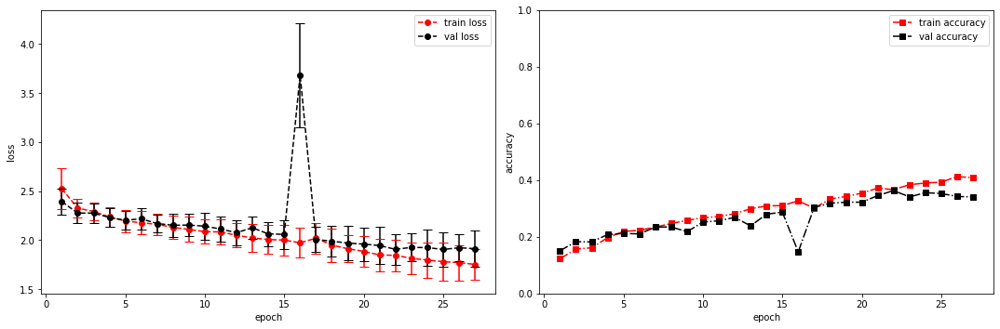

model saved


training epoch:  27
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [28/100], step [1/168],  Loss: 2.2404 +/- 0.0000,  accuracy: 0.009765625, time elapsed = 0.5469310283660889s
Epoch [28/100], step [17/168],  Loss: 1.7111 +/- 0.1586,  accuracy: 0.412109375, time elapsed = 6.243589401245117s
Epoch [28/100], step [33/168],  Loss: 1.6257 +/- 0.1910,  accuracy: 0.45703125, time elapsed = 6.245096445083618s
Epoch [28/100], step [49/168],  Loss: 1.6894 +/- 0.1469,  accuracy: 0.42578125, time elapsed = 6.24350643157959s
Epoch [28/100], step [65/168],  Loss: 1.7930 +/- 0.1574,  accuracy: 0.396484375, time elapsed = 6.2437121868133545s
Epoch [28/100], step [81/168],  Loss: 1.7864 +/- 0.2095,  accuracy: 0.390625, time elapsed = 6.243772983551025s
Epoch [28/100], step [97/168],  Loss: 1.7828 +/- 0.1540,  accuracy: 0.392578125, time elapsed = 6.242635011672974s
Epoch [28/100], step [113/168],  Loss: 1.7670 +/- 0.1666,  accuracy: 0.396484375, time elapsed = 6.2423012256622314s
Epoch [28/100], step [129/168],  Loss: 1.7578 +/- 0.1479,  accuracy: 0.392578125, t

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.409,  precision = 0.409 recall = 0.409 f1 = 0.409 ::: val: acc = 0.342,  precision = 0.342 recall = 0.342 time elapsed = 70.57760000228882s


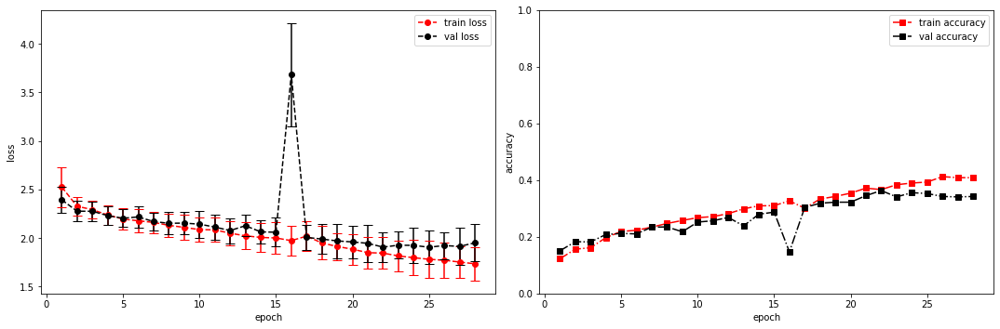

model saved


training epoch:  28
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [29/100], step [1/168],  Loss: 1.8289 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5418510437011719s
Epoch [29/100], step [17/168],  Loss: 1.7527 +/- 0.1700,  accuracy: 0.40234375, time elapsed = 6.242354393005371s
Epoch [29/100], step [33/168],  Loss: 1.7029 +/- 0.2031,  accuracy: 0.455078125, time elapsed = 6.245507717132568s
Epoch [29/100], step [49/168],  Loss: 1.6514 +/- 0.1688,  accuracy: 0.45703125, time elapsed = 6.249646186828613s
Epoch [29/100], step [65/168],  Loss: 1.7569 +/- 0.1565,  accuracy: 0.390625, time elapsed = 6.240508317947388s
Epoch [29/100], step [81/168],  Loss: 1.6515 +/- 0.2031,  accuracy: 0.43359375, time elapsed = 6.241245985031128s
Epoch [29/100], step [97/168],  Loss: 1.6551 +/- 0.1569,  accuracy: 0.46875, time elapsed = 6.242011308670044s
Epoch [29/100], step [113/168],  Loss: 1.7268 +/- 0.2059,  accuracy: 0.421875, time elapsed = 6.241492748260498s
Epoch [29/100], step [129/168],  Loss: 1.6725 +/- 0.1465,  accuracy: 0.455078125, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.437,  precision = 0.437 recall = 0.437 f1 = 0.437 ::: val: acc = 0.378,  precision = 0.378 recall = 0.378 time elapsed = 70.5698766708374s


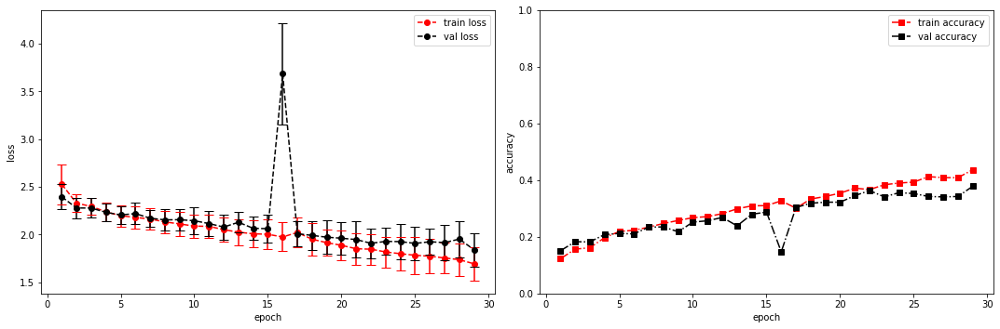

model saved


training epoch:  29
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [30/100], step [1/168],  Loss: 1.3775 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5481176376342773s
Epoch [30/100], step [17/168],  Loss: 1.6154 +/- 0.1717,  accuracy: 0.470703125, time elapsed = 6.242369651794434s
Epoch [30/100], step [33/168],  Loss: 1.7505 +/- 0.1905,  accuracy: 0.419921875, time elapsed = 6.242883920669556s
Epoch [30/100], step [49/168],  Loss: 1.6724 +/- 0.1531,  accuracy: 0.4609375, time elapsed = 6.247452259063721s
Epoch [30/100], step [65/168],  Loss: 1.6487 +/- 0.1507,  accuracy: 0.431640625, time elapsed = 6.24444317817688s
Epoch [30/100], step [81/168],  Loss: 1.6763 +/- 0.1800,  accuracy: 0.435546875, time elapsed = 6.244015455245972s
Epoch [30/100], step [97/168],  Loss: 1.6372 +/- 0.2142,  accuracy: 0.455078125, time elapsed = 6.247304916381836s
Epoch [30/100], step [113/168],  Loss: 1.6658 +/- 0.2148,  accuracy: 0.47265625, time elapsed = 6.245192527770996s
Epoch [30/100], step [129/168],  Loss: 1.7077 +/- 0.1435,  accuracy: 0.408203125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.437,  precision = 0.437 recall = 0.437 f1 = 0.437 ::: val: acc = 0.352,  precision = 0.352 recall = 0.352 time elapsed = 70.58878874778748s


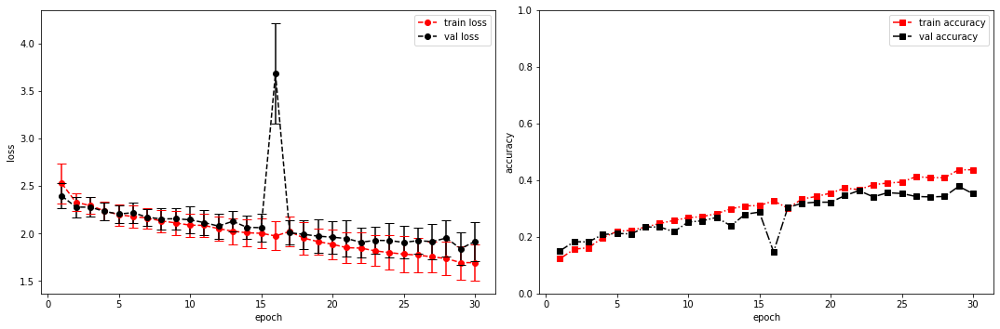

model saved


training epoch:  30
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [31/100], step [1/168],  Loss: 1.3709 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5406572818756104s
Epoch [31/100], step [17/168],  Loss: 1.5859 +/- 0.2073,  accuracy: 0.455078125, time elapsed = 6.242275714874268s
Epoch [31/100], step [33/168],  Loss: 1.6619 +/- 0.1596,  accuracy: 0.462890625, time elapsed = 6.242265462875366s
Epoch [31/100], step [49/168],  Loss: 1.6073 +/- 0.1579,  accuracy: 0.458984375, time elapsed = 6.2427778244018555s
Epoch [31/100], step [65/168],  Loss: 1.7196 +/- 0.1776,  accuracy: 0.435546875, time elapsed = 6.2416932582855225s
Epoch [31/100], step [81/168],  Loss: 1.7300 +/- 0.2185,  accuracy: 0.41015625, time elapsed = 6.2423717975616455s
Epoch [31/100], step [97/168],  Loss: 1.6310 +/- 0.2118,  accuracy: 0.466796875, time elapsed = 6.245807409286499s
Epoch [31/100], step [113/168],  Loss: 1.7212 +/- 0.1902,  accuracy: 0.435546875, time elapsed = 6.242373466491699s
Epoch [31/100], step [129/168],  Loss: 1.6415 +/- 0.1799,  accuracy: 0.4453125

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.441,  precision = 0.441 recall = 0.441 f1 = 0.441 ::: val: acc = 0.365,  precision = 0.365 recall = 0.365 time elapsed = 70.56630778312683s


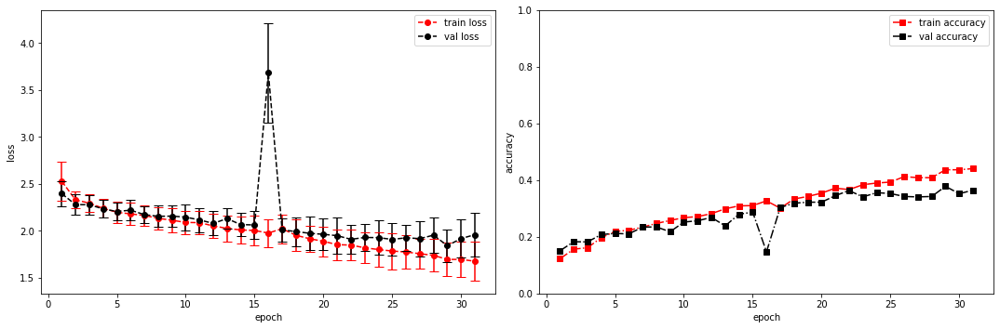

model saved


training epoch:  31
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [32/100], step [1/168],  Loss: 1.4411 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5418727397918701s
Epoch [32/100], step [17/168],  Loss: 1.6702 +/- 0.1967,  accuracy: 0.4453125, time elapsed = 6.24308443069458s
Epoch [32/100], step [33/168],  Loss: 1.7108 +/- 0.2297,  accuracy: 0.4296875, time elapsed = 6.243838787078857s
Epoch [32/100], step [49/168],  Loss: 1.6519 +/- 0.1991,  accuracy: 0.46875, time elapsed = 6.243375539779663s
Epoch [32/100], step [65/168],  Loss: 1.5897 +/- 0.1973,  accuracy: 0.447265625, time elapsed = 6.244021415710449s
Epoch [32/100], step [81/168],  Loss: 1.6777 +/- 0.1971,  accuracy: 0.44140625, time elapsed = 6.243844747543335s
Epoch [32/100], step [97/168],  Loss: 1.6621 +/- 0.1437,  accuracy: 0.451171875, time elapsed = 6.243753433227539s
Epoch [32/100], step [113/168],  Loss: 1.6840 +/- 0.2163,  accuracy: 0.435546875, time elapsed = 6.2540106773376465s
Epoch [32/100], step [129/168],  Loss: 1.6406 +/- 0.1136,  accuracy: 0.42578125, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.440,  precision = 0.440 recall = 0.440 f1 = 0.440 ::: val: acc = 0.359,  precision = 0.359 recall = 0.359 time elapsed = 70.5748381614685s


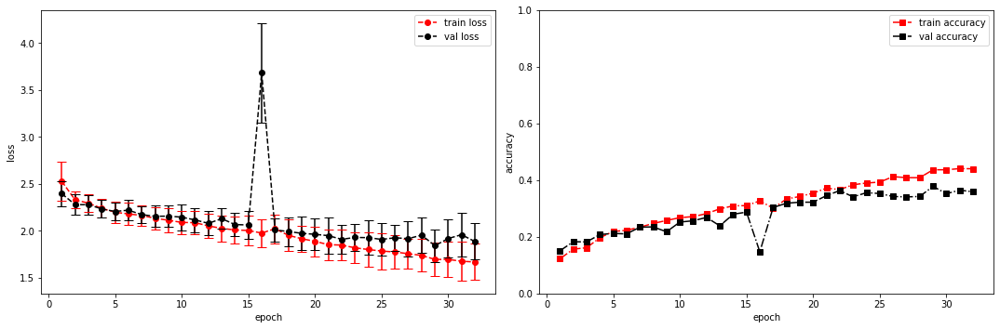

model saved


training epoch:  32
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [33/100], step [1/168],  Loss: 1.6998 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5523285865783691s
Epoch [33/100], step [17/168],  Loss: 1.5865 +/- 0.0918,  accuracy: 0.47265625, time elapsed = 6.2409679889678955s
Epoch [33/100], step [33/168],  Loss: 1.7471 +/- 0.2221,  accuracy: 0.435546875, time elapsed = 6.2429518699646s
Epoch [33/100], step [49/168],  Loss: 1.6274 +/- 0.1563,  accuracy: 0.458984375, time elapsed = 6.240380048751831s
Epoch [33/100], step [65/168],  Loss: 1.6110 +/- 0.1714,  accuracy: 0.47265625, time elapsed = 6.242767810821533s
Epoch [33/100], step [81/168],  Loss: 1.6881 +/- 0.1903,  accuracy: 0.44140625, time elapsed = 6.242560625076294s
Epoch [33/100], step [97/168],  Loss: 1.9931 +/- 0.3809,  accuracy: 0.341796875, time elapsed = 6.2426111698150635s
Epoch [33/100], step [113/168],  Loss: 2.1796 +/- 0.2324,  accuracy: 0.271484375, time elapsed = 6.24262547492981s
Epoch [33/100], step [129/168],  Loss: 2.0762 +/- 0.1880,  accuracy: 0.296875, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.388,  precision = 0.388 recall = 0.388 f1 = 0.388 ::: val: acc = 0.301,  precision = 0.301 recall = 0.301 time elapsed = 70.57638502120972s


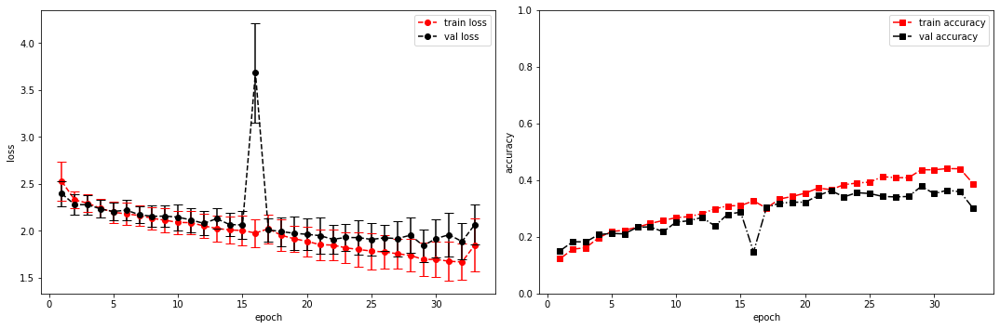

model saved


training epoch:  33
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [34/100], step [1/168],  Loss: 1.6635 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5400516986846924s
Epoch [34/100], step [17/168],  Loss: 1.8620 +/- 0.1513,  accuracy: 0.373046875, time elapsed = 6.242521047592163s
Epoch [34/100], step [33/168],  Loss: 1.7858 +/- 0.1768,  accuracy: 0.404296875, time elapsed = 6.242654085159302s
Epoch [34/100], step [49/168],  Loss: 1.9062 +/- 0.1617,  accuracy: 0.337890625, time elapsed = 6.257142543792725s
Epoch [34/100], step [65/168],  Loss: 1.8470 +/- 0.1637,  accuracy: 0.3984375, time elapsed = 6.241541862487793s
Epoch [34/100], step [81/168],  Loss: 1.7803 +/- 0.1699,  accuracy: 0.392578125, time elapsed = 6.24314546585083s
Epoch [34/100], step [97/168],  Loss: 1.9357 +/- 0.1517,  accuracy: 0.353515625, time elapsed = 6.242890119552612s
Epoch [34/100], step [113/168],  Loss: 1.9060 +/- 0.1460,  accuracy: 0.330078125, time elapsed = 6.243338346481323s
Epoch [34/100], step [129/168],  Loss: 1.8410 +/- 0.1832,  accuracy: 0.369140625, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.377,  precision = 0.377 recall = 0.377 f1 = 0.377 ::: val: acc = 0.352,  precision = 0.352 recall = 0.352 time elapsed = 70.56994104385376s


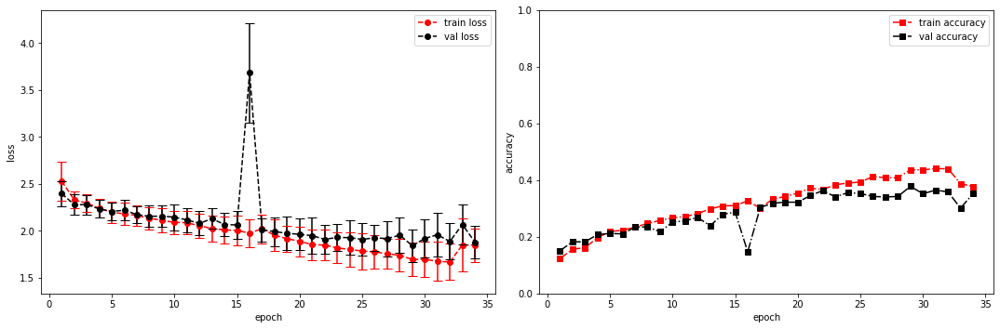

model saved


training epoch:  34
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [35/100], step [1/168],  Loss: 2.1085 +/- 0.0000,  accuracy: 0.013671875, time elapsed = 0.5420186519622803s
Epoch [35/100], step [17/168],  Loss: 1.7455 +/- 0.1852,  accuracy: 0.416015625, time elapsed = 6.241734504699707s
Epoch [35/100], step [33/168],  Loss: 1.6478 +/- 0.1579,  accuracy: 0.482421875, time elapsed = 6.242561340332031s
Epoch [35/100], step [49/168],  Loss: 1.7375 +/- 0.0884,  accuracy: 0.40234375, time elapsed = 6.240761756896973s
Epoch [35/100], step [65/168],  Loss: 1.8427 +/- 0.1958,  accuracy: 0.3828125, time elapsed = 6.240760087966919s
Epoch [35/100], step [81/168],  Loss: 1.7531 +/- 0.2034,  accuracy: 0.40234375, time elapsed = 6.240513801574707s
Epoch [35/100], step [97/168],  Loss: 1.7040 +/- 0.1363,  accuracy: 0.416015625, time elapsed = 6.242663145065308s
Epoch [35/100], step [113/168],  Loss: 1.7474 +/- 0.1727,  accuracy: 0.41796875, time elapsed = 6.241709470748901s
Epoch [35/100], step [129/168],  Loss: 1.7425 +/- 0.2213,  accuracy: 0.39453125, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.416,  precision = 0.416 recall = 0.416 f1 = 0.416 ::: val: acc = 0.370,  precision = 0.370 recall = 0.370 time elapsed = 70.6558129787445s


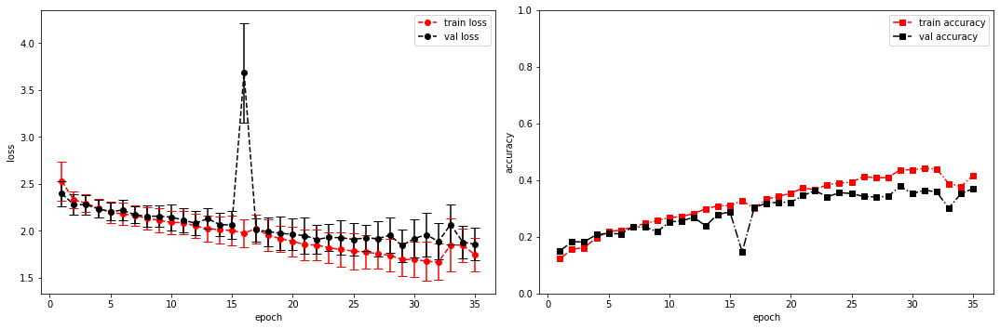

model saved


training epoch:  35
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [36/100], step [1/168],  Loss: 1.6214 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5437886714935303s
Epoch [36/100], step [17/168],  Loss: 1.7060 +/- 0.2052,  accuracy: 0.421875, time elapsed = 6.242156744003296s
Epoch [36/100], step [33/168],  Loss: 1.6741 +/- 0.2245,  accuracy: 0.435546875, time elapsed = 6.24251127243042s
Epoch [36/100], step [49/168],  Loss: 1.6767 +/- 0.1528,  accuracy: 0.4296875, time elapsed = 6.242233514785767s
Epoch [36/100], step [65/168],  Loss: 1.7321 +/- 0.1374,  accuracy: 0.439453125, time elapsed = 6.242452144622803s
Epoch [36/100], step [81/168],  Loss: 1.7263 +/- 0.1524,  accuracy: 0.44921875, time elapsed = 6.243218183517456s
Epoch [36/100], step [97/168],  Loss: 1.6993 +/- 0.1402,  accuracy: 0.41796875, time elapsed = 6.2438201904296875s
Epoch [36/100], step [113/168],  Loss: 1.6893 +/- 0.1643,  accuracy: 0.447265625, time elapsed = 6.244242906570435s
Epoch [36/100], step [129/168],  Loss: 1.6806 +/- 0.1551,  accuracy: 0.44140625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.437,  precision = 0.437 recall = 0.437 f1 = 0.437 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.59239315986633s


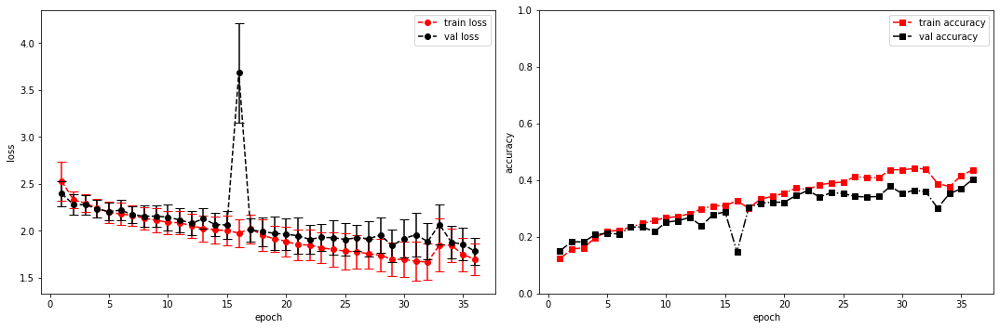

model saved


training epoch:  36
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [37/100], step [1/168],  Loss: 1.7025 +/- 0.0000,  accuracy: 0.0234375, time elapsed = 0.5597615242004395s
Epoch [37/100], step [17/168],  Loss: 1.7296 +/- 0.1616,  accuracy: 0.42578125, time elapsed = 6.241603136062622s
Epoch [37/100], step [33/168],  Loss: 1.6502 +/- 0.1649,  accuracy: 0.455078125, time elapsed = 6.241044282913208s
Epoch [37/100], step [49/168],  Loss: 1.6916 +/- 0.1739,  accuracy: 0.42578125, time elapsed = 6.242292165756226s
Epoch [37/100], step [65/168],  Loss: 1.6470 +/- 0.1485,  accuracy: 0.466796875, time elapsed = 6.242793560028076s
Epoch [37/100], step [81/168],  Loss: 1.6216 +/- 0.1632,  accuracy: 0.47265625, time elapsed = 6.242305040359497s
Epoch [37/100], step [97/168],  Loss: 1.6795 +/- 0.1882,  accuracy: 0.443359375, time elapsed = 6.241379737854004s
Epoch [37/100], step [113/168],  Loss: 1.6338 +/- 0.1763,  accuracy: 0.455078125, time elapsed = 6.253938674926758s
Epoch [37/100], step [129/168],  Loss: 1.6114 +/- 0.1702,  accuracy: 0.46875, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.453,  precision = 0.453 recall = 0.453 f1 = 0.453 ::: val: acc = 0.378,  precision = 0.378 recall = 0.378 time elapsed = 70.59229969978333s


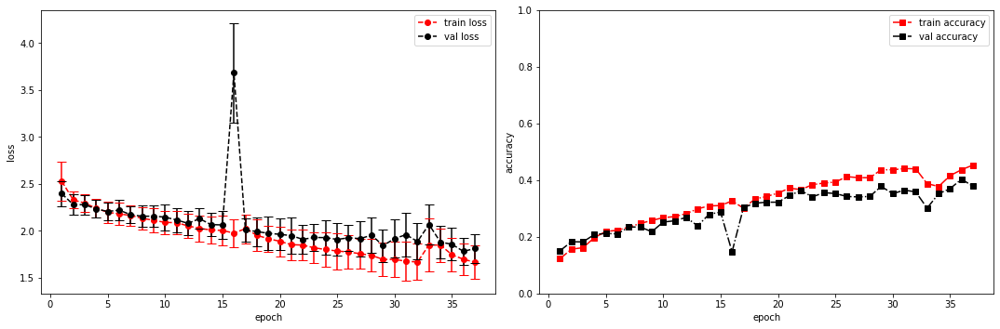

model saved


training epoch:  37
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [38/100], step [1/168],  Loss: 1.5373 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5514132976531982s
Epoch [38/100], step [17/168],  Loss: 1.5459 +/- 0.2092,  accuracy: 0.49609375, time elapsed = 6.239599227905273s
Epoch [38/100], step [33/168],  Loss: 1.6045 +/- 0.2006,  accuracy: 0.478515625, time elapsed = 6.240887641906738s
Epoch [38/100], step [49/168],  Loss: 1.6232 +/- 0.1472,  accuracy: 0.44921875, time elapsed = 6.2435667514801025s
Epoch [38/100], step [65/168],  Loss: 1.6423 +/- 0.1395,  accuracy: 0.42578125, time elapsed = 6.240576982498169s
Epoch [38/100], step [81/168],  Loss: 1.6055 +/- 0.1724,  accuracy: 0.4453125, time elapsed = 6.240392684936523s
Epoch [38/100], step [97/168],  Loss: 1.7478 +/- 0.1494,  accuracy: 0.39453125, time elapsed = 6.240583658218384s
Epoch [38/100], step [113/168],  Loss: 1.5655 +/- 0.1550,  accuracy: 0.521484375, time elapsed = 6.2412428855896s
Epoch [38/100], step [129/168],  Loss: 1.7290 +/- 0.2758,  accuracy: 0.4140625, time elaps

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.452,  precision = 0.452 recall = 0.452 f1 = 0.452 ::: val: acc = 0.406,  precision = 0.406 recall = 0.406 time elapsed = 70.54245805740356s


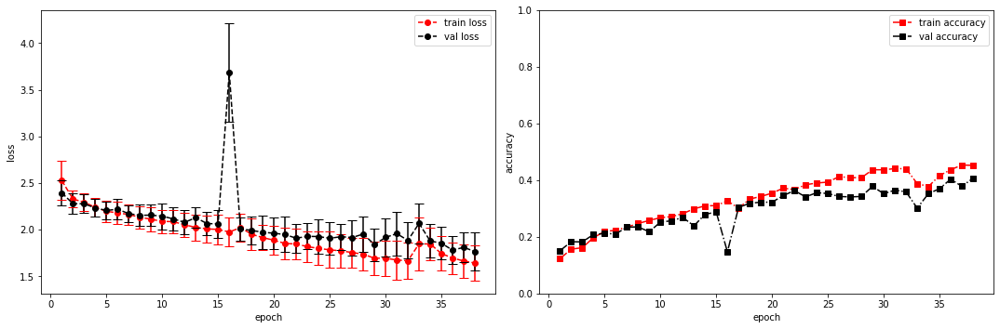

model saved


training epoch:  38
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [39/100], step [1/168],  Loss: 1.3603 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.5450520515441895s
Epoch [39/100], step [17/168],  Loss: 1.5340 +/- 0.1514,  accuracy: 0.49609375, time elapsed = 6.241814851760864s
Epoch [39/100], step [33/168],  Loss: 1.5505 +/- 0.1697,  accuracy: 0.470703125, time elapsed = 6.2419373989105225s
Epoch [39/100], step [49/168],  Loss: 1.6106 +/- 0.1990,  accuracy: 0.462890625, time elapsed = 6.242665767669678s
Epoch [39/100], step [65/168],  Loss: 1.6193 +/- 0.2048,  accuracy: 0.4609375, time elapsed = 6.253410577774048s
Epoch [39/100], step [81/168],  Loss: 1.5961 +/- 0.1532,  accuracy: 0.4609375, time elapsed = 6.242039442062378s
Epoch [39/100], step [97/168],  Loss: 1.7073 +/- 0.2609,  accuracy: 0.431640625, time elapsed = 6.242372035980225s
Epoch [39/100], step [113/168],  Loss: 1.5878 +/- 0.2152,  accuracy: 0.46875, time elapsed = 6.242581605911255s
Epoch [39/100], step [129/168],  Loss: 1.5631 +/- 0.1674,  accuracy: 0.470703125, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.459,  precision = 0.459 recall = 0.459 f1 = 0.459 ::: val: acc = 0.425,  precision = 0.425 recall = 0.425 time elapsed = 70.57396960258484s


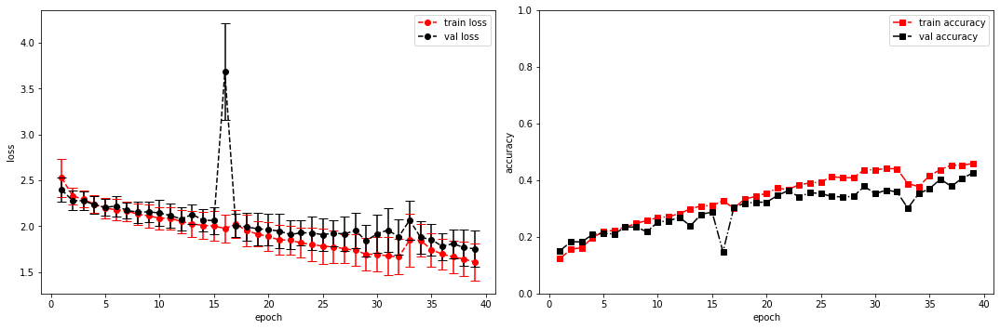

model saved


training epoch:  39
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [40/100], step [1/168],  Loss: 1.5102 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5477731227874756s
Epoch [40/100], step [17/168],  Loss: 1.5367 +/- 0.1959,  accuracy: 0.486328125, time elapsed = 6.241791486740112s
Epoch [40/100], step [33/168],  Loss: 1.6169 +/- 0.1879,  accuracy: 0.458984375, time elapsed = 6.2427613735198975s
Epoch [40/100], step [49/168],  Loss: 1.5667 +/- 0.1622,  accuracy: 0.48828125, time elapsed = 6.242723226547241s
Epoch [40/100], step [65/168],  Loss: 1.5761 +/- 0.2040,  accuracy: 0.494140625, time elapsed = 6.242319107055664s
Epoch [40/100], step [81/168],  Loss: 1.5677 +/- 0.1597,  accuracy: 0.478515625, time elapsed = 6.24292254447937s
Epoch [40/100], step [97/168],  Loss: 1.6759 +/- 0.1808,  accuracy: 0.435546875, time elapsed = 6.242072820663452s
Epoch [40/100], step [113/168],  Loss: 1.5995 +/- 0.1300,  accuracy: 0.484375, time elapsed = 6.242239475250244s
Epoch [40/100], step [129/168],  Loss: 1.5567 +/- 0.1407,  accuracy: 0.474609375, ti

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.472,  precision = 0.472 recall = 0.472 f1 = 0.472 ::: val: acc = 0.401,  precision = 0.401 recall = 0.401 time elapsed = 70.60614705085754s


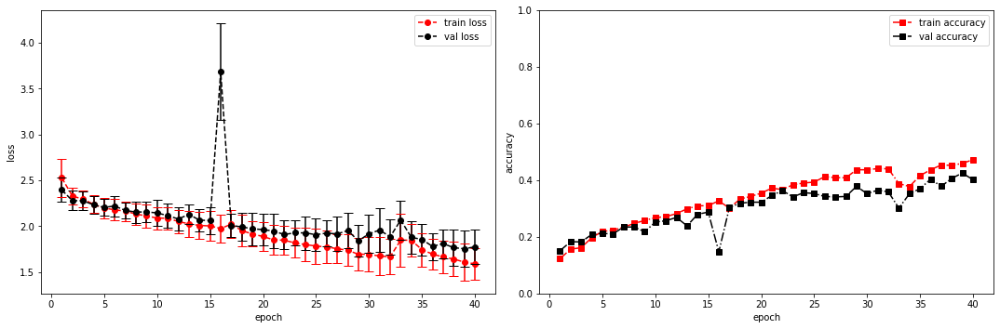

model saved


training epoch:  40
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [41/100], step [1/168],  Loss: 1.5494 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5409176349639893s
Epoch [41/100], step [17/168],  Loss: 1.4971 +/- 0.1405,  accuracy: 0.51953125, time elapsed = 6.242066860198975s
Epoch [41/100], step [33/168],  Loss: 1.5777 +/- 0.2102,  accuracy: 0.47265625, time elapsed = 6.240160226821899s
Epoch [41/100], step [49/168],  Loss: 1.6024 +/- 0.2089,  accuracy: 0.482421875, time elapsed = 6.240200757980347s
Epoch [41/100], step [65/168],  Loss: 1.6563 +/- 0.1443,  accuracy: 0.4375, time elapsed = 6.239522695541382s
Epoch [41/100], step [81/168],  Loss: 1.5368 +/- 0.1958,  accuracy: 0.474609375, time elapsed = 6.240204334259033s
Epoch [41/100], step [97/168],  Loss: 1.6495 +/- 0.2058,  accuracy: 0.443359375, time elapsed = 6.240458250045776s
Epoch [41/100], step [113/168],  Loss: 1.6184 +/- 0.1684,  accuracy: 0.447265625, time elapsed = 6.243305444717407s
Epoch [41/100], step [129/168],  Loss: 1.5863 +/- 0.2277,  accuracy: 0.47265625, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.465,  precision = 0.465 recall = 0.465 f1 = 0.465 ::: val: acc = 0.401,  precision = 0.401 recall = 0.401 time elapsed = 70.55411696434021s


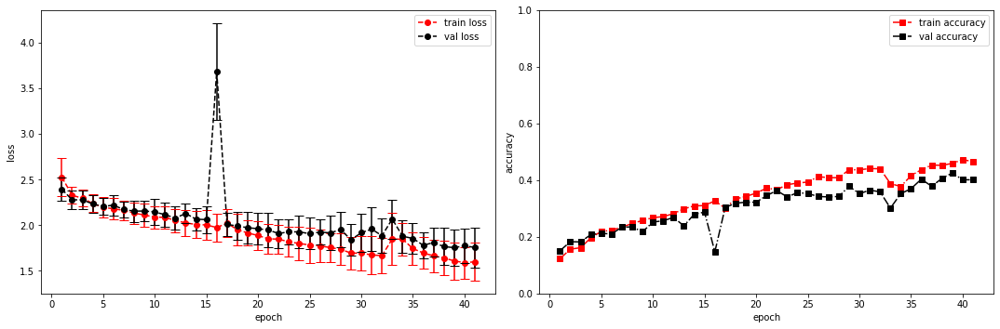

model saved


training epoch:  41
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [42/100], step [1/168],  Loss: 1.4670 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.540393590927124s
Epoch [42/100], step [17/168],  Loss: 1.5347 +/- 0.1251,  accuracy: 0.48828125, time elapsed = 6.242230653762817s
Epoch [42/100], step [33/168],  Loss: 1.4825 +/- 0.1295,  accuracy: 0.515625, time elapsed = 6.242138385772705s
Epoch [42/100], step [49/168],  Loss: 1.5293 +/- 0.1836,  accuracy: 0.49609375, time elapsed = 6.243831157684326s
Epoch [42/100], step [65/168],  Loss: 1.5603 +/- 0.1842,  accuracy: 0.46875, time elapsed = 6.243002653121948s
Epoch [42/100], step [81/168],  Loss: 1.5650 +/- 0.1805,  accuracy: 0.48046875, time elapsed = 6.244305372238159s
Epoch [42/100], step [97/168],  Loss: 1.5383 +/- 0.2355,  accuracy: 0.490234375, time elapsed = 6.2414162158966064s
Epoch [42/100], step [113/168],  Loss: 1.5484 +/- 0.1590,  accuracy: 0.513671875, time elapsed = 6.242462396621704s
Epoch [42/100], step [129/168],  Loss: 1.5812 +/- 0.1557,  accuracy: 0.462890625, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.487,  precision = 0.487 recall = 0.487 f1 = 0.487 ::: val: acc = 0.433,  precision = 0.433 recall = 0.433 time elapsed = 70.5762107372284s


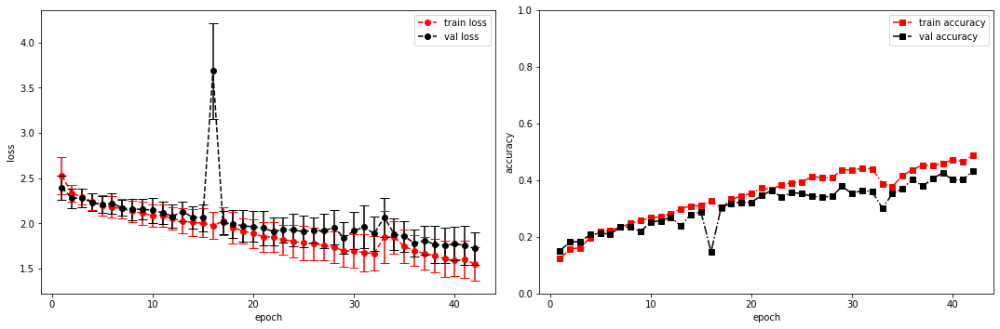

model saved


training epoch:  42
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [43/100], step [1/168],  Loss: 1.3870 +/- 0.0000,  accuracy: 0.03125, time elapsed = 0.559518575668335s
Epoch [43/100], step [17/168],  Loss: 1.4975 +/- 0.1351,  accuracy: 0.501953125, time elapsed = 6.241732120513916s
Epoch [43/100], step [33/168],  Loss: 1.4920 +/- 0.2216,  accuracy: 0.51171875, time elapsed = 6.241511106491089s
Epoch [43/100], step [49/168],  Loss: 1.5049 +/- 0.1926,  accuracy: 0.50390625, time elapsed = 6.242915868759155s
Epoch [43/100], step [65/168],  Loss: 1.4729 +/- 0.1770,  accuracy: 0.52734375, time elapsed = 6.2433412075042725s
Epoch [43/100], step [81/168],  Loss: 1.6395 +/- 0.1528,  accuracy: 0.451171875, time elapsed = 6.241276741027832s
Epoch [43/100], step [97/168],  Loss: 1.6352 +/- 0.1547,  accuracy: 0.470703125, time elapsed = 6.241713047027588s
Epoch [43/100], step [113/168],  Loss: 1.5121 +/- 0.1904,  accuracy: 0.474609375, time elapsed = 6.242335081100464s
Epoch [43/100], step [129/168],  Loss: 1.5328 +/- 0.1700,  accuracy: 0.484375, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.491,  precision = 0.491 recall = 0.491 f1 = 0.491 ::: val: acc = 0.406,  precision = 0.406 recall = 0.406 time elapsed = 70.57669281959534s


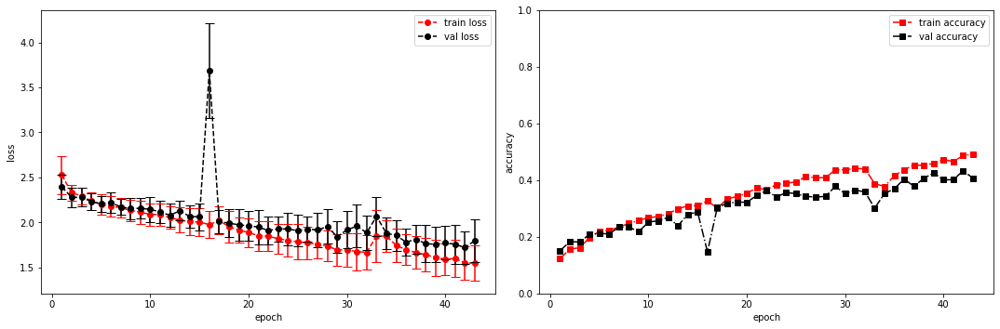

model saved


training epoch:  43
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [44/100], step [1/168],  Loss: 1.9066 +/- 0.0000,  accuracy: 0.021484375, time elapsed = 0.5392882823944092s
Epoch [44/100], step [17/168],  Loss: 1.4893 +/- 0.2167,  accuracy: 0.51171875, time elapsed = 6.242279767990112s
Epoch [44/100], step [33/168],  Loss: 1.5441 +/- 0.1869,  accuracy: 0.501953125, time elapsed = 6.244752883911133s
Epoch [44/100], step [49/168],  Loss: 1.5210 +/- 0.1598,  accuracy: 0.490234375, time elapsed = 6.242382764816284s
Epoch [44/100], step [65/168],  Loss: 1.5229 +/- 0.1325,  accuracy: 0.51171875, time elapsed = 6.246704339981079s
Epoch [44/100], step [81/168],  Loss: 1.5491 +/- 0.1584,  accuracy: 0.484375, time elapsed = 6.250066041946411s
Epoch [44/100], step [97/168],  Loss: 1.4729 +/- 0.1811,  accuracy: 0.515625, time elapsed = 6.242962837219238s
Epoch [44/100], step [113/168],  Loss: 1.4896 +/- 0.1821,  accuracy: 0.51171875, time elapsed = 6.2427074909210205s
Epoch [44/100], step [129/168],  Loss: 1.5831 +/- 0.1888,  accuracy: 0.4765625, time el

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.490,  precision = 0.490 recall = 0.490 f1 = 0.490 ::: val: acc = 0.435,  precision = 0.435 recall = 0.435 time elapsed = 70.59992575645447s


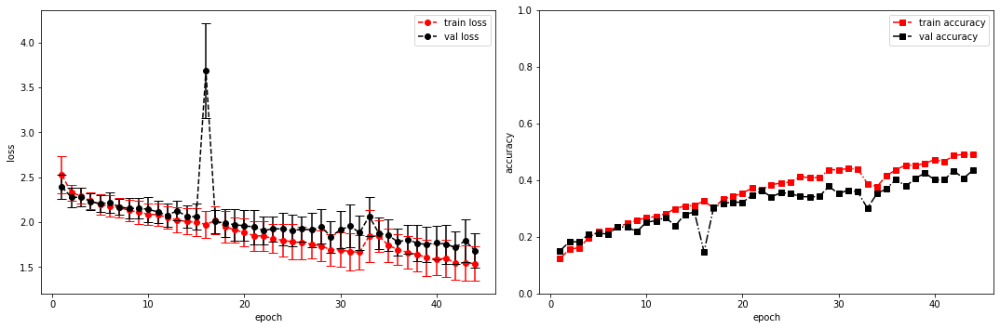

model saved


training epoch:  44
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [45/100], step [1/168],  Loss: 1.2546 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5430393218994141s
Epoch [45/100], step [17/168],  Loss: 1.4576 +/- 0.2213,  accuracy: 0.541015625, time elapsed = 6.241586923599243s
Epoch [45/100], step [33/168],  Loss: 1.4018 +/- 0.1545,  accuracy: 0.544921875, time elapsed = 6.243922233581543s
Epoch [45/100], step [49/168],  Loss: 1.4879 +/- 0.1825,  accuracy: 0.51953125, time elapsed = 6.242678642272949s
Epoch [45/100], step [65/168],  Loss: 1.4992 +/- 0.2600,  accuracy: 0.501953125, time elapsed = 6.241940021514893s
Epoch [45/100], step [81/168],  Loss: 1.5262 +/- 0.2744,  accuracy: 0.521484375, time elapsed = 6.242204904556274s
Epoch [45/100], step [97/168],  Loss: 1.5877 +/- 0.1691,  accuracy: 0.45703125, time elapsed = 6.242668628692627s
Epoch [45/100], step [113/168],  Loss: 1.5739 +/- 0.1842,  accuracy: 0.482421875, time elapsed = 6.242346525192261s
Epoch [45/100], step [129/168],  Loss: 1.4773 +/- 0.1279,  accuracy: 0.482421875,

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.506,  precision = 0.506 recall = 0.506 f1 = 0.506 ::: val: acc = 0.424,  precision = 0.424 recall = 0.424 time elapsed = 70.54210591316223s


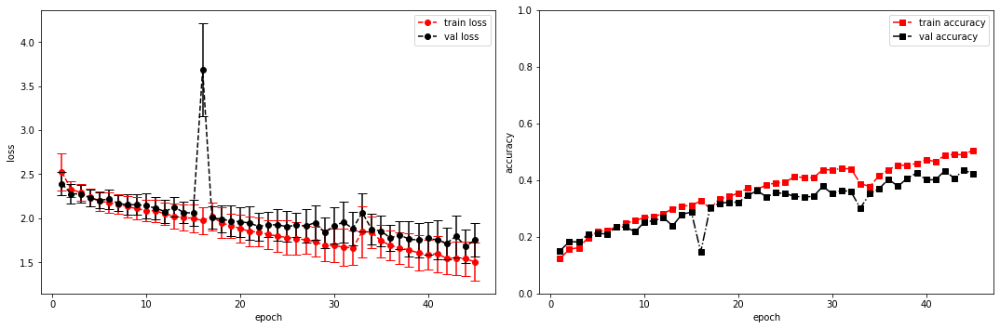

model saved


training epoch:  45
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [46/100], step [1/168],  Loss: 1.5918 +/- 0.0000,  accuracy: 0.02734375, time elapsed = 0.5489711761474609s
Epoch [46/100], step [17/168],  Loss: 1.4828 +/- 0.1734,  accuracy: 0.521484375, time elapsed = 6.253903388977051s
Epoch [46/100], step [33/168],  Loss: 1.5015 +/- 0.2345,  accuracy: 0.501953125, time elapsed = 6.2429187297821045s
Epoch [46/100], step [49/168],  Loss: 1.4129 +/- 0.1910,  accuracy: 0.5390625, time elapsed = 6.24147891998291s
Epoch [46/100], step [65/168],  Loss: 1.5093 +/- 0.1541,  accuracy: 0.509765625, time elapsed = 6.242511034011841s
Epoch [46/100], step [81/168],  Loss: 1.4537 +/- 0.1827,  accuracy: 0.50390625, time elapsed = 6.242922067642212s
Epoch [46/100], step [97/168],  Loss: 1.4157 +/- 0.2099,  accuracy: 0.544921875, time elapsed = 6.241849422454834s
Epoch [46/100], step [113/168],  Loss: 1.5474 +/- 0.1811,  accuracy: 0.47265625, time elapsed = 6.241754770278931s
Epoch [46/100], step [129/168],  Loss: 1.6530 +/- 0.2478,  accuracy: 0.453125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.498,  precision = 0.498 recall = 0.498 f1 = 0.498 ::: val: acc = 0.420,  precision = 0.420 recall = 0.420 time elapsed = 70.56844353675842s


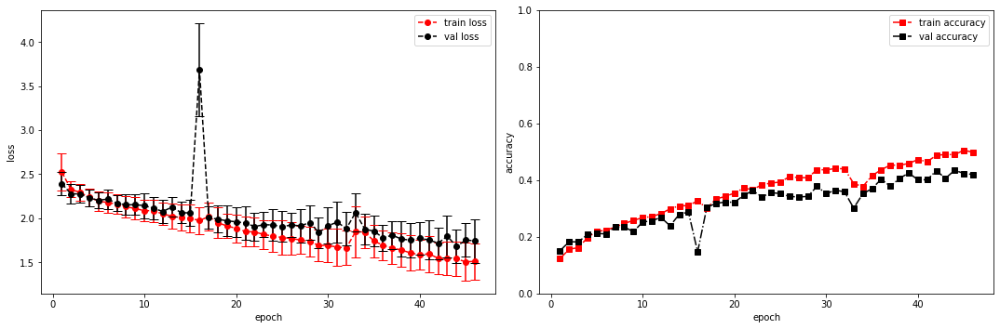

model saved


training epoch:  46
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [47/100], step [1/168],  Loss: 1.4609 +/- 0.0000,  accuracy: 0.03515625, time elapsed = 0.5659570693969727s
Epoch [47/100], step [17/168],  Loss: 1.3873 +/- 0.1424,  accuracy: 0.53125, time elapsed = 6.2417402267456055s
Epoch [47/100], step [33/168],  Loss: 1.3604 +/- 0.1439,  accuracy: 0.548828125, time elapsed = 6.242420673370361s
Epoch [47/100], step [49/168],  Loss: 1.4398 +/- 0.1544,  accuracy: 0.515625, time elapsed = 6.242531776428223s
Epoch [47/100], step [65/168],  Loss: 1.4516 +/- 0.1247,  accuracy: 0.501953125, time elapsed = 6.242832183837891s
Epoch [47/100], step [81/168],  Loss: 1.5055 +/- 0.1492,  accuracy: 0.51171875, time elapsed = 6.241715431213379s
Epoch [47/100], step [97/168],  Loss: 1.6128 +/- 0.1819,  accuracy: 0.47265625, time elapsed = 6.243337392807007s
Epoch [47/100], step [113/168],  Loss: 1.6399 +/- 0.1654,  accuracy: 0.451171875, time elapsed = 6.242517948150635s
Epoch [47/100], step [129/168],  Loss: 1.5444 +/- 0.2413,  accuracy: 0.4921875, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.495,  precision = 0.495 recall = 0.495 f1 = 0.495 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.58934259414673s


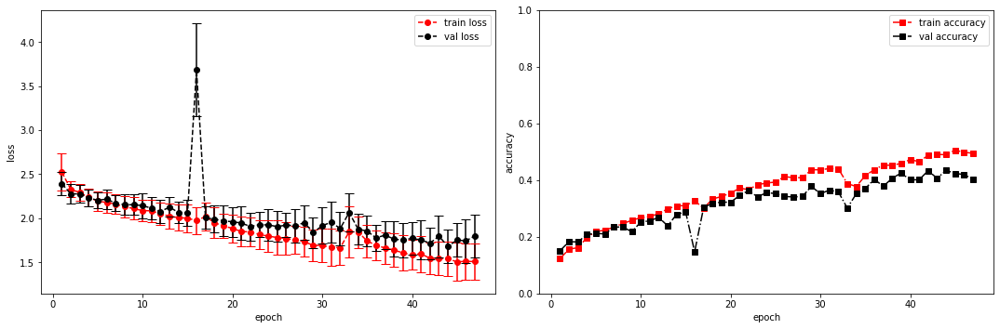

model saved


training epoch:  47
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [48/100], step [1/168],  Loss: 1.1054 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5417187213897705s
Epoch [48/100], step [17/168],  Loss: 1.4110 +/- 0.1194,  accuracy: 0.5234375, time elapsed = 6.241511344909668s
Epoch [48/100], step [33/168],  Loss: 1.4705 +/- 0.2046,  accuracy: 0.505859375, time elapsed = 6.2412943840026855s
Epoch [48/100], step [49/168],  Loss: 1.4876 +/- 0.1695,  accuracy: 0.51953125, time elapsed = 6.241216421127319s
Epoch [48/100], step [65/168],  Loss: 1.5320 +/- 0.1974,  accuracy: 0.513671875, time elapsed = 6.24286675453186s
Epoch [48/100], step [81/168],  Loss: 1.5253 +/- 0.1774,  accuracy: 0.486328125, time elapsed = 6.24238395690918s
Epoch [48/100], step [97/168],  Loss: 1.4832 +/- 0.1582,  accuracy: 0.48828125, time elapsed = 6.24104118347168s
Epoch [48/100], step [113/168],  Loss: 1.4963 +/- 0.1813,  accuracy: 0.529296875, time elapsed = 6.241069555282593s
Epoch [48/100], step [129/168],  Loss: 1.5593 +/- 0.1663,  accuracy: 0.498046875, tim

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.502,  precision = 0.502 recall = 0.502 f1 = 0.502 ::: val: acc = 0.444,  precision = 0.444 recall = 0.444 time elapsed = 70.5570125579834s


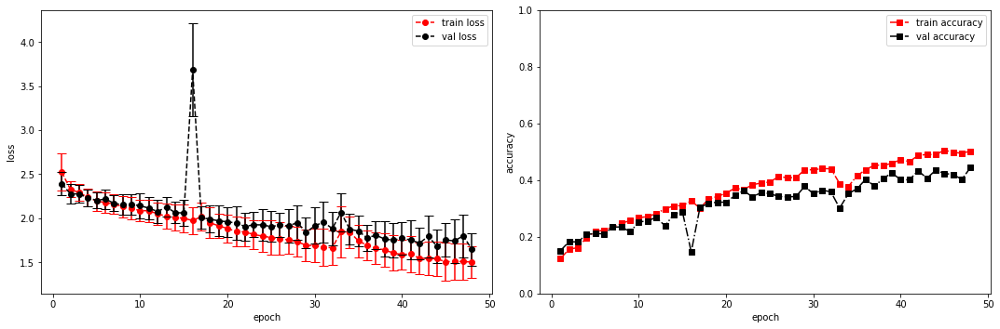

model saved


training epoch:  48
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [49/100], step [1/168],  Loss: 1.4610 +/- 0.0000,  accuracy: 0.025390625, time elapsed = 0.5418434143066406s
Epoch [49/100], step [17/168],  Loss: 1.5521 +/- 0.1760,  accuracy: 0.478515625, time elapsed = 6.241007566452026s
Epoch [49/100], step [33/168],  Loss: 1.4930 +/- 0.2195,  accuracy: 0.501953125, time elapsed = 6.2400078773498535s
Epoch [49/100], step [49/168],  Loss: 1.3802 +/- 0.1620,  accuracy: 0.5390625, time elapsed = 6.241764783859253s
Epoch [49/100], step [65/168],  Loss: 1.3594 +/- 0.1907,  accuracy: 0.548828125, time elapsed = 6.241156578063965s
Epoch [49/100], step [81/168],  Loss: 1.4869 +/- 0.1340,  accuracy: 0.521484375, time elapsed = 6.252676725387573s
Epoch [49/100], step [97/168],  Loss: 1.4778 +/- 0.2005,  accuracy: 0.51953125, time elapsed = 6.244359493255615s
Epoch [49/100], step [113/168],  Loss: 1.4954 +/- 0.1339,  accuracy: 0.533203125, time elapsed = 6.2416205406188965s
Epoch [49/100], step [129/168],  Loss: 1.5556 +/- 0.2015,  accuracy: 0.5, time e

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.515,  precision = 0.515 recall = 0.515 f1 = 0.515 ::: val: acc = 0.453,  precision = 0.453 recall = 0.453 time elapsed = 70.56055951118469s


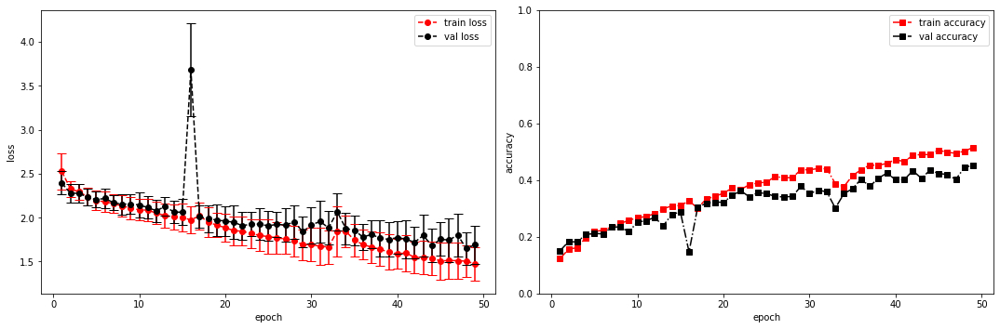

model saved


training epoch:  49
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [50/100], step [1/168],  Loss: 1.4073 +/- 0.0000,  accuracy: 0.029296875, time elapsed = 0.5487174987792969s
Epoch [50/100], step [17/168],  Loss: 1.3998 +/- 0.2333,  accuracy: 0.5625, time elapsed = 6.244002819061279s
Epoch [50/100], step [33/168],  Loss: 1.3499 +/- 0.1572,  accuracy: 0.541015625, time elapsed = 6.242375373840332s
Epoch [50/100], step [49/168],  Loss: 1.4910 +/- 0.2107,  accuracy: 0.4921875, time elapsed = 6.24248480796814s
Epoch [50/100], step [65/168],  Loss: 1.4810 +/- 0.1998,  accuracy: 0.509765625, time elapsed = 6.241918563842773s
Epoch [50/100], step [81/168],  Loss: 1.4795 +/- 0.1875,  accuracy: 0.51171875, time elapsed = 6.2424845695495605s
Epoch [50/100], step [97/168],  Loss: 1.4435 +/- 0.1912,  accuracy: 0.521484375, time elapsed = 6.242411375045776s
Epoch [50/100], step [113/168],  Loss: 1.4050 +/- 0.1632,  accuracy: 0.53125, time elapsed = 6.244009256362915s
Epoch [50/100], step [129/168],  Loss: 1.5586 +/- 0.2056,  accuracy: 0.478515625, time elap

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.508,  precision = 0.508 recall = 0.508 f1 = 0.508 ::: val: acc = 0.441,  precision = 0.441 recall = 0.441 time elapsed = 70.54141211509705s


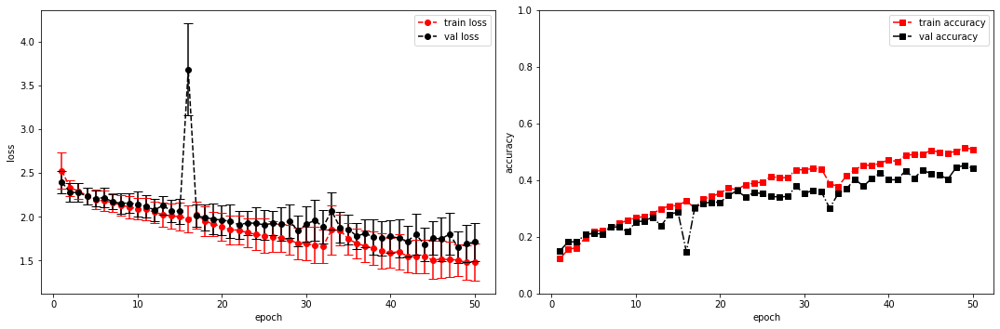

model saved


training epoch:  50
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [51/100], step [1/168],  Loss: 1.4083 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5542342662811279s
Epoch [51/100], step [17/168],  Loss: 1.4677 +/- 0.1398,  accuracy: 0.48828125, time elapsed = 6.244938611984253s
Epoch [51/100], step [33/168],  Loss: 1.3947 +/- 0.1491,  accuracy: 0.5546875, time elapsed = 6.2576048374176025s
Epoch [51/100], step [49/168],  Loss: 1.4597 +/- 0.2153,  accuracy: 0.51953125, time elapsed = 6.242566347122192s
Epoch [51/100], step [65/168],  Loss: 1.4638 +/- 0.0932,  accuracy: 0.51171875, time elapsed = 6.242478609085083s
Epoch [51/100], step [81/168],  Loss: 1.4837 +/- 0.2237,  accuracy: 0.51953125, time elapsed = 6.241222620010376s
Epoch [51/100], step [97/168],  Loss: 1.4653 +/- 0.2020,  accuracy: 0.52734375, time elapsed = 6.241373538970947s
Epoch [51/100], step [113/168],  Loss: 1.4922 +/- 0.1842,  accuracy: 0.513671875, time elapsed = 6.241524934768677s
Epoch [51/100], step [129/168],  Loss: 1.4618 +/- 0.1798,  accuracy: 0.51953125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.524,  precision = 0.524 recall = 0.524 f1 = 0.524 ::: val: acc = 0.441,  precision = 0.441 recall = 0.441 time elapsed = 70.59589529037476s


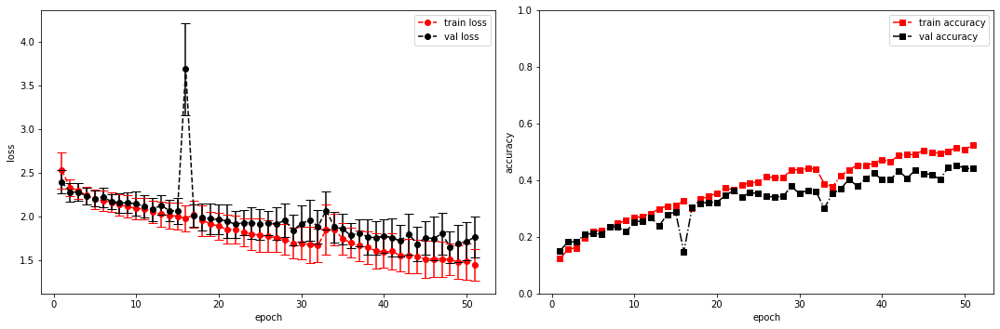

model saved


training epoch:  51
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [52/100], step [1/168],  Loss: 1.1496 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.539257287979126s
Epoch [52/100], step [17/168],  Loss: 1.4275 +/- 0.2223,  accuracy: 0.54296875, time elapsed = 6.2432615756988525s
Epoch [52/100], step [33/168],  Loss: 1.3534 +/- 0.1680,  accuracy: 0.5625, time elapsed = 6.2424516677856445s
Epoch [52/100], step [49/168],  Loss: 1.3397 +/- 0.2112,  accuracy: 0.5546875, time elapsed = 6.242408514022827s
Epoch [52/100], step [65/168],  Loss: 1.5326 +/- 0.1646,  accuracy: 0.478515625, time elapsed = 6.24273943901062s
Epoch [52/100], step [81/168],  Loss: 1.5191 +/- 0.2015,  accuracy: 0.513671875, time elapsed = 6.242274284362793s
Epoch [52/100], step [97/168],  Loss: 1.4251 +/- 0.1504,  accuracy: 0.517578125, time elapsed = 6.242089748382568s
Epoch [52/100], step [113/168],  Loss: 1.3959 +/- 0.1739,  accuracy: 0.537109375, time elapsed = 6.243479013442993s
Epoch [52/100], step [129/168],  Loss: 1.5473 +/- 0.2071,  accuracy: 0.46484375, time ela

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.521,  precision = 0.521 recall = 0.521 f1 = 0.521 ::: val: acc = 0.392,  precision = 0.392 recall = 0.392 time elapsed = 70.60945677757263s


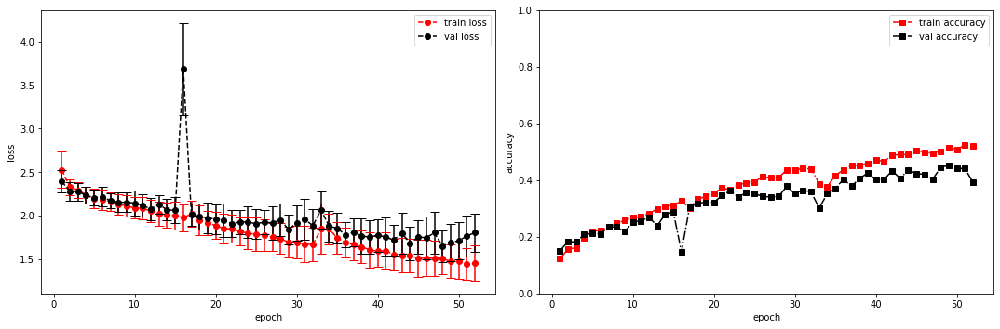

model saved


training epoch:  52
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [53/100], step [1/168],  Loss: 1.0862 +/- 0.0000,  accuracy: 0.041015625, time elapsed = 0.5464034080505371s
Epoch [53/100], step [17/168],  Loss: 1.4487 +/- 0.1724,  accuracy: 0.53125, time elapsed = 6.24160623550415s
Epoch [53/100], step [33/168],  Loss: 1.4006 +/- 0.2027,  accuracy: 0.552734375, time elapsed = 6.242708683013916s
Epoch [53/100], step [49/168],  Loss: 1.4573 +/- 0.2050,  accuracy: 0.51953125, time elapsed = 6.240978240966797s
Epoch [53/100], step [65/168],  Loss: 1.4542 +/- 0.1326,  accuracy: 0.517578125, time elapsed = 6.241886138916016s
Epoch [53/100], step [81/168],  Loss: 1.4014 +/- 0.2024,  accuracy: 0.5234375, time elapsed = 6.244327783584595s
Epoch [53/100], step [97/168],  Loss: 1.5002 +/- 0.1914,  accuracy: 0.48046875, time elapsed = 6.242098808288574s
Epoch [53/100], step [113/168],  Loss: 1.5129 +/- 0.1975,  accuracy: 0.5, time elapsed = 6.242381572723389s
Epoch [53/100], step [129/168],  Loss: 1.5427 +/- 0.1531,  accuracy: 0.482421875, time elapsed =

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.509,  precision = 0.509 recall = 0.509 f1 = 0.509 ::: val: acc = 0.403,  precision = 0.403 recall = 0.403 time elapsed = 70.55406308174133s


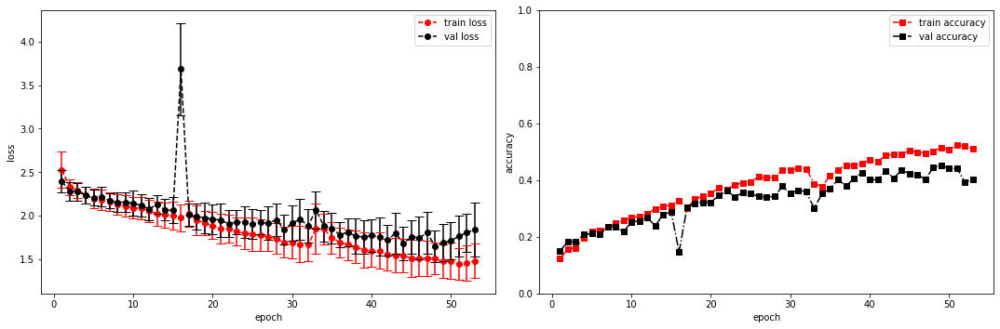

model saved


training epoch:  53
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [54/100], step [1/168],  Loss: 1.5595 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5408413410186768s
Epoch [54/100], step [17/168],  Loss: 1.4533 +/- 0.2147,  accuracy: 0.505859375, time elapsed = 6.2430009841918945s
Epoch [54/100], step [33/168],  Loss: 1.3471 +/- 0.1626,  accuracy: 0.54296875, time elapsed = 6.242346286773682s
Epoch [54/100], step [49/168],  Loss: 1.3176 +/- 0.1184,  accuracy: 0.5625, time elapsed = 6.2434399127960205s
Epoch [54/100], step [65/168],  Loss: 1.4967 +/- 0.2043,  accuracy: 0.486328125, time elapsed = 6.243161201477051s
Epoch [54/100], step [81/168],  Loss: 1.4887 +/- 0.1035,  accuracy: 0.5078125, time elapsed = 6.242914915084839s
Epoch [54/100], step [97/168],  Loss: 1.5356 +/- 0.2270,  accuracy: 0.490234375, time elapsed = 6.256315231323242s
Epoch [54/100], step [113/168],  Loss: 1.5200 +/- 0.1850,  accuracy: 0.486328125, time elapsed = 6.2433762550354s
Epoch [54/100], step [129/168],  Loss: 1.5050 +/- 0.1608,  accuracy: 0.517578125, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.513,  precision = 0.513 recall = 0.513 f1 = 0.513 ::: val: acc = 0.458,  precision = 0.458 recall = 0.458 time elapsed = 70.5675048828125s


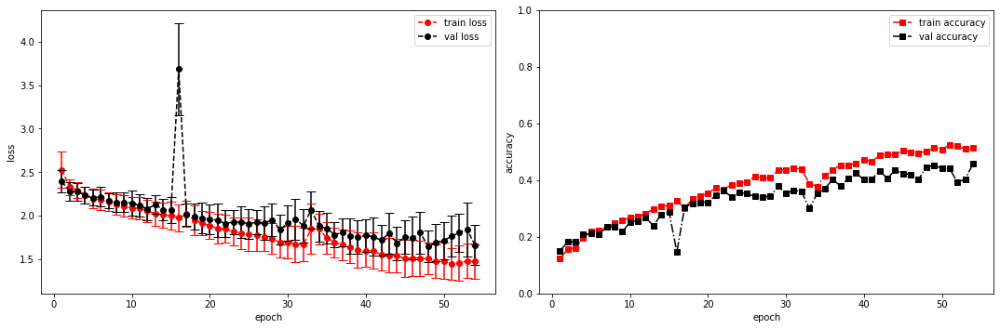

model saved


training epoch:  54
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [55/100], step [1/168],  Loss: 1.4250 +/- 0.0000,  accuracy: 0.033203125, time elapsed = 0.5998120307922363s
Epoch [55/100], step [17/168],  Loss: 1.4747 +/- 0.2103,  accuracy: 0.52734375, time elapsed = 6.242002725601196s
Epoch [55/100], step [33/168],  Loss: 1.3919 +/- 0.2061,  accuracy: 0.55859375, time elapsed = 6.243385553359985s
Epoch [55/100], step [49/168],  Loss: 1.4956 +/- 0.0754,  accuracy: 0.517578125, time elapsed = 6.241941213607788s
Epoch [55/100], step [65/168],  Loss: 1.4452 +/- 0.2897,  accuracy: 0.515625, time elapsed = 6.242630243301392s
Epoch [55/100], step [81/168],  Loss: 1.4739 +/- 0.2180,  accuracy: 0.513671875, time elapsed = 6.241947174072266s
Epoch [55/100], step [97/168],  Loss: 1.4036 +/- 0.2006,  accuracy: 0.544921875, time elapsed = 6.242627382278442s
Epoch [55/100], step [113/168],  Loss: 1.4524 +/- 0.1387,  accuracy: 0.50390625, time elapsed = 6.241495132446289s
Epoch [55/100], step [129/168],  Loss: 1.4110 +/- 0.2107,  accuracy: 0.55078125, time

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.524,  precision = 0.524 recall = 0.524 f1 = 0.524 ::: val: acc = 0.393,  precision = 0.393 recall = 0.393 time elapsed = 70.62093782424927s


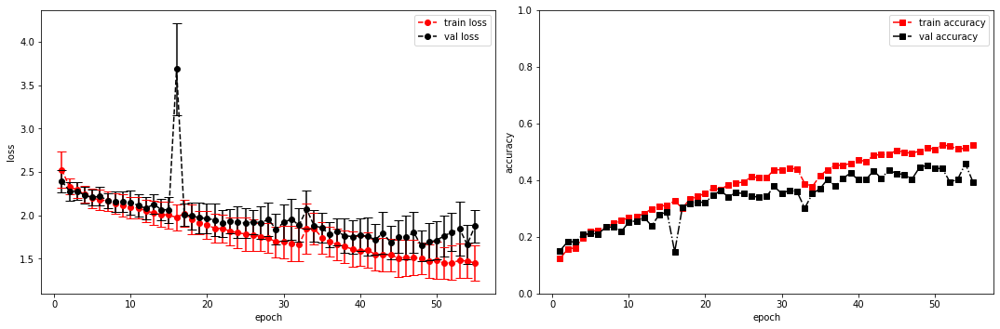

model saved
model saved


training epoch:  55
model set to train


<ipython-input-6-62315852426e>:110: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)


Epoch [56/100], step [1/168],  Loss: 1.0980 +/- 0.0000,  accuracy: 0.0390625, time elapsed = 0.5711429119110107s
Epoch [56/100], step [17/168],  Loss: 1.4599 +/- 0.1424,  accuracy: 0.517578125, time elapsed = 6.2437498569488525s
Epoch [56/100], step [33/168],  Loss: 1.3979 +/- 0.2316,  accuracy: 0.578125, time elapsed = 6.246811151504517s
Epoch [56/100], step [49/168],  Loss: 1.3712 +/- 0.1133,  accuracy: 0.556640625, time elapsed = 6.2446208000183105s
Epoch [56/100], step [65/168],  Loss: 1.4036 +/- 0.1992,  accuracy: 0.52734375, time elapsed = 6.241924047470093s
Epoch [56/100], step [81/168],  Loss: 1.4474 +/- 0.1783,  accuracy: 0.544921875, time elapsed = 6.24286413192749s
Epoch [56/100], step [97/168],  Loss: 1.4756 +/- 0.1881,  accuracy: 0.490234375, time elapsed = 6.242605686187744s
Epoch [56/100], step [113/168],  Loss: 1.4717 +/- 0.1821,  accuracy: 0.51171875, time elapsed = 6.24281644821167s
Epoch [56/100], step [129/168],  Loss: 1.4455 +/- 0.2145,  accuracy: 0.52734375, time 

<ipython-input-6-62315852426e>:194: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target_tensor = torch.squeeze(torch.tensor(targets), dim=1)



EPOCH FINISHED: ,  training: acc = 0.525,  precision = 0.525 recall = 0.525 f1 = 0.525 ::: val: acc = 0.384,  precision = 0.384 recall = 0.384 time elapsed = 70.61359524726868s


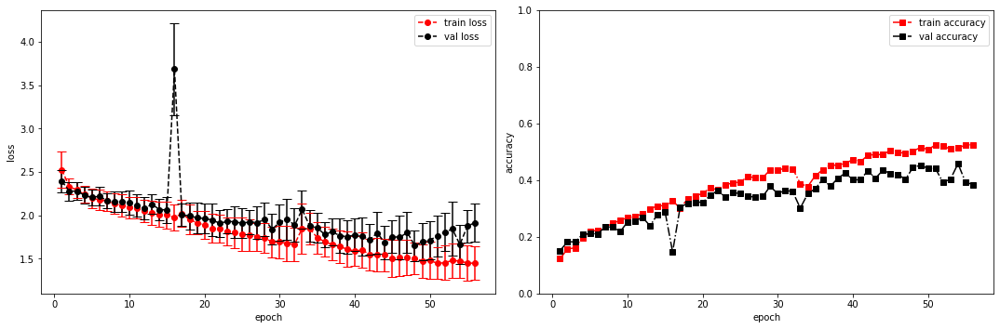

model saved
stopping early


In [7]:
CHECKPOINT_ROOT = "/home/alex/Documents/MIR_Models/"

lr = [0.0001, 0.0005, 0.001, 0.005, 0.01]

args_dict = {
  "filename": filename, 
  "model_id": "BigNet",
  "num_epochs": 100,
  "interval": 16,
  "batch_size": 32,
  "val_split": 0.2,
  "save_checkpoint": True,
  "criterion": nn.CrossEntropyLoss(),
  "patience": 2,
  "min_epochs": 3,
  "buffer": 0.05,
  'checkpoint_path': CHECKPOINT_ROOT,
}



for rate in lr:
  args_dict['notes'] = dedent(f"""
      Experimenting with very deep network
      lr = {rate}
      """)
  args_dict['checkpoint_name'] = f"BigNet_lr{str(rate)}.pt"
  train_model(**args_dict)